In [1]:
#we may need some code in the ../python directory and/or matplotlib styles
import sys
sys.path.append('../python/')

#matplotlib for plotting
import matplotlib as mpl
from matplotlib import pyplot as plt
plt.style.use('../mplstyles/stylelib/standard.mplstyle')

#other computational libraries
import numpy as np
import pandas as pd
import scipy
import scipy.constants as co
import scipy.stats as ss
from scipy.ndimage import shift
import itertools
import pickle
from pathlib import Path

from lmfit.models import GaussianModel, LinearModel

In [2]:
import pickle
#how to read
#fileObj = open('data/r76-80V-naitrig-100eV-goodchi.pkl', 'rb')
fileObj = open('data/r76_events_coincidencepeak_LE.pkl', 'rb')
exampleObj = pickle.load(fileObj)
fileObj.close()
#print(exampleObj)

In [3]:
import statistics as st
def isRailed(v):
    if(np.isnan(v).any()):
        return True
    if(st.mode(v)==0):
        return True
    return False

In [4]:
#import singularity_pulseSave as sps
import pulseAnalysis as pa

pulse_struct = pa.parseEventList('../coin_analysis/data/r76-coinpeak-lt-50keV.txt')

#pulse_struct = sps.parseEventList('../coin_analysis/data/r76_events_coincidencepeak.txt')

   SeriesNumber  EventNumber
0   72209162200        20309
1   72209162200        40339
2   72209162200        50269
3   72209162200        60108
4   72209162200        60849
5   72209162200        80307
6   72209162200       100246
7   72209162200       110588
8   72209162200       110617
9   72209162200       120647
[72209162200 72209171225 72209172155]
[  20309   40339   50269   60108   60849   80307  100246  110588  110617
  120647  120688  130460  140628  150823  160296  170423  180002  180423
  230432  240270  270221  340151  340912  380054  380186  390511  420391
  420816  430710  440168  480387  480389  500725  520930  540170  540903
  550322  560707  560931  570415  580008  580723  590121  610172  610663
  610684  640653  650751  670228  670650  690338  710437  740337  750334
  750490  760179  770287  780145  780259  780278  780628  800530  810923
  820568  840012  840222  850265  860663  880573  880913  910282  920809
  920948  930239  930872  940631  950888  960920  970767 10

In [5]:
coindata = pd.read_csv("../coin_analysis/data/r76_events_coincidencepeak.txt", skiprows=3, engine='python',skipfooter=1,sep="*",skipinitialspace=True, \
            index_col=False, \
            names=['garbage','Row','SeriesNumber','EventNumber','PTOFdelay','pt_keVee'], \
            delim_whitespace=False)

series_nums = np.asarray(coindata['SeriesNumber'])
event_nums = np.asarray(coindata['EventNumber'])
EkeV = np.asarray(coindata['pt_keVee'])
PTOFdelay = np.asarray(coindata['PTOFdelay'])

def getEnergy(series,ev):
    energy = 0

    for i in range(0, len(series_nums)):
        if series_nums[i] == series:
            if event_nums[i] == ev:
                energy = (EkeV[i])
    return energy

def getBaseline(ptpulse):
    
    x = np.linspace(100, 250, 150)
    #print(len(x))
    y = ptpulse[100:250]
    #print(len(y))
    
    #print(x)
    #print(y)
    
    baseline_model = np.polyfit(x, y, 1)
    baseline_model_fn = np.poly1d(baseline_model)
    
    return(baseline_model_fn)

In [6]:
plot = True

In [7]:
# ax1.fill_between(np.arange(0, best_cross + 1), bshifted_pT[:best_cross + 1], 0, color='gray', alpha=0.5)
                
              #      area = np.trapz(bshifted_pT[:best_cross + 1], dx=1)
                #    print("Area:", area)
def getPTPulse(pulses,series=72209162200,ev=20309,chan=[('Z1','PA'),('Z1','PB'),('Z1','PD'),('Z3','PA'),('Z3','PB'),('Z3','PD')]):
    ptpulse=[]
    ccount=0
    for c in chan:
        #print(c[0])
        pulse = pulses[c[0]][c[1]][series,ev]
        if(isRailed(pulse)):
            continue
        mean = np.mean(pulse[100:])
        #print(mean)
        pulse = pulse-mean
        #print(pulse)
        #print(np.size(ptpulse))
        if(ccount==0):
            ptpulse=pulse
        else:
            ptpulse+=pulse
        ccount+=1
        
    return ptpulse


def getPTPulseCD(pulses,series=72209162200,ev=20309):
    
    pulse = getPTPulse(pulses, series, ev)

    #adding discriminator
    D = 100

    end_values = pulse[3997:]
    
    CD_pulse = shift(pulse, D, cval=np.nan)

    #adding the cut off values to the front of the new pulse
    CD_pulse[0:99] = end_values
    #print(new_pulse)
        
    return CD_pulse

Series Number: 72209162200
Event Number: 20309
Energy: 48.72442612309 keV
Area: 20046.887774092702


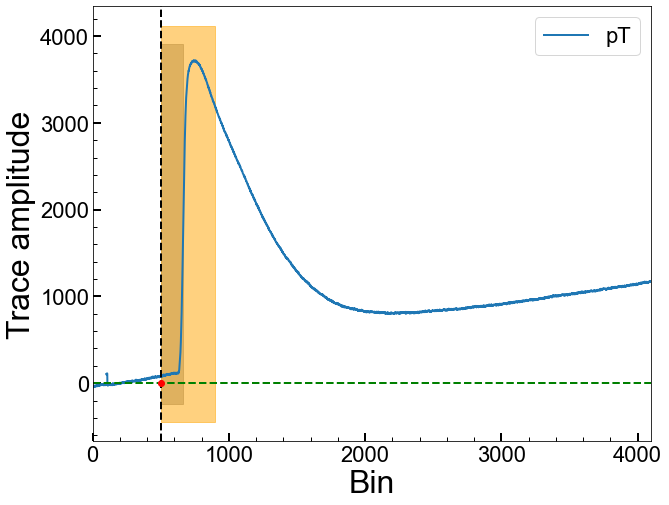

Series Number: 72209162200
Event Number: 40339
Energy: 10.34608253162 keV
Area: 433045.7344562018


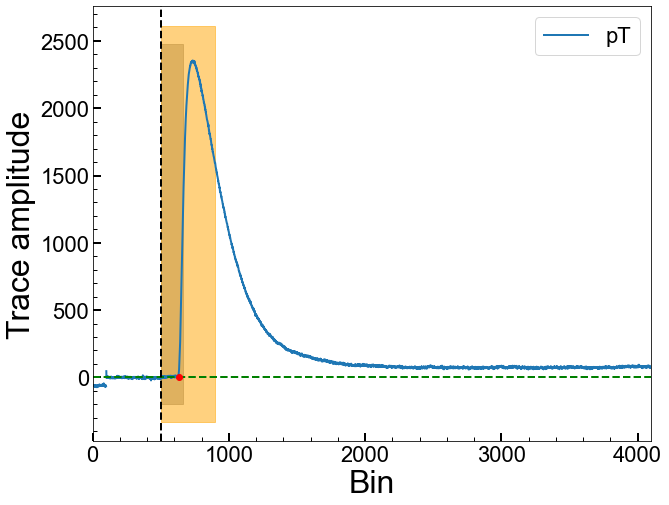

Series Number: 72209162200
Event Number: 50269
Energy: 40.07287564851 keV
Area: 569846.4140895084


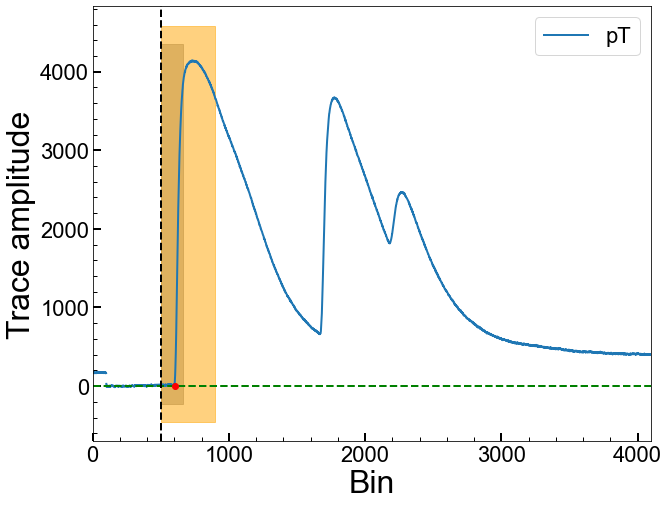

Series Number: 72209162200
Event Number: 60108
Energy: 21.7417630781 keV
Area: 653093.0546469755


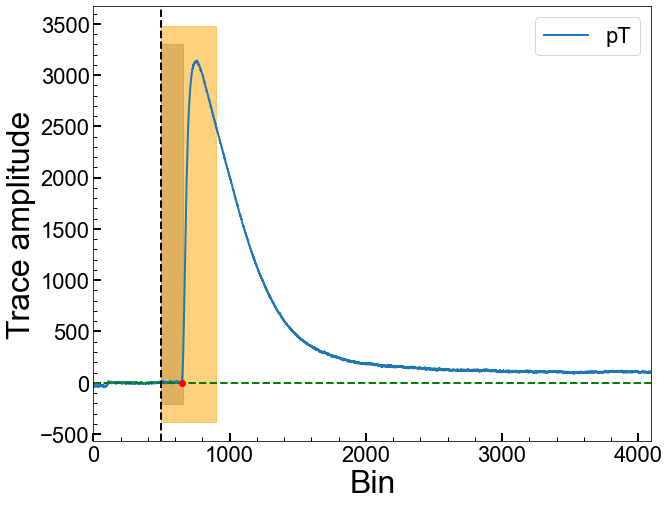

Series Number: 72209162200
Event Number: 60849
Energy: 17.18529370068 keV
Area: 400584.5139582341


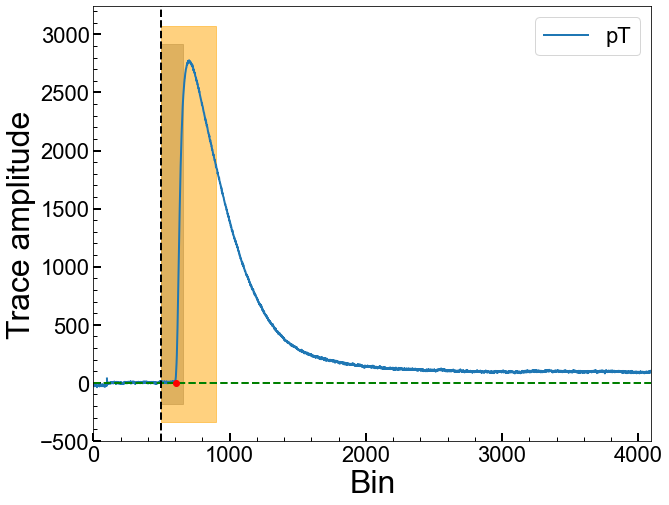

Series Number: 72209162200
Event Number: 80307
Energy: 11.98039564031 keV
Area: 503381.9273571669


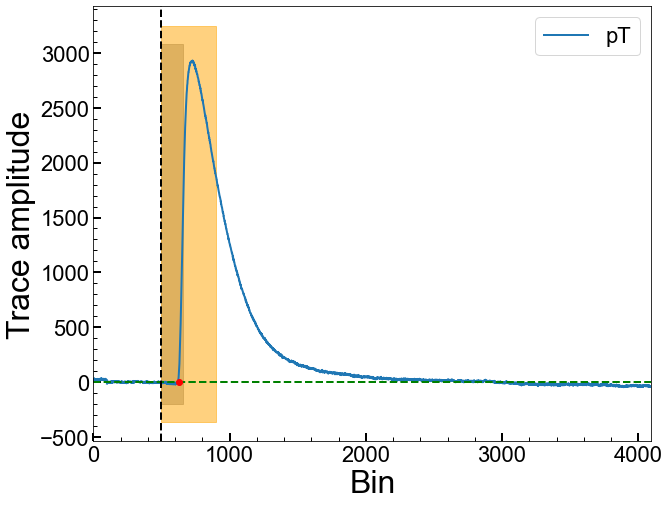

Series Number: 72209162200
Event Number: 100246
Energy: 17.65301361624 keV
Area: 654078.1601258289


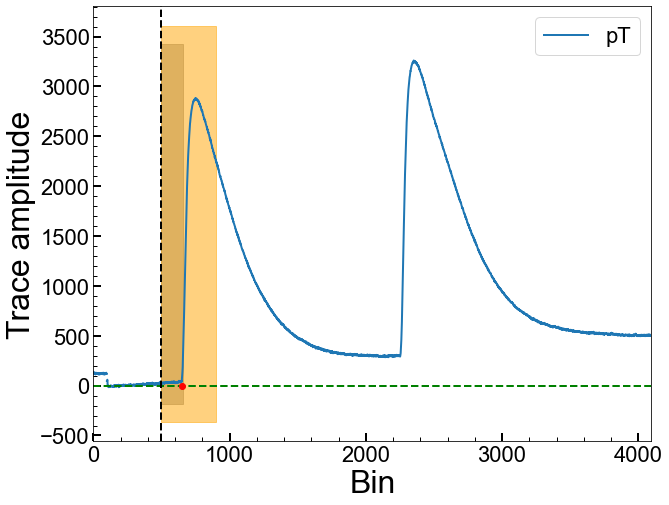

Series Number: 72209162200
Event Number: 110588
Energy: 34.03905404596 keV
Area: 383551.146144763


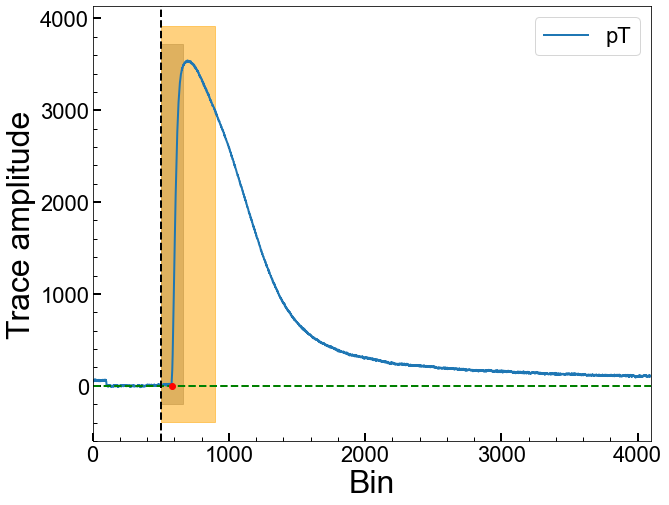

Series Number: 72209162200
Event Number: 110617
Energy: 49.48838945648 keV
Area: 26046.94205758948


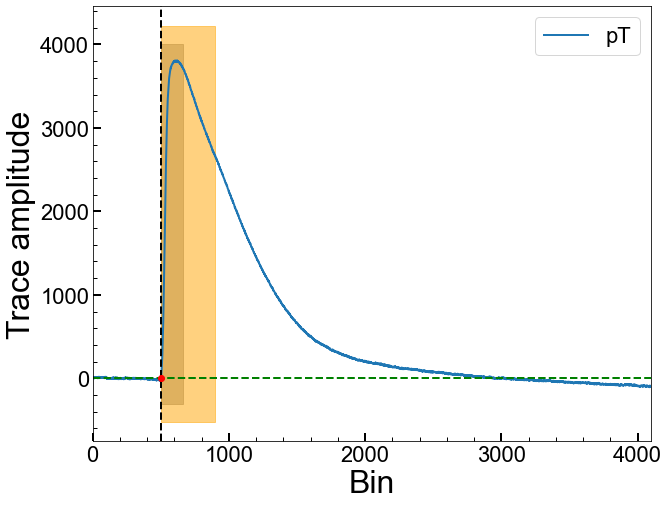

Series Number: 72209162200
Event Number: 120647
Energy: 17.93996431643 keV
Area: 98855.63351094066


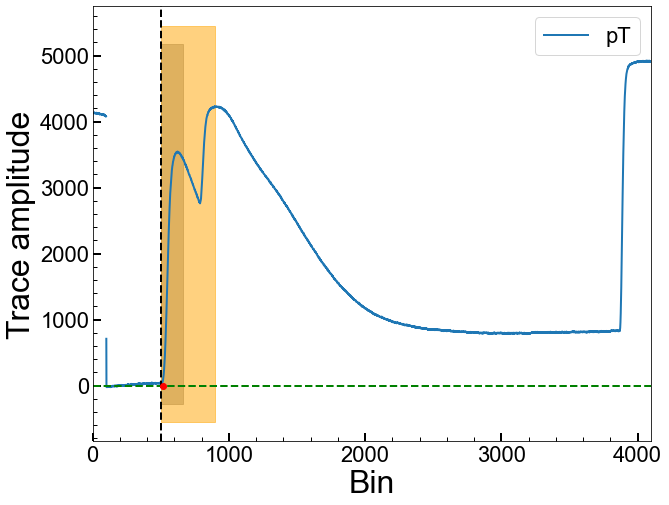

Series Number: 72209162200
Event Number: 120688
Energy: 6.287092835697 keV
Area: 261456.6834476721


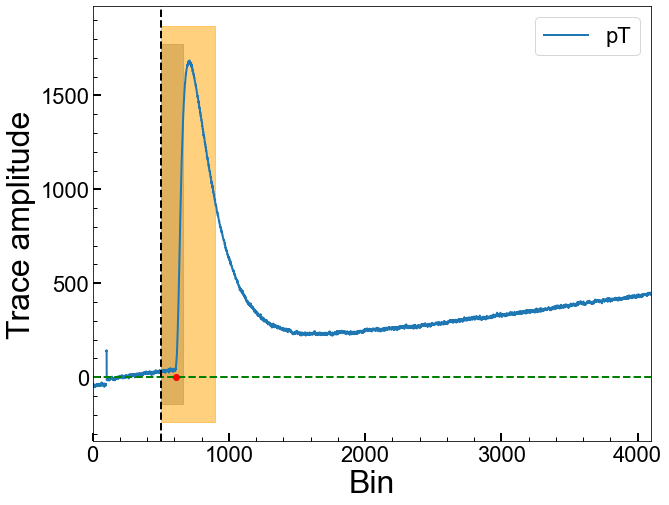

Series Number: 72209162200
Event Number: 130460
Energy: 11.77147191395 keV
Area: 300497.45060516056


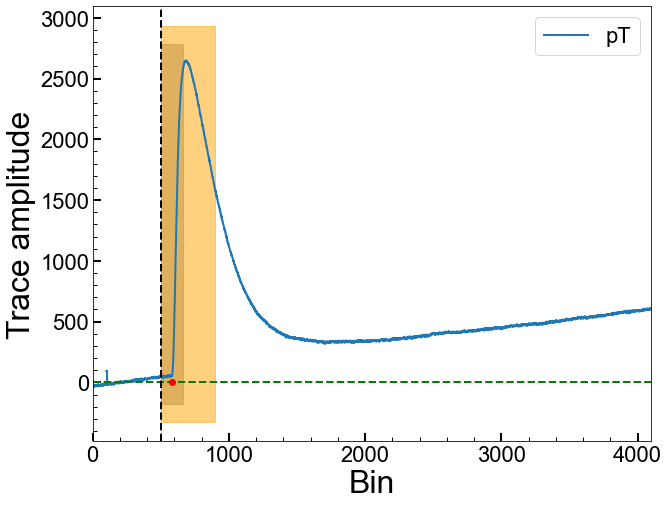

Series Number: 72209162200
Event Number: 140628
Energy: 6.77380884301 keV
Area: 38511.09474258719


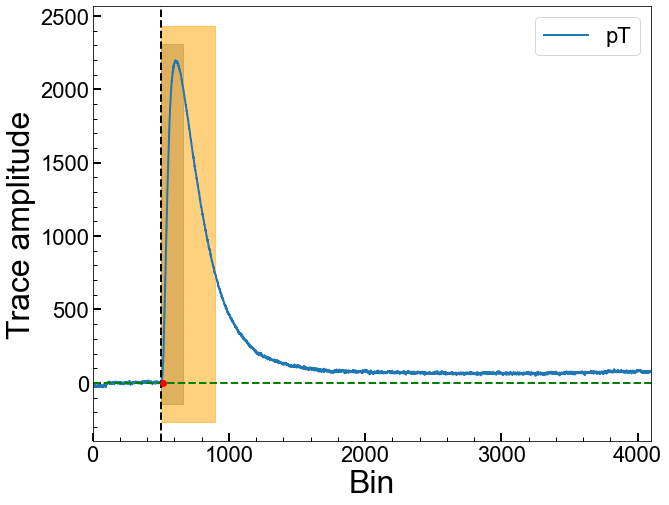

Series Number: 72209162200
Event Number: 150823
Energy: 28.45972947161 keV
Area: 139879.98058267563


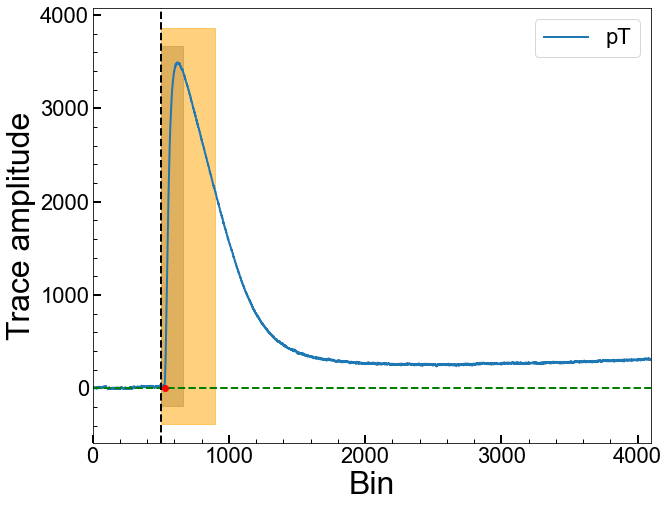

Series Number: 72209162200
Event Number: 160296
Energy: 4.022886292054 keV
Area: 227178.2096187901


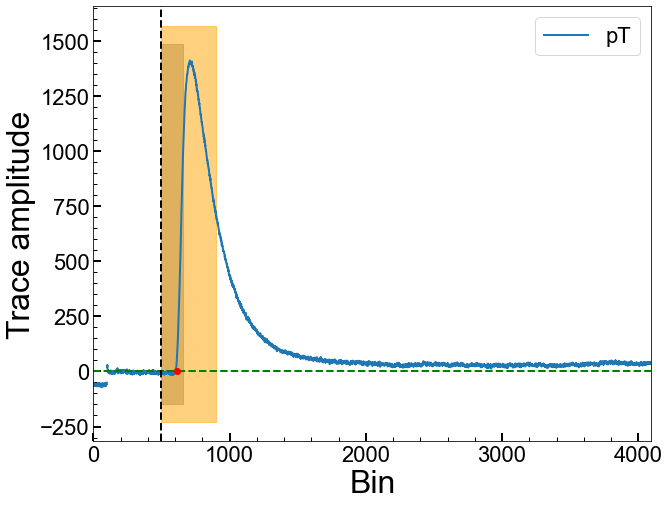

Series Number: 72209162200
Event Number: 170423
Energy: 24.90143389189 keV
Area: 518669.0827124666


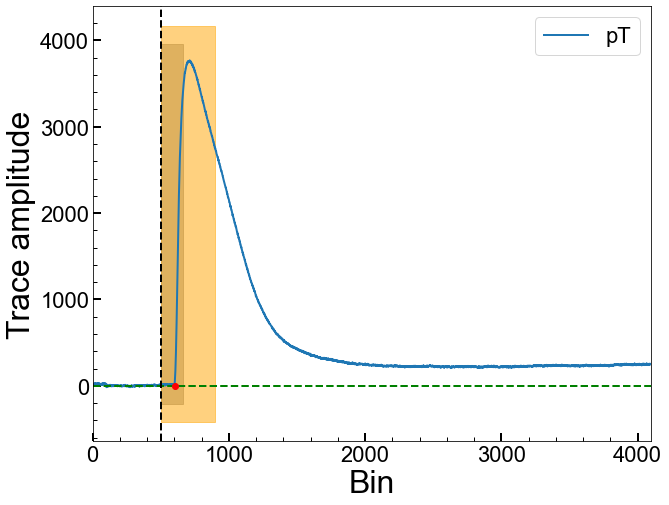

Series Number: 72209162200
Event Number: 180002
Energy: 30.94808547534 keV
Area: 496200.6664509884


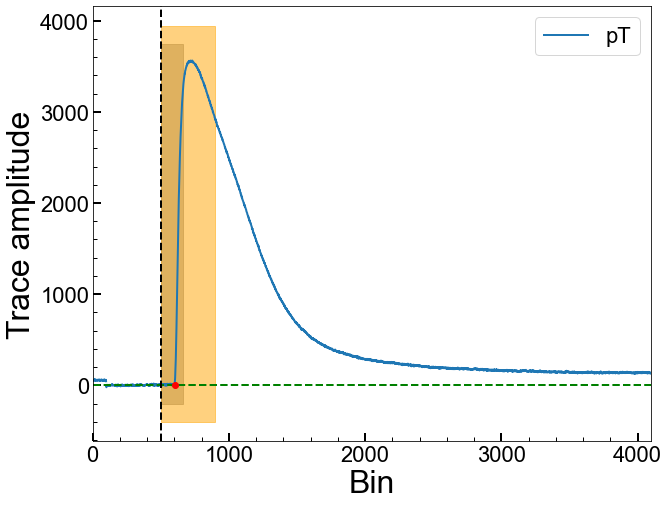

Series Number: 72209162200
Event Number: 180423
Energy: 11.78615315698 keV
Area: 242452.71803421815


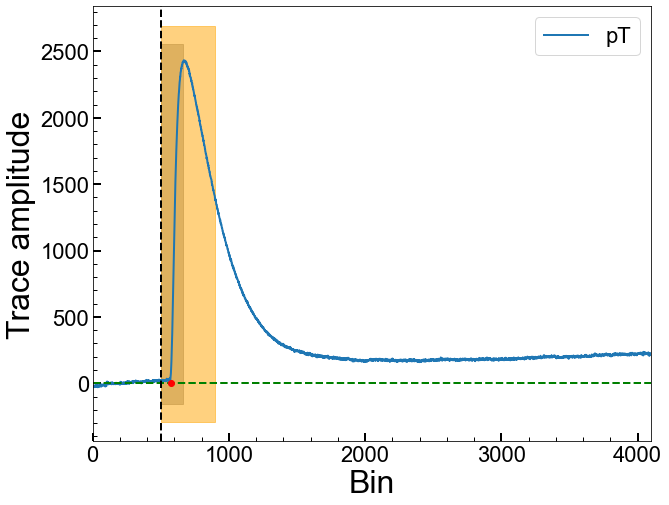

Series Number: 72209162200
Event Number: 230432
Energy: 6.139483142576 keV
Area: 372427.05739464867


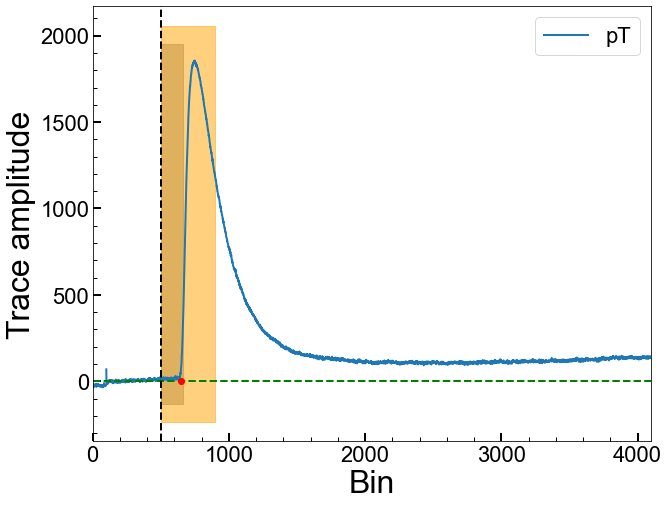

Series Number: 72209162200
Event Number: 240270
Energy: 20.36556890581 keV
Area: 44397.33772529804


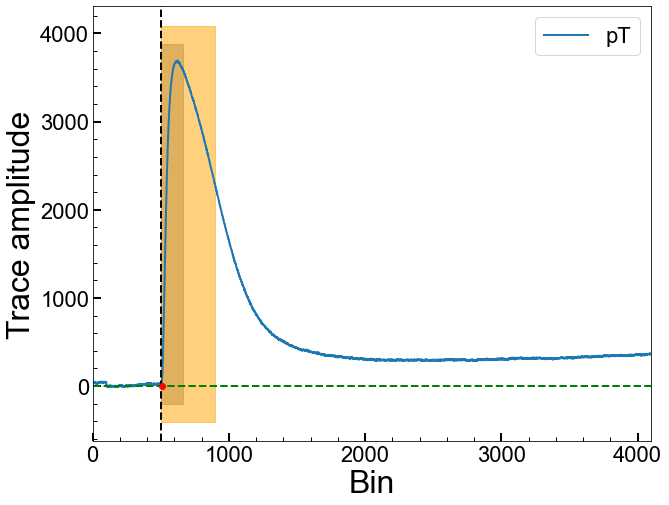

Series Number: 72209162200
Event Number: 270221
Energy: 39.26025312352 keV
Area: -915194.2288337691


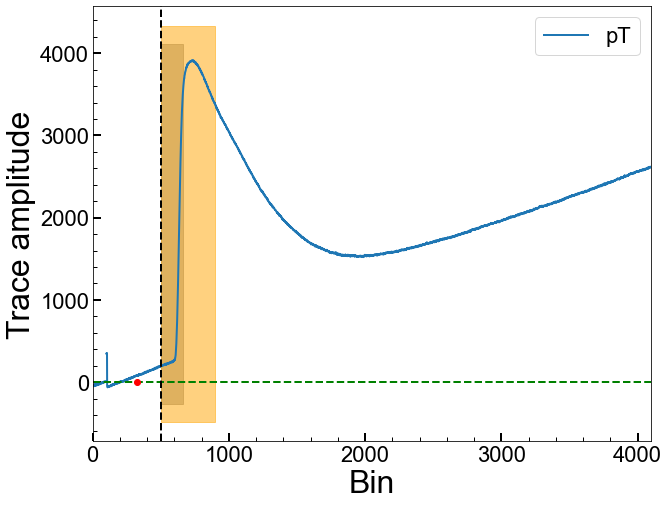

Series Number: 72209162200
Event Number: 340151
Energy: 15.21637172121 keV
Area: 426307.301466914


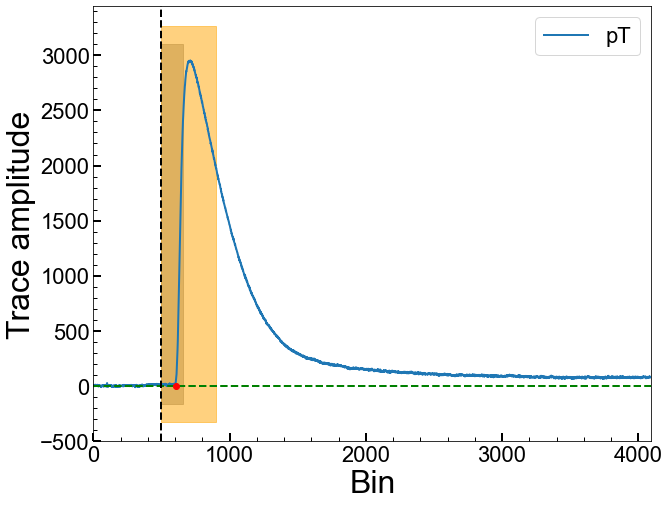

Series Number: 72209162200
Event Number: 340912
Energy: 9.715530494007 keV
Area: 92050.83462157704


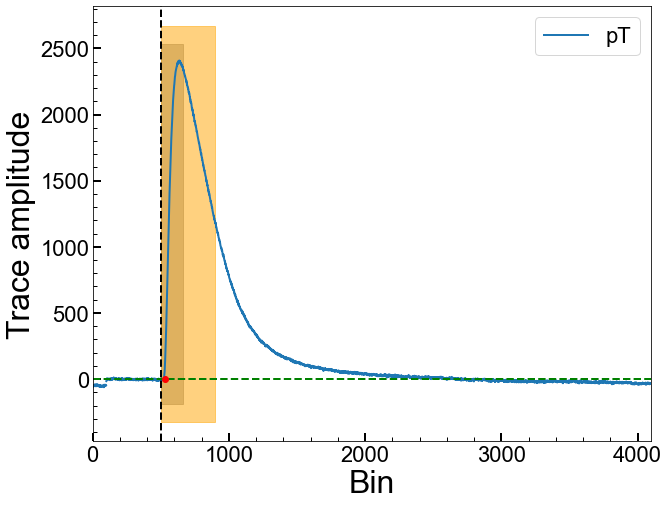

Series Number: 72209162200
Event Number: 380054
Energy: 13.69835568149 keV
Area: 59094.369574484765


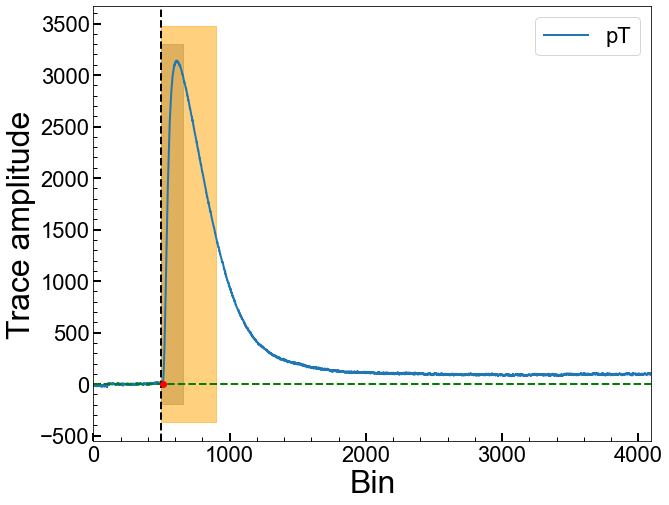

Series Number: 72209162200
Event Number: 380186
Energy: 8.165548711592 keV
Area: 359609.3372350005


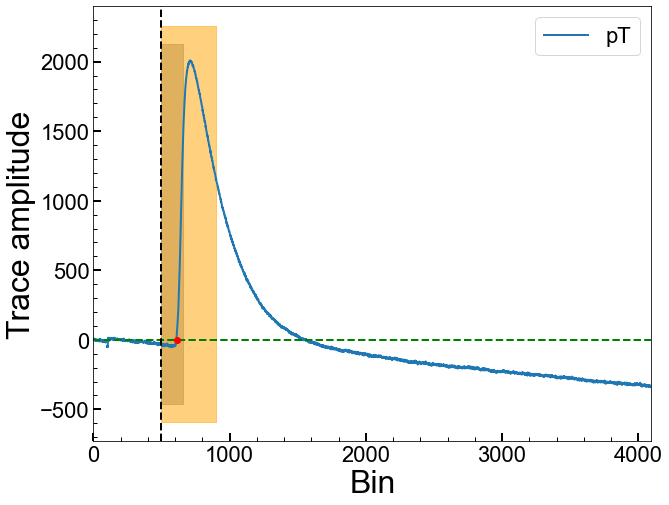

Series Number: 72209162200
Event Number: 390511
Energy: 31.86101733774 keV
Area: 759223.791009307


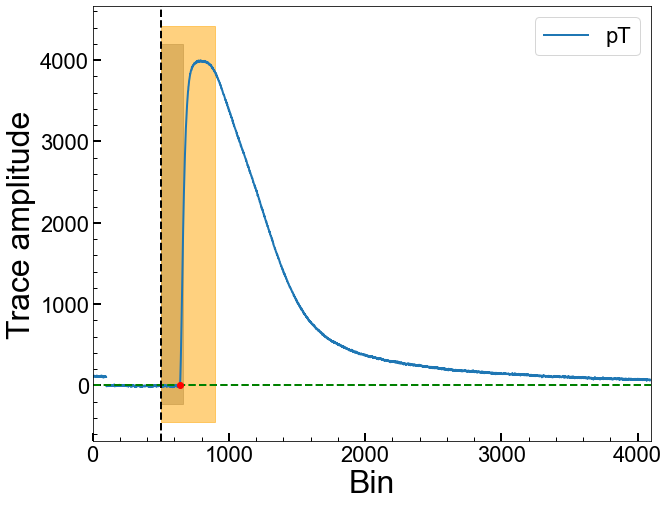

Series Number: 72209162200
Event Number: 420391
Energy: 5.439453766113 keV
Area: 93450.31590551558


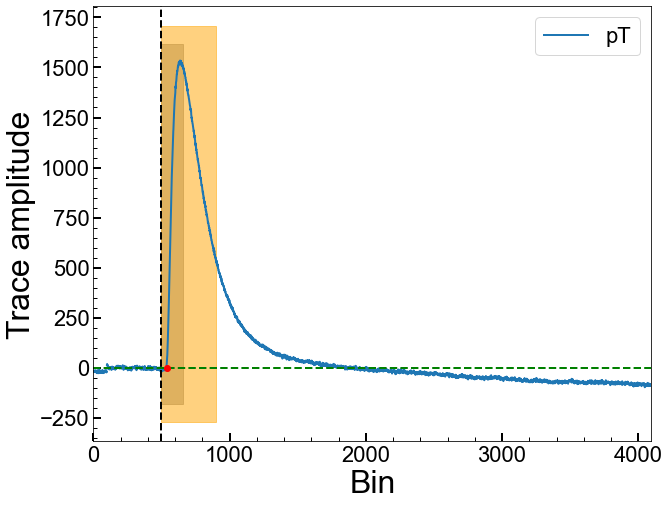

Series Number: 72209162200
Event Number: 420816
Energy: 19.04186691565 keV
Area: 437827.23445446376


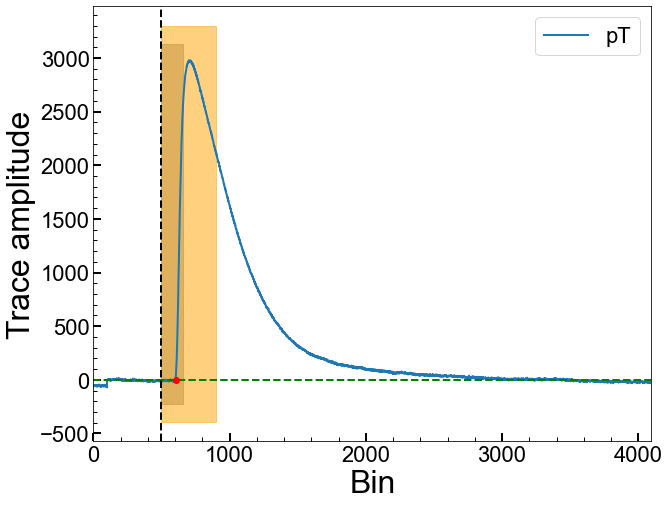

Series Number: 72209162200
Event Number: 430710
Energy: 13.64832985199 keV
Area: 430333.8434543499


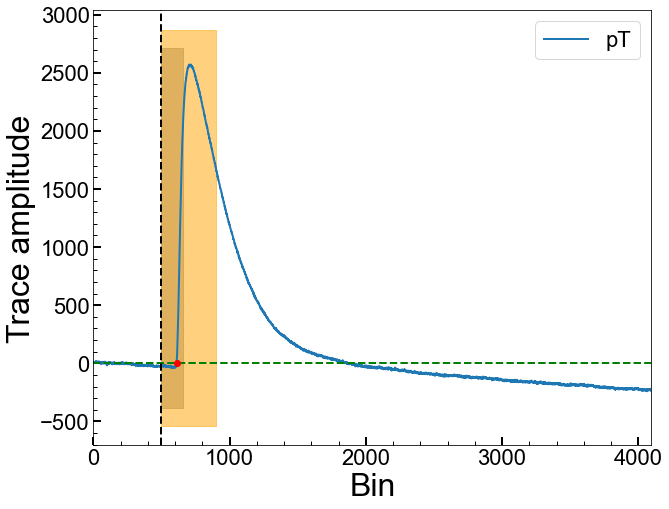

Series Number: 72209162200
Event Number: 440168
Energy: 28.43559512832 keV
Area: 571264.2638504055


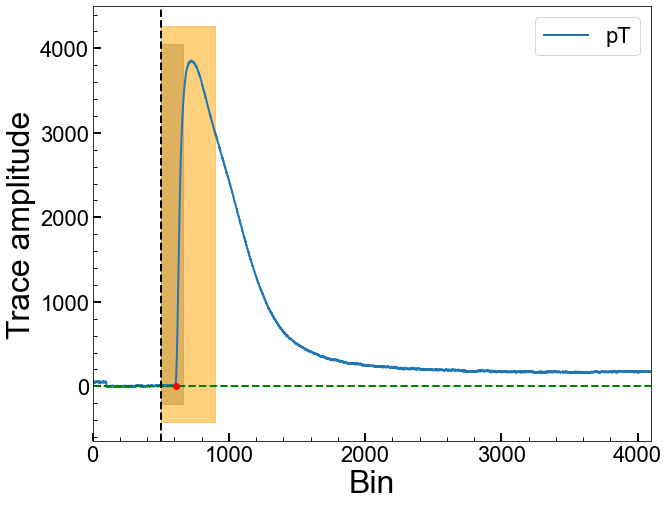

Series Number: 72209162200
Event Number: 480387
Energy: 2.055333671358 keV
Area: 149072.63169436296


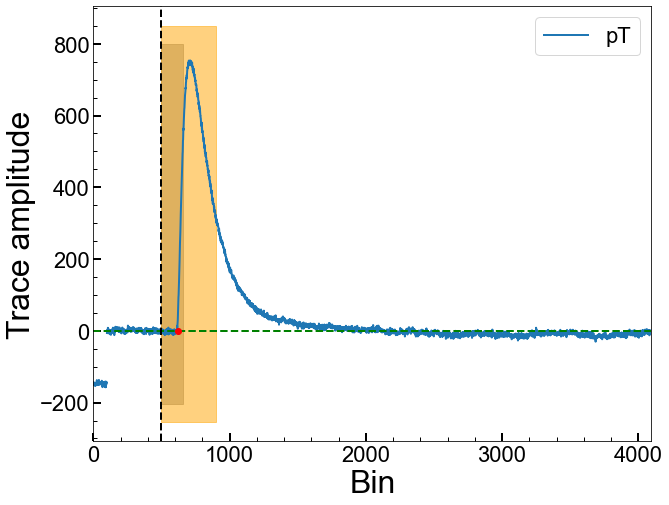

Series Number: 72209162200
Event Number: 480389
Energy: 14.79957140929 keV
Area: 575656.0029194065


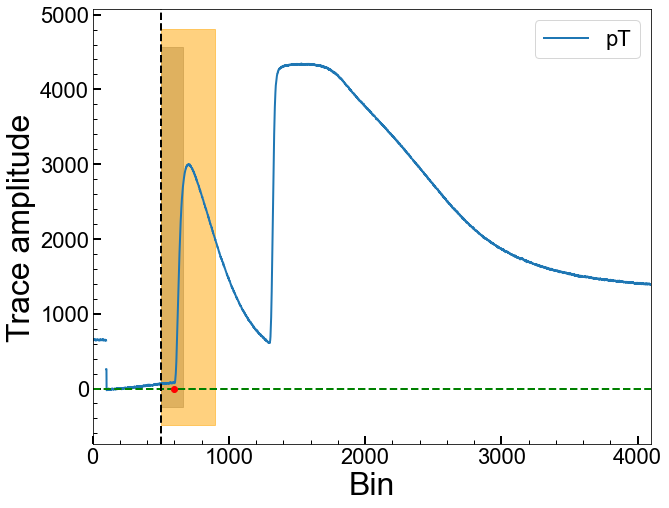

Series Number: 72209162200
Event Number: 500725
Energy: 31.80494071183 keV
Area: 491326.3701340609


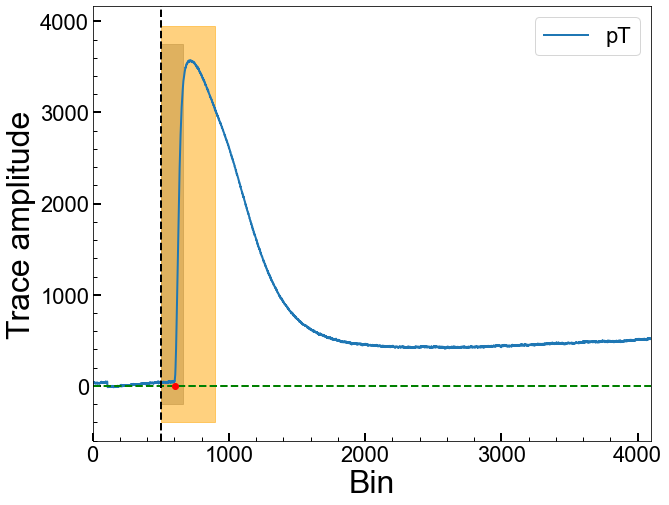

Series Number: 72209162200
Event Number: 520930
Energy: 26.11538501165 keV
Area: 430321.74079886515


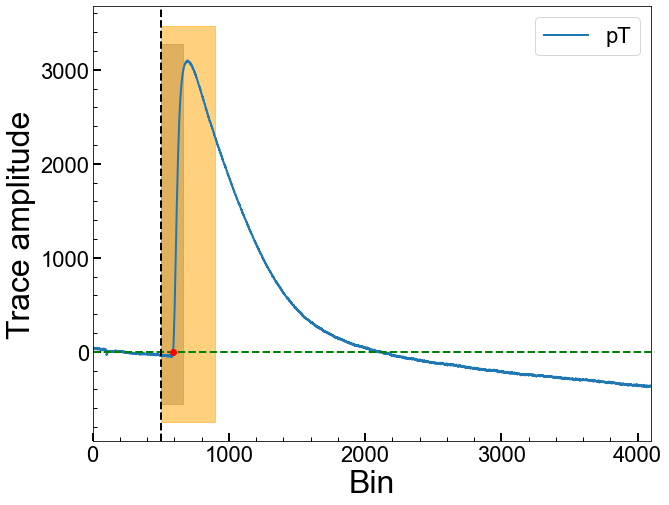

Series Number: 72209162200
Event Number: 540170
Energy: 5.36695053029 keV
Area: 297595.05905361805


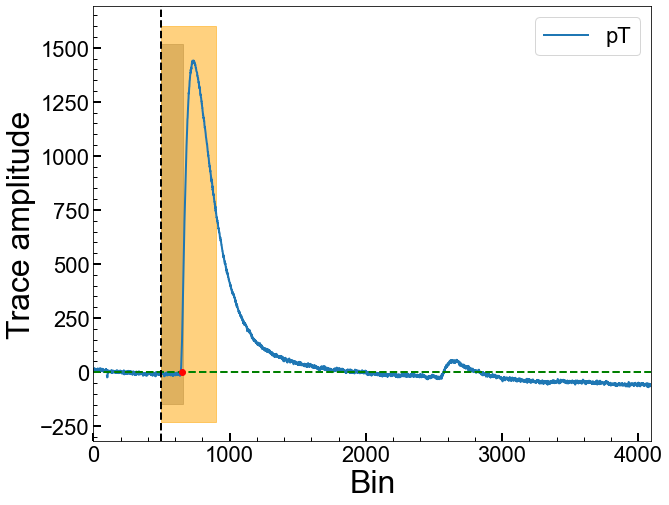

Series Number: 72209162200
Event Number: 540903
Energy: 2.693683786015 keV
Area: 42212.437344349586


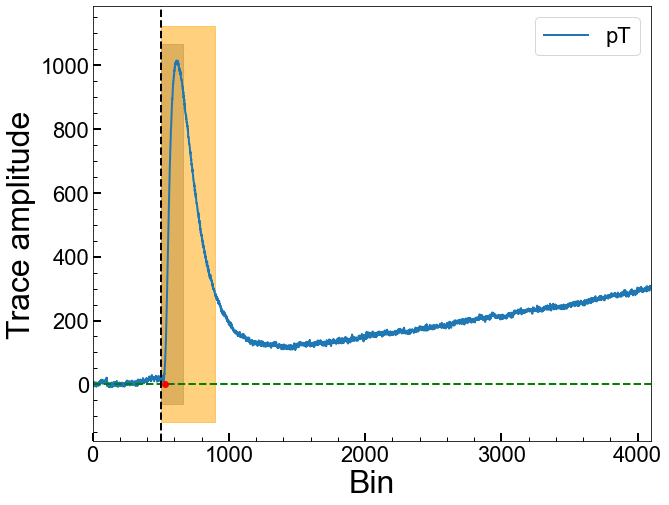

Series Number: 72209162200
Event Number: 550322
Energy: 48.08899535536 keV
Area: 485494.08180844167


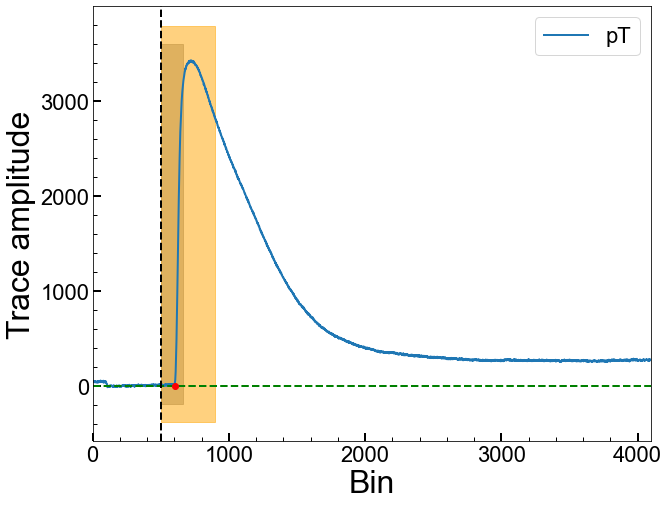

Series Number: 72209162200
Event Number: 560707
Energy: 47.8705963004 keV
Area: 500907.5627110464


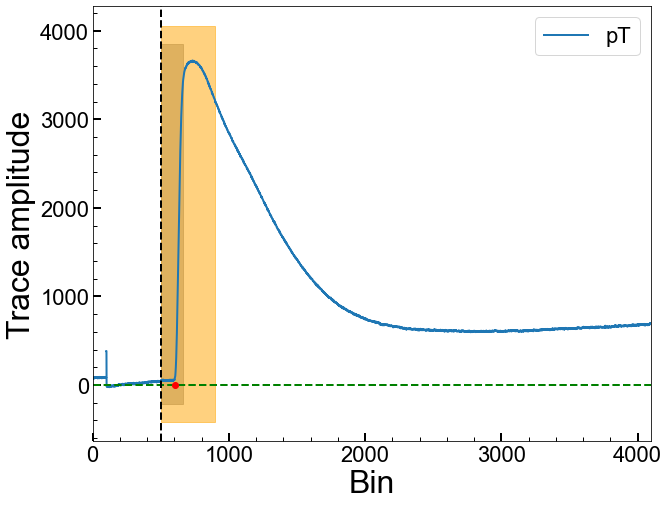

Series Number: 72209162200
Event Number: 560931
Energy: 37.38332924631 keV
Area: 678987.2616985439


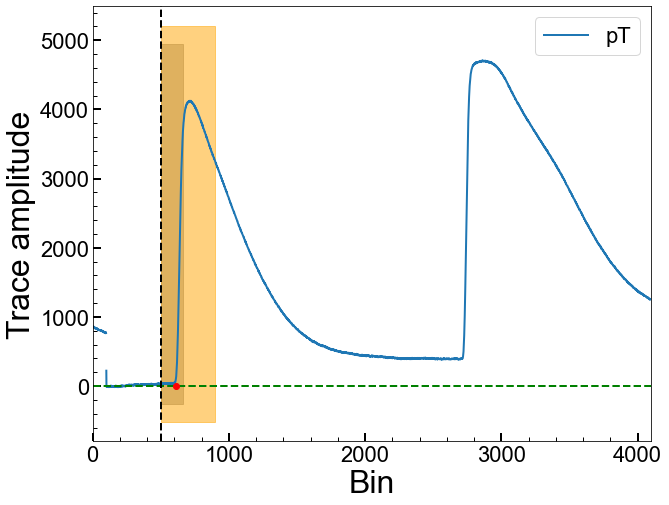

Series Number: 72209162200
Event Number: 570415
Energy: 47.87359137172 keV
Area: 493625.79851316556


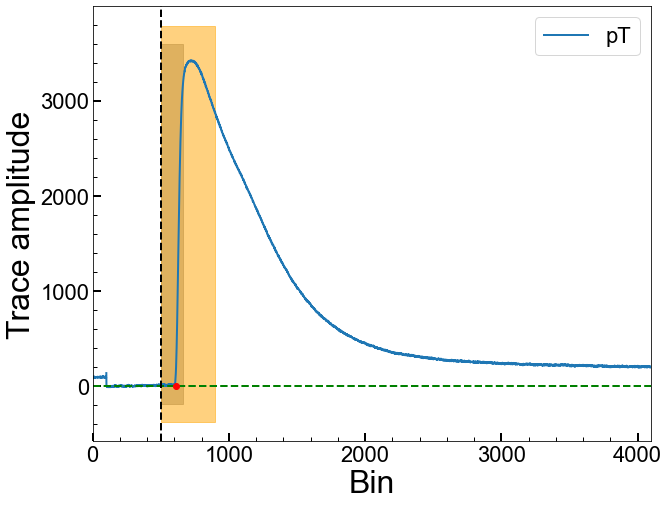

Series Number: 72209162200
Event Number: 580008
Energy: 33.97321412501 keV
Area: -200106.59977917882


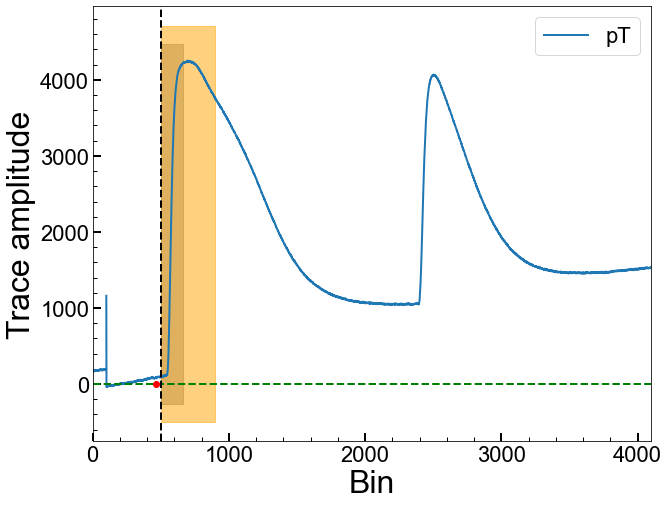

Series Number: 72209162200
Event Number: 580723
Energy: 19.11512774491 keV
Area: -2210189.355900863


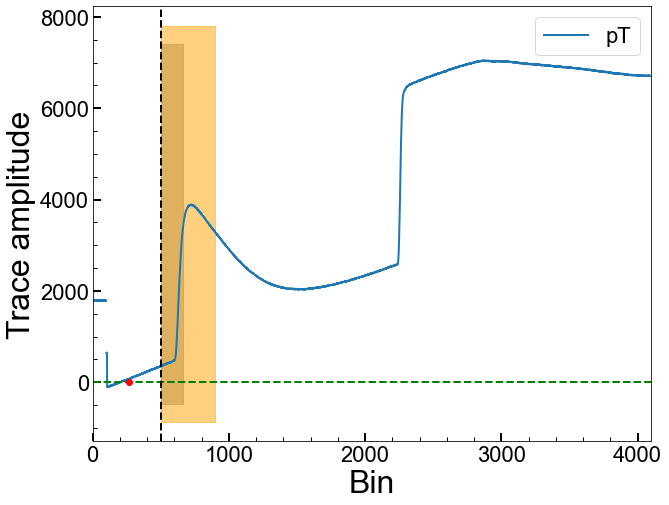

Series Number: 72209162200
Event Number: 590121
Energy: 22.66273398855 keV
Area: 774423.6183933337


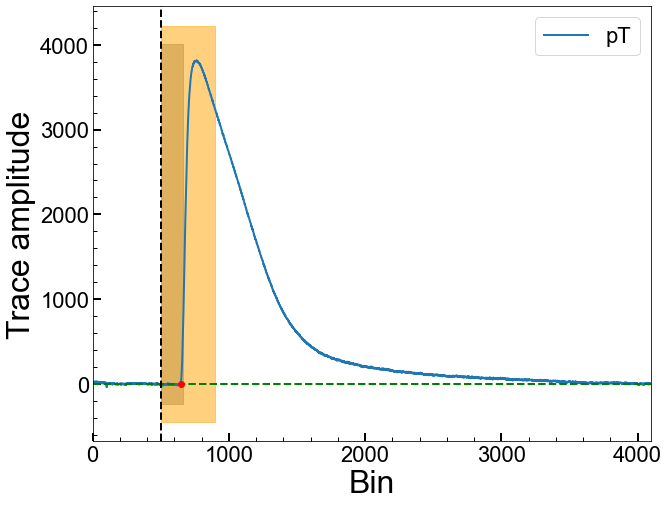

Series Number: 72209162200
Event Number: 610172
Energy: 3.526105521744 keV
Area: 255311.88420580284


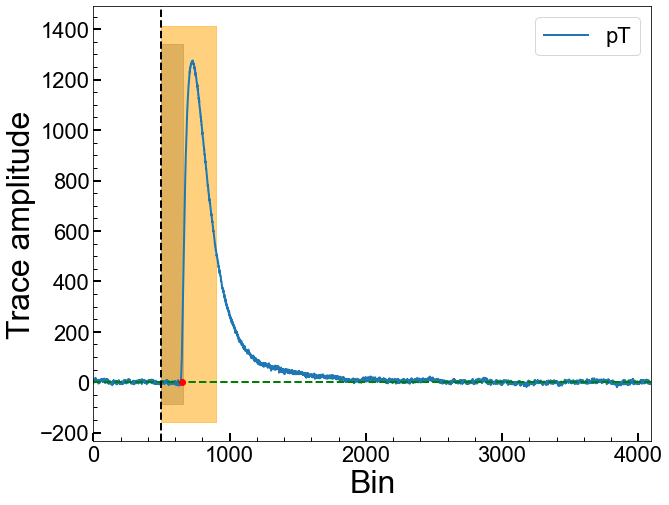

Series Number: 72209162200
Event Number: 610663
Energy: 48.12875529367 keV
Area: 221346.8959165987


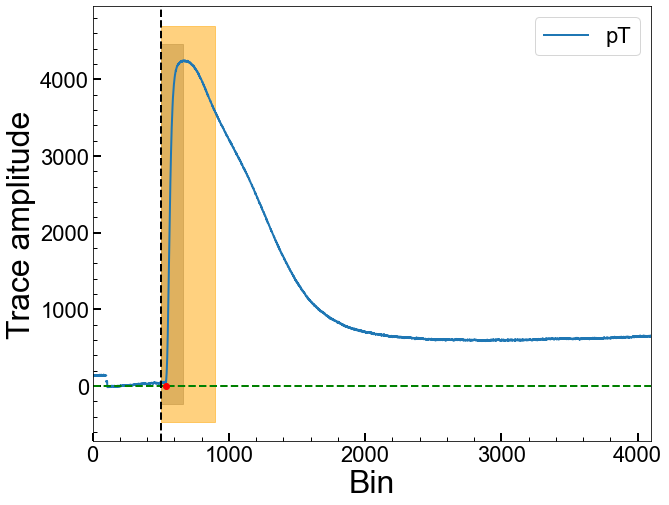

Series Number: 72209162200
Event Number: 610684
Energy: 20.76110622756 keV
Area: 200513.76296754455


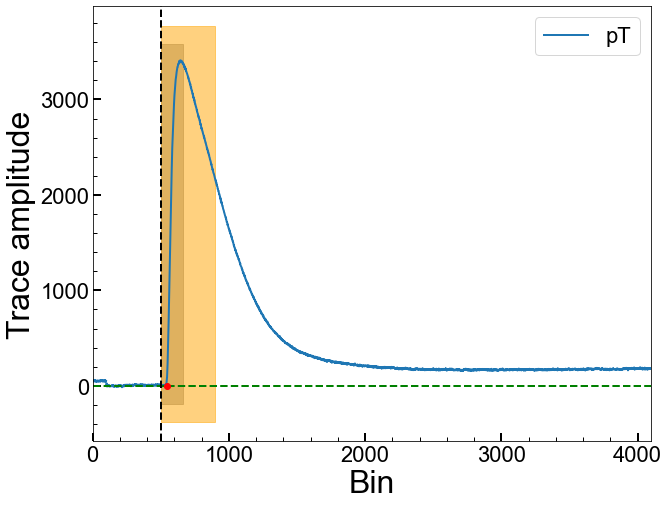

Series Number: 72209162200
Event Number: 640653
Energy: 10.43226269511 keV
Area: 351033.88961362705


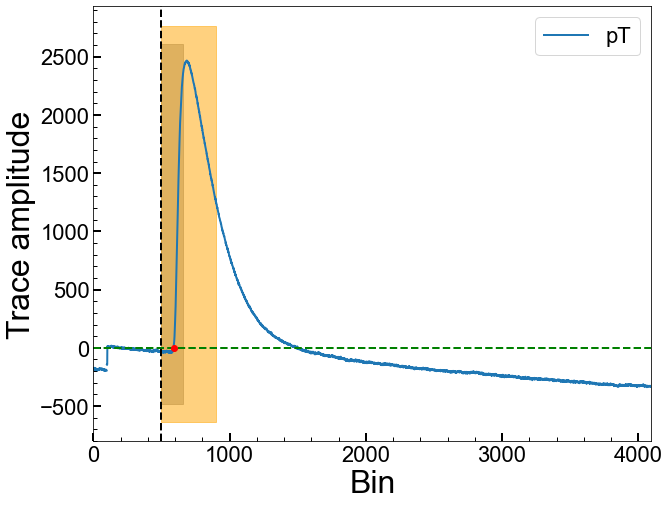

Series Number: 72209162200
Event Number: 650751
Energy: 27.58306035935 keV
Area: -1866660.73651112


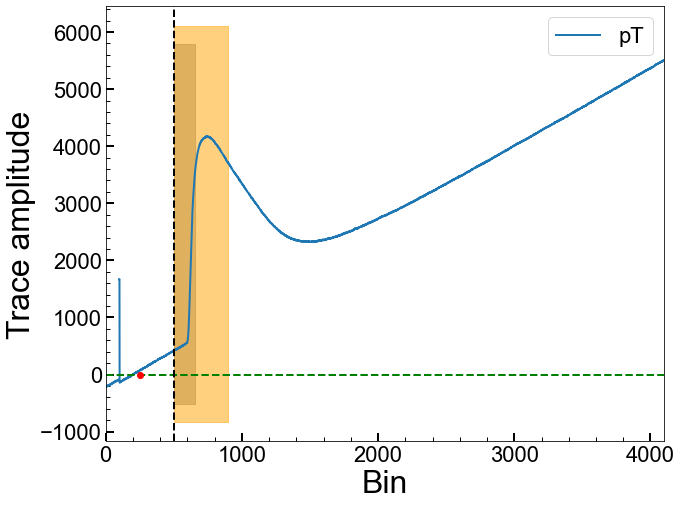

Series Number: 72209162200
Event Number: 670228
Energy: 33.94731111163 keV
Area: 549981.7316382515


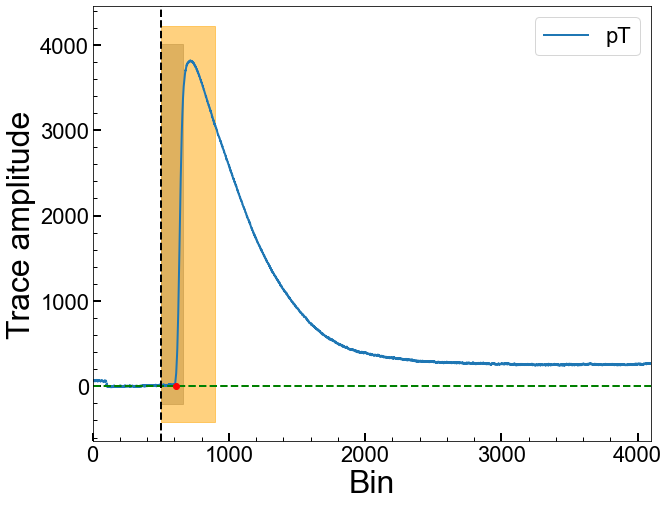

Series Number: 72209162200
Event Number: 670650
Energy: 2.05105148157 keV
Area: -1575037.2010690493


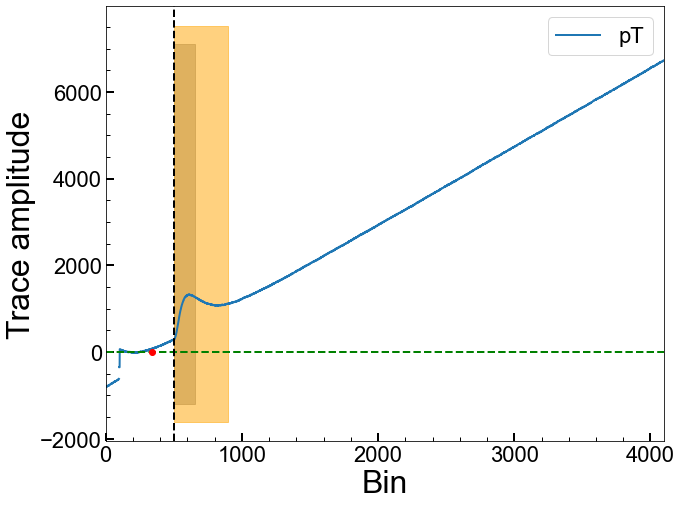

Series Number: 72209162200
Event Number: 690338
Energy: 19.22340418631 keV
Area: -3698833.667813174


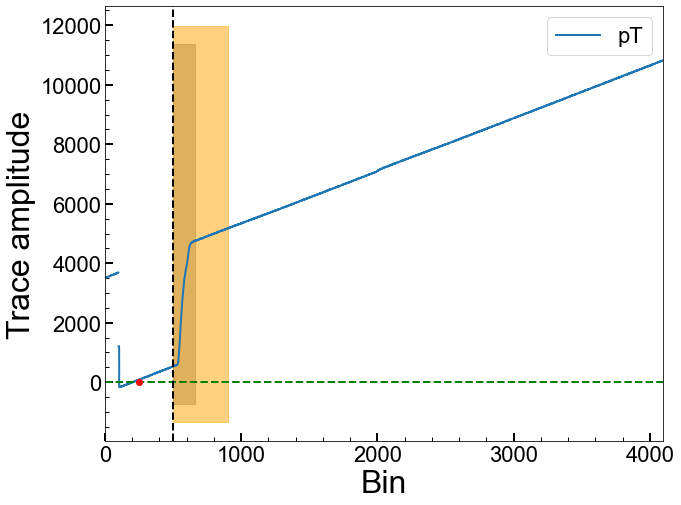

Series Number: 72209162200
Event Number: 710437
Energy: 34.6801839217 keV
Area: 747959.090196267


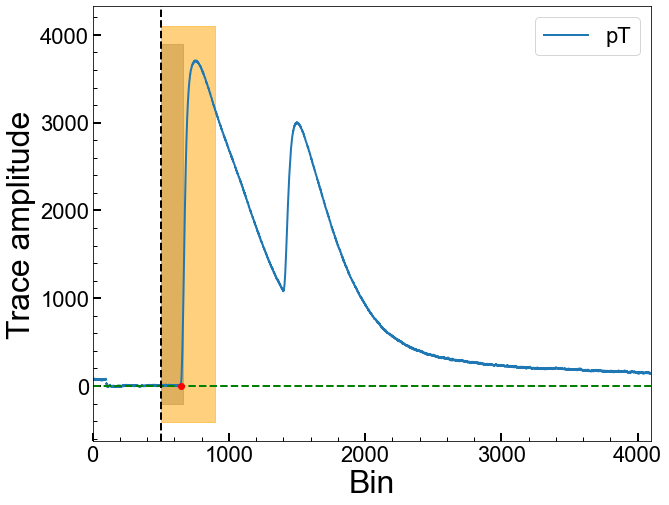

Series Number: 72209162200
Event Number: 740337
Energy: 6.359299905869 keV
Area: 280397.8093200878


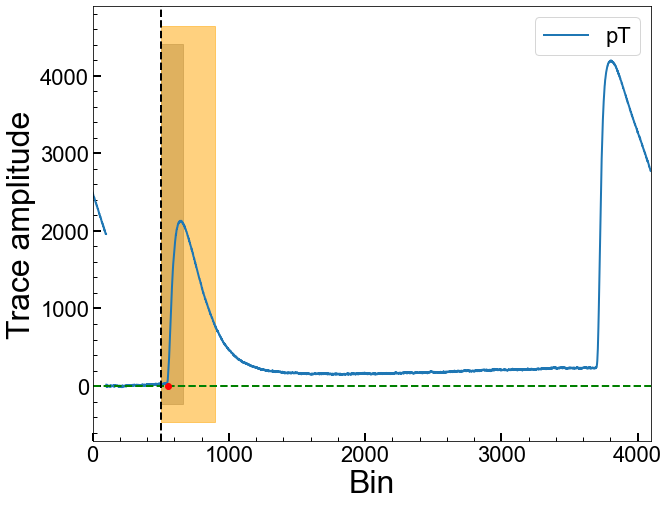

Series Number: 72209162200
Event Number: 750334
Energy: 7.153684944725 keV
Area: 251595.89341605315


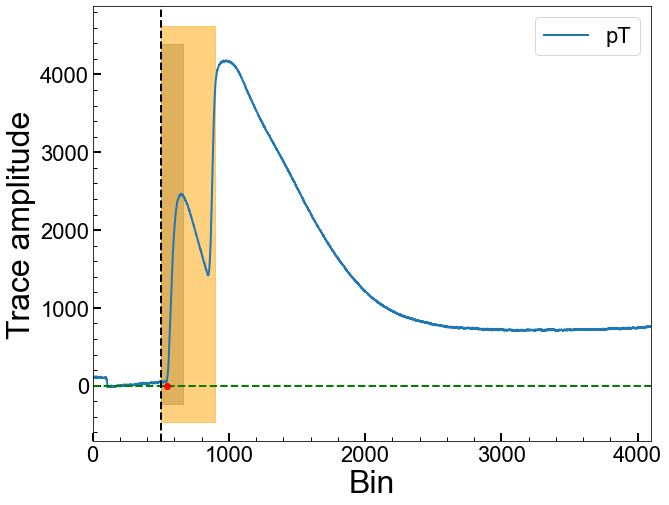

Series Number: 72209162200
Event Number: 750490
Energy: 35.87973899913 keV
Area: 310303.13409174036


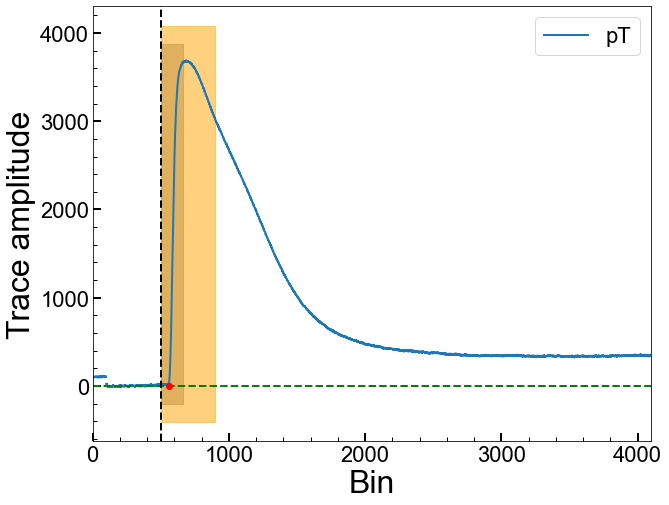

Series Number: 72209162200
Event Number: 760179
Energy: 28.46061439087 keV
Area: 523646.9810935948


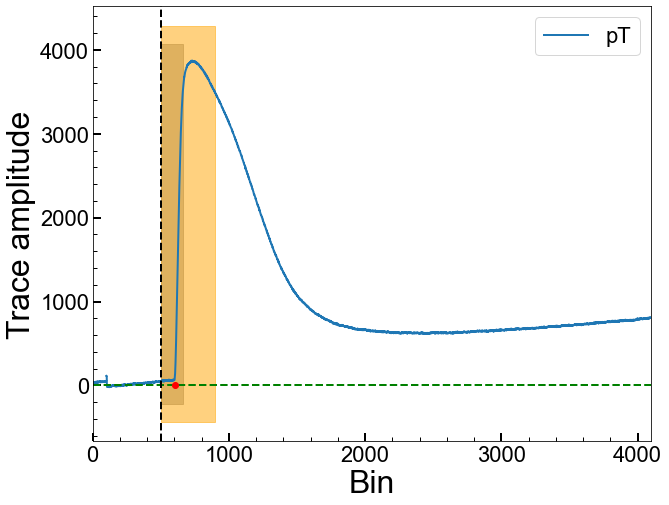

Series Number: 72209162200
Event Number: 770287
Energy: 46.97076571267 keV
Area: 498596.6420090069


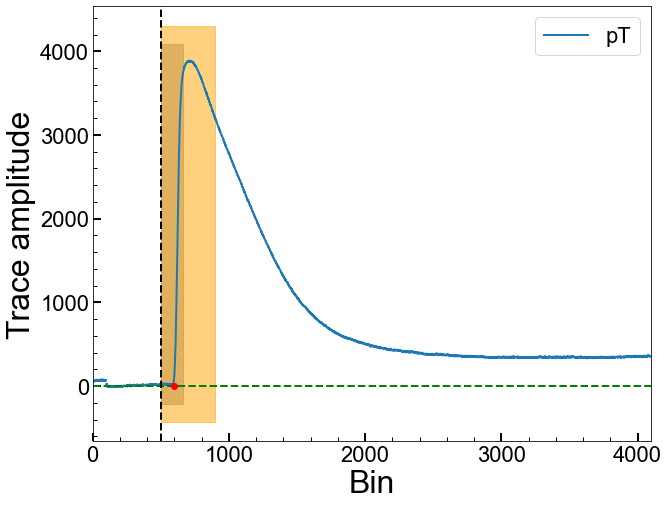

Series Number: 72209162200
Event Number: 780145
Energy: 19.11351039441 keV
Area: 626338.4439472842


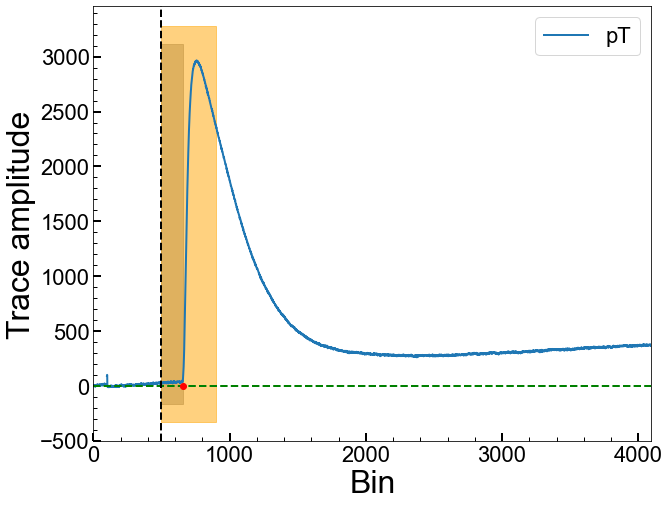

Series Number: 72209162200
Event Number: 780259
Energy: 42.96025814043 keV
Area: 555851.2625356013


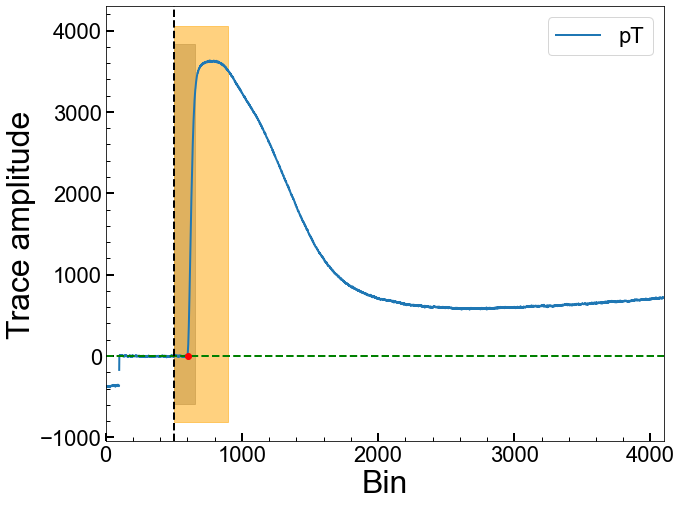

Series Number: 72209162200
Event Number: 780278
Energy: 29.04350339262 keV
Area: 506882.4407763722


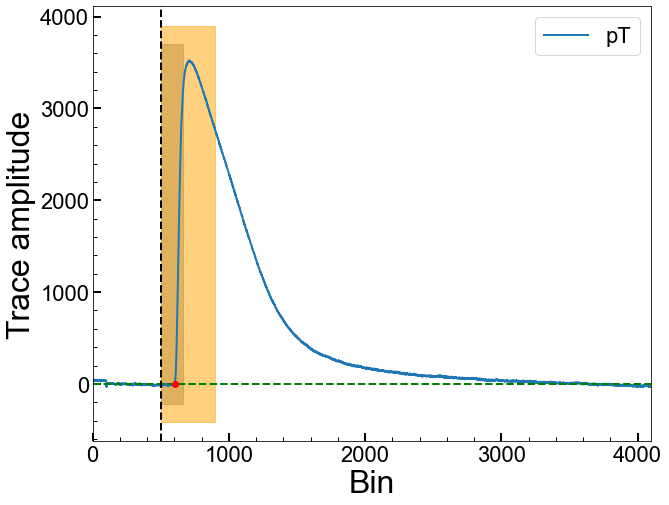

Series Number: 72209162200
Event Number: 780628
Energy: 39.48083097848 keV
Area: -2725924.399264249


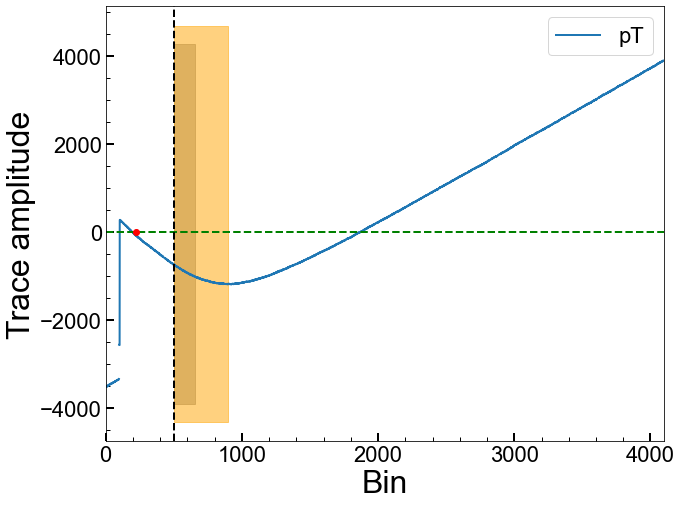

Series Number: 72209162200
Event Number: 800530
Energy: 16.18160476432 keV
Area: 391091.18021996244


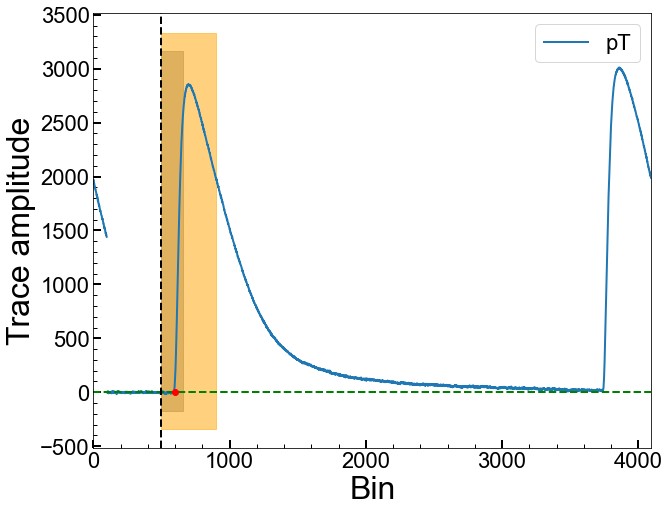

Series Number: 72209162200
Event Number: 810923
Energy: 28.05370719812 keV
Area: 337931.9059799314


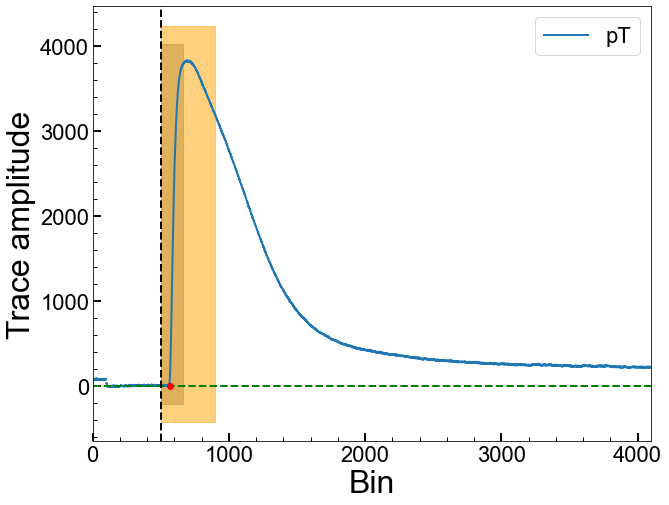

Series Number: 72209162200
Event Number: 820568
Energy: 25.58835179068 keV
Area: 170781.21176008487


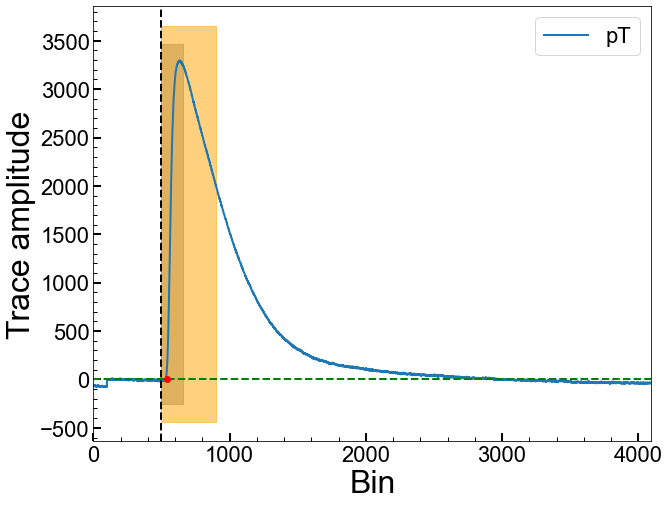

Series Number: 72209162200
Event Number: 840012
Energy: 12.26040462529 keV
Area: 489990.02512012736


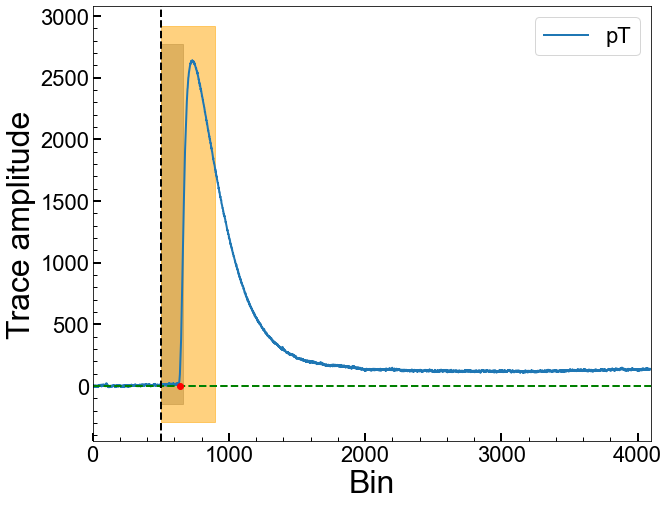

Series Number: 72209162200
Event Number: 840222
Energy: 39.03736453775 keV
Area: 372707.5614806463


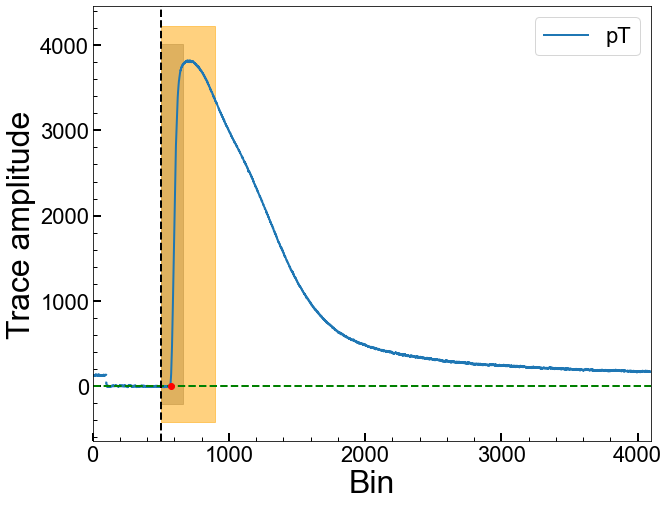

Series Number: 72209162200
Event Number: 850265
Energy: 28.29901818891 keV
Area: 181025.9990713907


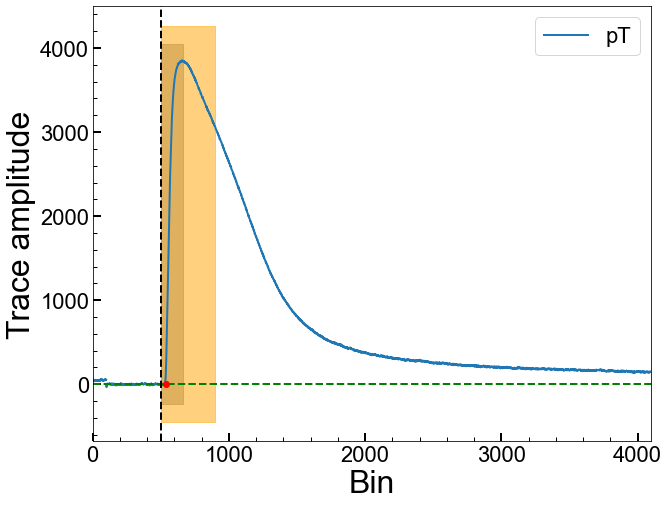

Series Number: 72209162200
Event Number: 860663
Energy: 28.96005894689 keV
Area: 590223.6133963835


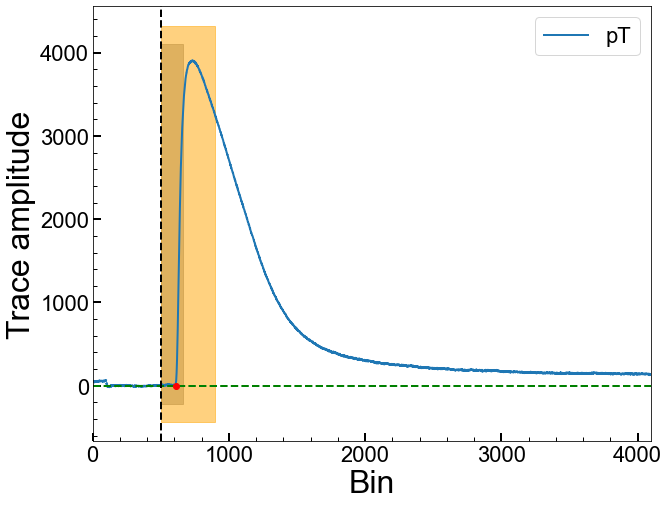

Series Number: 72209162200
Event Number: 880573
Energy: 47.92519769249 keV
Area: 734867.104103753


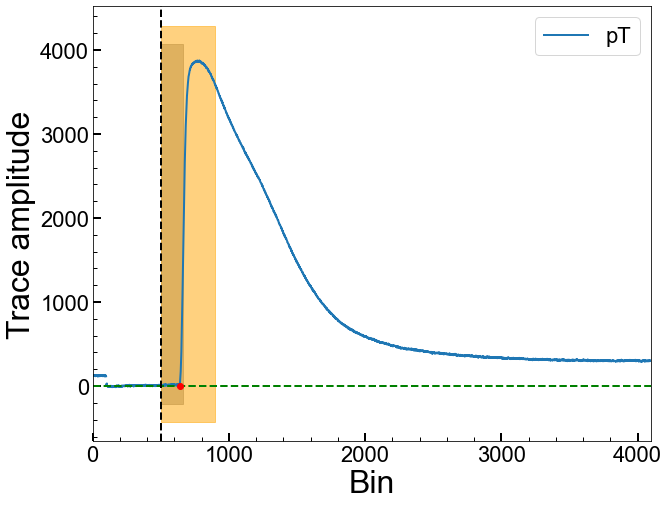

Series Number: 72209162200
Event Number: 880913
Energy: 19.42054788907 keV
Area: 459589.91835975426


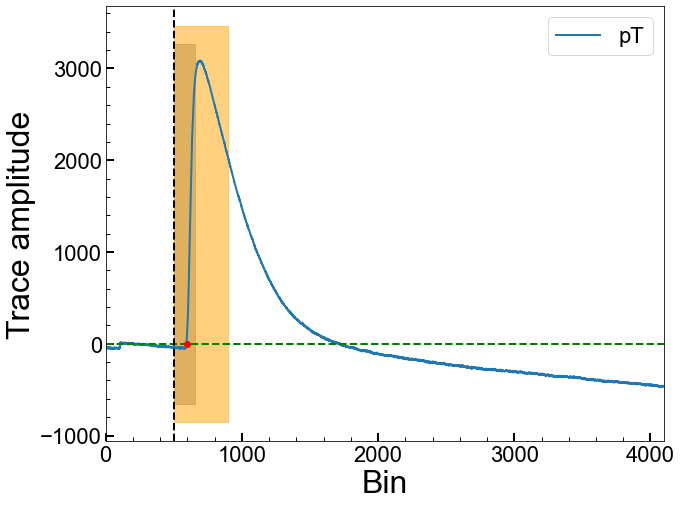

Series Number: 72209162200
Event Number: 910282
Energy: 49.57420649544 keV
Area: 589771.900017312


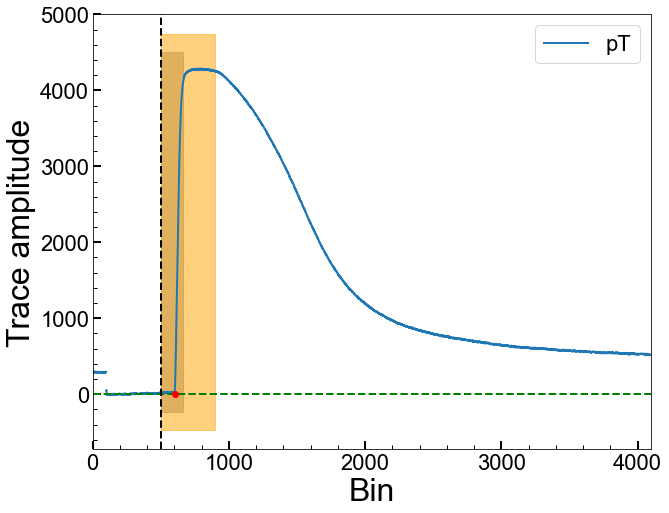

Series Number: 72209162200
Event Number: 920809
Energy: 2.677763066153 keV
Area: 235346.03966426346


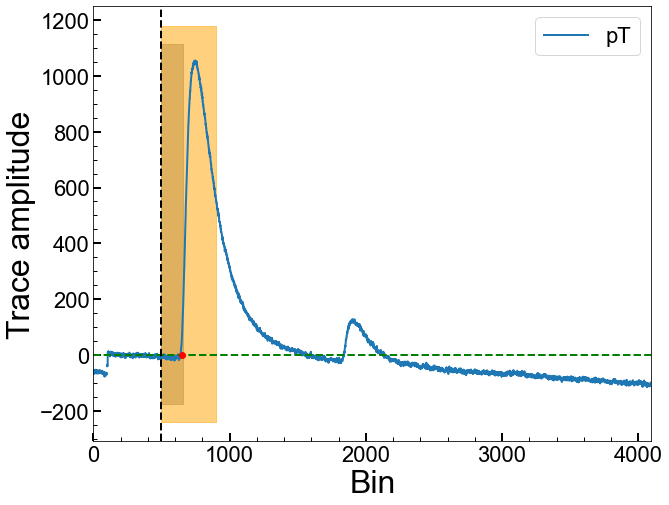

Series Number: 72209162200
Event Number: 920948
Energy: 3.558577288045 keV
Area: 940955.9656640001


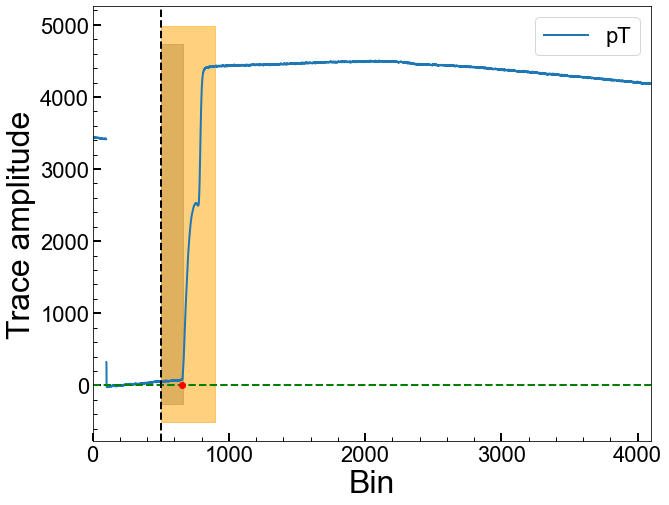

Series Number: 72209162200
Event Number: 930239
Energy: 20.01647378765 keV
Area: -1500940.485112939


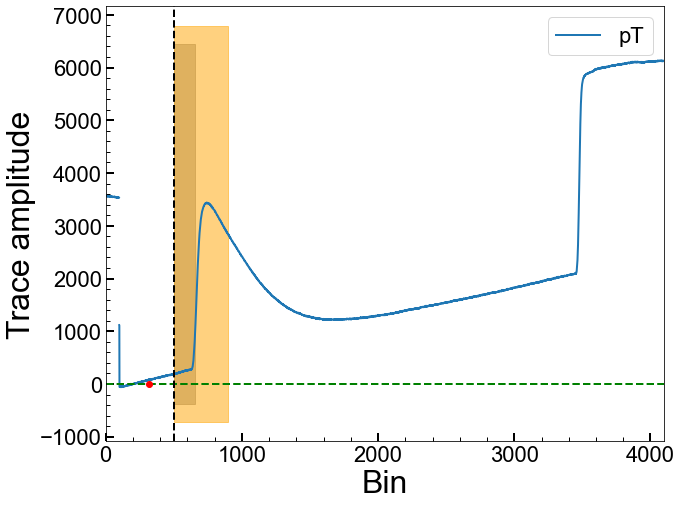

Series Number: 72209162200
Event Number: 930872
Energy: 35.66536743006 keV
Area: 848606.1884612277


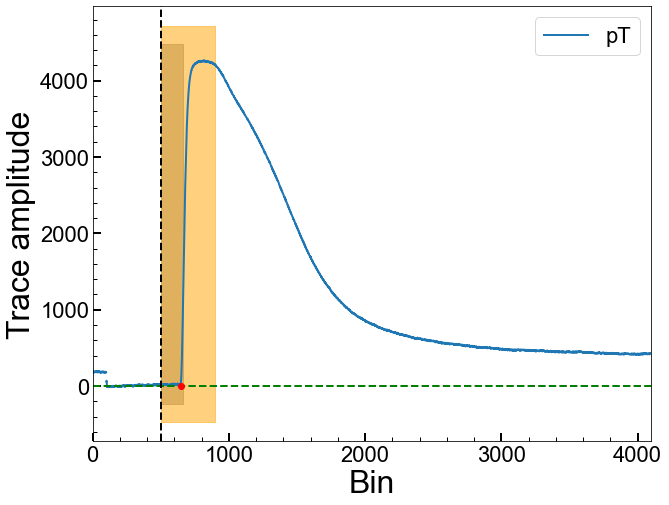

Series Number: 72209162200
Event Number: 940631
Energy: 18.33925808424 keV
Area: 513950.77436320996


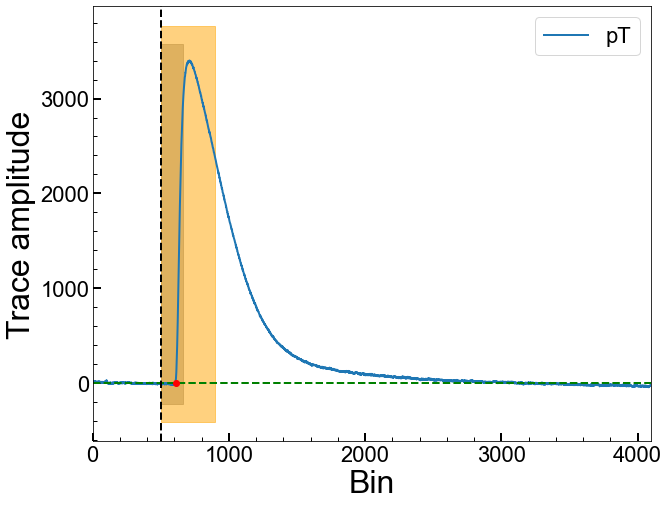

Series Number: 72209162200
Event Number: 950888
Energy: 49.94454468638 keV
Area: 108165.05373331573


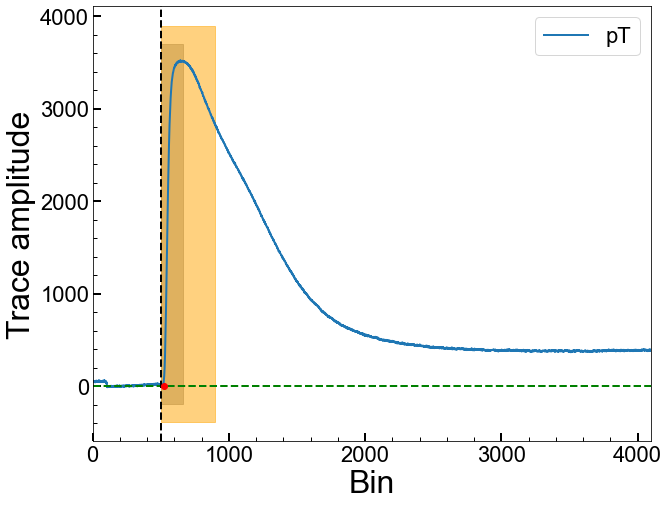

Series Number: 72209162200
Event Number: 960920
Energy: 44.04910447711 keV
Area: 496410.88206884597


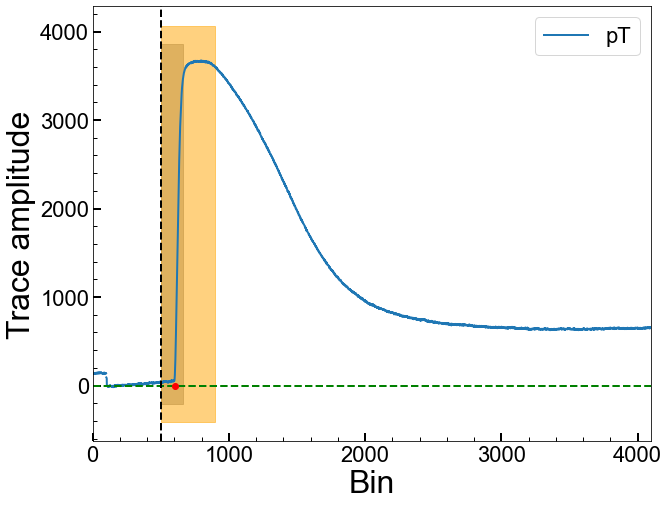

Series Number: 72209162200
Event Number: 970767
Energy: 47.91986636021 keV
Area: 165837.59056260486


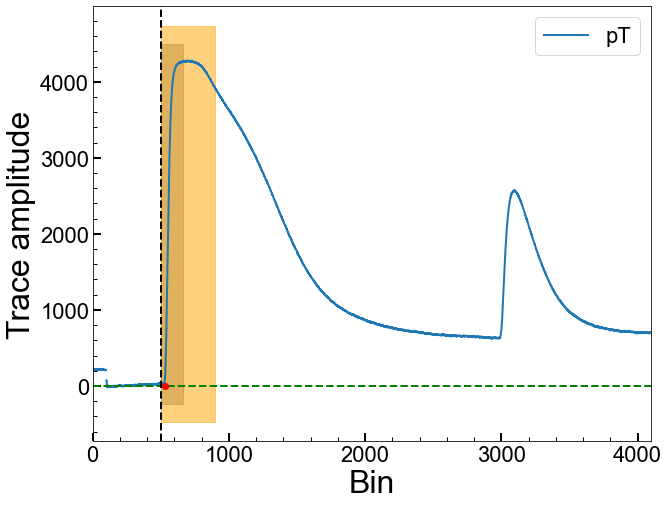

Series Number: 72209162200
Event Number: 1000241
Energy: 22.05356716962 keV
Area: 662750.8780287417


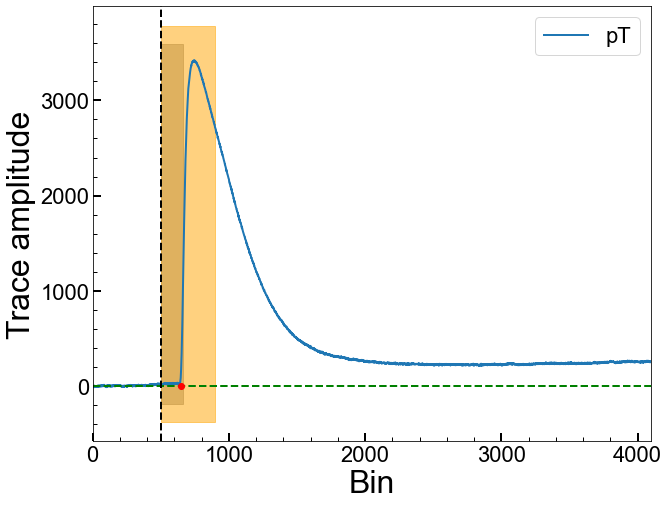

Series Number: 72209162200
Event Number: 1040569
Energy: 2.157513697256 keV
Area: 175788.30639308057


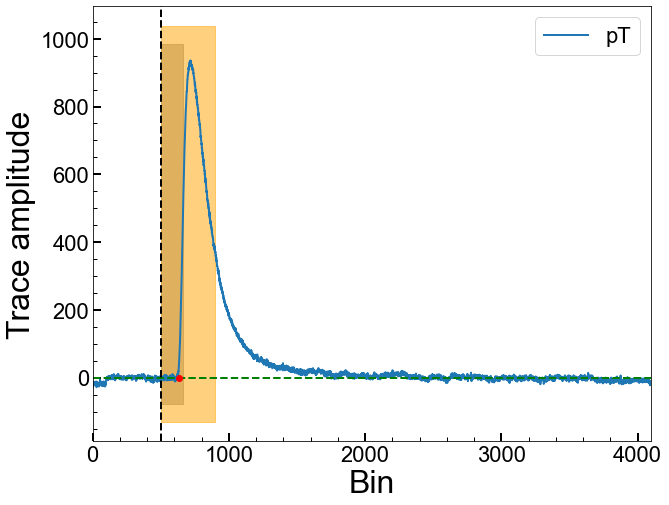

Series Number: 72209162200
Event Number: 1050223
Energy: 16.92261873535 keV
Area: 652460.9402404417


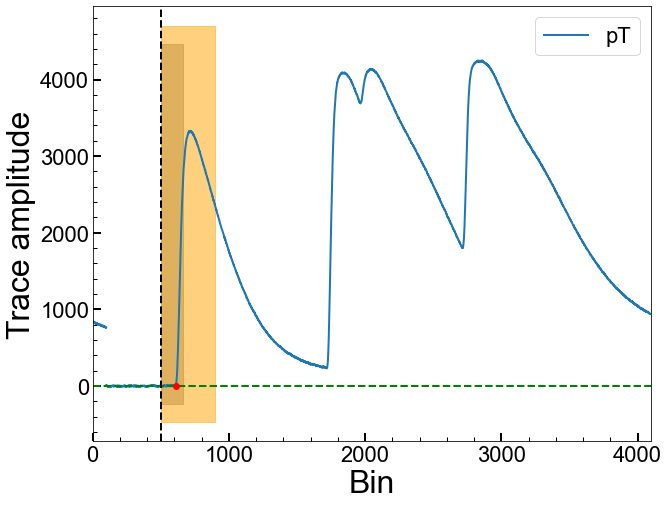

Series Number: 72209162200
Event Number: 1050803
Energy: 27.51943116817 keV
Area: -1086781.2106937924


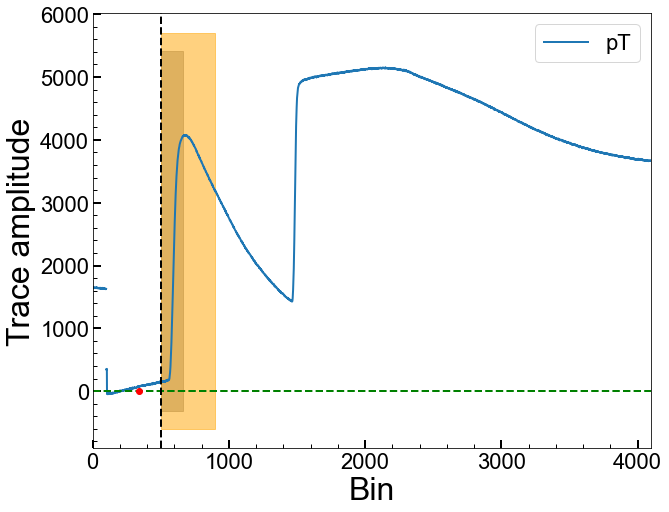

Series Number: 72209162200
Event Number: 1060435
Energy: 9.602936728145 keV
Area: 424655.0812153362


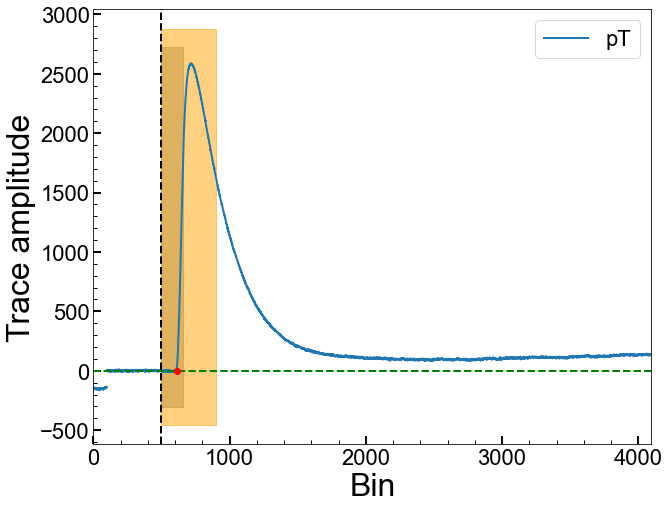

Series Number: 72209162200
Event Number: 1060589
Energy: 46.60446373323 keV
Area: 607159.6217836367


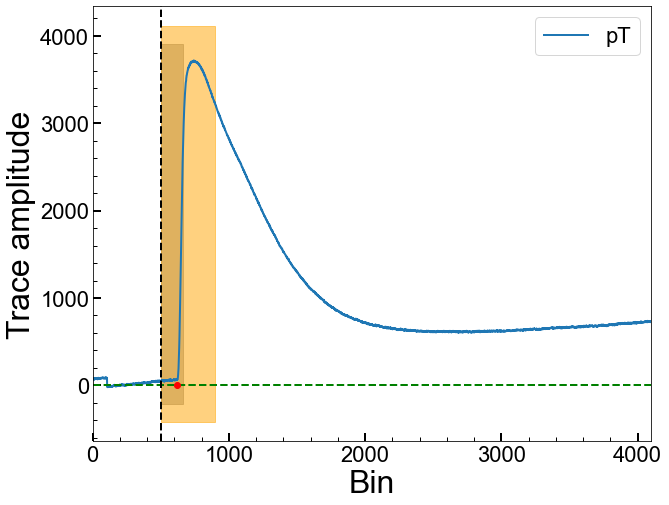

Series Number: 72209162200
Event Number: 1070509
Energy: 47.55945117602 keV
Area: -4170348.519415668


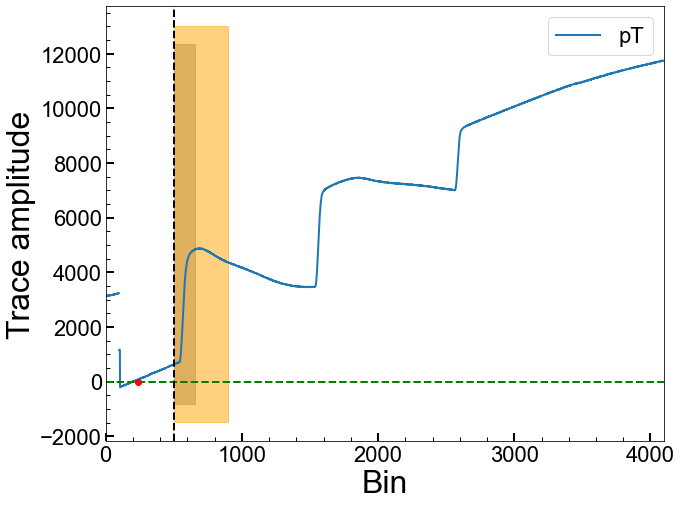

Series Number: 72209162200
Event Number: 1080401
Energy: 44.51165262551 keV
Area: 390296.53646673425


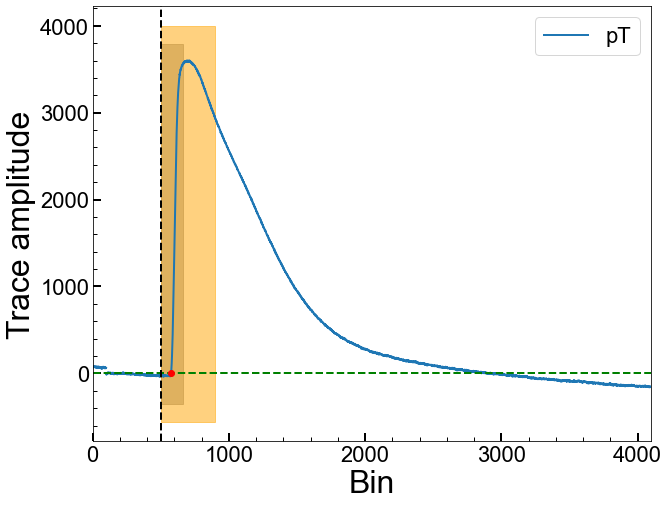

Series Number: 72209162200
Event Number: 1090346
Energy: 21.57210275566 keV
Area: 558775.25163004


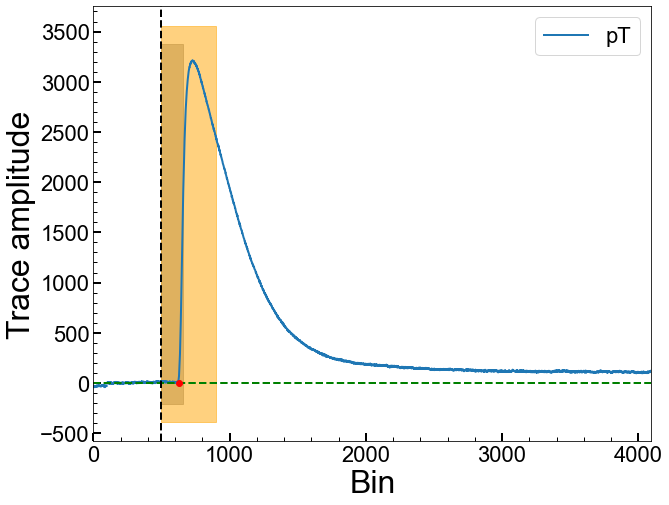

Series Number: 72209162200
Event Number: 1090619
Energy: 15.41245470353 keV
Area: 235426.62586021805


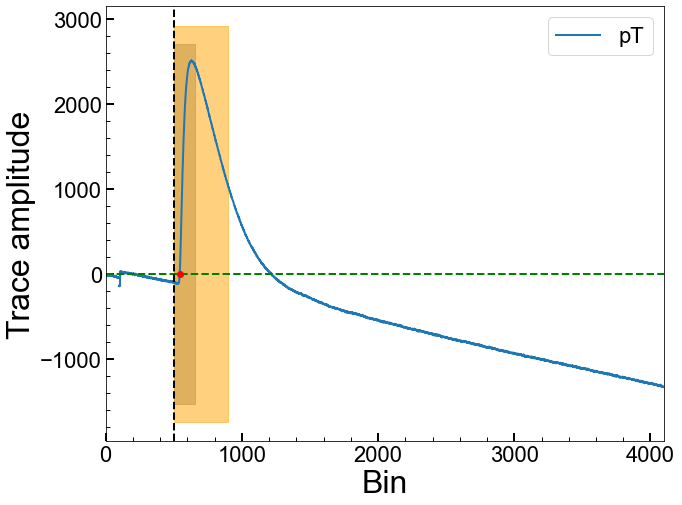

Series Number: 72209162200
Event Number: 1090622
Energy: 24.2451915796 keV
Area: 442484.5519576297


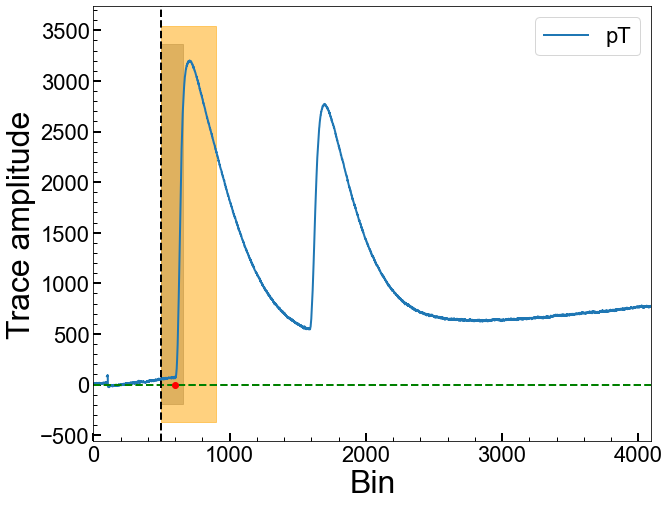

Series Number: 72209162200
Event Number: 1100492
Energy: 12.69641815982 keV
Area: 509997.4052366791


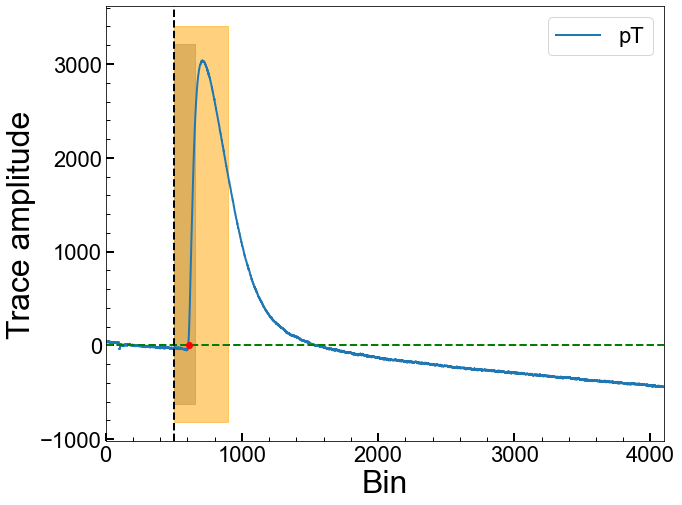

Series Number: 72209162200
Event Number: 1110143
Energy: 36.21041003857 keV
Area: -1854039.2806988244


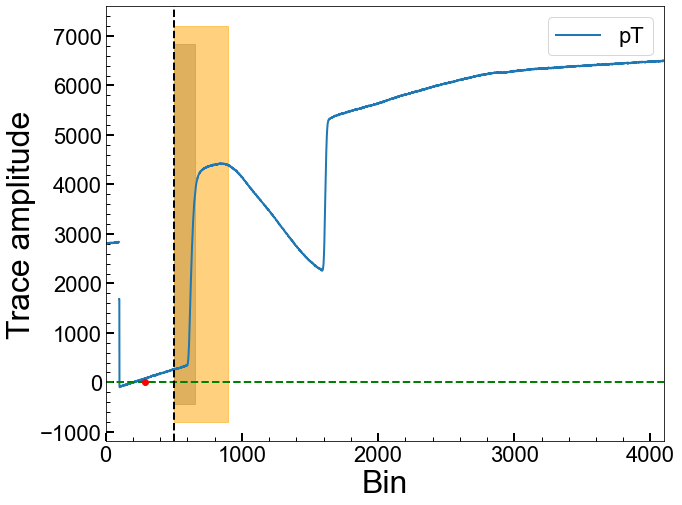

Series Number: 72209162200
Event Number: 1110649
Energy: 5.344629272564 keV
Area: 332385.56163662


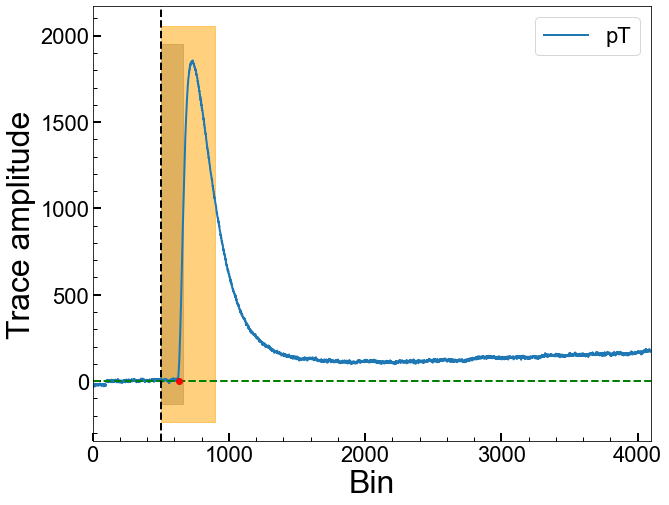

Series Number: 72209162200
Event Number: 1110879
Energy: 38.8023586011 keV
Area: 91222.49586233645


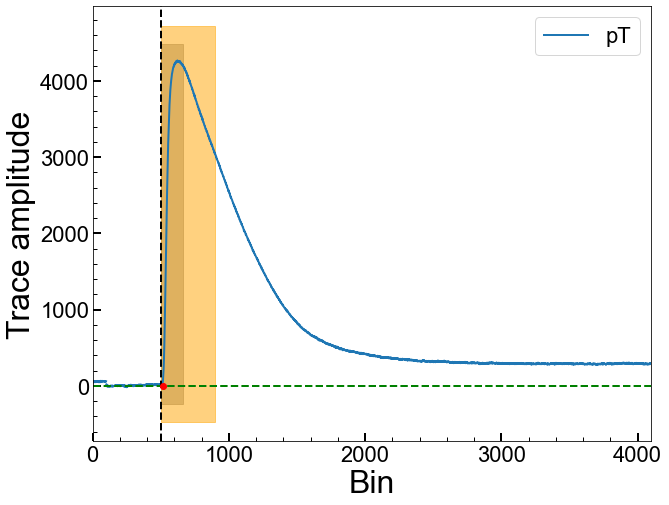

Series Number: 72209162200
Event Number: 1120457
Energy: 15.89377578251 keV
Area: 145315.488272106


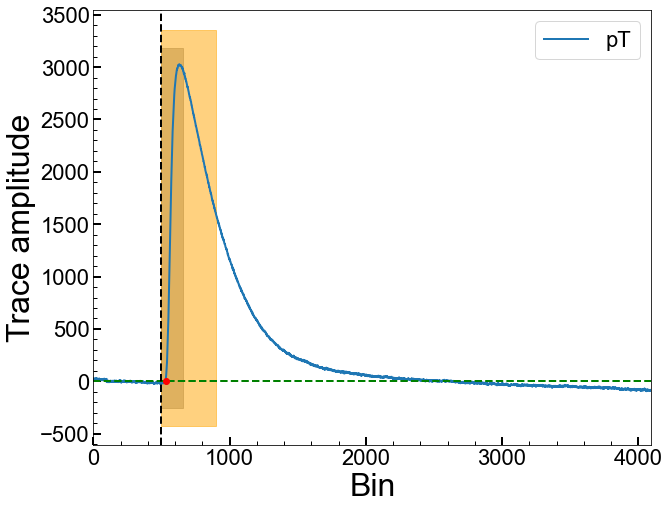

Series Number: 72209162200
Event Number: 1130006
Energy: 34.04177862434 keV
Area: -4792358.629474134


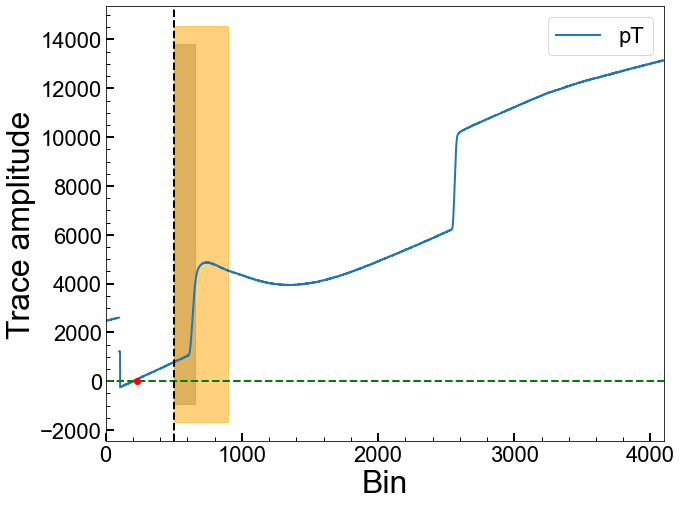

Series Number: 72209162200
Event Number: 1130100
Energy: 40.41023522827 keV
Area: 554553.1967760951


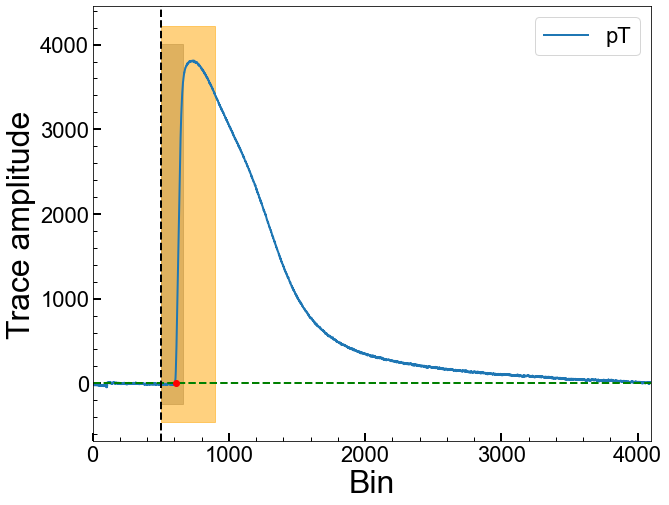

Series Number: 72209162200
Event Number: 1130568
Energy: 11.20794050509 keV
Area: 501241.5755920523


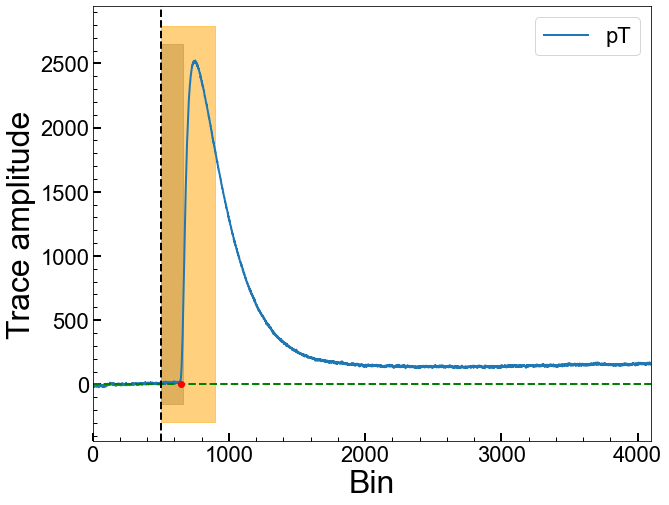

Series Number: 72209162200
Event Number: 1150306
Energy: 38.32398986079 keV
Area: 622573.9264794562


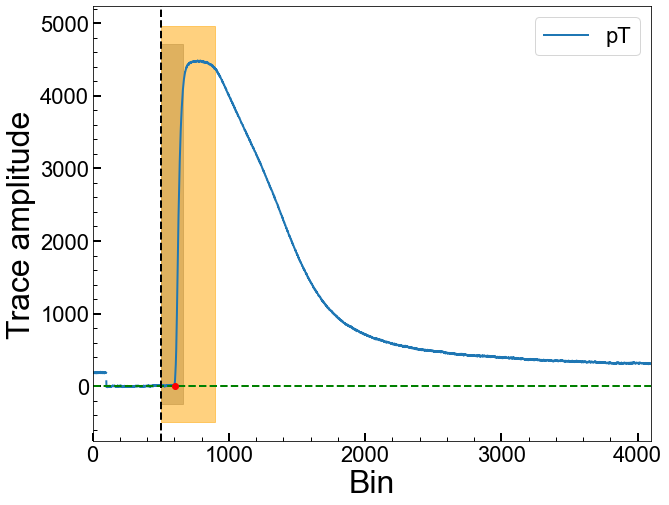

Series Number: 72209162200
Event Number: 1150698
Energy: 25.28197363466 keV
Area: 287268.422961526


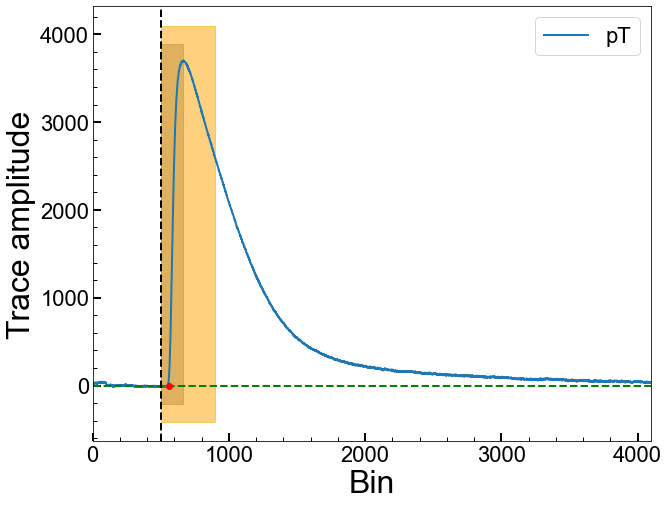

Series Number: 72209162200
Event Number: 1190784
Energy: 38.43668663771 keV
Area: 430580.77881303336


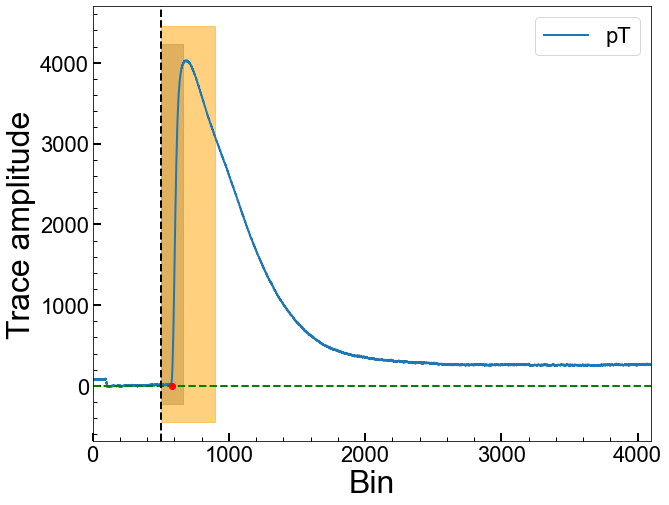

Series Number: 72209162200
Event Number: 1190807
Energy: 47.68626685978 keV
Area: 51283.02867617486


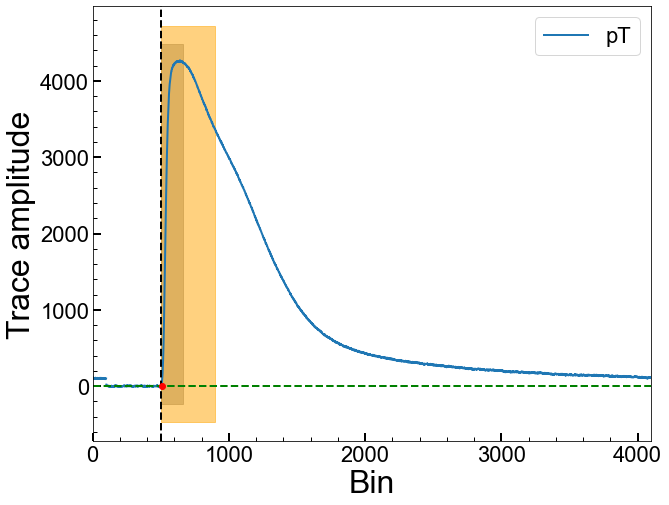

Series Number: 72209162200
Event Number: 1210219
Energy: 18.43451157312 keV
Area: 359568.412603677


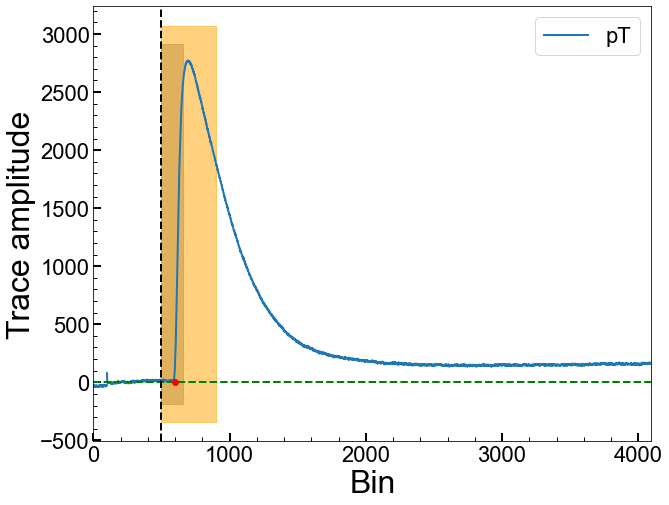

Series Number: 72209162200
Event Number: 1210850
Energy: 10.67275916134 keV
Area: 396917.8723140664


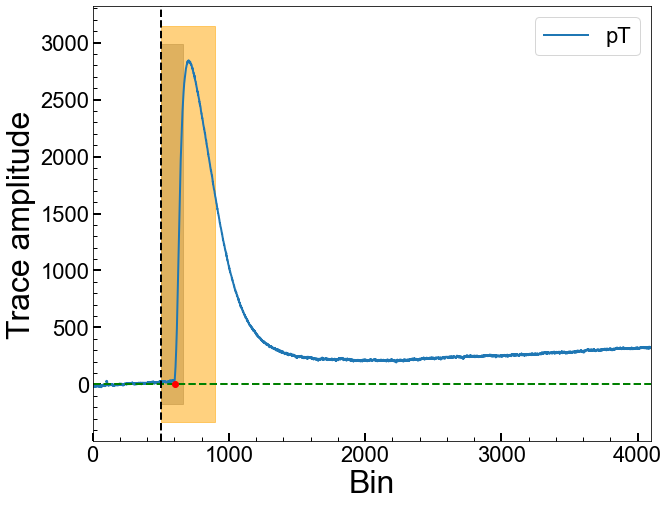

Series Number: 72209162200
Event Number: 1220023
Energy: 40.95755239957 keV
Area: 831185.1102623846


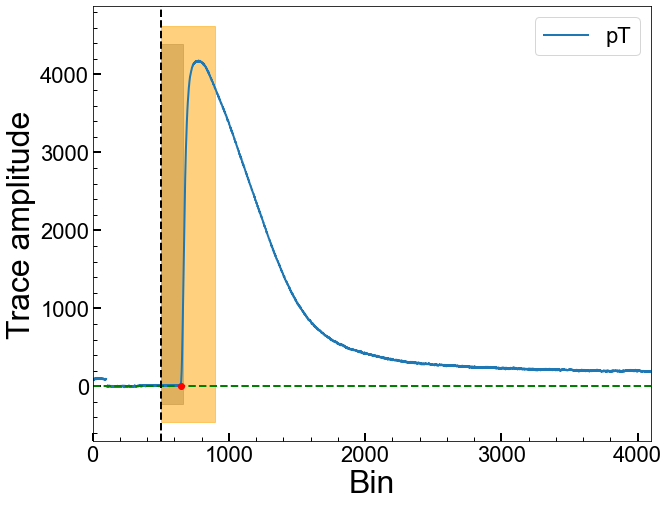

Series Number: 72209162200
Event Number: 1250215
Energy: 11.69261432949 keV
Area: 454794.84654291783


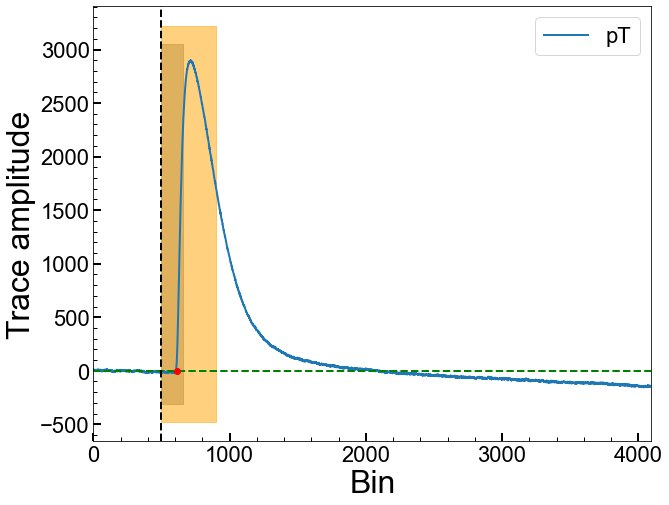

Series Number: 72209162200
Event Number: 1250530
Energy: 17.83317656767 keV
Area: 251654.46284582754


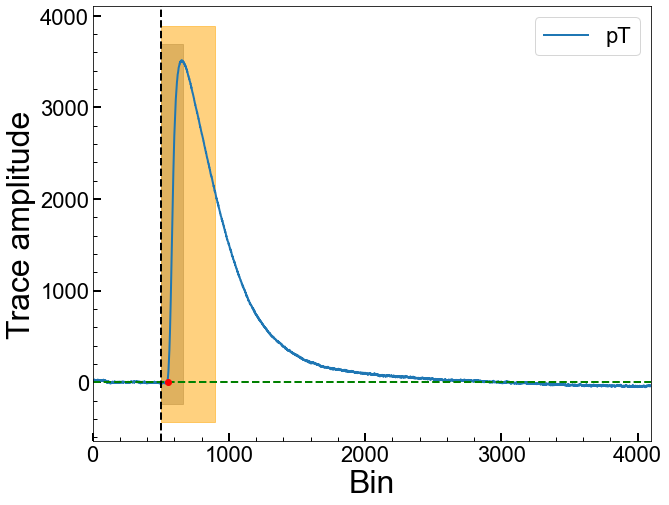

Series Number: 72209162200
Event Number: 1260025
Energy: 21.69550591775 keV
Area: 596214.1844112426


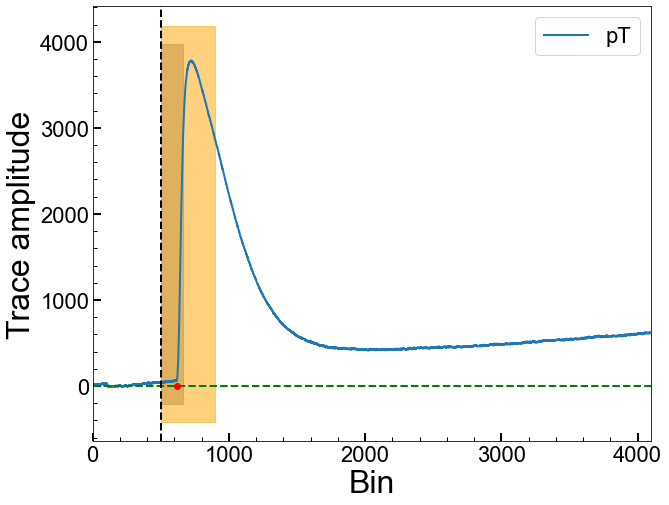

Series Number: 72209162200
Event Number: 1260636
Energy: 48.42700489778 keV
Area: 603492.00411041


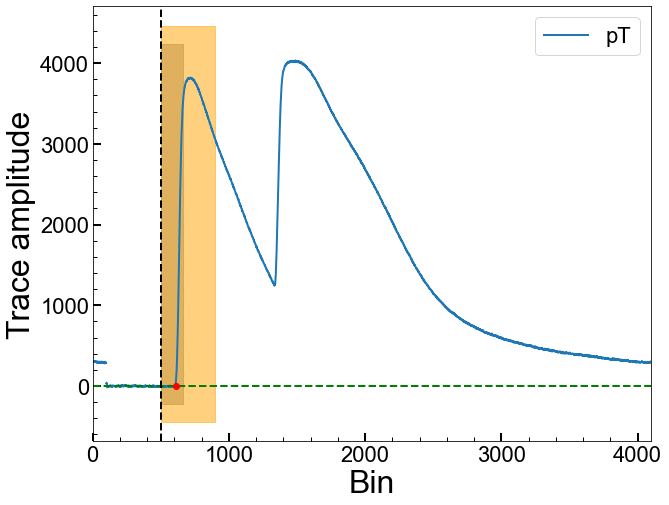

Series Number: 72209162200
Event Number: 1270435
Energy: 26.53003624339 keV
Area: -1576422.8931882912


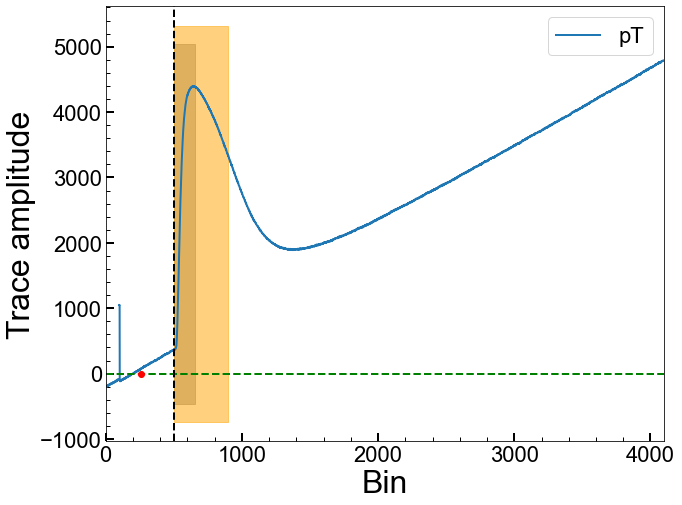

Series Number: 72209162200
Event Number: 1290108
Energy: 7.559647516735 keV
Area: 207247.6993910515


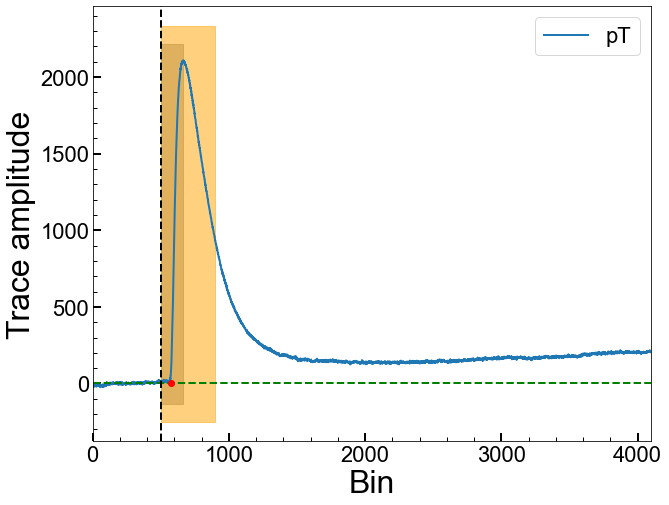

Series Number: 72209162200
Event Number: 1290407
Energy: 10.87202261475 keV
Area: -4108821.22826176


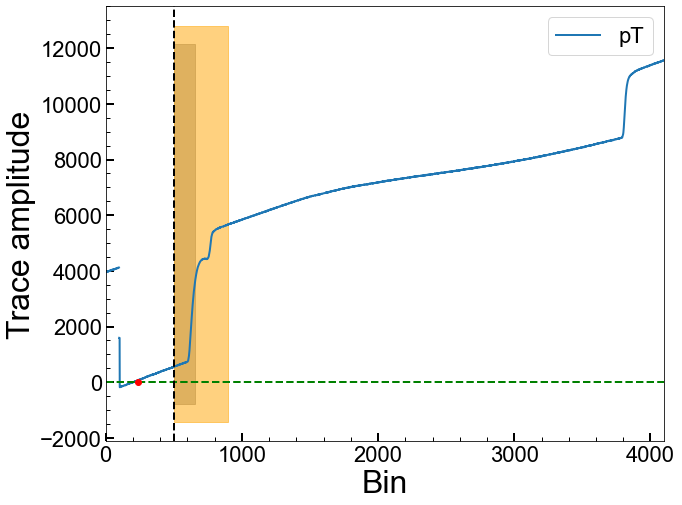

Series Number: 72209162200
Event Number: 1330157
Energy: 40.32610514816 keV
Area: 65124.188021986774


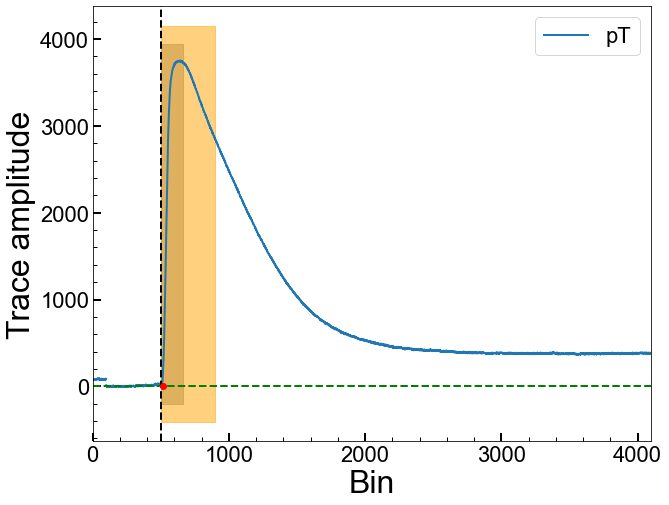

Series Number: 72209162200
Event Number: 1350141
Energy: 9.202775232984 keV
Area: 355169.666374994


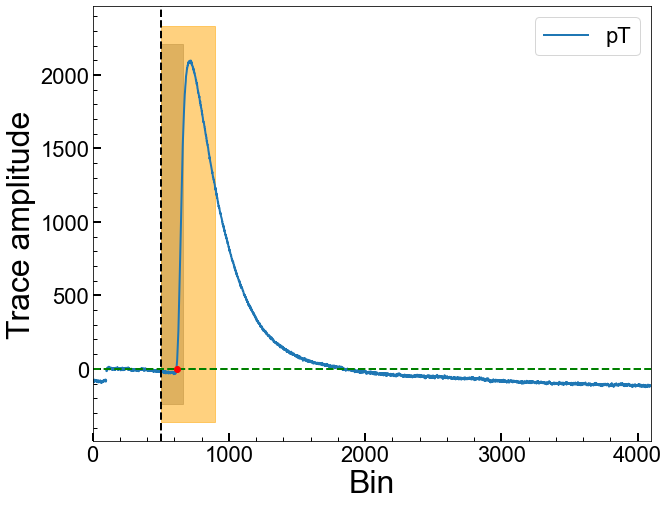

Series Number: 72209162200
Event Number: 1350308
Energy: 8.052709231674 keV
Area: 267406.4130266384


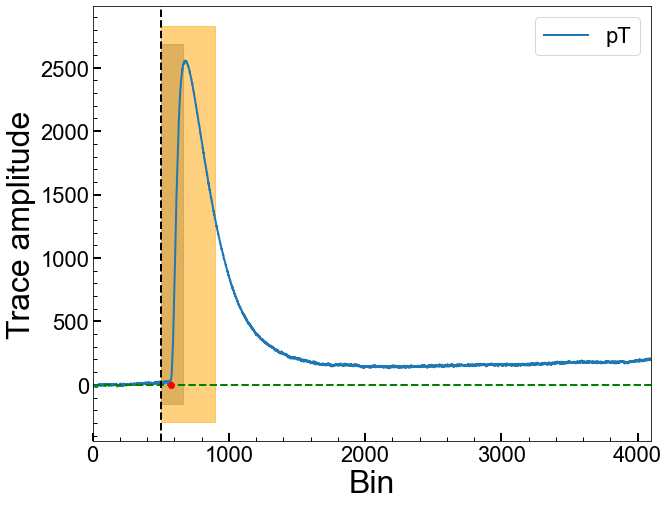

Series Number: 72209162200
Event Number: 1380316
Energy: 29.92226589324 keV
Area: 595702.182975237


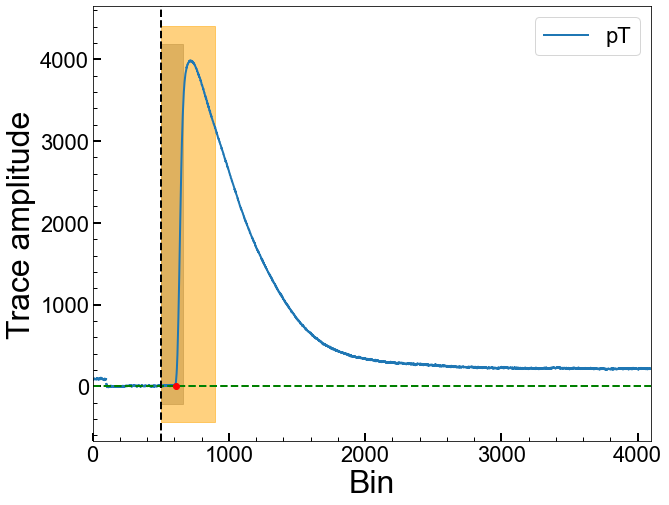

Series Number: 72209162200
Event Number: 1390032
Energy: 9.937939722855 keV
Area: 360016.75287969114


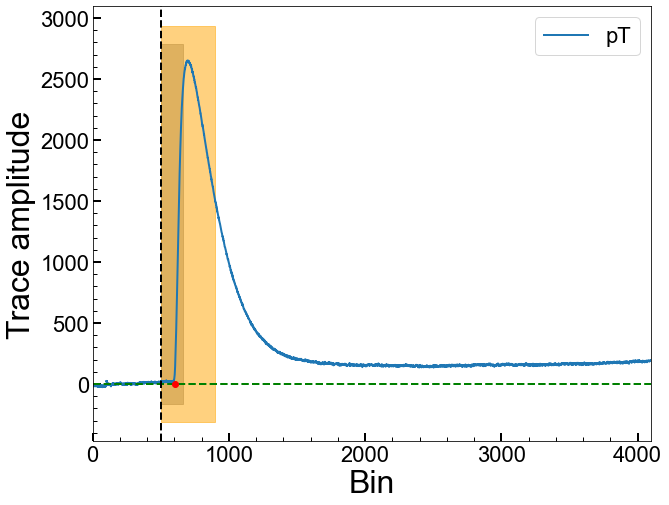

Series Number: 72209162200
Event Number: 1390085
Energy: 32.13118302306 keV
Area: 46025.97968032494


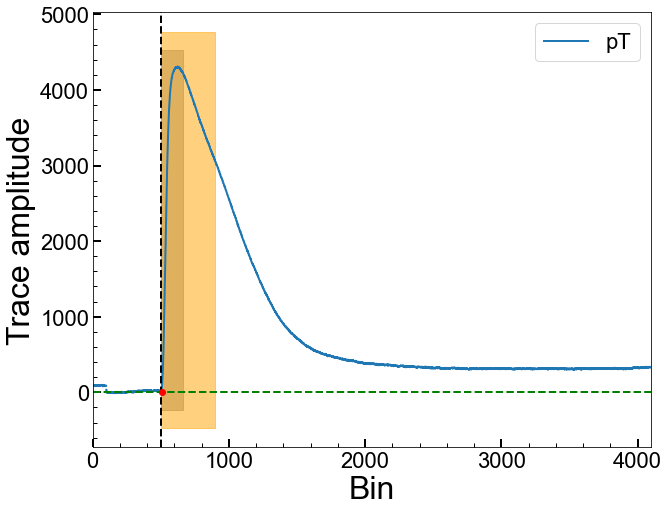

Series Number: 72209162200
Event Number: 1410541
Energy: 37.19507432221 keV
Area: -4254177.409798009


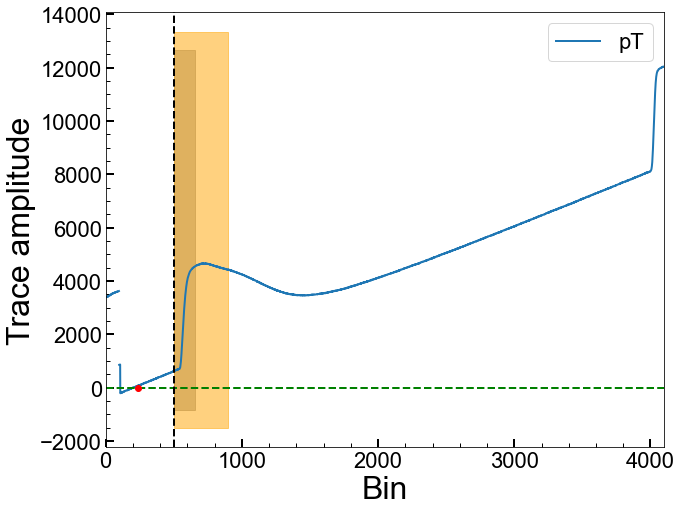

Series Number: 72209162200
Event Number: 1420675
Energy: 49.91685787574 keV
Area: 737689.0695248748


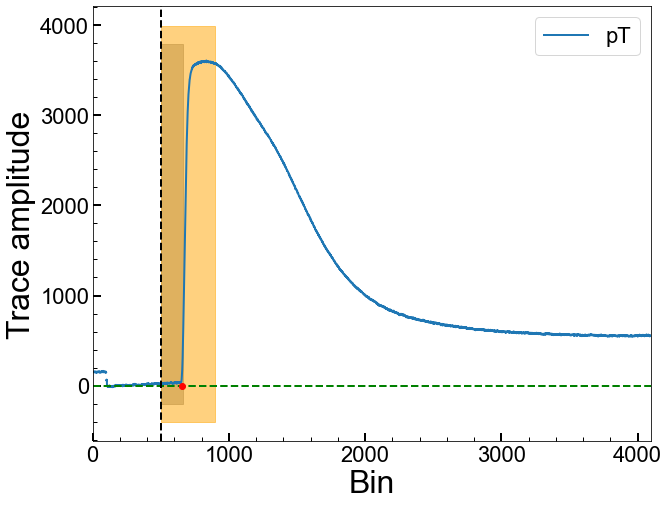

Series Number: 72209162200
Event Number: 1430009
Energy: 21.21082474807 keV
Area: 716756.6541678129


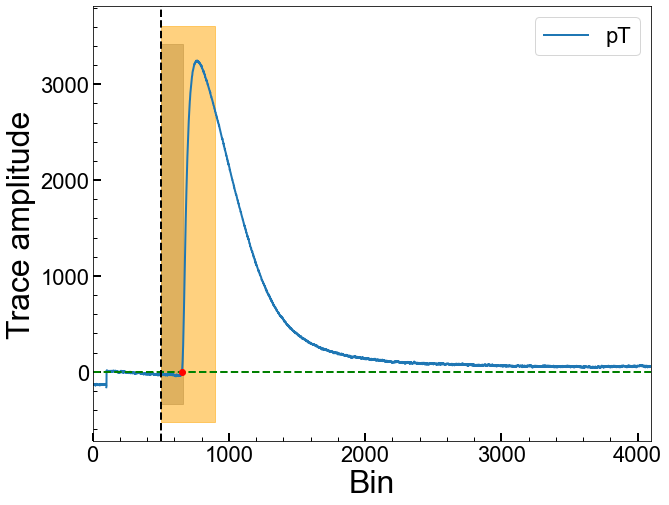

Series Number: 72209162200
Event Number: 1430558
Energy: 31.17963590021 keV
Area: 682391.6033149194


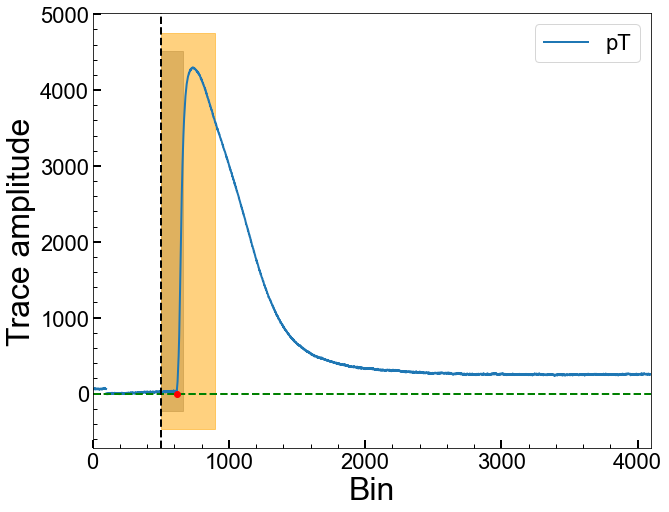

Series Number: 72209162200
Event Number: 1430862
Energy: 23.30244499159 keV
Area: 337158.0750049483


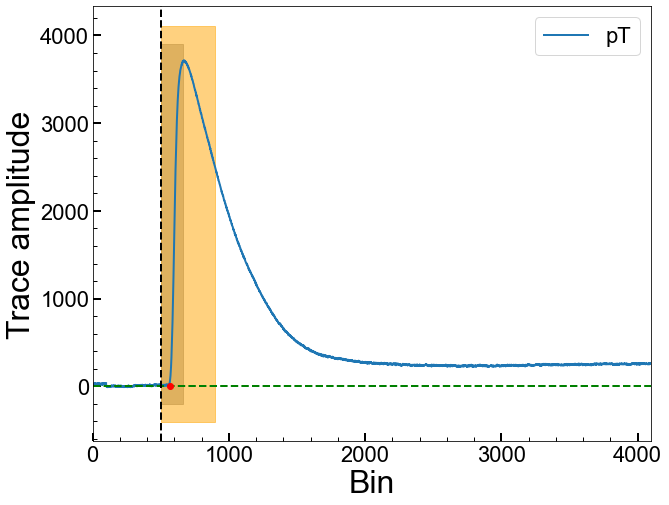

Series Number: 72209162200
Event Number: 1450019
Energy: 18.14541407961 keV
Area: 514562.79430604854


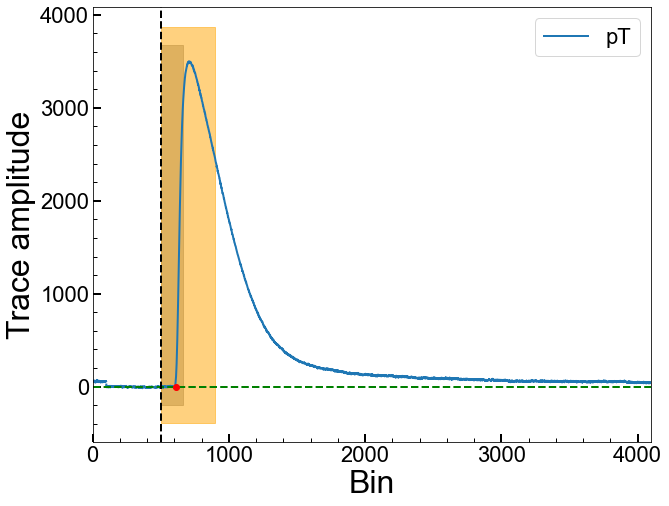

Series Number: 72209162200
Event Number: 1460495
Energy: 23.27074692432 keV
Area: 34659.14571936424


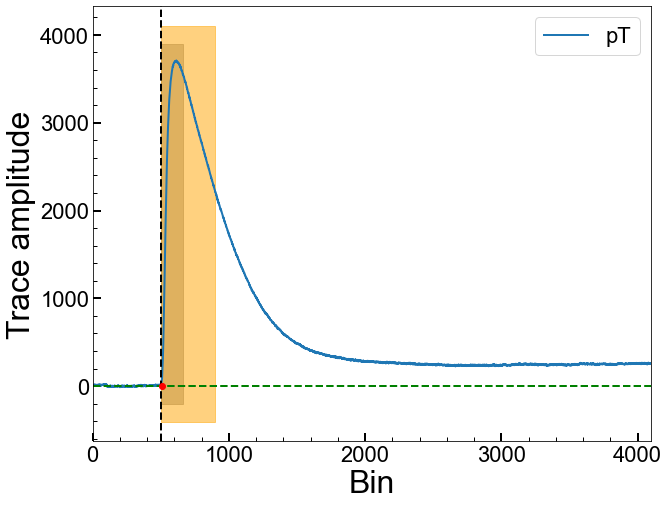

Series Number: 72209162200
Event Number: 1480382
Energy: 10.89235190592 keV
Area: 393784.93741220434


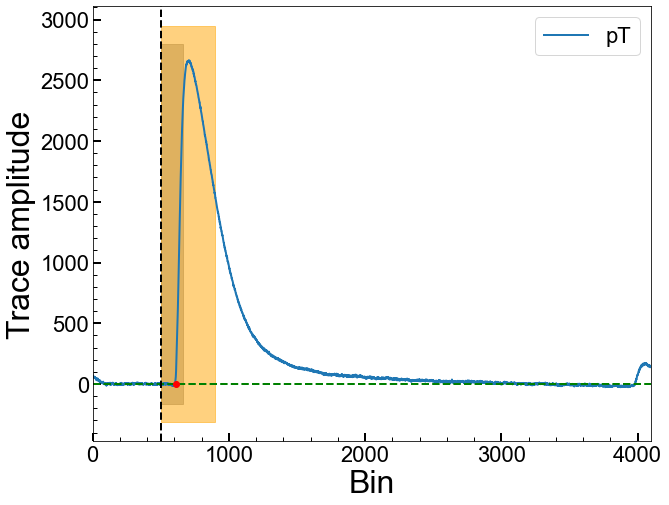

Series Number: 72209162200
Event Number: 1480663
Energy: 15.35148050706 keV
Area: 505104.82232661906


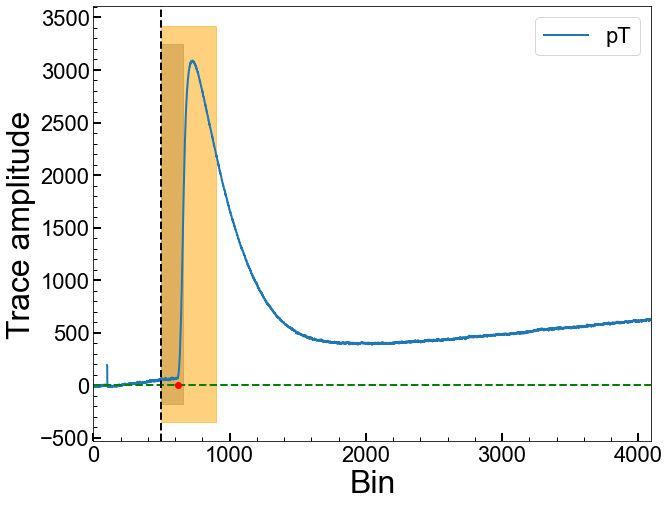

Series Number: 72209162200
Event Number: 1490320
Energy: 3.497370833538 keV
Area: 185185.8990671525


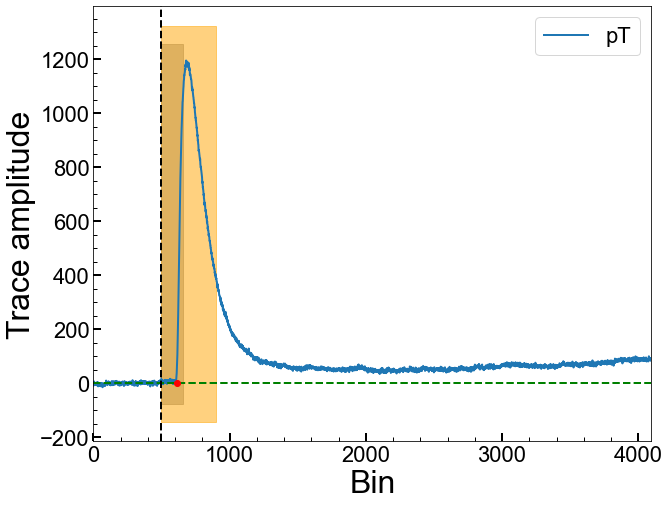

Series Number: 72209162200
Event Number: 1490368
Energy: 3.477842194456 keV
Area: 206525.09293771247


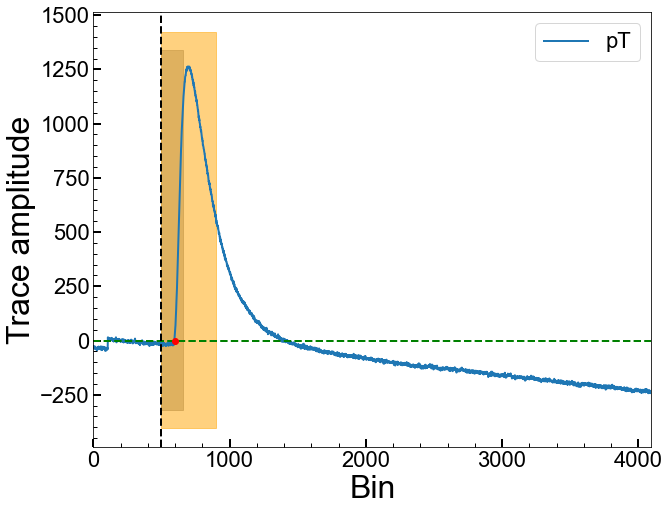

Series Number: 72209162200
Event Number: 1560422
Energy: 18.53047896701 keV
Area: 344429.28155569395


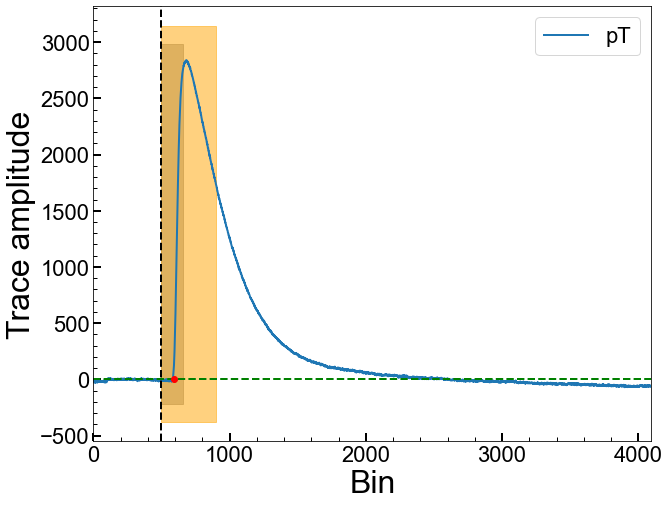

Series Number: 72209162200
Event Number: 1560594
Energy: 7.099822028172 keV
Area: 213372.83539912


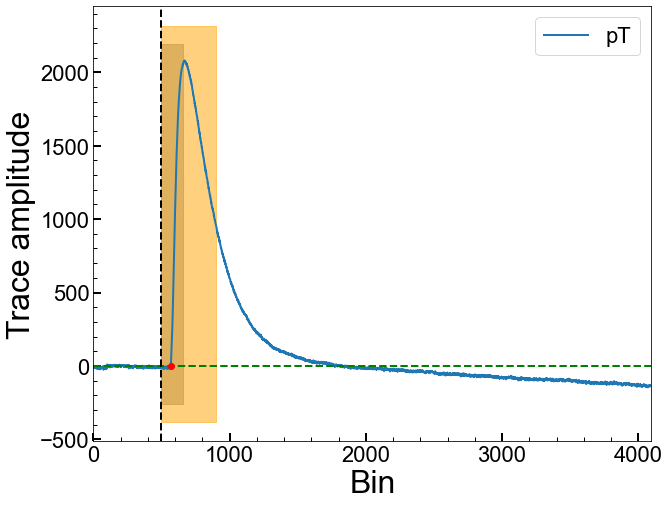

Series Number: 72209162200
Event Number: 1570496
Energy: 11.86678870628 keV
Area: 425489.7496487946


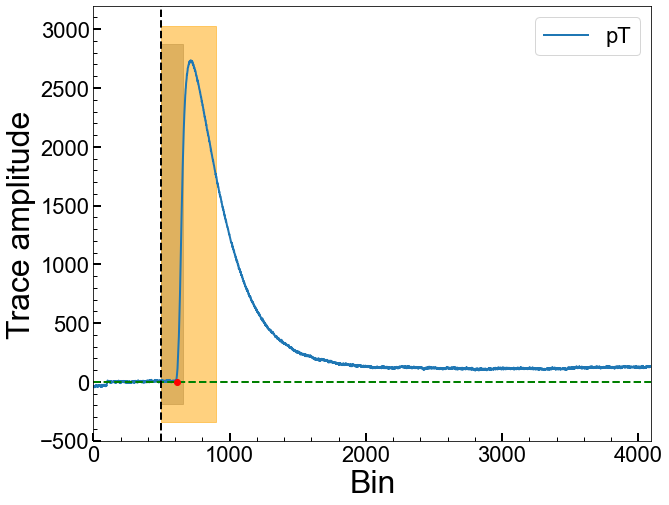

Series Number: 72209162200
Event Number: 1580288
Energy: 26.40747783331 keV
Area: 279881.61572182266


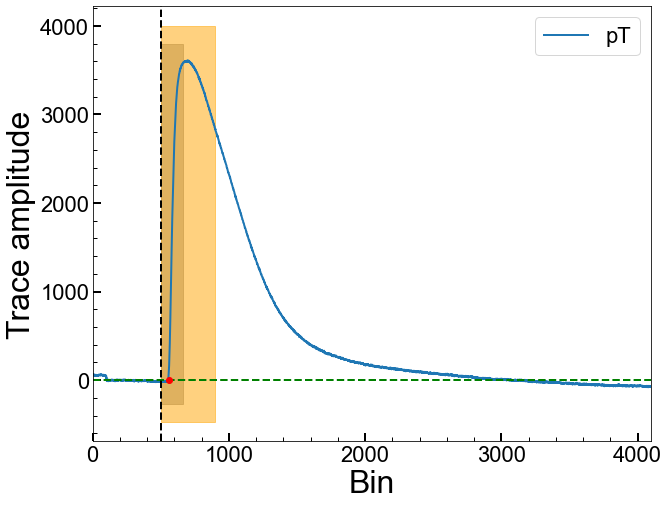

Series Number: 72209162200
Event Number: 1580536
Energy: 17.27604314994 keV
Area: 746373.65603412


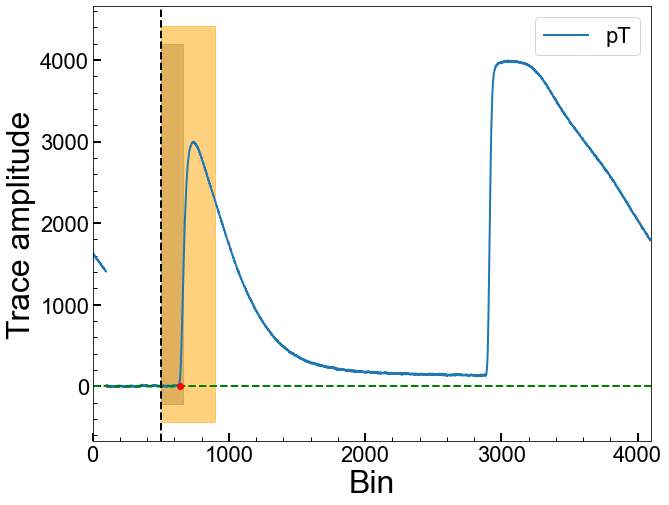

Series Number: 72209162200
Event Number: 1590154
Energy: 30.19243674415 keV
Area: 766454.6430057222


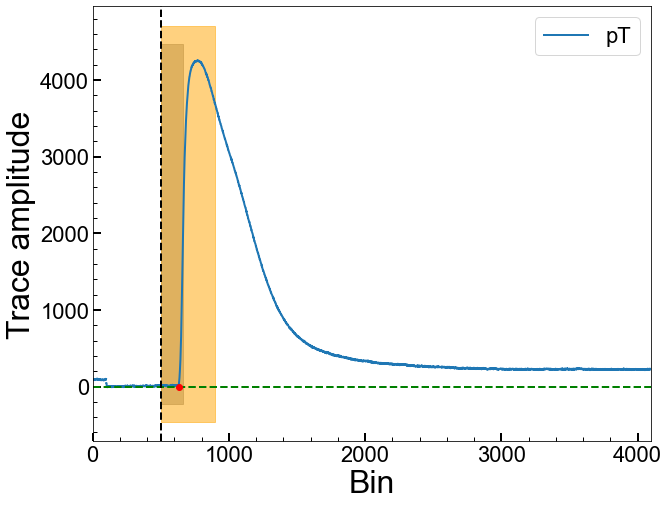

Series Number: 72209162200
Event Number: 1620713
Energy: 20.35426666708 keV
Area: -1464254.0703545422


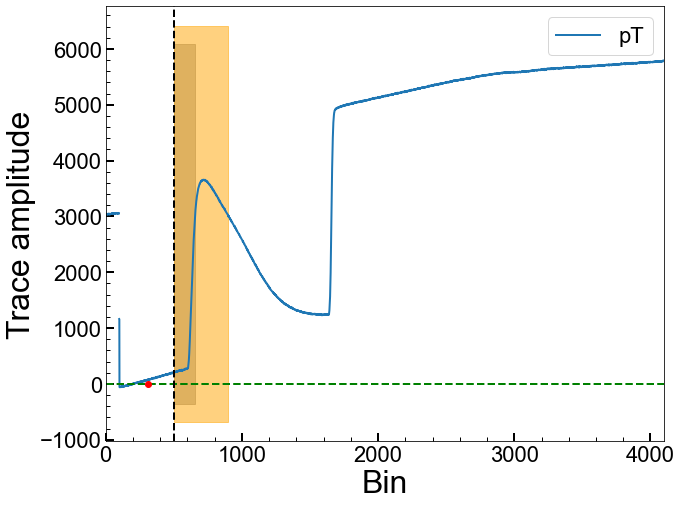

Series Number: 72209162200
Event Number: 1630843
Energy: 19.64406932085 keV
Area: 383576.0322272637


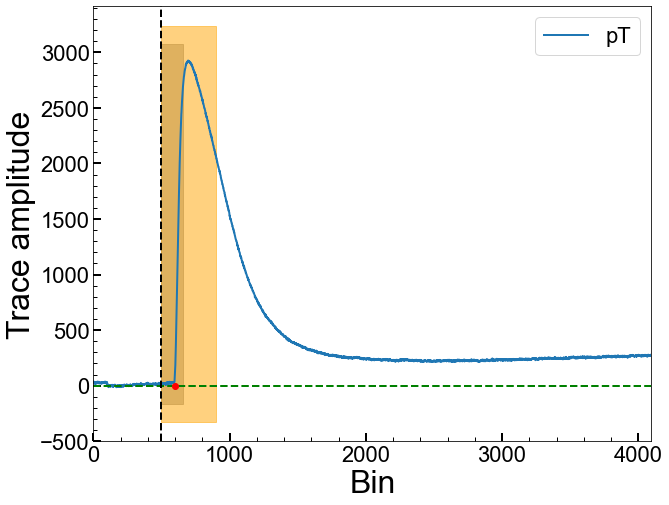

Series Number: 72209162200
Event Number: 1650404
Energy: 6.159375652222 keV
Area: 328522.97726876894


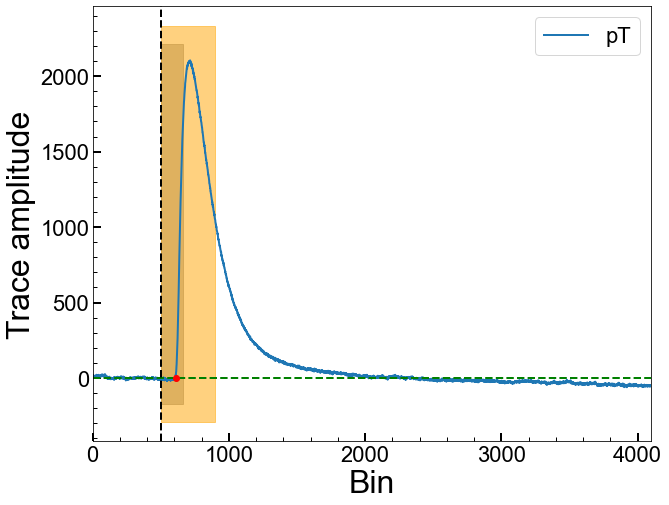

Series Number: 72209162200
Event Number: 1650858
Energy: 13.2002177401 keV
Area: 384192.7300739082


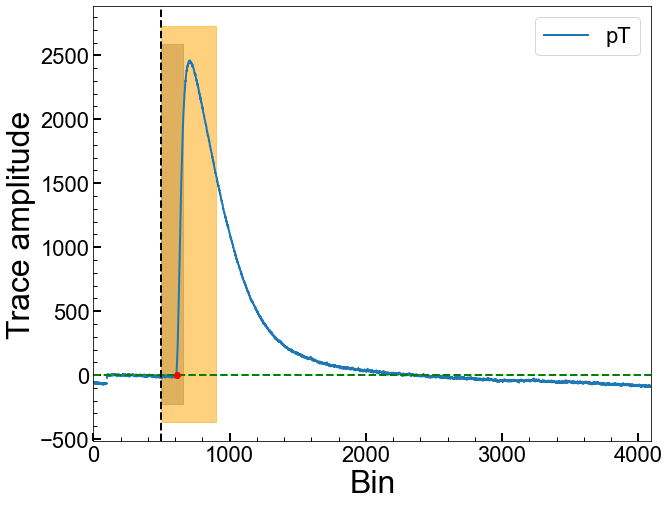

Series Number: 72209162200
Event Number: 1670558
Energy: 21.5215063253 keV
Area: 524469.0138439736


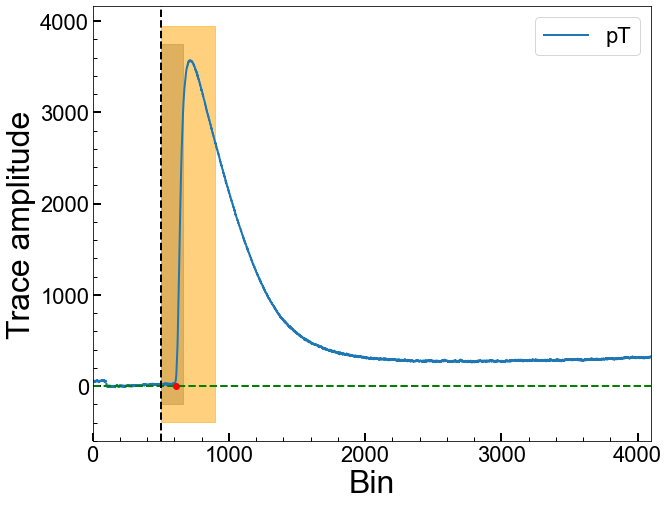

Series Number: 72209162200
Event Number: 1710640
Energy: 27.91737361505 keV
Area: 50640.274863258324


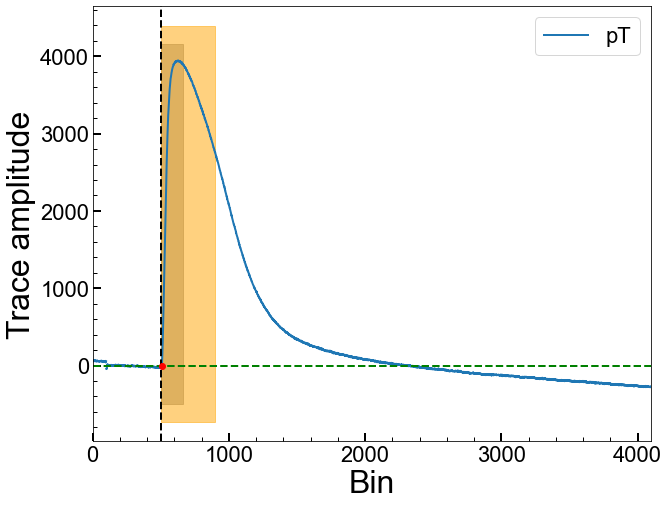

Series Number: 72209162200
Event Number: 1720361
Energy: 16.72863000549 keV
Area: -4402837.318670585


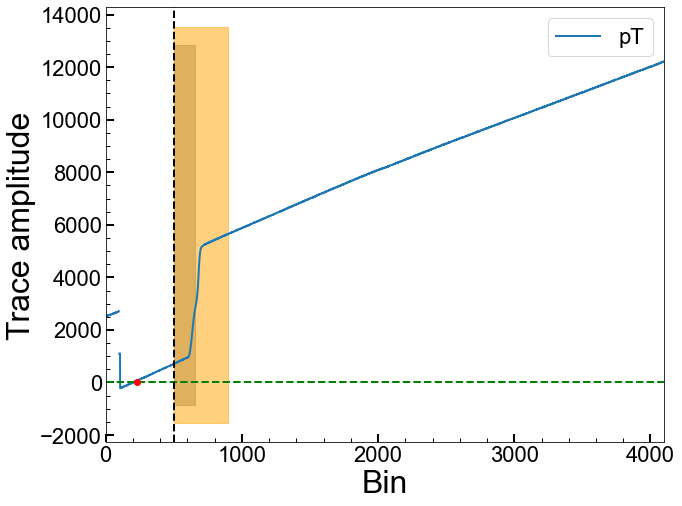

Series Number: 72209162200
Event Number: 1720548
Energy: 21.87560787343 keV
Area: 371495.0758925563


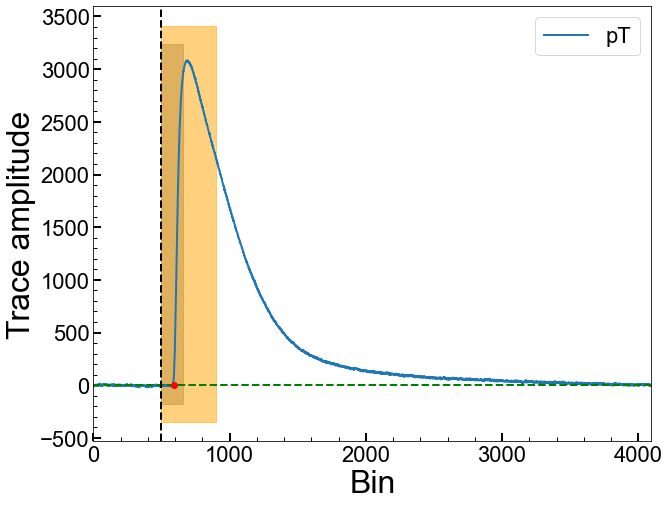

Series Number: 72209162200
Event Number: 1740533
Energy: 24.52093224891 keV
Area: -1006680.0678024472


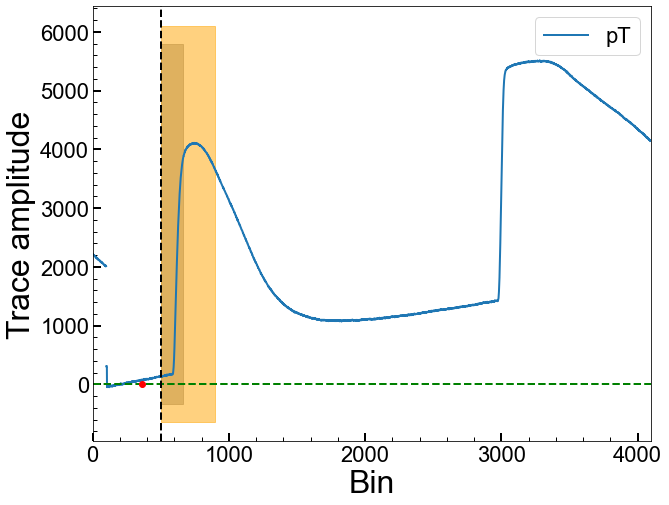

Series Number: 72209162200
Event Number: 1740541
Energy: 4.241665130469 keV
Area: 49351.899723973445


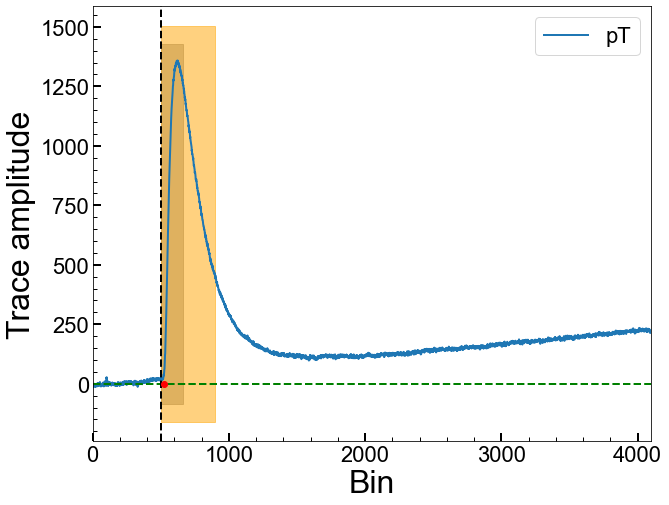

Series Number: 72209162200
Event Number: 1740875
Energy: 15.20952135109 keV
Area: 385091.82746337546


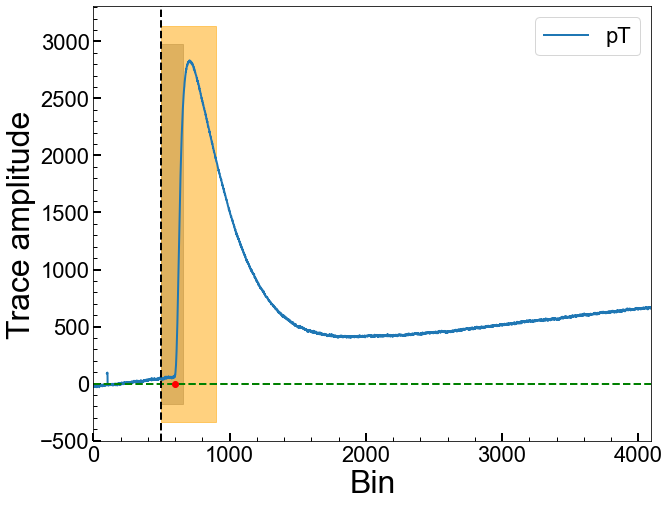

Series Number: 72209162200
Event Number: 1750163
Energy: 16.28889005305 keV
Area: 495836.0662380079


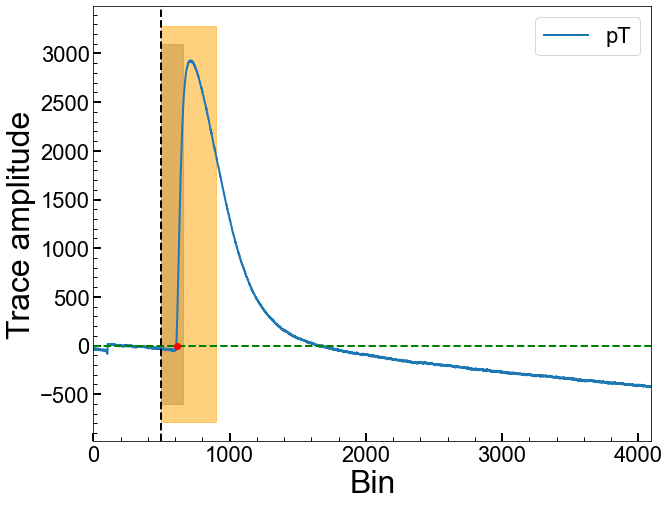

Series Number: 72209162200
Event Number: 1750806
Energy: 10.7876630878 keV
Area: -5997622.593192752


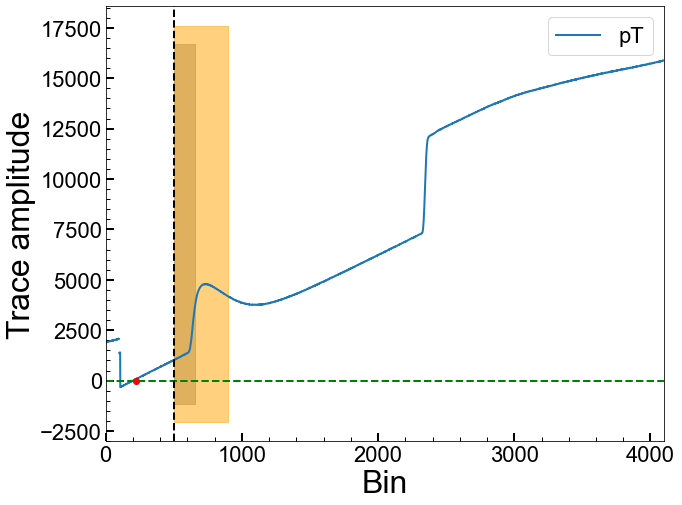

Series Number: 72209162200
Event Number: 1760688
Energy: 49.52351457466 keV
Area: 836808.7998795232


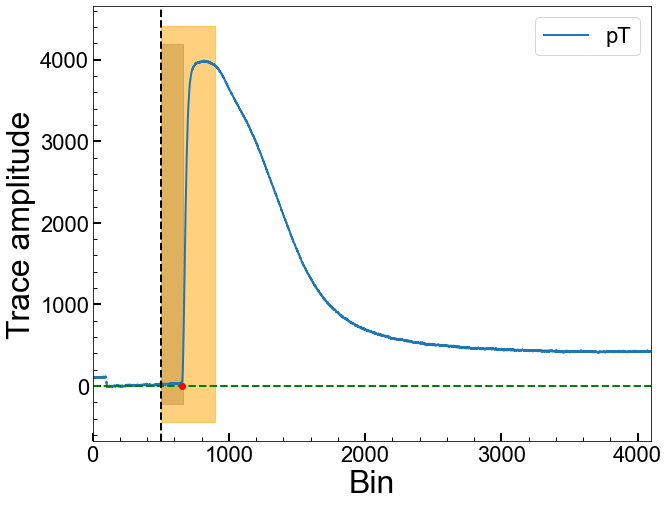

Series Number: 72209162200
Event Number: 1770687
Energy: 13.81211076139 keV
Area: -2147005.04178197


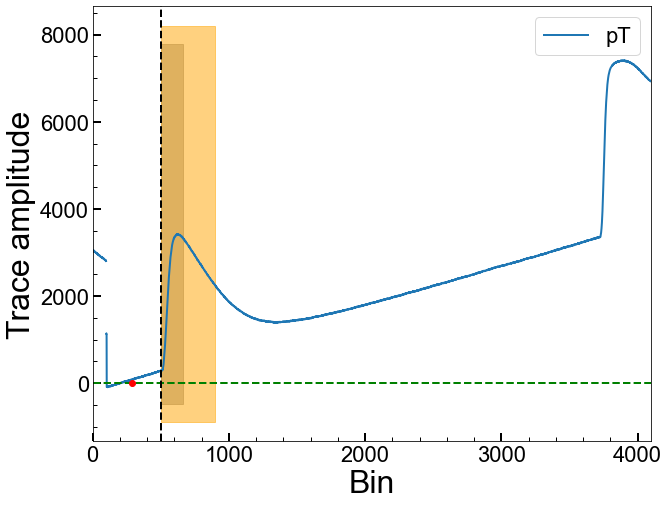

Series Number: 72209162200
Event Number: 1770693
Energy: 15.73700452366 keV
Area: 370398.48166972224


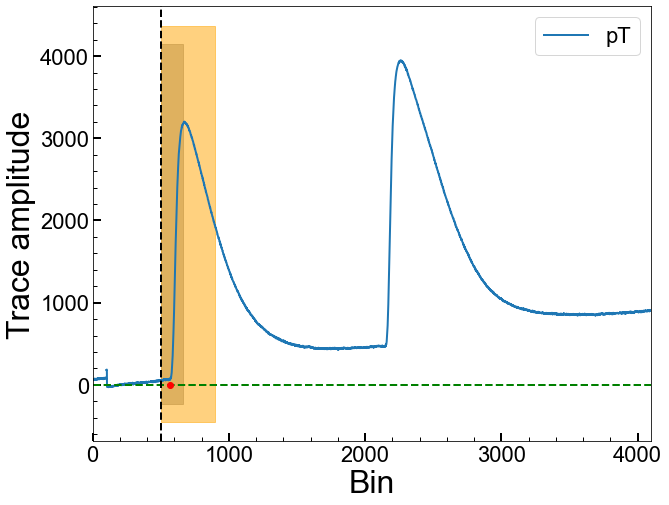

Series Number: 72209162200
Event Number: 1780091
Energy: 22.82722920011 keV
Area: -8565188.087625716


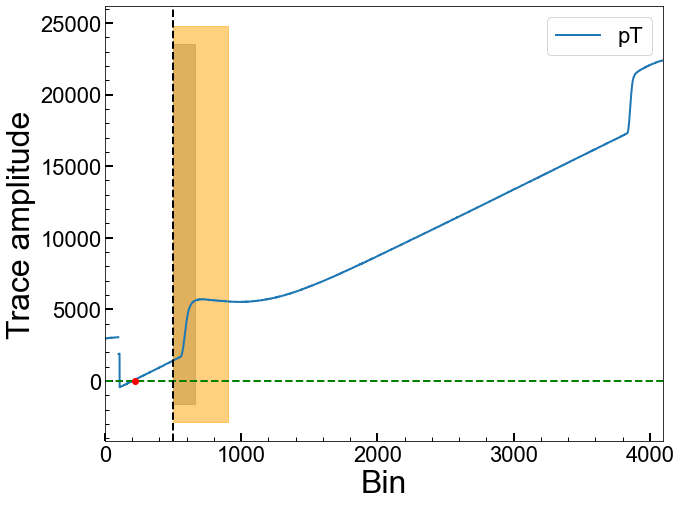

Series Number: 72209162200
Event Number: 1780723
Energy: 8.969939237865 keV
Area: 369733.84632963035


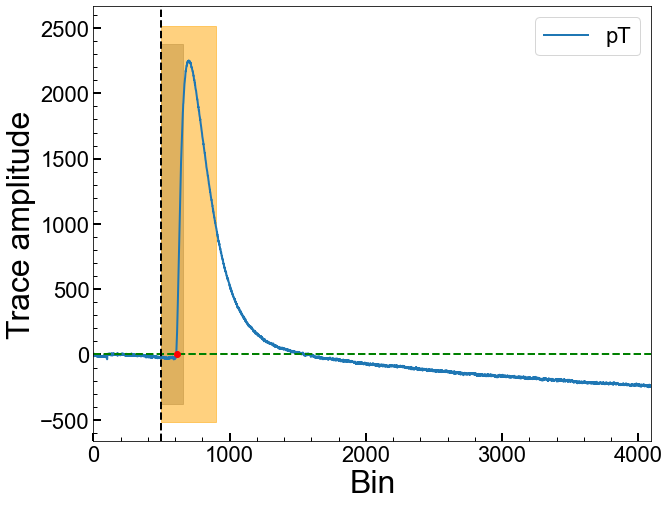

Series Number: 72209162200
Event Number: 1790606
Energy: 28.43847074663 keV
Area: 559163.6630698631


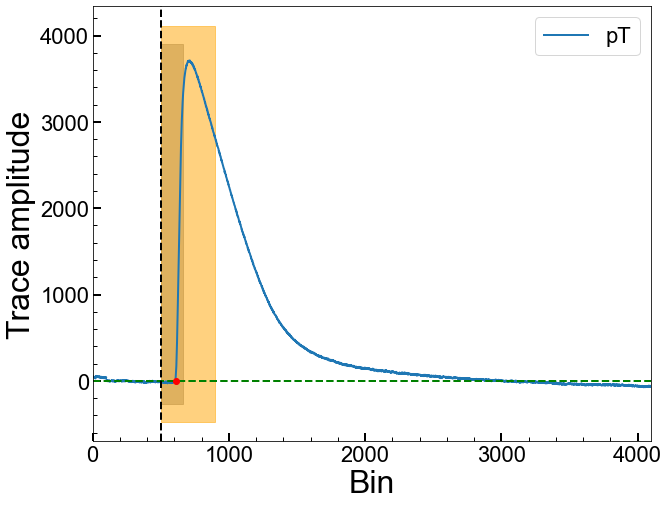

Series Number: 72209162200
Event Number: 1800199
Energy: 19.47773616944 keV
Area: 121804.25360079478


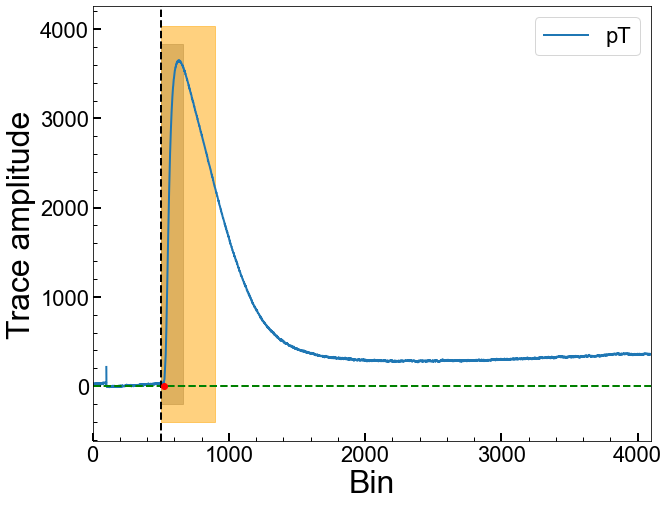

Series Number: 72209162200
Event Number: 1810683
Energy: 5.907500590198 keV
Area: 353361.5022191897


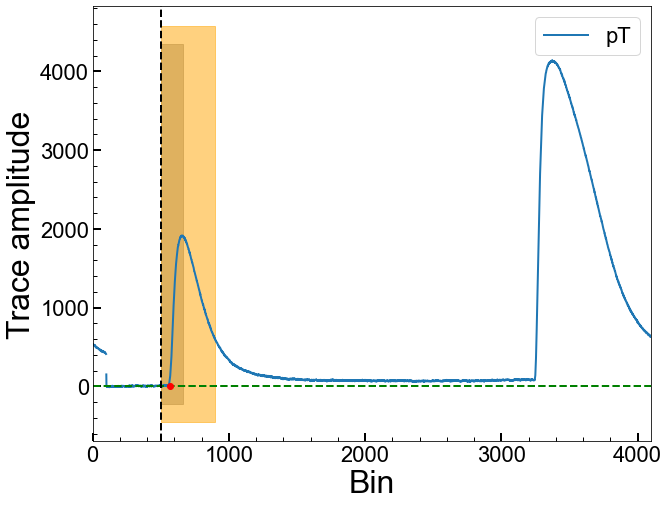

Series Number: 72209162200
Event Number: 1810728
Energy: 3.756688653093 keV
Area: 96192.4489244659


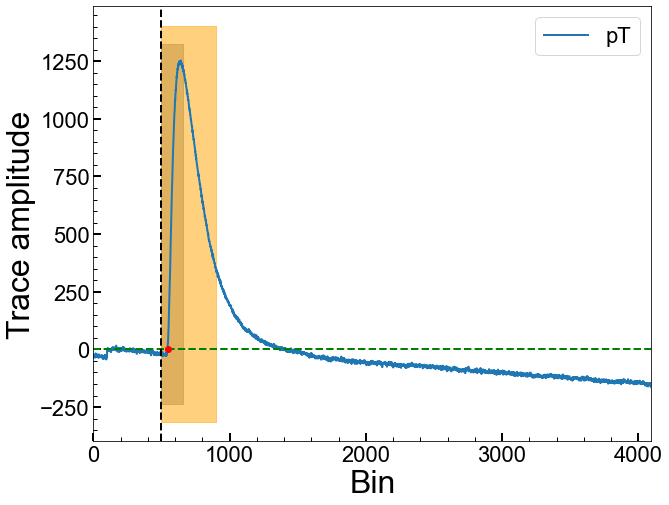

Series Number: 72209162200
Event Number: 1820119
Energy: 22.51198797908 keV
Area: 305425.24805899896


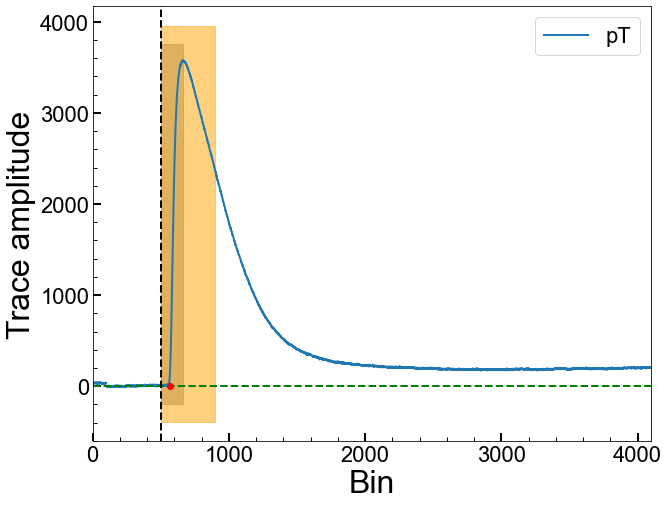

Series Number: 72209162200
Event Number: 1830115
Energy: 42.13844417863 keV
Area: -710053.3376243719


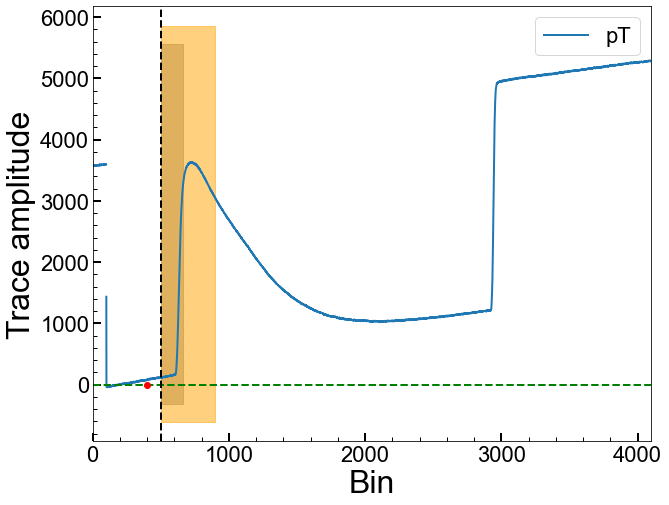

Series Number: 72209162200
Event Number: 1840259
Energy: 21.49664650311 keV
Area: -406095.2881568777


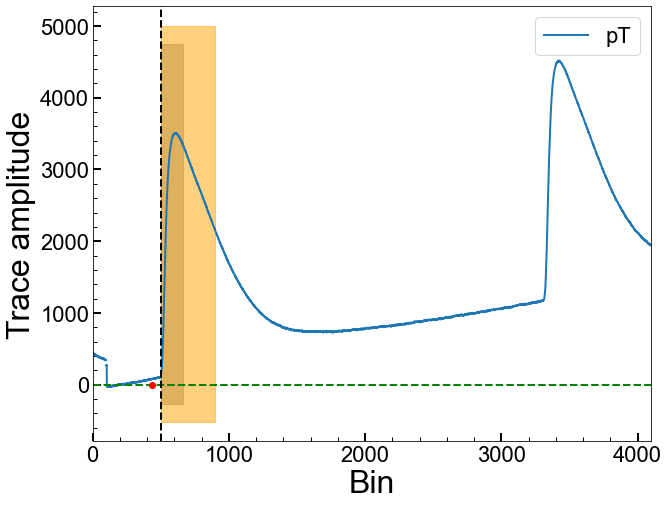

Series Number: 72209162200
Event Number: 1860196
Energy: 7.605476440701 keV
Area: 470979.4794965328


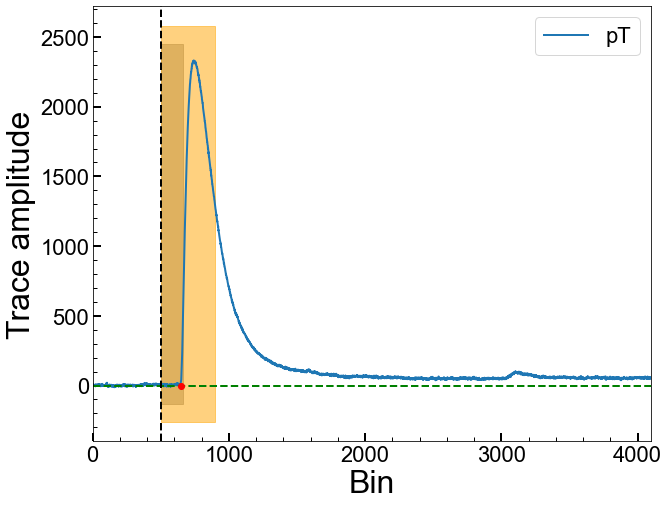

Series Number: 72209162200
Event Number: 1870496
Energy: 13.5059221535 keV
Area: -4177403.015738454


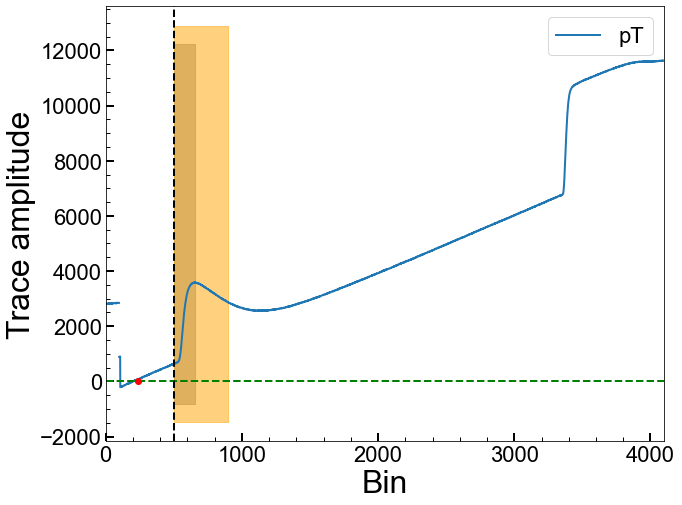

Series Number: 72209162200
Event Number: 1890196
Energy: 2.217073508668 keV
Area: 99049.39709439345


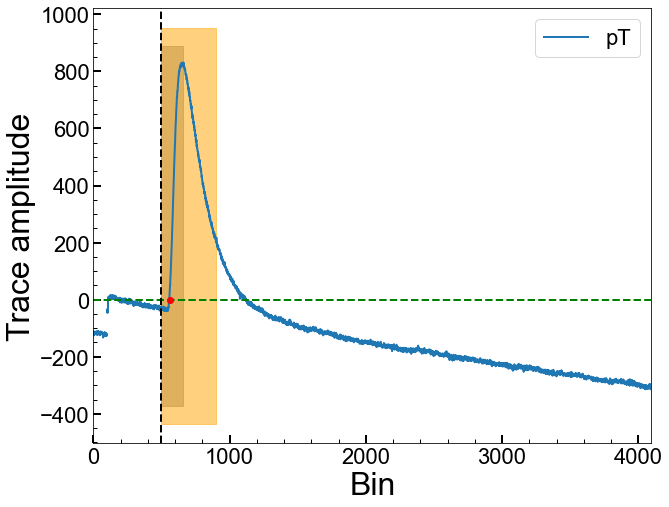

Series Number: 72209162200
Event Number: 1900587
Energy: 31.06223985069 keV
Area: 751347.9423738911


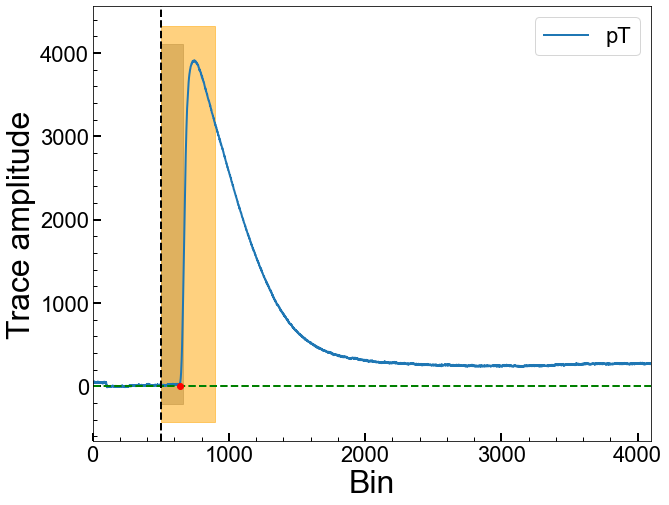

Series Number: 72209162200
Event Number: 1910495
Energy: 26.56894295985 keV
Area: 219092.0639424001


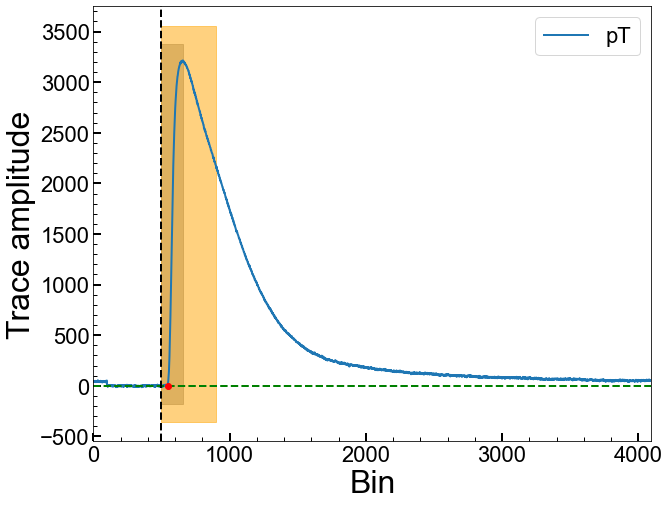

Series Number: 72209162200
Event Number: 1920888
Energy: 13.54726612599 keV
Area: 529316.1756015896


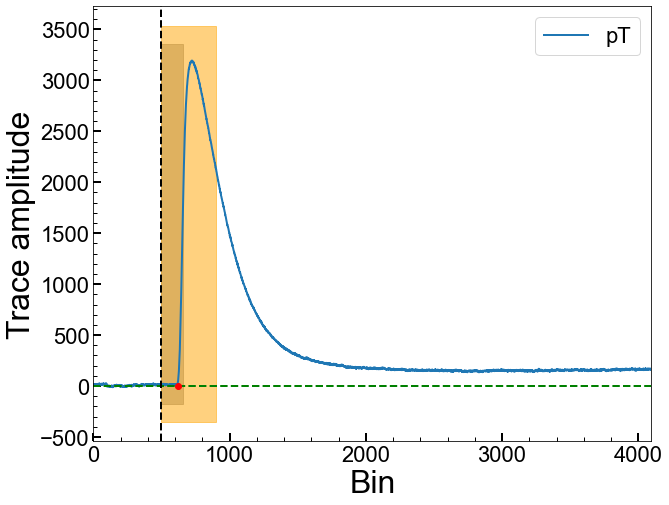

Series Number: 72209162200
Event Number: 1950664
Energy: 17.75643765594 keV
Area: 245050.91007521073


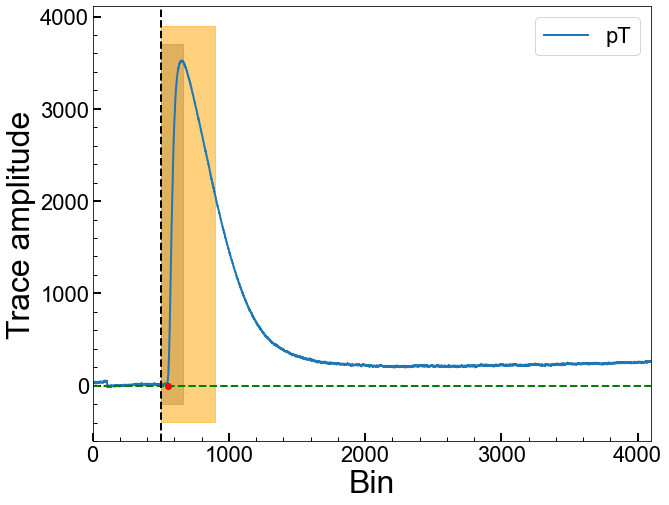

Series Number: 72209162200
Event Number: 1960525
Energy: 7.053720470117 keV
Area: 23985.807146225176


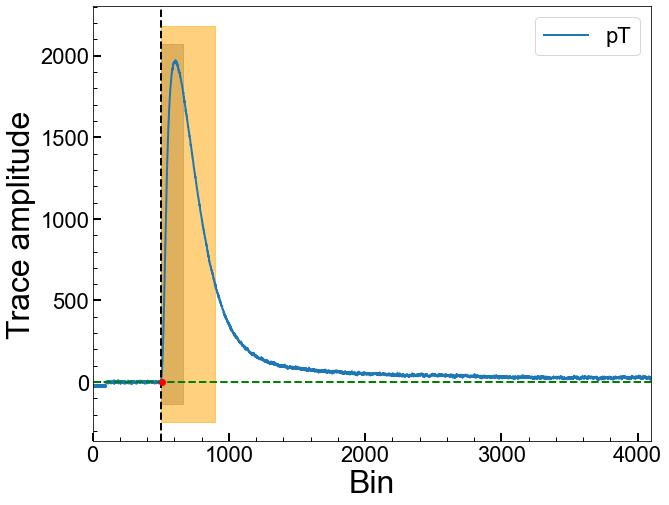

Series Number: 72209162200
Event Number: 1960663
Energy: 34.0411275694 keV
Area: 533890.5067579336


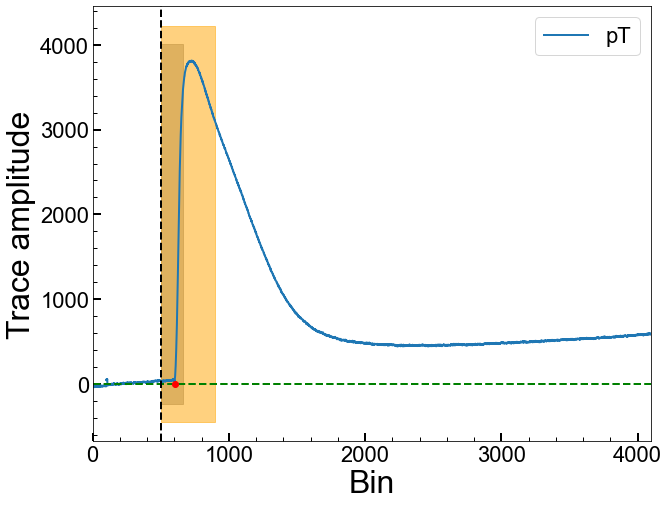

Series Number: 72209162200
Event Number: 1960762
Energy: 40.45891700502 keV
Area: 192650.94938337494


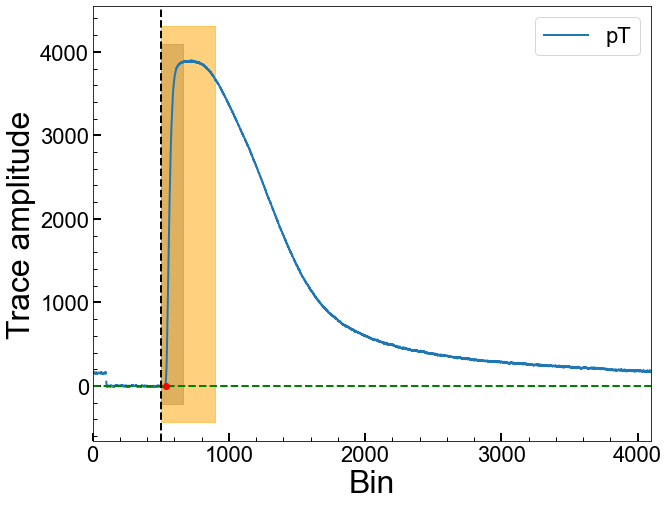

Series Number: 72209162200
Event Number: 1960842
Energy: 5.098474166504 keV
Area: 143363.737303047


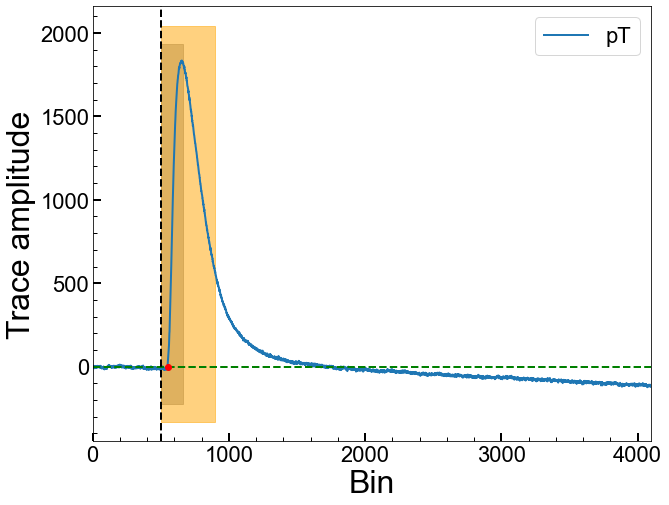

Series Number: 72209162200
Event Number: 1970326
Energy: 47.19950577214 keV
Area: 303257.89358643175


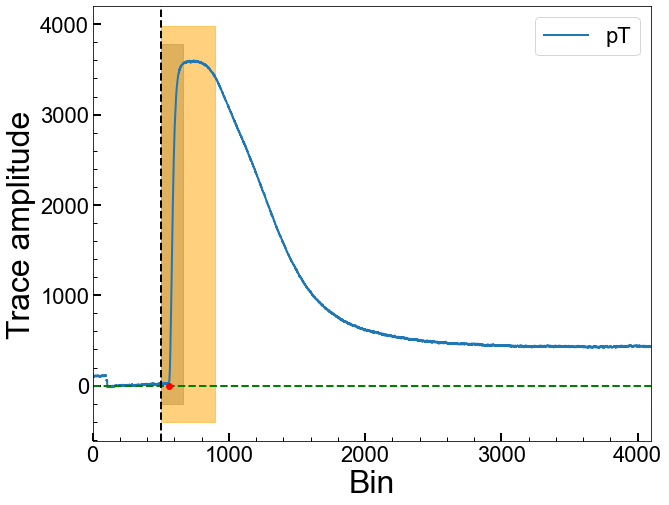

Series Number: 72209162200
Event Number: 1980034
Energy: 8.261416178179 keV
Area: 342204.29289328266


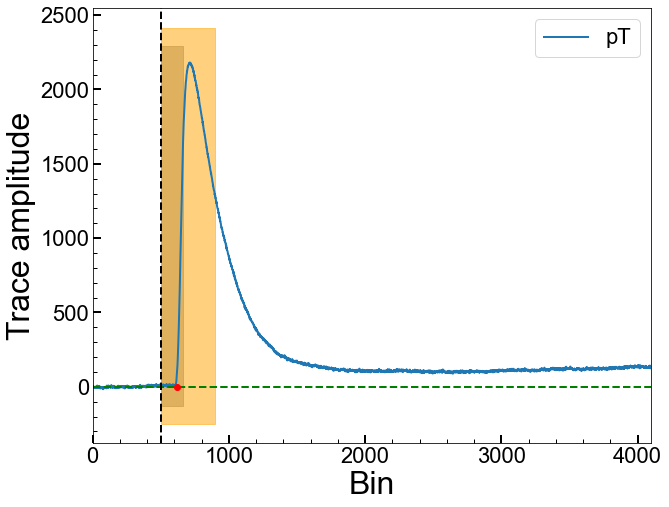

Series Number: 72209162200
Event Number: 2020880
Energy: 8.43714842975 keV
Area: 193389.07776244218


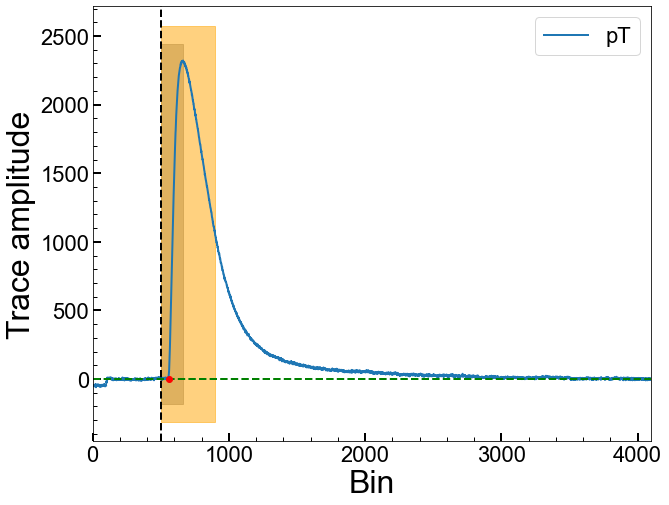

Series Number: 72209162200
Event Number: 2030087
Energy: 29.18052515084 keV
Area: 121045.97902238417


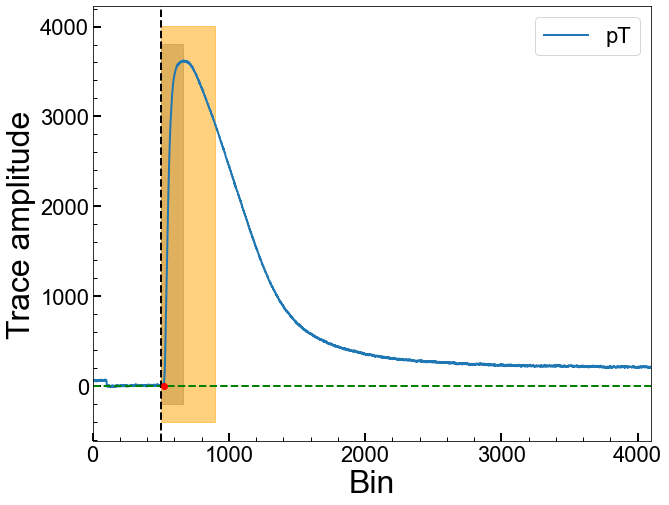

Series Number: 72209162200
Event Number: 2030787
Energy: 14.282087449 keV
Area: 469090.93692181184


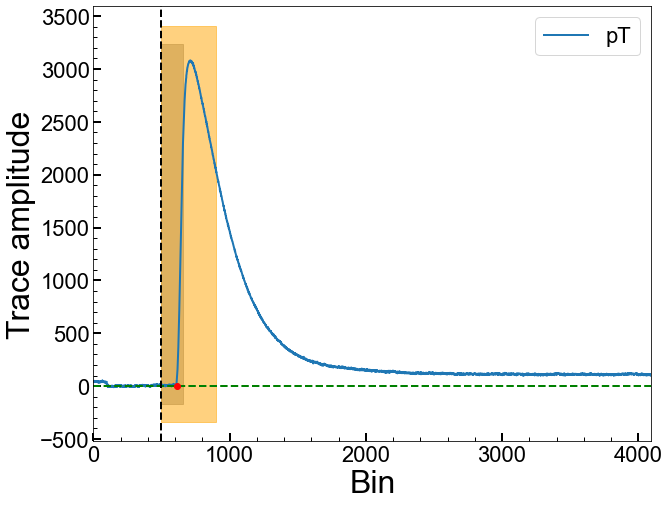

Series Number: 72209162200
Event Number: 2040143
Energy: 14.80179940773 keV
Area: 458954.0449271538


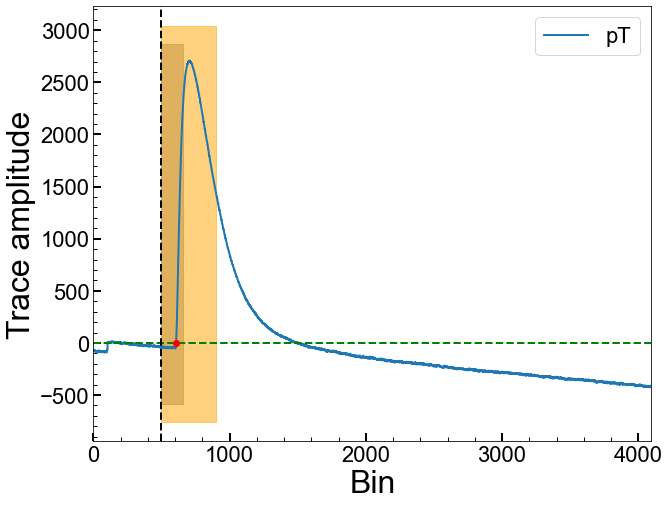

Series Number: 72209162200
Event Number: 2040801
Energy: 16.99229462839 keV
Area: -2792676.5702029117


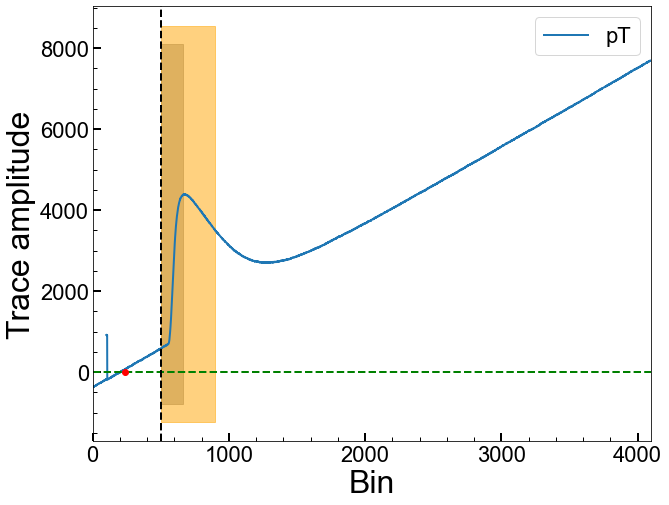

Series Number: 72209162200
Event Number: 2090134
Energy: 33.32361714008 keV
Area: 540752.0170316295


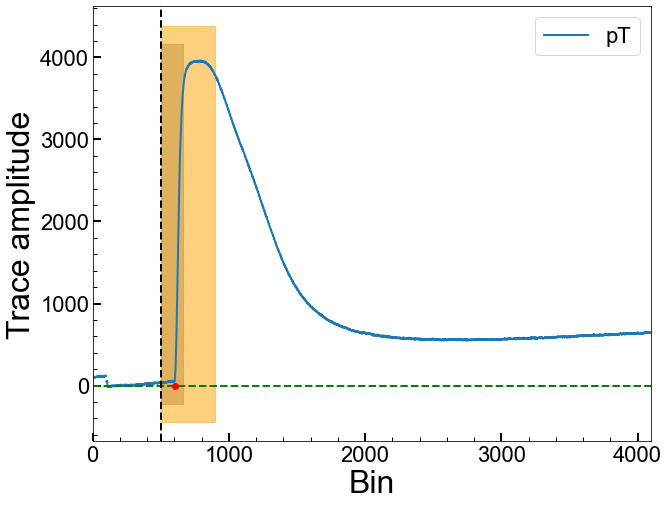

Series Number: 72209162200
Event Number: 2090374
Energy: 41.84624194054 keV
Area: 746872.3673557932


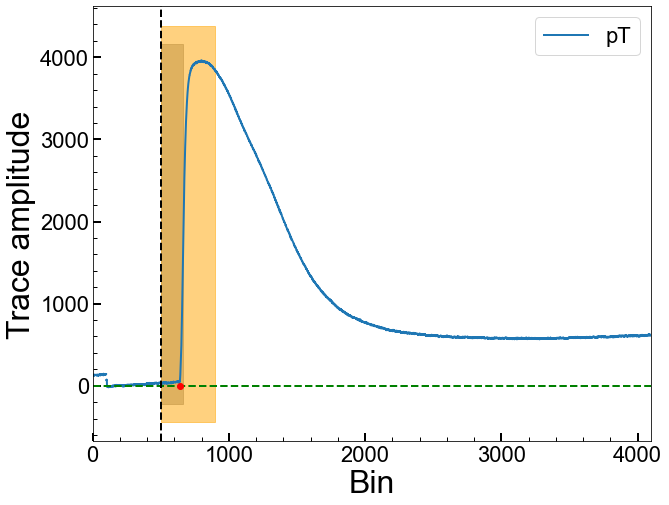

Series Number: 72209162200
Event Number: 2090651
Energy: 31.44240663963 keV
Area: 596587.9992482862


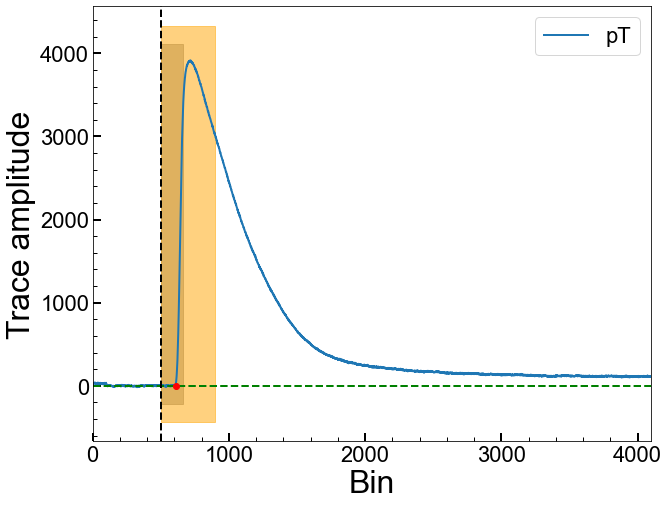

Series Number: 72209162200
Event Number: 2110042
Energy: 37.23495397847 keV
Area: 361940.63290384645


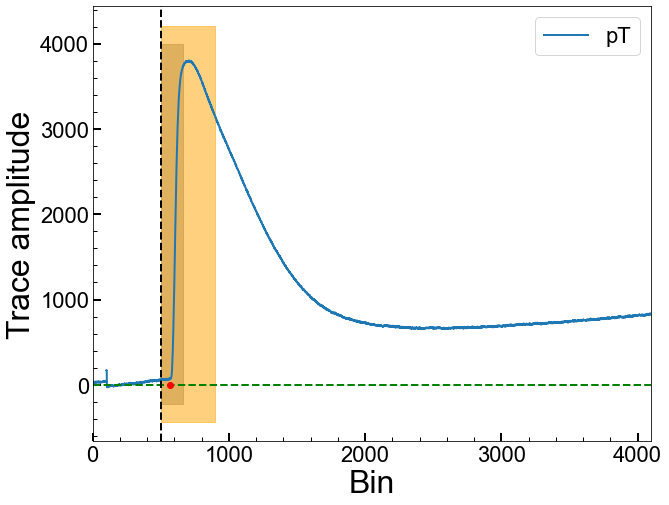

Series Number: 72209162200
Event Number: 2110321
Energy: 33.04935262098 keV
Area: -805981.2831489748


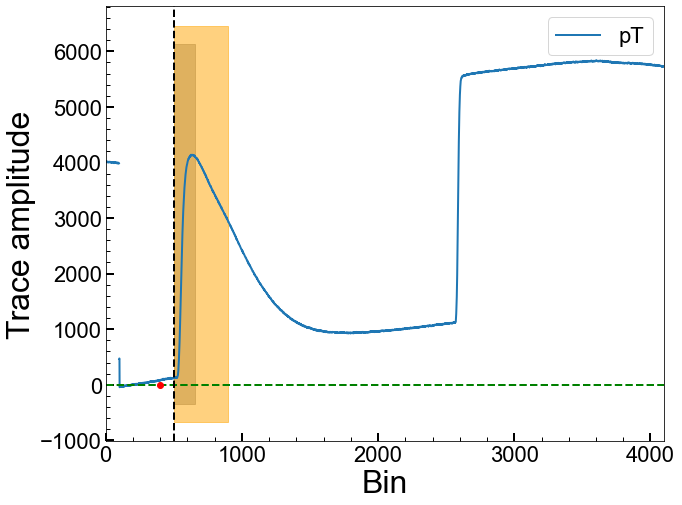

Series Number: 72209162200
Event Number: 2120672
Energy: 2.945185163492 keV
Area: -313920.94708713365


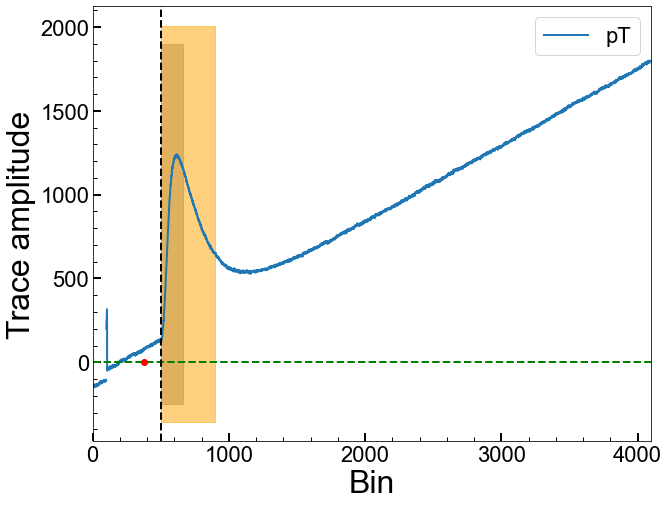

Series Number: 72209162200
Event Number: 2130473
Energy: 37.05039853817 keV
Area: 586825.6058944183


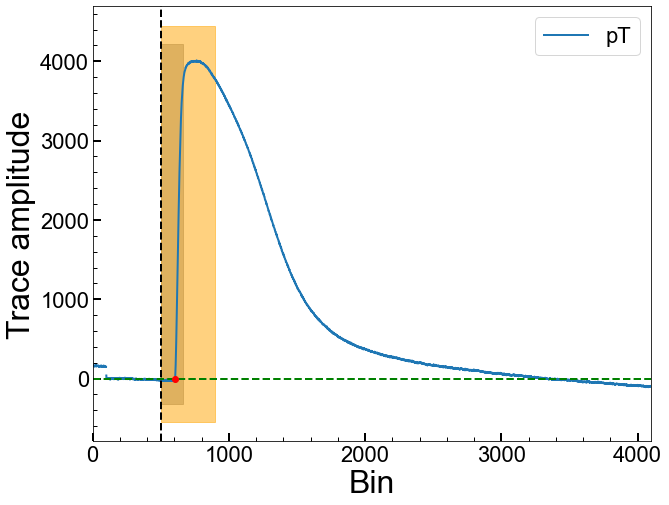

Series Number: 72209162200
Event Number: 2130797
Energy: 17.77717815841 keV
Area: 228503.94334834444


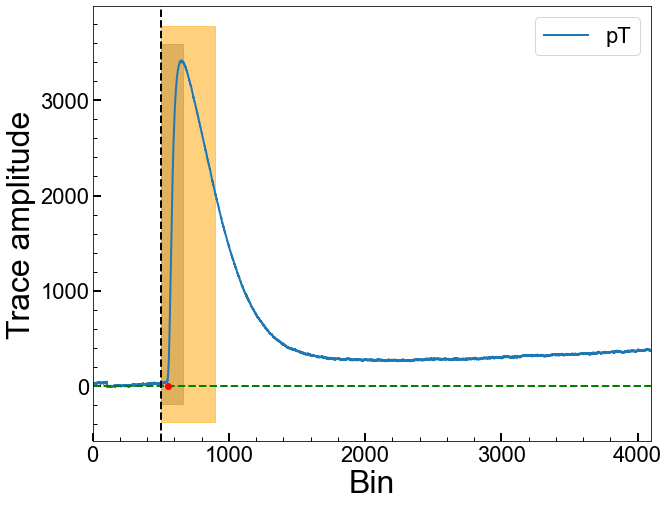

Series Number: 72209162200
Event Number: 2150290
Energy: 14.4517096426 keV
Area: 484786.59542813286


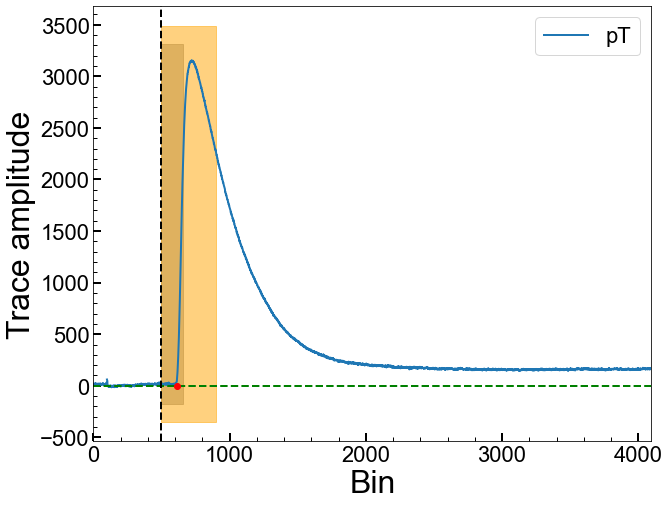

Series Number: 72209162200
Event Number: 2160283
Energy: 4.727149404103 keV
Area: 106303.38511456948


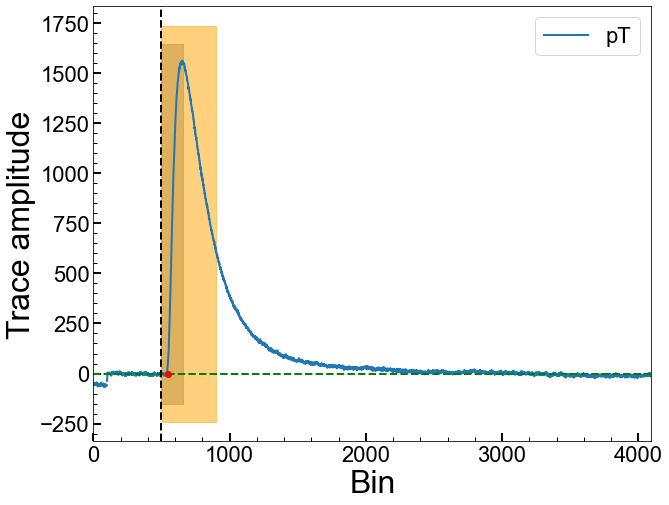

Series Number: 72209162200
Event Number: 2170832
Energy: 22.93908240153 keV
Area: 396088.1765365667


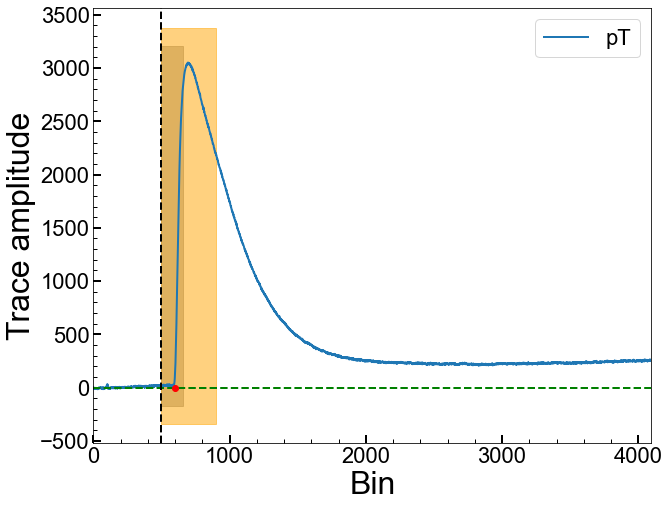

Series Number: 72209162200
Event Number: 2180019
Energy: 23.25424051953 keV
Area: 581698.9001854318


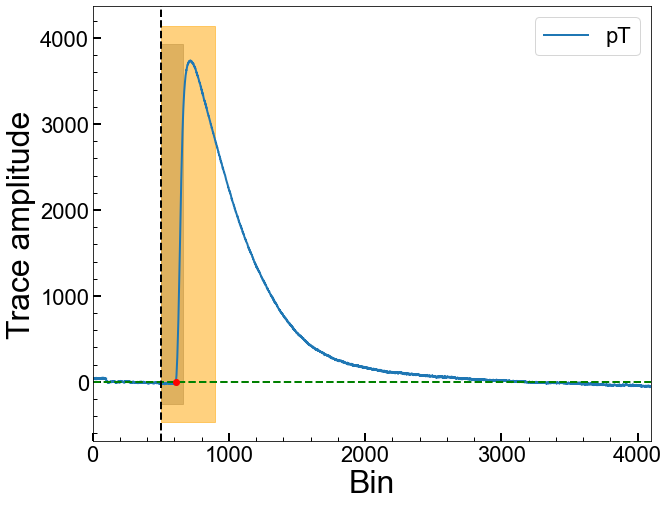

Series Number: 72209162200
Event Number: 2180301
Energy: 5.669023798591 keV
Area: 318859.13249001344


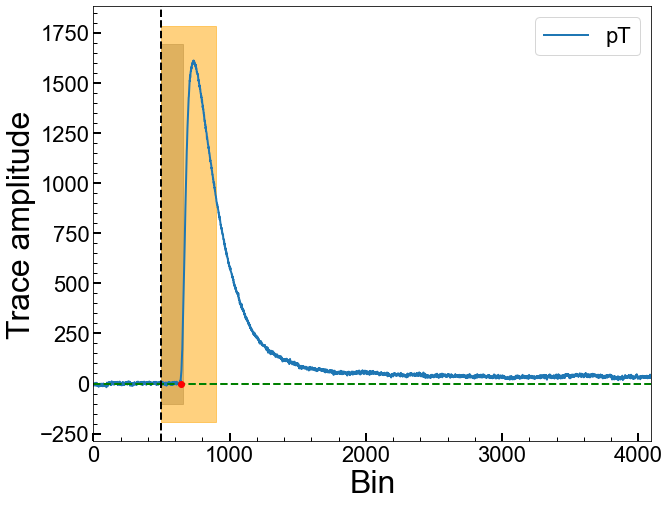

Series Number: 72209162200
Event Number: 2190009
Energy: 46.61951433587 keV
Area: 486095.64684441505


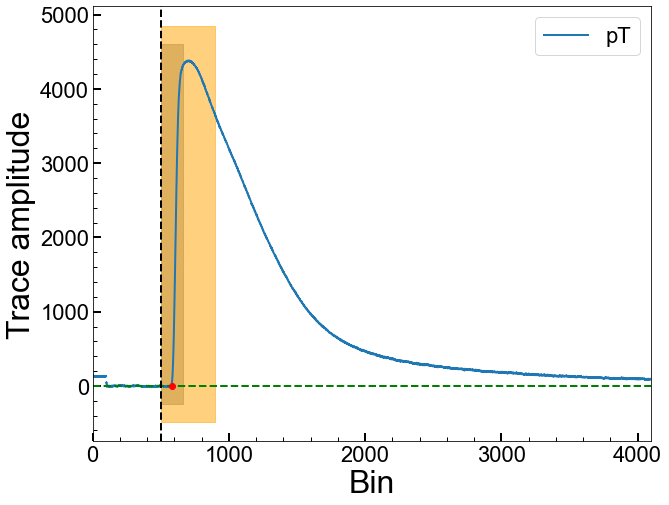

Series Number: 72209162200
Event Number: 2190332
Energy: 47.3261414385 keV
Area: 693929.1886626442


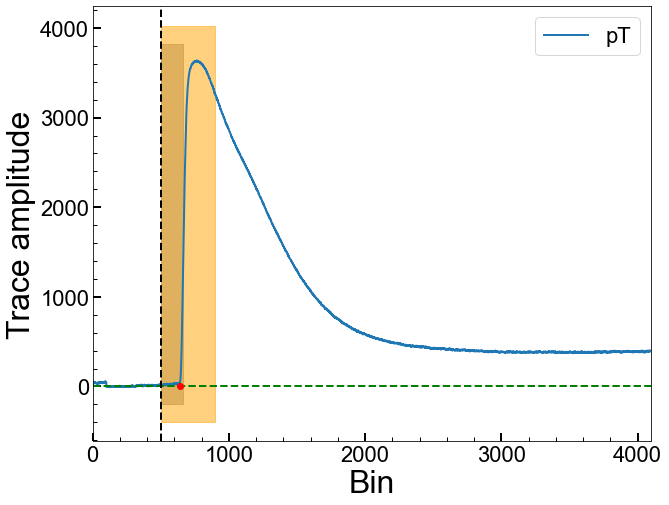

Series Number: 72209162200
Event Number: 2190588
Energy: 19.93073538992 keV
Area: -820665.7770063677


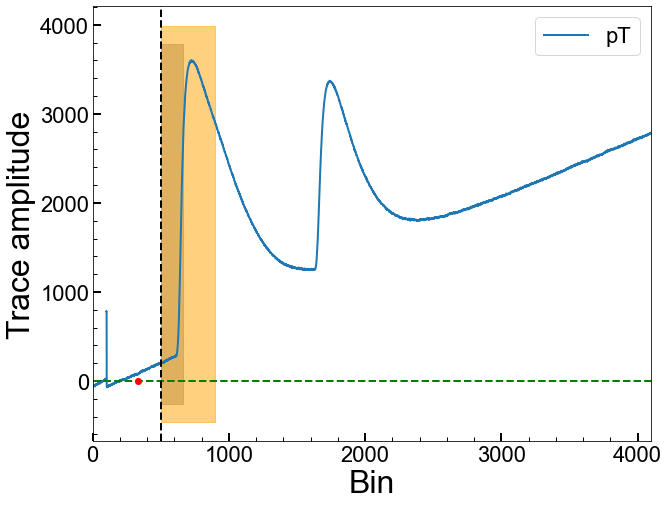

Series Number: 72209162200
Event Number: 2200105
Energy: 11.28999911897 keV
Area: 403599.66146918095


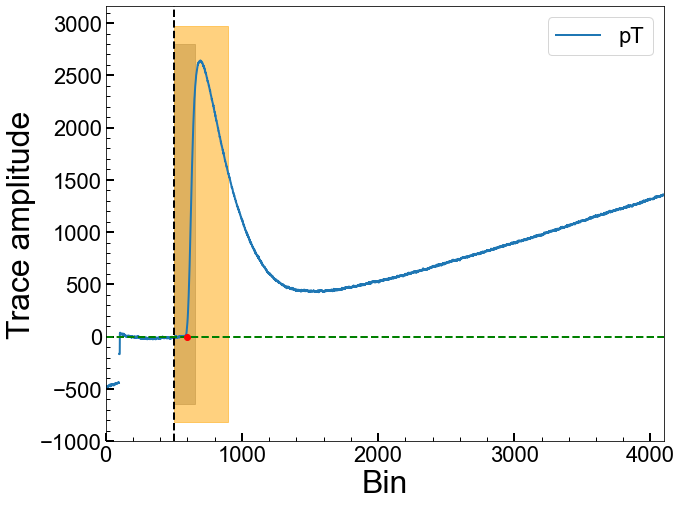

Series Number: 72209162200
Event Number: 2200405
Energy: 45.48539733361 keV
Area: -5055744.1659968095


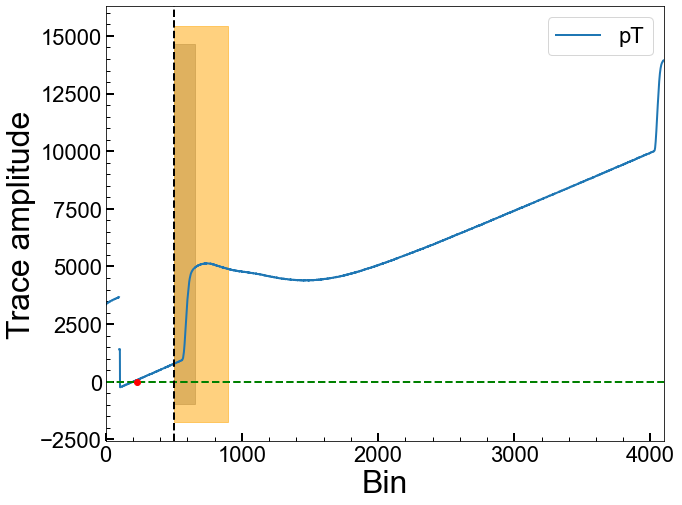

Series Number: 72209162200
Event Number: 2210439
Energy: 23.43612144872 keV
Area: 173262.067814845


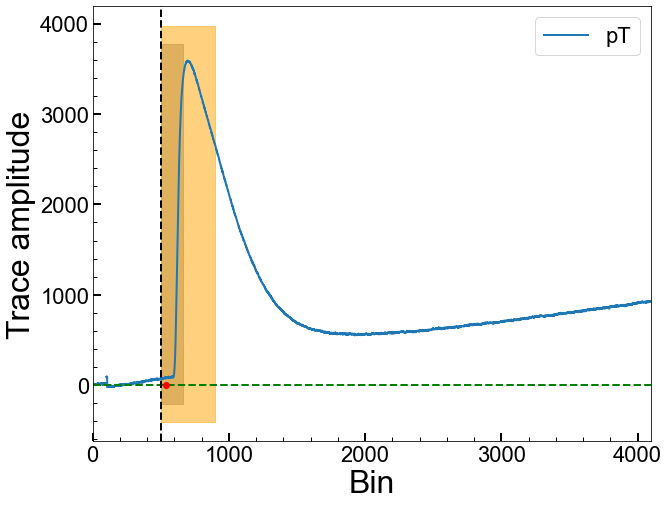

Series Number: 72209162200
Event Number: 2230440
Energy: 32.67612414331 keV
Area: 523798.204544325


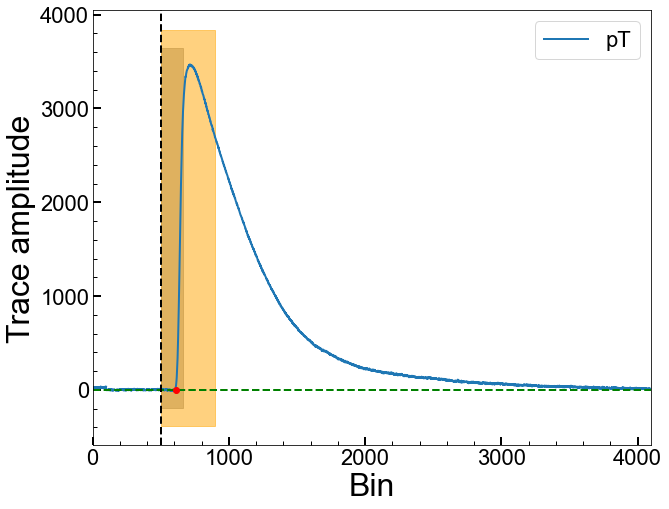

Series Number: 72209162200
Event Number: 2270352
Energy: 42.32232180632 keV
Area: 539857.386393542


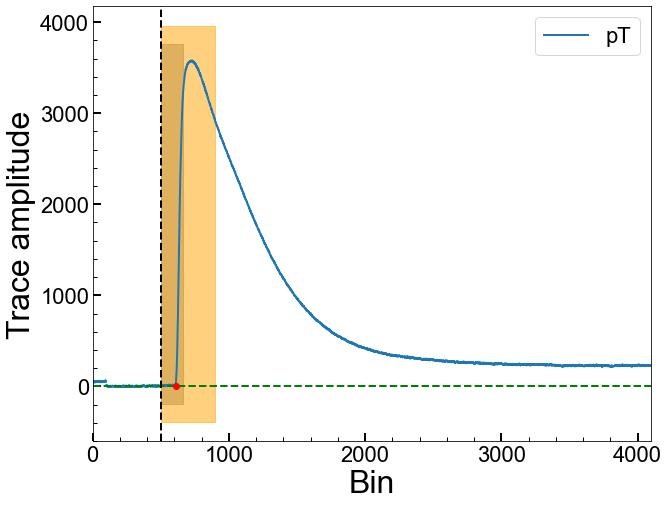

Series Number: 72209162200
Event Number: 2280178
Energy: 37.17262743603 keV
Area: 609269.2656358148


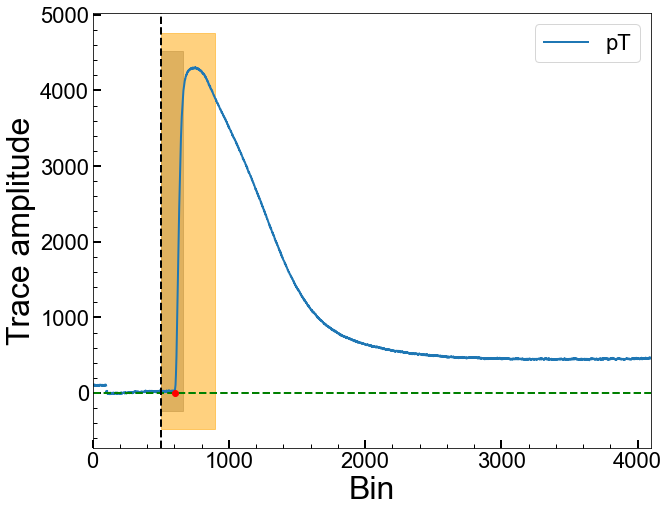

Series Number: 72209162200
Event Number: 2290702
Energy: 2.603429403717 keV
Area: 211509.0727371725


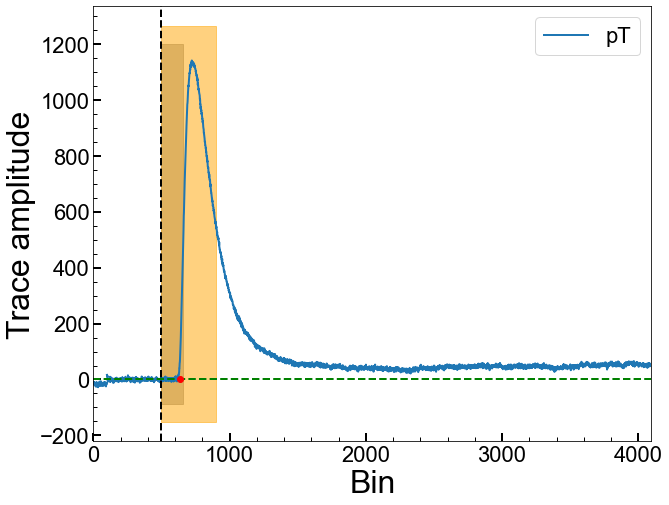

Series Number: 72209162200
Event Number: 2300247
Energy: 37.04604686141 keV
Area: -1322372.2574744185


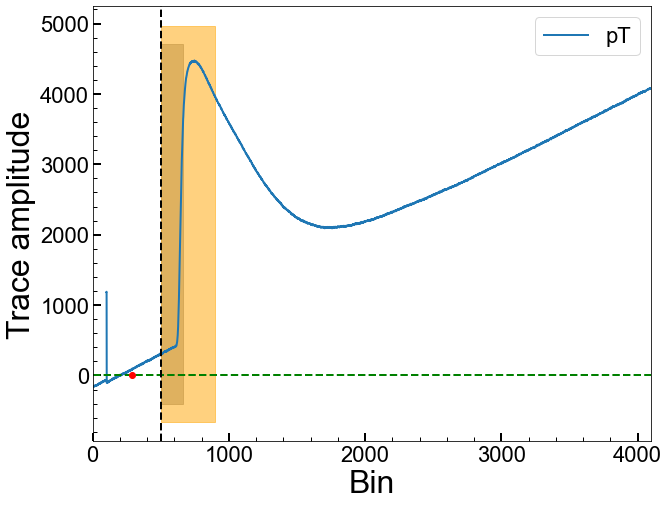

Series Number: 72209162200
Event Number: 2300857
Energy: 14.75293430105 keV
Area: 119386.13045193464


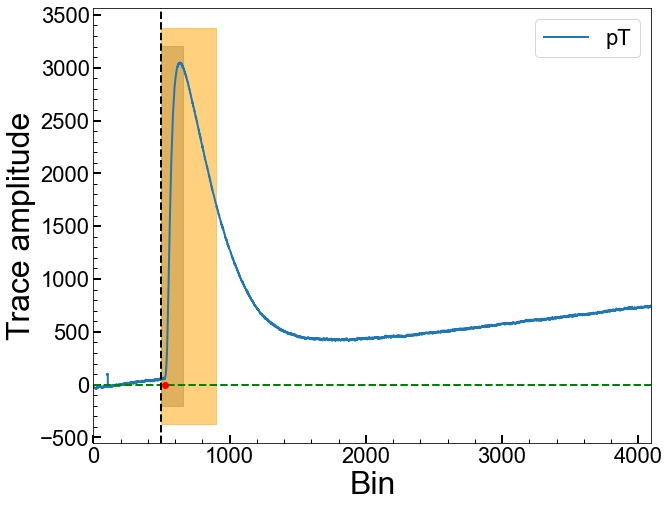

Series Number: 72209162200
Event Number: 2310373
Energy: 39.7944121246 keV
Area: 162712.38859797618


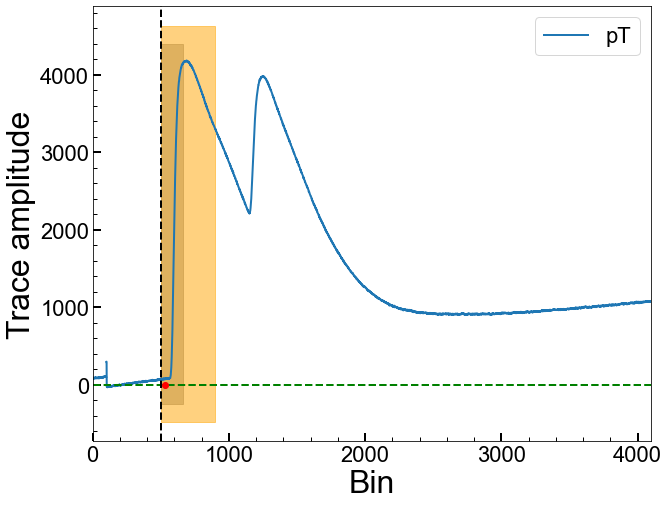

Series Number: 72209162200
Event Number: 2310435
Energy: 45.51915434933 keV
Area: -990708.8071544361


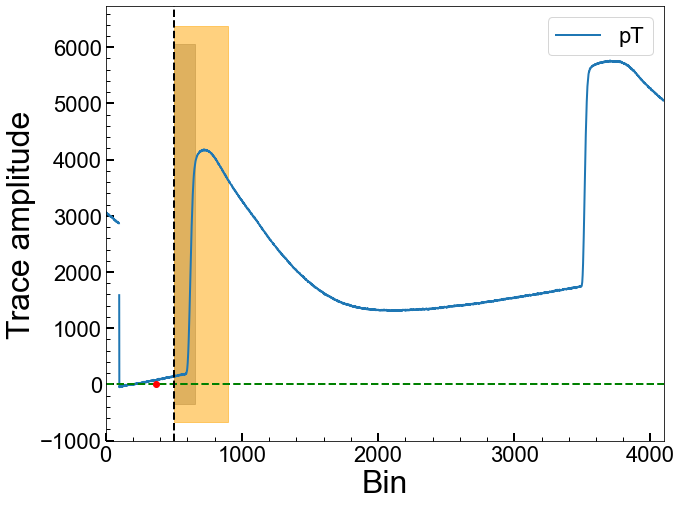

Series Number: 72209162200
Event Number: 2310601
Energy: 12.01449987577 keV
Area: 209103.11283867195


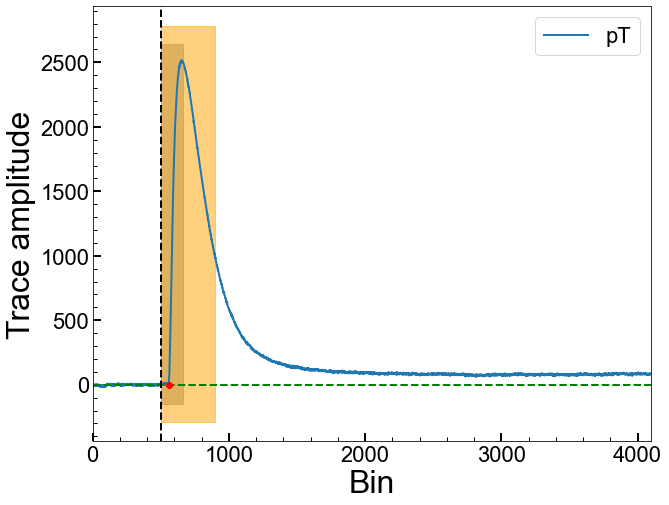

Series Number: 72209162200
Event Number: 2310719
Energy: 17.47163867737 keV
Area: 295226.9390867002


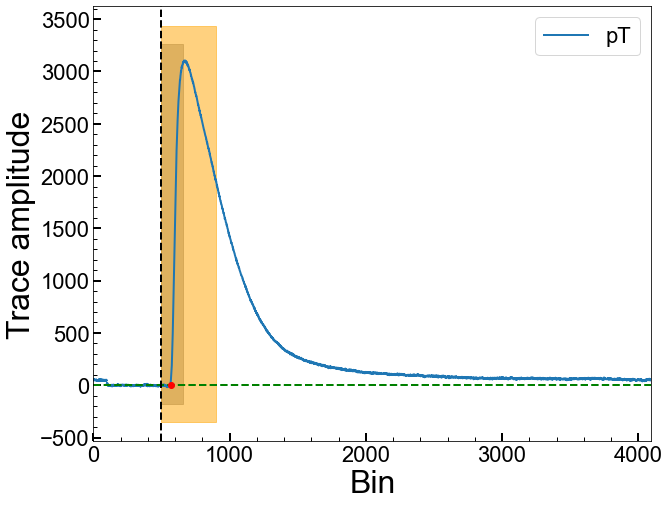

Series Number: 72209162200
Event Number: 2310824
Energy: 48.10709449286 keV
Area: 534996.0584873643


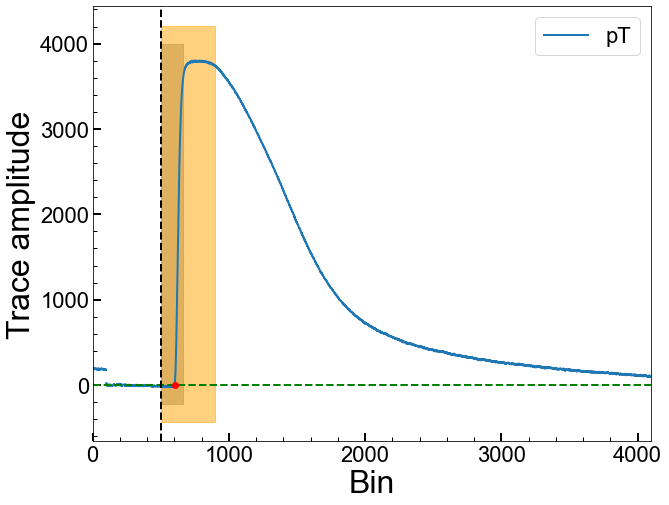

Series Number: 72209162200
Event Number: 2310881
Energy: 29.35240433173 keV
Area: 26741.5177261457


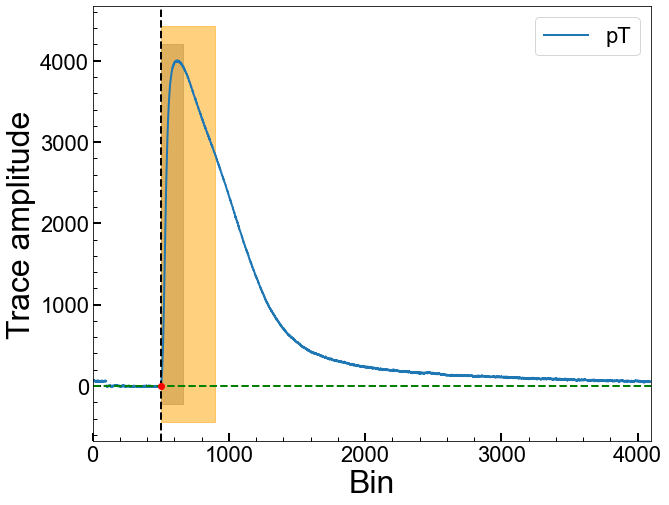

Series Number: 72209162200
Event Number: 2330447
Energy: 7.62678896963 keV
Area: 95336.94705376074


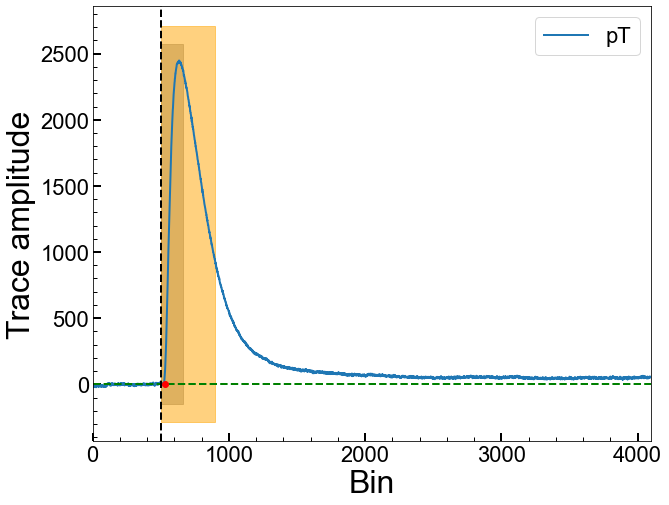

Series Number: 72209162200
Event Number: 2370310
Energy: 19.00765815745 keV
Area: 470665.86051602644


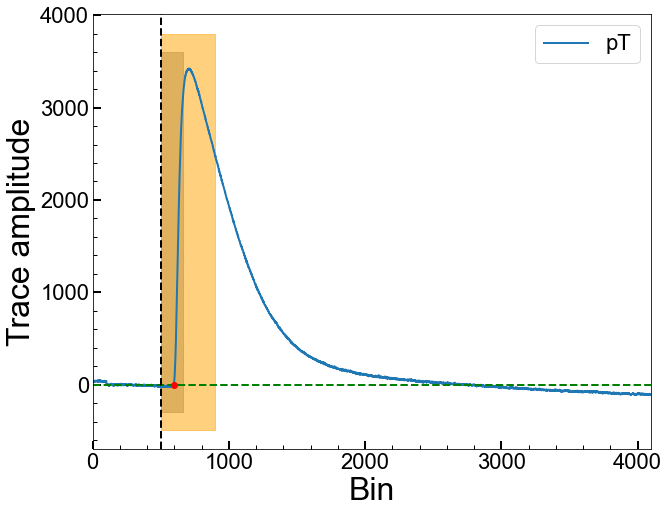

Series Number: 72209162200
Event Number: 2370313
Energy: 22.81893113589 keV
Area: 224508.86252229582


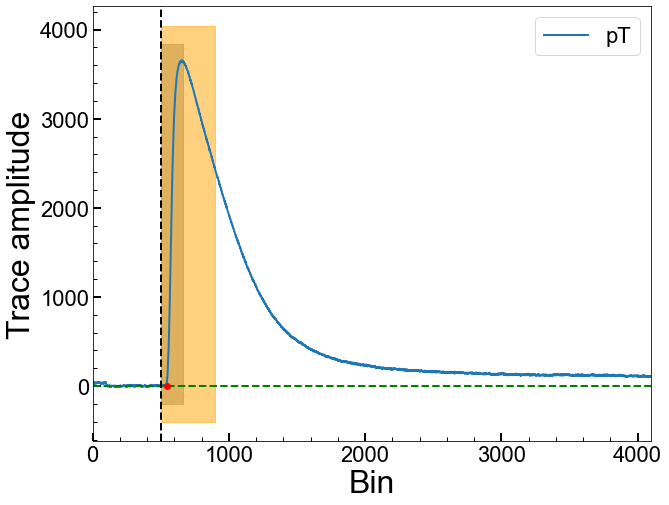

Series Number: 72209162200
Event Number: 2380066
Energy: 7.003789451903 keV
Area: 113793.61180174859


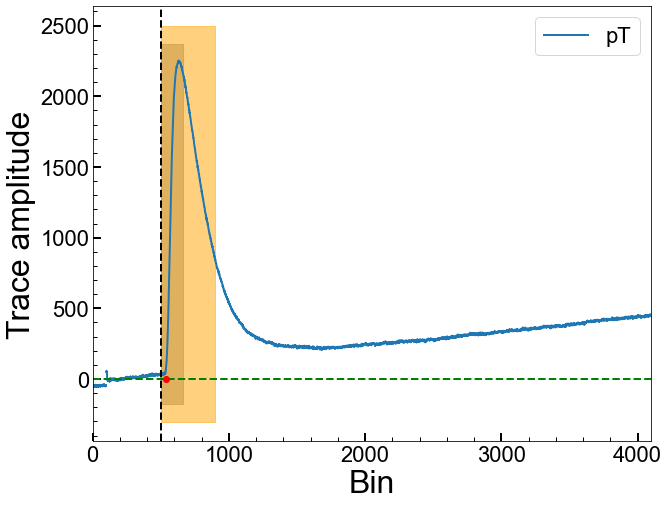

Series Number: 72209162200
Event Number: 2380465
Energy: 16.92311698704 keV
Area: 557440.1409379076


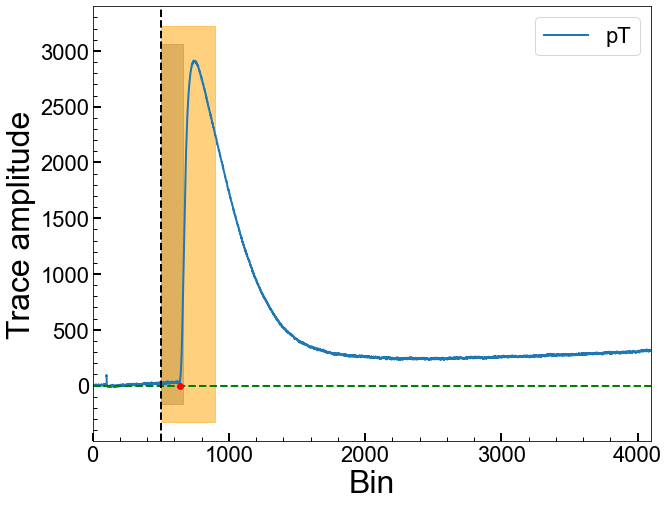

Series Number: 72209162200
Event Number: 2380736
Energy: 7.911686148345 keV
Area: 392449.964443607


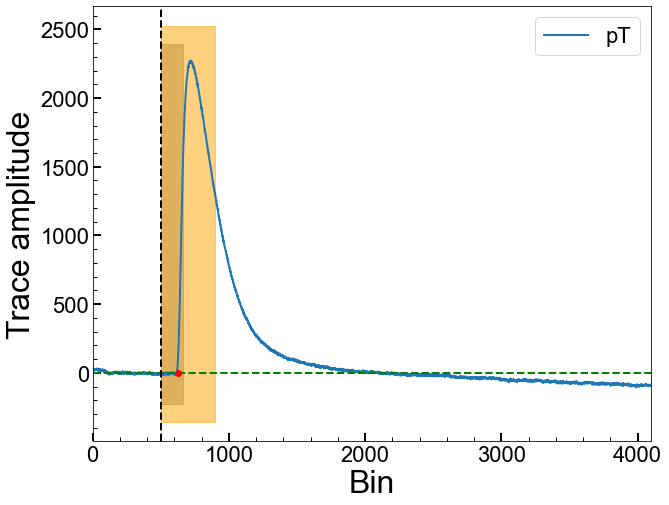

Series Number: 72209162200
Event Number: 2400589
Energy: 4.387978890181 keV
Area: 257656.62706930848


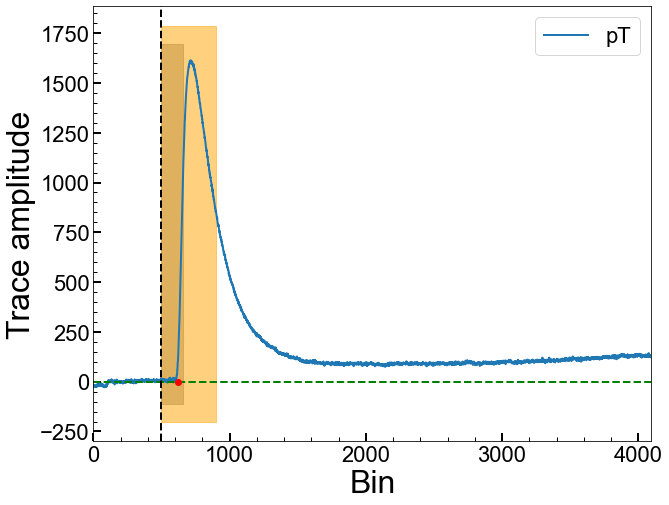

Series Number: 72209162200
Event Number: 2410532
Energy: 28.93375732855 keV
Area: 678261.5311760668


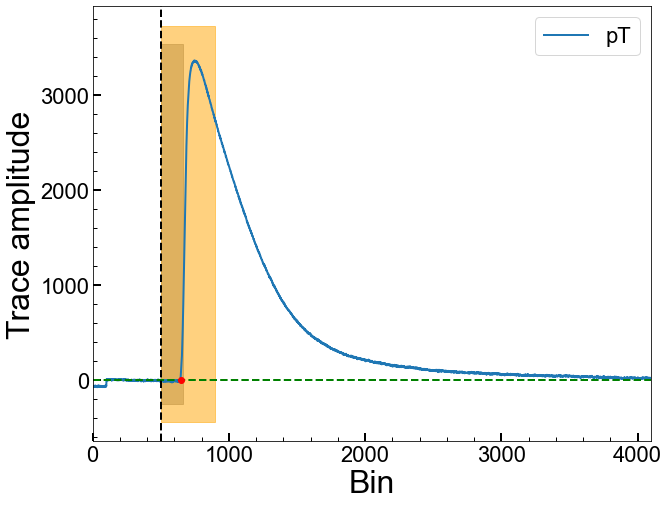

Series Number: 72209162200
Event Number: 2430435
Energy: 29.90108494026 keV
Area: 237460.55001207953


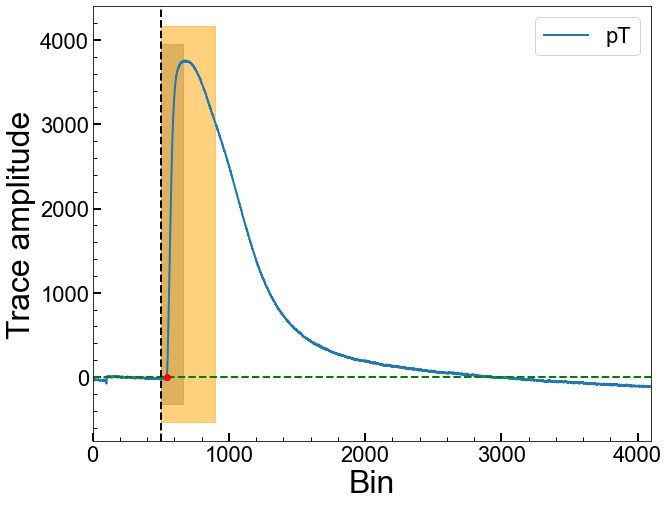

Series Number: 72209162200
Event Number: 2490200
Energy: 24.68465627089 keV
Area: -2349756.5344326296


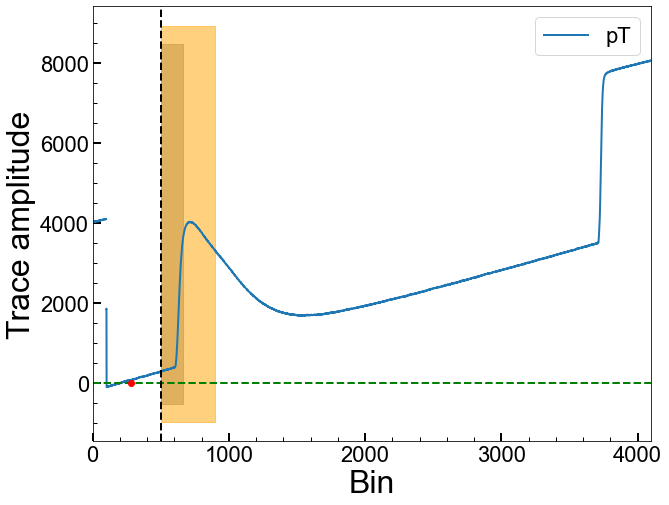

Series Number: 72209162200
Event Number: 2490332
Energy: 5.391288443245 keV
Area: 319730.7009774809


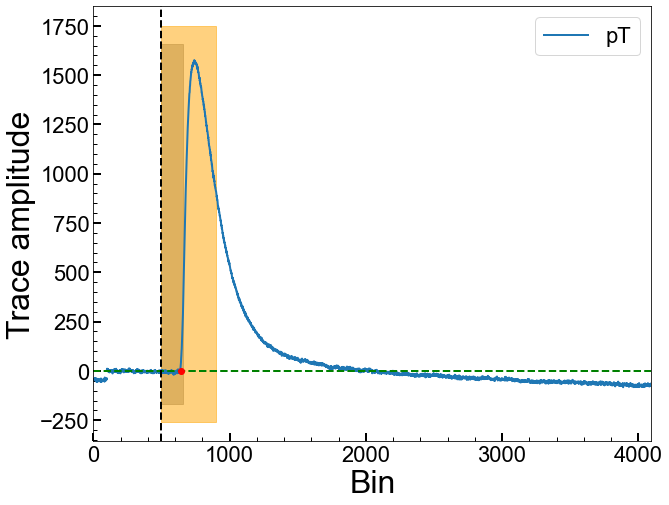

Series Number: 72209162200
Event Number: 2500665
Energy: 37.47752435397 keV
Area: -5890914.741308951


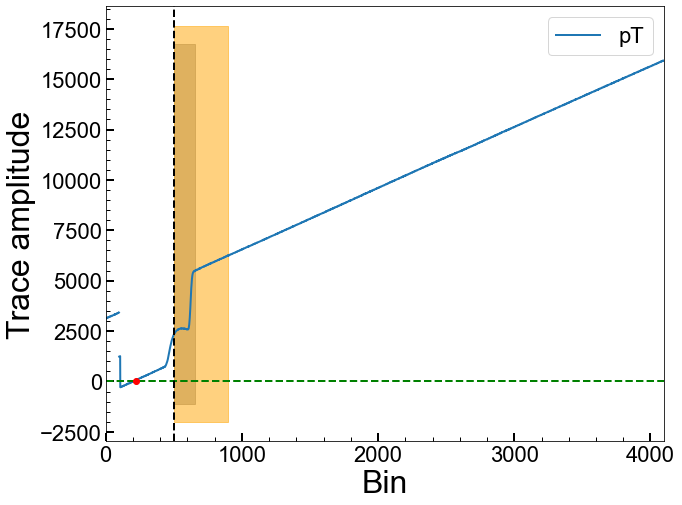

Series Number: 72209162200
Event Number: 2510063
Energy: 24.0782000708 keV
Area: 211735.01271028697


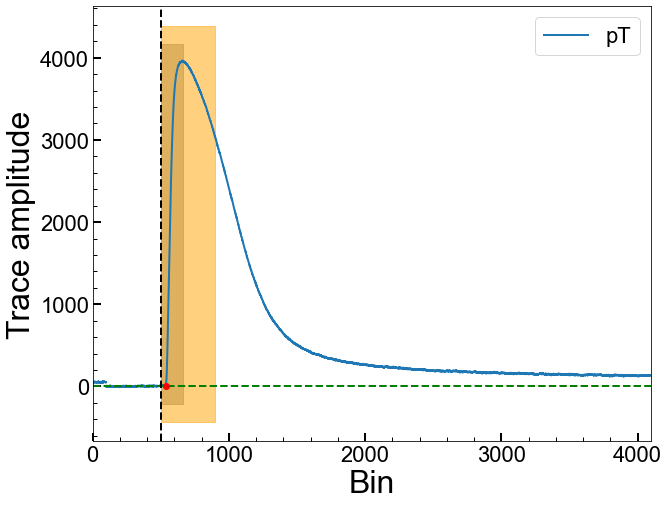

Series Number: 72209162200
Event Number: 2540055
Energy: 32.05465502496 keV
Area: 132266.55723361063


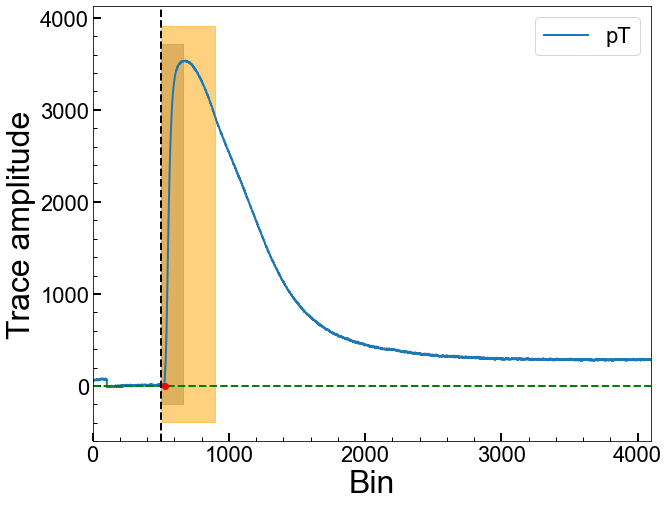

Series Number: 72209162200
Event Number: 2560680
Energy: 4.200519370468 keV
Area: 229049.43394783218


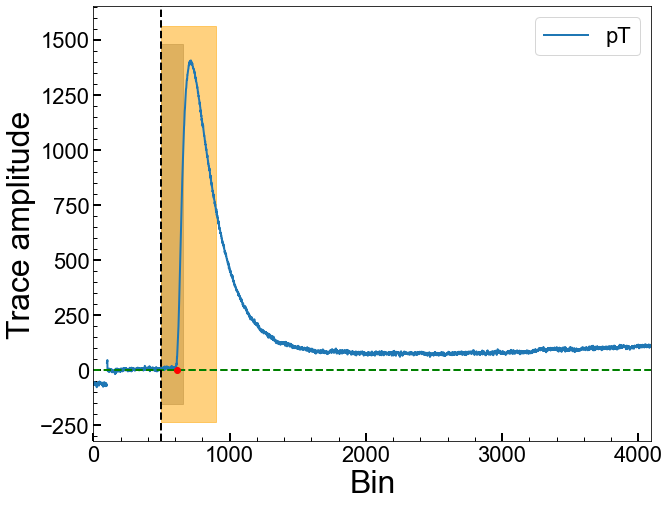

Series Number: 72209162200
Event Number: 2570086
Energy: 27.76513868468 keV
Area: 186002.27450457396


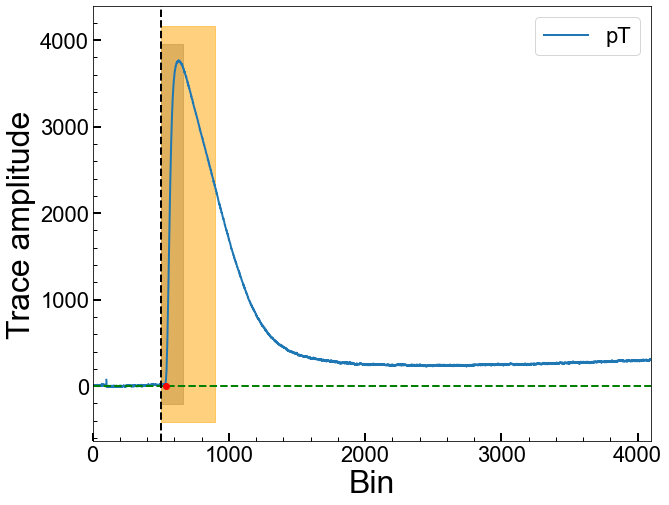

Series Number: 72209162200
Event Number: 2570119
Energy: 45.37147156675 keV
Area: 393435.27791809285


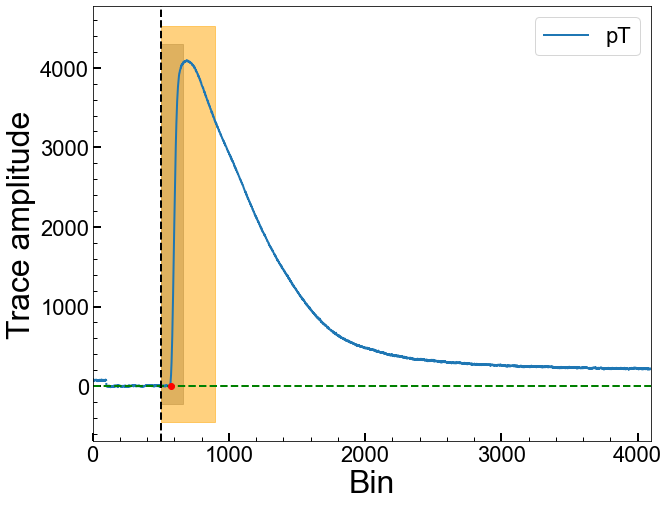

Series Number: 72209162200
Event Number: 2580734
Energy: 10.26528748989 keV
Area: 293257.7433276498


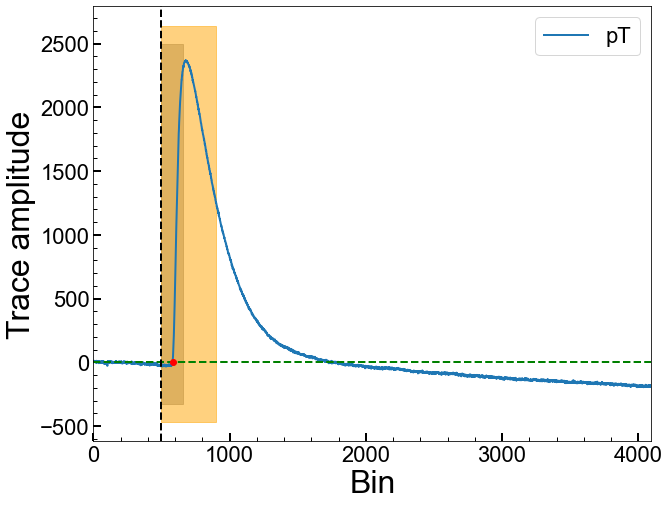

Series Number: 72209162200
Event Number: 2590533
Energy: 22.83048420607 keV
Area: 571511.6596892535


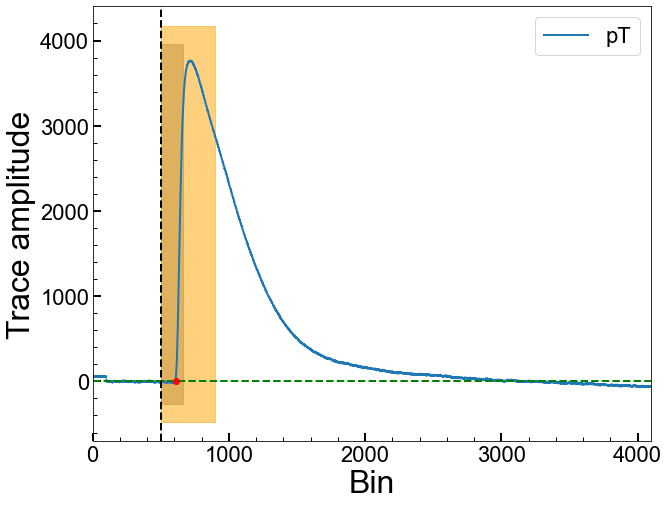

Series Number: 72209162200
Event Number: 2600244
Energy: 7.59569897403 keV
Area: 537546.5266272092


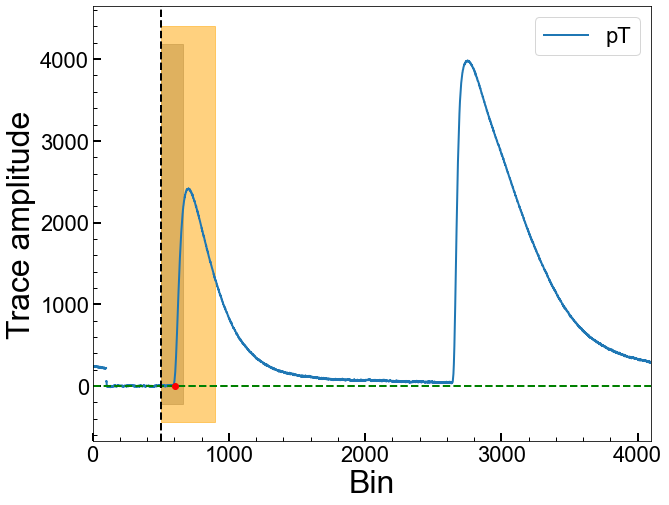

Series Number: 72209162200
Event Number: 2620380
Energy: 21.10486312709 keV
Area: 297054.95612588094


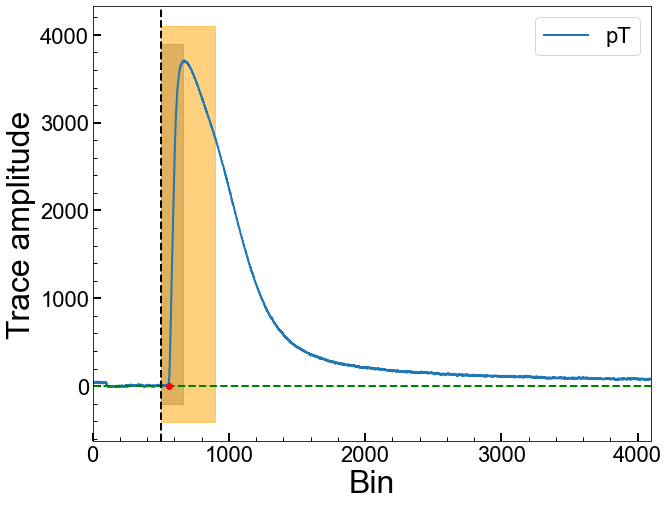

Series Number: 72209162200
Event Number: 2620773
Energy: 47.91406375709 keV
Area: -1687265.9040661186


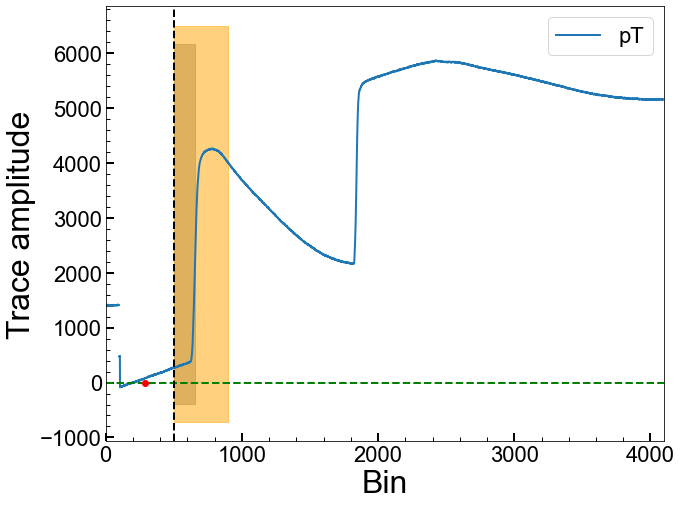

Series Number: 72209162200
Event Number: 2630787
Energy: 43.13693716982 keV
Area: -587151.531894439


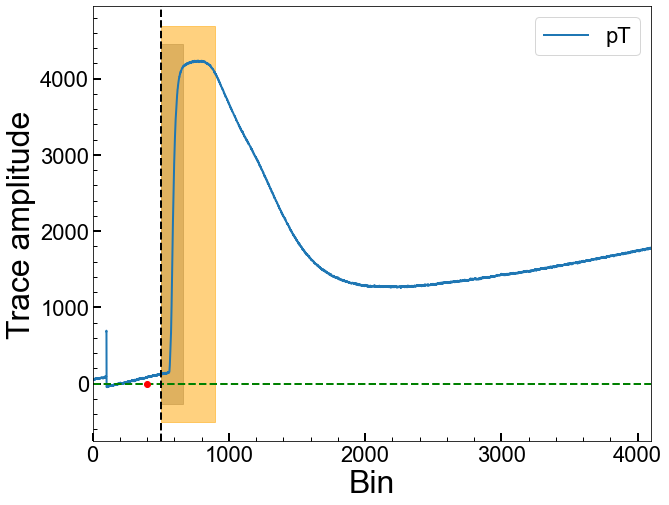

Series Number: 72209162200
Event Number: 2640047
Energy: 5.344141454392 keV
Area: 314267.45068798156


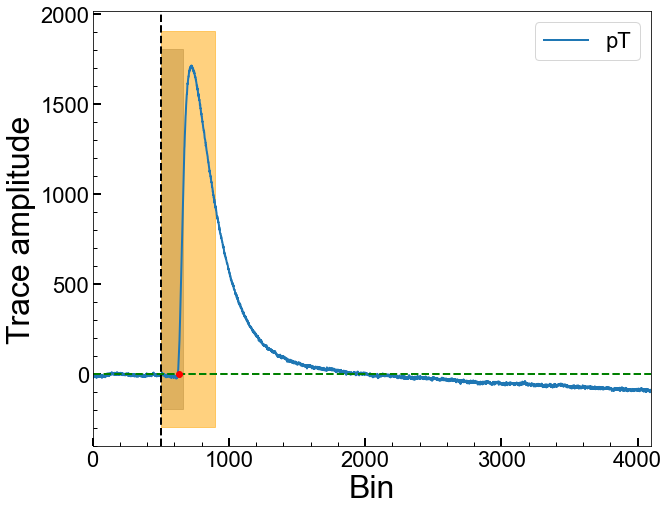

Series Number: 72209162200
Event Number: 2650074
Energy: 43.72137011397 keV
Area: 611684.93350631


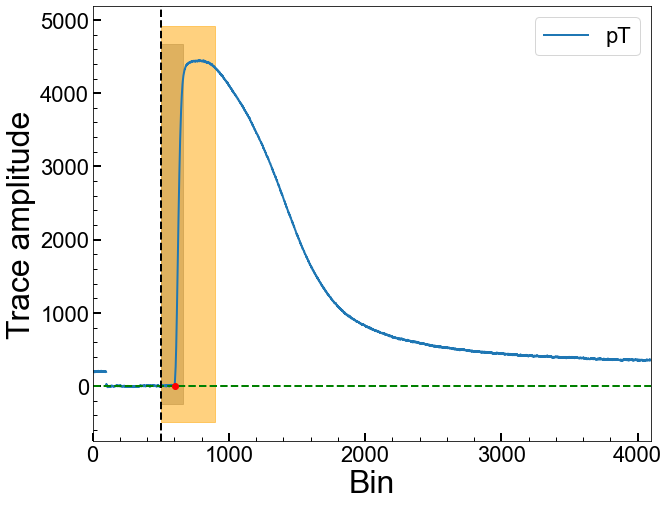

Series Number: 72209162200
Event Number: 2660855
Energy: 16.72335087604 keV
Area: 643598.6761071999


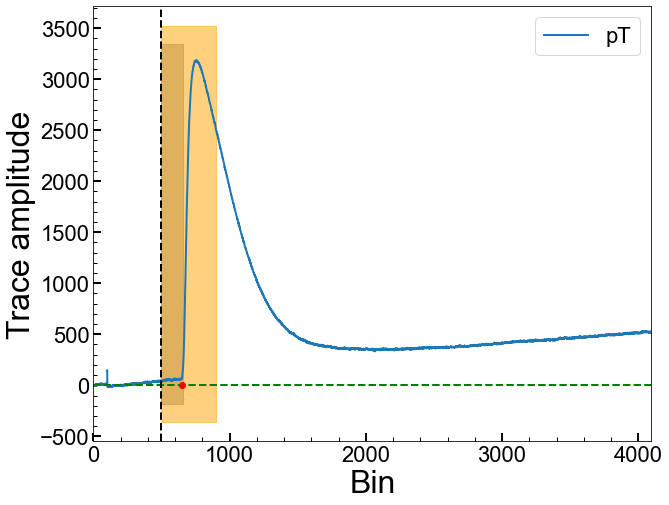

Series Number: 72209162200
Event Number: 2670168
Energy: 22.2437840606 keV
Area: -162423.48268524854


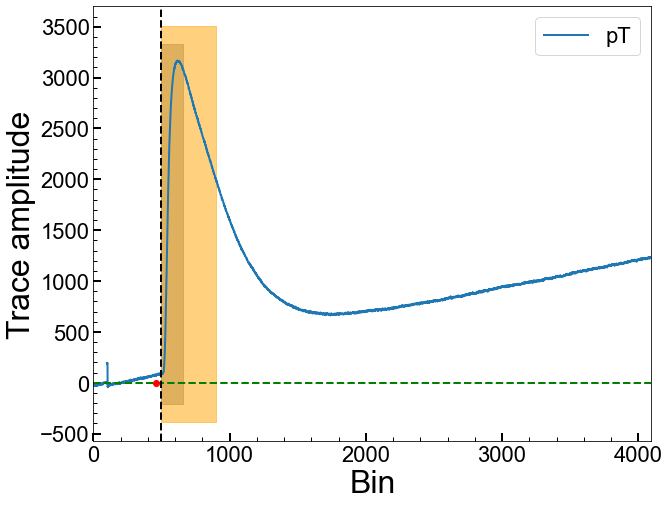

Series Number: 72209162200
Event Number: 2680389
Energy: 2.829655200786 keV
Area: 789284.6248847863


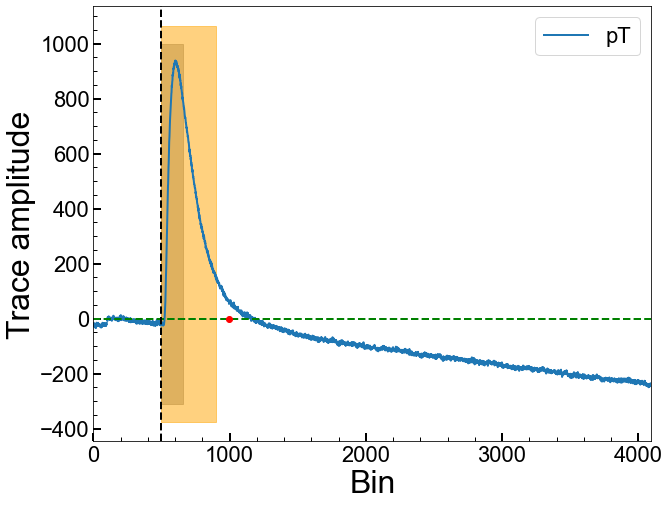

Series Number: 72209162200
Event Number: 2680691
Energy: 44.79425119625 keV
Area: 163936.07129849005


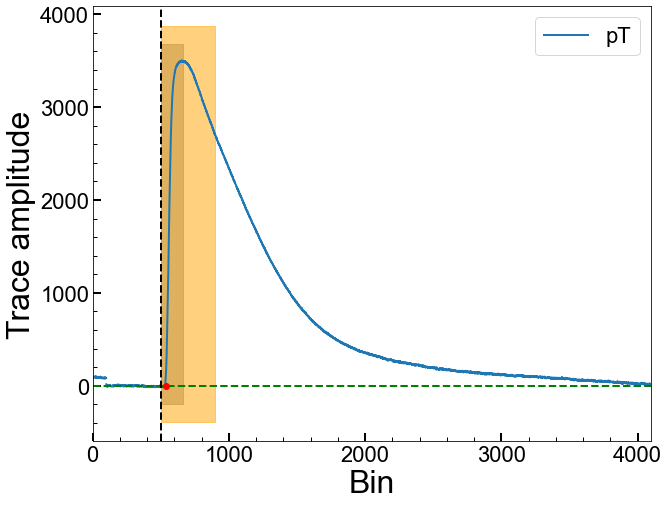

Series Number: 72209162200
Event Number: 2690600
Energy: 14.02746429246 keV
Area: 302884.96629192046


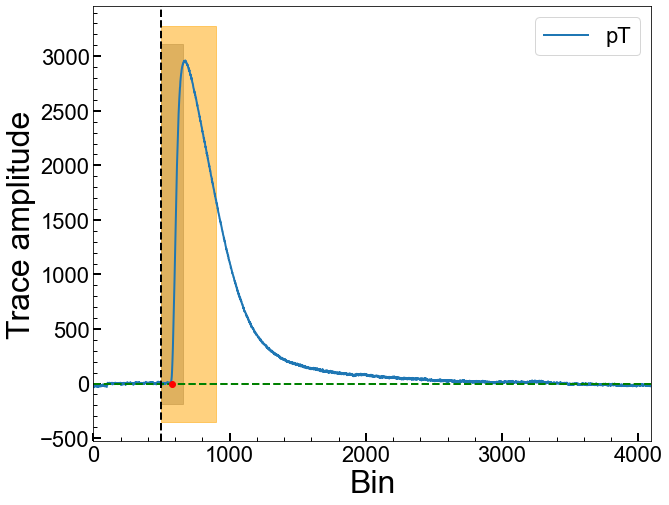

Series Number: 72209162200
Event Number: 2720595
Energy: 21.48952953827 keV
Area: 494257.32477871294


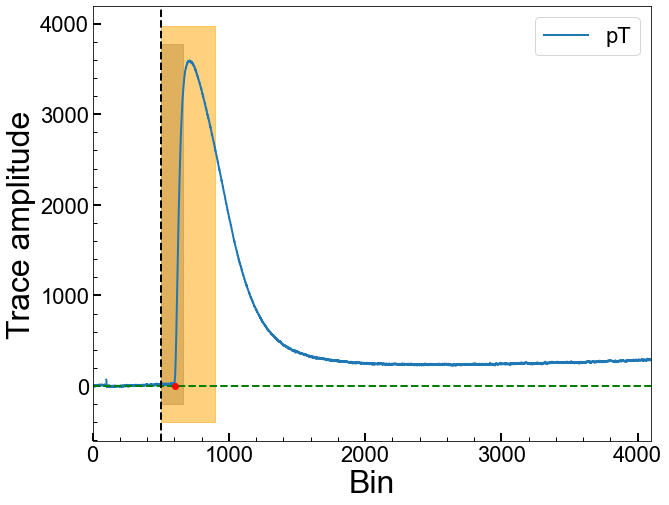

Series Number: 72209162200
Event Number: 2720721
Energy: 14.31572927108 keV
Area: 396487.022459306


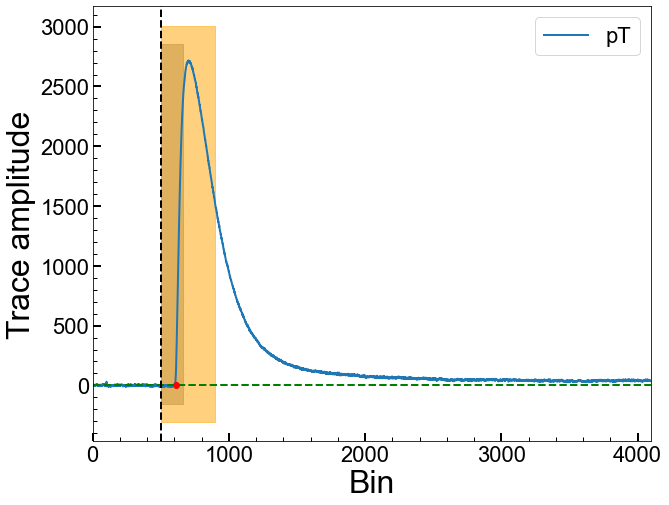

Series Number: 72209162200
Event Number: 2740277
Energy: 23.65306555572 keV
Area: 702889.7781437882


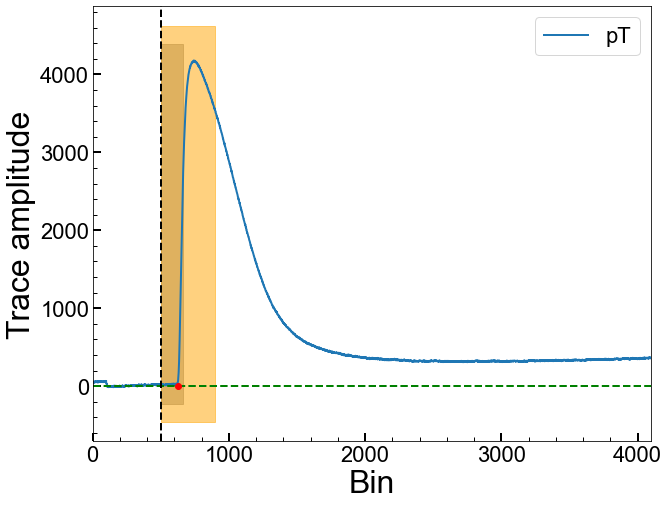

Series Number: 72209162200
Event Number: 2740839
Energy: 5.961877759074 keV
Area: 231629.89392848764


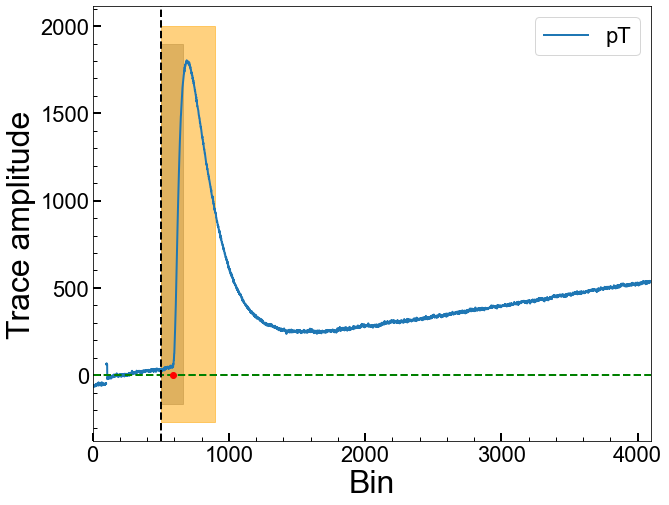

Series Number: 72209162200
Event Number: 2820612
Energy: 17.78044525354 keV
Area: 436165.78762391506


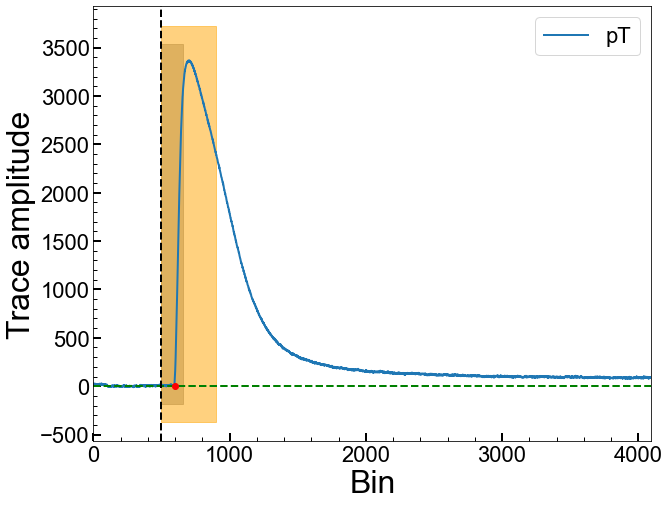

Series Number: 72209162200
Event Number: 2830785
Energy: 11.47578048041 keV
Area: 496544.54892793705


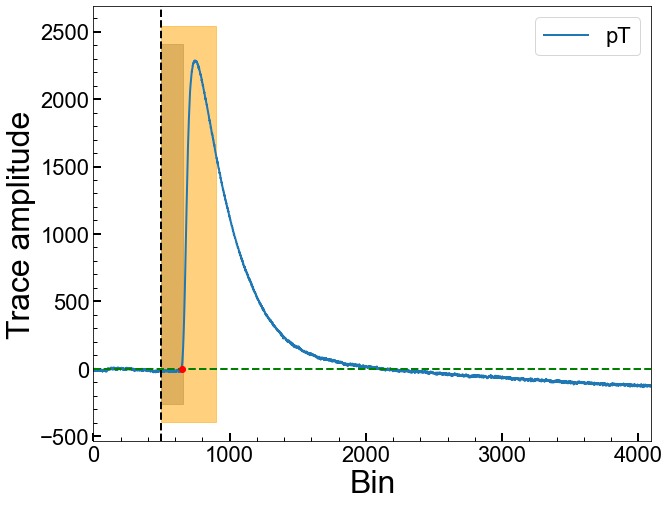

Series Number: 72209162200
Event Number: 2840820
Energy: 13.78981823399 keV
Area: -1693967.5679741516


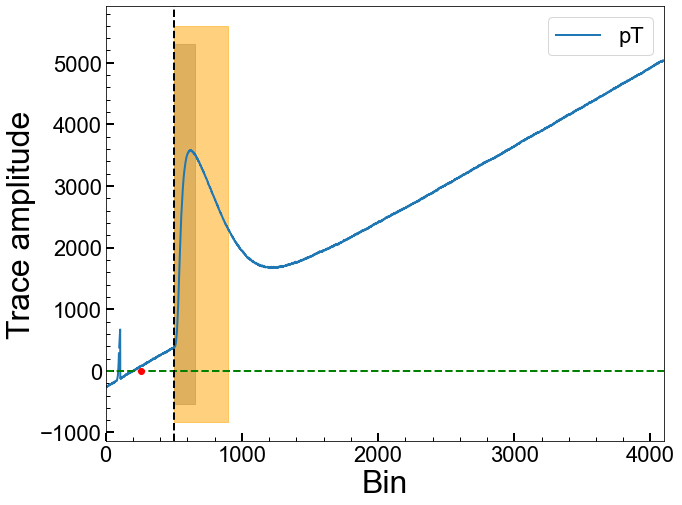

Series Number: 72209162200
Event Number: 2850462
Energy: 12.63805420814 keV
Area: 697970.1083953204


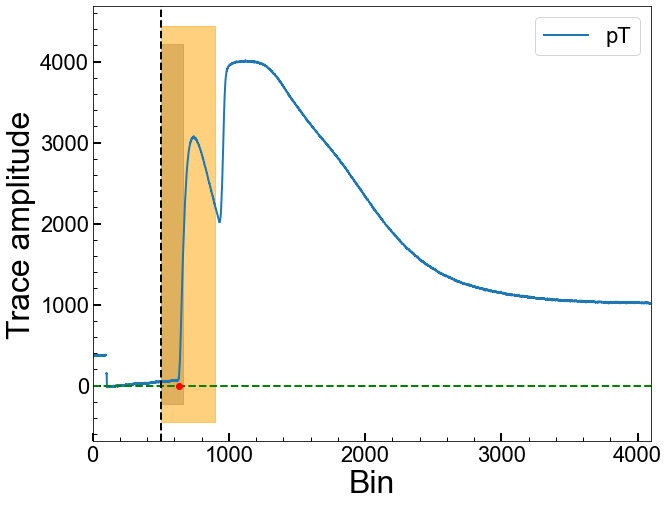

Series Number: 72209162200
Event Number: 2860894
Energy: 28.20951765612 keV
Area: 530955.564181072


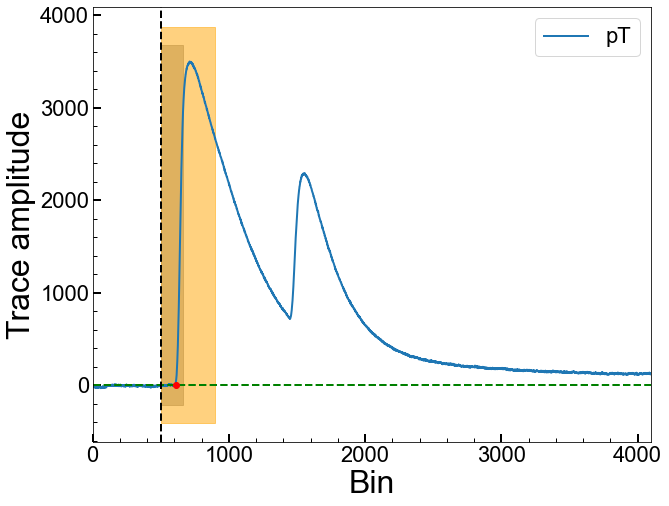

Series Number: 72209162200
Event Number: 2880745
Energy: 10.67149807347 keV
Area: 488903.9855051655


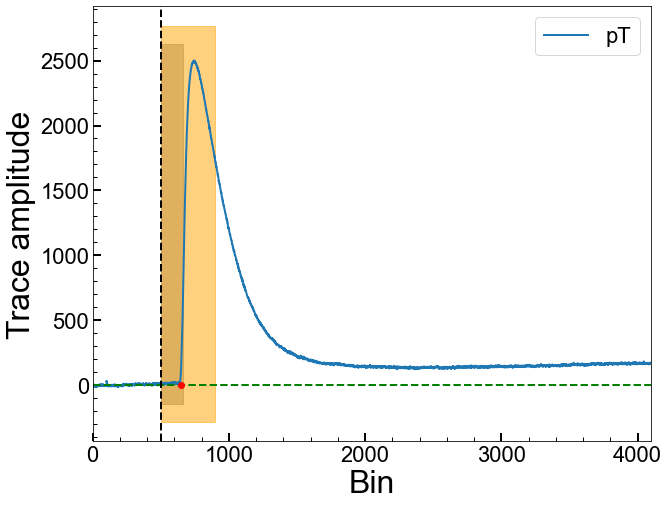

Series Number: 72209162200
Event Number: 2880748
Energy: 2.702636825818 keV
Area: 186754.74076587343


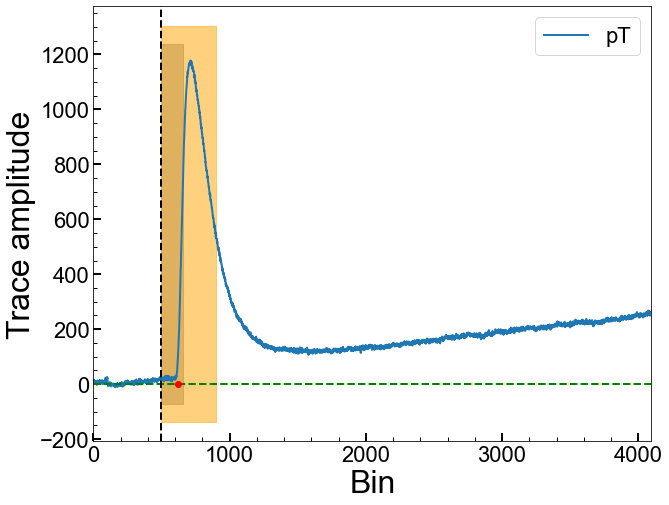

Series Number: 72209162200
Event Number: 2920068
Energy: 9.393236829178 keV
Area: 98099.81009977932


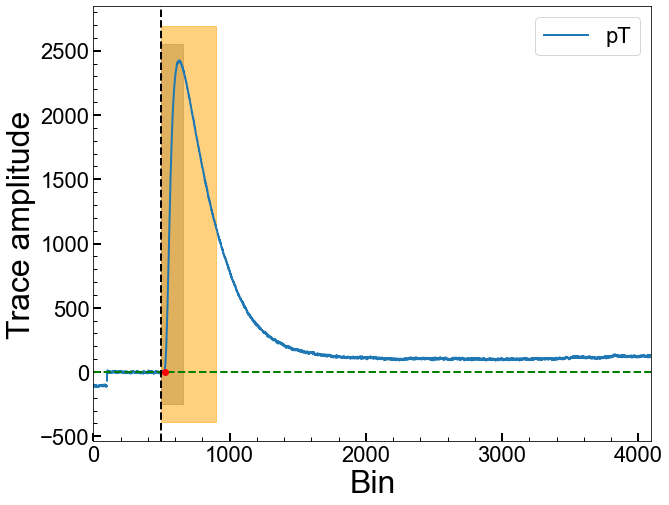

Series Number: 72209162200
Event Number: 2920350
Energy: 11.14954325319 keV
Area: 107385.41621353824


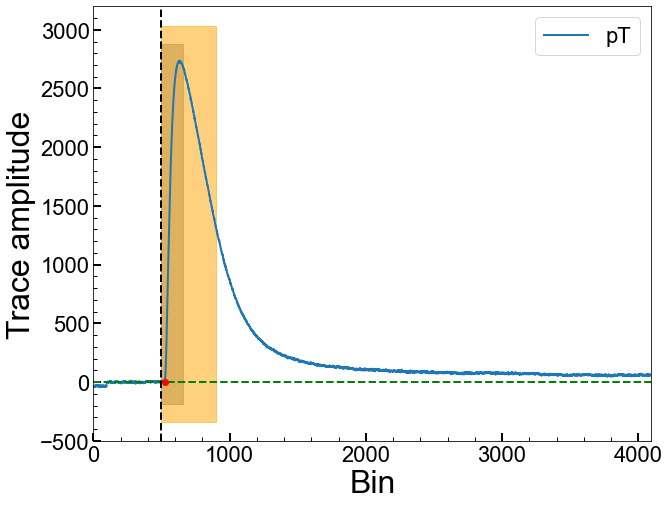

Series Number: 72209162200
Event Number: 2940033
Energy: 6.021992545616 keV
Area: -2731269.400829409


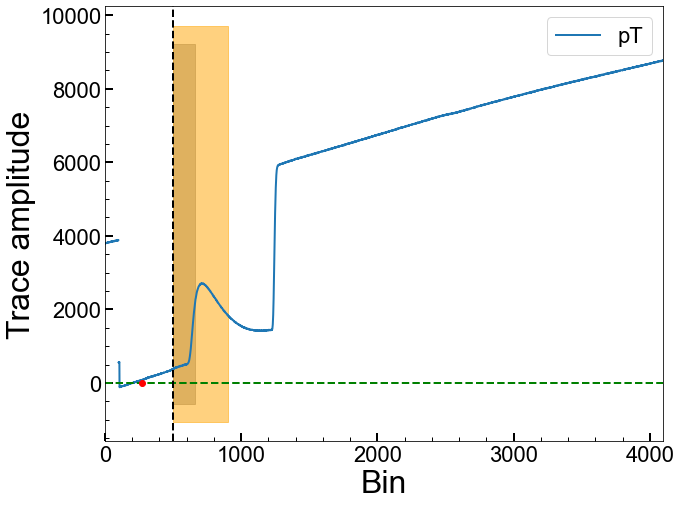

Series Number: 72209162200
Event Number: 2940061
Energy: 45.19260045898 keV
Area: 670298.1407067664


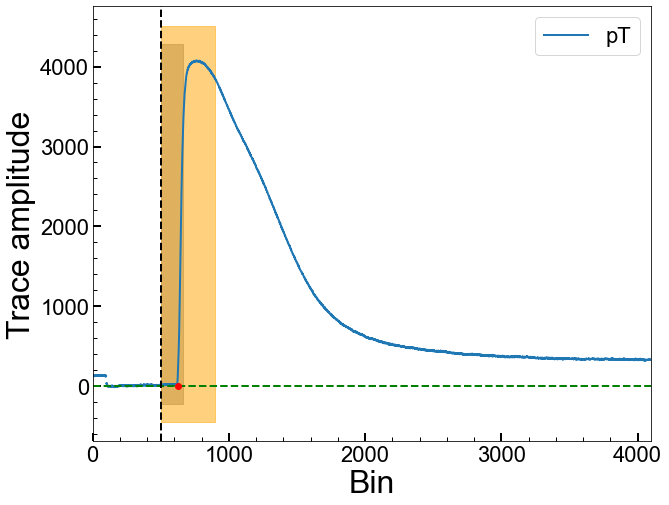

Series Number: 72209162200
Event Number: 2950491
Energy: 7.712006760166 keV
Area: 338591.0097615898


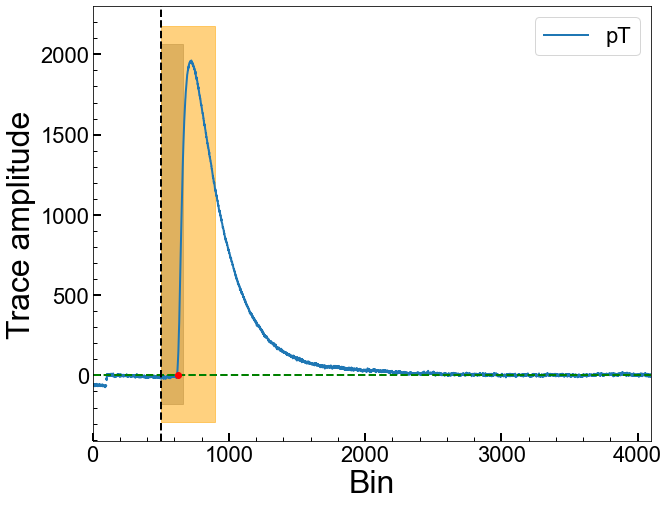

Series Number: 72209162200
Event Number: 2980380
Energy: 23.62855821978 keV
Area: 507783.83525441395


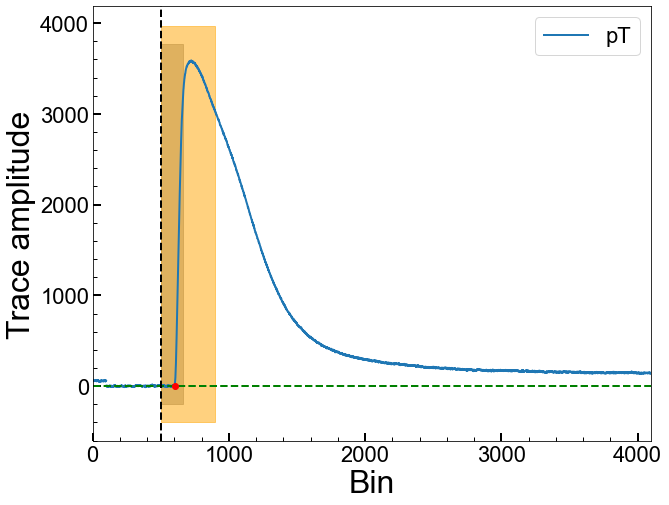

Series Number: 72209162200
Event Number: 3000415
Energy: 31.43824621664 keV
Area: 438306.04497441056


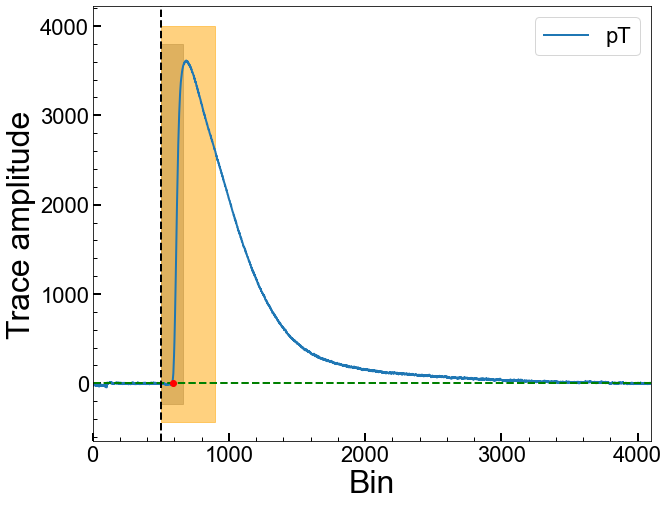

Series Number: 72209162200
Event Number: 3030037
Energy: 34.9408887116 keV
Area: 723769.7213650332


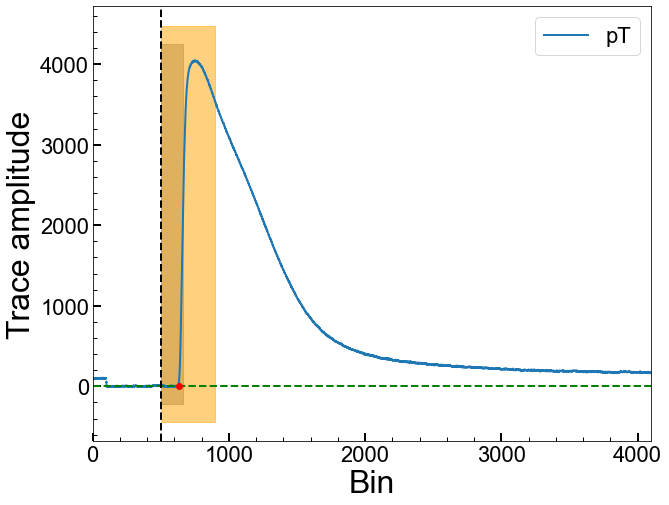

Series Number: 72209162200
Event Number: 3030252
Energy: 5.60203627926 keV
Area: 371215.19738478423


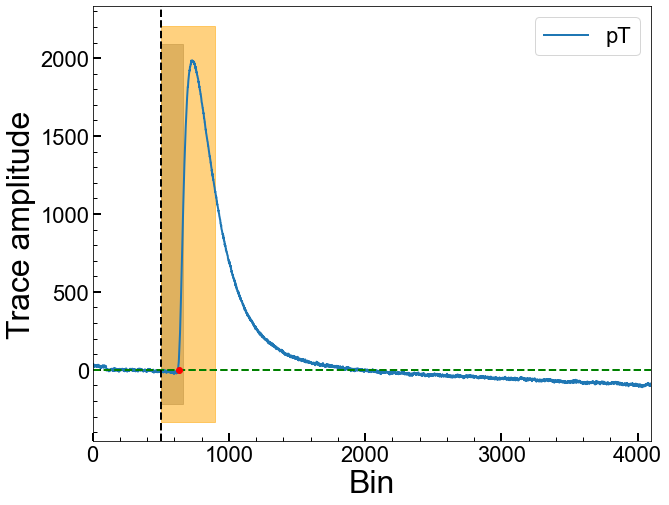

Series Number: 72209162200
Event Number: 3030713
Energy: 17.19421225291 keV
Area: -607441.1900020771


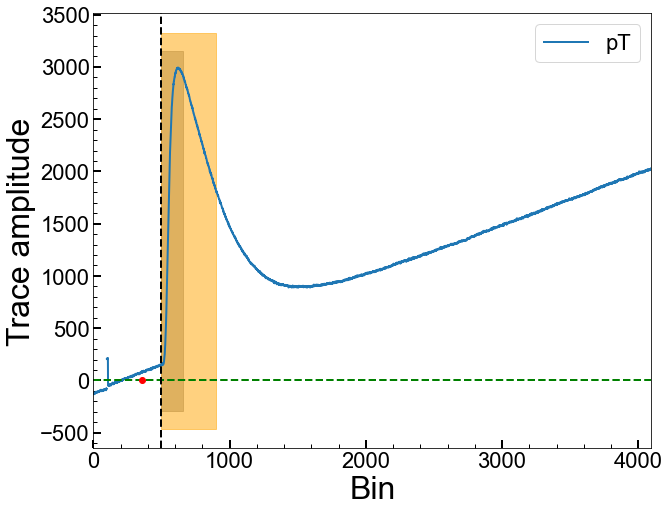

Series Number: 72209162200
Event Number: 3040125
Energy: 40.90303717979 keV
Area: 183577.0715428239


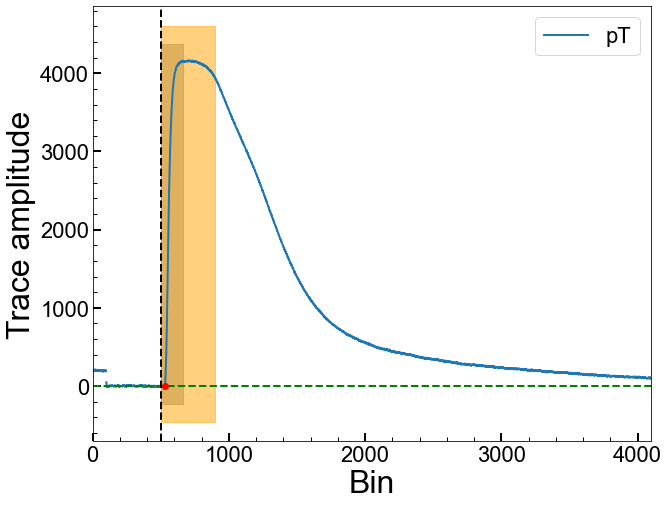

Series Number: 72209162200
Event Number: 3070703
Energy: 10.91177461363 keV
Area: 279330.51011225965


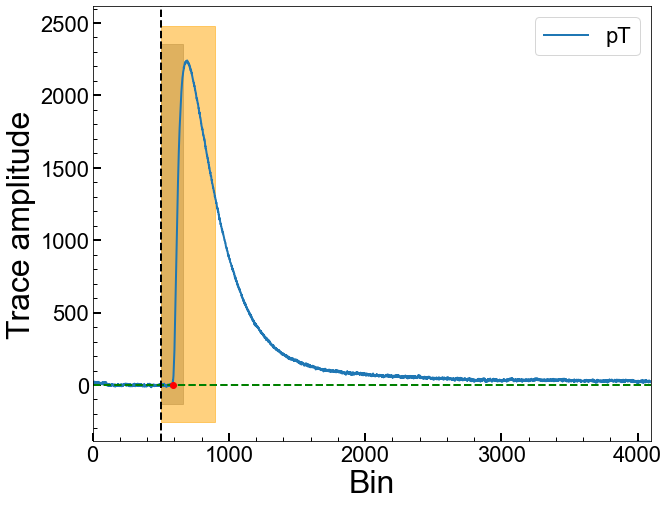

Series Number: 72209162200
Event Number: 3070886
Energy: 36.10265655727 keV
Area: -201917.1504832105


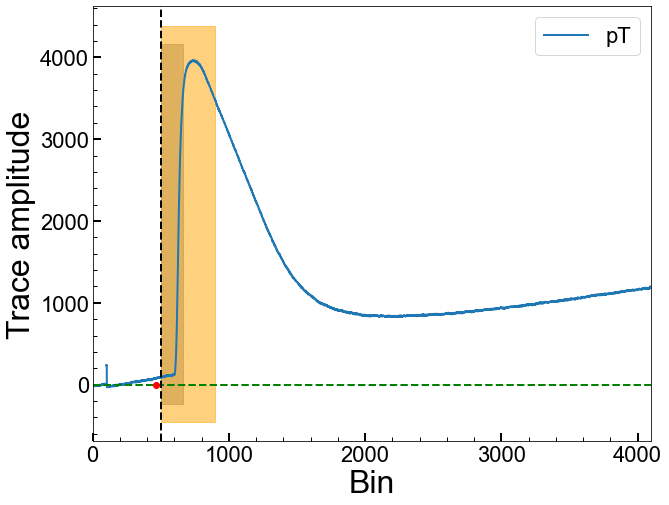

Series Number: 72209162200
Event Number: 3090804
Energy: 26.66306735393 keV
Area: 252105.7176674859


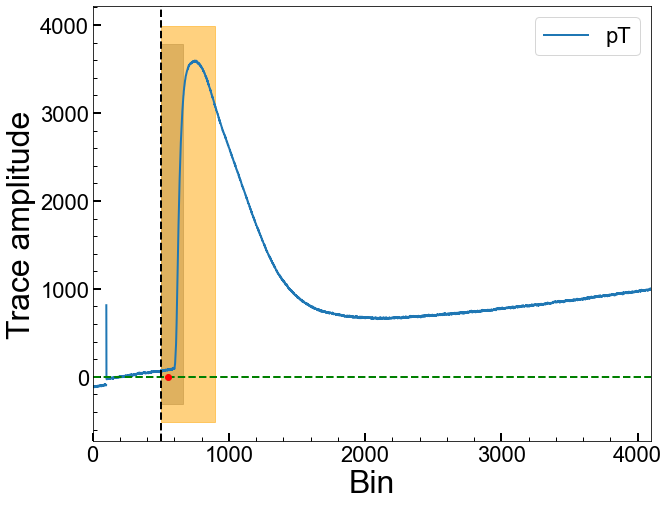

Series Number: 72209162200
Event Number: 3120083
Energy: 33.0280357493 keV
Area: 529586.5341321526


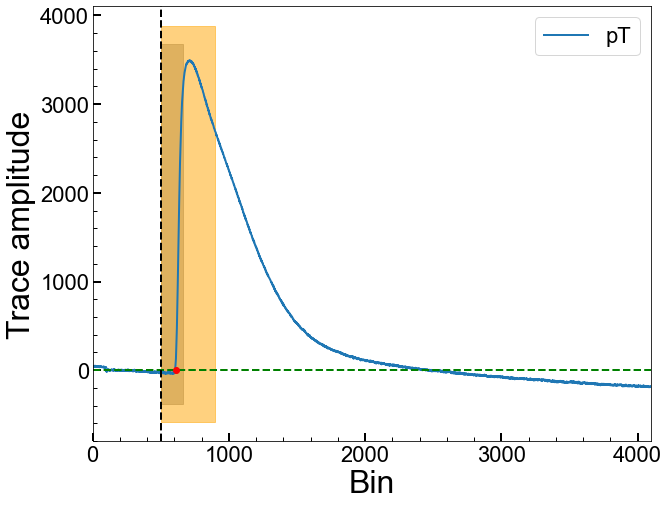

Series Number: 72209162200
Event Number: 3130424
Energy: 26.17052722942 keV
Area: 626378.3070552796


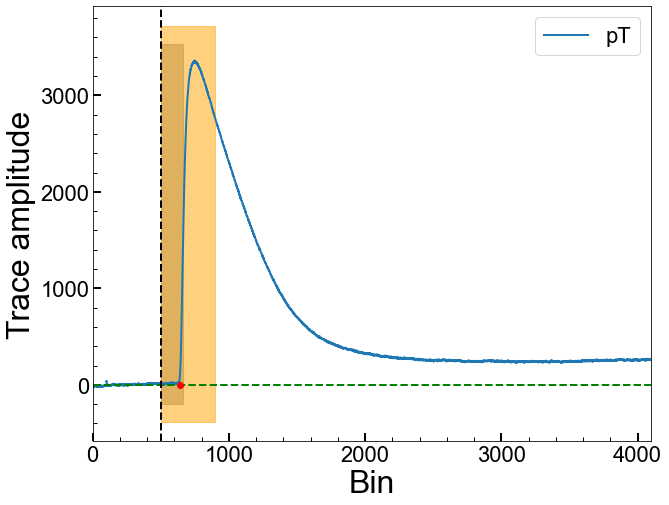

Series Number: 72209162200
Event Number: 3150288
Energy: 34.08515306094 keV
Area: -509532.0956990726


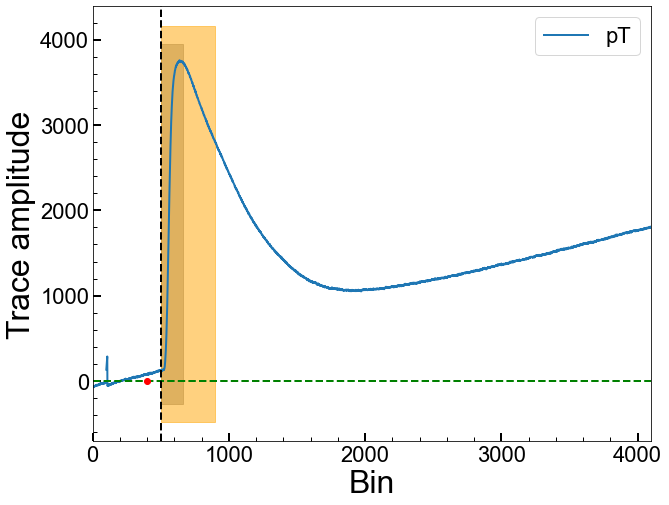

Series Number: 72209162200
Event Number: 3150416
Energy: 46.03210565425 keV
Area: 286712.0846850067


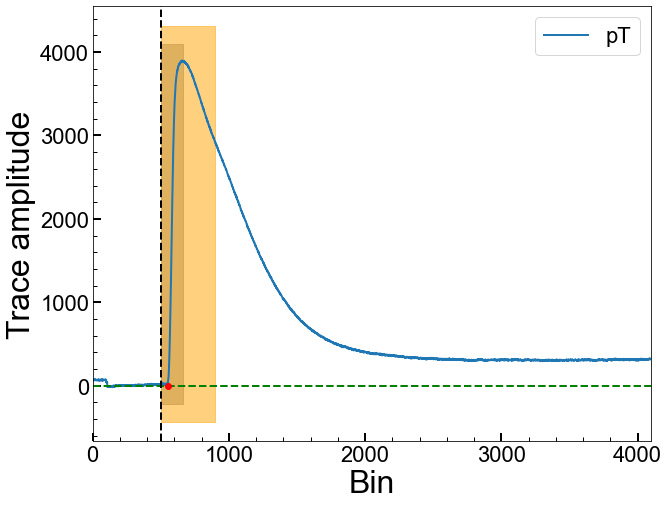

Series Number: 72209162200
Event Number: 3160488
Energy: 11.03027142962 keV
Area: 436257.4759253339


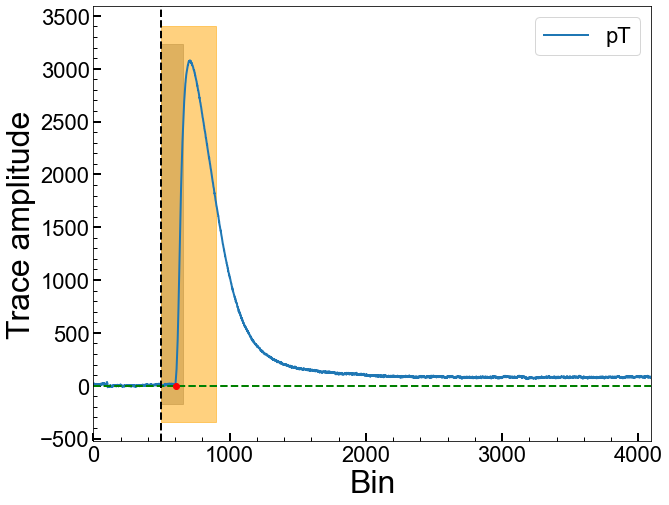

Series Number: 72209162200
Event Number: 3160641
Energy: 36.07092428495 keV
Area: 362125.2290552653


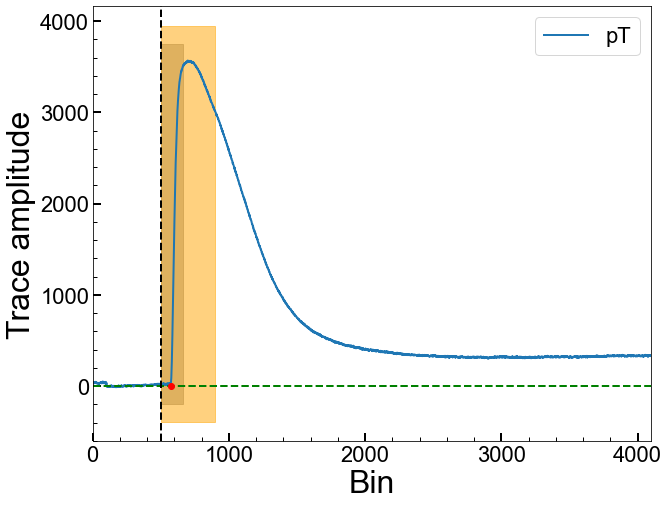

Series Number: 72209162200
Event Number: 3200505
Energy: 28.60926542885 keV
Area: 555367.5389485358


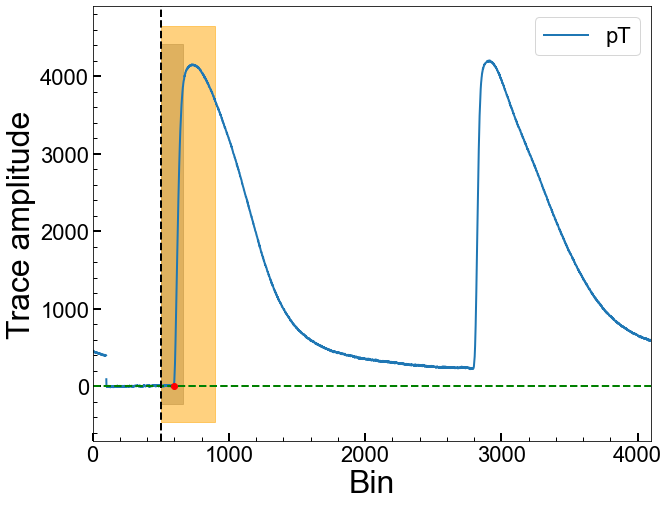

Series Number: 72209162200
Event Number: 3210234
Energy: 8.452406144227 keV
Area: 405606.6455675492


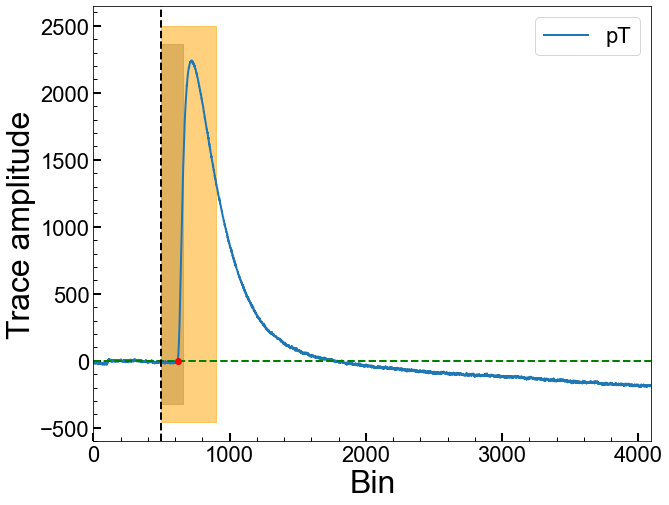

Series Number: 72209162200
Event Number: 3210392
Energy: 20.61541567313 keV
Area: 359597.8424486896


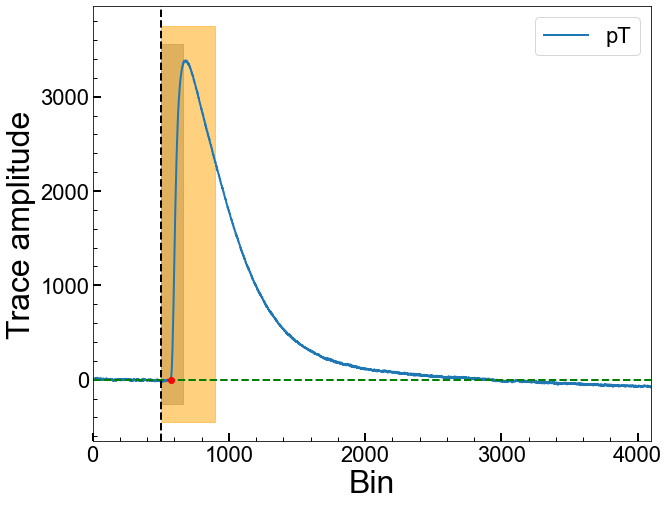

Series Number: 72209162200
Event Number: 3220184
Energy: 6.26940290321 keV
Area: 50690.50315755227


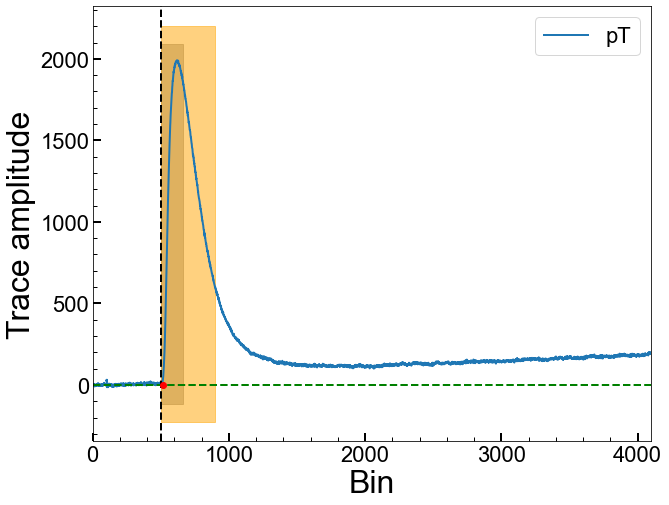

Series Number: 72209162200
Event Number: 3230694
Energy: 34.90405438808 keV
Area: 74915.55148582783


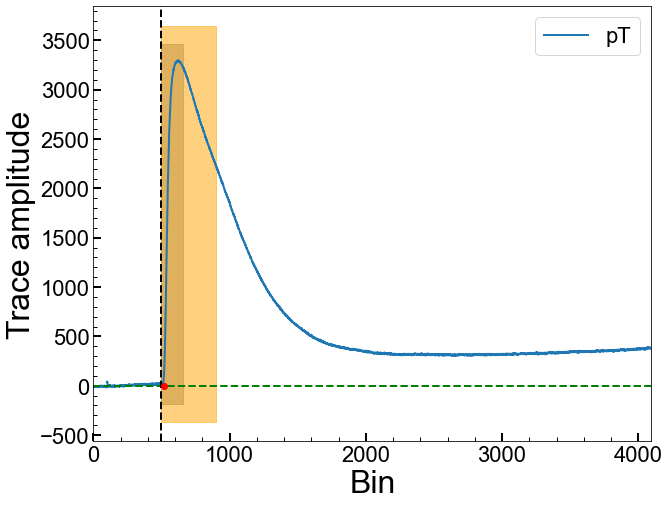

Series Number: 72209162200
Event Number: 3260787
Energy: 24.9539818258 keV
Area: 498621.7123371652


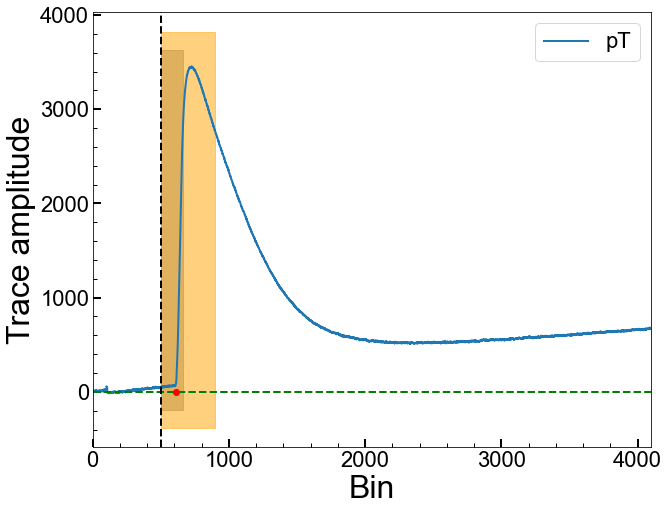

Series Number: 72209162200
Event Number: 3270463
Energy: 26.18864792029 keV
Area: 451151.3687930065


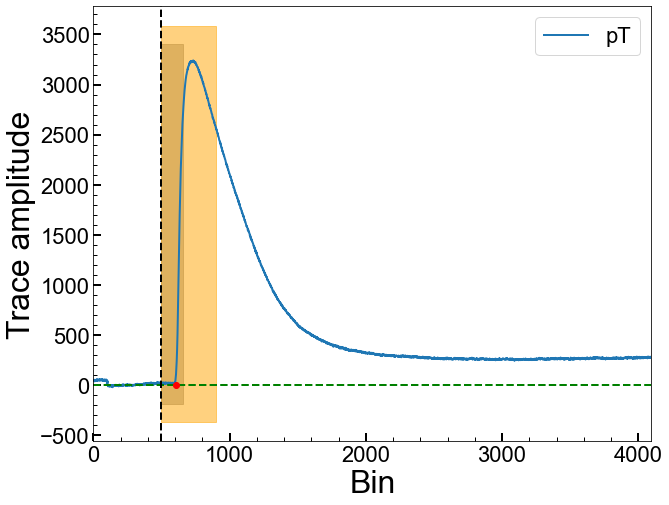

Series Number: 72209162200
Event Number: 3270617
Energy: 6.065410078106 keV
Area: 596686.1513699187


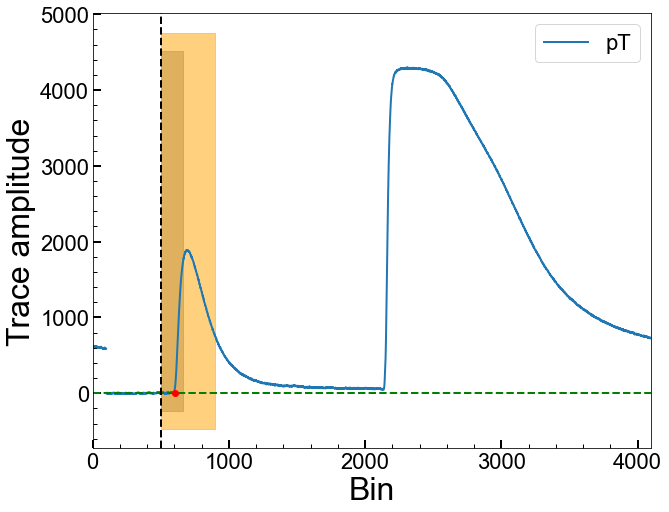

Series Number: 72209162200
Event Number: 3270905
Energy: 2.899360129374 keV
Area: -1434652.102397086


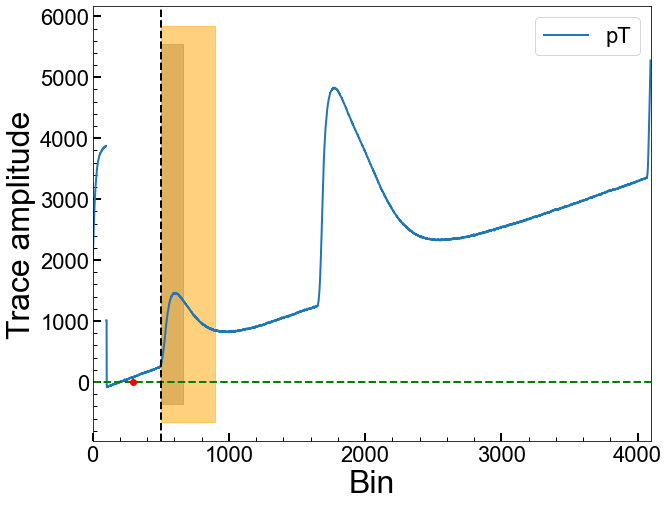

Series Number: 72209162200
Event Number: 3280930
Energy: 8.865744925581 keV
Area: 392018.8195616782


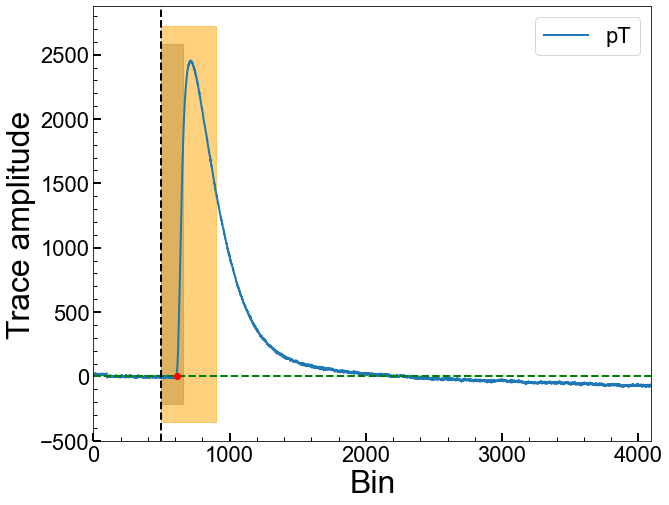

Series Number: 72209162200
Event Number: 3320271
Energy: 11.13841069155 keV
Area: 416006.38522627804


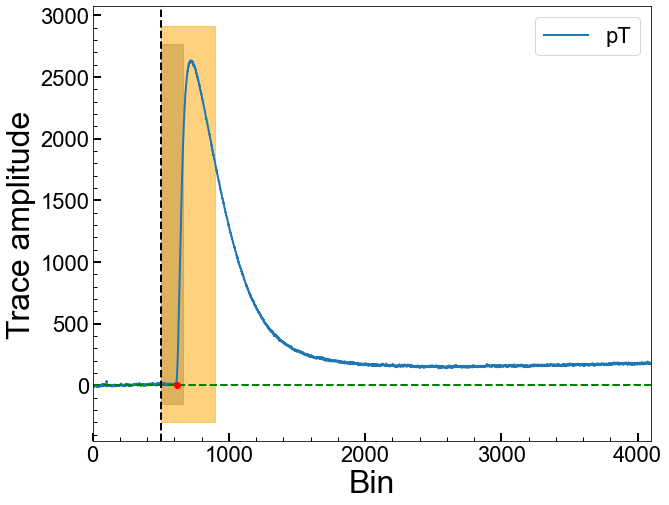

Series Number: 72209162200
Event Number: 3320772
Energy: 44.31280060346 keV
Area: 654923.150697579


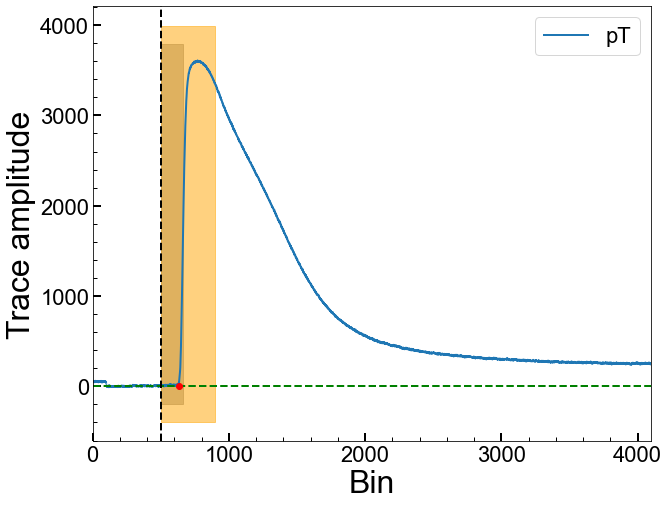

Series Number: 72209162200
Event Number: 3350116
Energy: 28.44878451182 keV
Area: 421754.1292451879


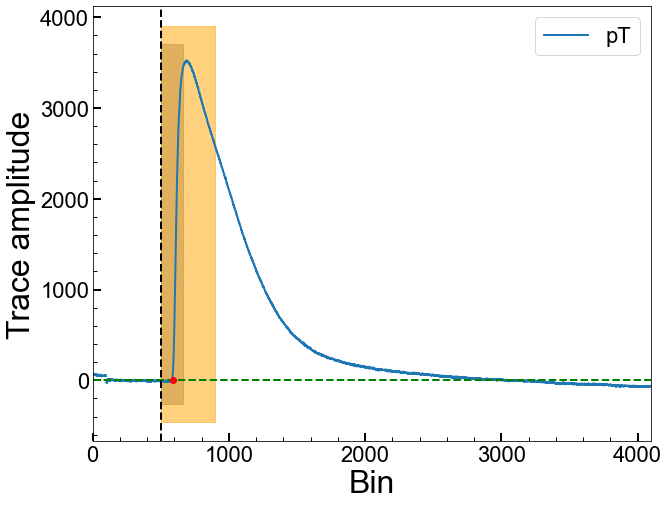

Series Number: 72209162200
Event Number: 3350178
Energy: 13.57077681298 keV
Area: 410157.0932246358


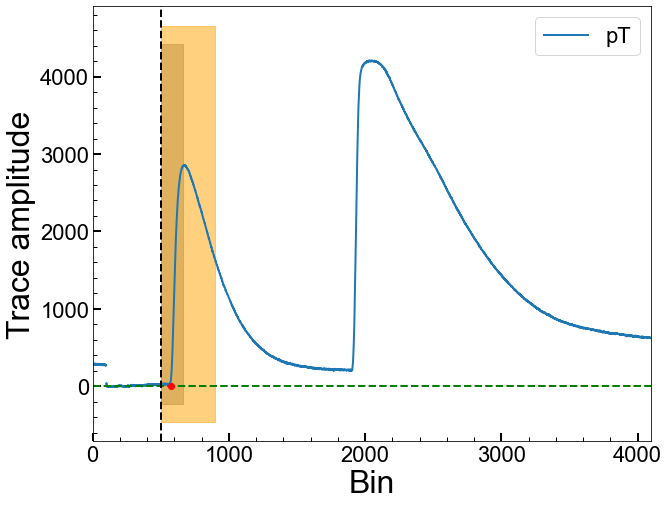

Series Number: 72209162200
Event Number: 3350723
Energy: 4.288947706303 keV
Area: 432372.91908275575


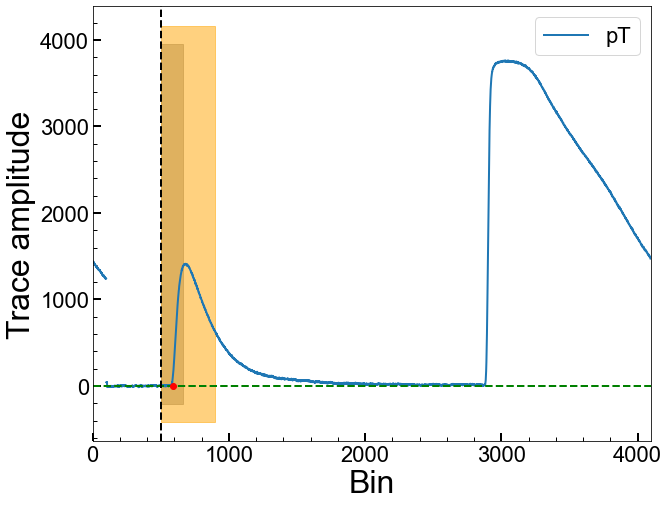

Series Number: 72209162200
Event Number: 3380191
Energy: 49.61615864063 keV
Area: 263355.97124121845


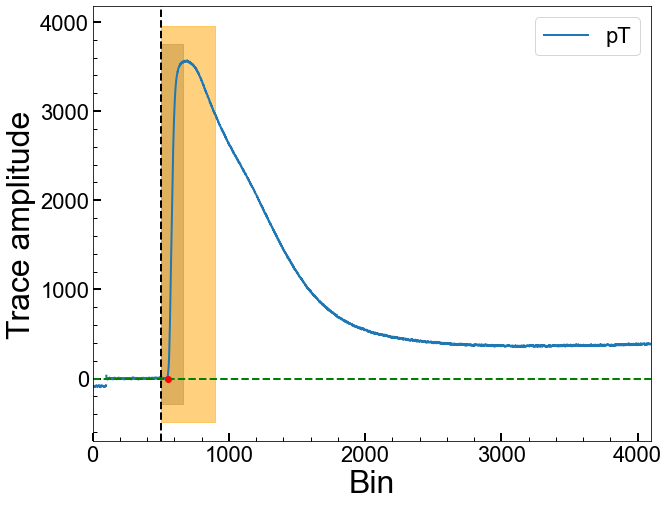

Series Number: 72209162200
Event Number: 3380446
Energy: 2.718480768586 keV
Area: 130754.74518629558


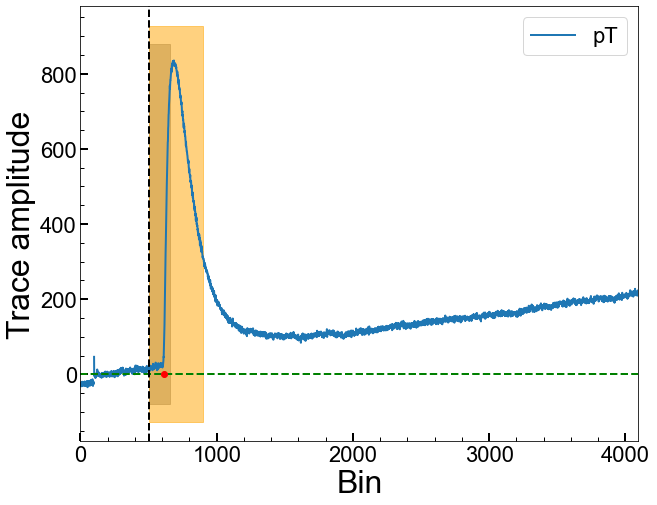

Series Number: 72209162200
Event Number: 3380687
Energy: 6.362785538592 keV
Area: 225318.43057343963


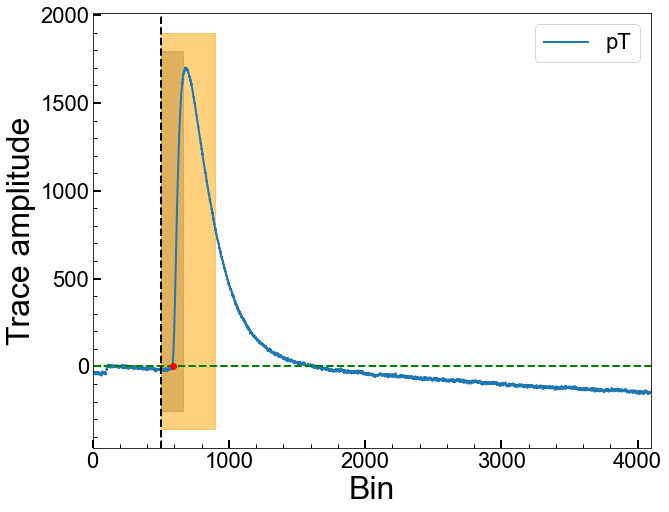

Series Number: 72209162200
Event Number: 3390032
Energy: 5.515317453935 keV
Area: 37764.52420837085


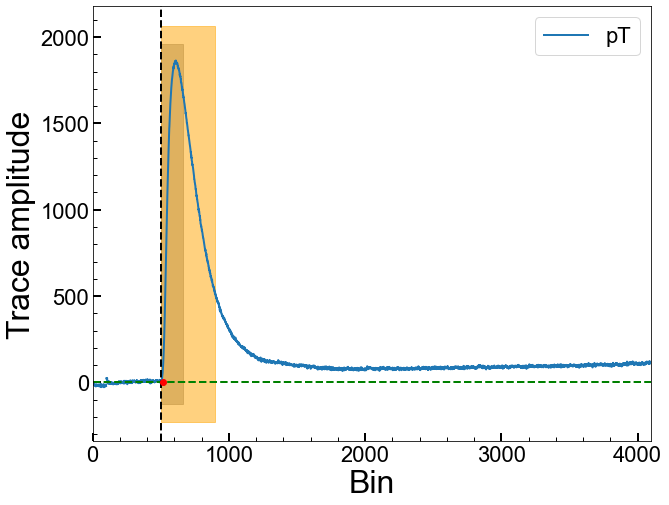

Series Number: 72209162200
Event Number: 3390608
Energy: 41.00164147379 keV
Area: 38531.03275825166


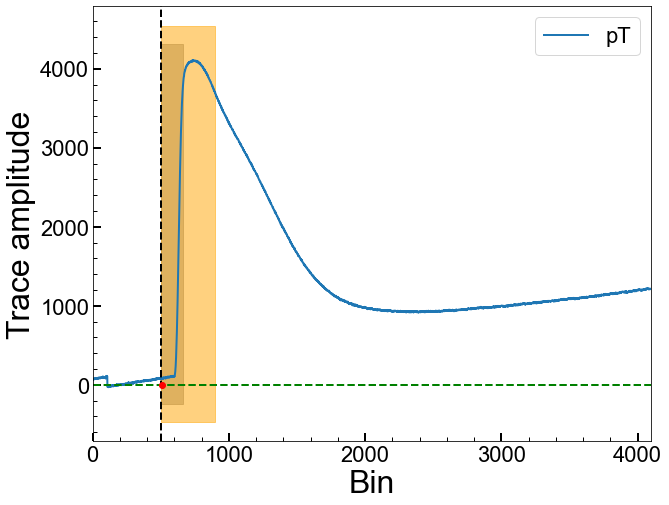

Series Number: 72209162200
Event Number: 3410103
Energy: 17.17643993778 keV
Area: 396586.46123542637


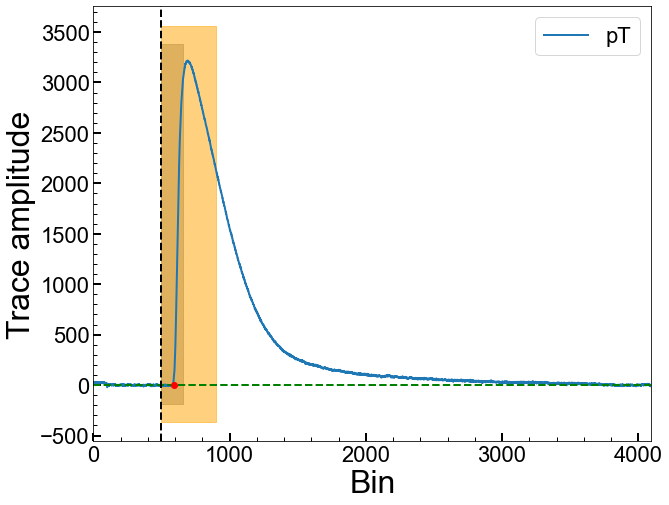

Series Number: 72209162200
Event Number: 3430119
Energy: 32.03605817262 keV
Area: -2177565.736032316


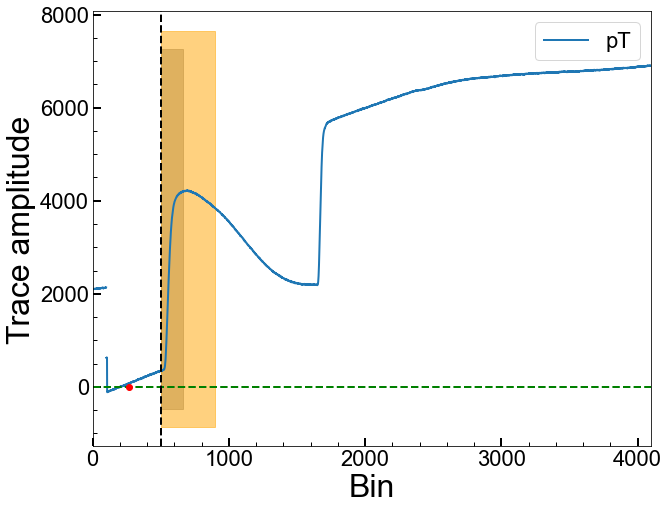

Series Number: 72209162200
Event Number: 3430598
Energy: 49.8815073324 keV
Area: -262965.3753254146


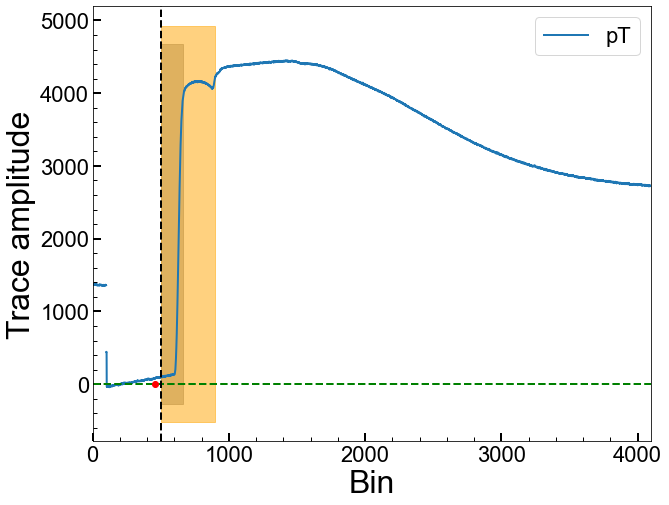

Series Number: 72209162200
Event Number: 3440582
Energy: 38.87963024924 keV
Area: 269875.4606562473


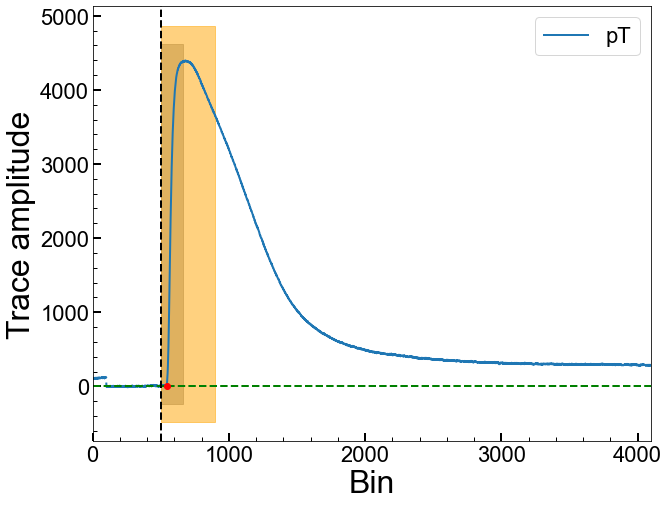

Series Number: 72209162200
Event Number: 3450632
Energy: 25.41458880836 keV
Area: 664688.8226670203


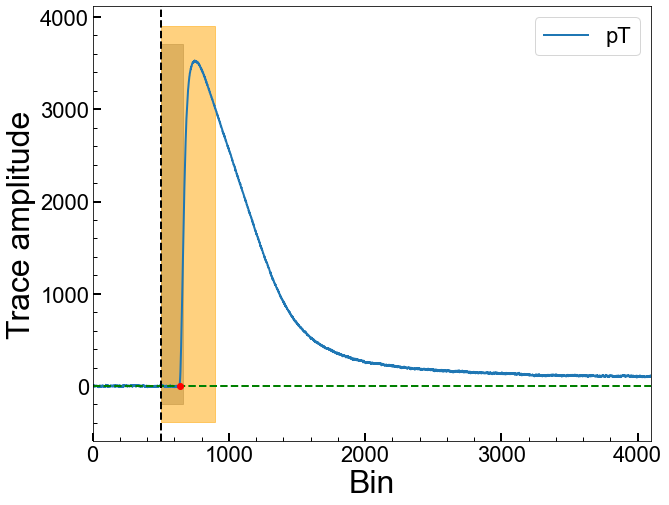

Series Number: 72209162200
Event Number: 3460135
Energy: 2.080356496048 keV
Area: 184826.41339884483


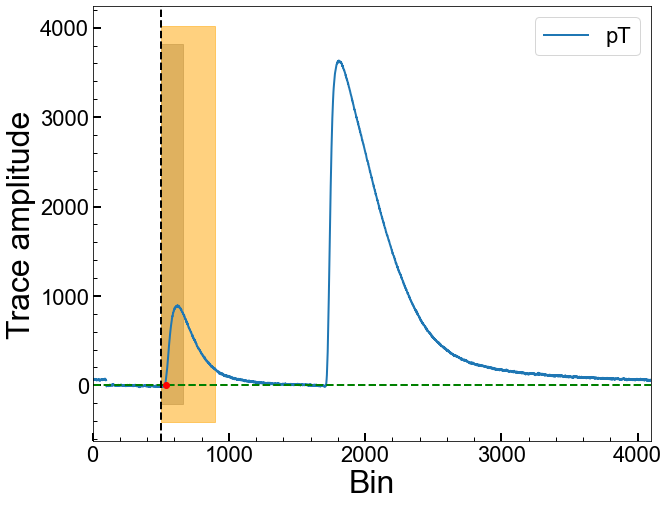

Series Number: 72209162200
Event Number: 3480425
Energy: 31.49140720016 keV
Area: 547766.4265679119


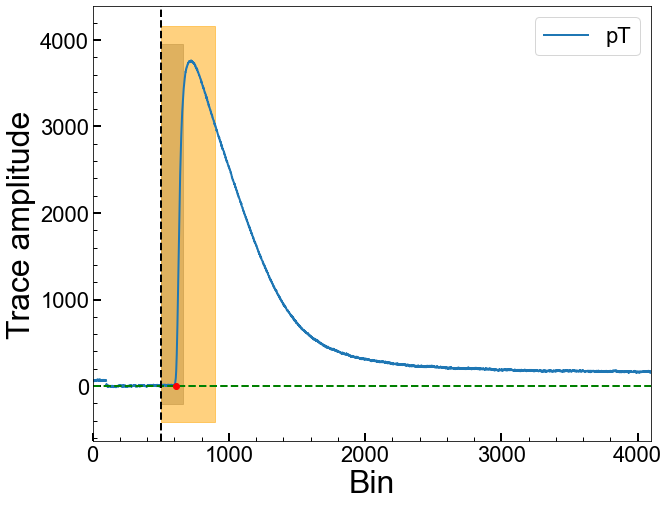

Series Number: 72209162200
Event Number: 3480506
Energy: 26.39616414339 keV
Area: 497061.1878570592


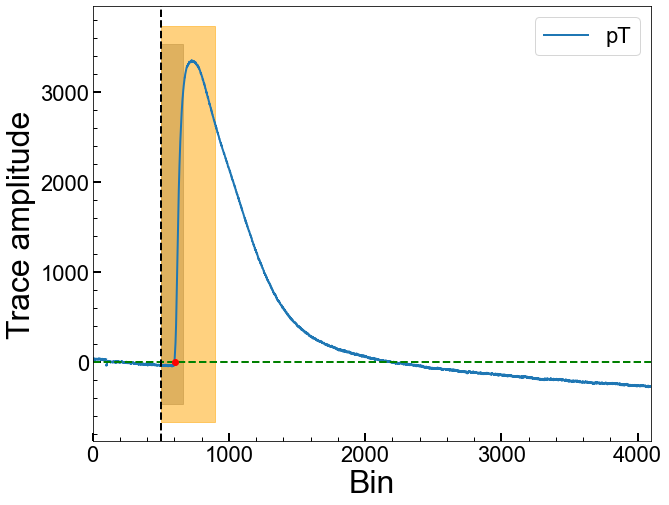

Series Number: 72209162200
Event Number: 3500735
Energy: 33.17332048548 keV
Area: 466049.3091817307


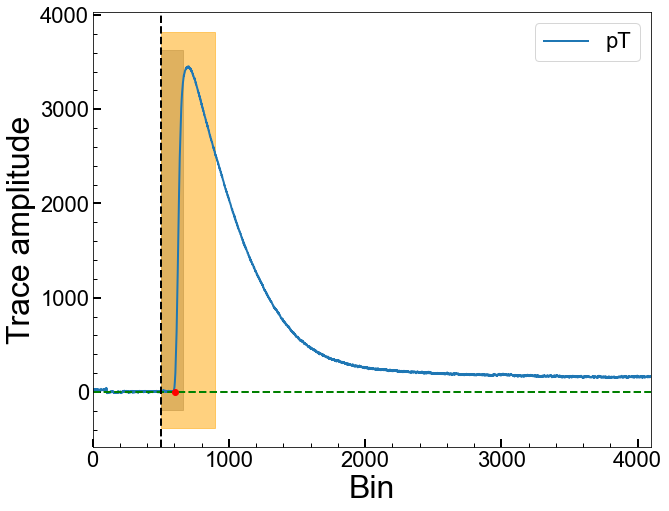

Series Number: 72209162200
Event Number: 3510171
Energy: 9.476482441326 keV
Area: 320034.396040795


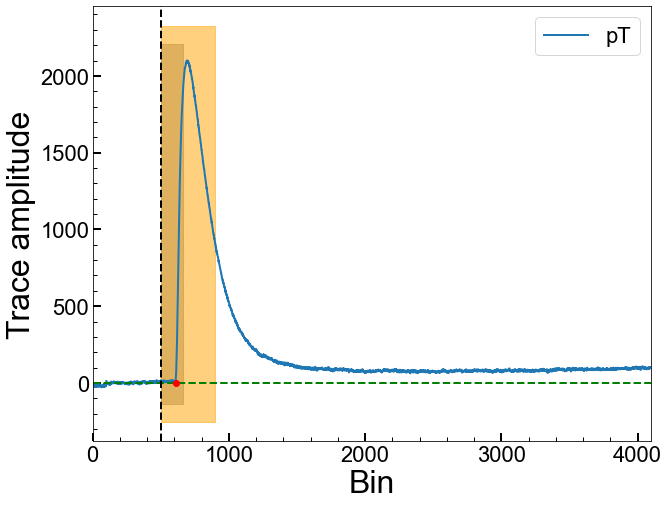

Series Number: 72209162200
Event Number: 3520916
Energy: 32.91013431579 keV
Area: 677315.8328686643


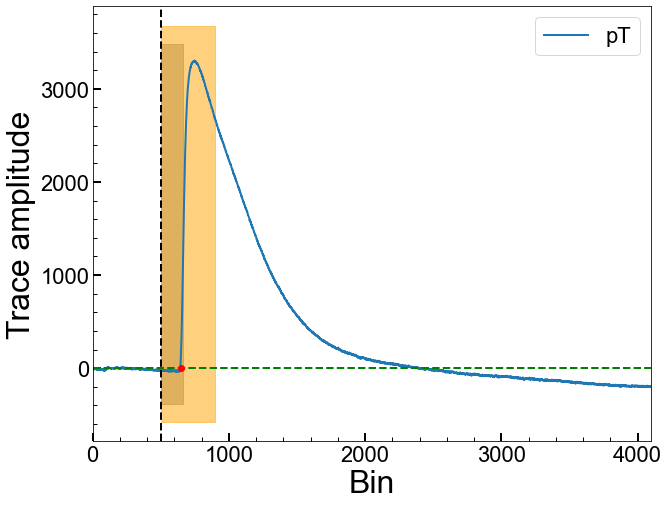

Series Number: 72209162200
Event Number: 3530448
Energy: 36.75105053509 keV
Area: 750483.5360085866


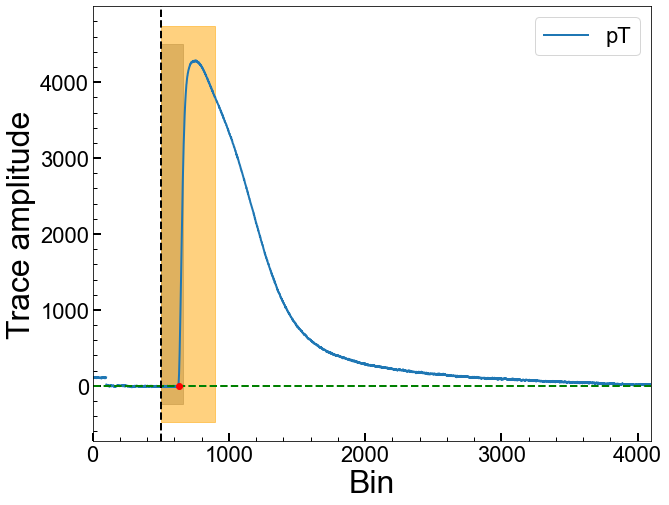

Series Number: 72209162200
Event Number: 3540826
Energy: 4.241800057188 keV
Area: -4523735.692472598


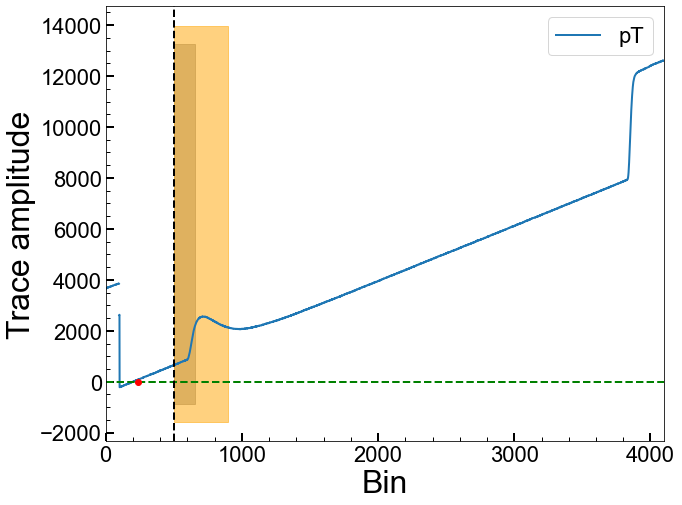

Series Number: 72209162200
Event Number: 3560843
Energy: 16.46908499042 keV
Area: 426387.49303576164


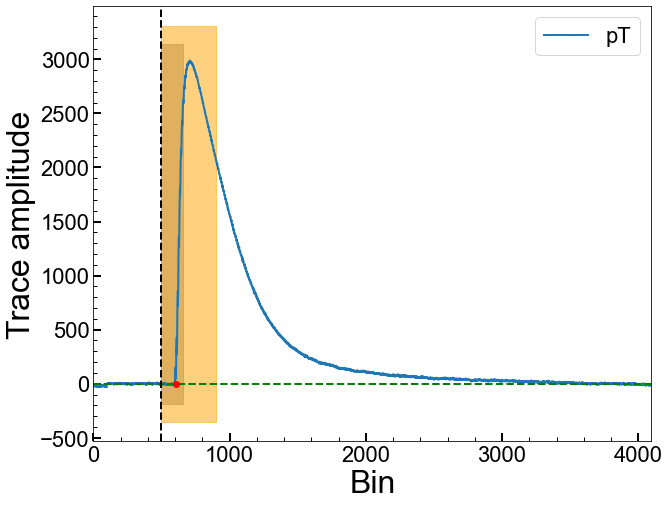

Series Number: 72209162200
Event Number: 3570157
Energy: 21.09195633097 keV
Area: 220244.3333087718


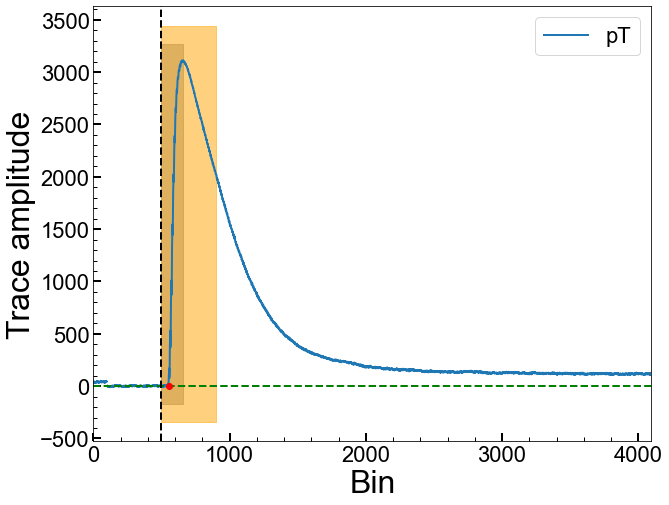

Series Number: 72209162200
Event Number: 3570224
Energy: 13.912361655 keV
Area: 318132.23849607055


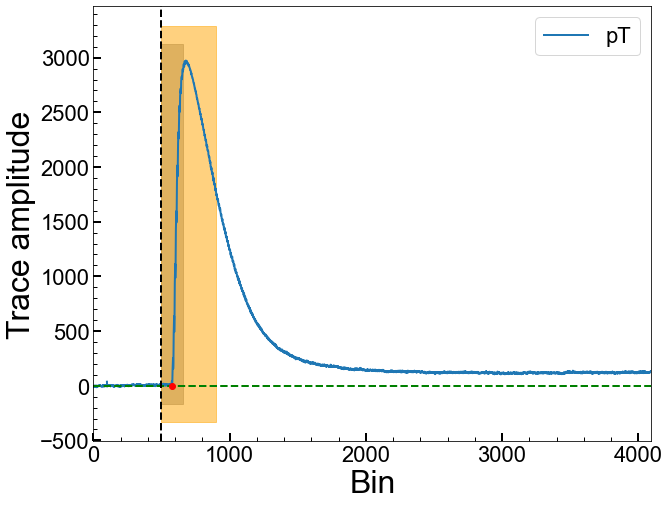

Series Number: 72209162200
Event Number: 3580438
Energy: 46.09205073108 keV
Area: 319496.0452120742


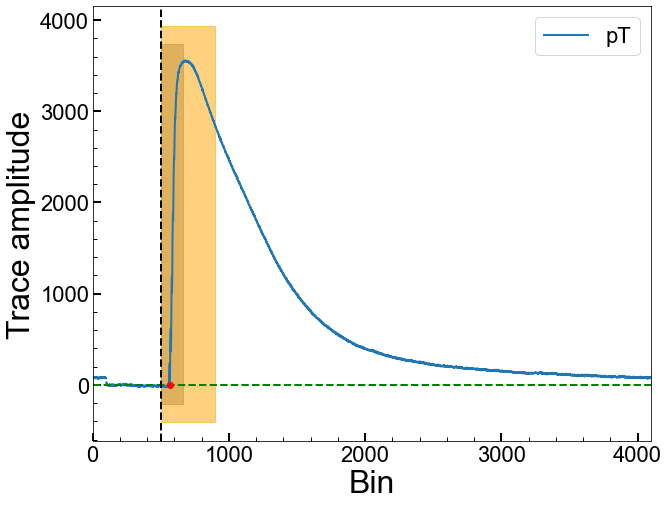

Series Number: 72209162200
Event Number: 3590307
Energy: 5.735707915052 keV
Area: 86501.2253311524


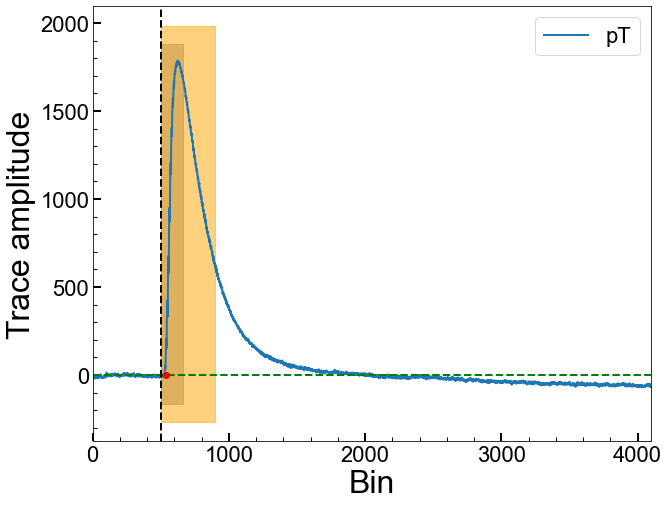

Series Number: 72209162200
Event Number: 3590602
Energy: 37.46337534073 keV
Area: 125506.36499990991


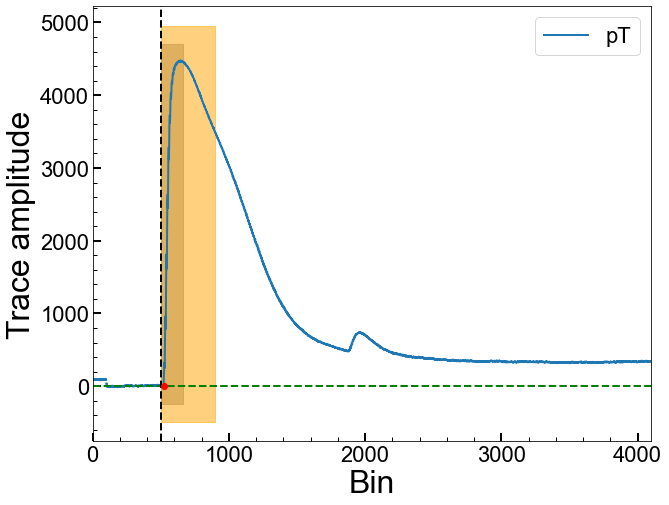

Series Number: 72209162200
Event Number: 3610314
Energy: 8.936710976428 keV
Area: 380461.3087149779


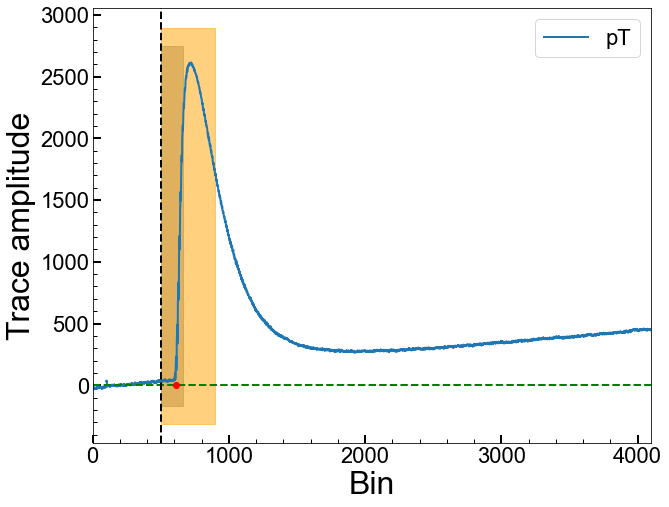

Series Number: 72209162200
Event Number: 3610635
Energy: 11.7178139004 keV
Area: 396935.9096875861


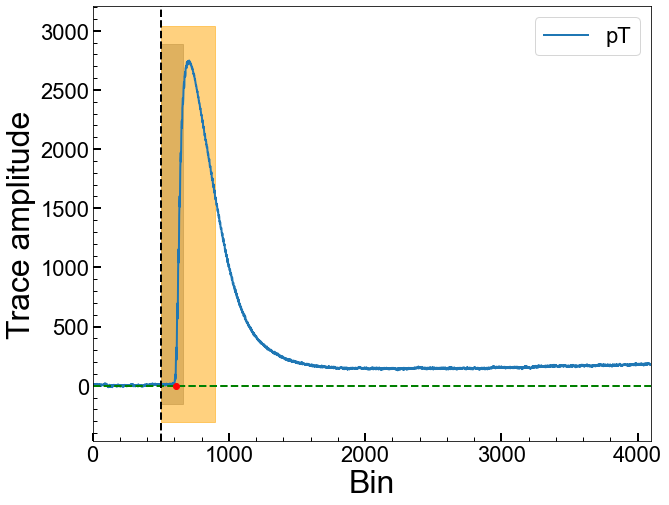

Series Number: 72209162200
Event Number: 3620570
Energy: 2.449876840887 keV
Area: -444045.3264447841


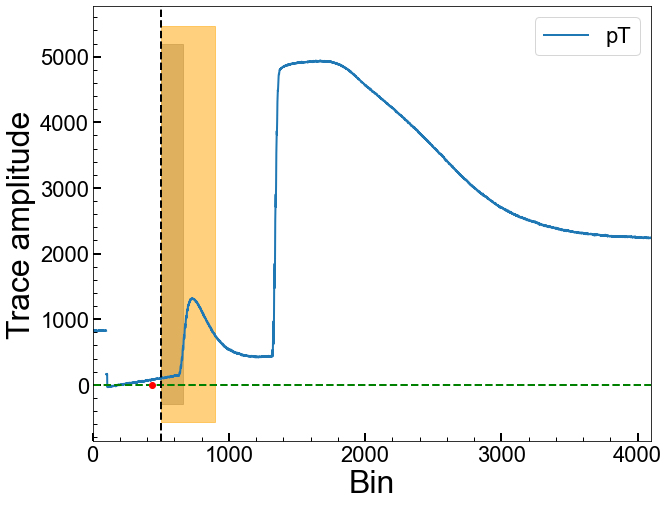

Series Number: 72209162200
Event Number: 3630264
Energy: 15.82904933312 keV
Area: 119769.76927011024


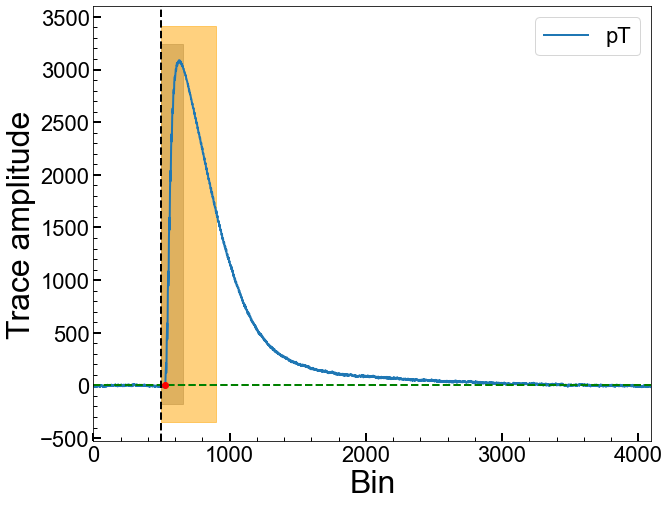

Series Number: 72209162200
Event Number: 3630788
Energy: 25.69662082961 keV
Area: 562396.6263461725


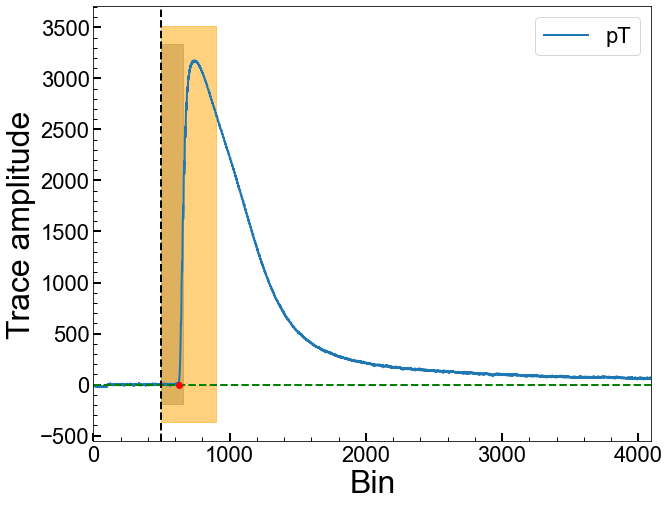

Series Number: 72209162200
Event Number: 3660395
Energy: 28.74234195264 keV
Area: 550594.712209332


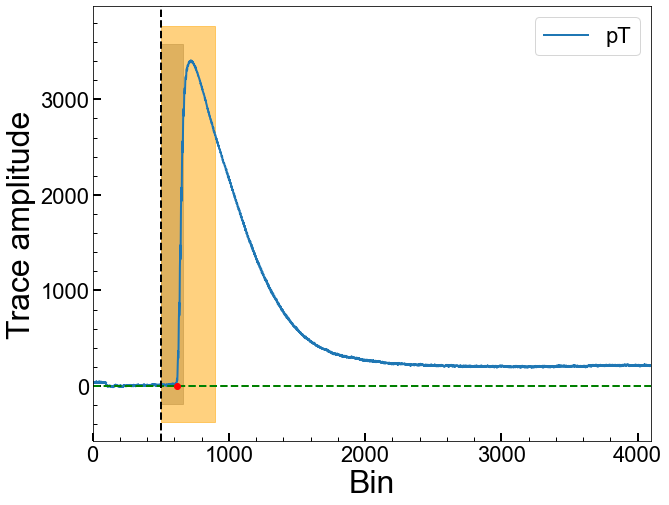

Series Number: 72209162200
Event Number: 3660481
Energy: 14.18509209388 keV
Area: 328706.15681543853


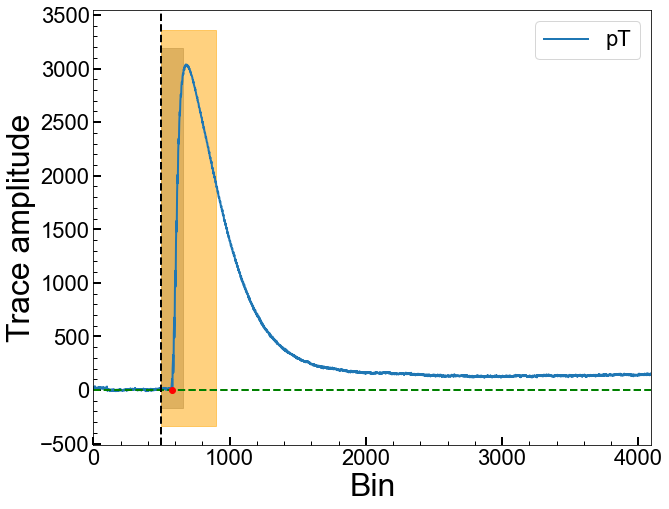

Series Number: 72209162200
Event Number: 3680615
Energy: 19.93241059032 keV
Area: 524994.0768007897


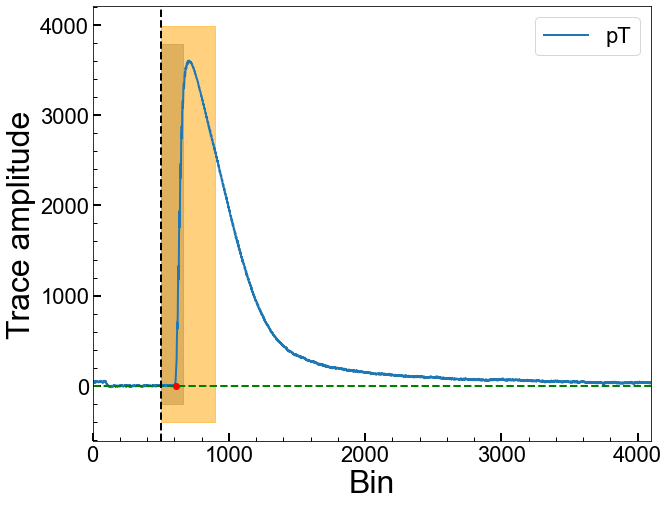

Series Number: 72209162200
Event Number: 3710851
Energy: 33.31666486587 keV
Area: -734369.550964801


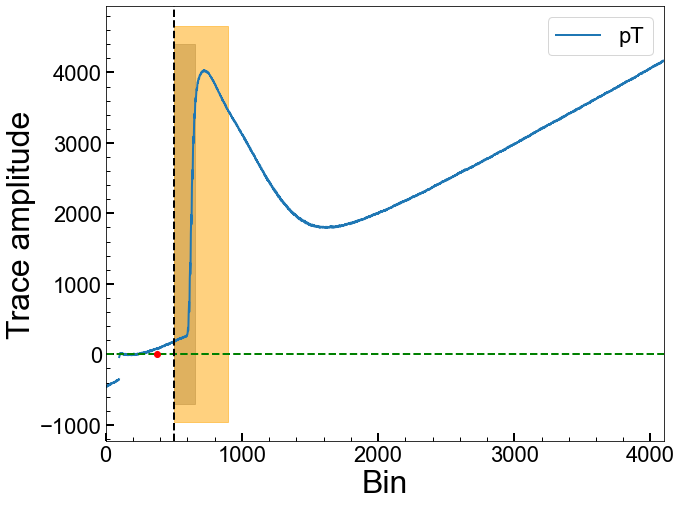

Series Number: 72209162200
Event Number: 3720472
Energy: 48.51205862745 keV
Area: 401005.3846202208


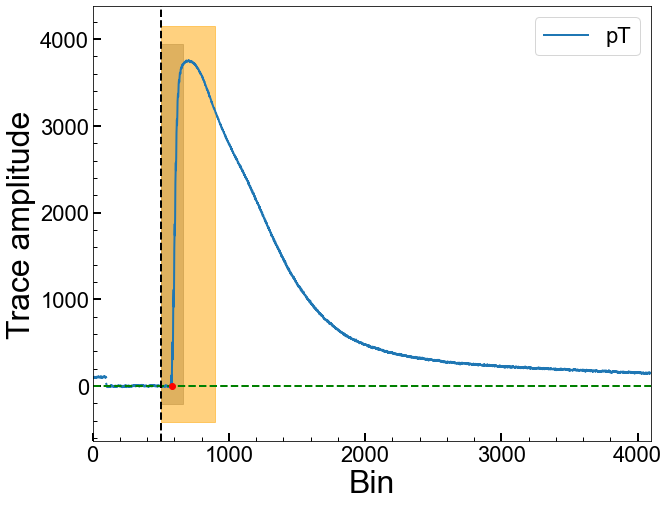

Series Number: 72209162200
Event Number: 3740624
Energy: 48.40378333037 keV
Area: 329746.0608465164


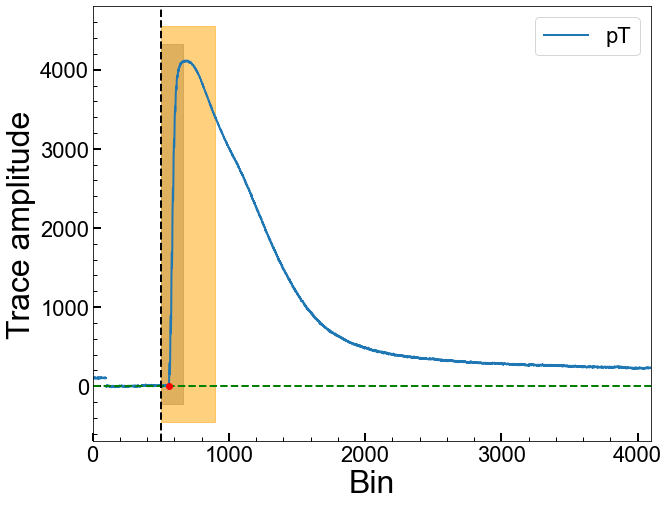

Series Number: 72209162200
Event Number: 3780475
Energy: 27.37329760332 keV
Area: 348230.8534265217


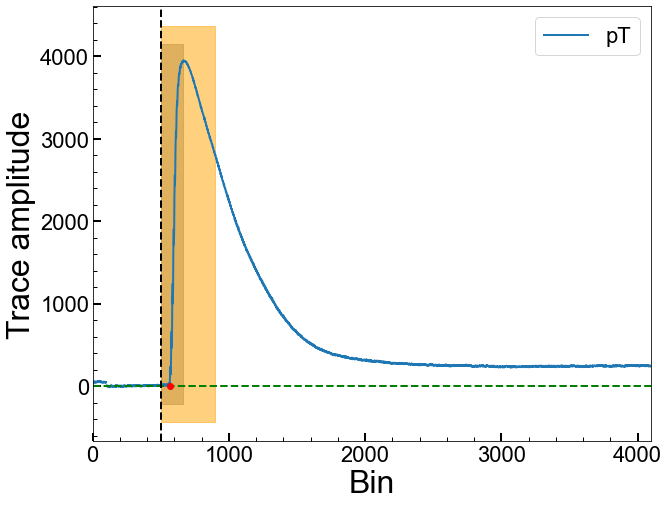

Series Number: 72209162200
Event Number: 3790334
Energy: 16.93273612912 keV
Area: 28336.46126686093


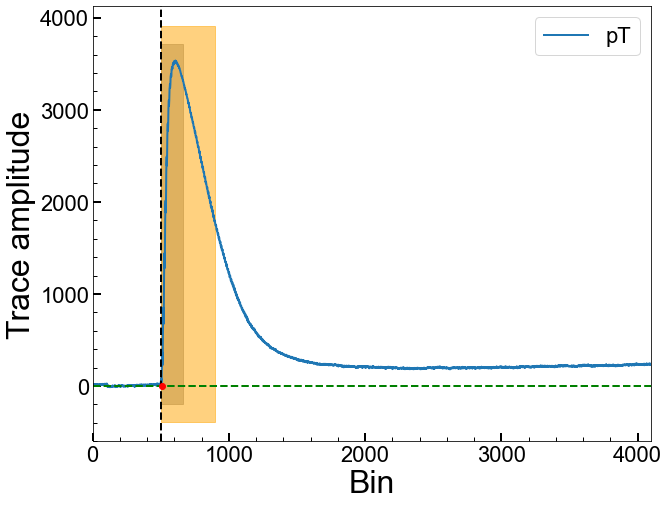

Series Number: 72209162200
Event Number: 3840243
Energy: 4.967296118618 keV
Area: 224882.765020821


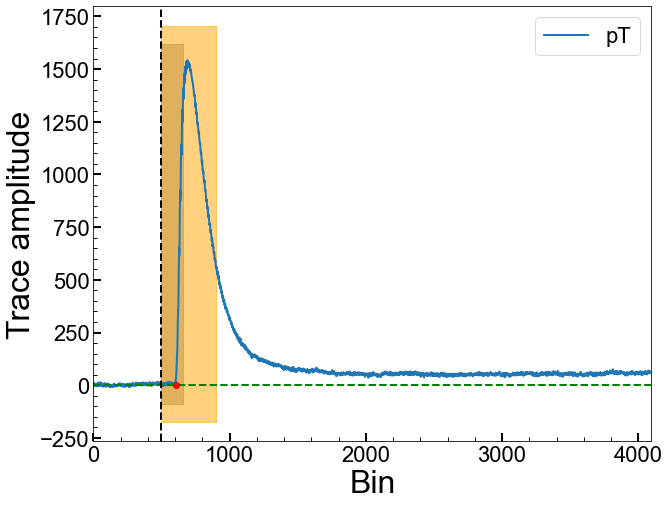

Series Number: 72209162200
Event Number: 3840420
Energy: 31.87000761702 keV
Area: 436382.3582549403


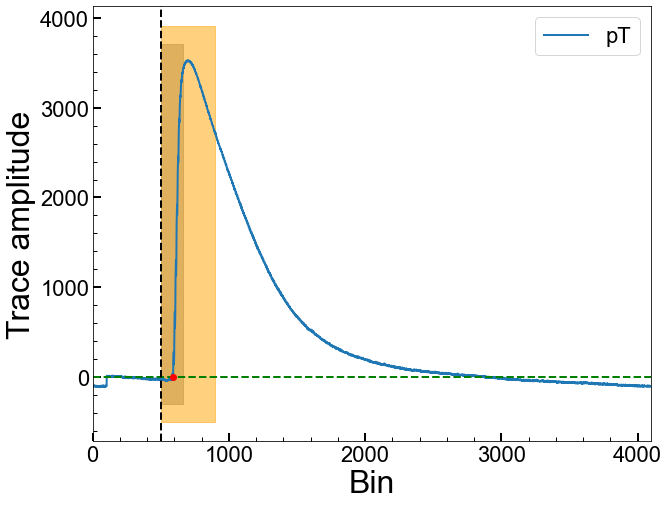

Series Number: 72209162200
Event Number: 3850703
Energy: 17.61200436892 keV
Area: 283872.4861218236


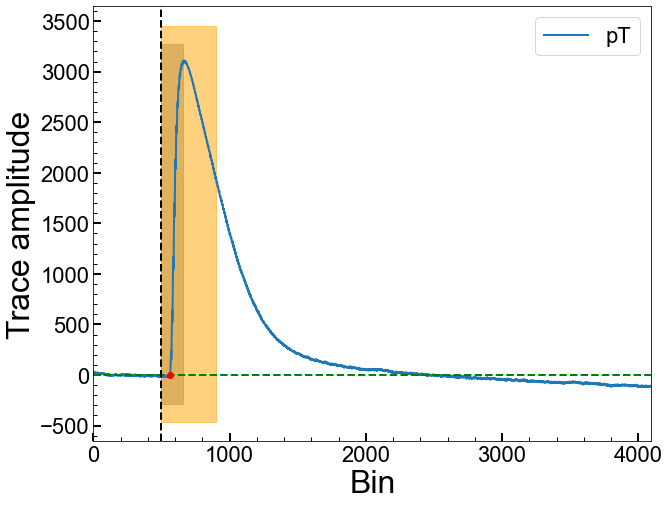

Series Number: 72209162200
Event Number: 3880525
Energy: 13.63829605471 keV
Area: 178987.41987483978


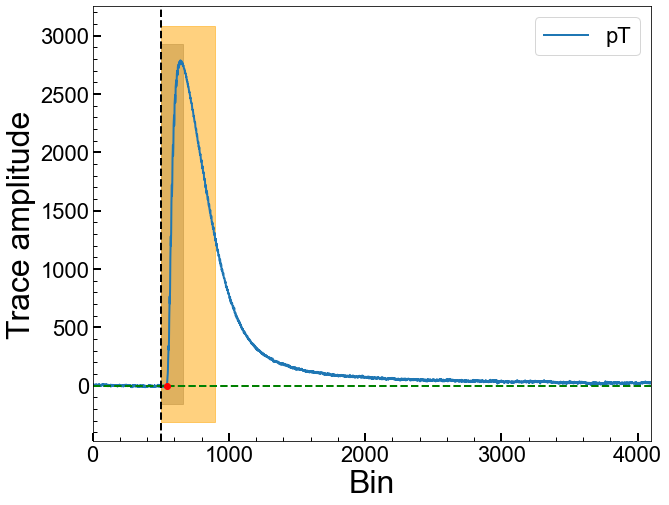

Series Number: 72209162200
Event Number: 3890159
Energy: 27.54295808005 keV
Area: 565205.15141979


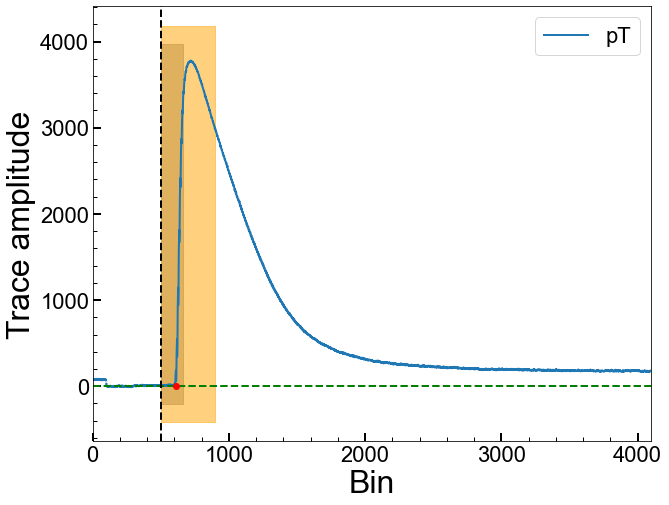

Series Number: 72209162200
Event Number: 3900223
Energy: 45.95803377221 keV
Area: -82652.25188800349


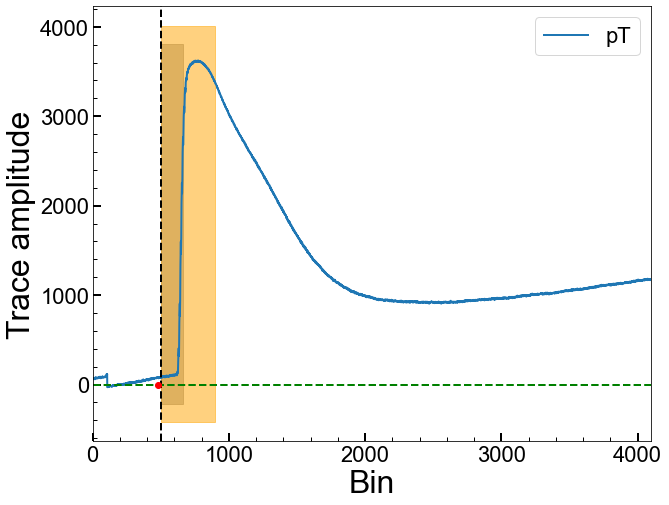

Series Number: 72209162200
Event Number: 3940640
Energy: 10.51791152479 keV
Area: 211488.49505642374


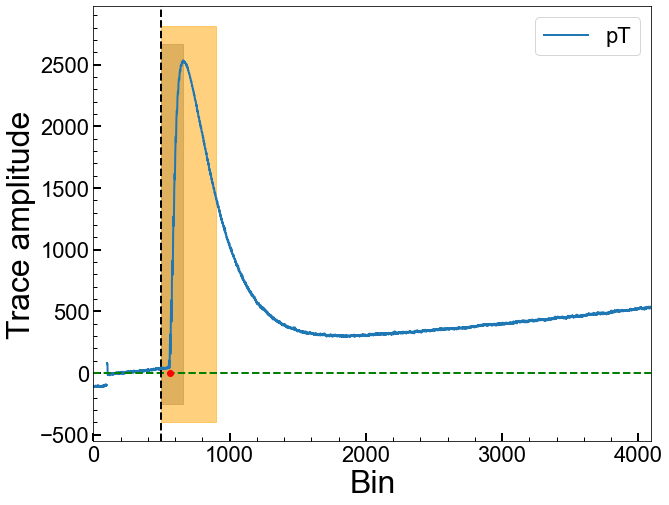

Series Number: 72209162200
Event Number: 3950768
Energy: 19.49171851402 keV
Area: 85837.91727483954


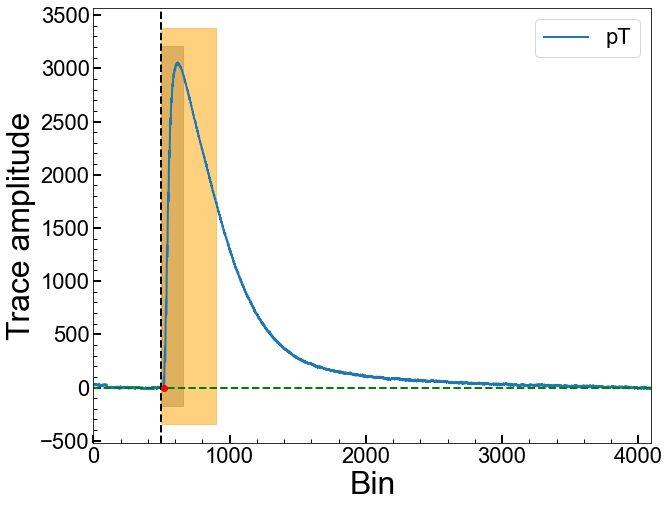

Series Number: 72209162200
Event Number: 3960091
Energy: 17.60991019162 keV
Area: -594716.003012112


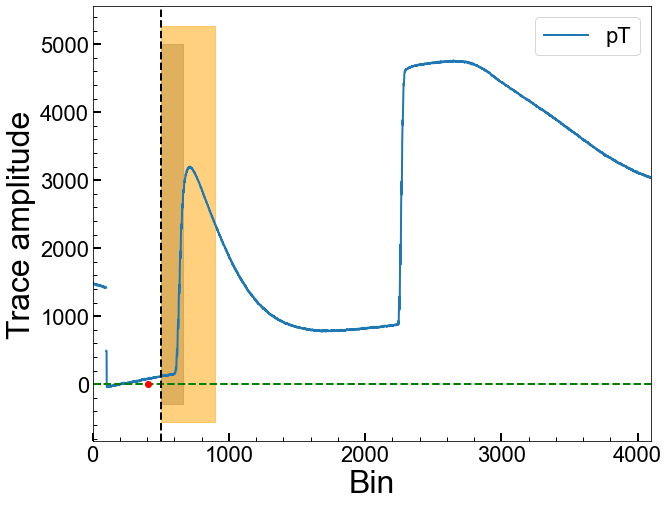

Series Number: 72209162200
Event Number: 3970008
Energy: 47.59264196986 keV
Area: 459213.81780845555


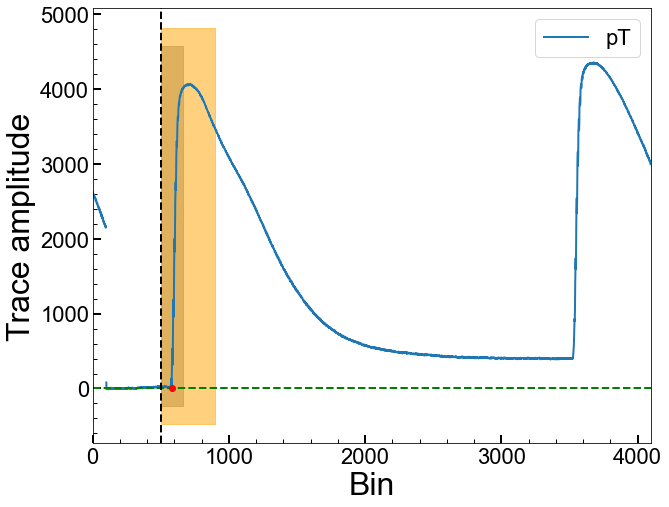

Series Number: 72209162200
Event Number: 4000494
Energy: 46.64699197751 keV
Area: 542604.9939300824


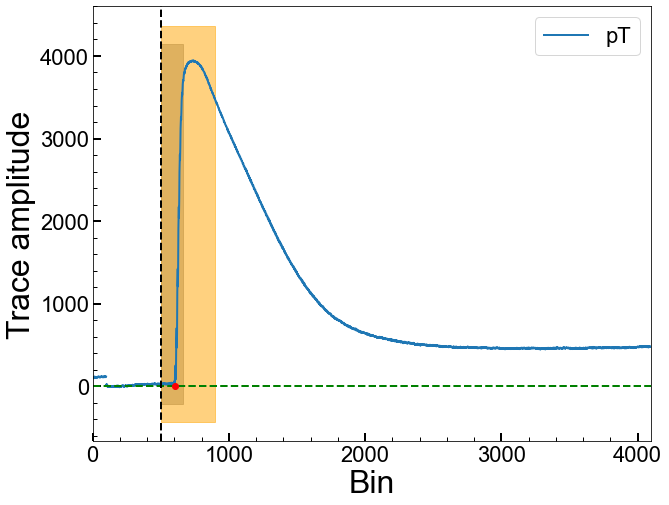

Series Number: 72209162200
Event Number: 4000707
Energy: 15.40081021165 keV
Area: 287206.98930437193


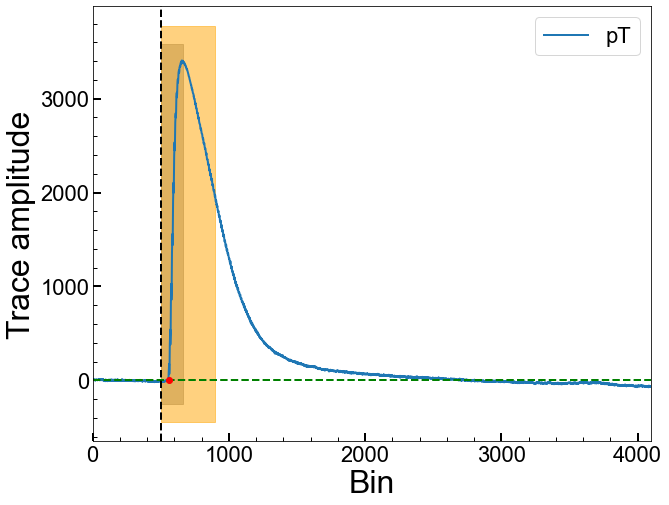

Series Number: 72209162200
Event Number: 4010128
Energy: 9.670031121003 keV
Area: 272734.302357899


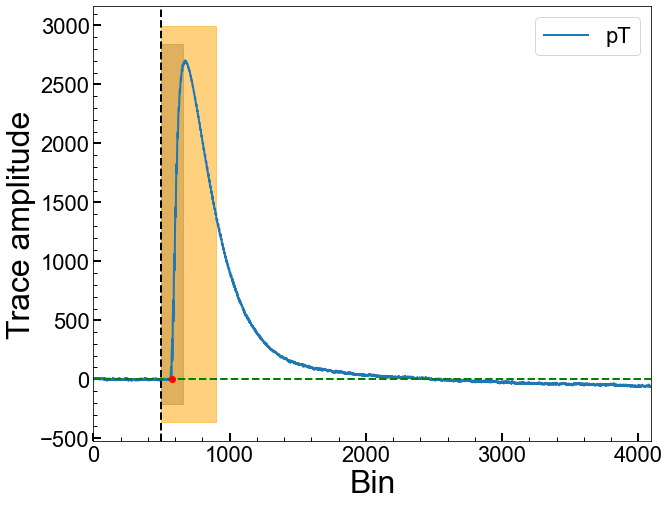

Series Number: 72209162200
Event Number: 4010538
Energy: 3.999107928438 keV
Area: -2932309.883448582


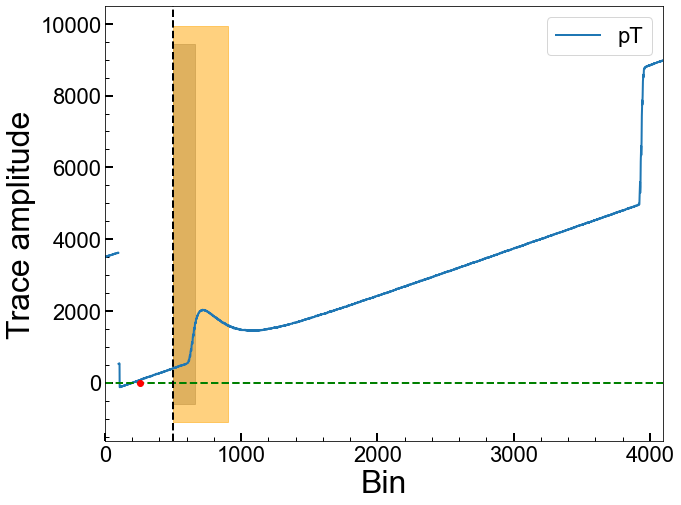

Series Number: 72209162200
Event Number: 4050024
Energy: 20.32135909624 keV
Area: 566600.6563268307


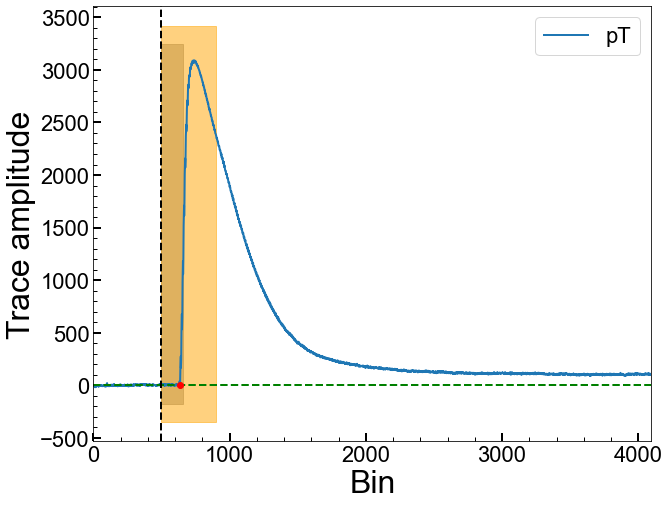

Series Number: 72209162200
Event Number: 4050050
Energy: 11.85762850587 keV
Area: 284738.479683179


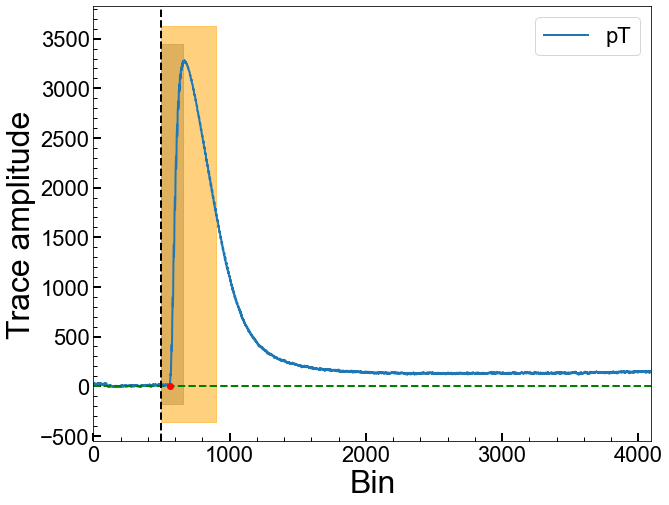

Series Number: 72209162200
Event Number: 4070234
Energy: 8.176398426947 keV
Area: 340045.43572686386


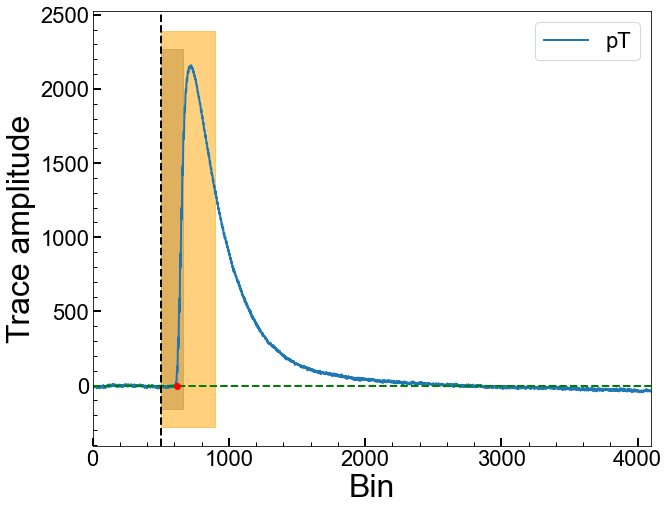

Series Number: 72209162200
Event Number: 4090471
Energy: 31.69851477694 keV
Area: 554337.7489237834


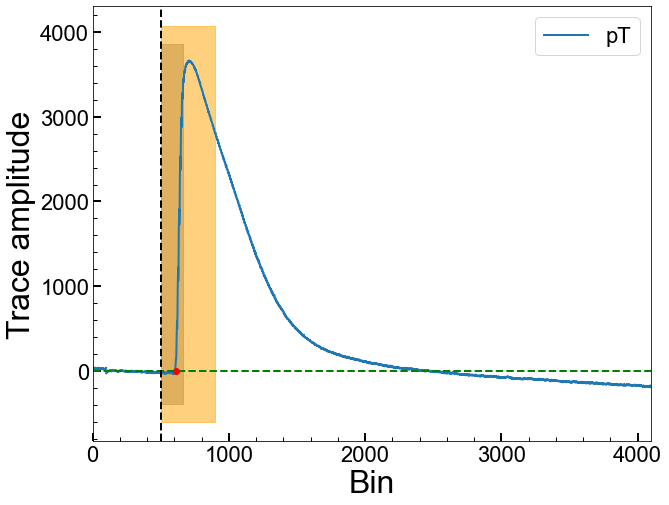

Series Number: 72209162200
Event Number: 4090774
Energy: 7.179326082704 keV
Area: 64646.04127438414


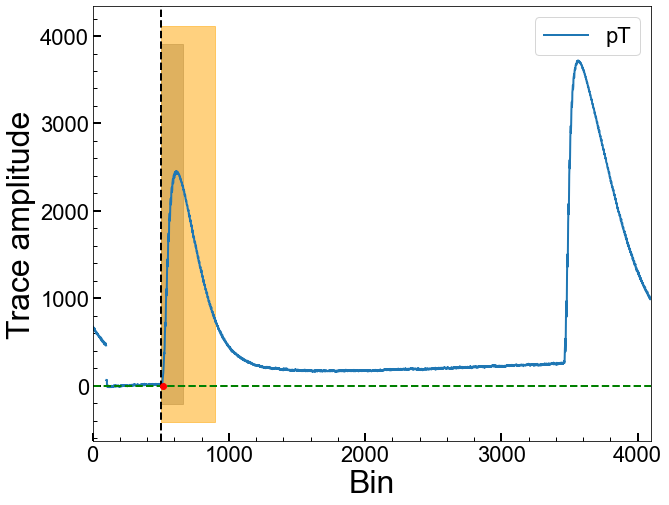

Series Number: 72209162200
Event Number: 4100643
Energy: 30.45051809168 keV
Area: 268963.4754682065


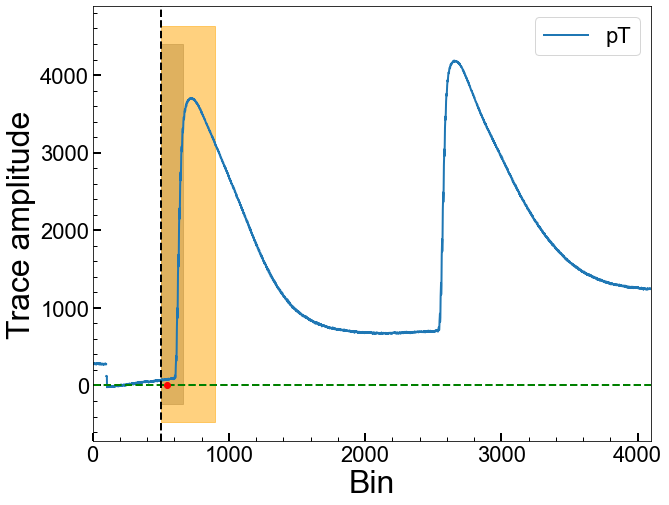

Series Number: 72209162200
Event Number: 4110128
Energy: 22.76134465948 keV
Area: 393651.8017308273


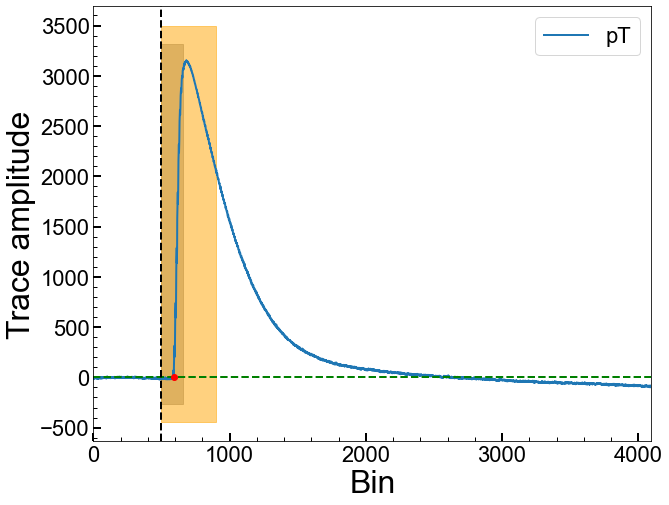

Series Number: 72209162200
Event Number: 4130213
Energy: 19.23441934712 keV
Area: 457324.449536572


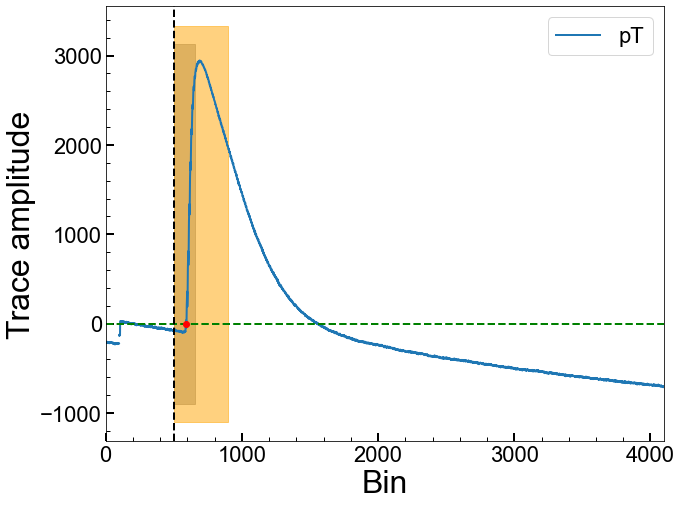

Series Number: 72209162200
Event Number: 4130230
Energy: 20.15231847271 keV
Area: 97579.74625673468


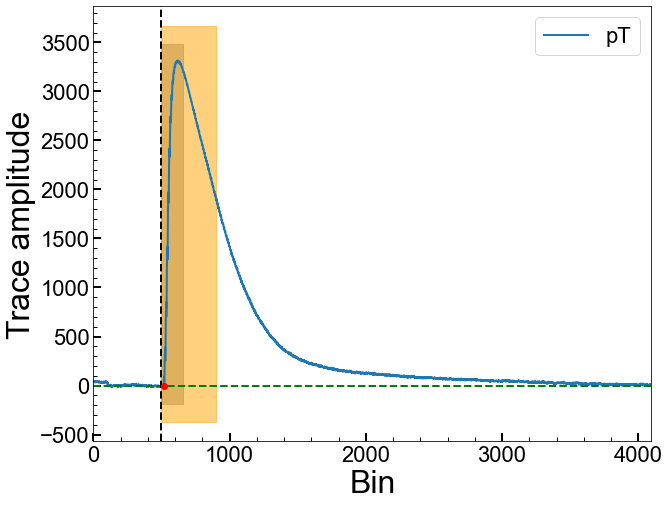

Series Number: 72209162200
Event Number: 4130886
Energy: 25.8048918887 keV
Area: 299700.98973194713


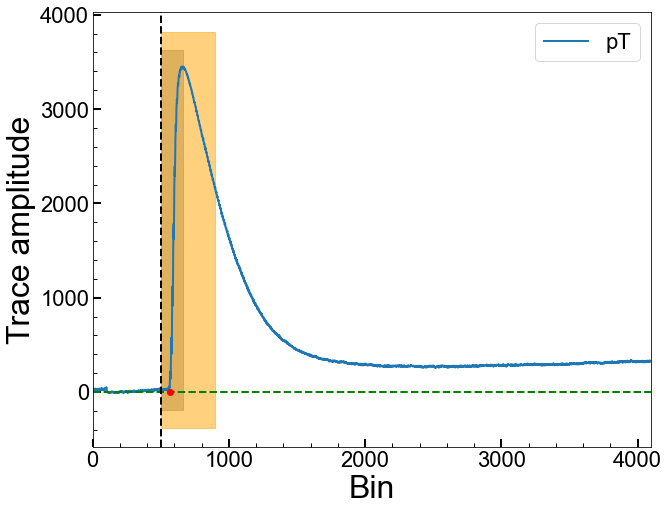

Series Number: 72209162200
Event Number: 4140736
Energy: 22.21123593823 keV
Area: 44565.51712644596


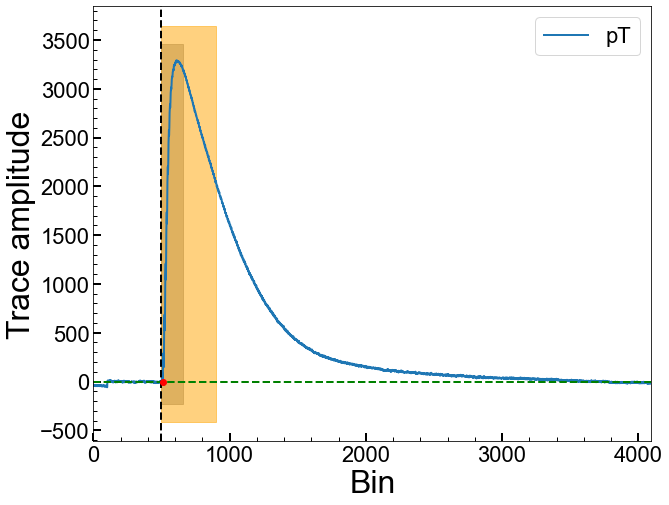

Series Number: 72209162200
Event Number: 4160243
Energy: 23.5702665941 keV
Area: 520469.3007477336


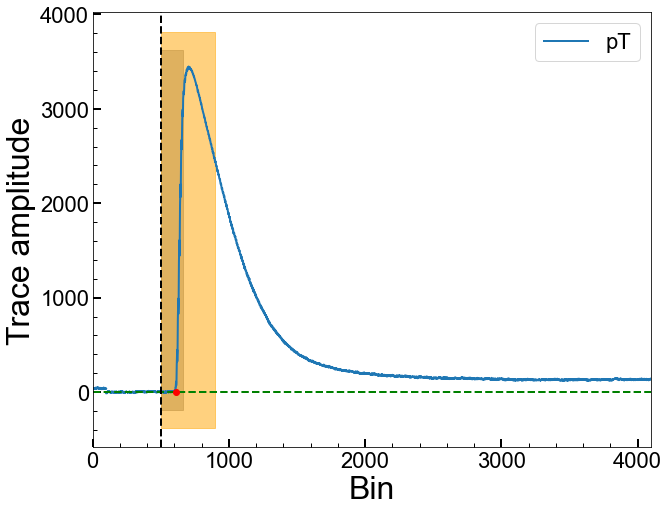

Series Number: 72209162200
Event Number: 4160469
Energy: 30.54415350577 keV
Area: 560397.2797056215


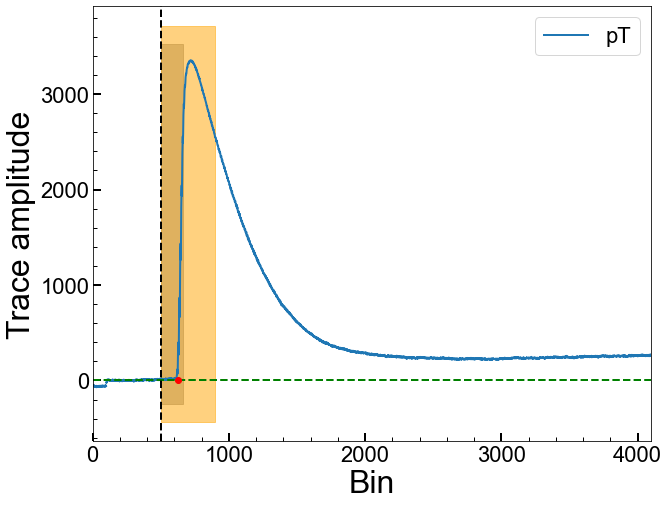

Series Number: 72209162200
Event Number: 4200383
Energy: 6.862210283545 keV
Area: 64601.16215450071


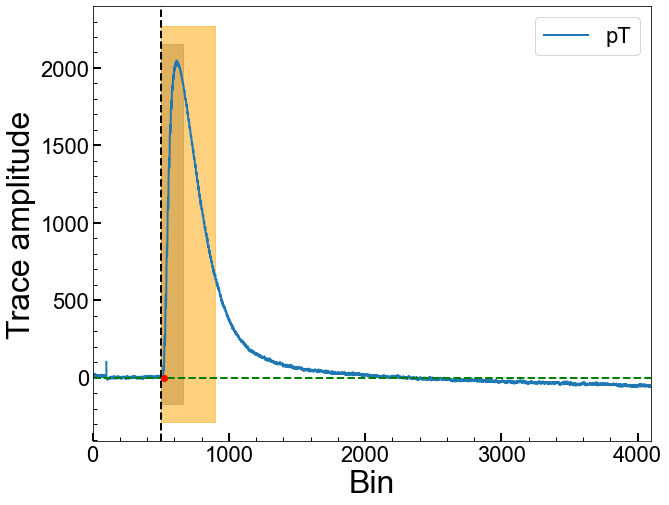

Series Number: 72209162200
Event Number: 4200734
Energy: 20.41306385291 keV
Area: 547892.5860040653


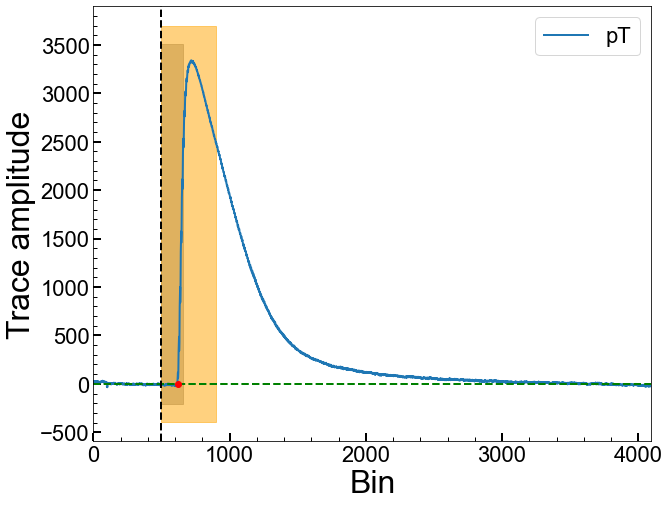

Series Number: 72209162200
Event Number: 4210052
Energy: 42.58446815603 keV
Area: 259973.69211865438


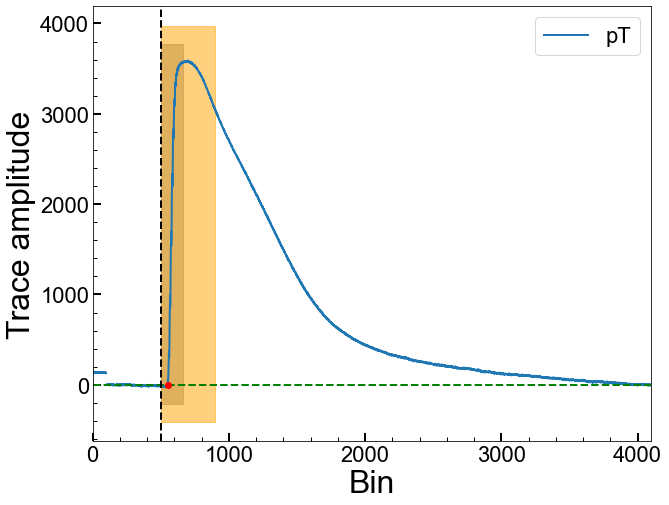

Series Number: 72209162200
Event Number: 4210783
Energy: 21.70599619033 keV
Area: -110411.11674338541


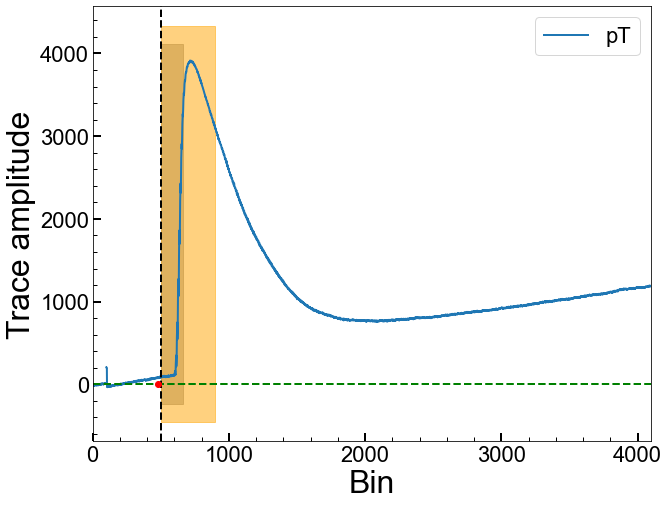

Series Number: 72209162200
Event Number: 4240629
Energy: 7.122817944686 keV
Area: 54683.18182770861


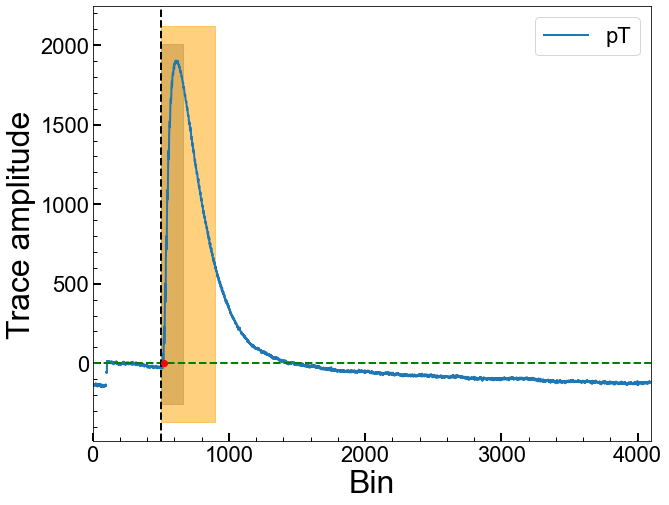

Series Number: 72209162200
Event Number: 4260281
Energy: 12.81025954285 keV
Area: 332918.0689839747


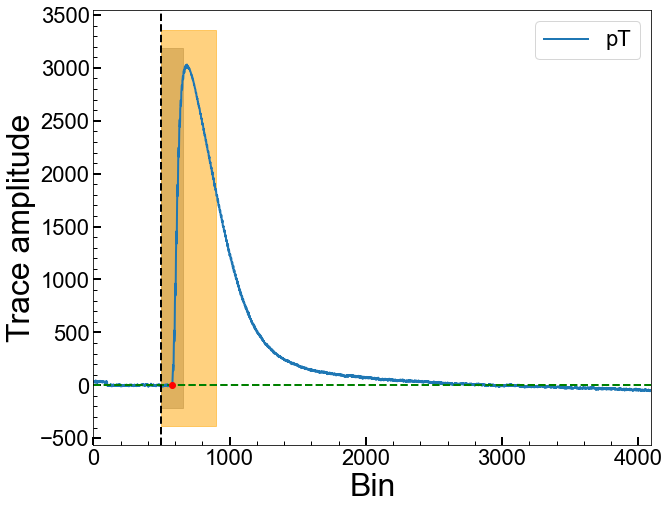

Series Number: 72209162200
Event Number: 4260811
Energy: 6.707621173872 keV
Area: 36938.69494532449


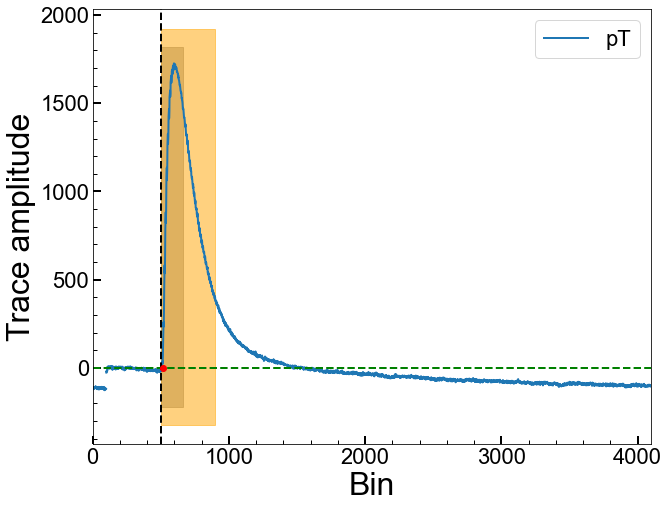

Series Number: 72209162200
Event Number: 4270194
Energy: 15.09114911177 keV
Area: 240060.42637862786


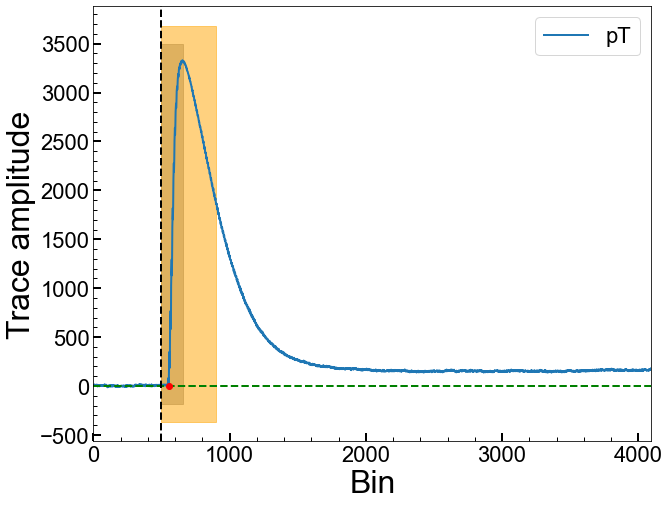

Series Number: 72209162200
Event Number: 4280711
Energy: 13.35888776314 keV
Area: -1558800.9122181663


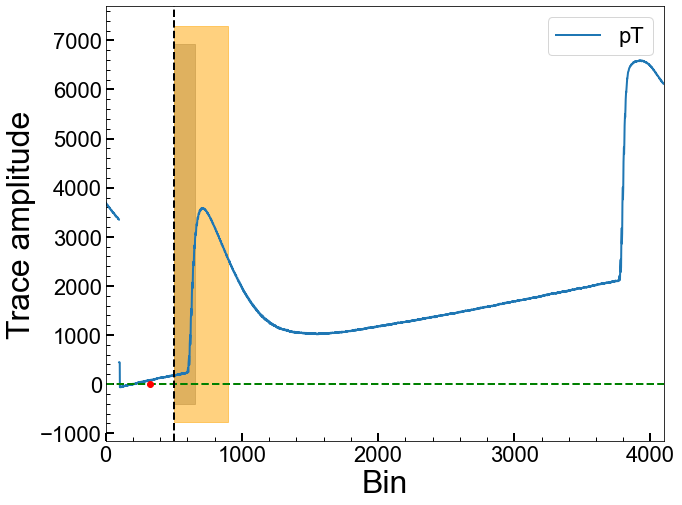

Series Number: 72209162200
Event Number: 4310219
Energy: 20.30348618221 keV
Area: 603386.3967669006


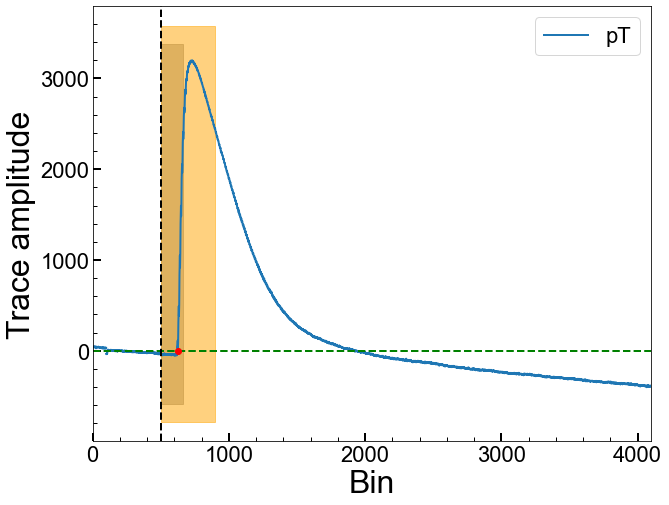

Series Number: 72209162200
Event Number: 4330193
Energy: 10.44055088722 keV
Area: 67620.85534130868


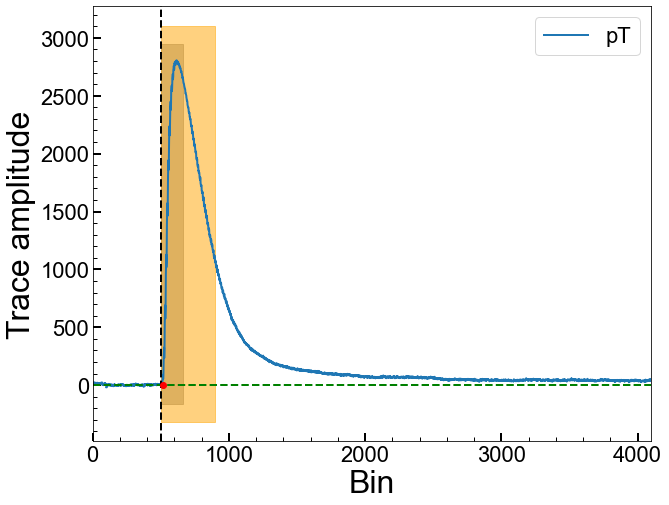

Series Number: 72209162200
Event Number: 4340723
Energy: 5.980723621502 keV
Area: 48652.079927170045


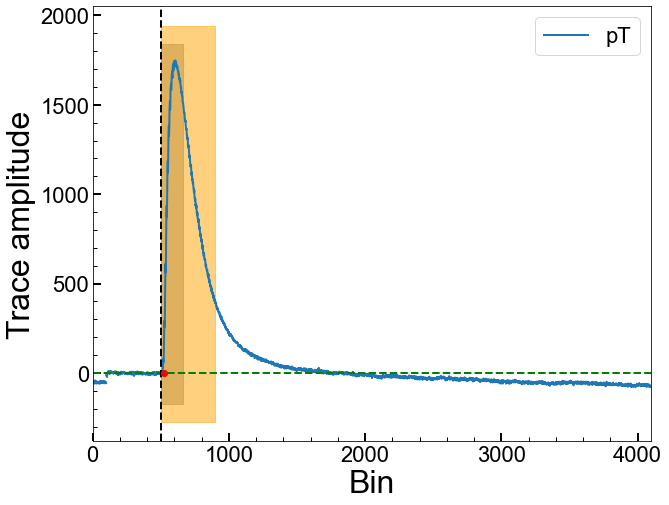

Series Number: 72209162200
Event Number: 4350081
Energy: 14.42246910536 keV
Area: 418518.9055277564


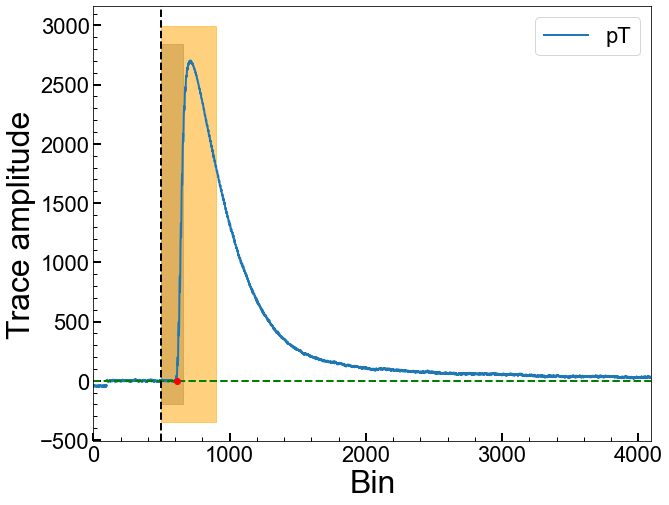

Series Number: 72209162200
Event Number: 4370422
Energy: 7.343015971854 keV
Area: 120738.4927069403


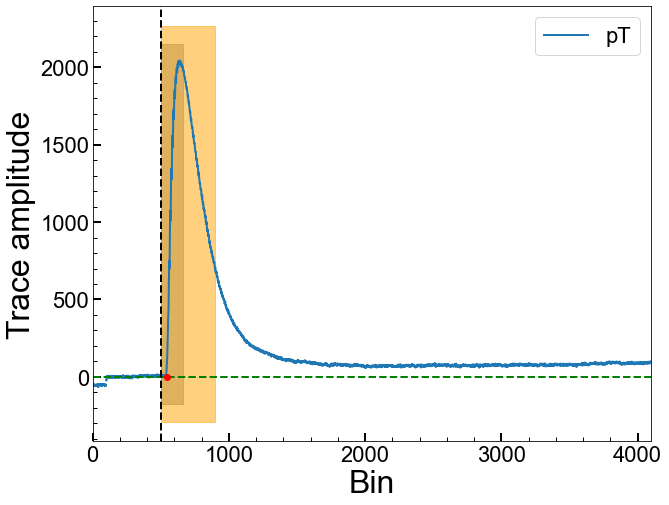

Series Number: 72209162200
Event Number: 4370633
Energy: 26.76282545782 keV
Area: 566229.6117750109


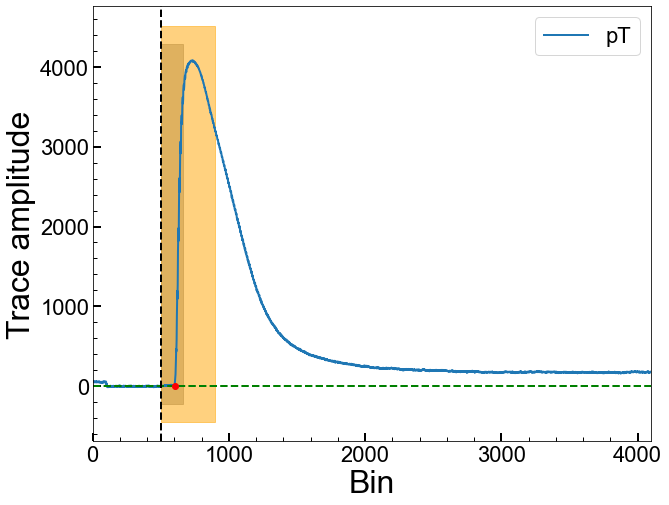

Series Number: 72209162200
Event Number: 4380331
Energy: 5.949819236149 keV
Area: 186626.39830637726


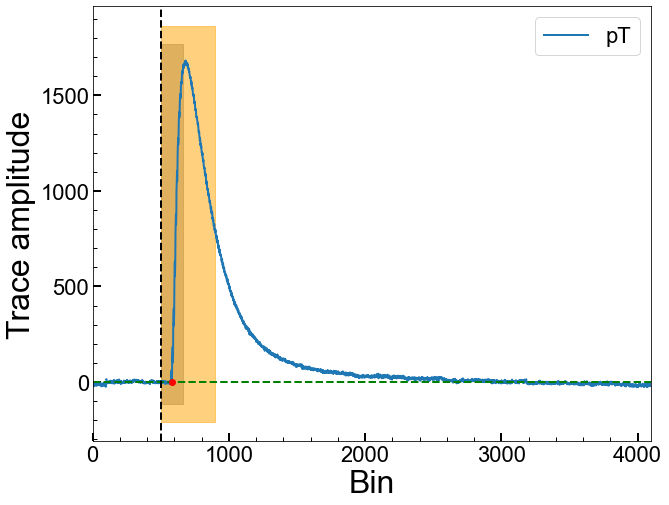

Series Number: 72209162200
Event Number: 4390531
Energy: 30.91563502985 keV
Area: 589912.9244022957


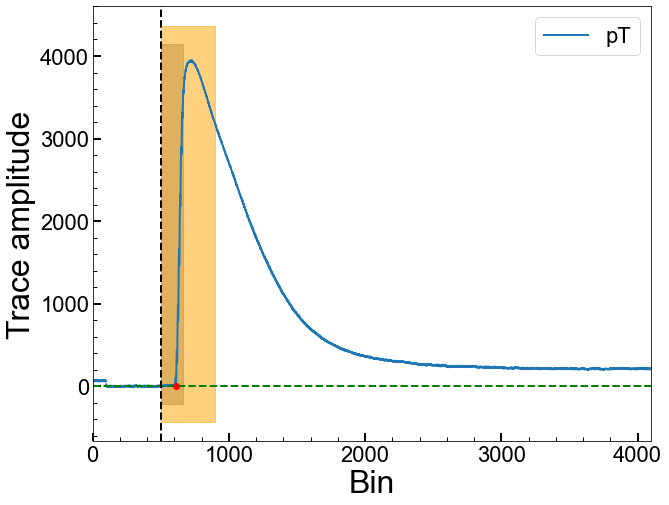

Series Number: 72209162200
Event Number: 4400504
Energy: 46.83298638057 keV
Area: 193947.7992259002


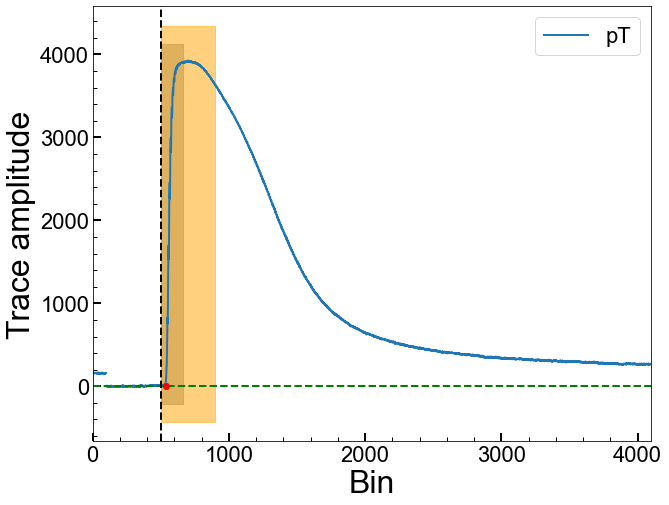

Series Number: 72209162200
Event Number: 4410330
Energy: 47.37350574192 keV
Area: 560248.0156467286


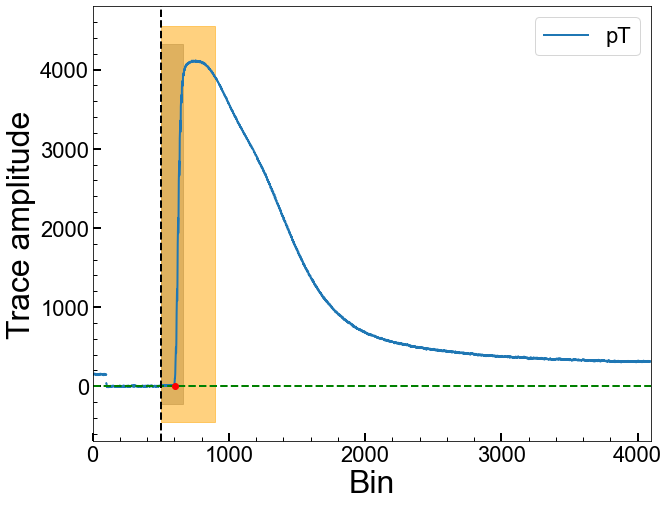

Series Number: 72209162200
Event Number: 4410488
Energy: 25.47711580479 keV
Area: 571647.1173680038


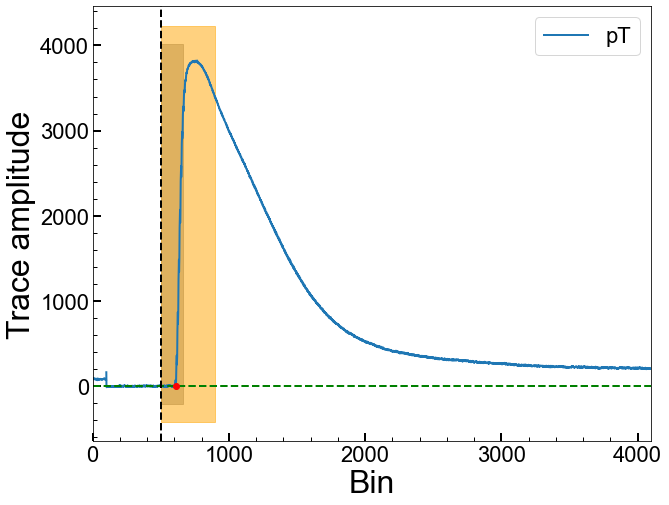

Series Number: 72209162200
Event Number: 4440830
Energy: 47.36471308488 keV
Area: 806595.0146391101


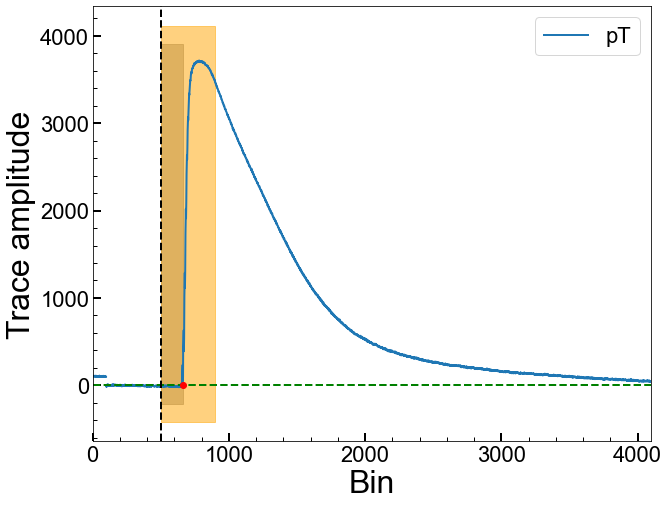

Series Number: 72209162200
Event Number: 4450526
Energy: 33.3956295885 keV
Area: 521370.7695854838


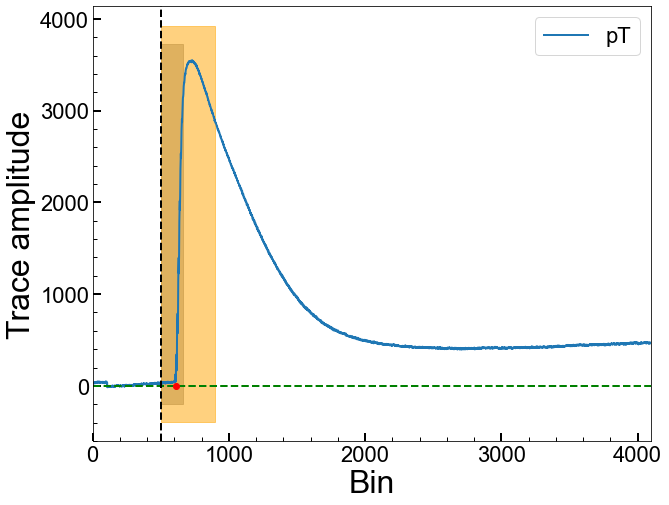

Series Number: 72209162200
Event Number: 4450764
Energy: 7.672143455226 keV
Area: 126922.40464546751


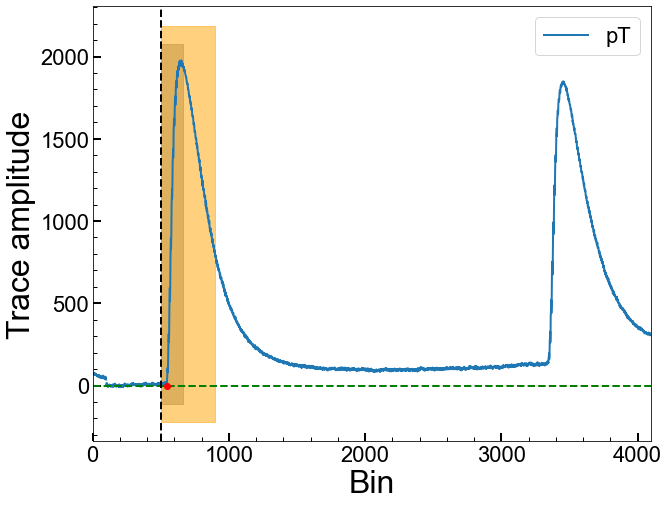

Series Number: 72209162200
Event Number: 4460275
Energy: 40.24675471532 keV
Area: 661664.9405005976


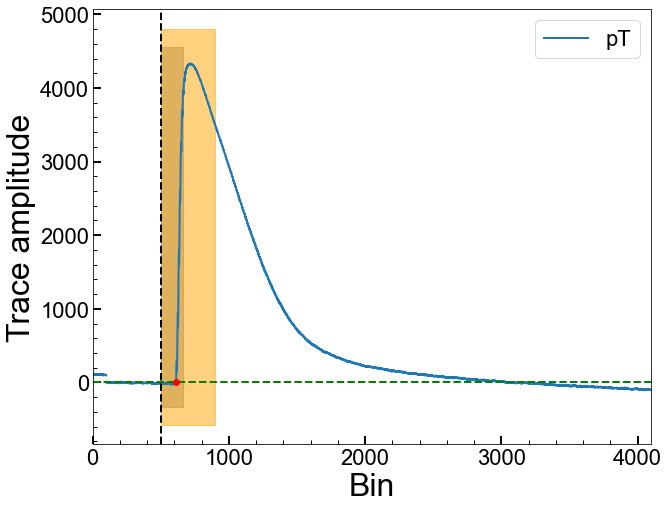

Series Number: 72209162200
Event Number: 4470231
Energy: 9.020209888665 keV
Area: 272112.0044389366


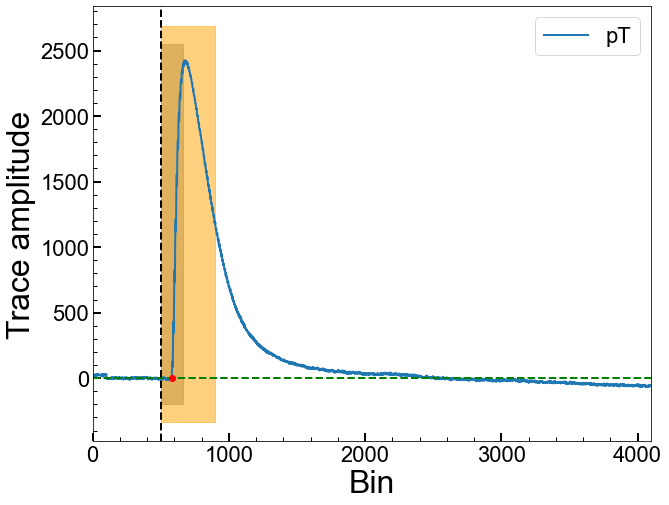

Series Number: 72209162200
Event Number: 4500856
Energy: 2.201223254445 keV
Area: -1417735.0340869431


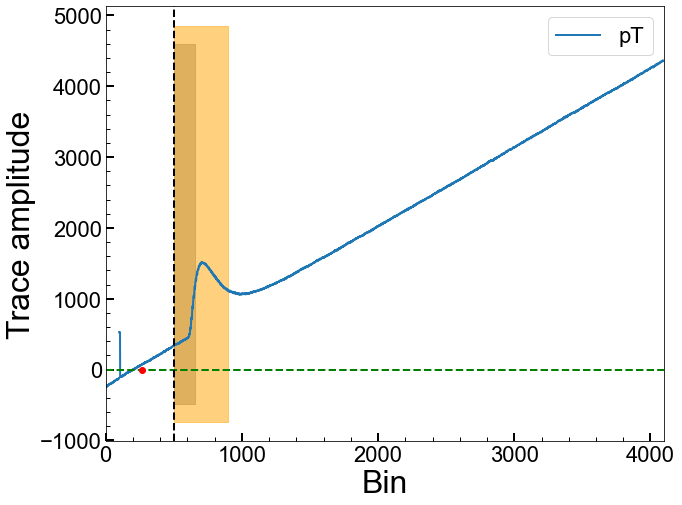

Series Number: 72209162200
Event Number: 4520043
Energy: 7.542917417246 keV
Area: -129472.02310076715


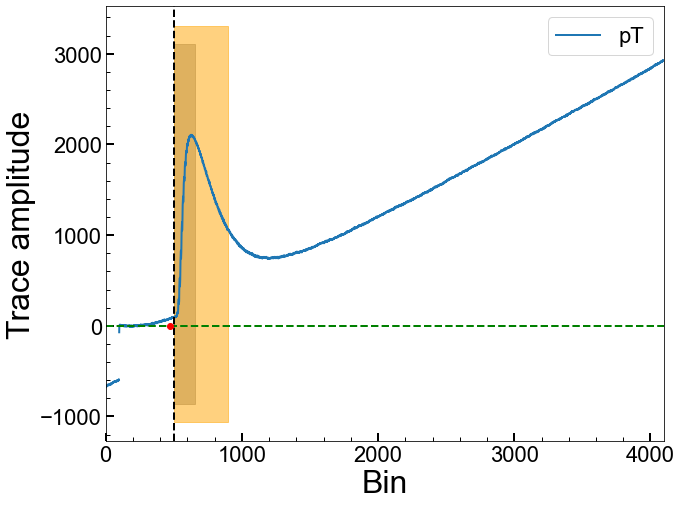

Series Number: 72209162200
Event Number: 4540360
Energy: 48.03140485235 keV
Area: 477273.6186543053


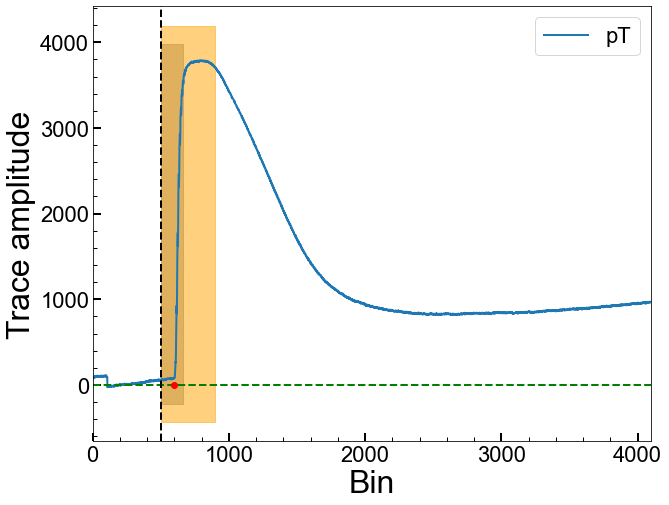

Series Number: 72209162200
Event Number: 4550260
Energy: 15.55692381236 keV
Area: 100087.43170805839


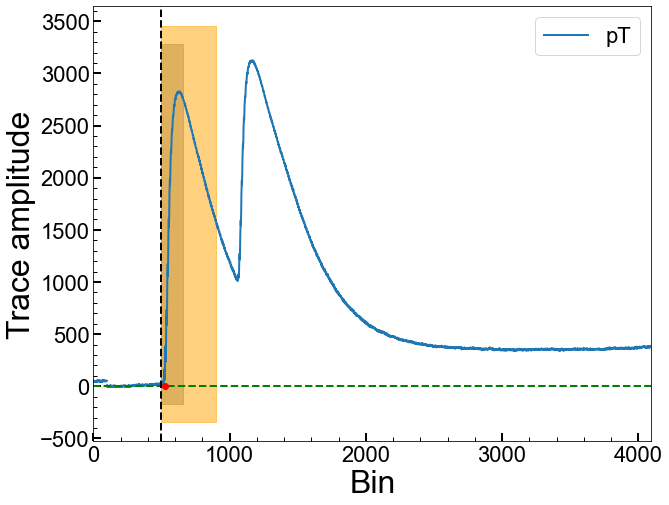

Series Number: 72209162200
Event Number: 4570724
Energy: 26.16305385866 keV
Area: -1108627.770380632


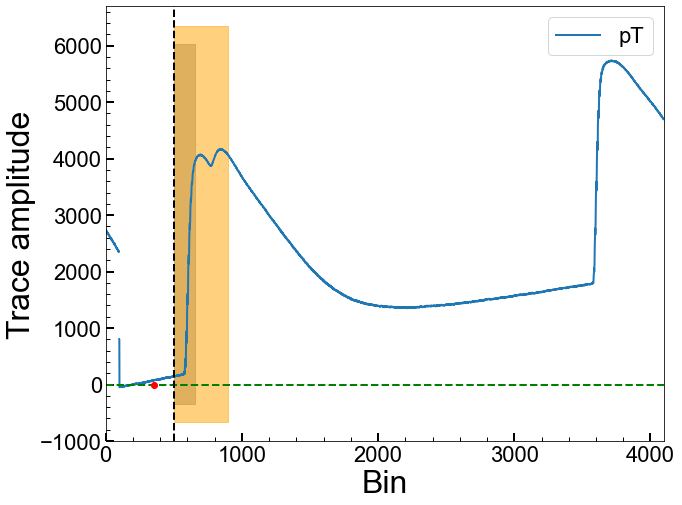

Series Number: 72209162200
Event Number: 4570762
Energy: 22.91606760785 keV
Area: 676863.6947284135


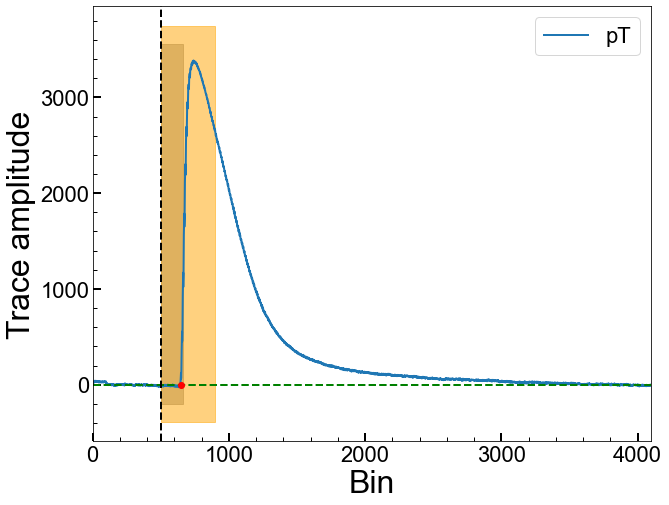

Series Number: 72209162200
Event Number: 4570777
Energy: 26.04332831994 keV
Area: 147298.98910908616


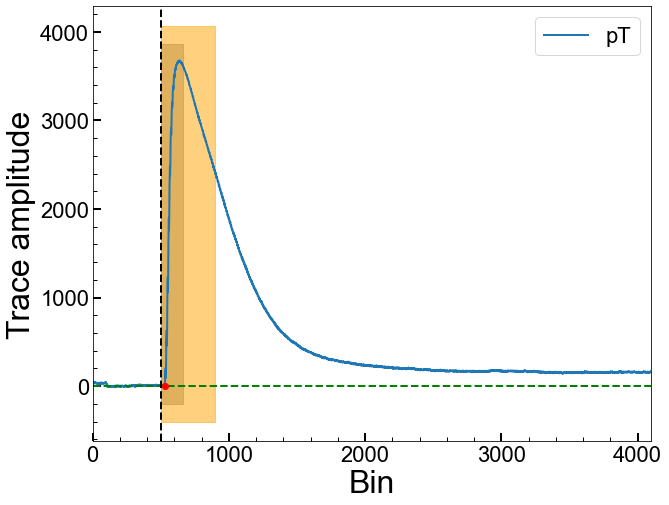

Series Number: 72209162200
Event Number: 4590025
Energy: 36.10054234161 keV
Area: 183974.8538996028


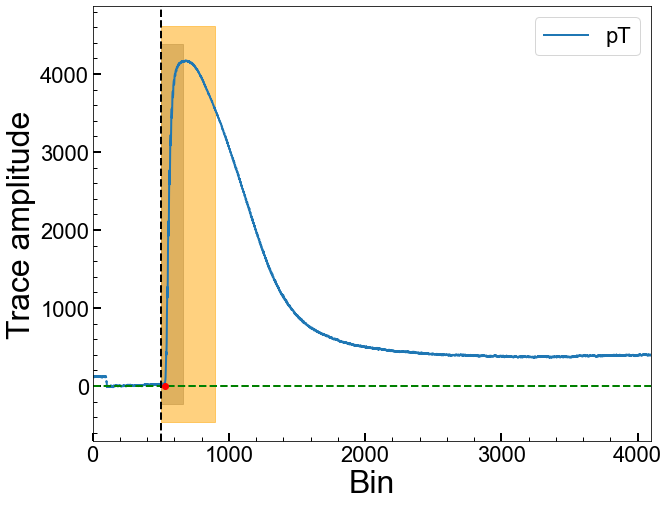

Series Number: 72209162200
Event Number: 4590145
Energy: 13.68655428733 keV
Area: 451143.0103809694


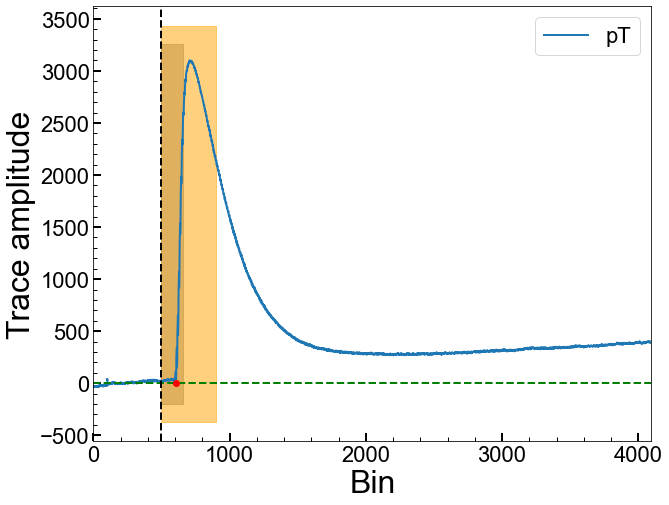

Series Number: 72209162200
Event Number: 4590916
Energy: 12.76370698041 keV
Area: -1727465.5864557382


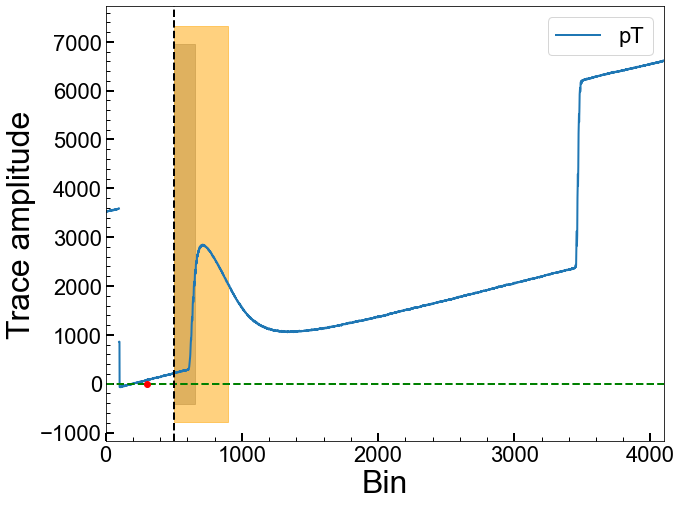

Series Number: 72209162200
Event Number: 4630374
Energy: 45.11111164114 keV
Area: -59803.08695761593


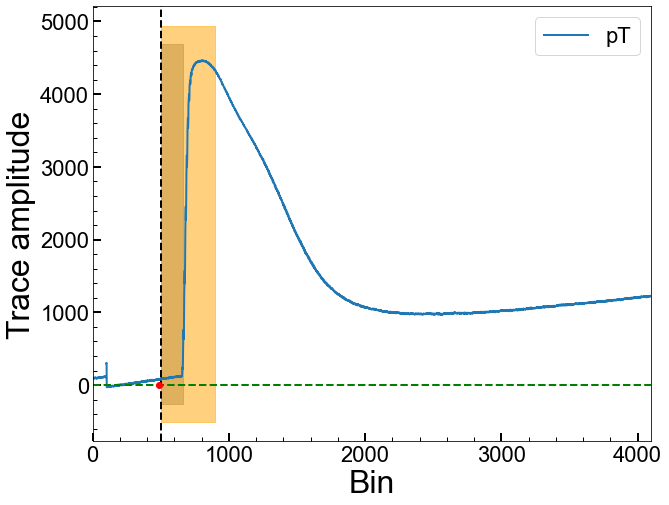

Series Number: 72209162200
Event Number: 4640701
Energy: 48.11499231188 keV
Area: 608945.9199071048


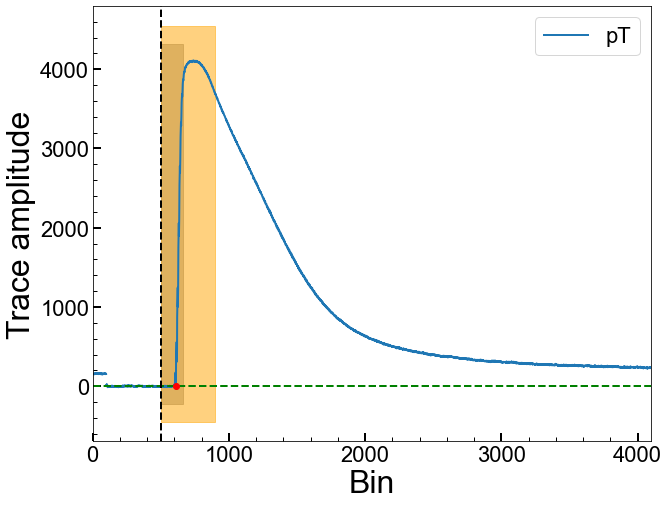

Series Number: 72209162200
Event Number: 4650446
Energy: 8.441939080995 keV
Area: 244451.07600209315


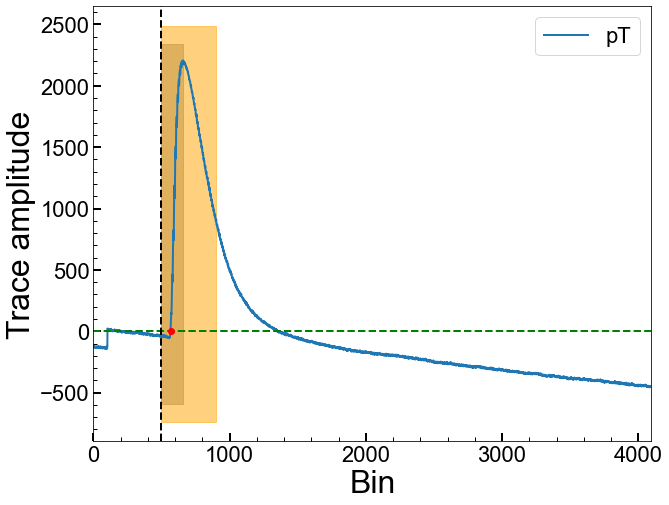

Series Number: 72209162200
Event Number: 4660023
Energy: 18.12112529567 keV
Area: 170266.42261421453


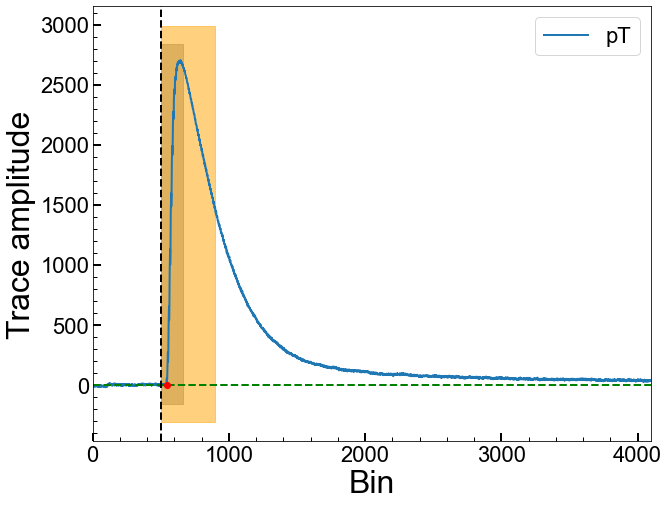

Series Number: 72209162200
Event Number: 4680682
Energy: 16.40039401264 keV
Area: 522464.86129796394


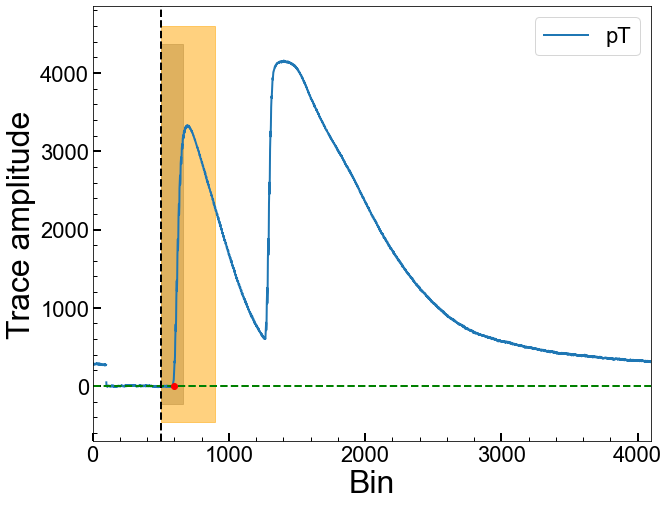

Series Number: 72209162200
Event Number: 4700329
Energy: 22.45969262795 keV
Area: 485055.68712406175


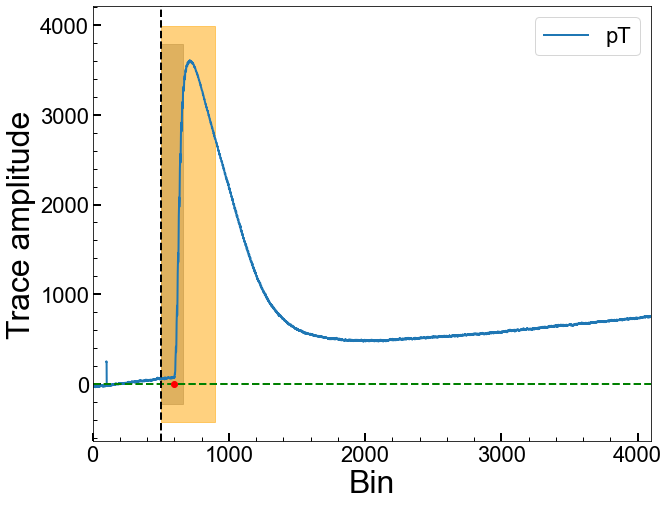

Series Number: 72209162200
Event Number: 4700787
Energy: 41.87724367402 keV
Area: 202120.8800070252


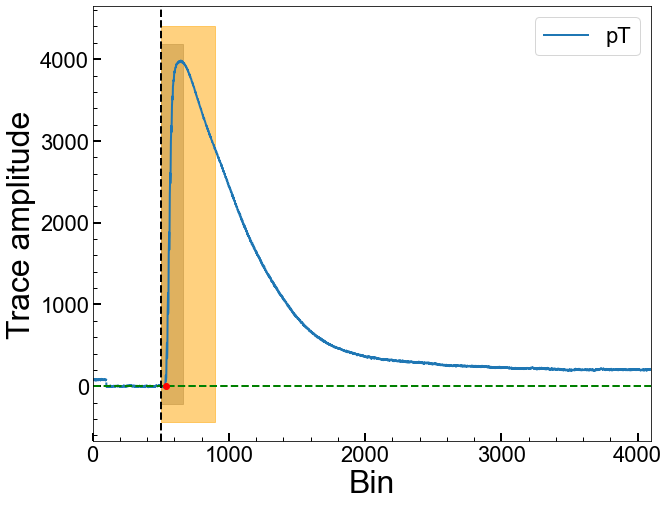

Series Number: 72209162200
Event Number: 4700888
Energy: 23.8639740261 keV
Area: 347919.41704860947


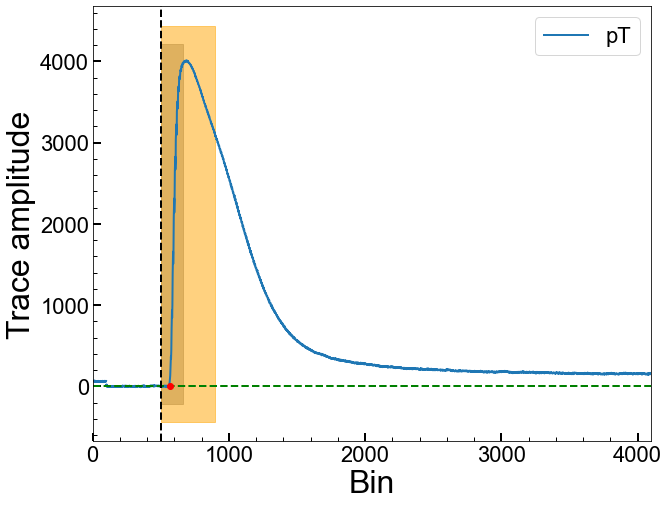

Series Number: 72209162200
Event Number: 4710122
Energy: 18.04883281041 keV
Area: 259299.2894034225


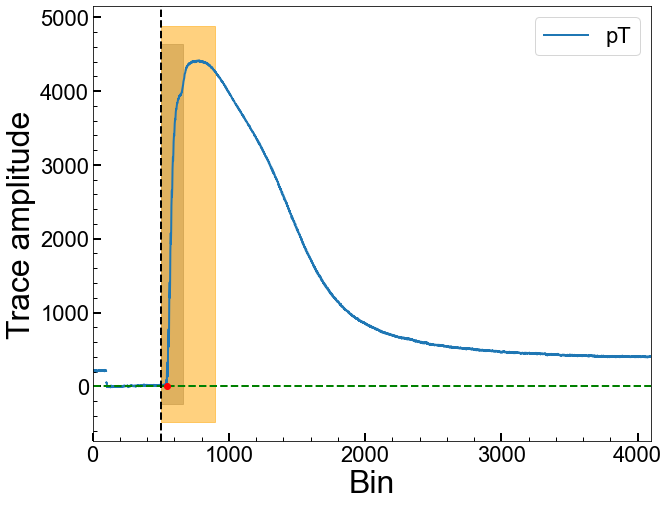

Series Number: 72209162200
Event Number: 4710317
Energy: 10.41653999765 keV
Area: 3839.736770908611


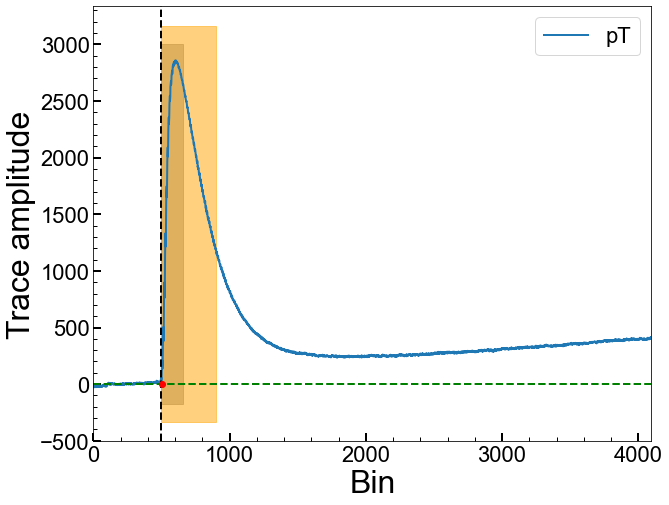

Series Number: 72209162200
Event Number: 4770218
Energy: 41.98196530883 keV
Area: -1527735.8169284735


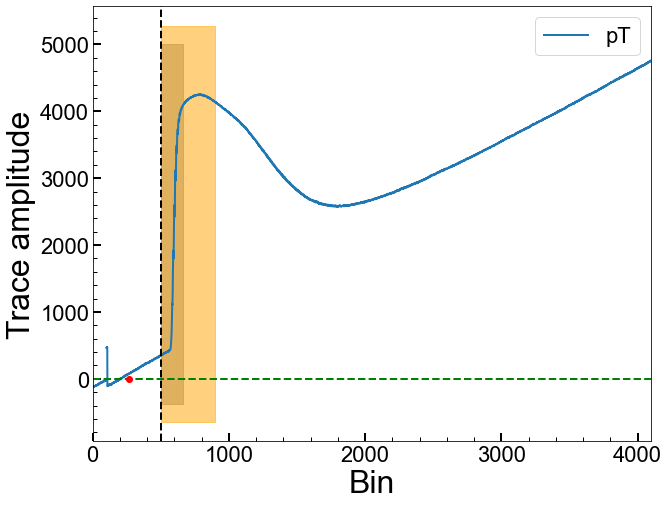

Series Number: 72209162200
Event Number: 4780297
Energy: 10.02626112506 keV
Area: 336302.94791798695


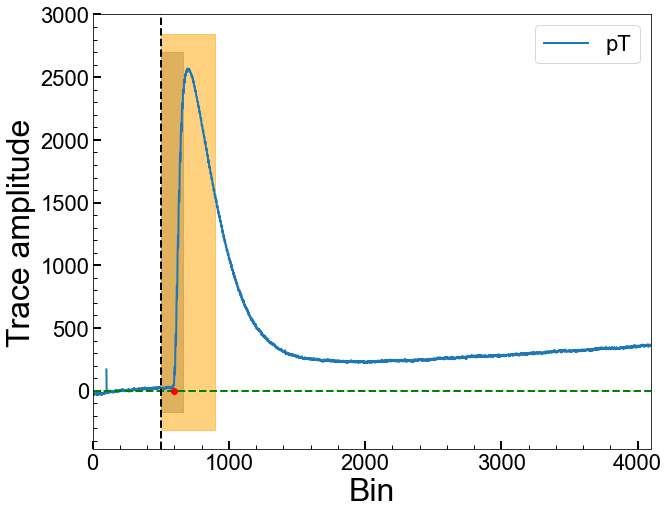

Series Number: 72209162200
Event Number: 4780653
Energy: 21.16124176202 keV
Area: 676736.5451293347


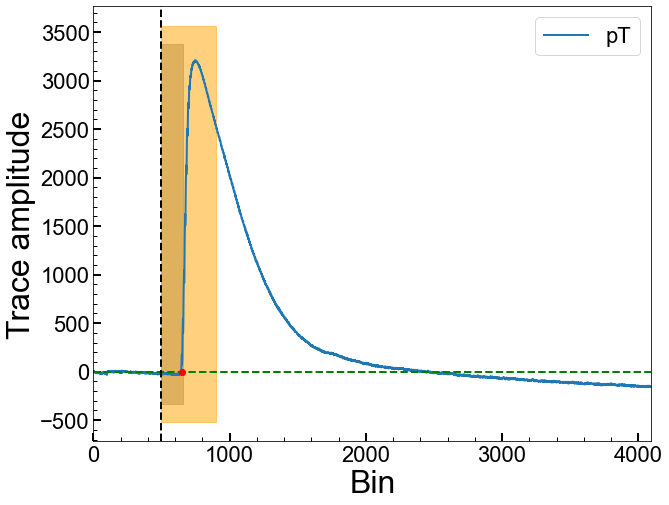

Series Number: 72209162200
Event Number: 4800374
Energy: 36.69673129226 keV
Area: 651335.990205563


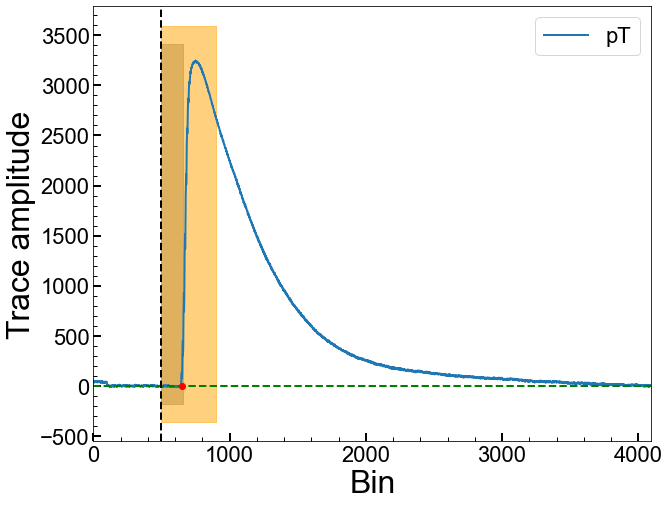

Series Number: 72209162200
Event Number: 4810796
Energy: 36.43634390353 keV
Area: 628629.4163782028


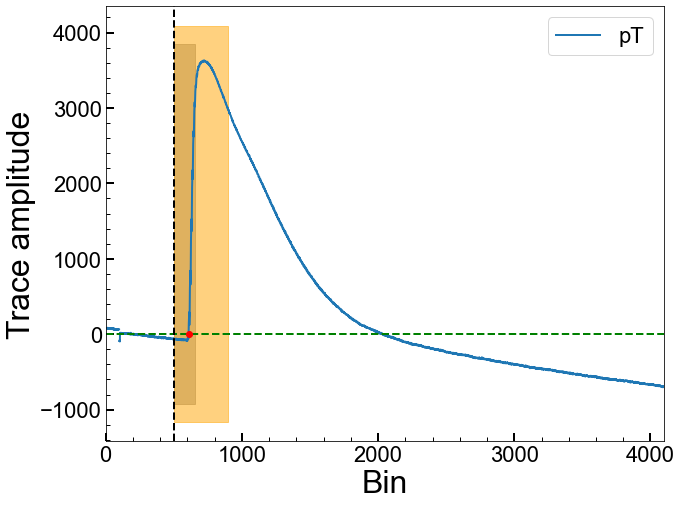

Series Number: 72209162200
Event Number: 4820504
Energy: 4.740976069819 keV
Area: 187475.38226361864


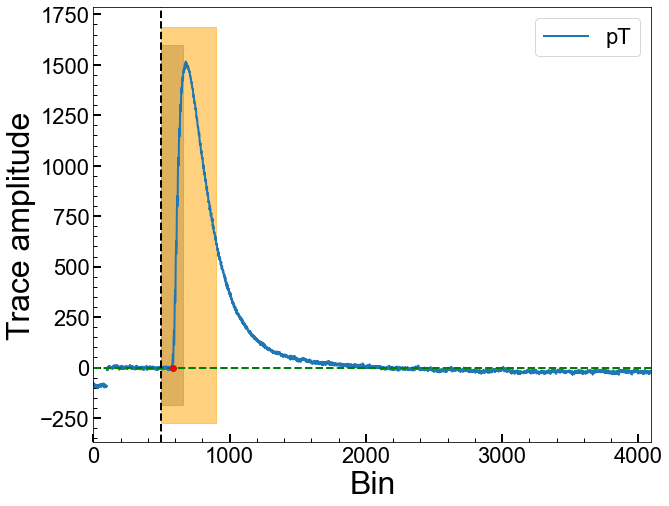

Series Number: 72209162200
Event Number: 4820822
Energy: 26.9724727155 keV
Area: 132630.5665836646


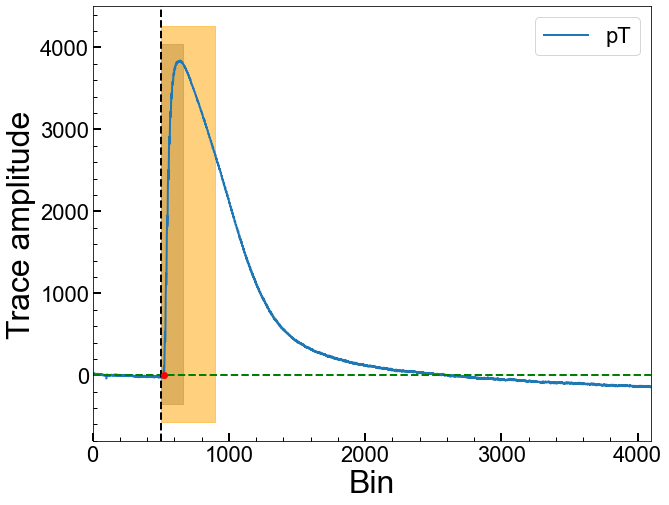

Series Number: 72209162200
Event Number: 4860070
Energy: 2.810942425095 keV
Area: 1588404.6607703723


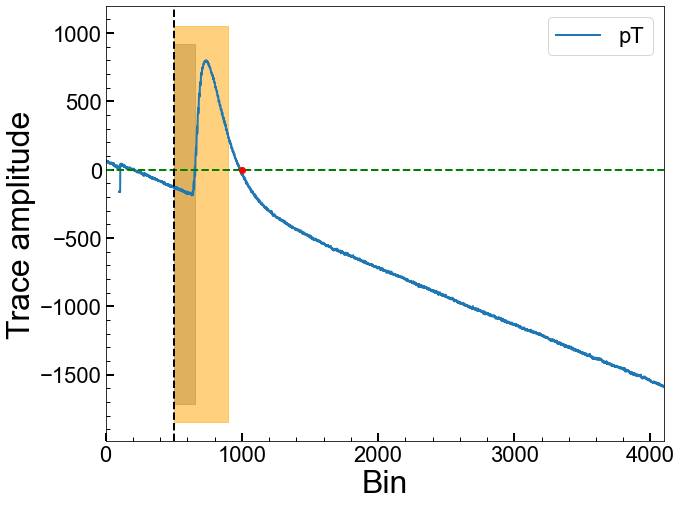

Series Number: 72209162200
Event Number: 4860251
Energy: 16.61082319641 keV
Area: 491174.24346967036


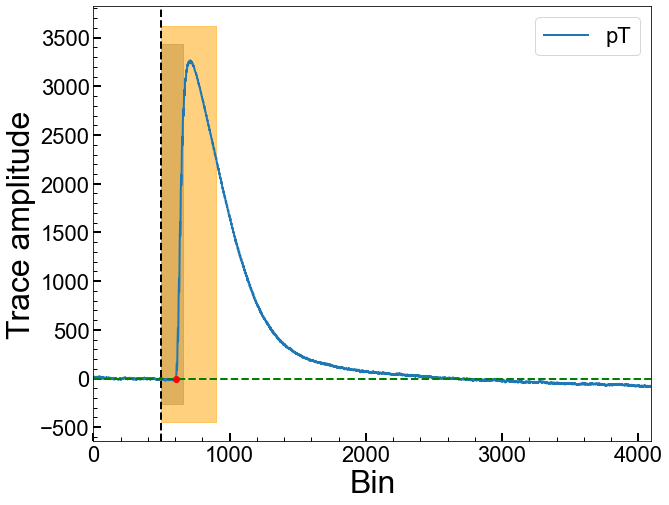

Series Number: 72209162200
Event Number: 4860386
Energy: 27.2348341178 keV
Area: 493929.8502257128


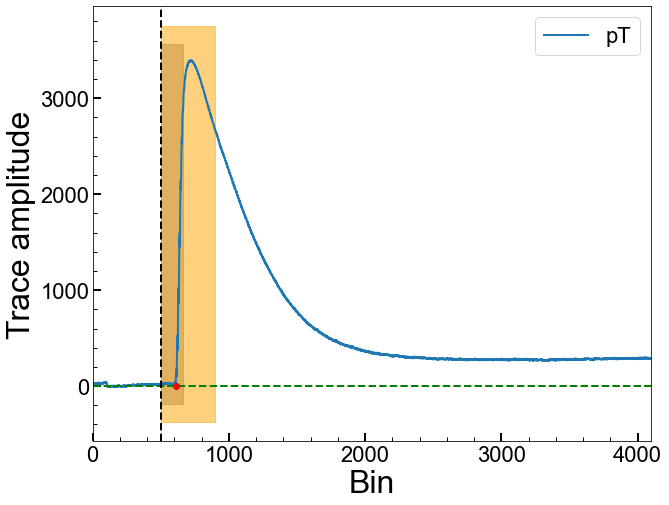

Series Number: 72209162200
Event Number: 4880840
Energy: 9.986051596871 keV
Area: 382184.03525798727


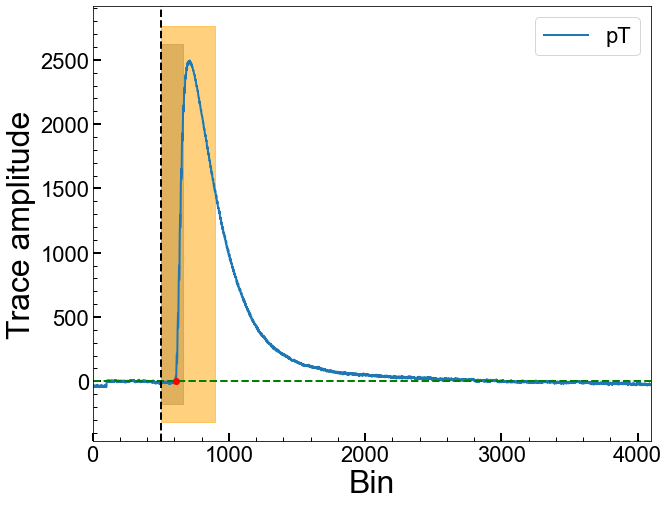

Series Number: 72209162200
Event Number: 4890649
Energy: 36.33499806615 keV
Area: 566035.2387287153


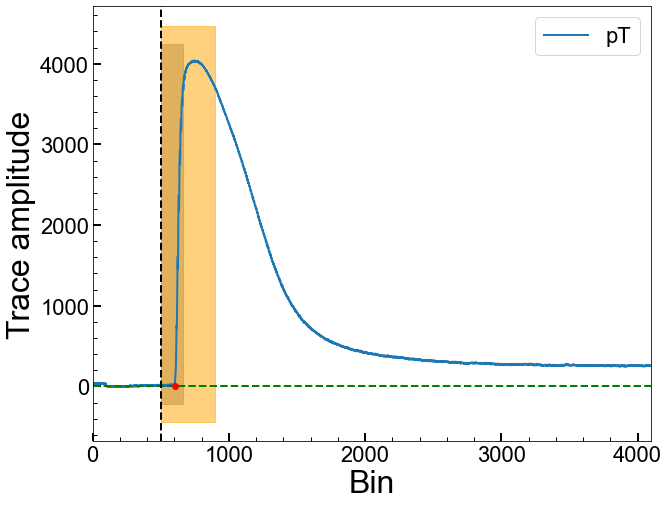

Series Number: 72209162200
Event Number: 4930030
Energy: 25.53720841129 keV
Area: 667240.226968212


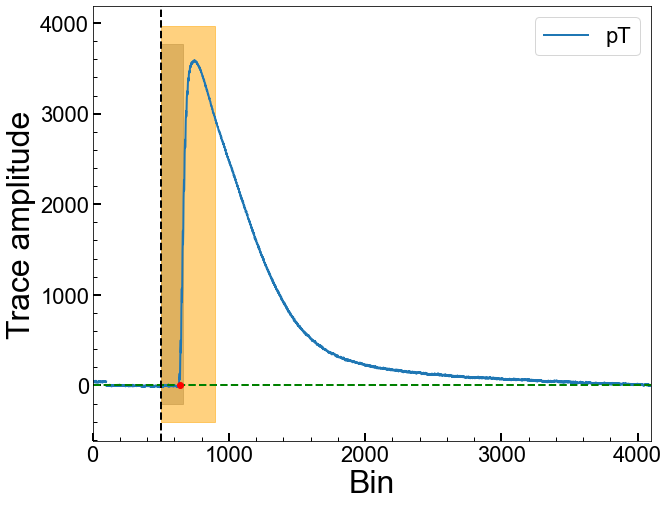

Series Number: 72209162200
Event Number: 4960169
Energy: 31.99086590787 keV
Area: 561566.328585286


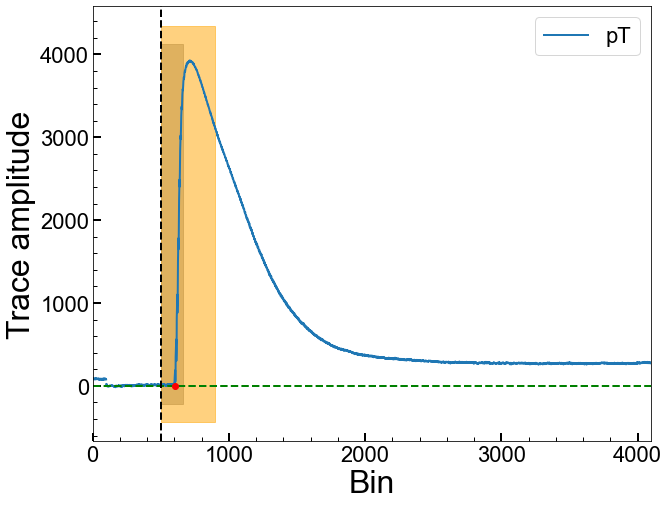

Series Number: 72209162200
Event Number: 4960825
Energy: 9.907432212898 keV
Area: 216438.8611554619


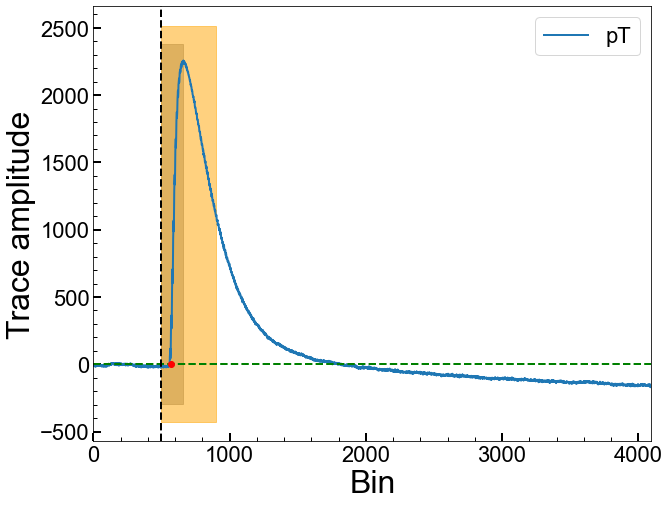

Series Number: 72209162200
Event Number: 4970131
Energy: 8.588196756357 keV
Area: 309386.9037600001


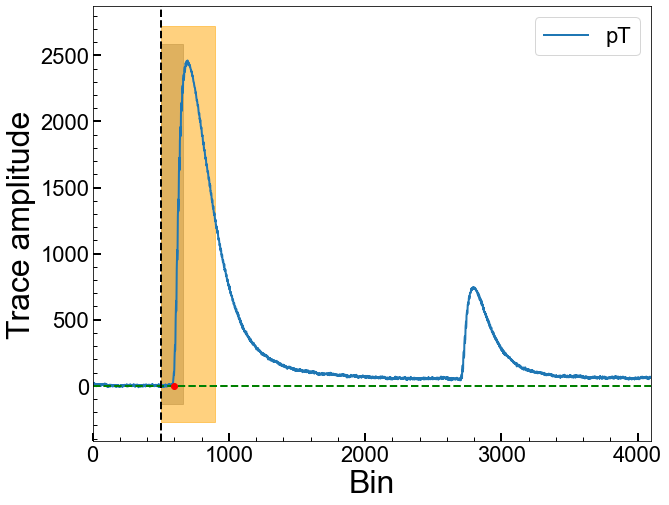

Series Number: 72209162200
Event Number: 4990895
Energy: 14.47668896432 keV
Area: 361606.6794682969


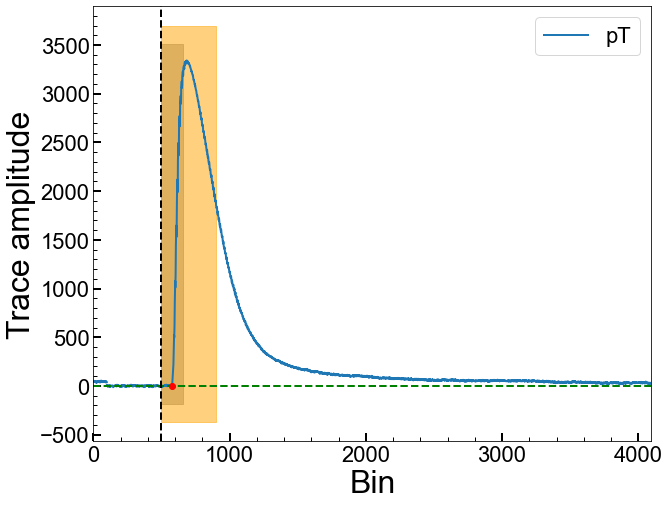

Series Number: 72209162200
Event Number: 5050645
Energy: 37.25126040264 keV
Area: 871866.2857698336


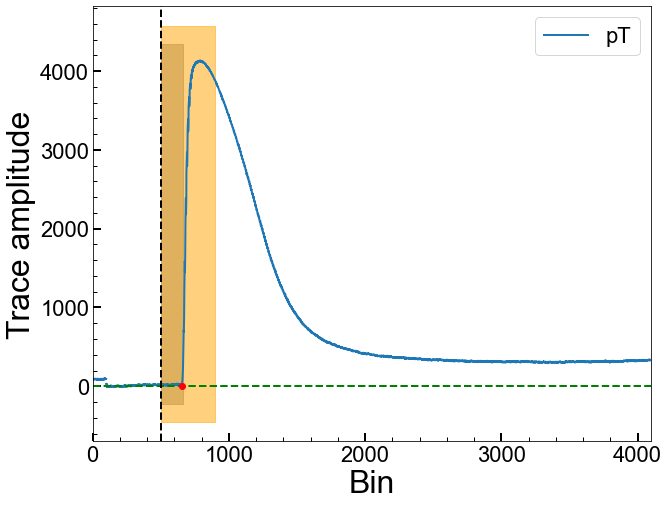

Series Number: 72209162200
Event Number: 5050732
Energy: 8.973632070046 keV
Area: -338413.1266358939


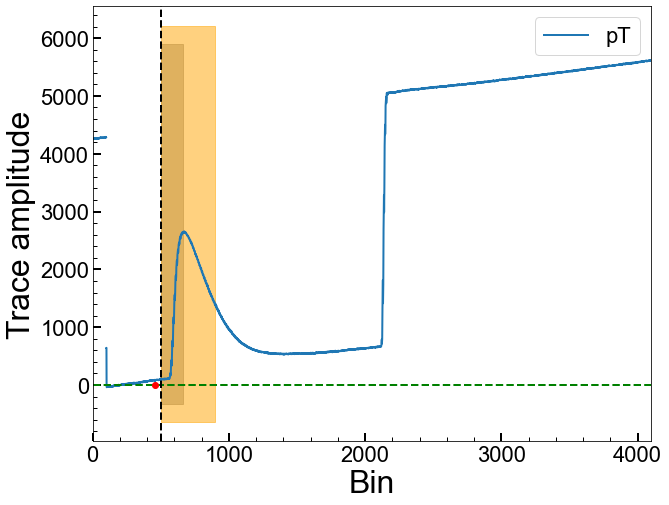

Series Number: 72209162200
Event Number: 5060563
Energy: 3.352158013139 keV
Area: 163321.7727353642


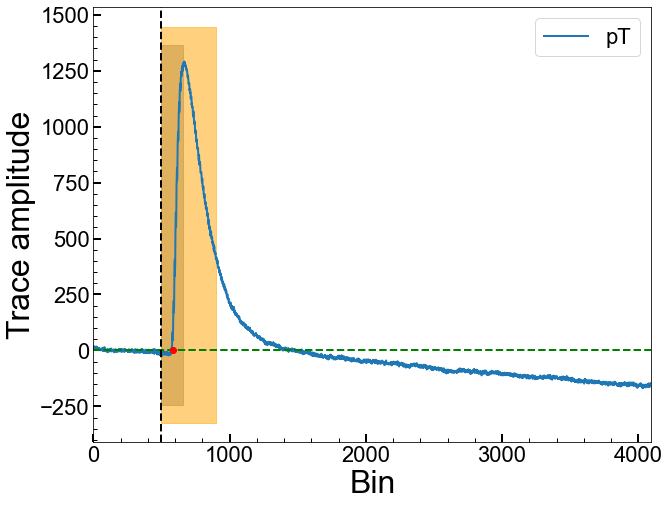

Series Number: 72209162200
Event Number: 5070495
Energy: 32.89977212184 keV
Area: 305602.0676469406


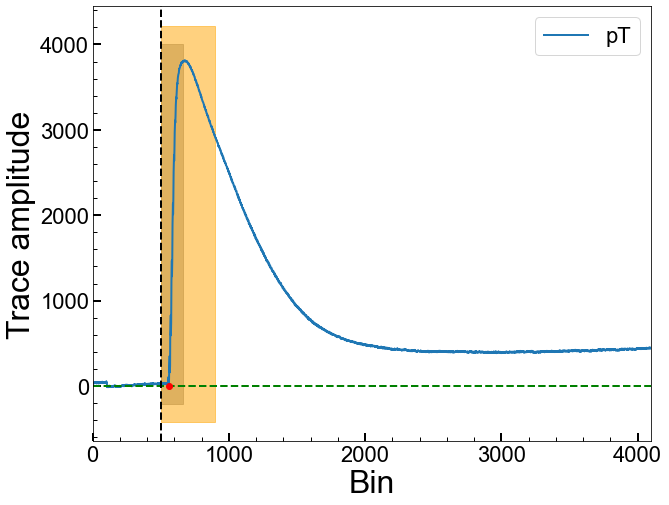

Series Number: 72209162200
Event Number: 5080548
Energy: 45.40178978913 keV
Area: 854847.4248432744


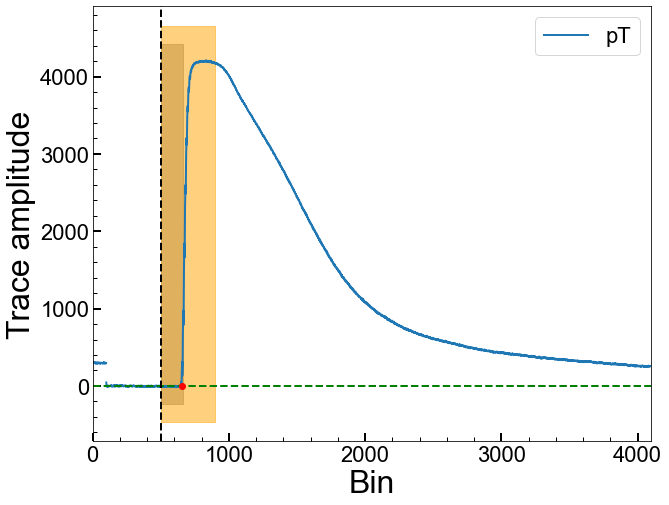

Series Number: 72209162200
Event Number: 5090588
Energy: 30.14070656308 keV
Area: 502993.38962924446


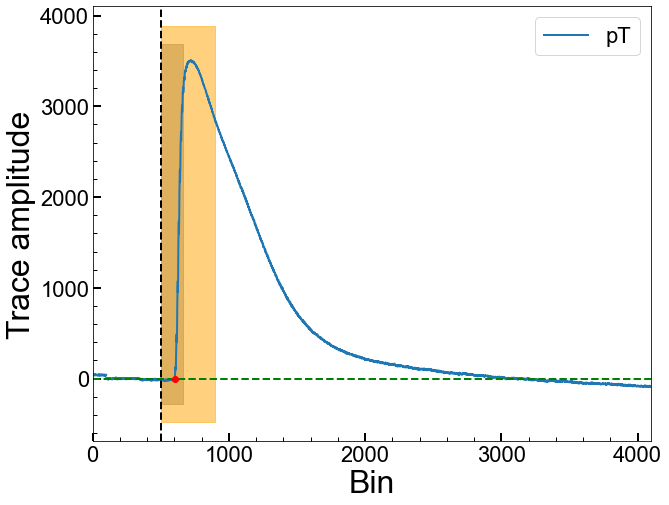

Series Number: 72209162200
Event Number: 5090597
Energy: 7.191342853681 keV
Area: 333396.81677944463


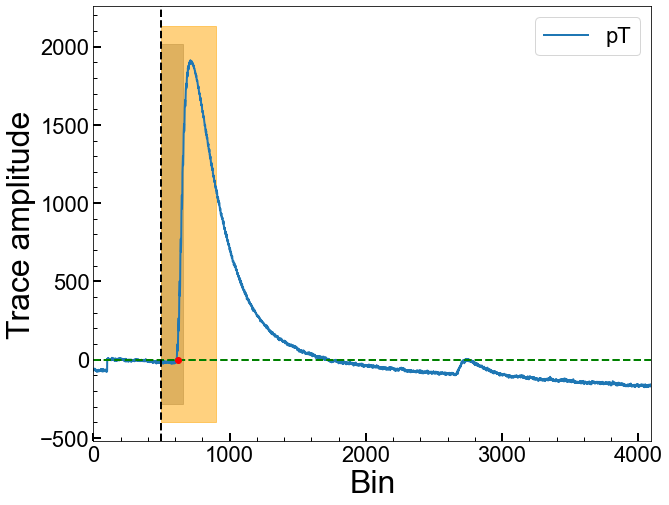

Series Number: 72209162200
Event Number: 5120188
Energy: 25.0263311976 keV
Area: 562968.9086487737


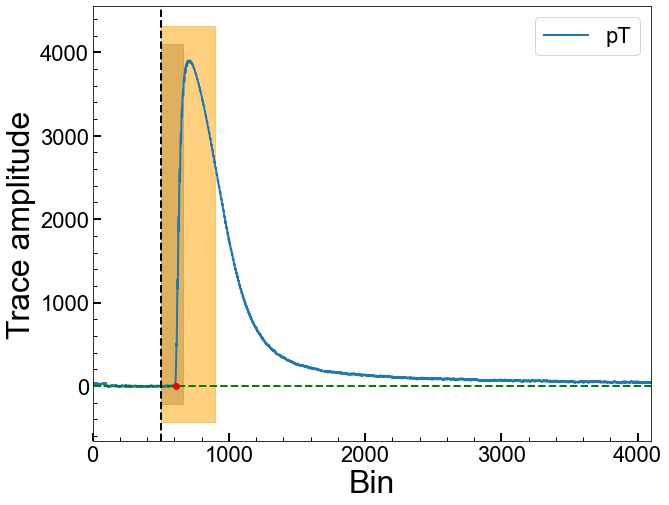

Series Number: 72209162200
Event Number: 5130356
Energy: 21.61139112108 keV
Area: -421440.0260792017


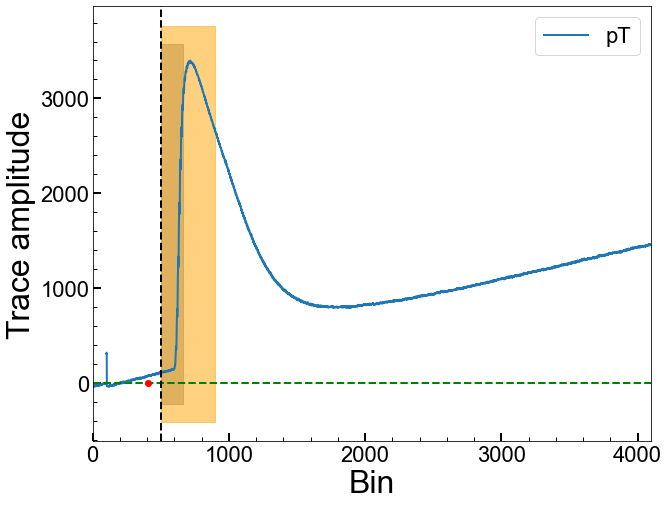

Series Number: 72209162200
Event Number: 5130895
Energy: 44.36201505286 keV
Area: 574330.2197483444


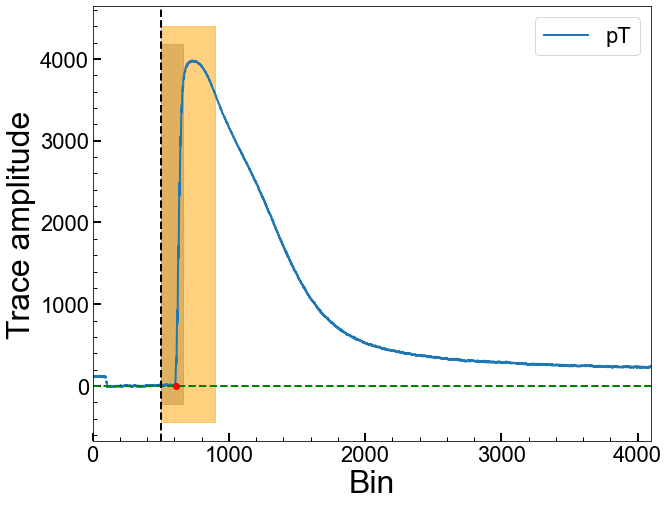

Series Number: 72209162200
Event Number: 5140746
Energy: 28.8487505463 keV
Area: 599976.0979753112


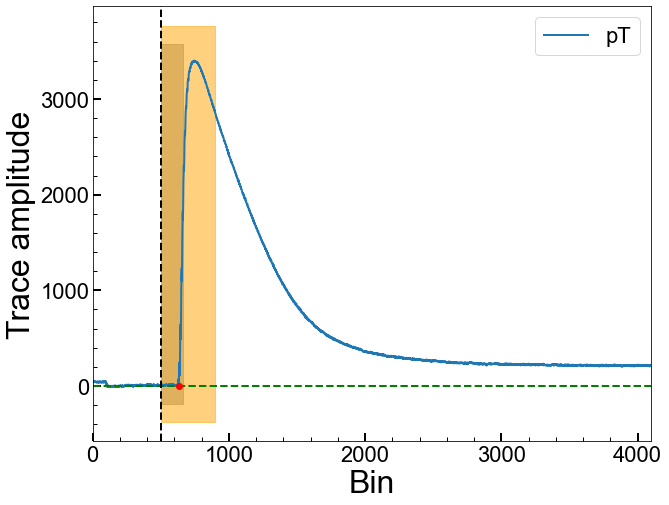

Series Number: 72209162200
Event Number: 5180413
Energy: 9.511136941897 keV
Area: 307920.162858554


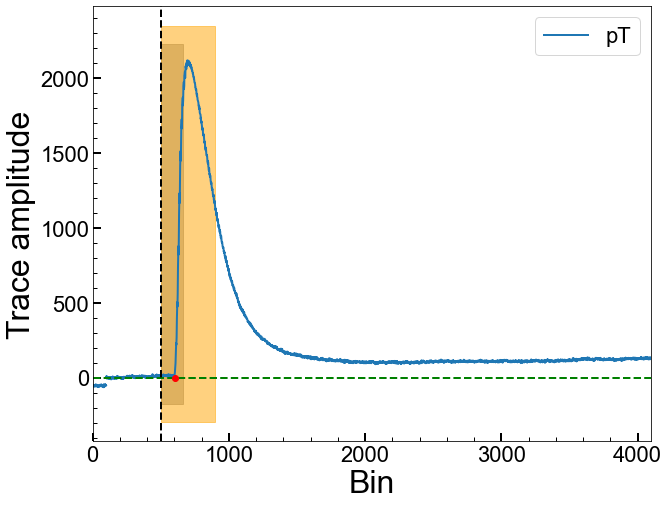

Series Number: 72209162200
Event Number: 5240811
Energy: 6.17912740005 keV
Area: -482267.7541823828


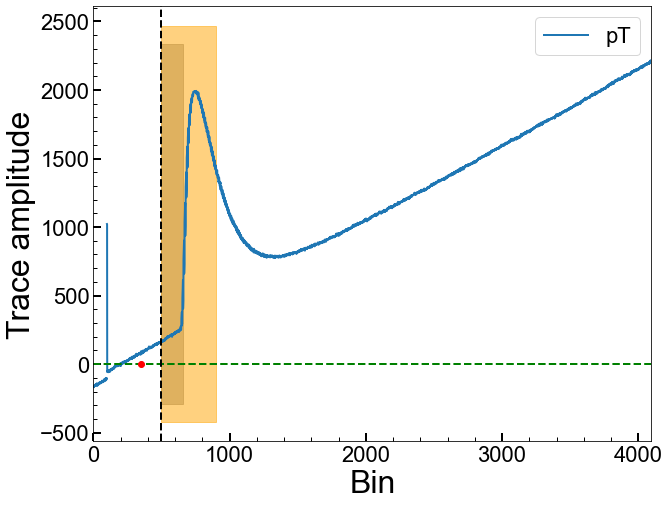

Series Number: 72209162200
Event Number: 5250867
Energy: 9.75938647367 keV
Area: 173112.8566010599


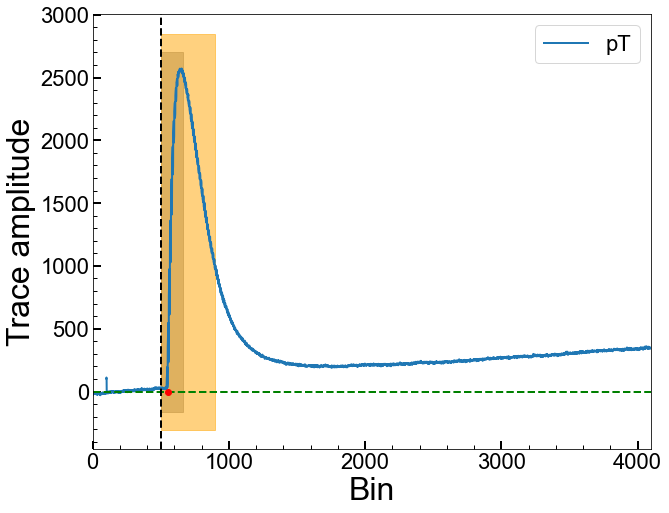

Series Number: 72209162200
Event Number: 5260711
Energy: 7.156935281128 keV
Area: 12732.53791785962


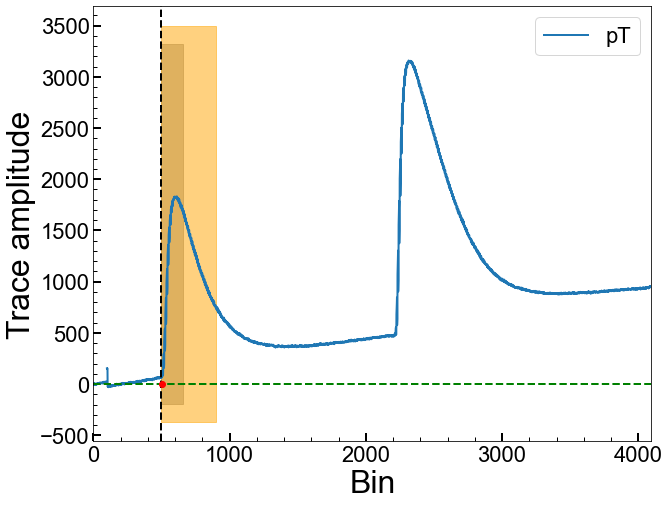

Series Number: 72209162200
Event Number: 5280889
Energy: 5.54960863171 keV
Area: 58009.02990686111


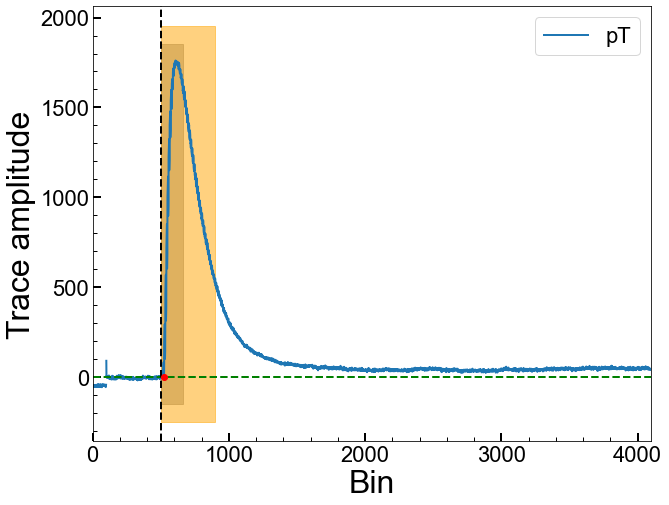

Series Number: 72209162200
Event Number: 5290181
Energy: 9.843291102842 keV
Area: 350809.2409443919


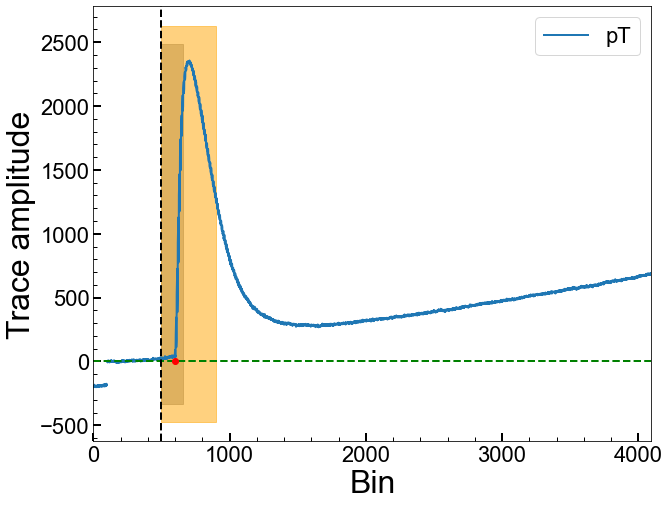

Series Number: 72209162200
Event Number: 5290780
Energy: 22.59229018826 keV
Area: 620603.2839909847


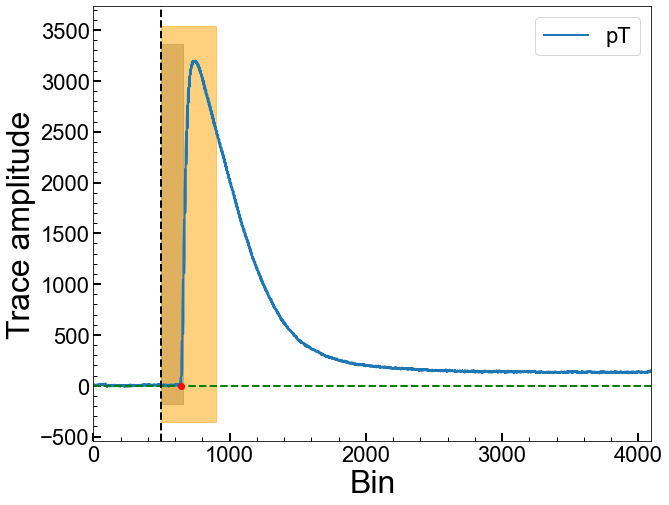

Series Number: 72209162200
Event Number: 5330668
Energy: 20.34911887457 keV
Area: -9411580.614249803


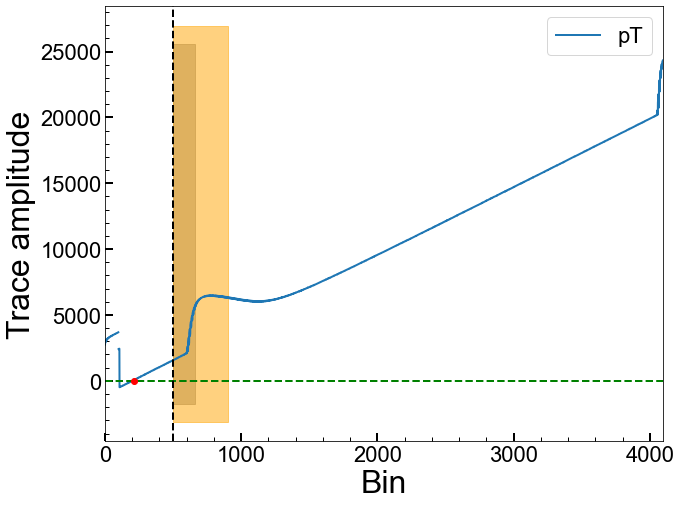

Series Number: 72209162200
Event Number: 5330875
Energy: 7.258779996547 keV
Area: -400406.8656714757


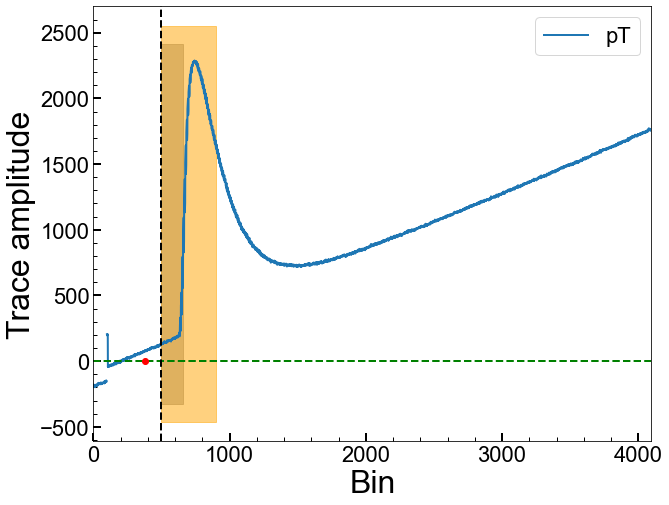

Series Number: 72209162200
Event Number: 5370208
Energy: 36.65968389259 keV
Area: 768612.5963496871


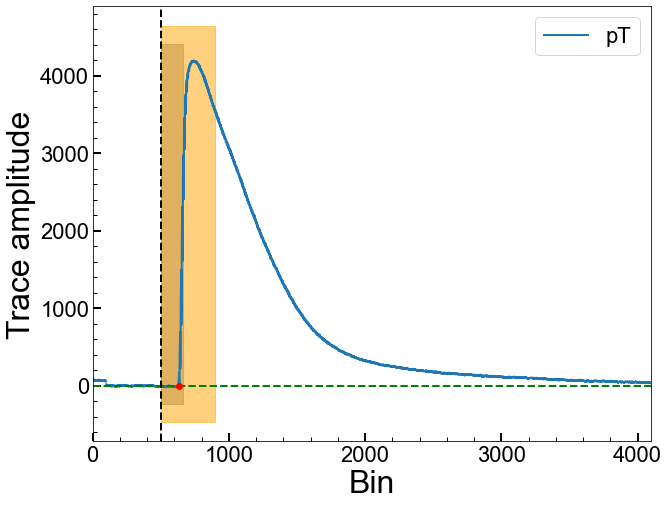

Series Number: 72209162200
Event Number: 5370375
Energy: 8.003771115526 keV
Area: 45087.82713805927


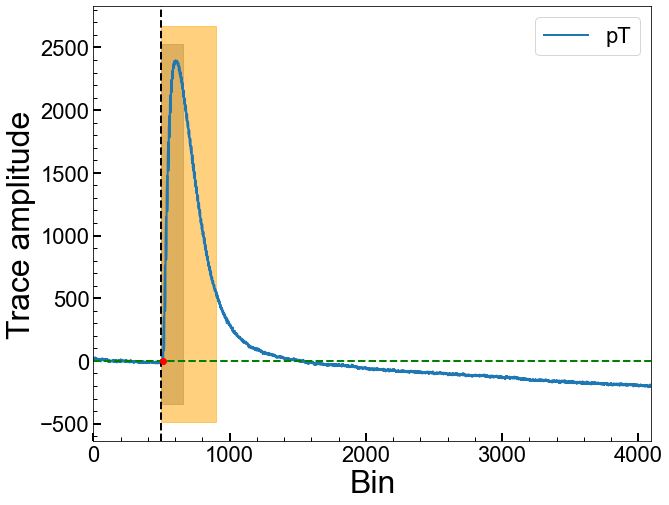

Series Number: 72209162200
Event Number: 5380569
Energy: 12.11218060073 keV
Area: 310566.89424710005


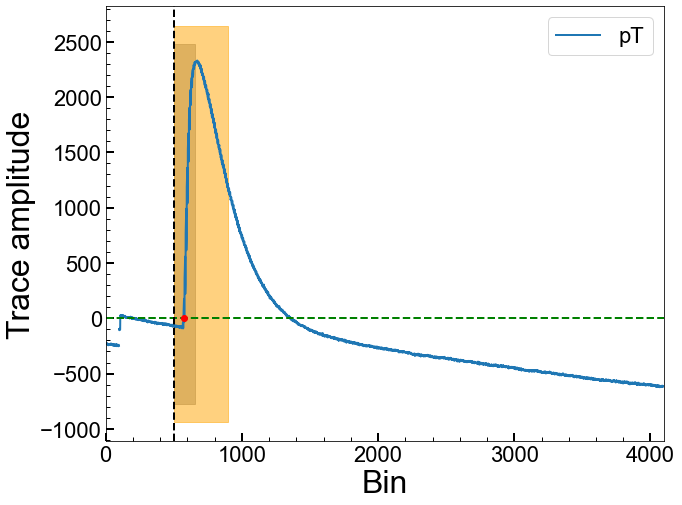

Series Number: 72209162200
Event Number: 5400834
Energy: 9.504978816945 keV
Area: 348862.75104635797


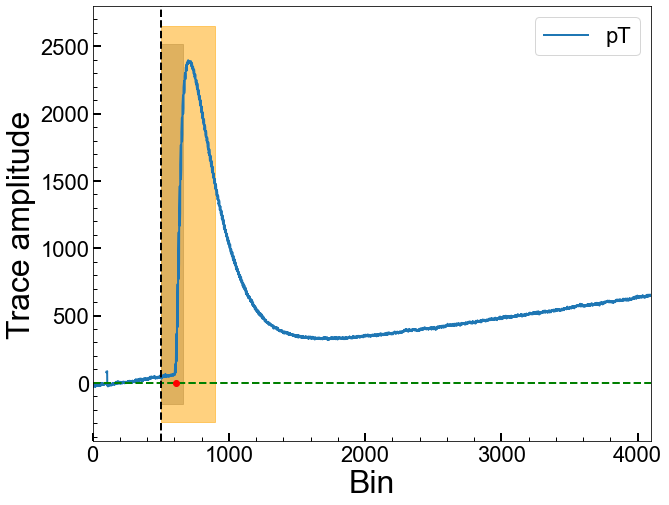

Series Number: 72209162200
Event Number: 5410560
Energy: 17.67128935783 keV
Area: 82125.90629379242


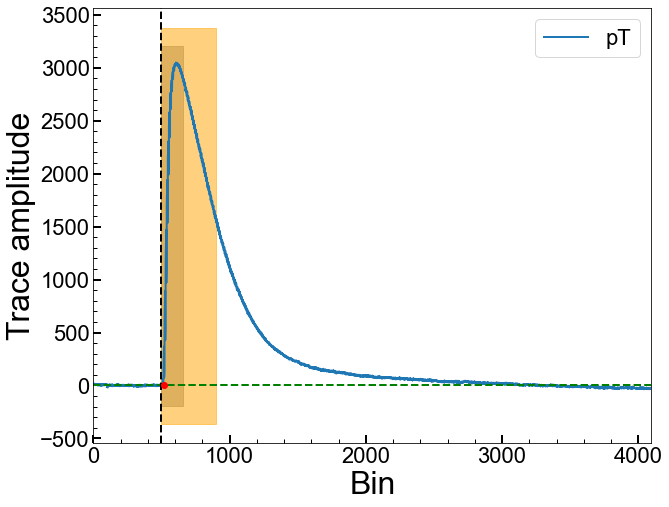

Series Number: 72209162200
Event Number: 5420021
Energy: 41.53972978058 keV
Area: 502039.8591043463


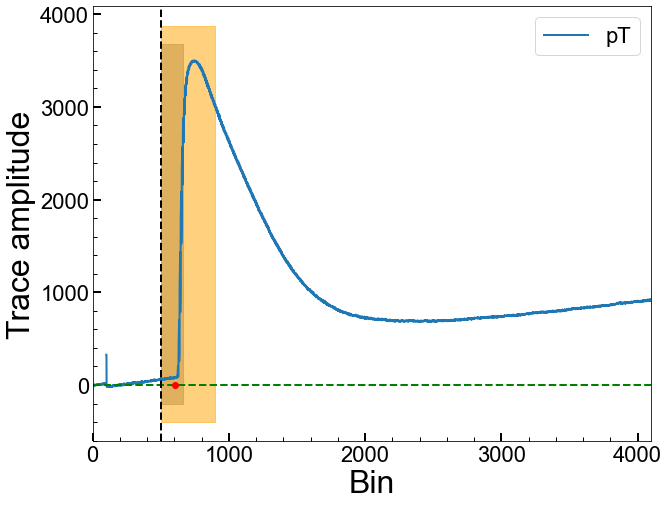

Series Number: 72209162200
Event Number: 5450253
Energy: 40.75614712118 keV
Area: 456419.9316169909


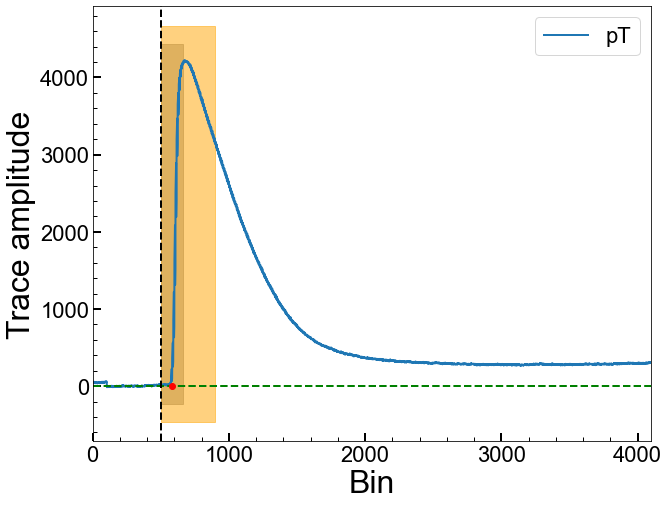

Series Number: 72209162200
Event Number: 5460447
Energy: 18.94592268194 keV
Area: 553623.8474596026


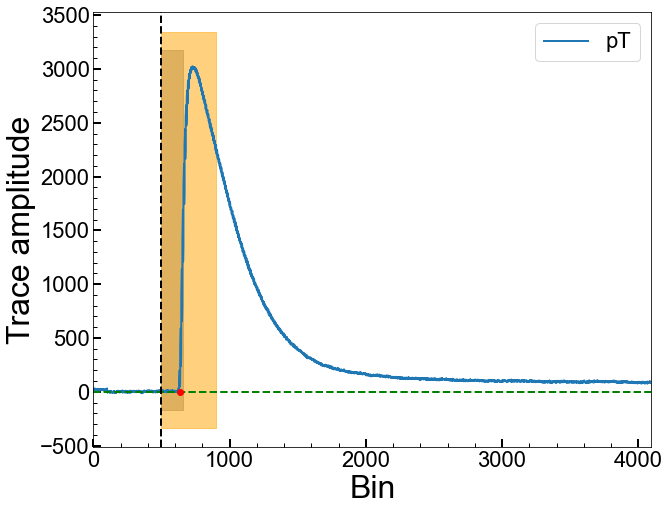

Series Number: 72209162200
Event Number: 5480186
Energy: 36.35741734522 keV
Area: -630089.2056141453


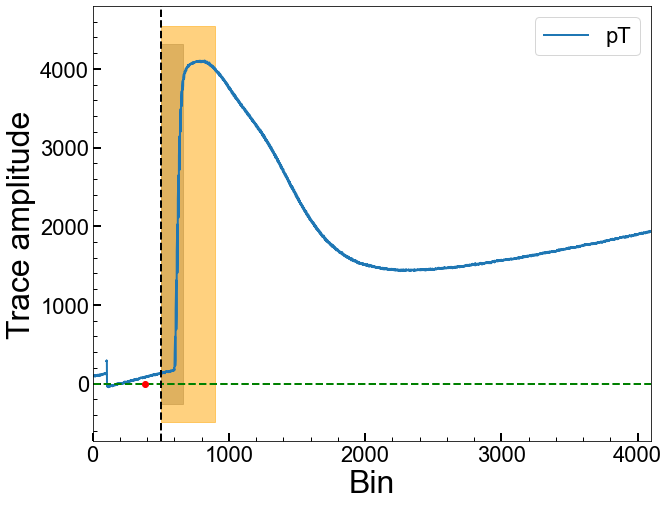

Series Number: 72209162200
Event Number: 5490053
Energy: 30.72109467491 keV
Area: 770020.2133449749


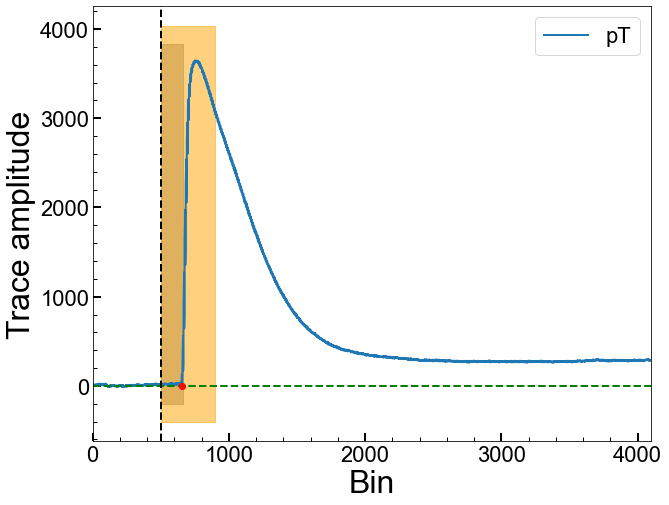

Series Number: 72209162200
Event Number: 5500243
Energy: 49.06733302235 keV
Area: 289725.2506407629


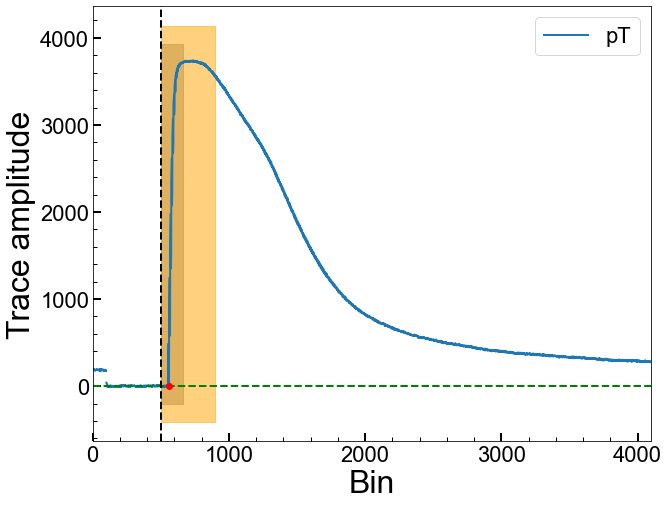

Series Number: 72209162200
Event Number: 5540143
Energy: 27.56138776104 keV
Area: -3115812.444349151


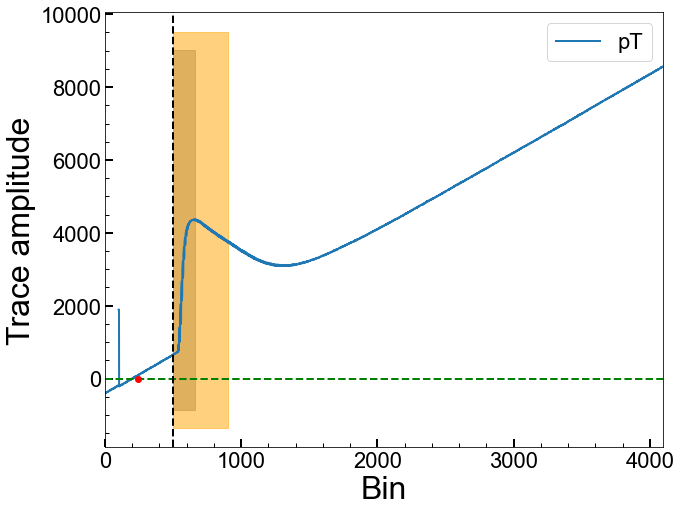

Series Number: 72209162200
Event Number: 5550829
Energy: 2.227867005457 keV
Area: 72877.21718622334


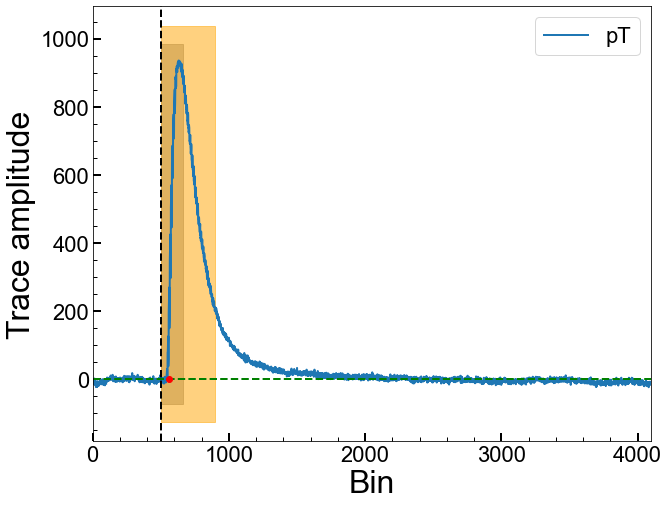

Series Number: 72209162200
Event Number: 5570225
Energy: 14.00175237376 keV
Area: 200979.83295569438


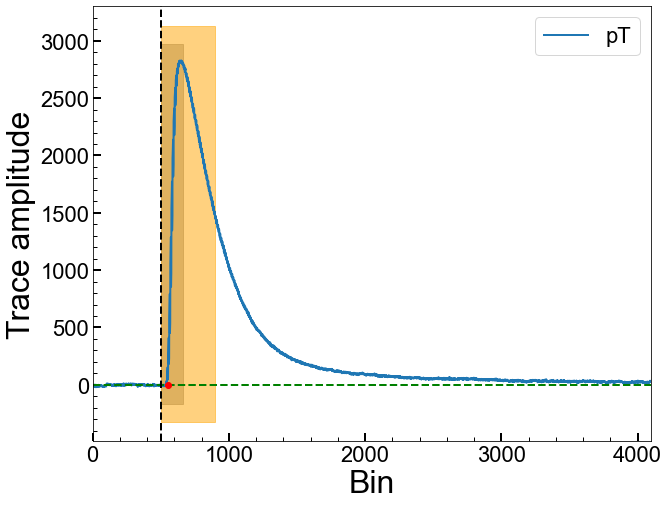

Series Number: 72209162200
Event Number: 5570518
Energy: 2.762153790014 keV
Area: 103275.50213491378


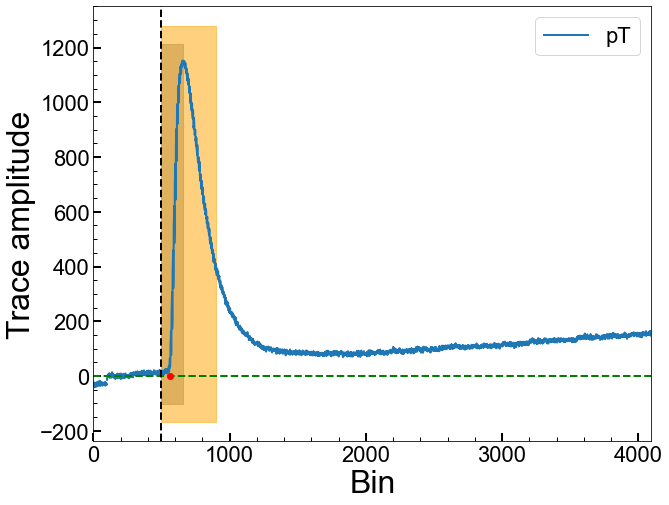

Series Number: 72209162200
Event Number: 5580450
Energy: 10.7475132023 keV
Area: 313028.43747893133


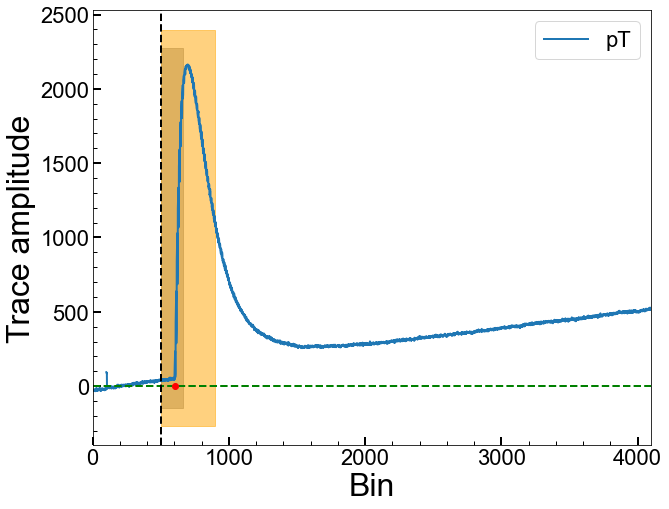

Series Number: 72209162200
Event Number: 5580893
Energy: 35.5714324955 keV
Area: 380426.5582124506


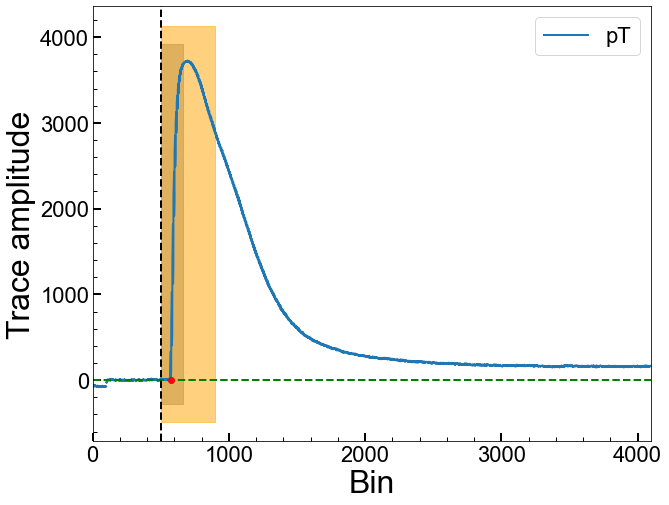

Series Number: 72209162200
Event Number: 5590678
Energy: 49.21250334678 keV
Area: 825080.564228451


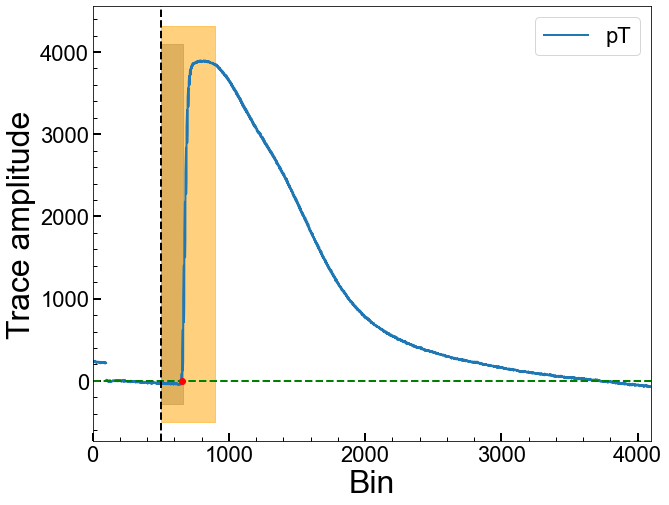

Series Number: 72209162200
Event Number: 5600555
Energy: 40.6637167237 keV
Area: 618444.756085171


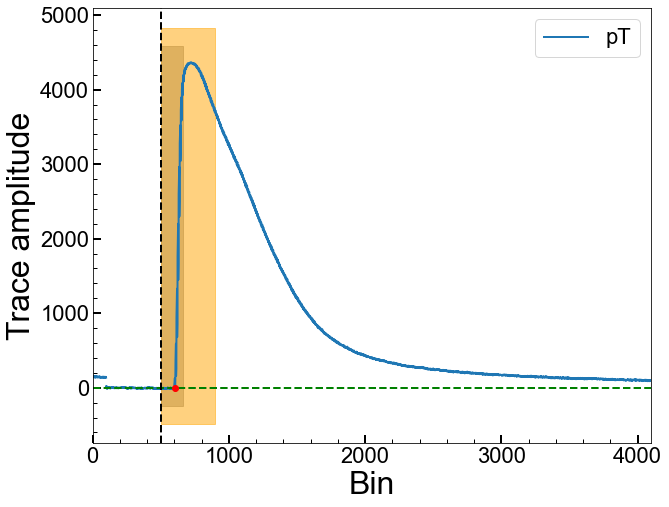

Series Number: 72209162200
Event Number: 5600684
Energy: 32.54495453612 keV
Area: 496197.9934927152


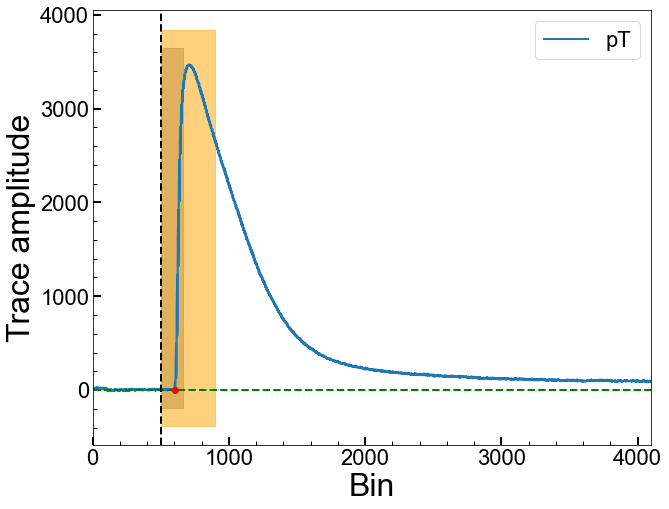

Series Number: 72209162200
Event Number: 5600827
Energy: 14.59716204358 keV
Area: 617845.5339194695


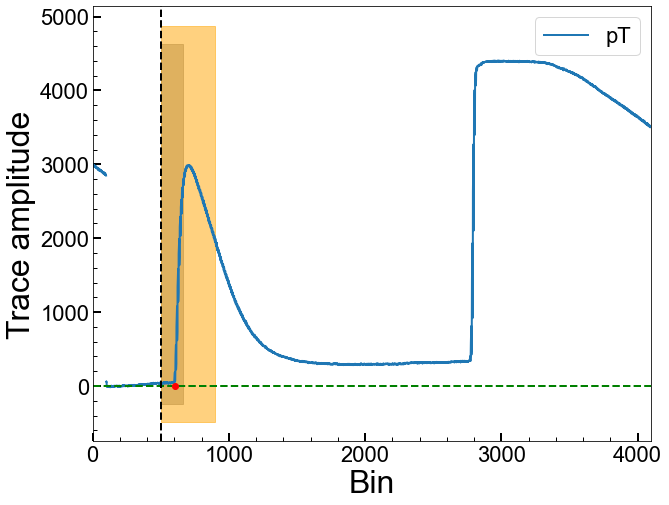

Series Number: 72209162200
Event Number: 5600851
Energy: 24.41936730226 keV
Area: 391830.94051433116


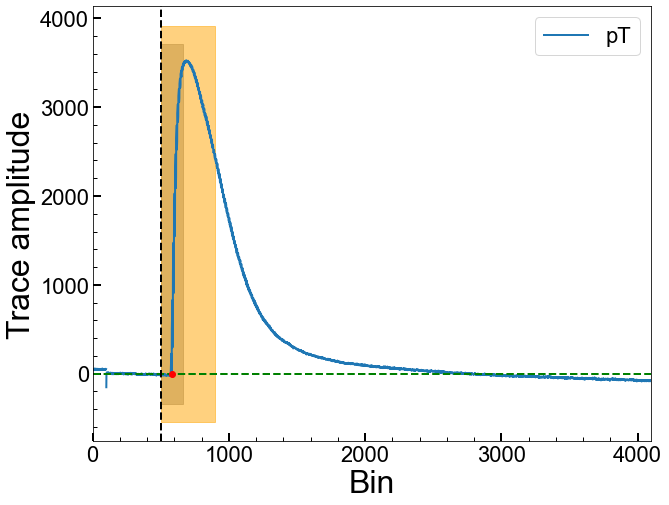

Series Number: 72209162200
Event Number: 5620060
Energy: 13.71239830363 keV
Area: 186128.15155247675


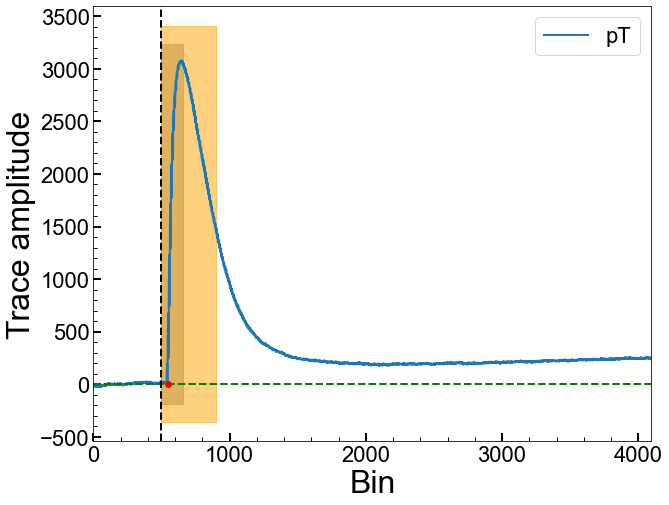

Series Number: 72209162200
Event Number: 5620134
Energy: 18.71815817401 keV
Area: 313160.11258848733


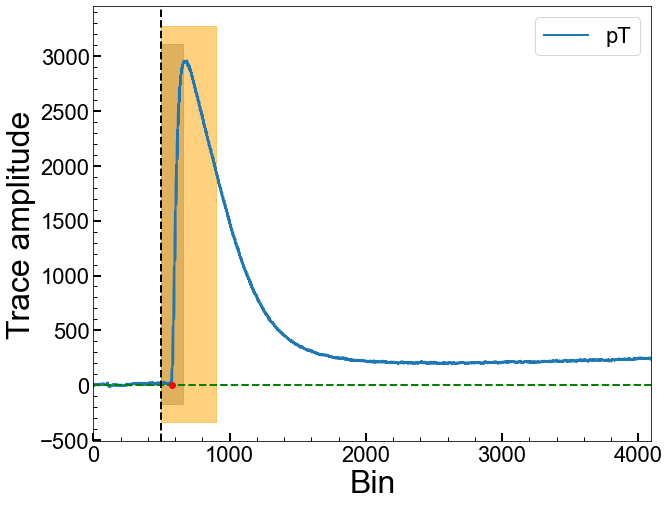

Series Number: 72209162200
Event Number: 5640434
Energy: 46.23784529851 keV
Area: -2113617.6196220783


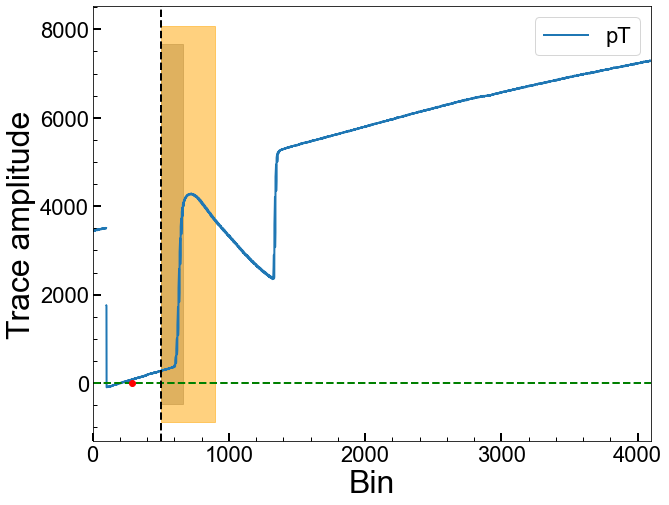

Series Number: 72209162200
Event Number: 5640544
Energy: 8.585720029057 keV
Area: -812571.5199468402


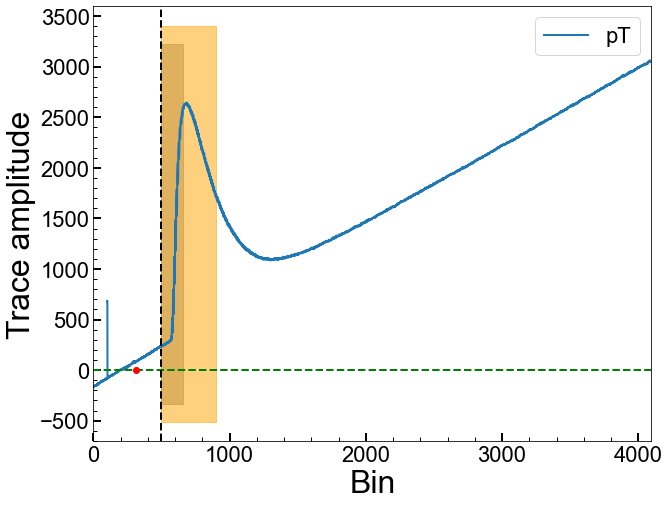

Series Number: 72209162200
Event Number: 5650437
Energy: 16.92945898266 keV
Area: 498609.5033403658


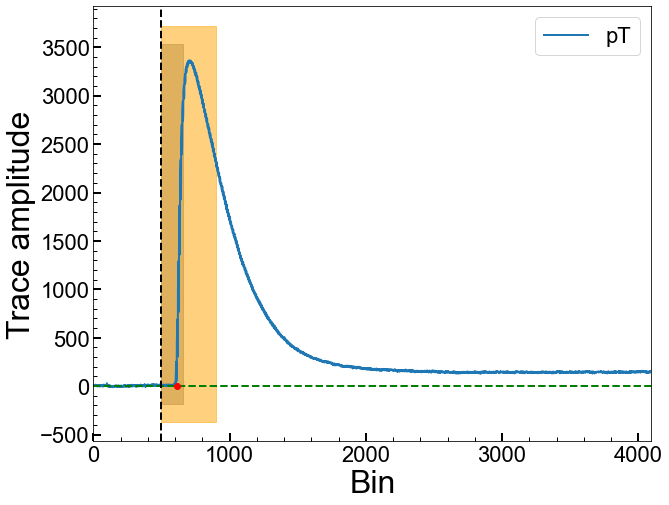

Series Number: 72209162200
Event Number: 5650805
Energy: 20.39855648473 keV
Area: 227451.15625270476


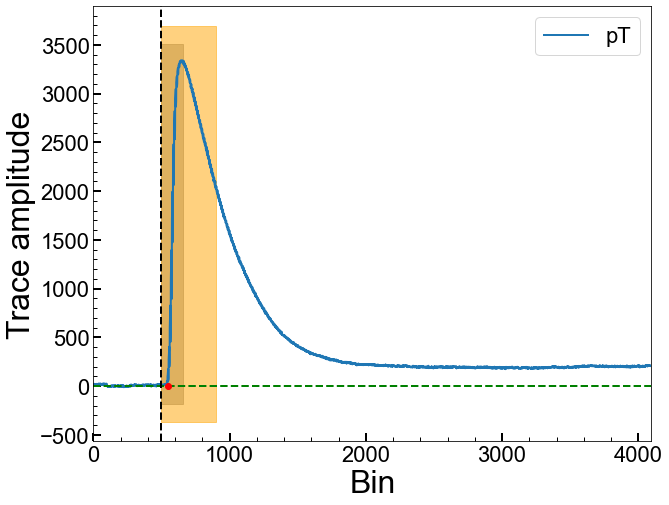

Series Number: 72209162200
Event Number: 5660057
Energy: 17.93506675016 keV
Area: 416325.5741168213


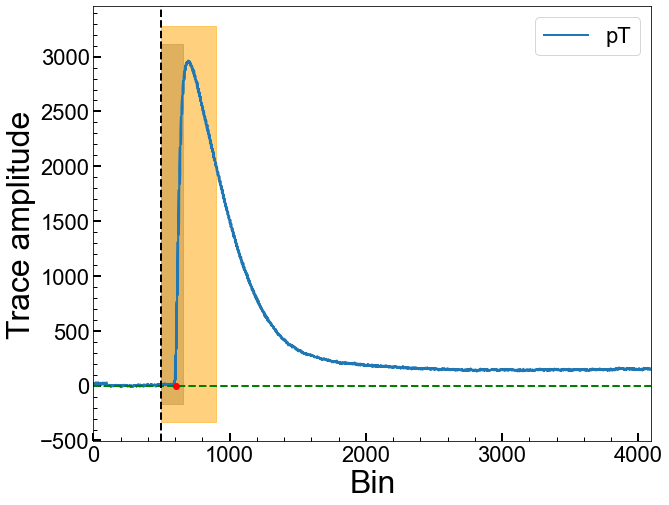

Series Number: 72209162200
Event Number: 5670060
Energy: 12.89187033831 keV
Area: 316959.0922895127


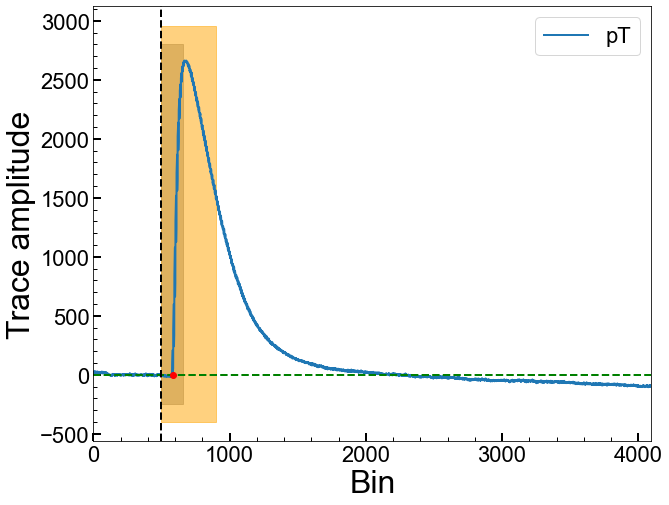

Series Number: 72209162200
Event Number: 5670390
Energy: 37.33020545265 keV
Area: 125975.51783321852


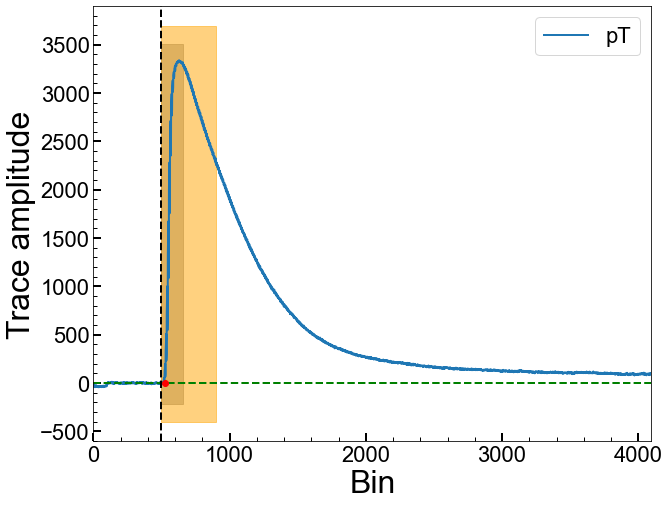

Series Number: 72209162200
Event Number: 5680238
Energy: 14.28994518552 keV
Area: 520607.8379761679


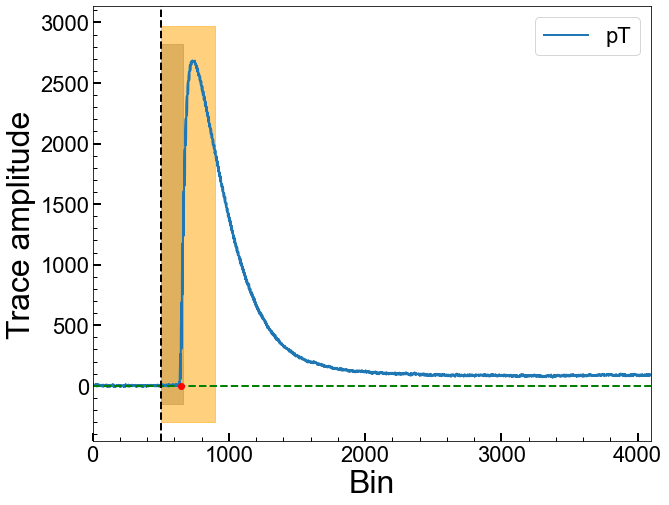

Series Number: 72209162200
Event Number: 5690046
Energy: 23.50257918512 keV
Area: 484143.6169494677


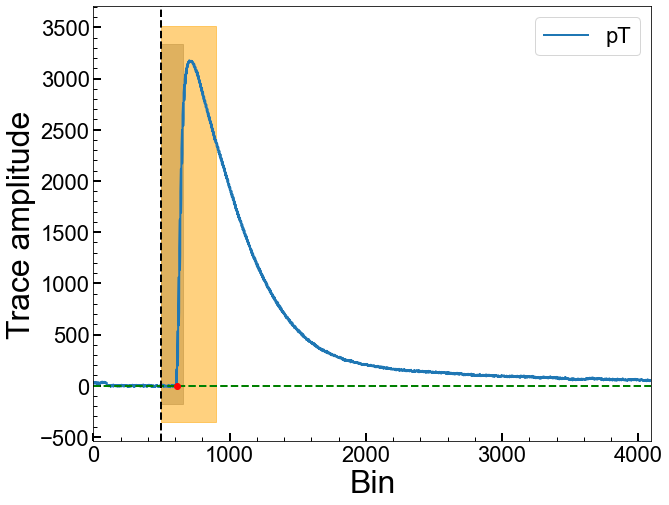

Series Number: 72209162200
Event Number: 5690125
Energy: 21.69976280151 keV
Area: 758473.4989168233


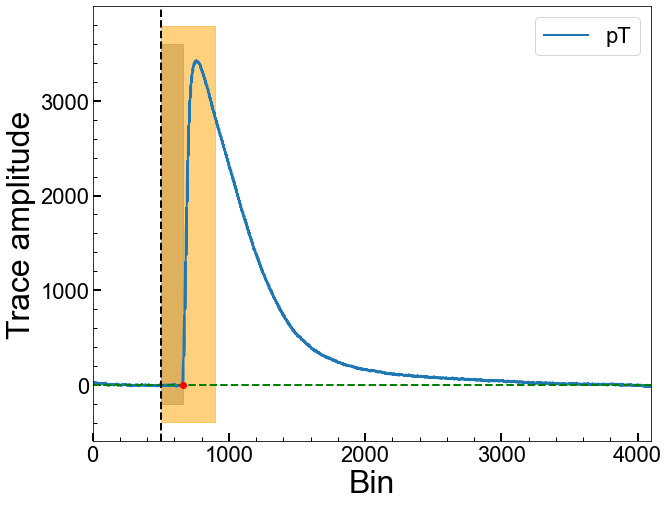

Series Number: 72209162200
Event Number: 5690738
Energy: 19.21742662455 keV
Area: 215739.73204482123


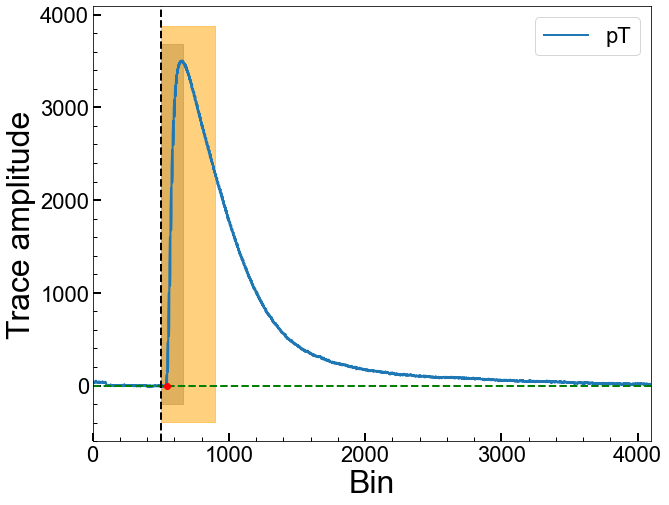

Series Number: 72209162200
Event Number: 5740322
Energy: 23.99390358335 keV
Area: -446250.75762472406


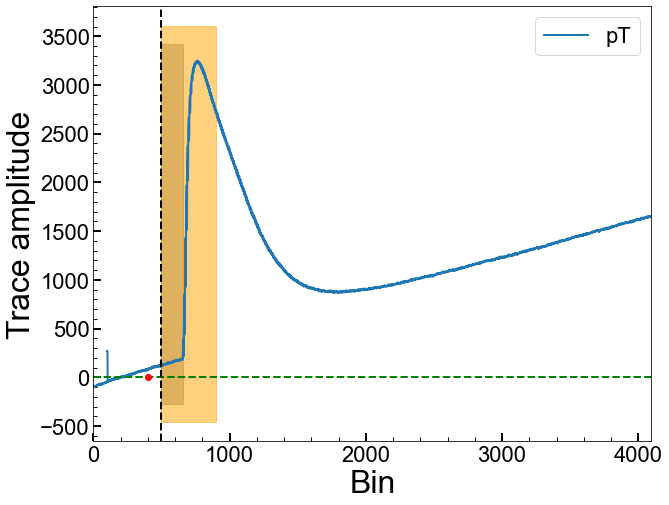

Series Number: 72209162200
Event Number: 5740591
Energy: 11.48045744756 keV
Area: 504178.77502779366


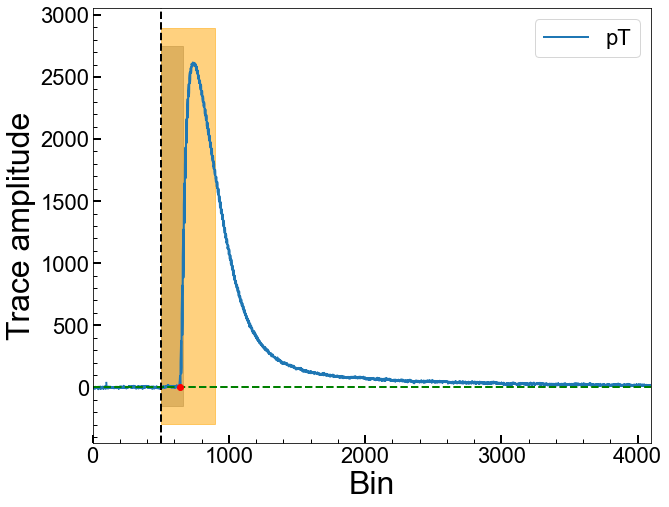

Series Number: 72209162200
Event Number: 5760128
Energy: 26.89351683477 keV
Area: 223618.95426750722


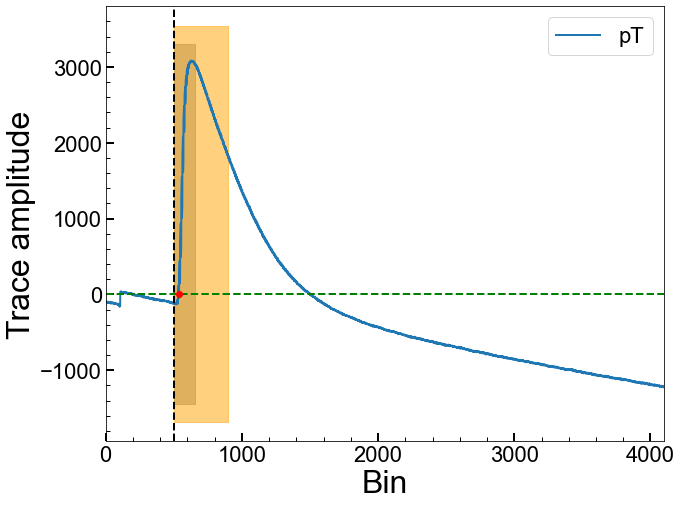

Series Number: 72209162200
Event Number: 5760180
Energy: 8.834725259576 keV
Area: -631900.0225463843


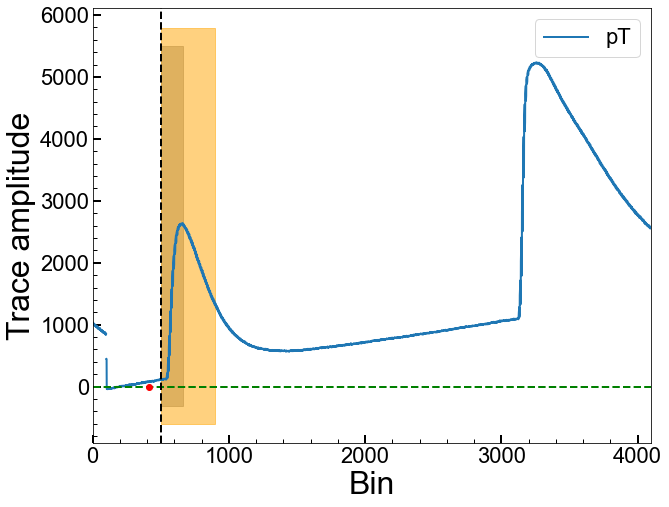

Series Number: 72209162200
Event Number: 5770785
Energy: 14.19778635315 keV
Area: 327580.70403042133


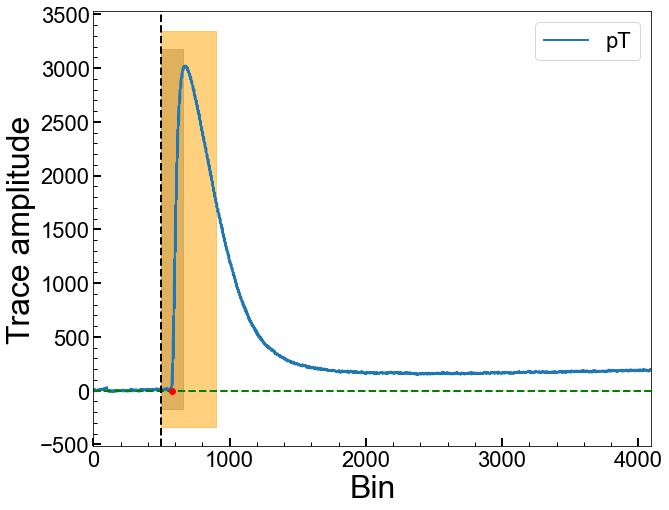

Series Number: 72209162200
Event Number: 5780839
Energy: 11.3683361892 keV
Area: -762716.3680580661


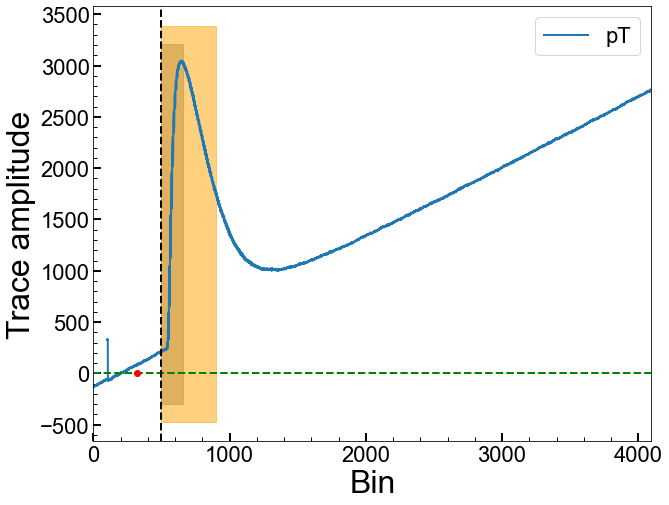

Series Number: 72209162200
Event Number: 5790661
Energy: 16.29966697281 keV
Area: 449009.282736657


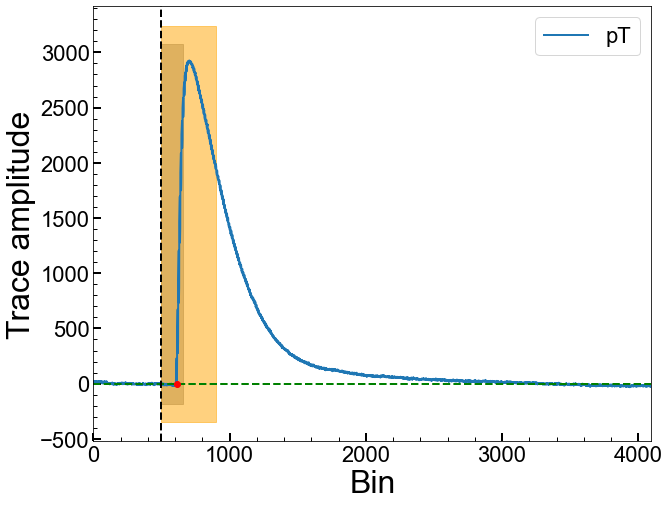

Series Number: 72209162200
Event Number: 5800525
Energy: 8.895252374944 keV
Area: 320068.53299992136


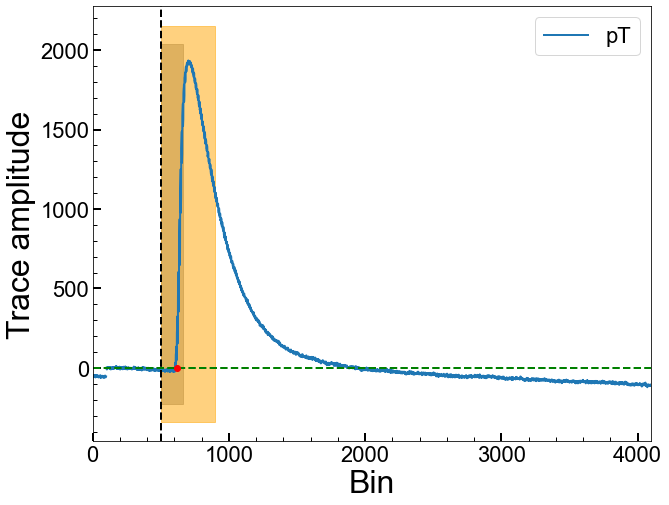

Series Number: 72209162200
Event Number: 5810161
Energy: 8.465858495375 keV
Area: 236846.53598325822


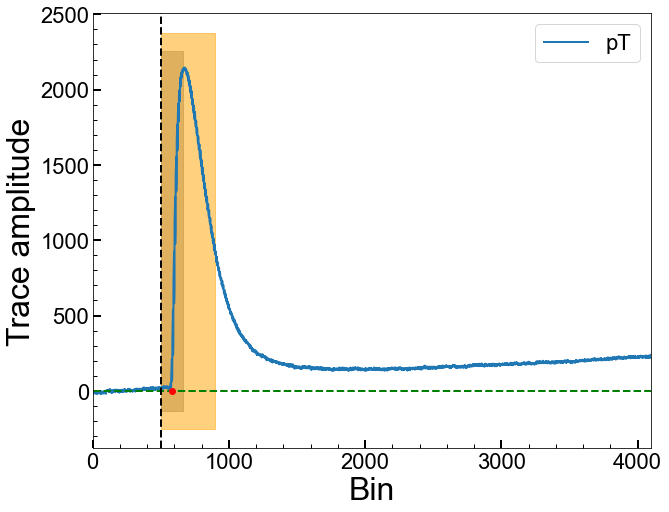

Series Number: 72209162200
Event Number: 5810300
Energy: 16.97145386573 keV
Area: 445315.1186733124


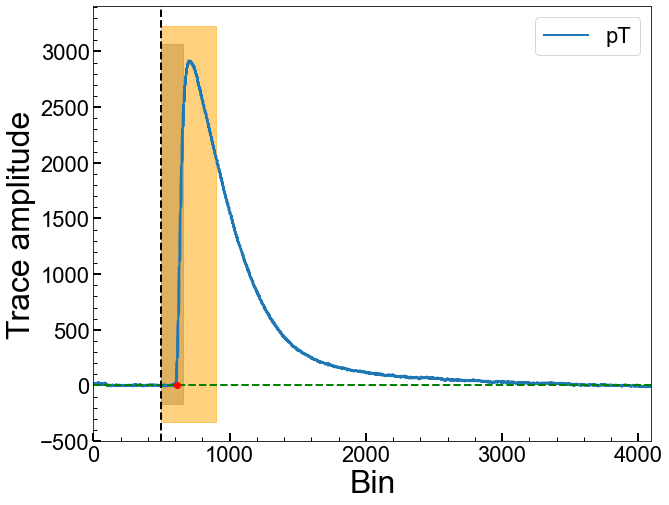

Series Number: 72209162200
Event Number: 5820496
Energy: 13.49105875978 keV
Area: 107793.40482170062


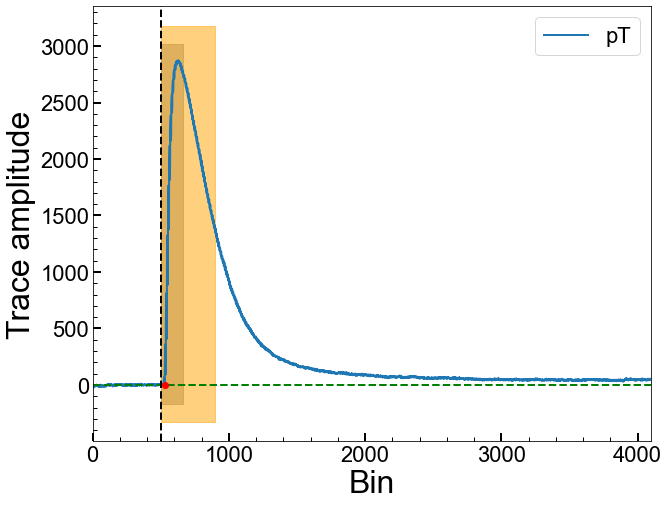

Series Number: 72209162200
Event Number: 5830100
Energy: 28.26943125583 keV
Area: 517799.8614296863


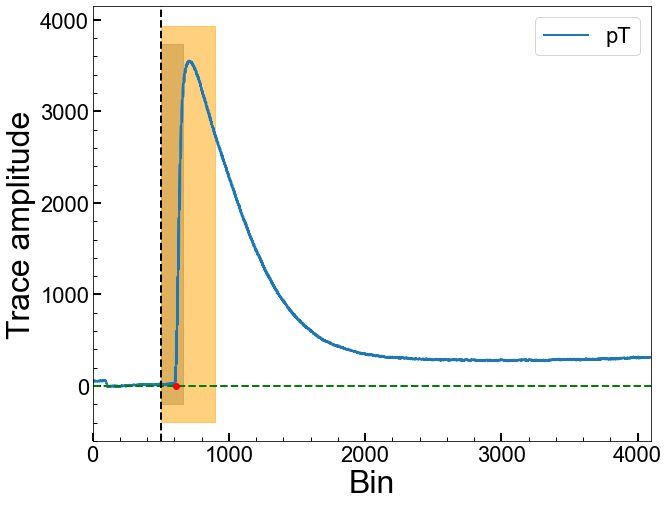

Series Number: 72209162200
Event Number: 5830473
Energy: 41.47960382857 keV
Area: 505742.40226458263


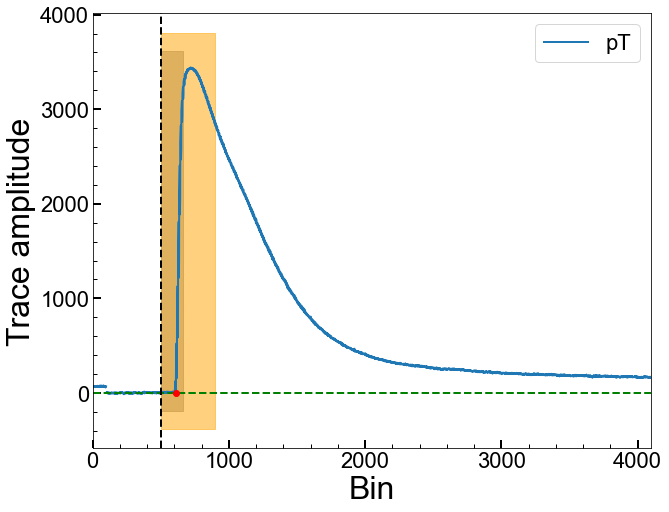

Series Number: 72209162200
Event Number: 5830579
Energy: 49.53848131416 keV
Area: 295421.5997488742


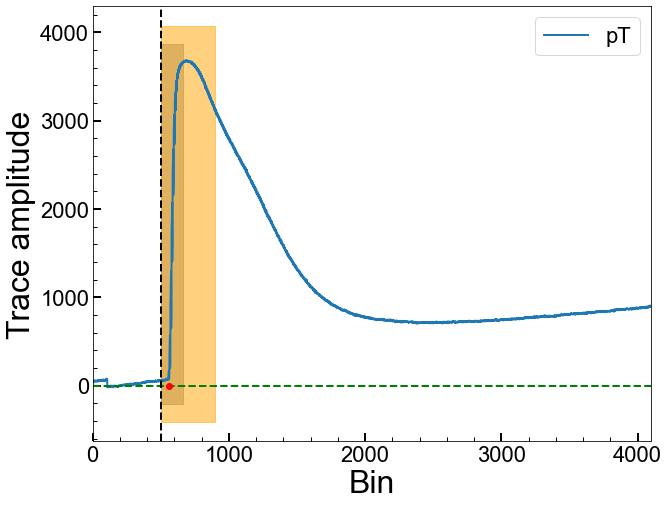

Series Number: 72209162200
Event Number: 5850078
Energy: 26.02048954514 keV
Area: 452583.90098473115


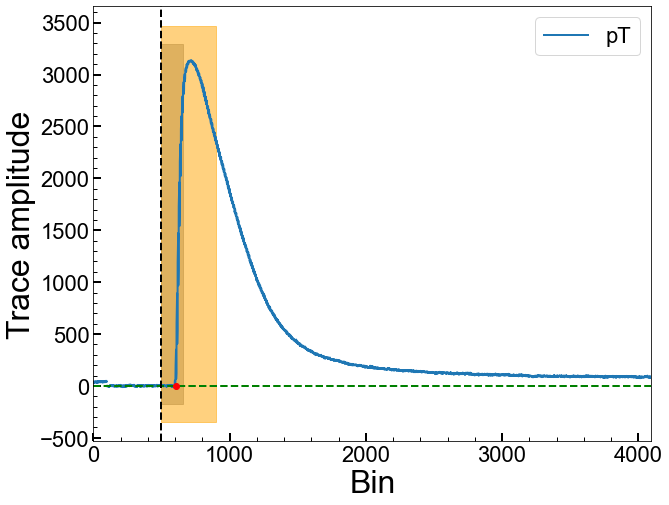

Series Number: 72209162200
Event Number: 5860082
Energy: 22.56642929847 keV
Area: 405742.36494029156


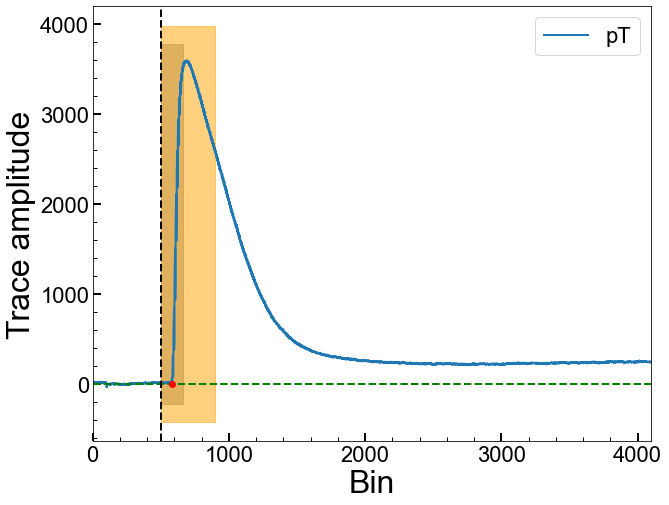

Series Number: 72209162200
Event Number: 5880059
Energy: 13.58616102547 keV
Area: -5015531.5889121005


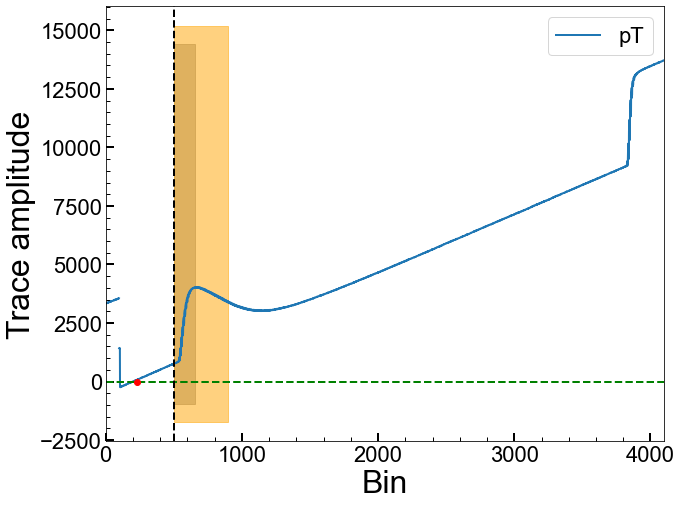

Series Number: 72209162200
Event Number: 5930476
Energy: 33.49740912383 keV
Area: 690111.7449746862


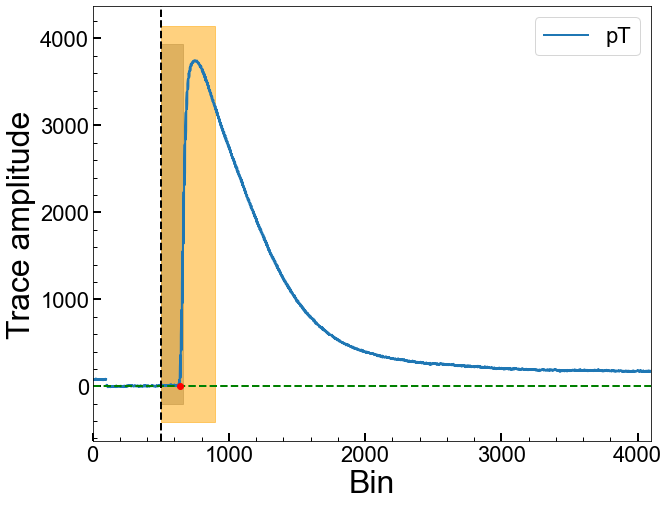

Series Number: 72209162200
Event Number: 5930599
Energy: 21.40179069798 keV
Area: 582156.7553849638


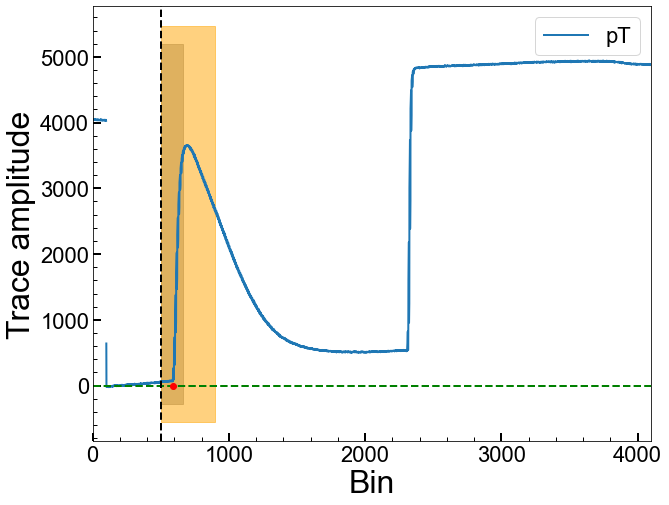

Series Number: 72209162200
Event Number: 5940049
Energy: 38.12098902167 keV
Area: -919808.5179287739


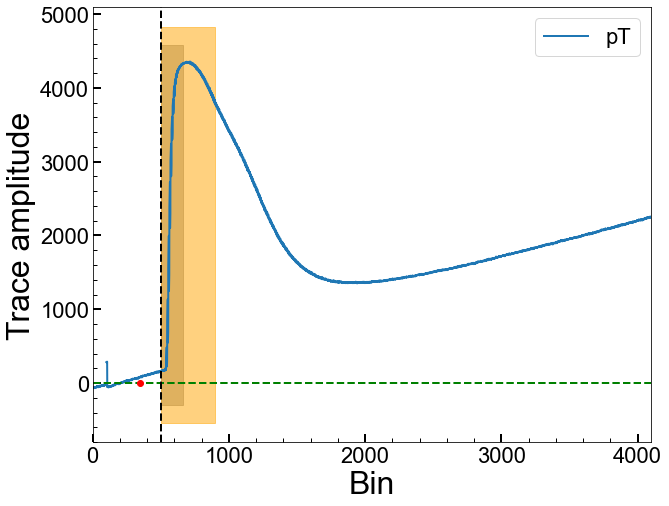

Series Number: 72209162200
Event Number: 5940317
Energy: 16.68996051585 keV
Area: 101575.18449359831


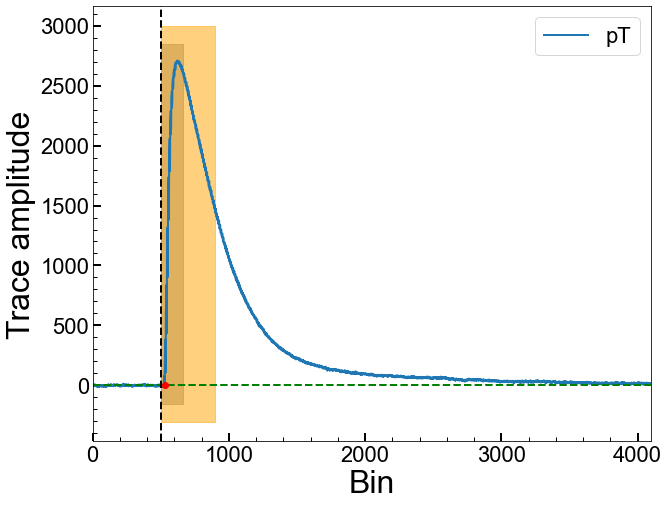

Series Number: 72209162200
Event Number: 5950145
Energy: 3.416368673664 keV
Area: 84236.48346080017


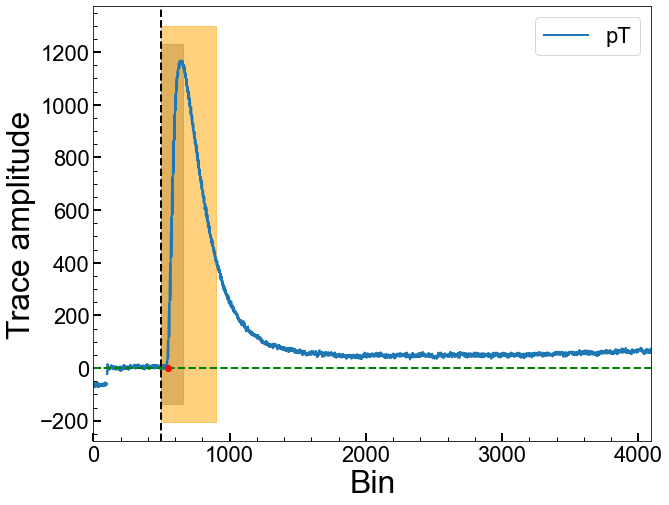

Series Number: 72209162200
Event Number: 5950460
Energy: 45.23014768465 keV
Area: 412933.7538855895


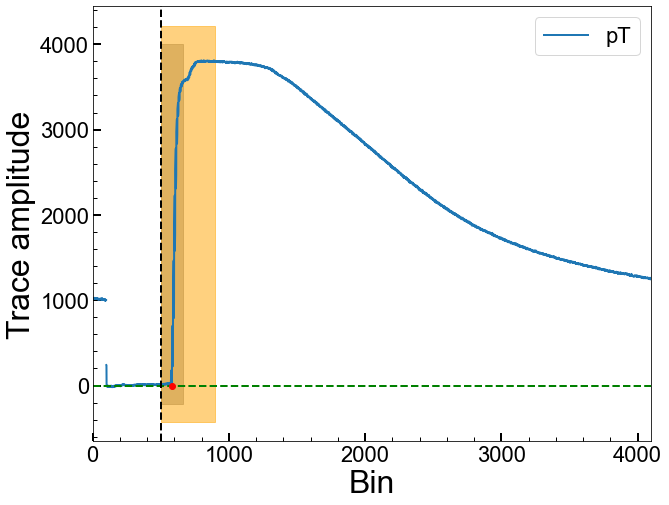

Series Number: 72209162200
Event Number: 5960312
Energy: 44.23948614675 keV
Area: 574666.5971905168


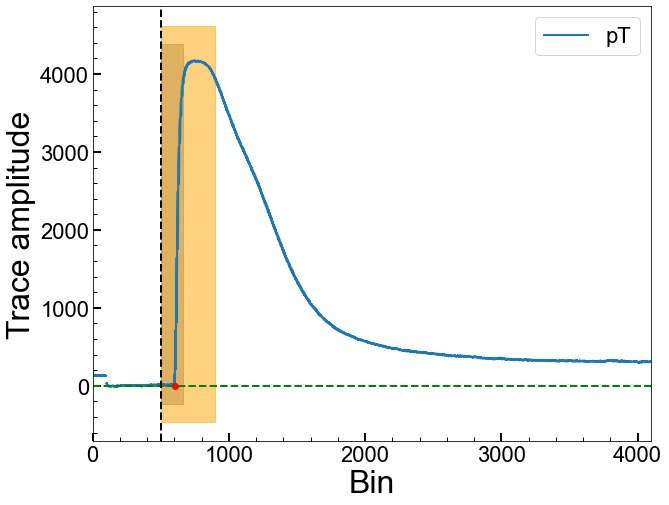

Series Number: 72209162200
Event Number: 5960879
Energy: 21.80663873776 keV
Area: 277289.24694274965


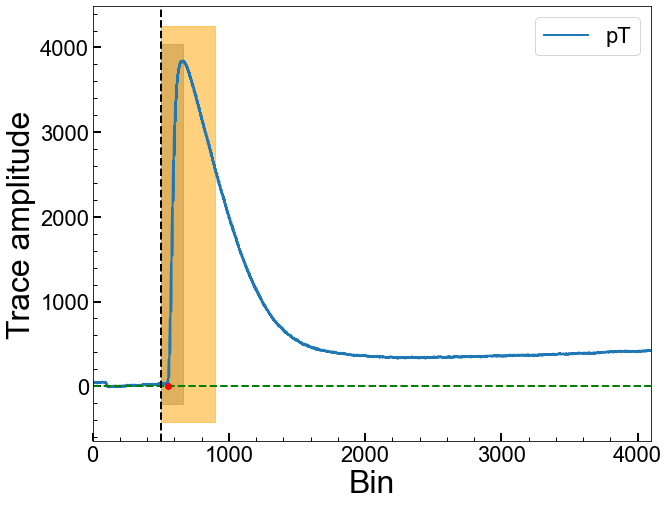

Series Number: 72209162200
Event Number: 6000522
Energy: 10.64594210321 keV
Area: -2853867.3495853078


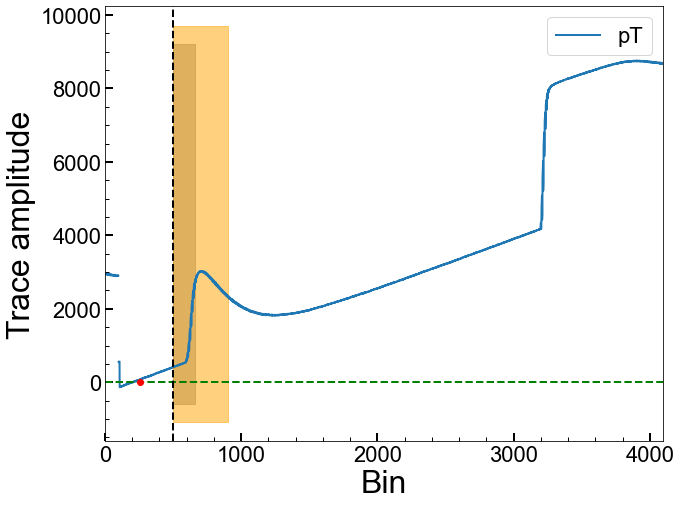

Series Number: 72209162200
Event Number: 6010388
Energy: 37.29845004939 keV
Area: -218169.37396972714


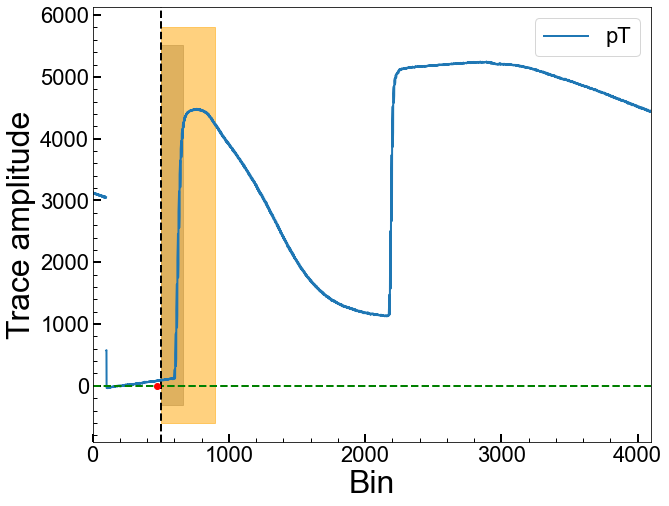

Series Number: 72209162200
Event Number: 6010925
Energy: 32.97992751528 keV
Area: 494179.3487060825


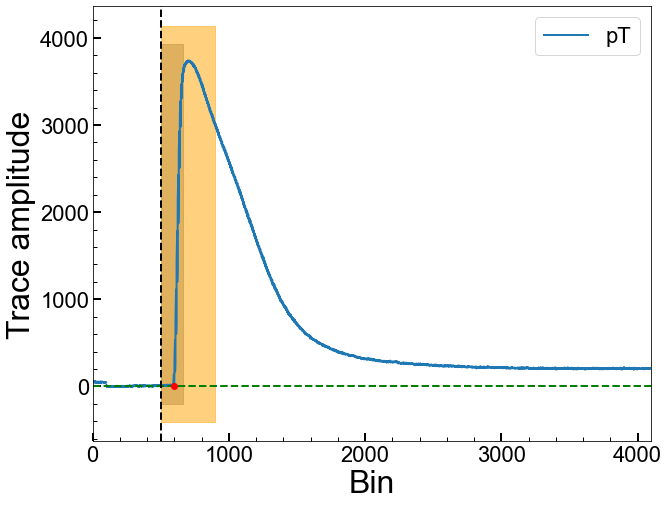

Series Number: 72209162200
Event Number: 6010928
Energy: 41.72131392313 keV
Area: 568115.5297799208


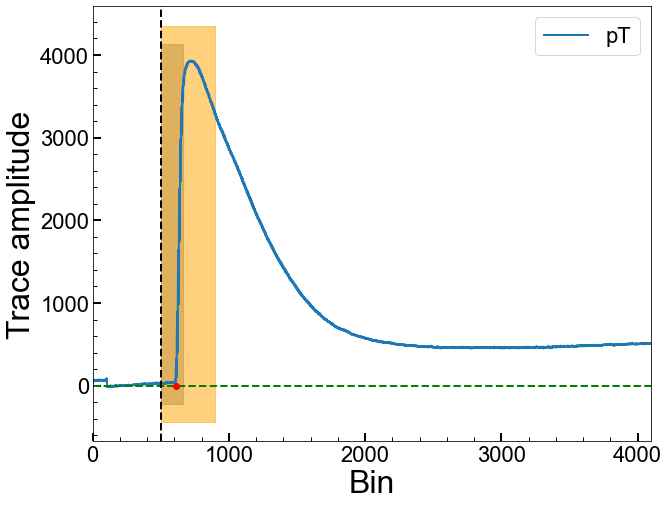

Series Number: 72209162200
Event Number: 6020467
Energy: 11.19189175251 keV
Area: -4306413.3618679885


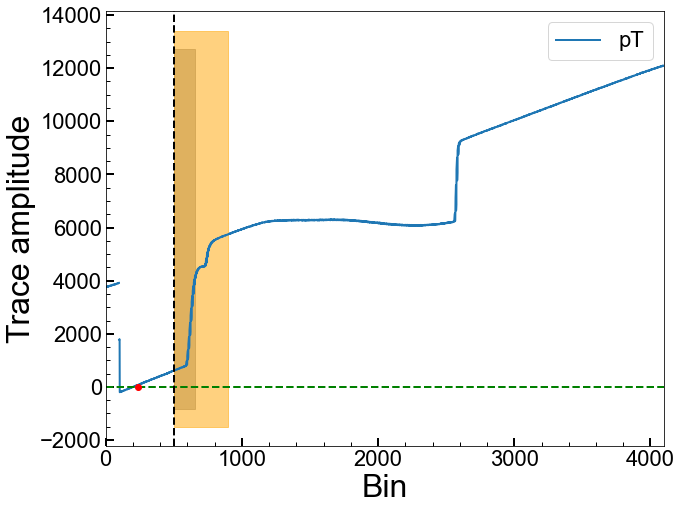

Series Number: 72209162200
Event Number: 6030170
Energy: 2.043175248927 keV
Area: 74904.5657820394


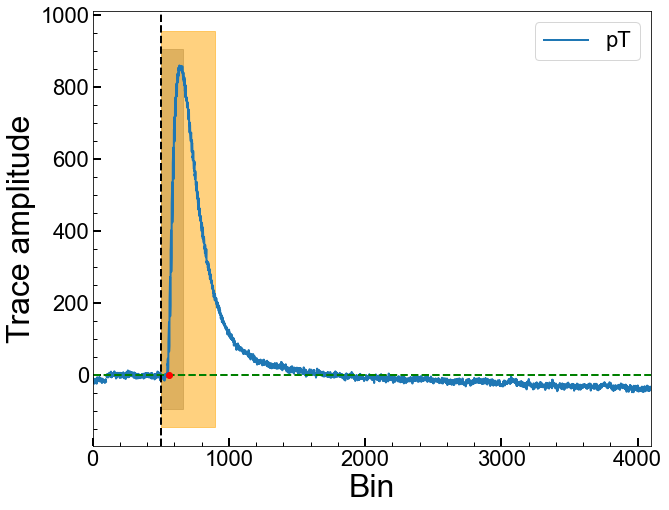

Series Number: 72209162200
Event Number: 6040297
Energy: 39.98567947664 keV
Area: 615052.1436638935


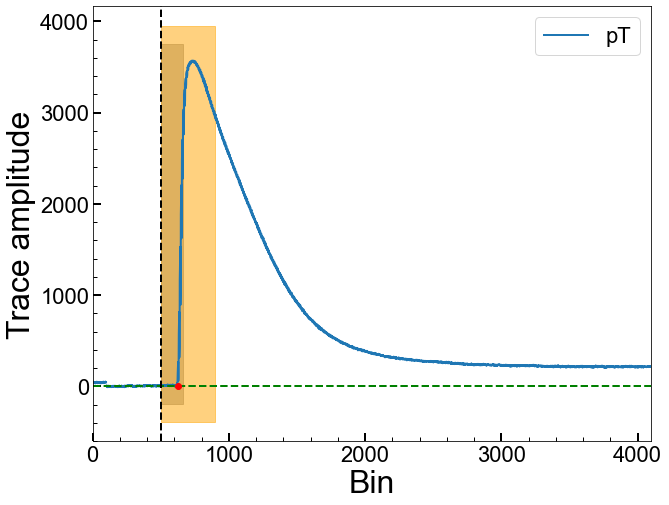

Series Number: 72209162200
Event Number: 6050033
Energy: 35.27750527578 keV
Area: -1103708.6274449015


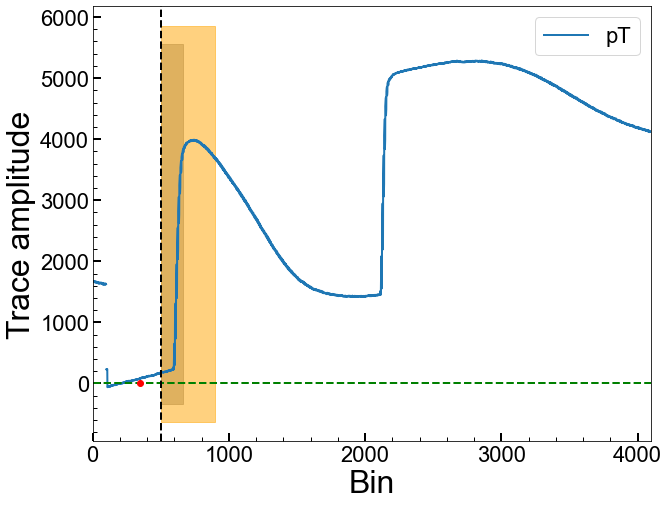

Series Number: 72209162200
Event Number: 6060536
Energy: 23.53722135914 keV
Area: 219860.3129960265


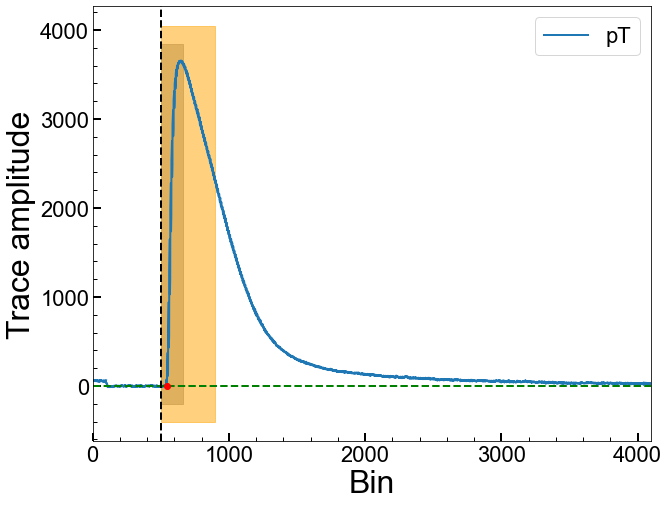

Series Number: 72209162200
Event Number: 6070548
Energy: 20.19460125637 keV
Area: -538357.6798740838


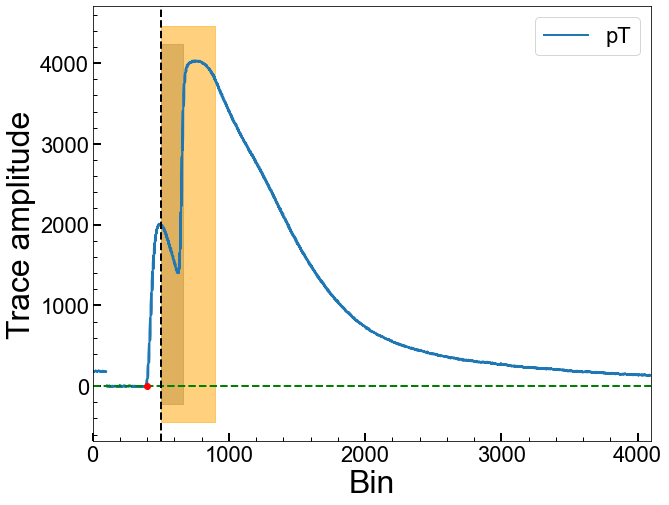

Series Number: 72209162200
Event Number: 6090706
Energy: 45.7306225786 keV
Area: 143930.8327885563


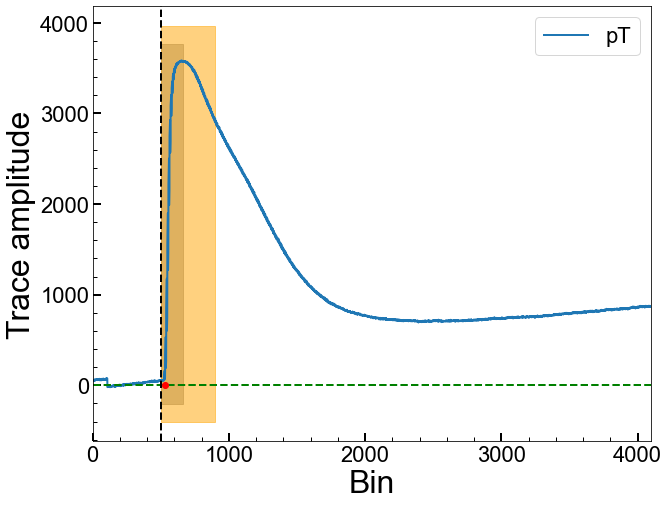

Series Number: 72209162200
Event Number: 6100761
Energy: 7.846144264861 keV
Area: 309786.9237340402


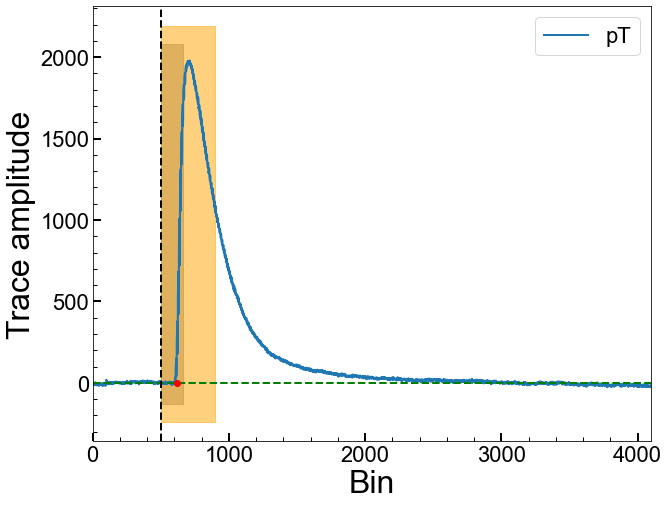

Series Number: 72209162200
Event Number: 6160887
Energy: 23.17755834173 keV
Area: -1516425.4715994482


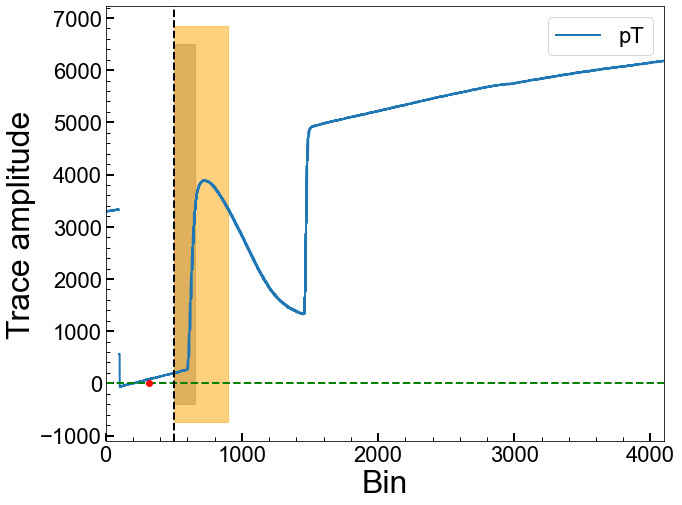

Series Number: 72209162200
Event Number: 6180666
Energy: 30.87174450087 keV
Area: 516923.5573276611


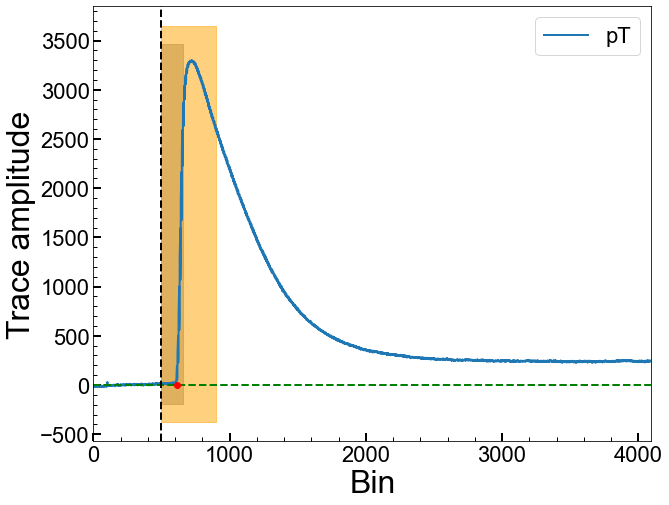

Series Number: 72209162200
Event Number: 6190653
Energy: 17.55174094087 keV
Area: 539706.8942394599


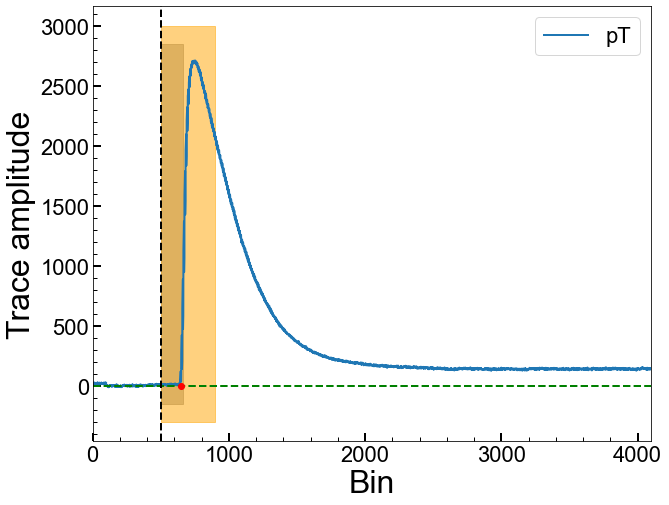

Series Number: 72209162200
Event Number: 6200672
Energy: 47.39710038879 keV
Area: 583195.5448078484


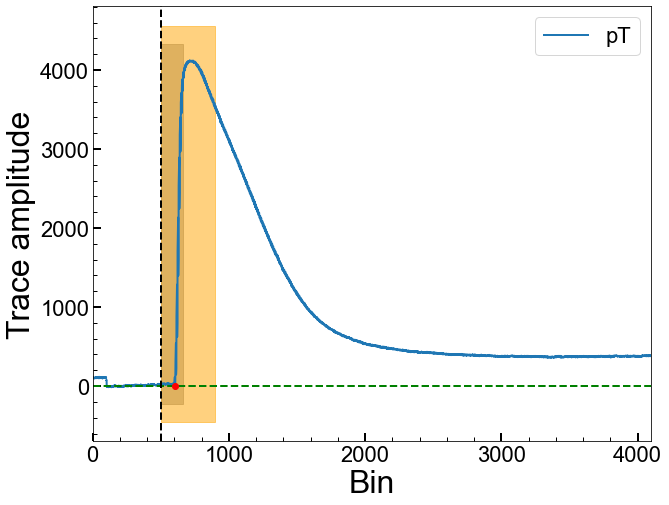

Series Number: 72209162200
Event Number: 6230832
Energy: 45.64817568418 keV
Area: -1832923.4668552943


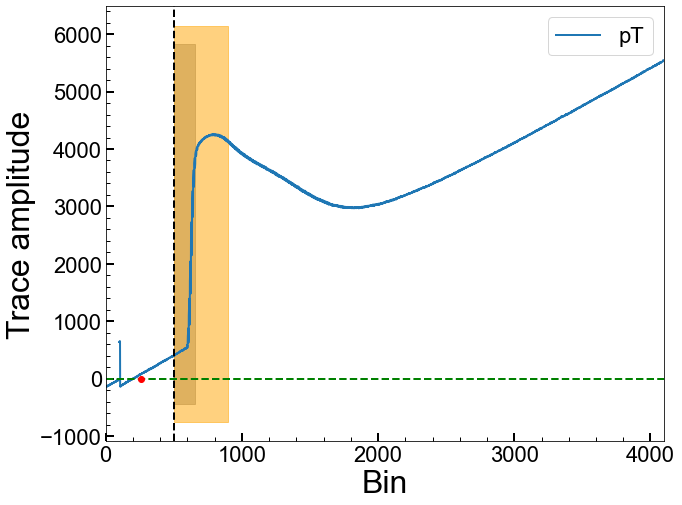

Series Number: 72209162200
Event Number: 6250159
Energy: 31.432650689 keV
Area: 617441.1264052982


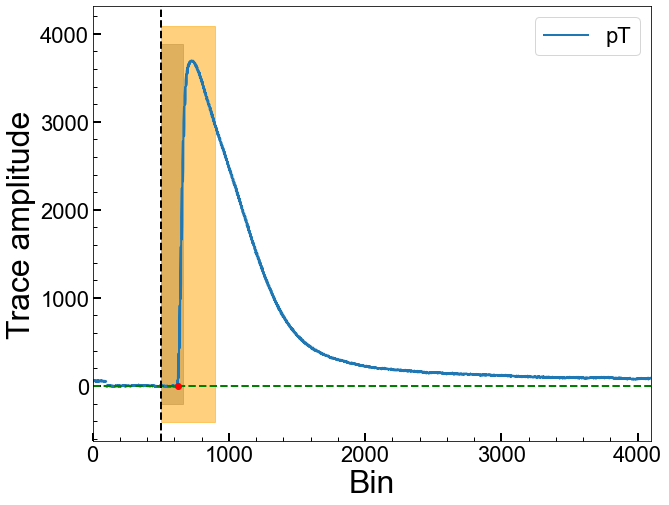

Series Number: 72209162200
Event Number: 6260309
Energy: 40.94944819838 keV
Area: 348886.6241538261


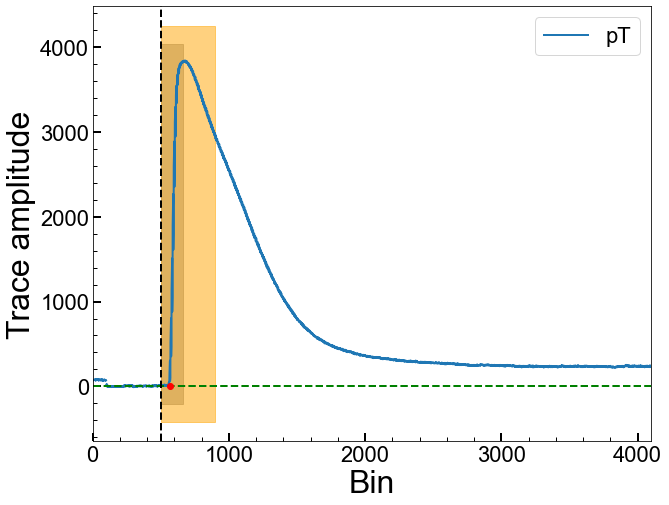

Series Number: 72209162200
Event Number: 6260529
Energy: 21.06584965055 keV
Area: 638068.3184219304


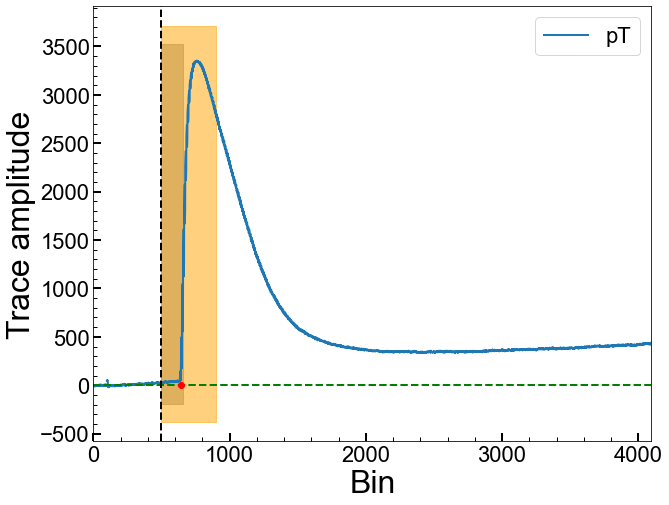

Series Number: 72209162200
Event Number: 6260592
Energy: 33.18928232341 keV
Area: 190040.55189021459


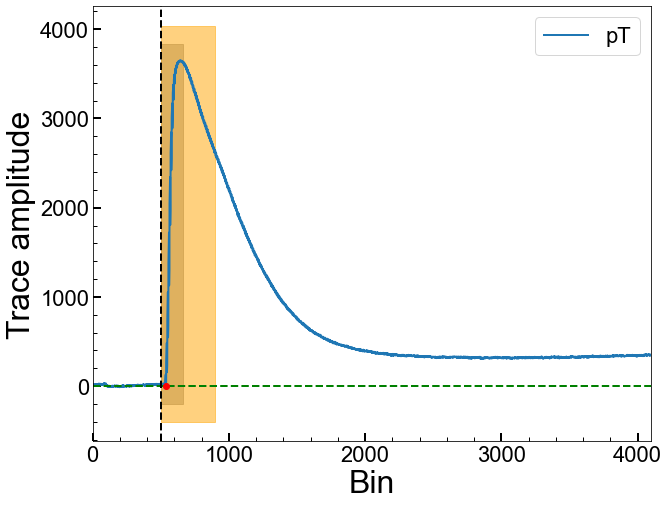

Series Number: 72209162200
Event Number: 6300112
Energy: 19.05171184489 keV
Area: 505878.72097163985


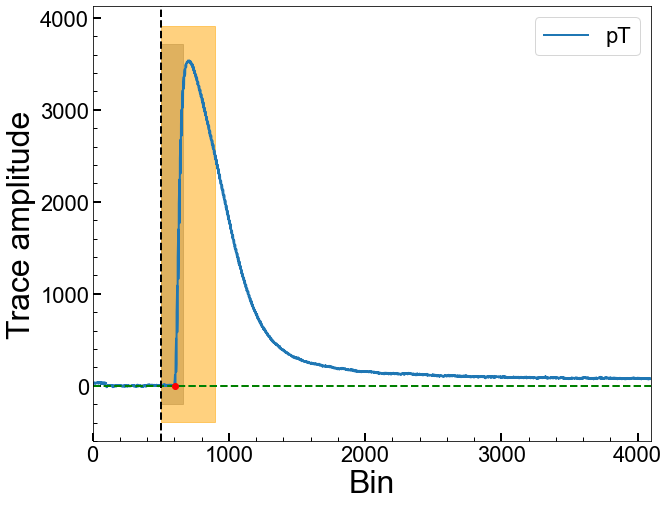

Series Number: 72209162200
Event Number: 6300262
Energy: 48.2197108645 keV
Area: 118644.79026467996


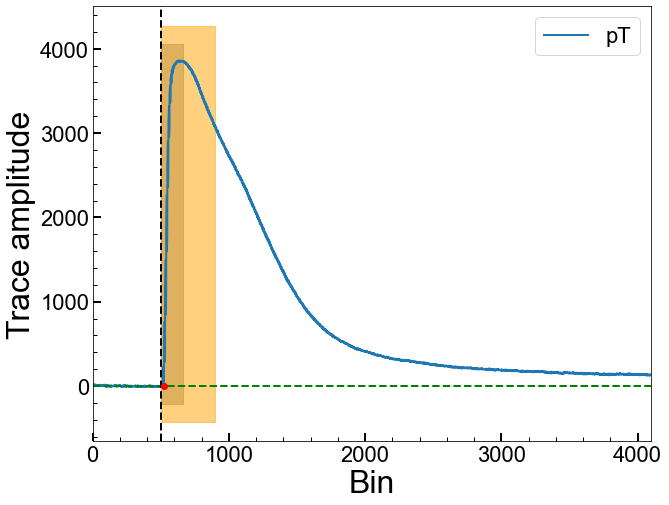

Series Number: 72209162200
Event Number: 6300457
Energy: 24.88910813262 keV
Area: -4251924.149108976


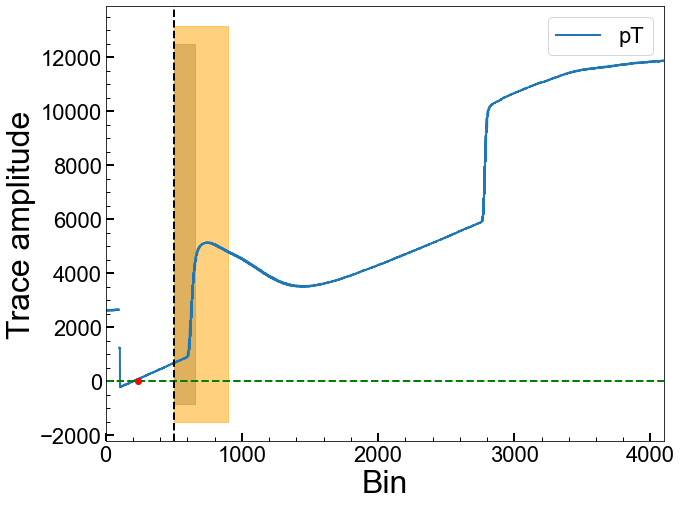

Series Number: 72209162200
Event Number: 6330250
Energy: 36.1387729267 keV
Area: 211891.81520529804


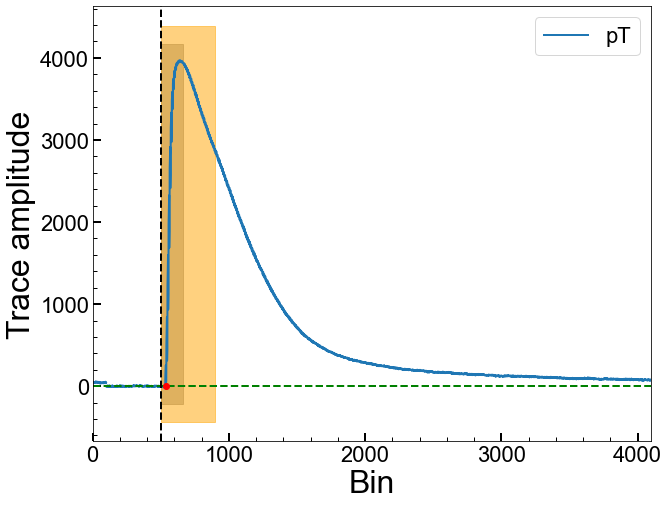

Series Number: 72209162200
Event Number: 6360093
Energy: 42.31639529197 keV
Area: 131498.75534662255


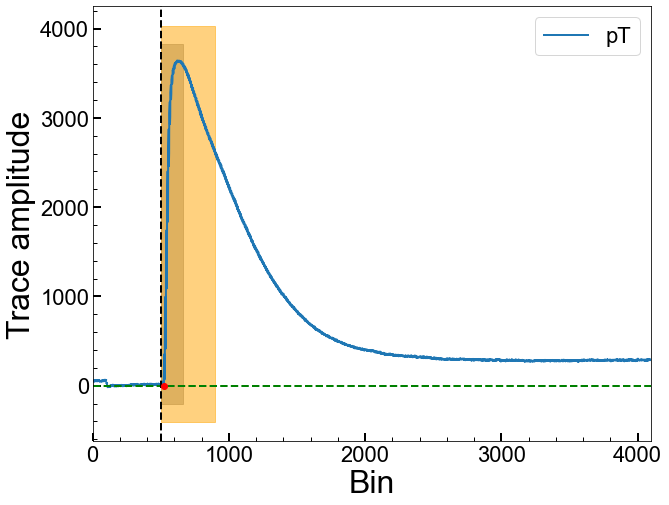

Series Number: 72209162200
Event Number: 6370722
Energy: 49.74105325663 keV
Area: 484117.70668450324


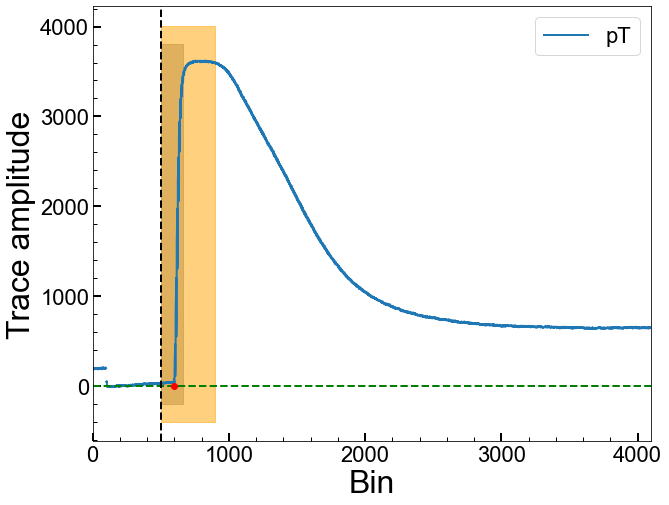

Series Number: 72209162200
Event Number: 6390081
Energy: 48.42591159762 keV
Area: 178954.29851161156


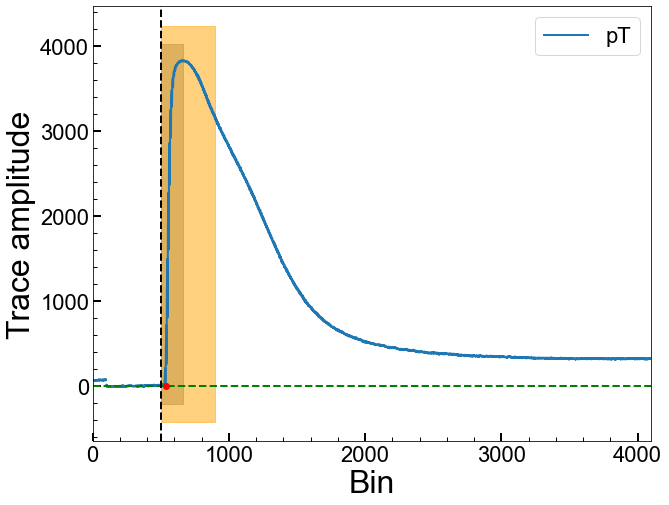

Series Number: 72209162200
Event Number: 6390609
Energy: 49.30725181531 keV
Area: 846604.2711114103


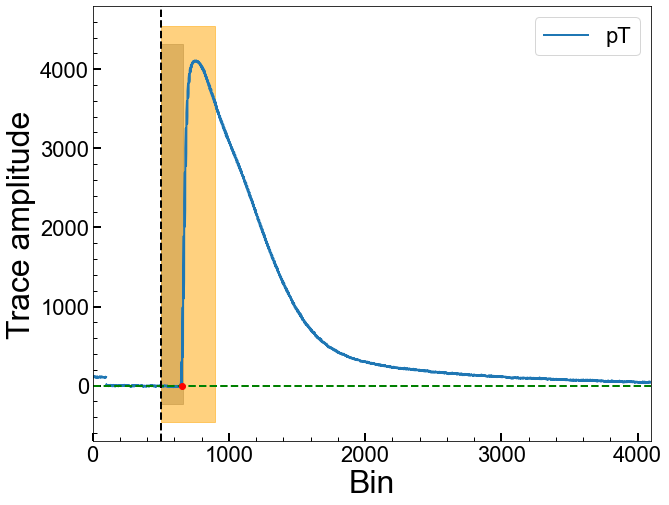

Series Number: 72209162200
Event Number: 6420460
Energy: 44.59766849622 keV
Area: 581217.7899231365


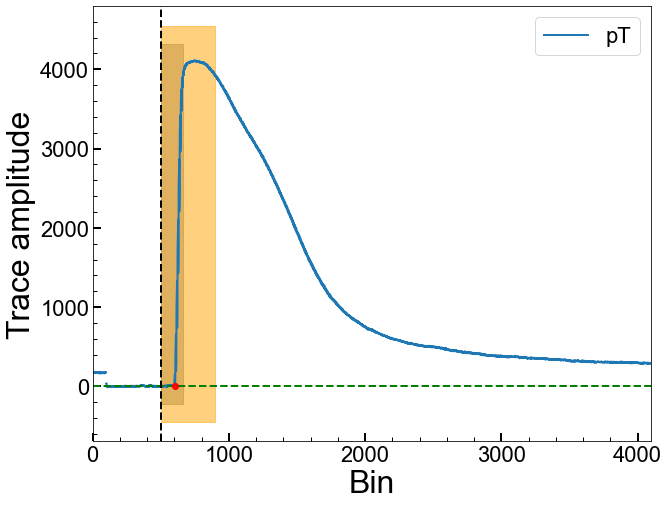

Series Number: 72209162200
Event Number: 6450101
Energy: 22.43556757204 keV
Area: 569856.6004787283


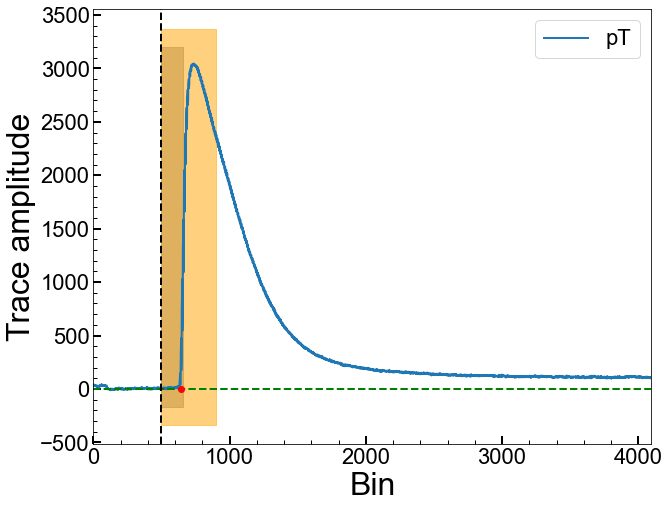

Series Number: 72209162200
Event Number: 6450538
Energy: 17.7191651284 keV
Area: 138852.10150018547


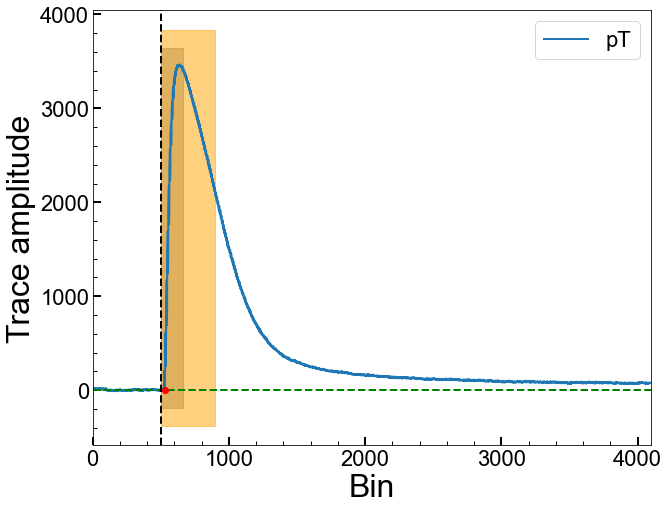

Series Number: 72209162200
Event Number: 6460652
Energy: 14.91902825929 keV
Area: -7541043.236226752


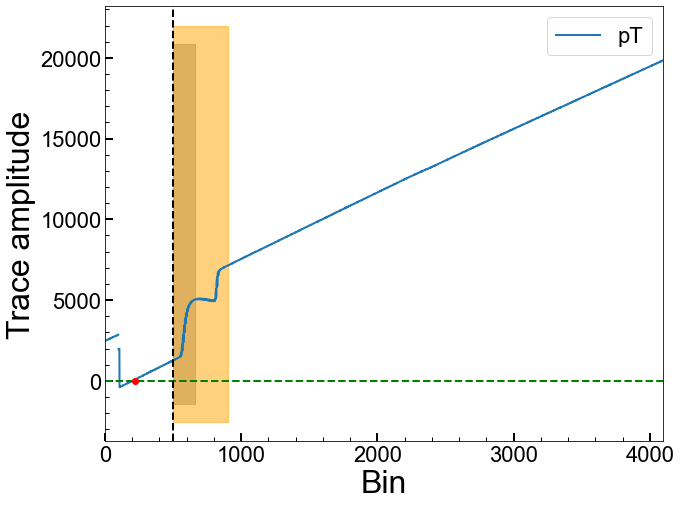

Series Number: 72209162200
Event Number: 6470790
Energy: 48.37486061023 keV
Area: -6482400.495565489


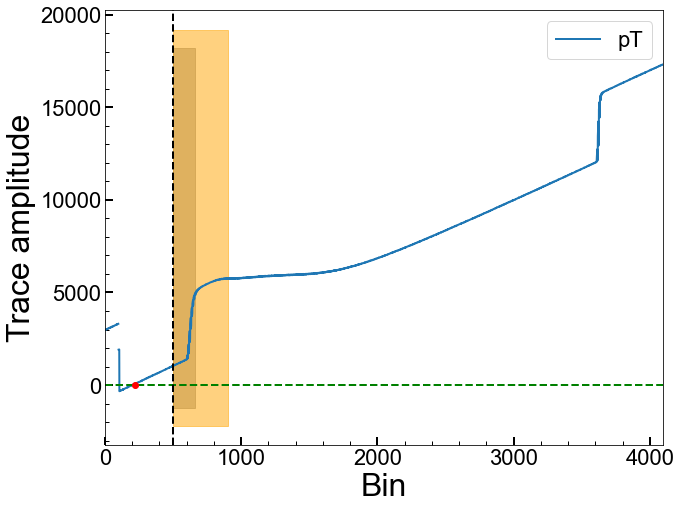

Series Number: 72209162200
Event Number: 6480454
Energy: 42.55089627324 keV
Area: 570674.3339333935


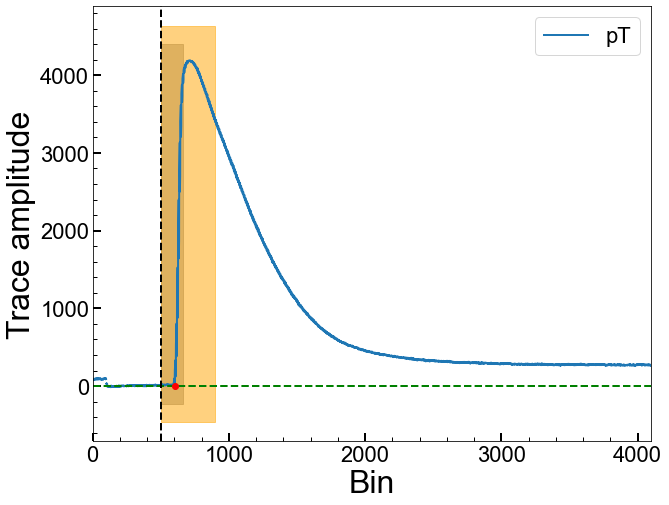

Series Number: 72209162200
Event Number: 6480512
Energy: 16.64088655929 keV
Area: 165916.1212761572


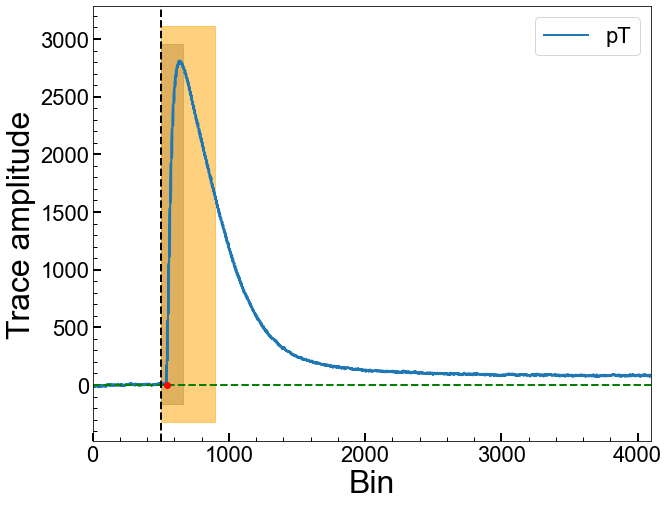

Series Number: 72209162200
Event Number: 6480647
Energy: 12.48629410187 keV
Area: 0.0


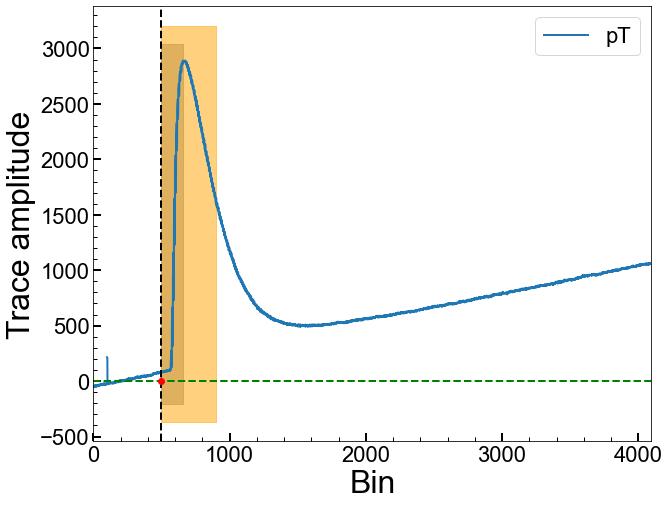

Series Number: 72209162200
Event Number: 6500693
Energy: 30.08241768202 keV
Area: 492730.5756135733


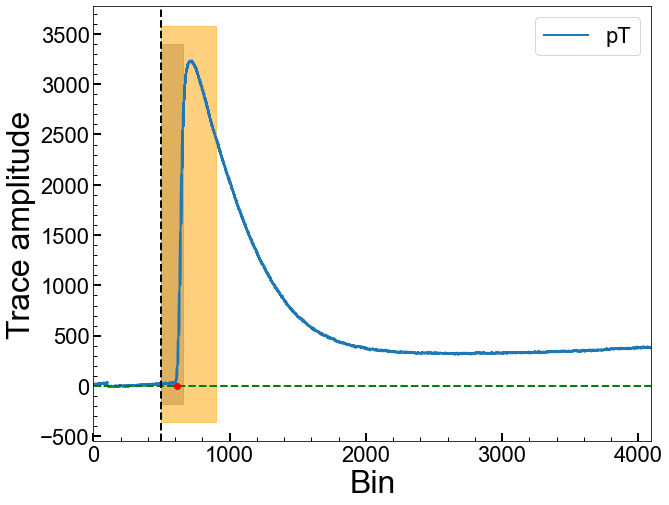

Series Number: 72209162200
Event Number: 6510621
Energy: 14.05677891472 keV
Area: 533902.256508609


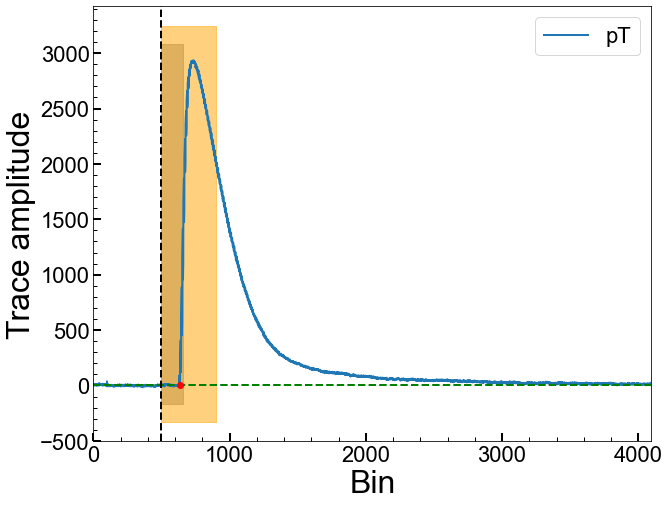

Series Number: 72209162200
Event Number: 6520396
Energy: 2.744137099598 keV
Area: 130663.70600858348


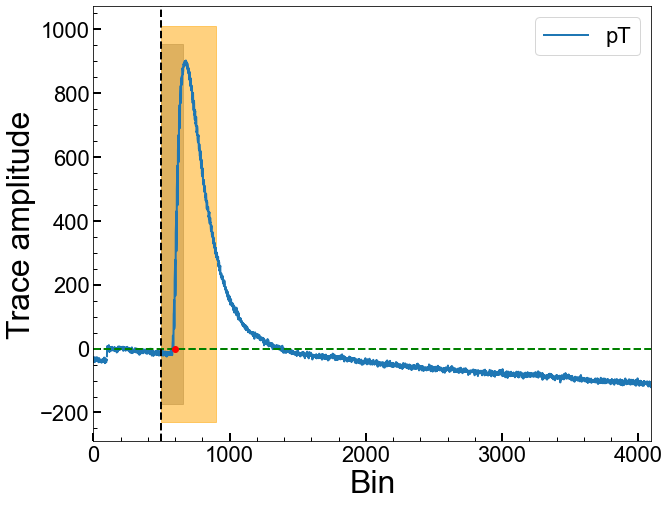

Series Number: 72209162200
Event Number: 6520675
Energy: 21.71992470163 keV
Area: 381752.1287713945


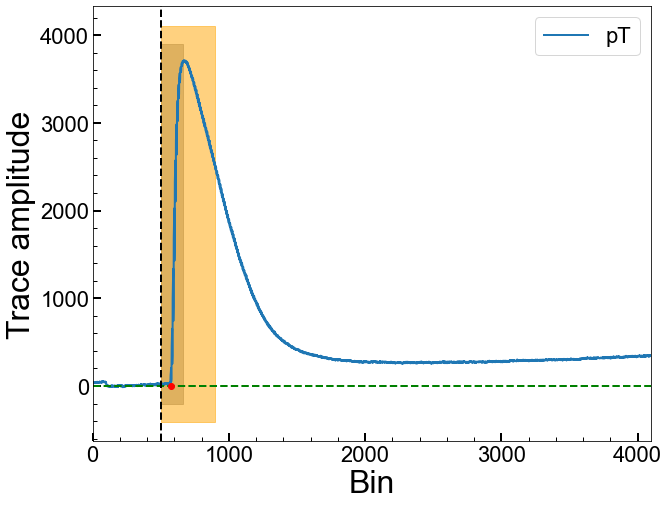

Series Number: 72209162200
Event Number: 6530178
Energy: 12.91075301433 keV
Area: 414112.83913990326


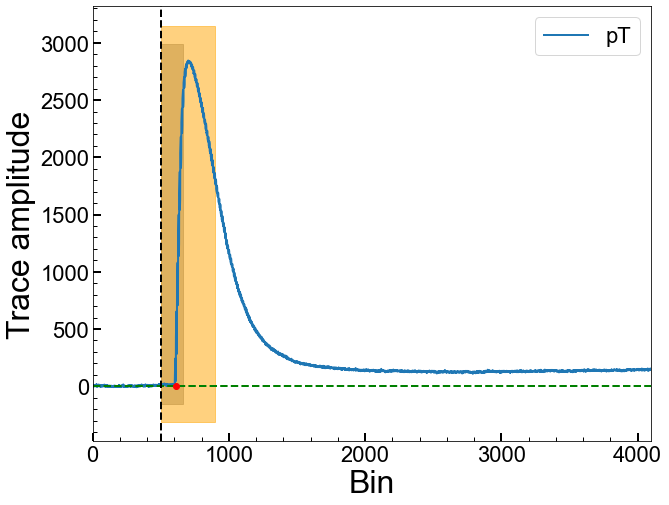

Series Number: 72209162200
Event Number: 6540405
Energy: 5.932004747529 keV
Area: 169106.2251724939


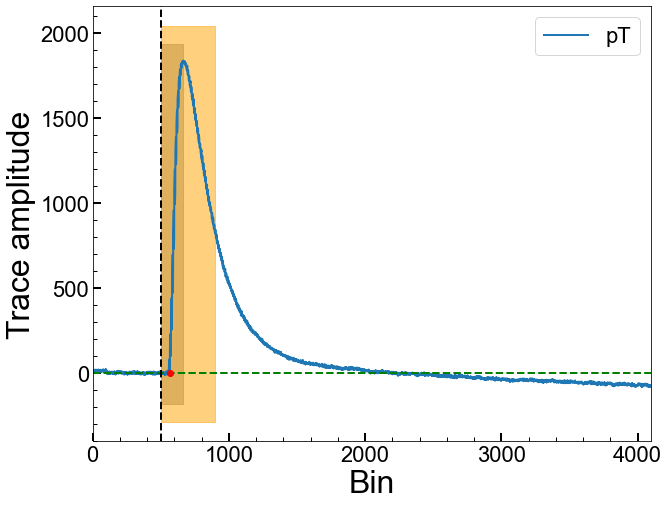

Series Number: 72209162200
Event Number: 6570296
Energy: 38.59146520713 keV
Area: -2021656.3022123338


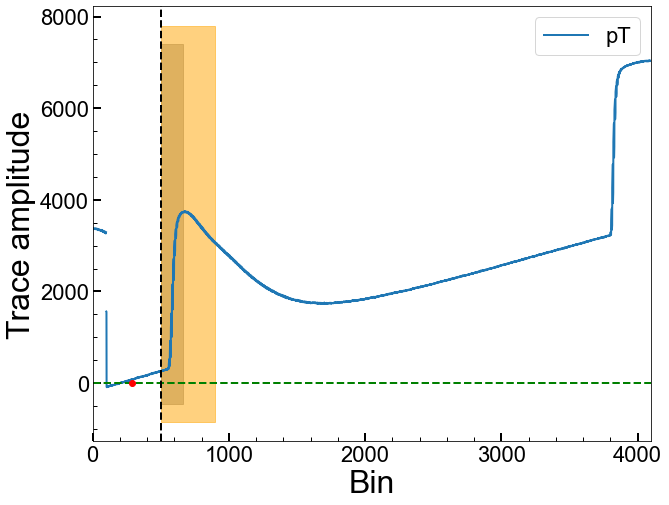

Series Number: 72209162200
Event Number: 6600840
Energy: 37.13851257746 keV
Area: 566270.1121599296


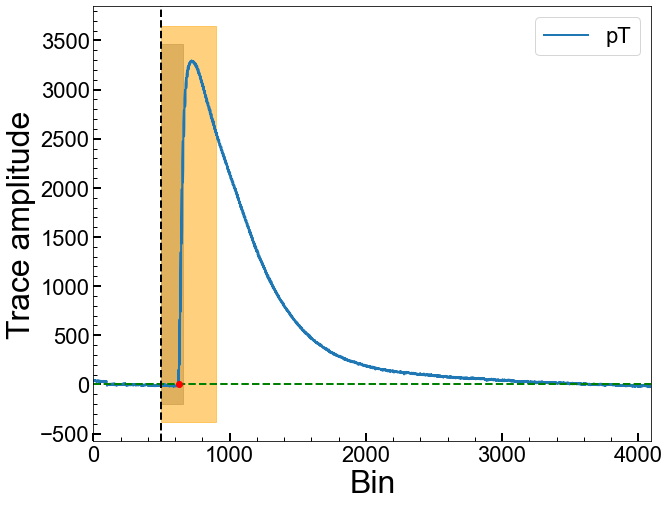

Series Number: 72209162200
Event Number: 6610717
Energy: 40.23007378752 keV
Area: -1836893.8765097982


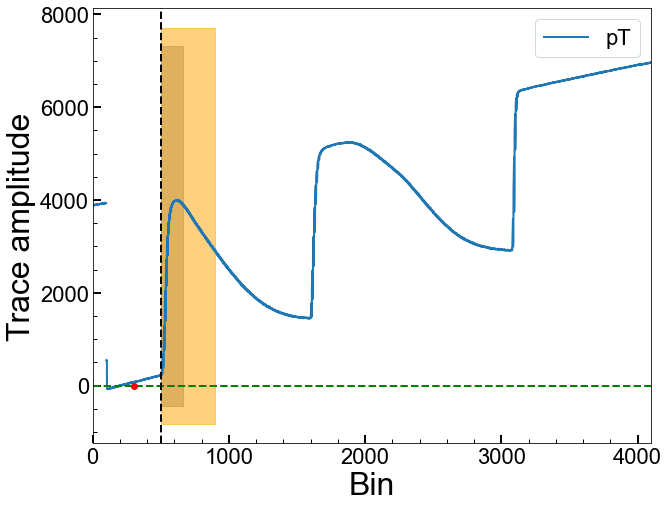

Series Number: 72209162200
Event Number: 6620121
Energy: 32.46921354937 keV
Area: 504841.5318514845


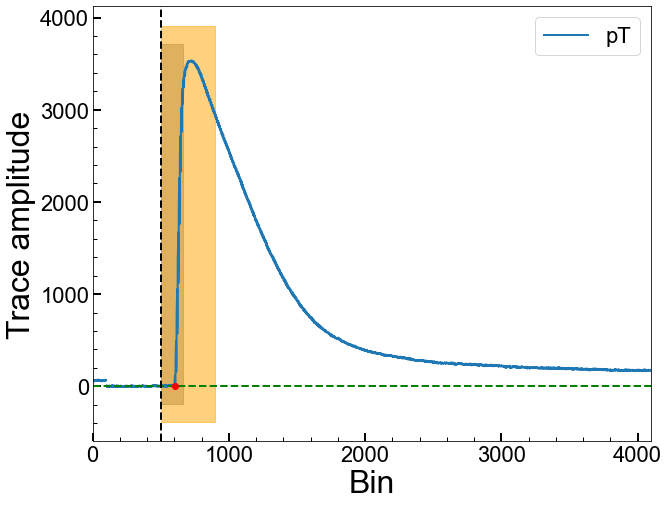

Series Number: 72209162200
Event Number: 6670003
Energy: 10.26453129516 keV
Area: 345093.26072747505


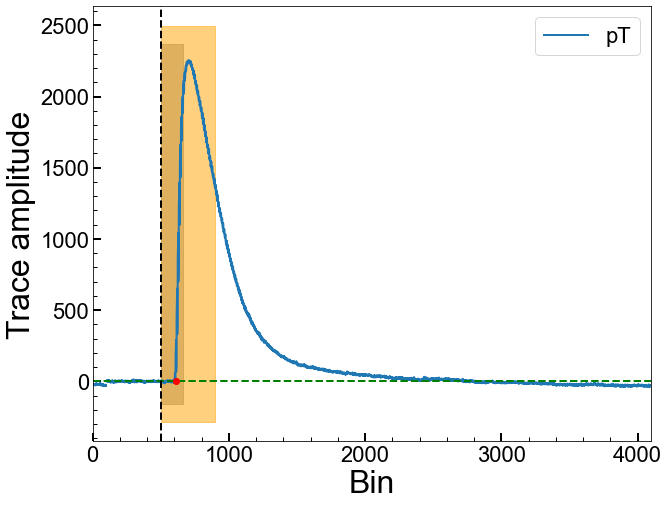

Series Number: 72209162200
Event Number: 6680267
Energy: 35.06589928329 keV
Area: 794017.7707072851


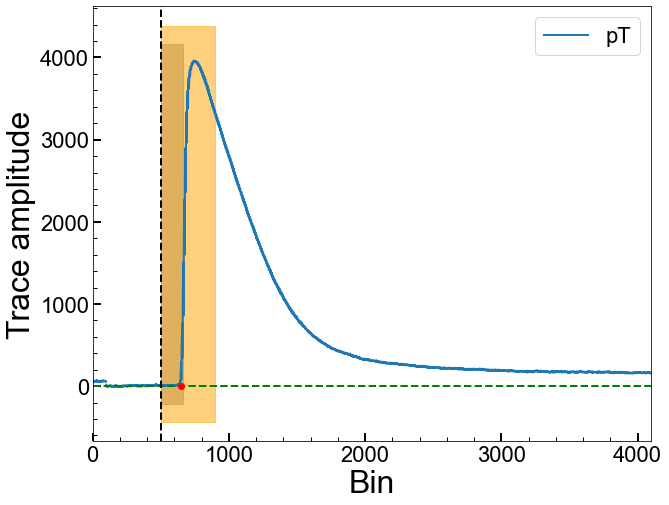

Series Number: 72209162200
Event Number: 6690269
Energy: 14.87687735558 keV
Area: 37112.46875396027


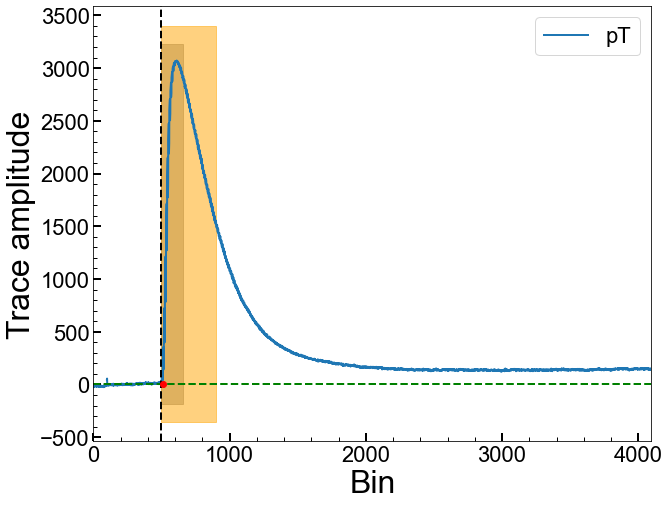

Series Number: 72209162200
Event Number: 6790651
Energy: 19.8352587805 keV
Area: 519245.4499404504


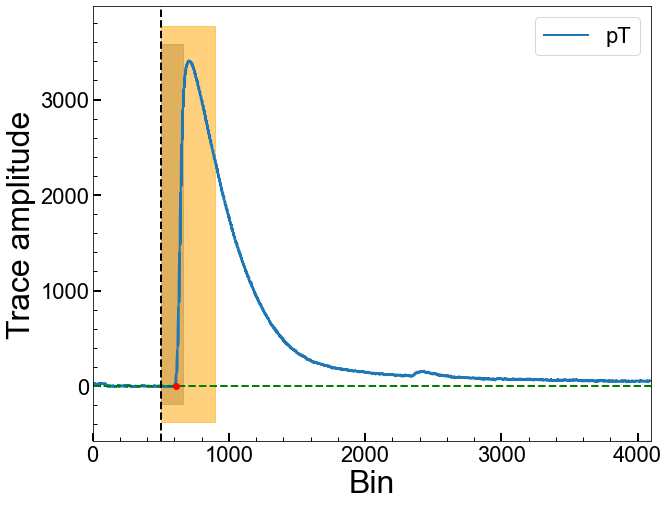

Series Number: 72209162200
Event Number: 6820540
Energy: 35.47041010742 keV
Area: 650504.5773005564


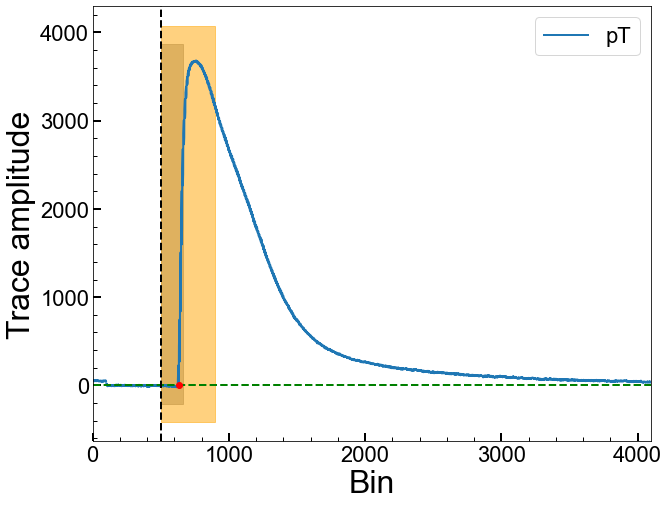

Series Number: 72209162200
Event Number: 6820549
Energy: 14.55882936696 keV
Area: -580749.1473006192


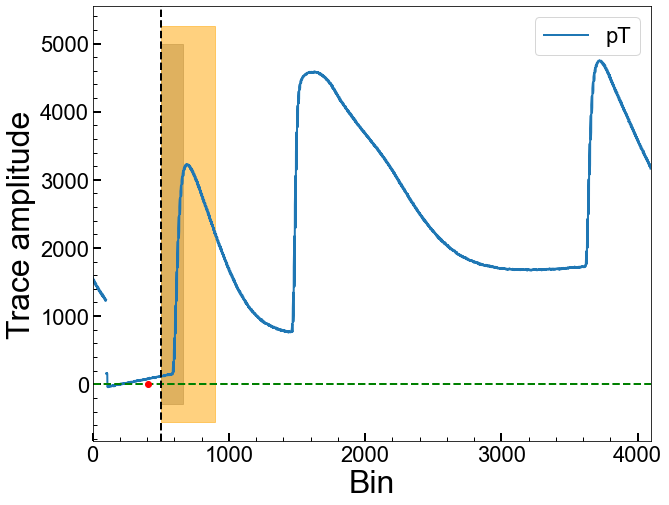

Series Number: 72209162200
Event Number: 6830112
Energy: 23.21451278727 keV
Area: 527009.8793753115


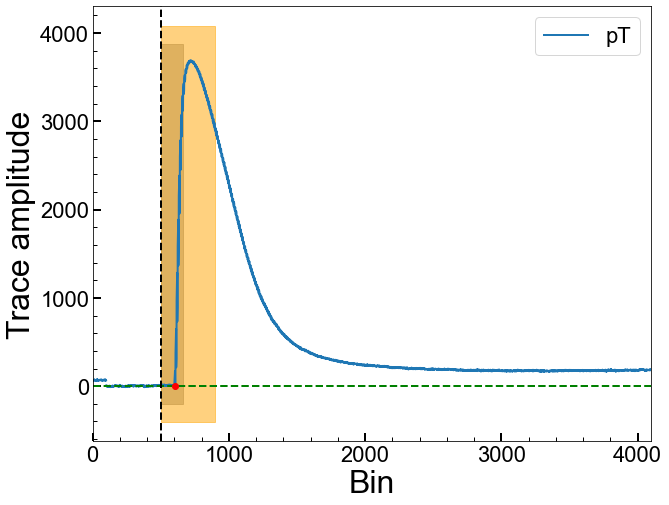

Series Number: 72209162200
Event Number: 6840477
Energy: 32.1214676756 keV
Area: 560114.5696642965


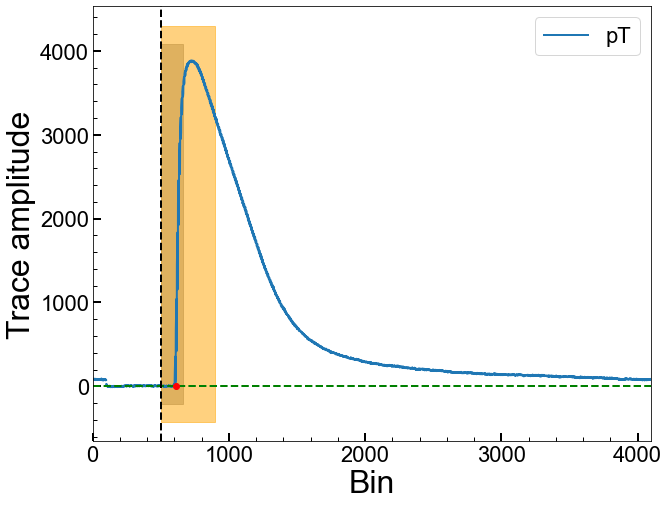

Series Number: 72209162200
Event Number: 6850091
Energy: 18.27409743711 keV
Area: 100993.93072212276


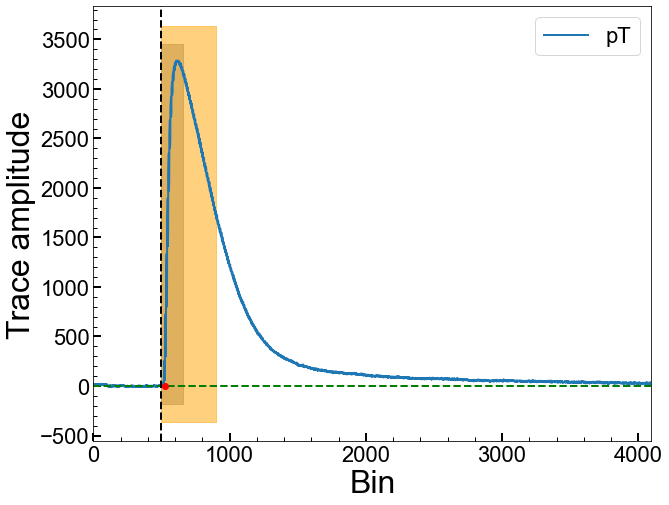

Series Number: 72209162200
Event Number: 6870364
Energy: 26.46698639758 keV
Area: 459844.5645604842


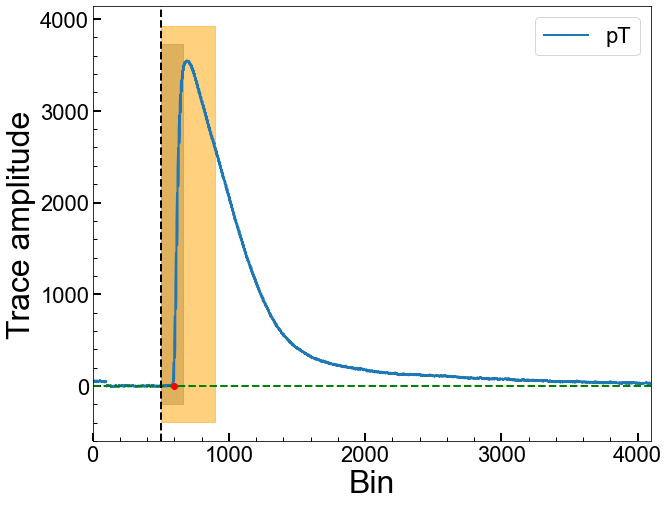

Series Number: 72209162200
Event Number: 6890796
Energy: 29.46500217767 keV
Area: 582793.6129560269


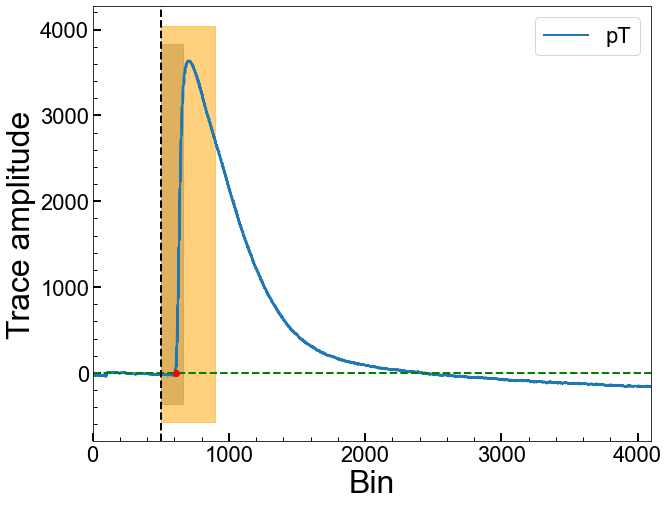

Series Number: 72209162200
Event Number: 6900709
Energy: 11.61211096415 keV
Area: 257995.98861700666


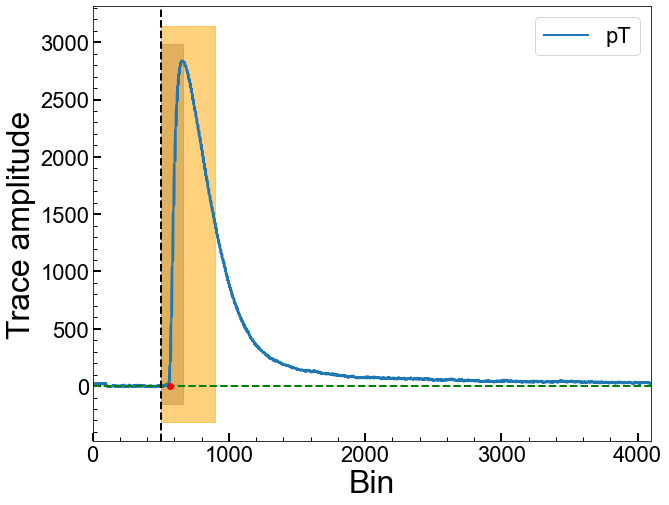

Series Number: 72209162200
Event Number: 6920120
Energy: 32.19497255072 keV
Area: 58148.42799436293


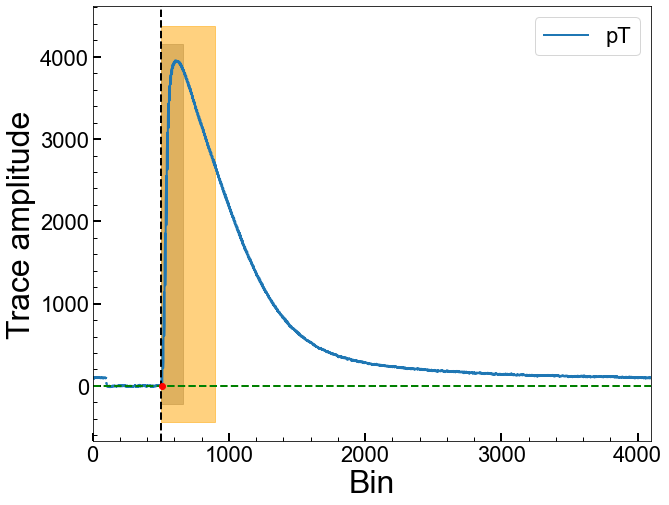

Series Number: 72209162200
Event Number: 6930072
Energy: 17.80202405714 keV
Area: 625656.5917267146


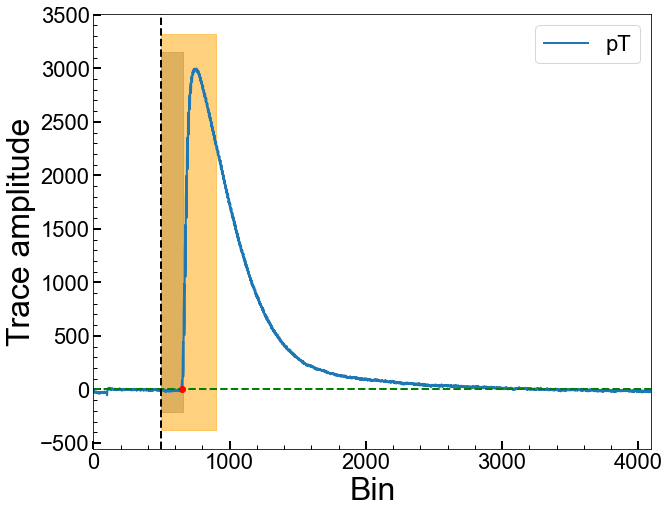

Series Number: 72209162200
Event Number: 6930256
Energy: 19.57745840719 keV
Area: 273595.2148017802


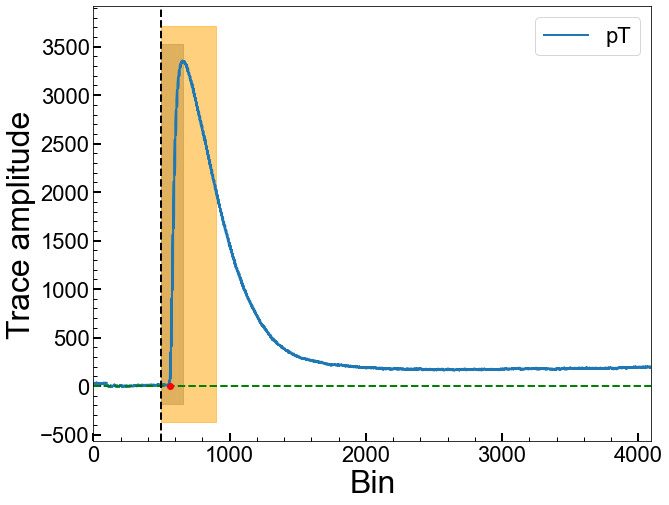

Series Number: 72209162200
Event Number: 6930347
Energy: 18.30949981778 keV
Area: 234358.48519007518


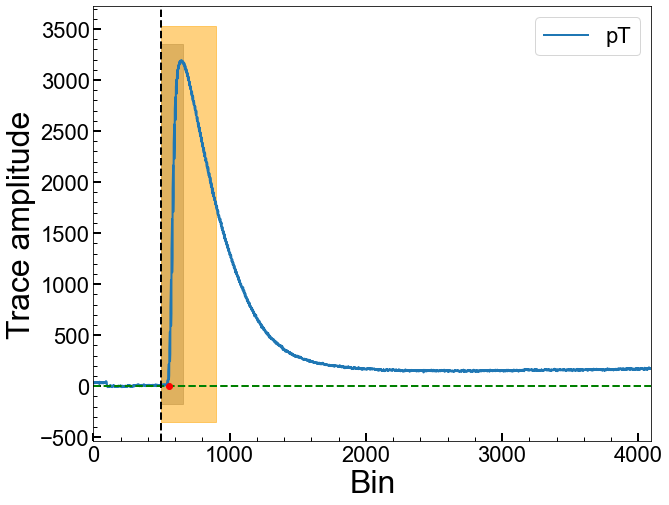

Series Number: 72209162200
Event Number: 6930380
Energy: 18.80191310765 keV
Area: 336266.49271532014


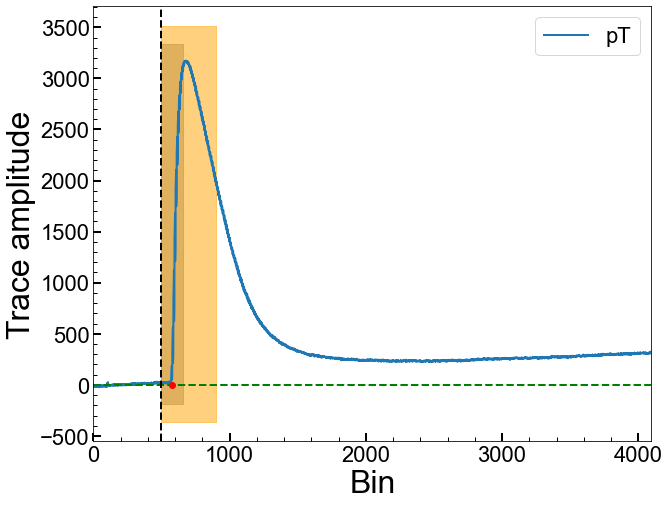

Series Number: 72209162200
Event Number: 6950169
Energy: 40.45367054064 keV
Area: 214280.56642674436


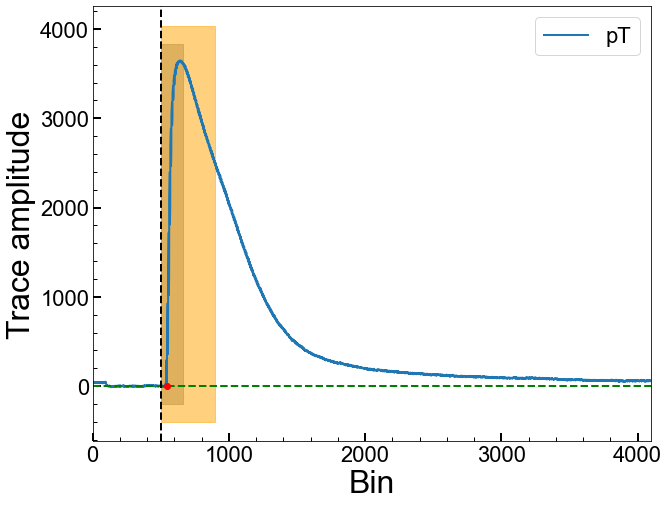

Series Number: 72209162200
Event Number: 6990690
Energy: 9.501200942748 keV
Area: 73260.41019638153


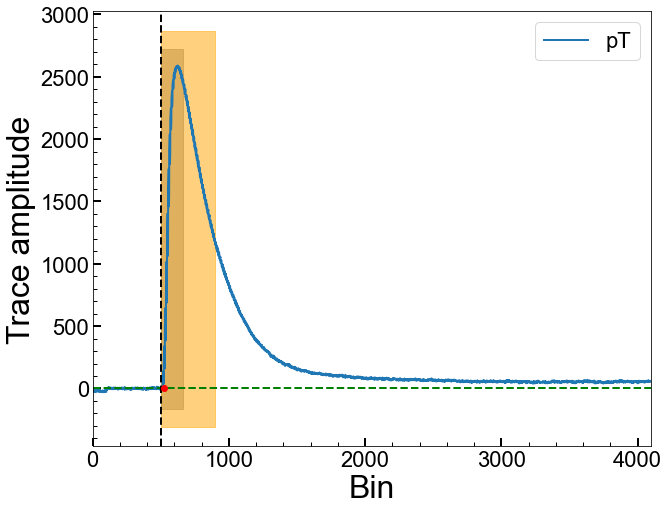

Series Number: 72209162200
Event Number: 7000712
Energy: 29.71969733525 keV
Area: 338456.1866401749


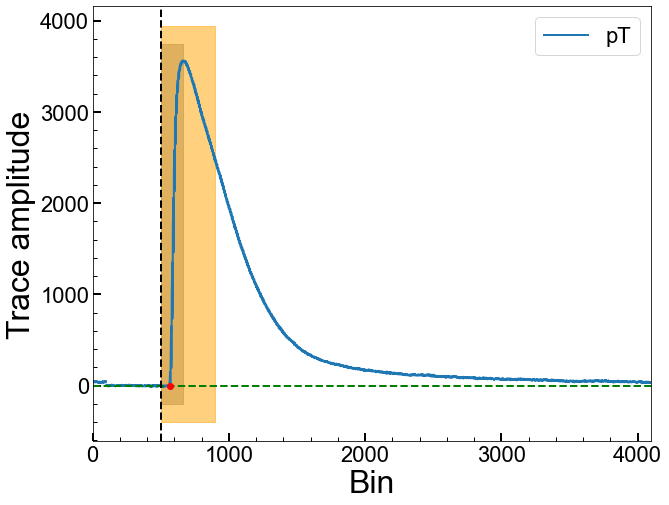

Series Number: 72209162200
Event Number: 7000910
Energy: 38.34920513826 keV
Area: 517669.08101069165


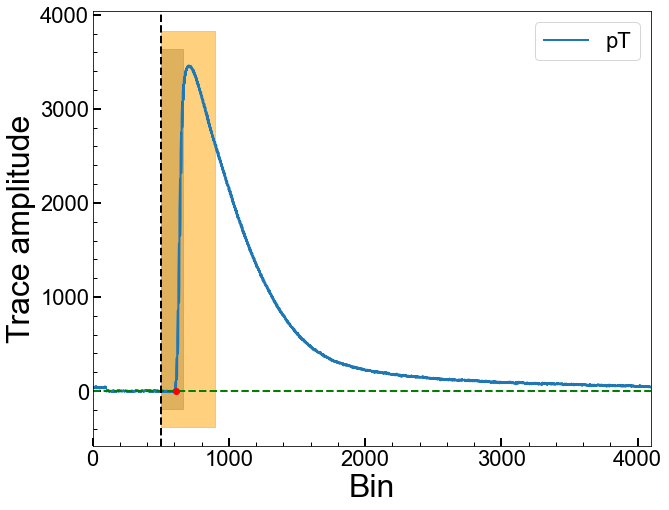

Series Number: 72209162200
Event Number: 7010861
Energy: 33.8521322106 keV
Area: 514252.1876235868


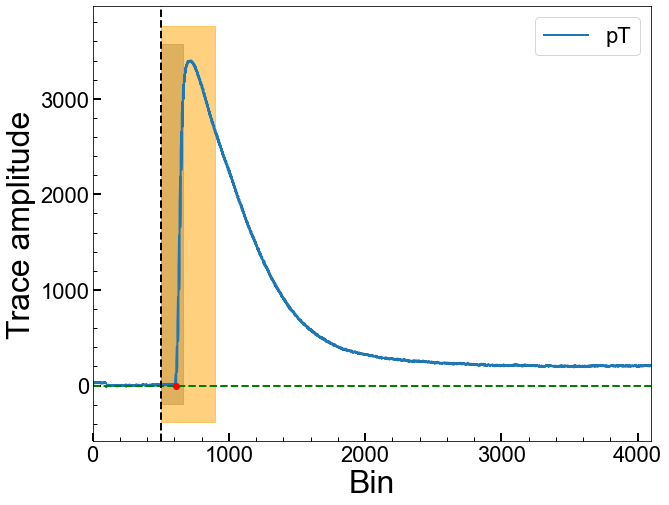

Series Number: 72209162200
Event Number: 7010921
Energy: 20.6306452594 keV
Area: 447668.3637086093


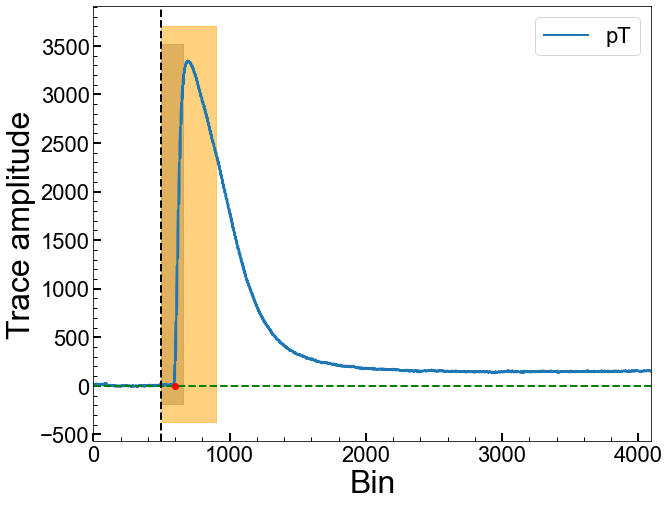

Series Number: 72209162200
Event Number: 7020059
Energy: 30.42461169865 keV
Area: 568193.1426640796


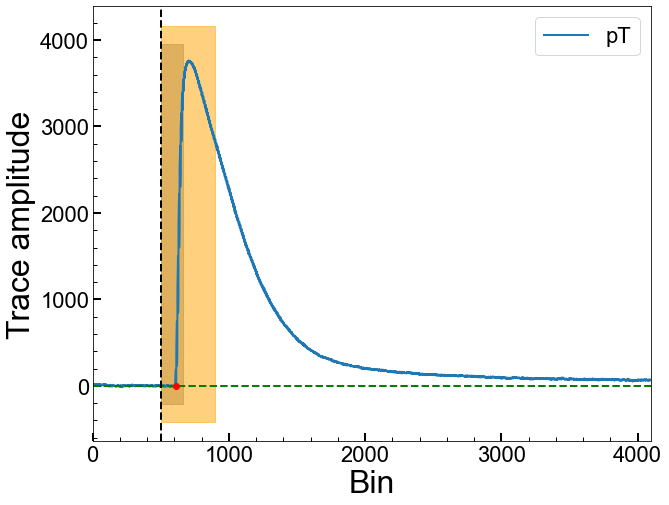

Series Number: 72209162200
Event Number: 7020256
Energy: 22.07939746134 keV
Area: 278239.05486103316


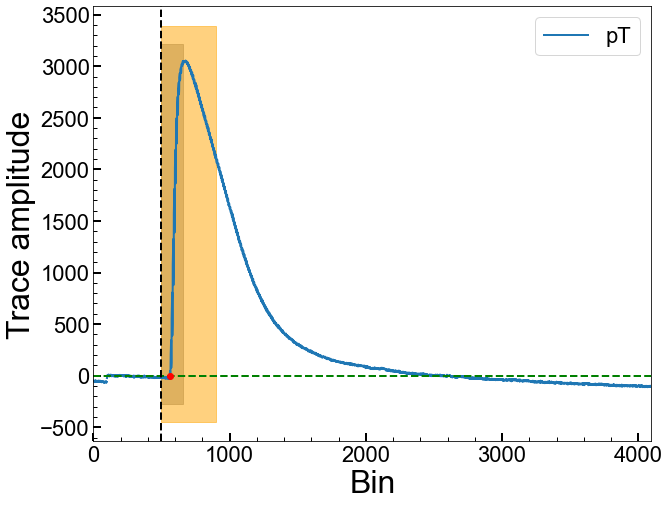

Series Number: 72209162200
Event Number: 7030705
Energy: 36.22606959791 keV
Area: 489585.4254342357


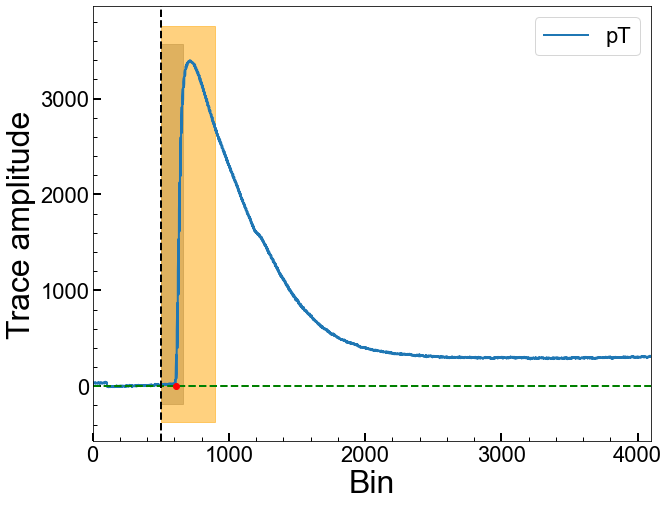

Series Number: 72209162200
Event Number: 7060275
Energy: 20.50052793595 keV
Area: 472410.19472105964


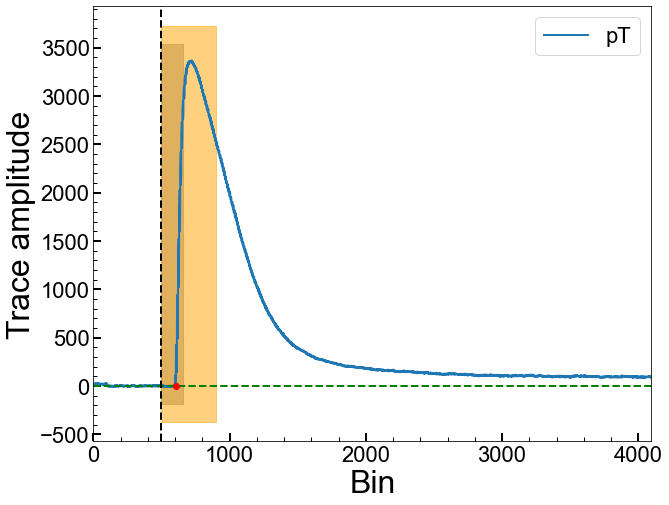

Series Number: 72209162200
Event Number: 7080841
Energy: 13.1348736938 keV
Area: 757364.1219180718


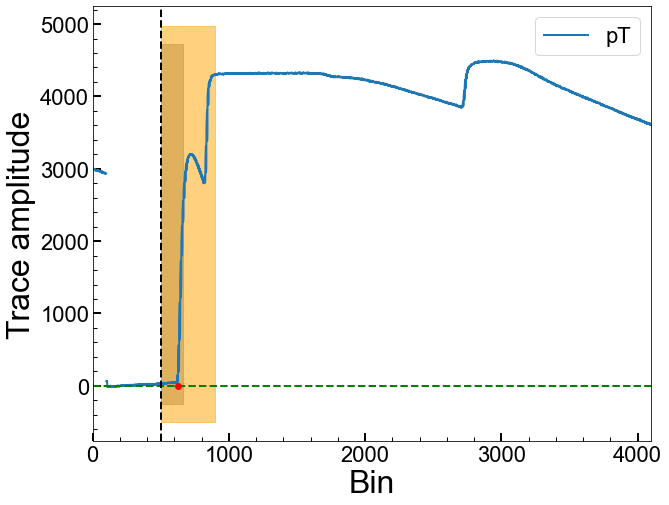

Series Number: 72209162200
Event Number: 7100405
Energy: 2.520231881611 keV
Area: 27656.481312572167


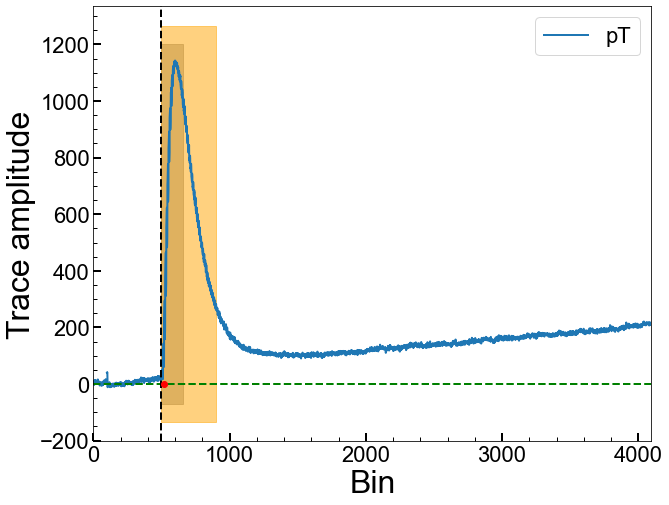

Series Number: 72209162200
Event Number: 7120189
Energy: 7.957623521978 keV
Area: 114248.78380870639


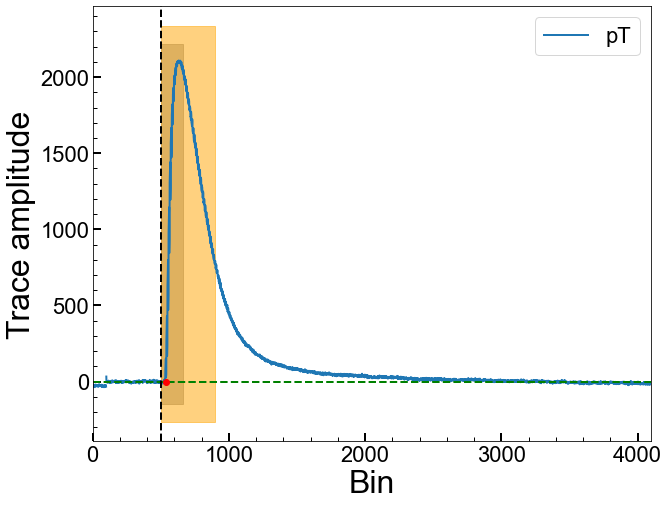

Series Number: 72209162200
Event Number: 7120853
Energy: 11.79418791155 keV
Area: 312757.13597512094


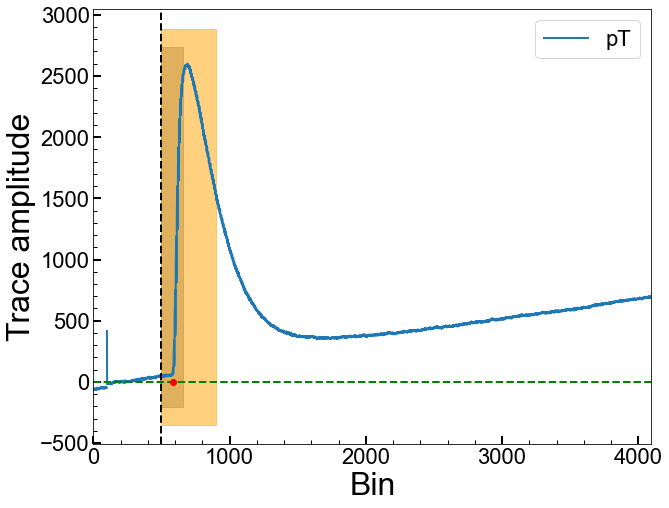

Series Number: 72209162200
Event Number: 7150213
Energy: 47.21011927114 keV
Area: 669427.5038934398


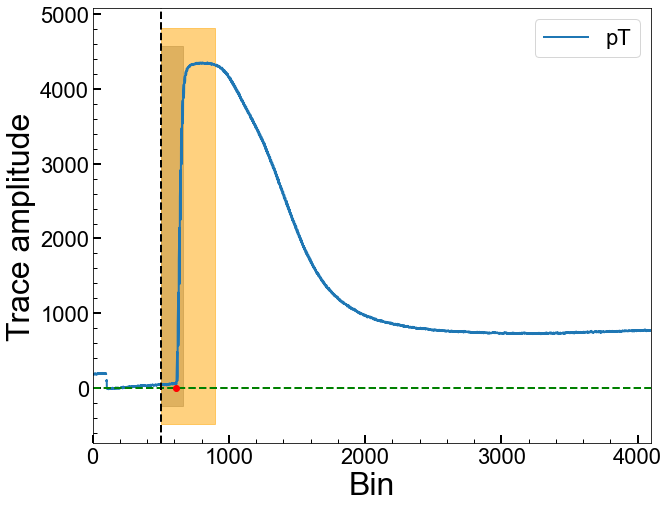

Series Number: 72209162200
Event Number: 7160371
Energy: 18.89773727264 keV
Area: -2585339.6260877503


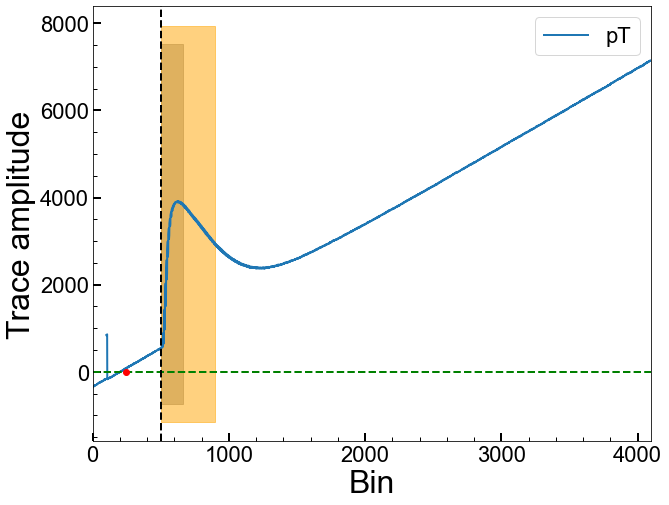

Series Number: 72209162200
Event Number: 7160546
Energy: 47.51173480298 keV
Area: 348517.9818284151


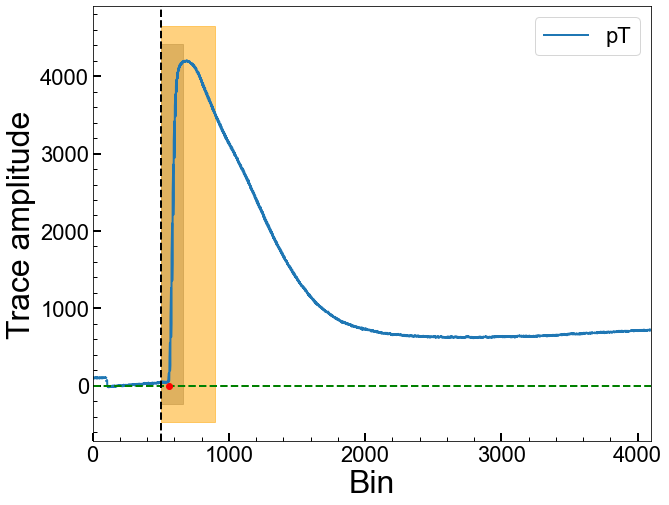

Series Number: 72209162200
Event Number: 7160810
Energy: 8.945300966353 keV
Area: -24514.57602778985


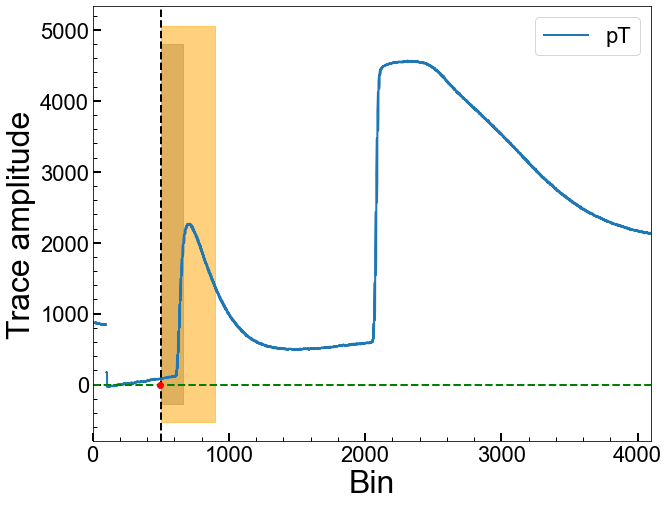

Series Number: 72209162200
Event Number: 7170190
Energy: 14.9688401648 keV
Area: 451551.4980865131


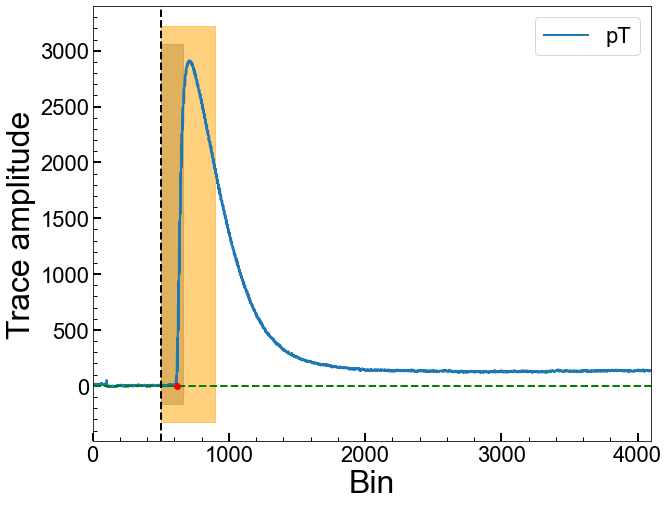

Series Number: 72209162200
Event Number: 7190203
Energy: 3.255560725406 keV
Area: 205322.14841832913


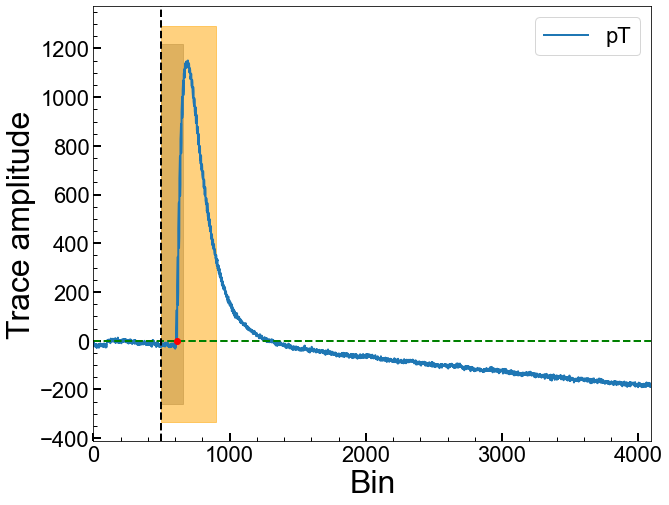

Series Number: 72209162200
Event Number: 7190236
Energy: 29.34597291777 keV
Area: 635923.5147656268


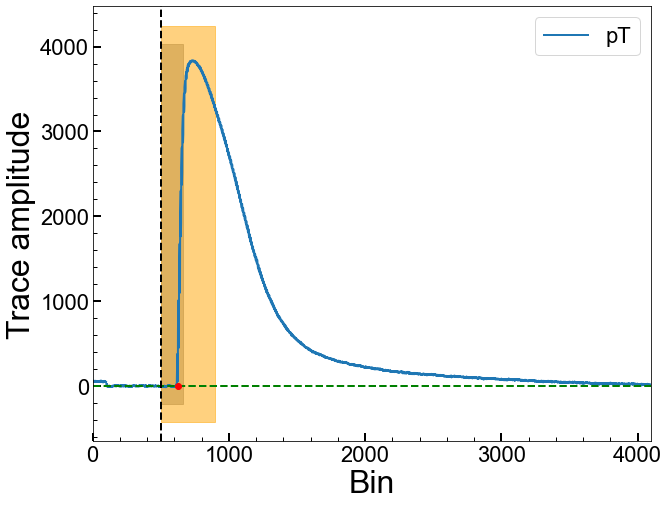

Series Number: 72209162200
Event Number: 7220890
Energy: 30.48805328357 keV
Area: -5271646.473501453


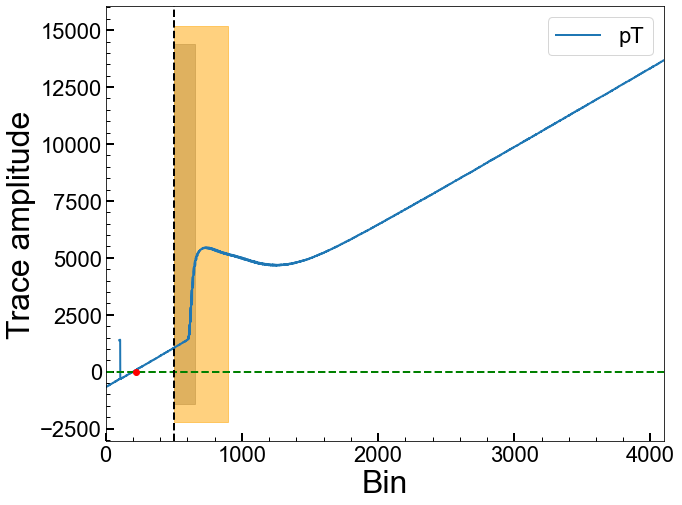

Series Number: 72209162200
Event Number: 7230343
Energy: 30.56351714512 keV
Area: -608823.9520032636


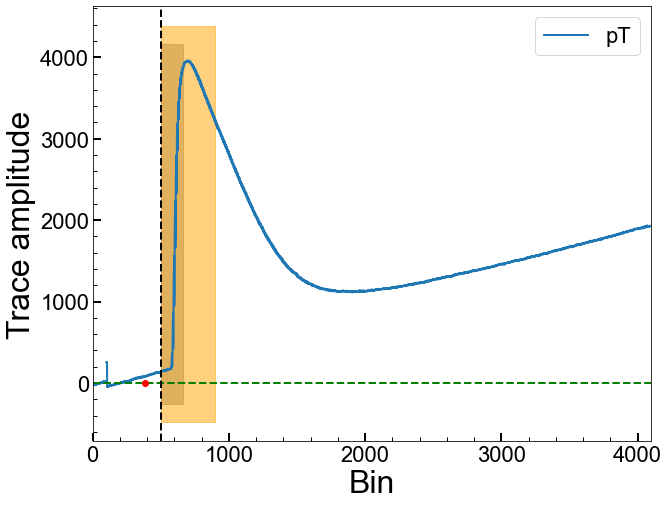

Series Number: 72209162200
Event Number: 7260306
Energy: 22.87965603044 keV
Area: 103535.394647555


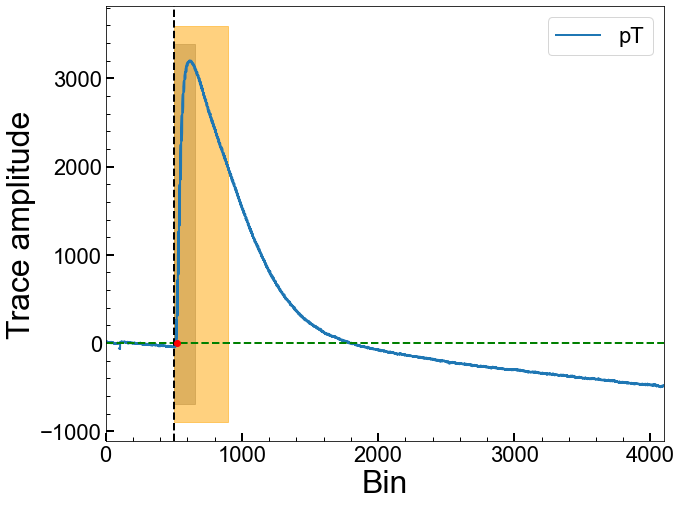

Series Number: 72209162200
Event Number: 7260683
Energy: 38.32635353383 keV
Area: 397044.47729262715


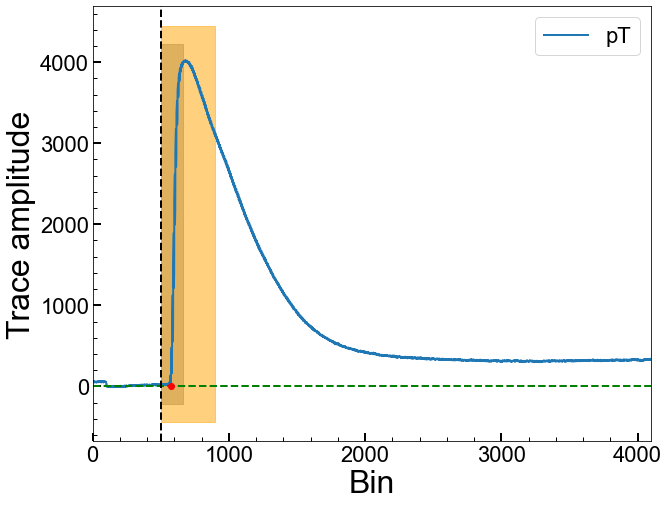

Series Number: 72209162200
Event Number: 7270169
Energy: 15.17026555368 keV
Area: 439084.9707141723


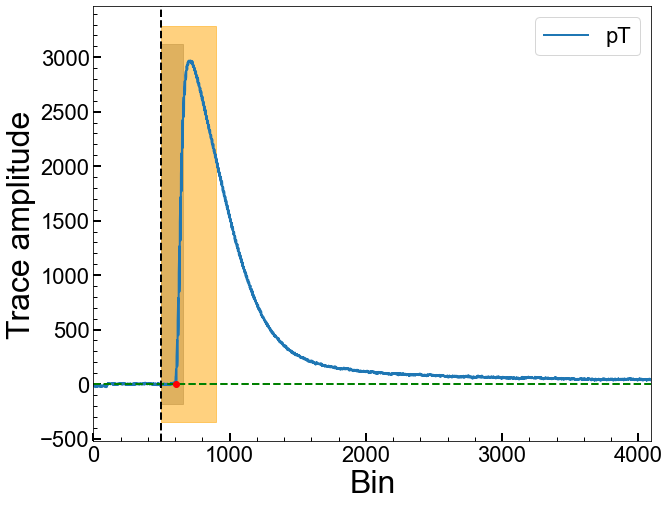

Series Number: 72209162200
Event Number: 7300339
Energy: 47.8145509351 keV
Area: 114987.5243255453


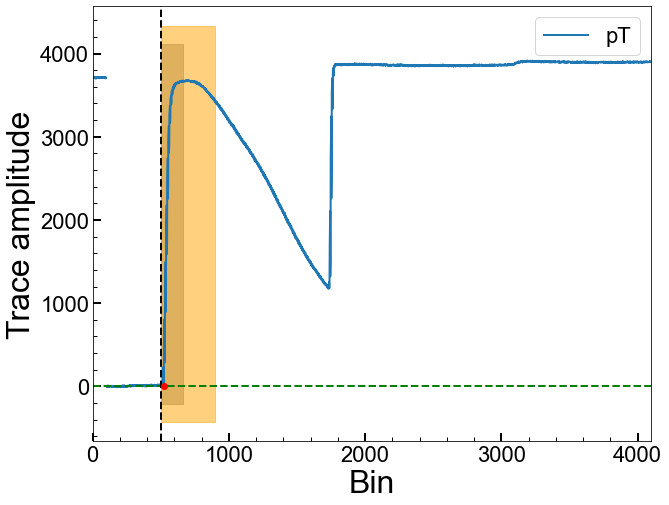

Series Number: 72209162200
Event Number: 7310565
Energy: 31.90863233359 keV
Area: 587466.5485060398


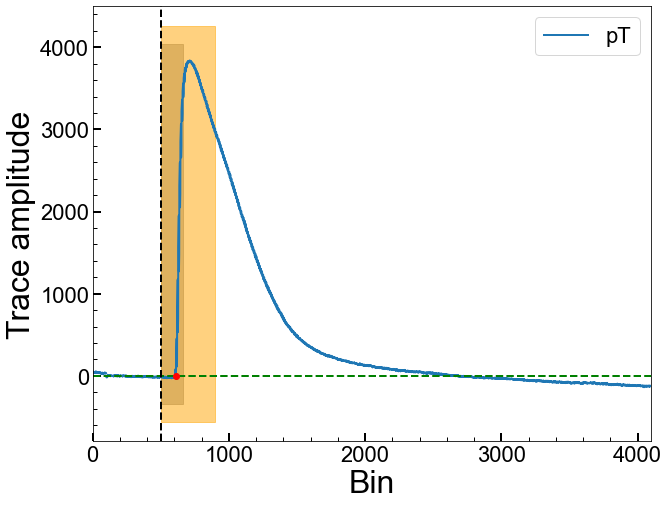

Series Number: 72209162200
Event Number: 7310590
Energy: 18.97146015955 keV
Area: -628075.2794217216


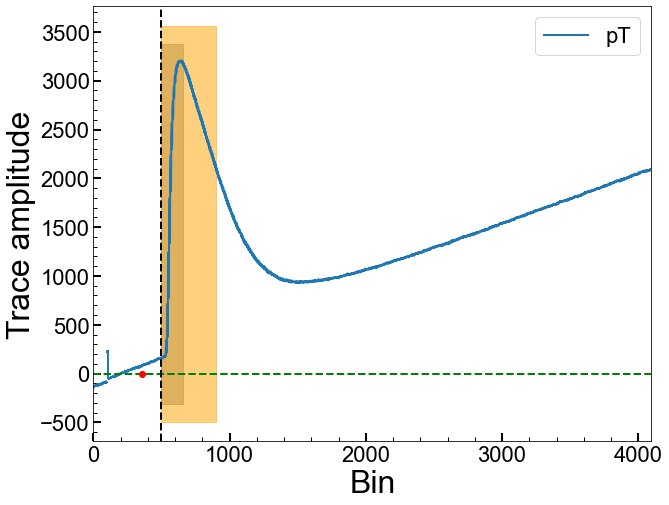

Series Number: 72209162200
Event Number: 7320269
Energy: 36.24337588822 keV
Area: 609315.1296510379


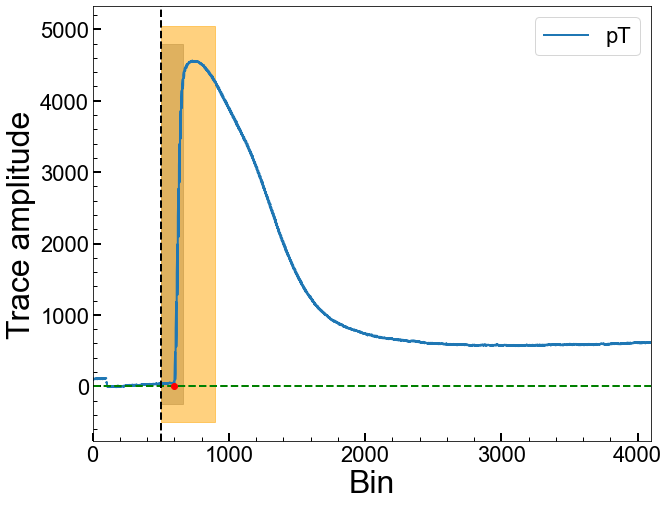

Series Number: 72209162200
Event Number: 7330541
Energy: 18.45897791498 keV
Area: 526357.9014068424


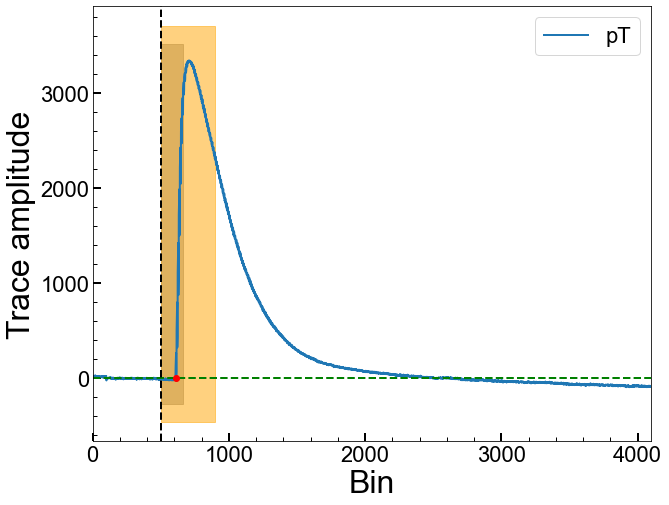

Series Number: 72209162200
Event Number: 7350213
Energy: 41.27186645363 keV
Area: 277196.4172274438


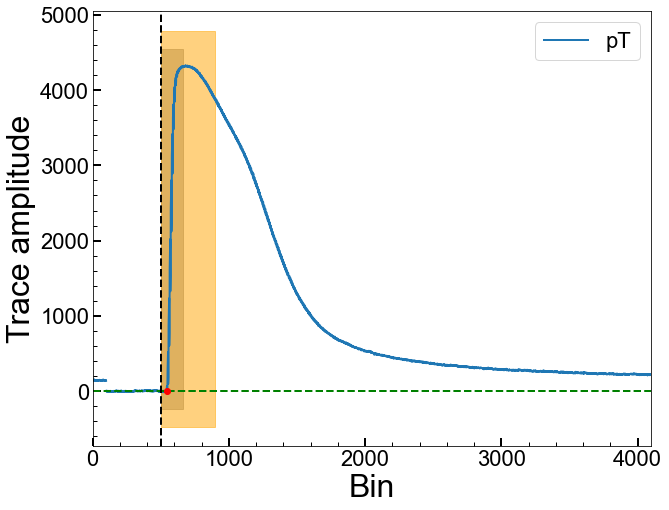

Series Number: 72209162200
Event Number: 7350397
Energy: 43.7252858962 keV
Area: -846567.6476656423


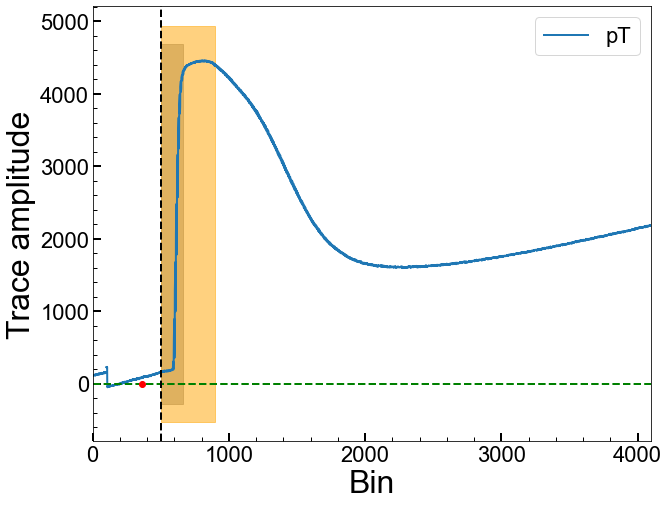

Series Number: 72209162200
Event Number: 7360209
Energy: 34.3082753862 keV
Area: 331246.66400514264


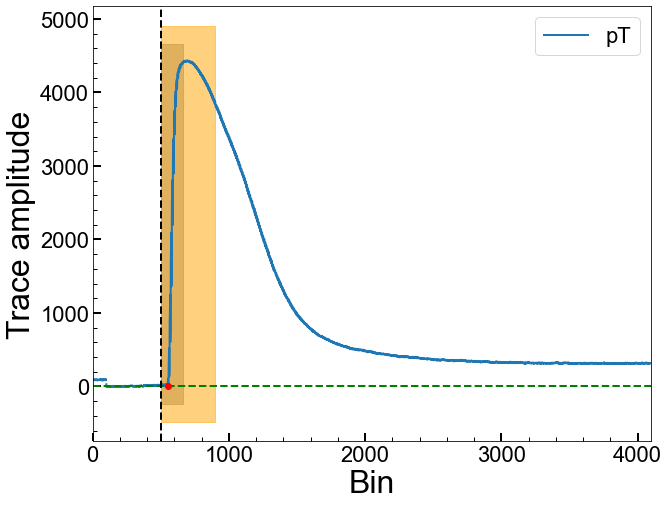

Series Number: 72209162200
Event Number: 7360750
Energy: 15.39129592515 keV
Area: 465792.91941448423


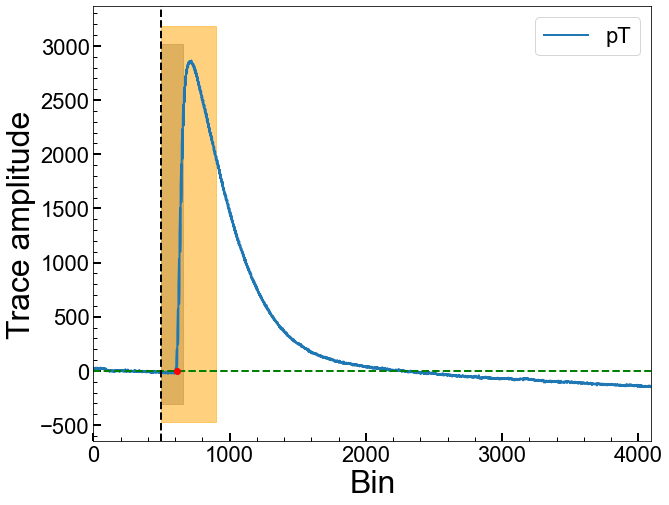

Series Number: 72209162200
Event Number: 7370027
Energy: 7.692588329475 keV
Area: -1428664.499729654


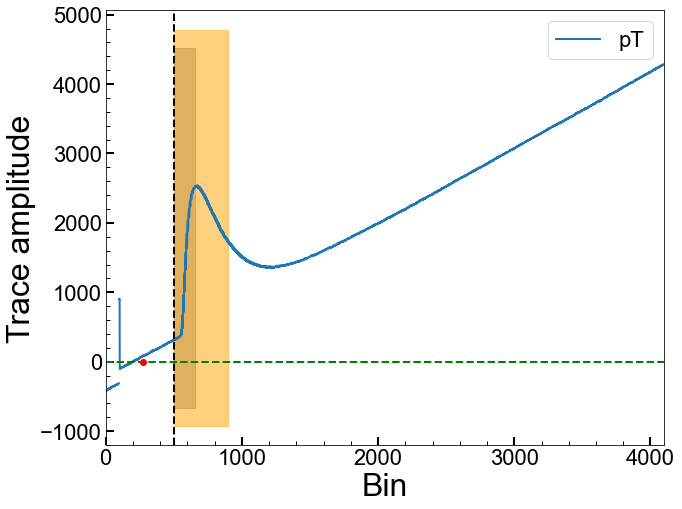

Series Number: 72209162200
Event Number: 7370339
Energy: 18.74845676731 keV
Area: 502593.90470662777


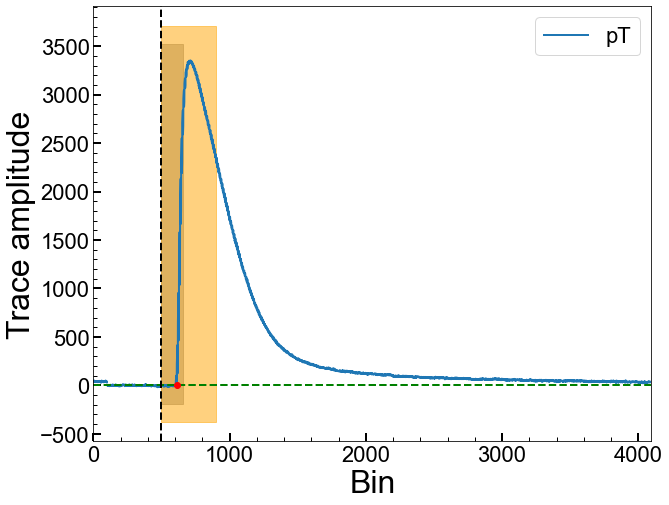

Series Number: 72209162200
Event Number: 7370515
Energy: 32.83239834487 keV
Area: -1701353.169324324


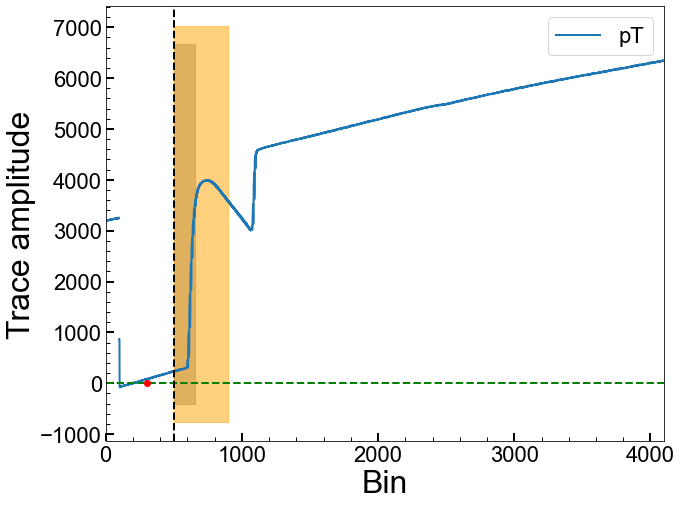

Series Number: 72209162200
Event Number: 7380028
Energy: 32.72478905279 keV
Area: 644194.0590836133


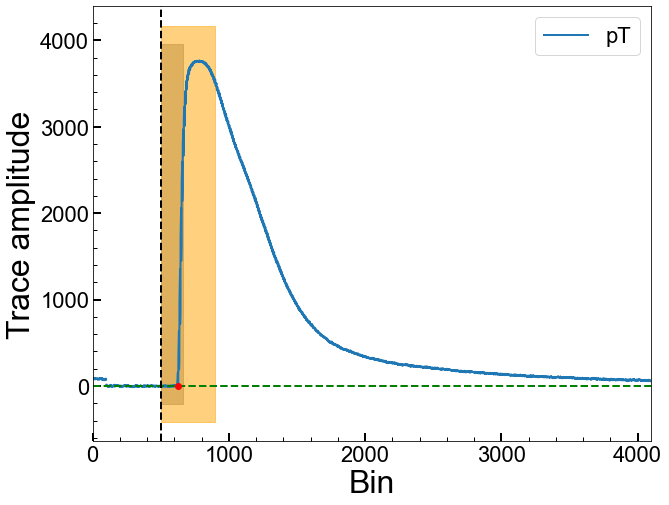

Series Number: 72209162200
Event Number: 7390456
Energy: 9.046491028648 keV
Area: 391961.71657070186


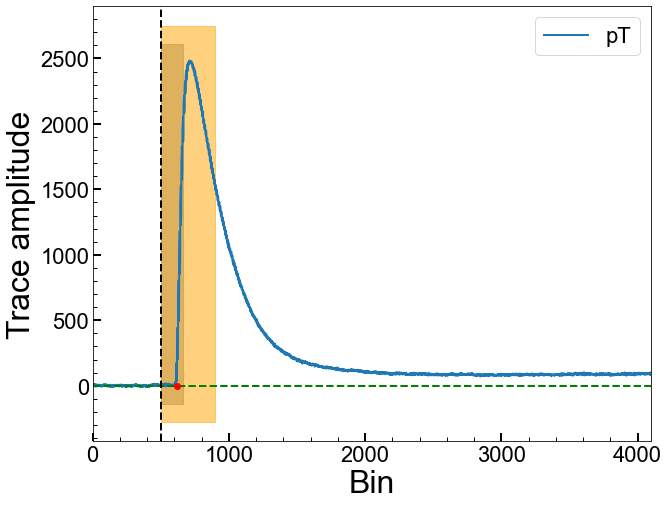

Series Number: 72209162200
Event Number: 7410314
Energy: 7.292607682607 keV
Area: -4612757.62433229


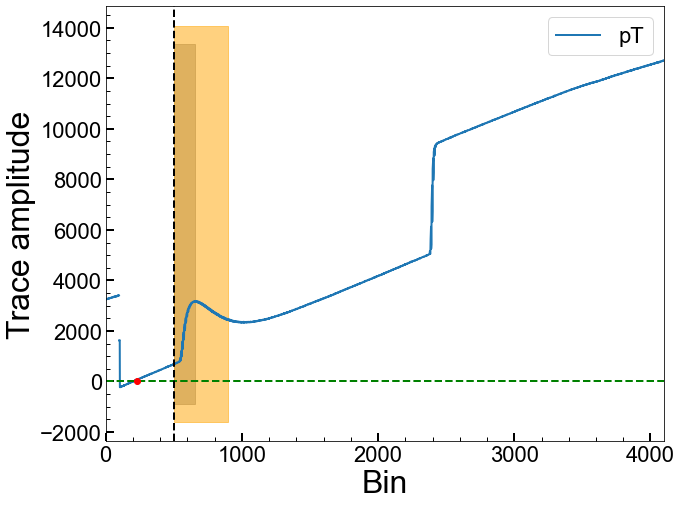

Series Number: 72209162200
Event Number: 7430528
Energy: 24.41744868463 keV
Area: 185963.85058542987


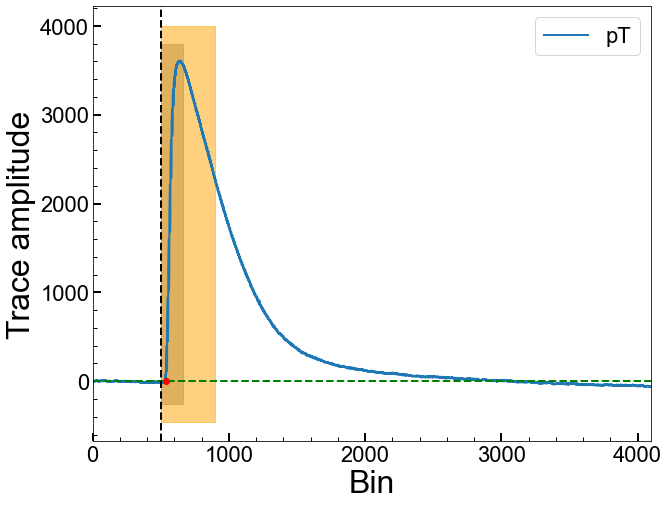

Series Number: 72209162200
Event Number: 7430884
Energy: 44.44744727894 keV
Area: 612777.4196038146


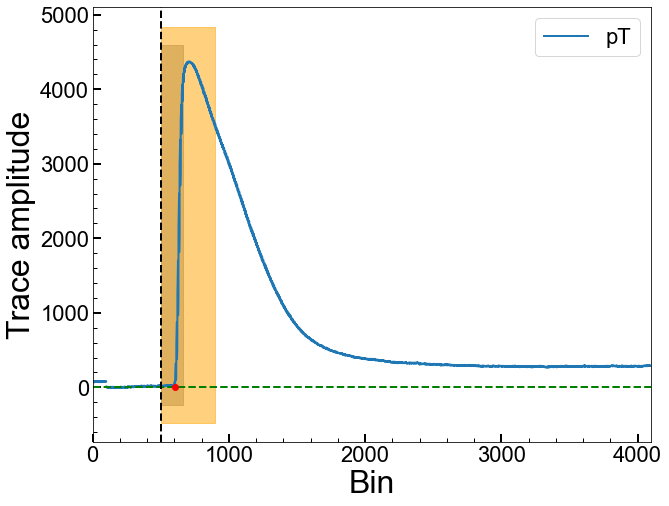

Series Number: 72209162200
Event Number: 7440215
Energy: 7.201134586102 keV
Area: -266040.9388596911


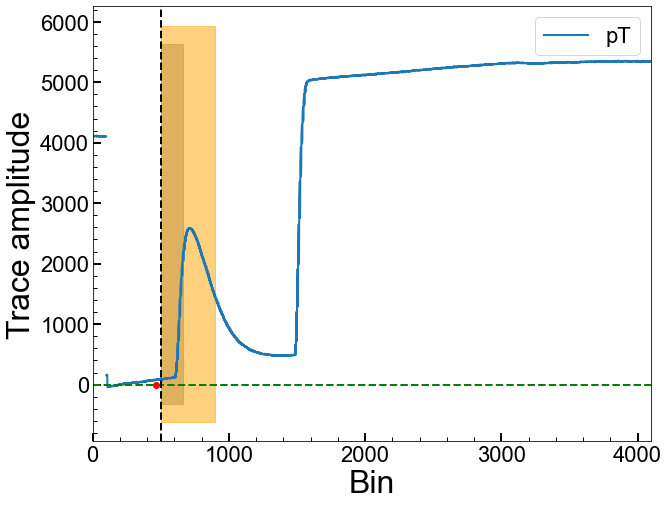

Series Number: 72209171225
Event Number: 11225
Energy: 49.08625655363 keV
Area: 571471.1611565704


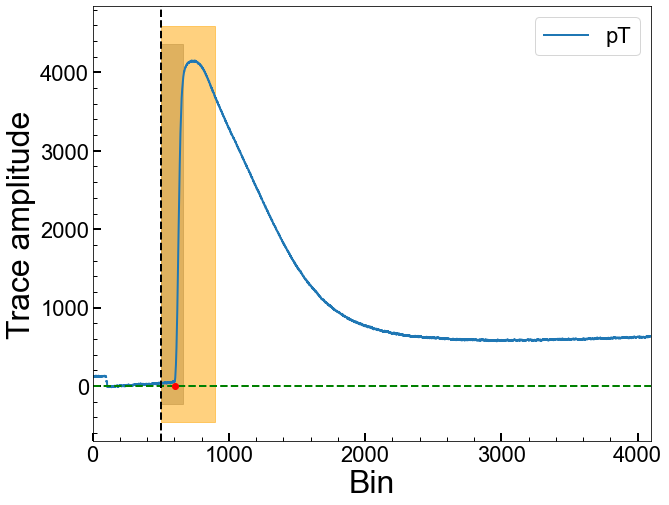

Series Number: 72209171225
Event Number: 40184
Energy: 17.30341311819 keV
Area: 580280.4519834279


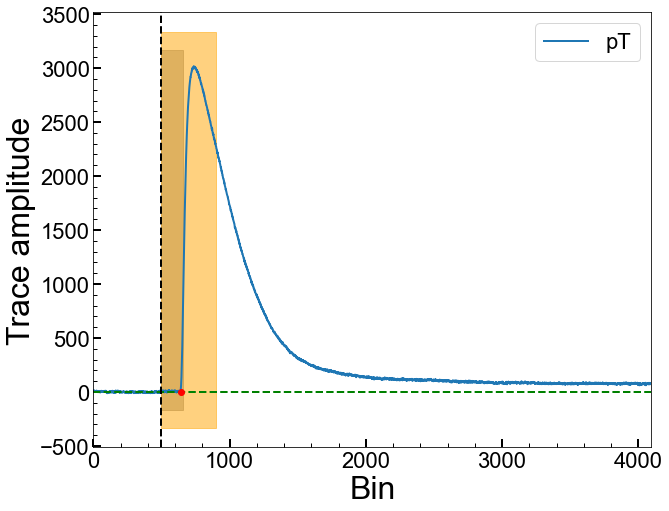

Series Number: 72209171225
Event Number: 70517
Energy: 8.950526046013 keV
Area: 38297.363597033094


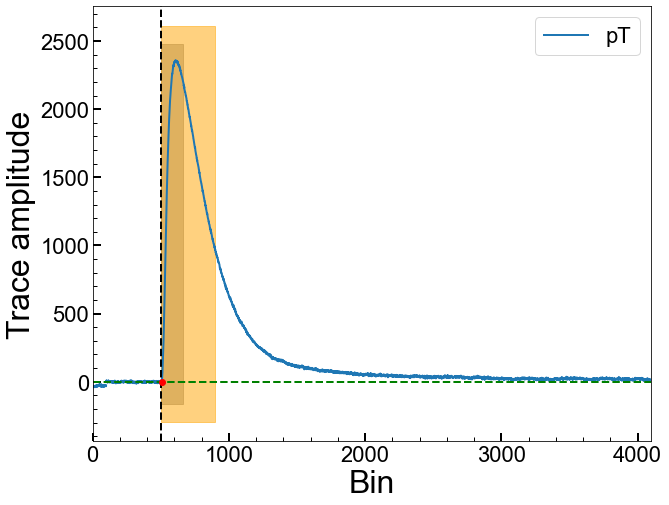

Series Number: 72209171225
Event Number: 90589
Energy: 24.82989682518 keV
Area: 506678.7104228131


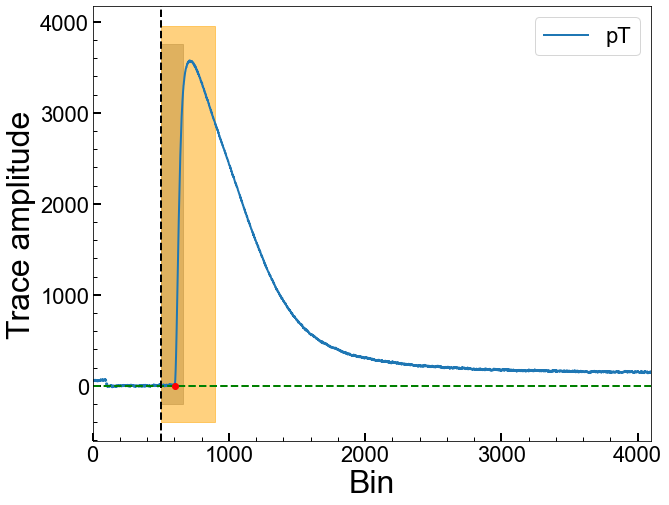

Series Number: 72209171225
Event Number: 90833
Energy: 20.51795634068 keV
Area: 523996.1358113908


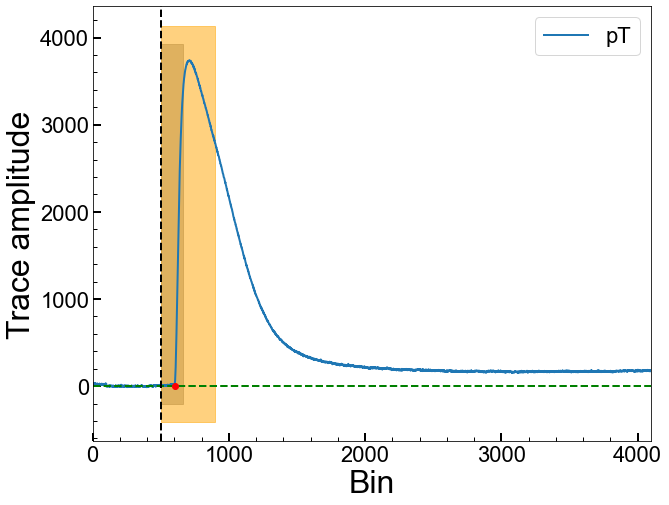

Series Number: 72209171225
Event Number: 100322
Energy: 44.39157974482 keV
Area: 730068.0608226757


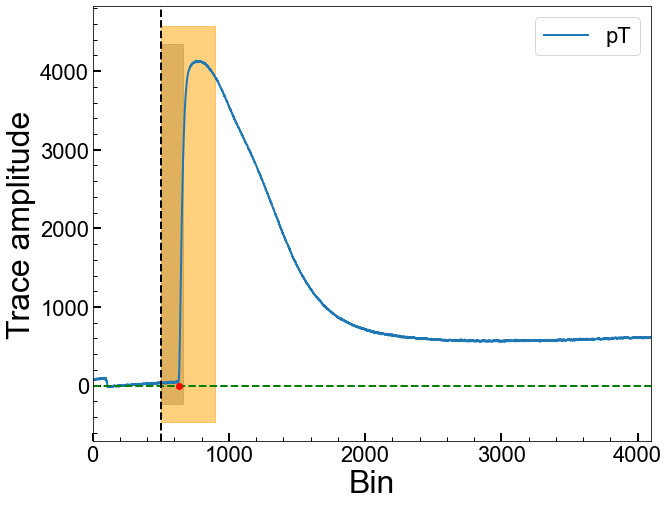

Series Number: 72209171225
Event Number: 100335
Energy: 6.775979596494 keV
Area: 178977.4940278411


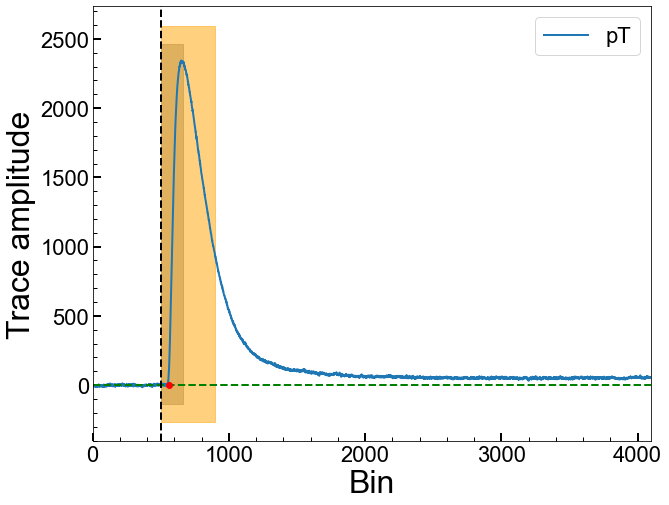

Series Number: 72209171225
Event Number: 100337
Energy: 10.07156075987 keV
Area: 320294.21582030924


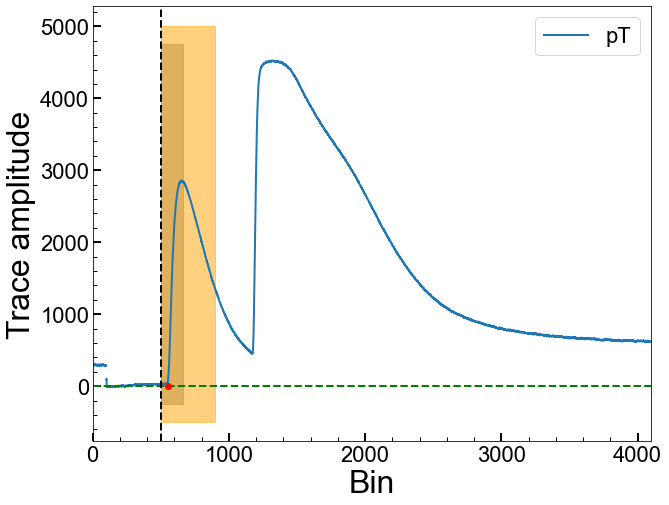

Series Number: 72209171225
Event Number: 120355
Energy: 12.78330877865 keV
Area: 369513.85979200114


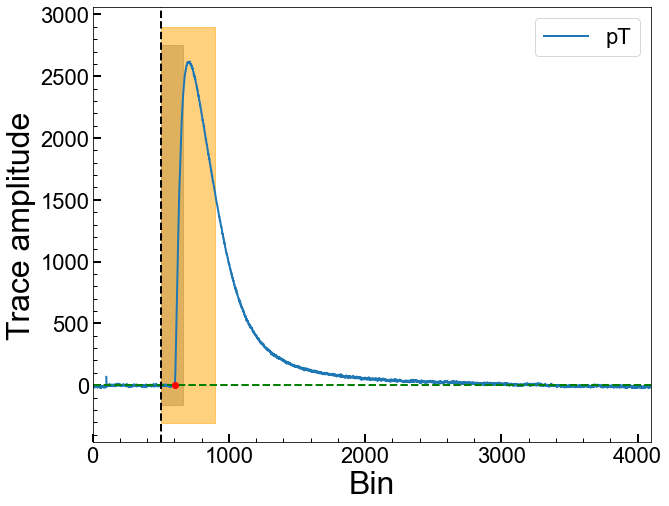

Series Number: 72209171225
Event Number: 150852
Energy: 8.681797413255 keV
Area: 93501.21215143493


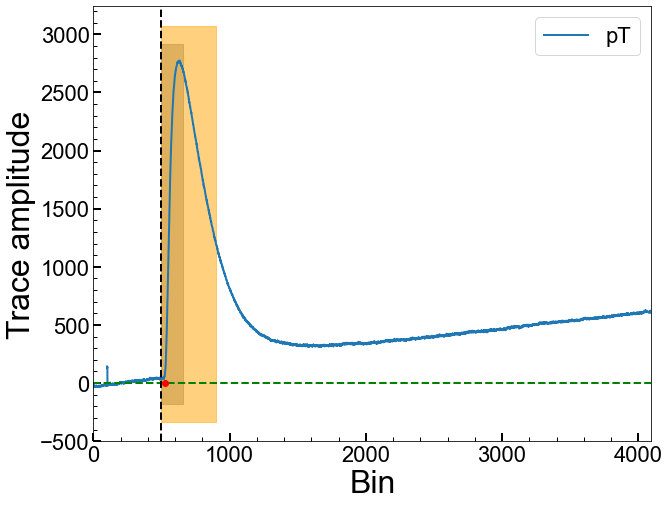

Series Number: 72209171225
Event Number: 160926
Energy: 17.48693353439 keV
Area: 207191.1951726089


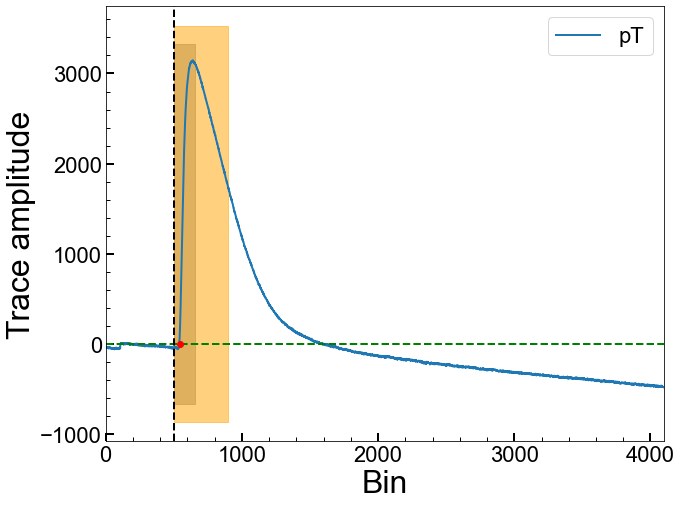

Series Number: 72209171225
Event Number: 170874
Energy: 40.40369536059 keV
Area: 384109.5194985398


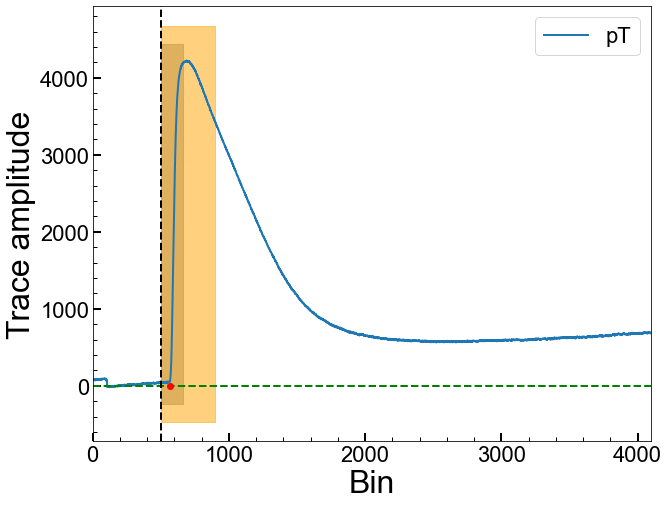

Series Number: 72209171225
Event Number: 180014
Energy: 17.66626577788 keV
Area: -1307864.9426678112


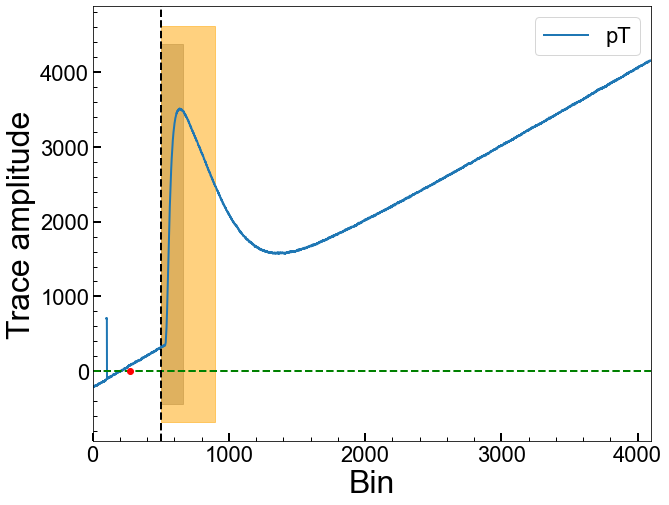

Series Number: 72209171225
Event Number: 180809
Energy: 29.62427572305 keV
Area: 72480.77592741743


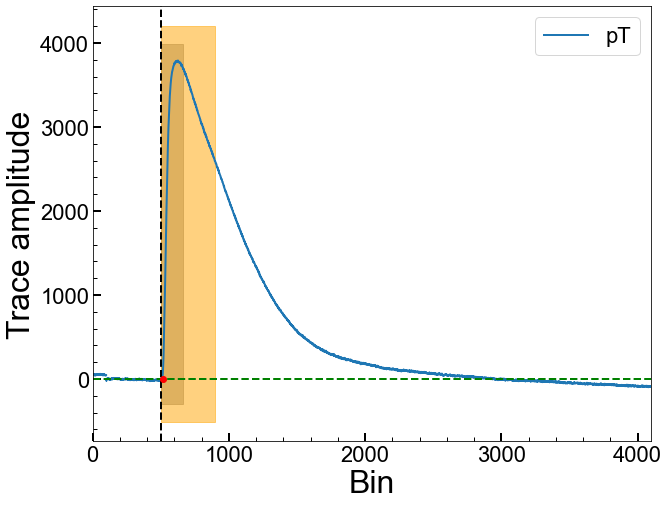

Series Number: 72209171225
Event Number: 210770
Energy: 40.63176389827 keV
Area: 601154.7303699497


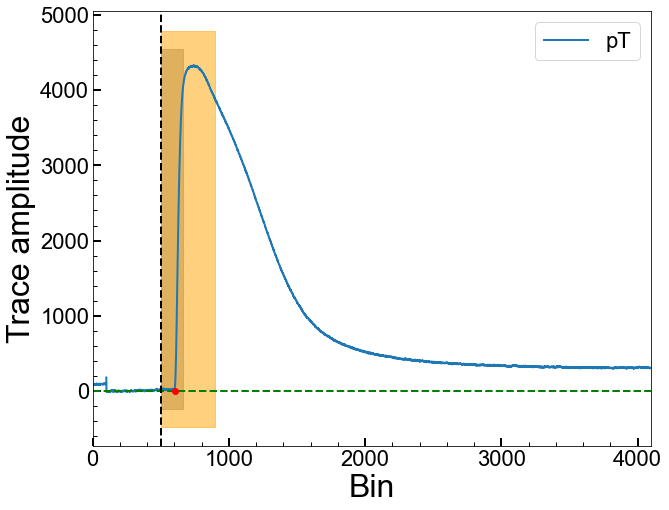

Series Number: 72209171225
Event Number: 230110
Energy: 18.81147035845 keV
Area: 177767.15052823361


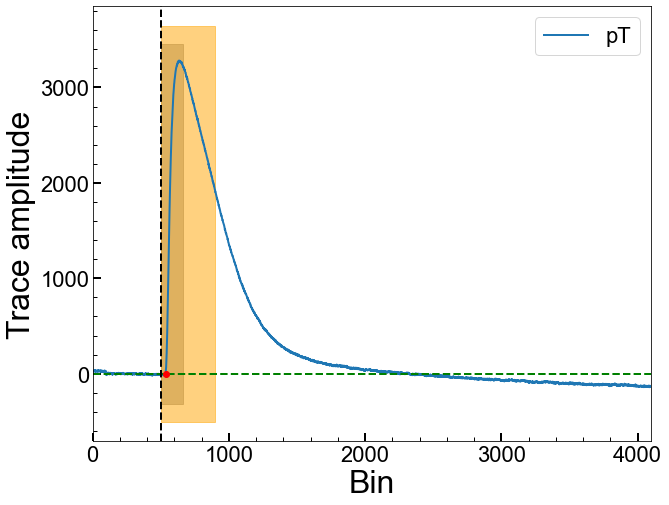

Series Number: 72209171225
Event Number: 230829
Energy: 17.36423233584 keV
Area: 410164.3411489959


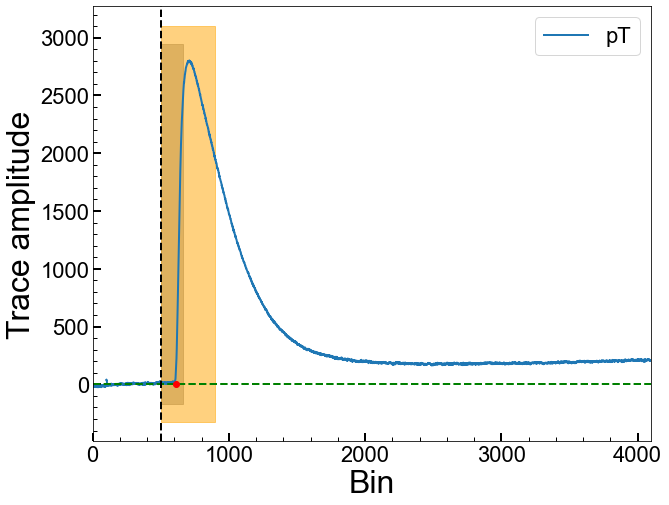

Series Number: 72209171225
Event Number: 260293
Energy: 39.73206803995 keV
Area: 485212.4515401332


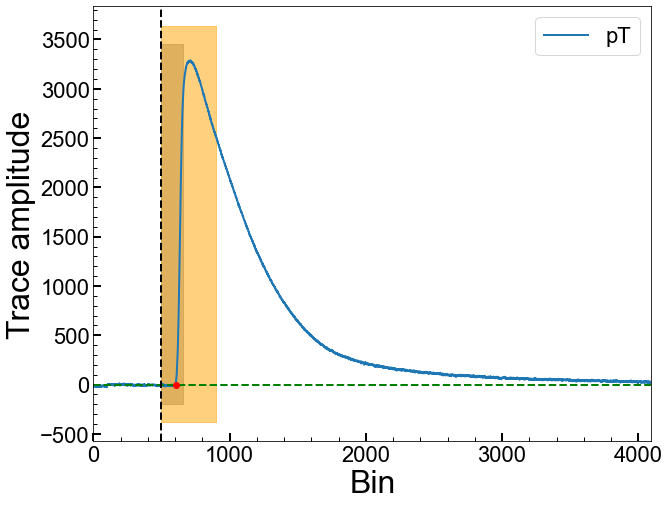

Series Number: 72209171225
Event Number: 300068
Energy: 32.89290741209 keV
Area: -56555.7315624371


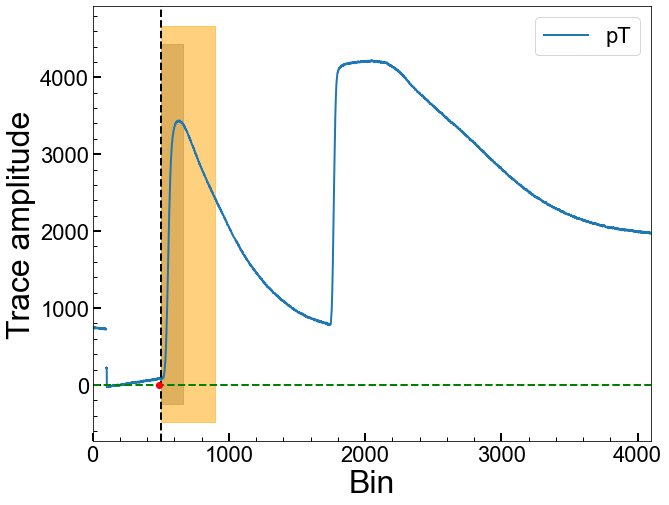

Series Number: 72209171225
Event Number: 300128
Energy: 6.241491446716 keV
Area: 268314.3887326094


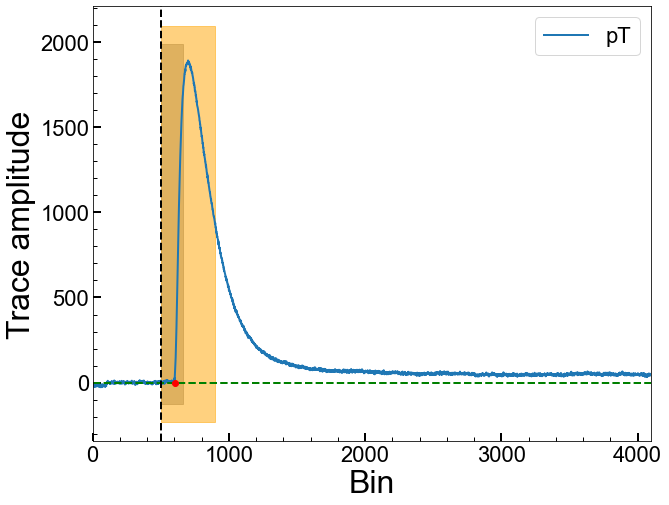

Series Number: 72209171225
Event Number: 310468
Energy: 19.49628374209 keV
Area: 458515.6942921149


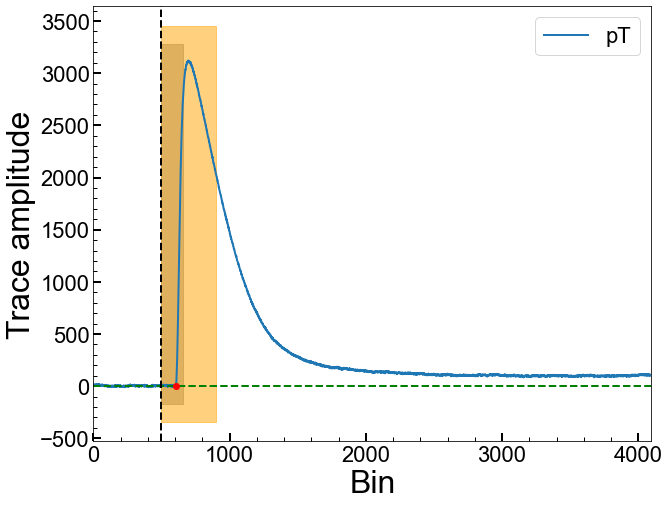

Series Number: 72209171225
Event Number: 340696
Energy: 22.16940782758 keV
Area: 494697.6946365353


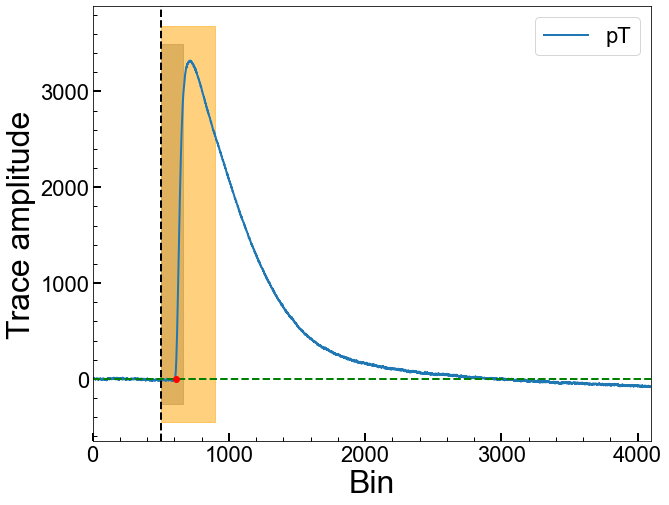

Series Number: 72209171225
Event Number: 350602
Energy: 13.4765941652 keV
Area: 488759.6437487104


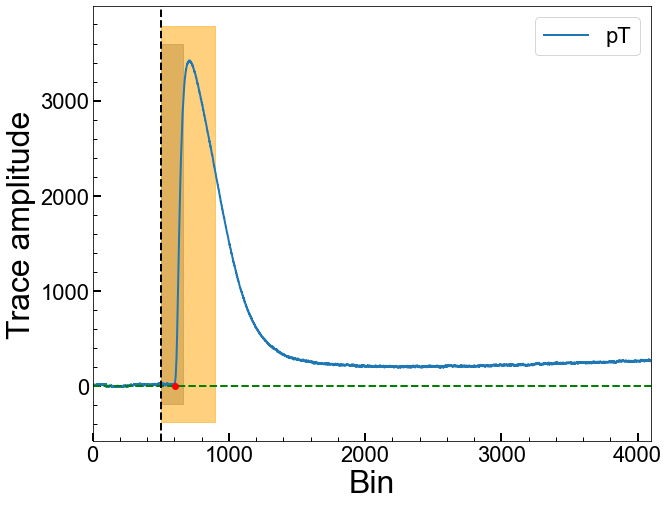

Series Number: 72209171225
Event Number: 370428
Energy: 3.45760772702 keV
Area: 148013.63110993273


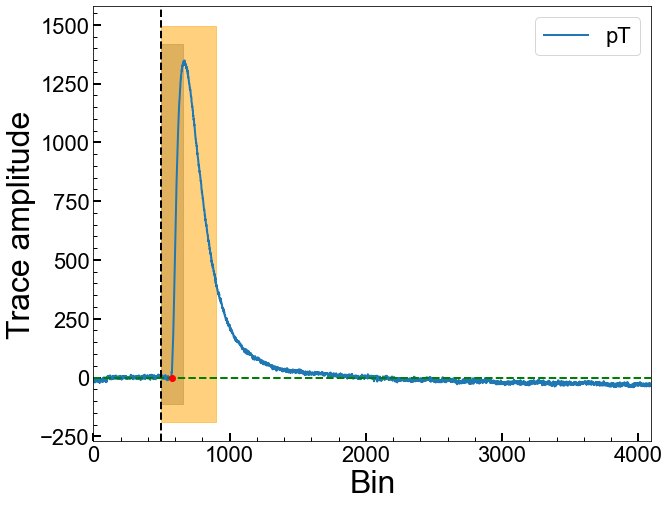

Series Number: 72209171225
Event Number: 370752
Energy: 23.50939806158 keV
Area: 101296.42373670991


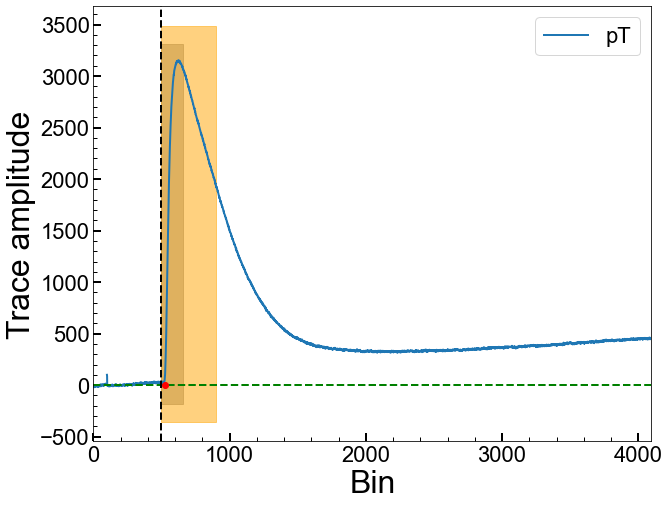

Series Number: 72209171225
Event Number: 380045
Energy: 29.80287367672 keV
Area: 475801.18592439743


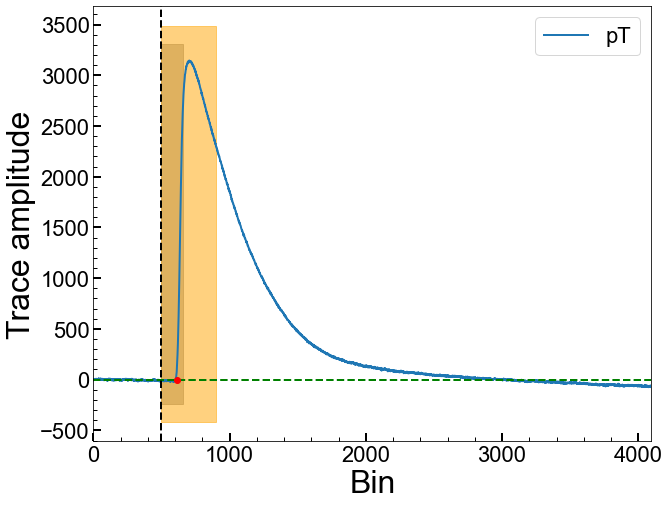

Series Number: 72209171225
Event Number: 380215
Energy: 23.19819818094 keV
Area: -1154113.5442683655


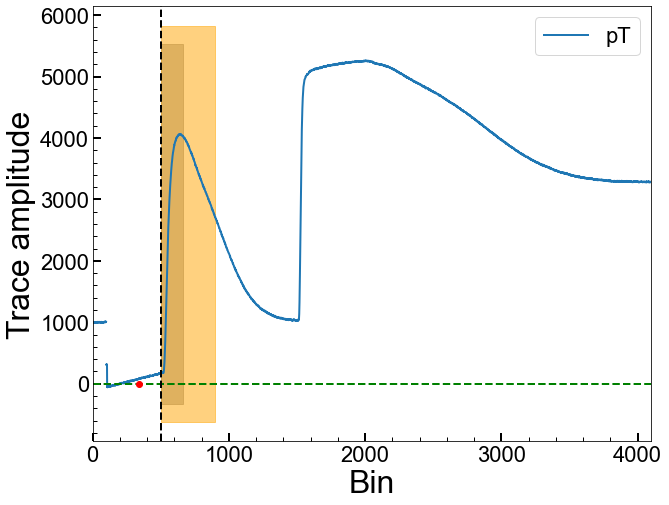

Series Number: 72209171225
Event Number: 390605
Energy: 4.551373572208 keV
Area: 316226.27920399717


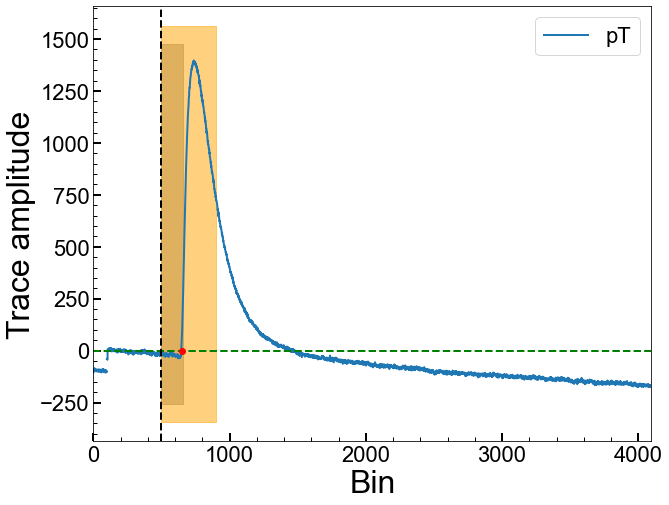

Series Number: 72209171225
Event Number: 410837
Energy: 11.57620778604 keV
Area: 77492.49702474175


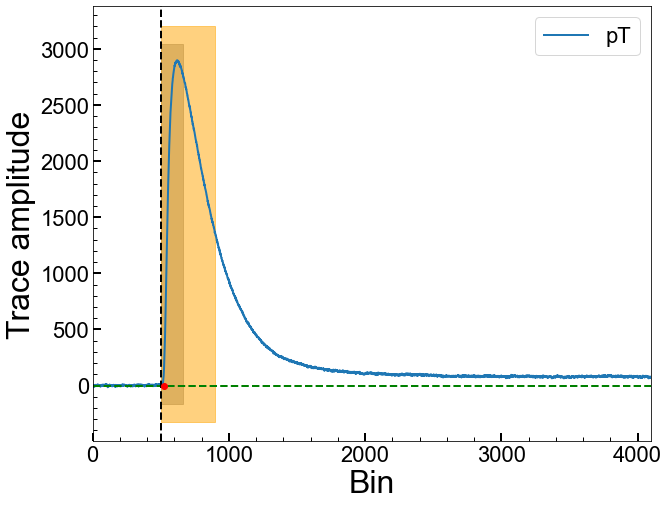

Series Number: 72209171225
Event Number: 440483
Energy: 24.49091760405 keV
Area: 493365.44772047683


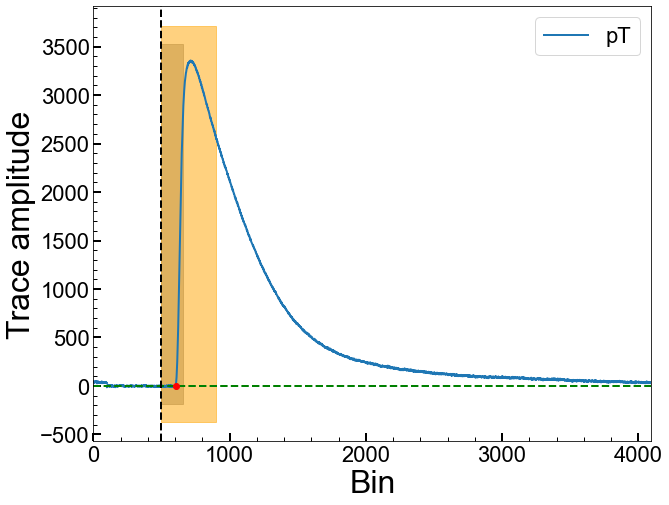

Series Number: 72209171225
Event Number: 450235
Energy: 18.91153048415 keV
Area: -1262922.7874564657


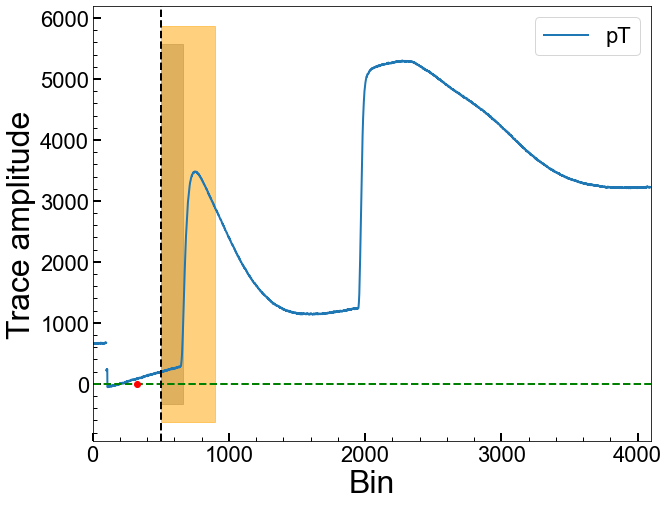

Series Number: 72209171225
Event Number: 450756
Energy: 12.97155815771 keV
Area: 569709.9488890101


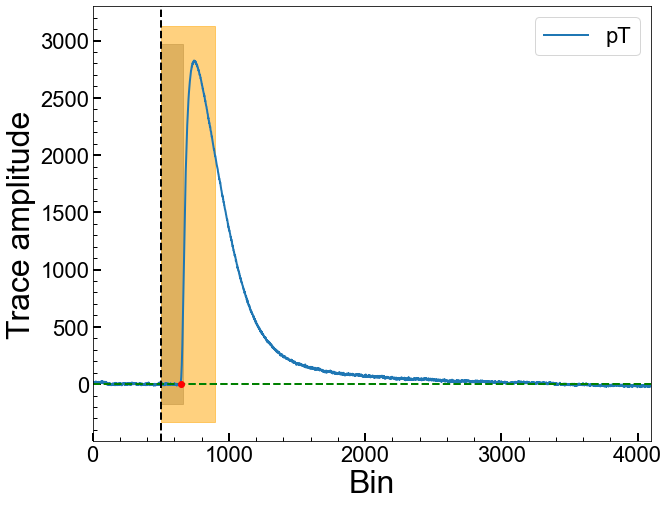

Series Number: 72209171225
Event Number: 510708
Energy: 21.4194683574 keV
Area: 527038.413053616


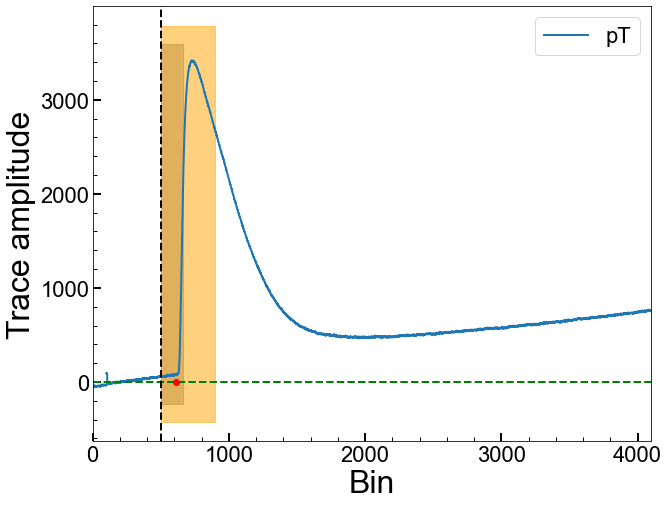

Series Number: 72209171225
Event Number: 510837
Energy: 19.5883832705 keV
Area: 481032.5591604413


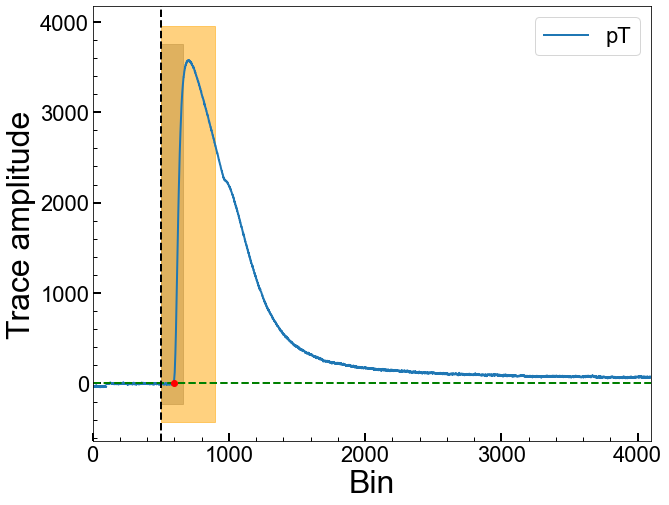

Series Number: 72209171225
Event Number: 520405
Energy: 42.84540248556 keV
Area: 316201.7115484116


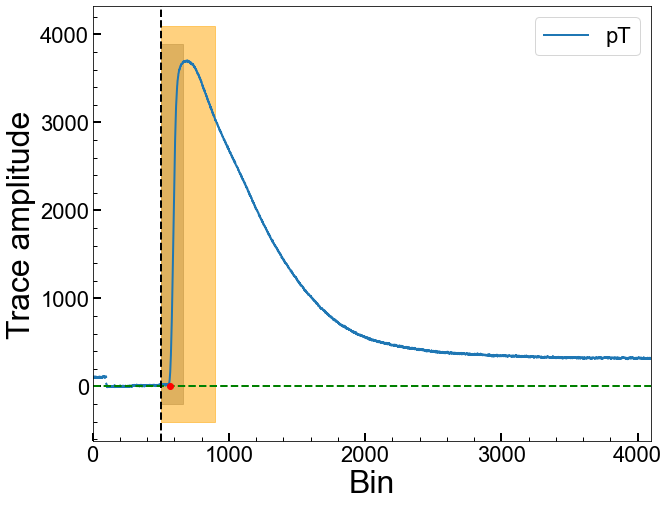

Series Number: 72209171225
Event Number: 550506
Energy: 29.68087482808 keV
Area: 820119.425479647


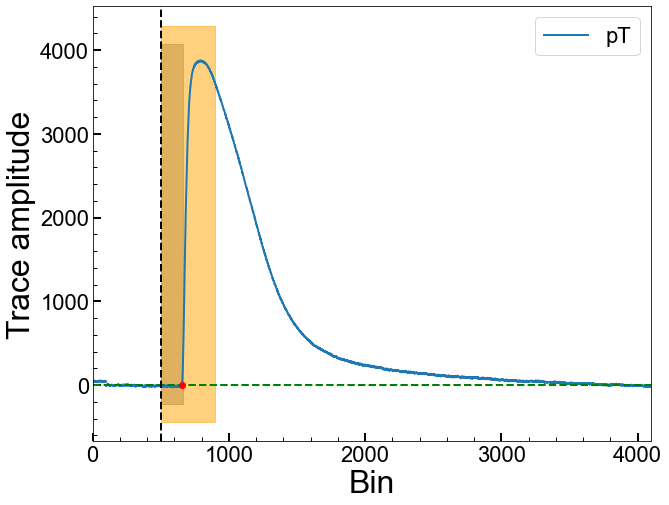

Series Number: 72209171225
Event Number: 550677
Energy: 17.44337080164 keV
Area: 314467.8719745695


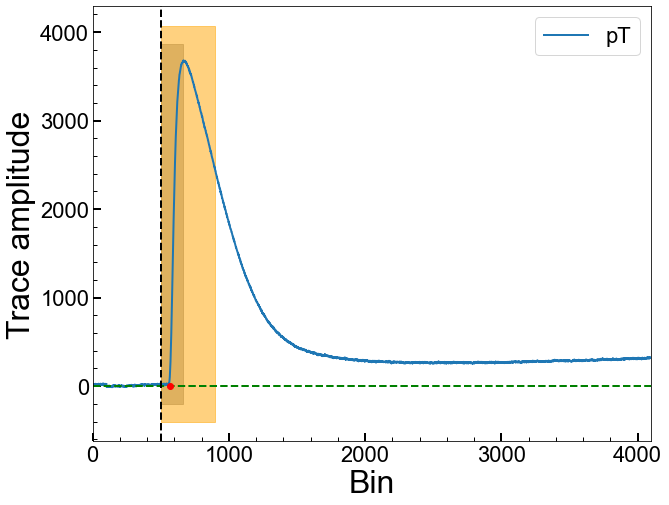

Series Number: 72209171225
Event Number: 560107
Energy: 11.42917220272 keV
Area: 203795.18705477088


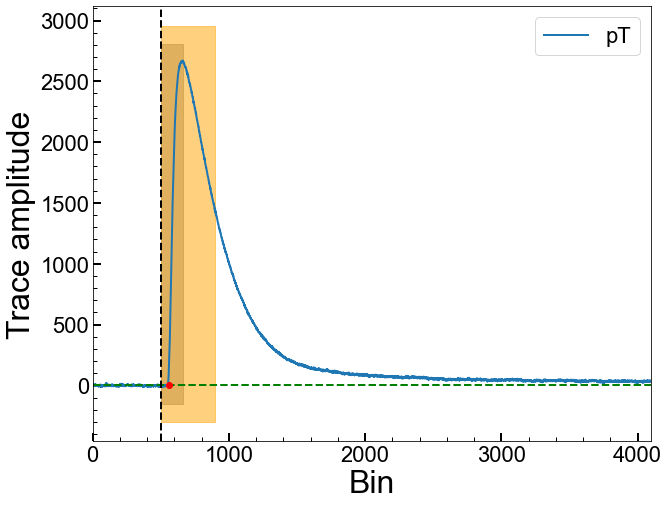

Series Number: 72209171225
Event Number: 560760
Energy: 34.95661758919 keV
Area: 601348.8664359559


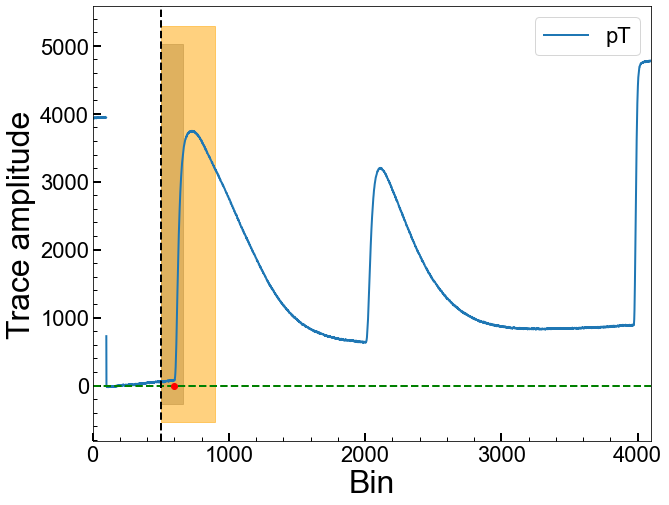

Series Number: 72209171225
Event Number: 570123
Energy: 3.982526680198 keV
Area: 558756.0024483036


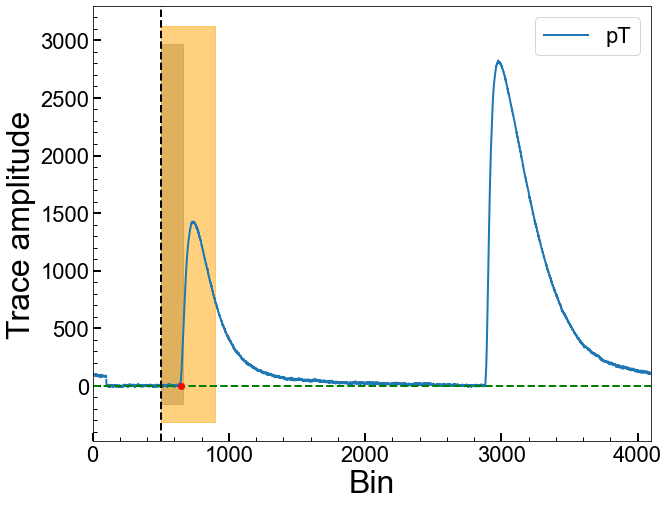

Series Number: 72209171225
Event Number: 570269
Energy: 7.232429239526 keV
Area: 408591.3290259179


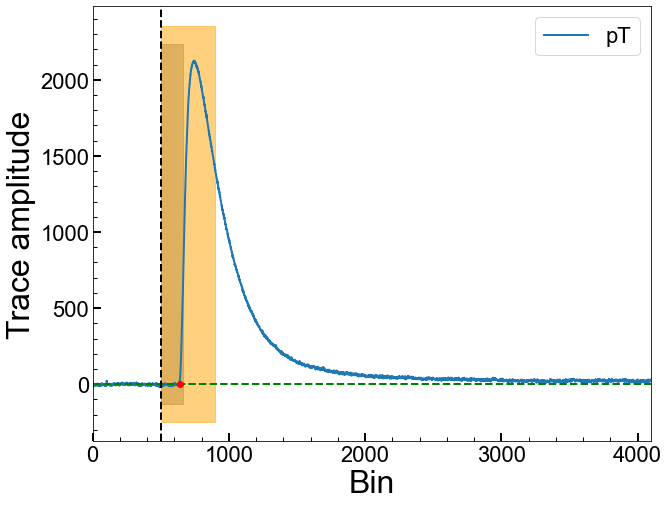

Series Number: 72209171225
Event Number: 570598
Energy: 26.37826627782 keV
Area: 482316.2137334043


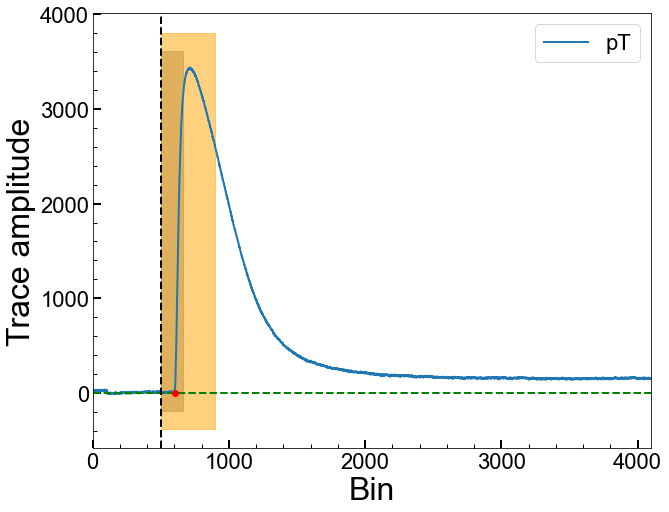

Series Number: 72209171225
Event Number: 590460
Energy: 34.58209807431 keV
Area: 565955.5790591998


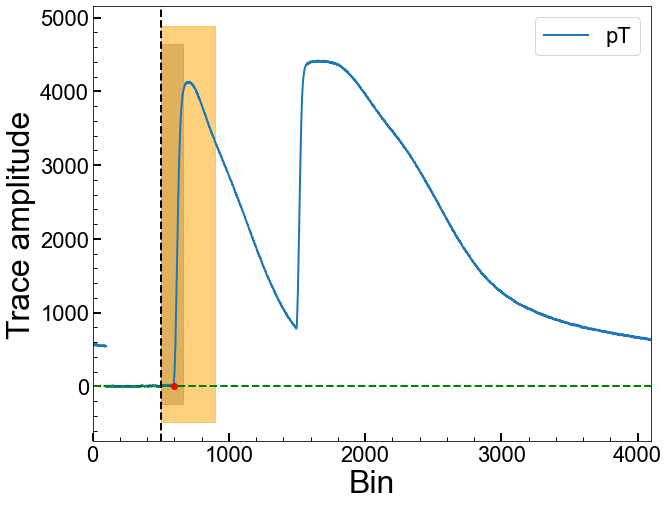

Series Number: 72209171225
Event Number: 590540
Energy: 39.43697373887 keV
Area: 512195.24936873827


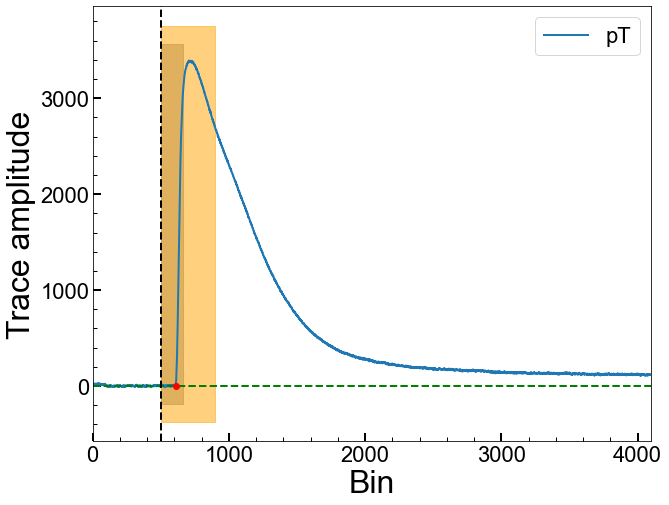

Series Number: 72209171225
Event Number: 600703
Energy: 46.11694469458 keV
Area: -5362180.745267199


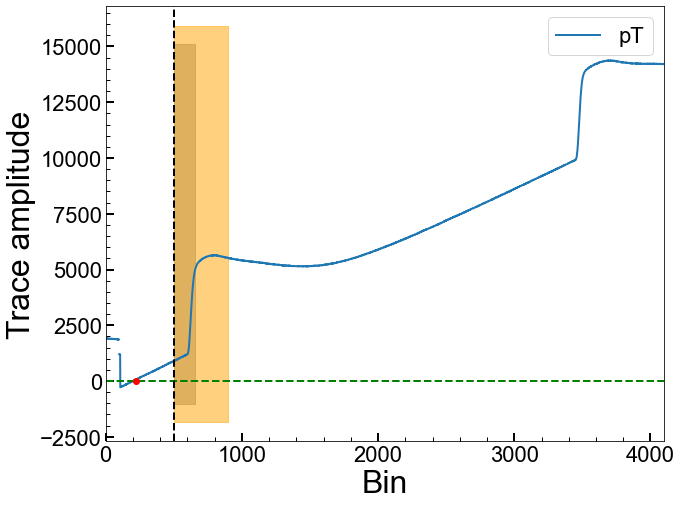

Series Number: 72209171225
Event Number: 600776
Energy: 44.47797536548 keV
Area: 629022.4850957355


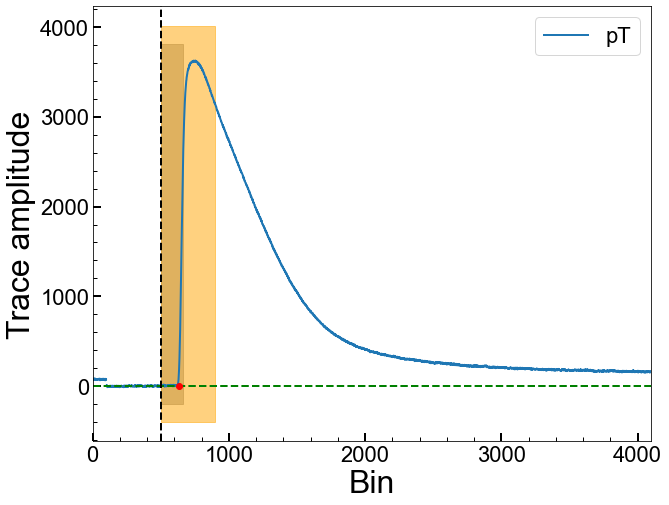

Series Number: 72209171225
Event Number: 610010
Energy: 46.87272268552 keV
Area: 727363.7461196312


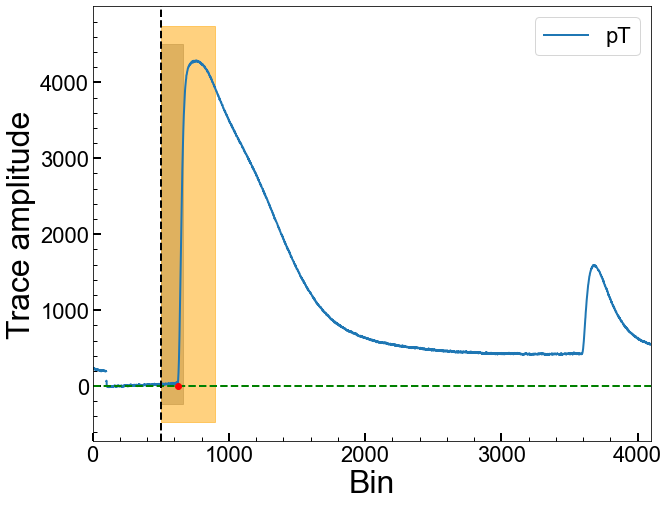

Series Number: 72209171225
Event Number: 650014
Energy: 26.68187400356 keV
Area: 371769.6627086627


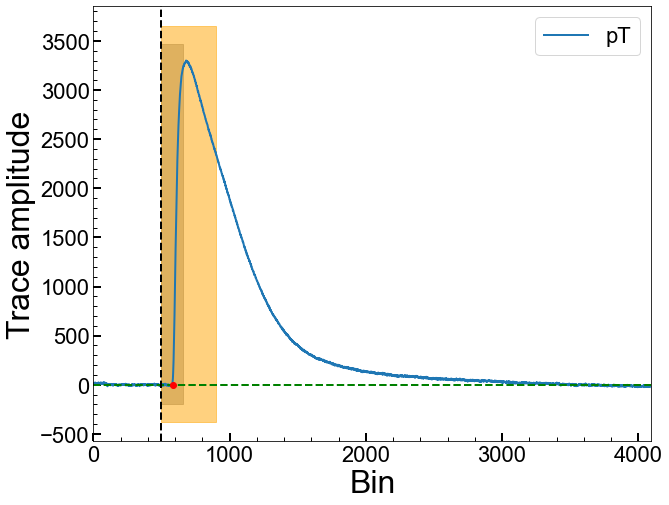

Series Number: 72209171225
Event Number: 680642
Energy: 21.57138611646 keV
Area: 438590.93947761593


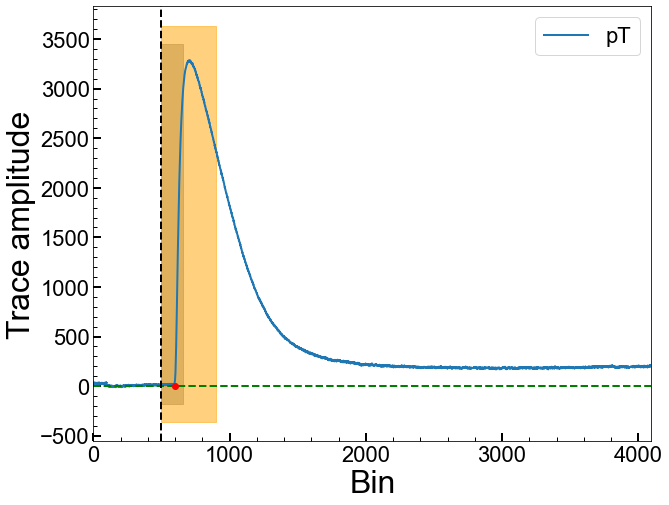

Series Number: 72209171225
Event Number: 690523
Energy: 39.2950246737 keV
Area: 572574.5728072406


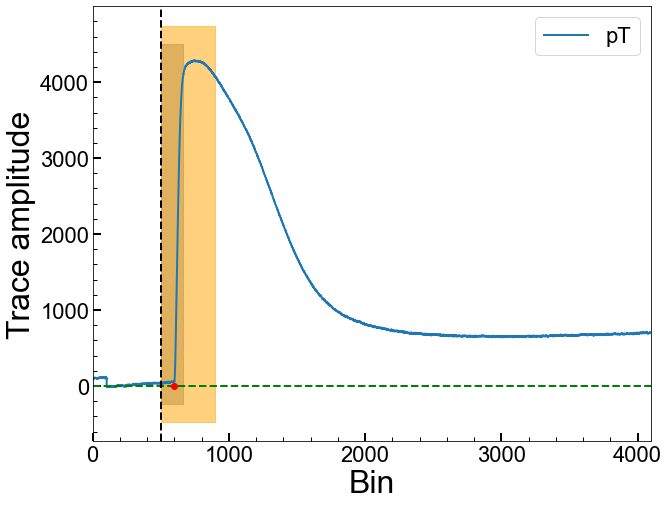

Series Number: 72209171225
Event Number: 690726
Energy: 18.71743341481 keV
Area: -3021122.3359819823


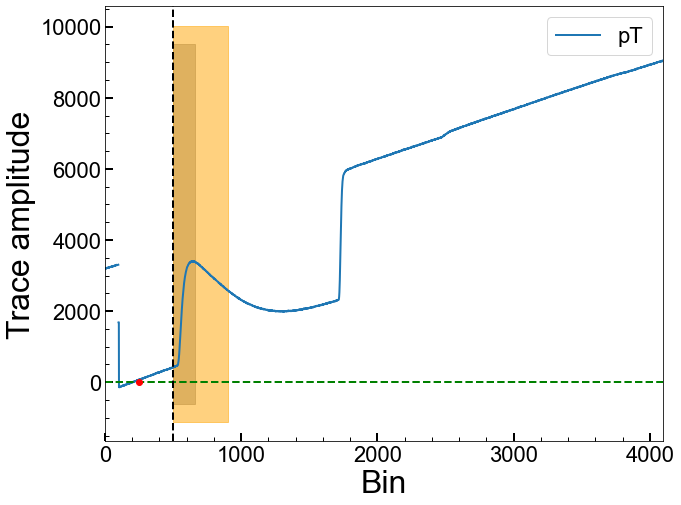

Series Number: 72209171225
Event Number: 700590
Energy: 9.177902697623 keV
Area: 293344.68343435944


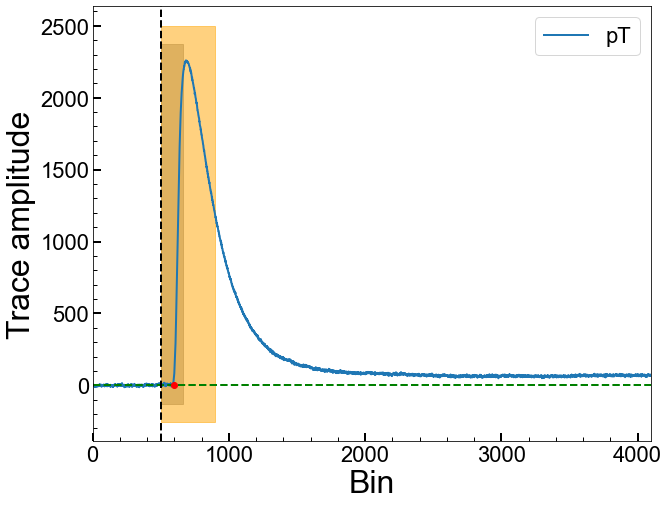

Series Number: 72209171225
Event Number: 730223
Energy: 13.97896805479 keV
Area: 154792.0503150199


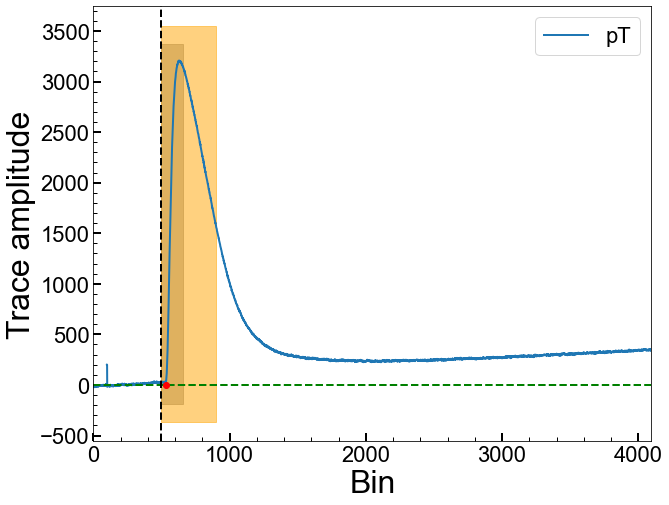

Series Number: 72209171225
Event Number: 730680
Energy: 40.54050831002 keV
Area: 487731.7429306668


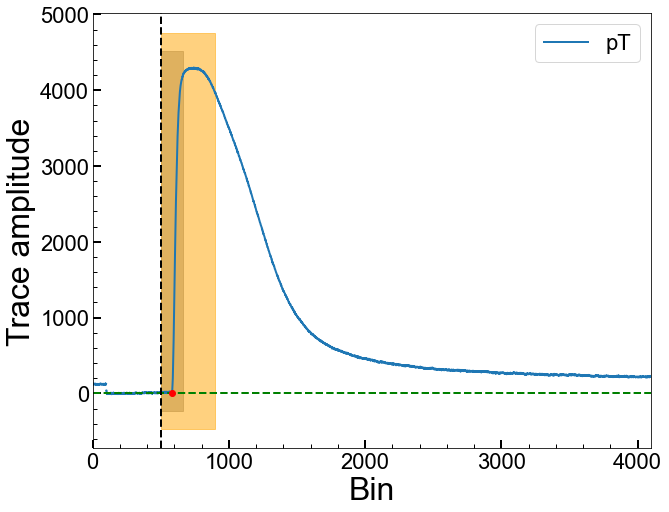

Series Number: 72209171225
Event Number: 780204
Energy: 5.864685877155 keV
Area: 376060.411618501


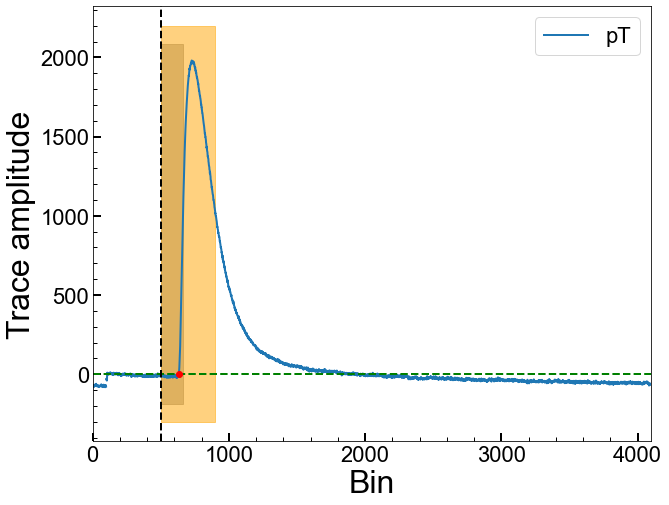

Series Number: 72209171225
Event Number: 780415
Energy: 47.34155838674 keV
Area: -2260811.5518610524


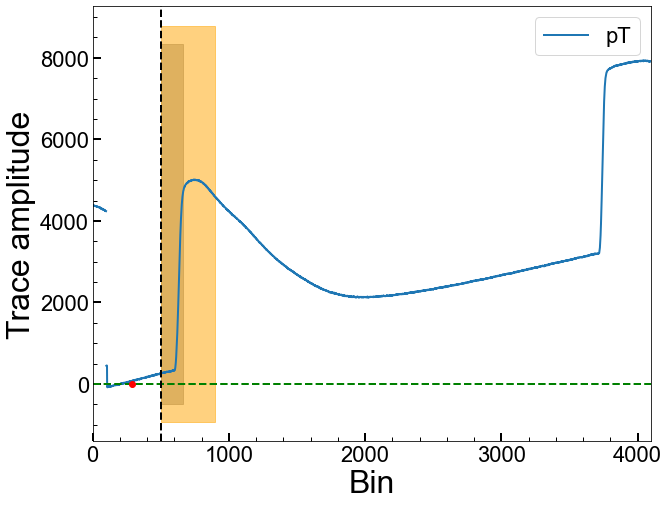

Series Number: 72209171225
Event Number: 780842
Energy: 31.73045198898 keV
Area: 586689.2243030465


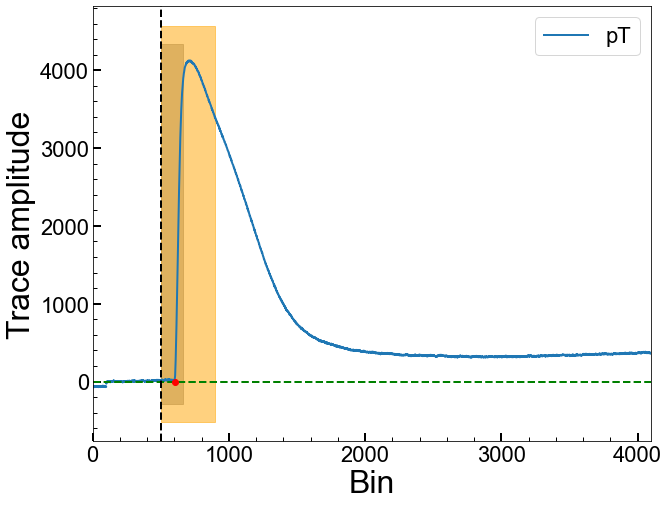

Series Number: 72209171225
Event Number: 790339
Energy: 47.80491315103 keV
Area: 365565.3182007063


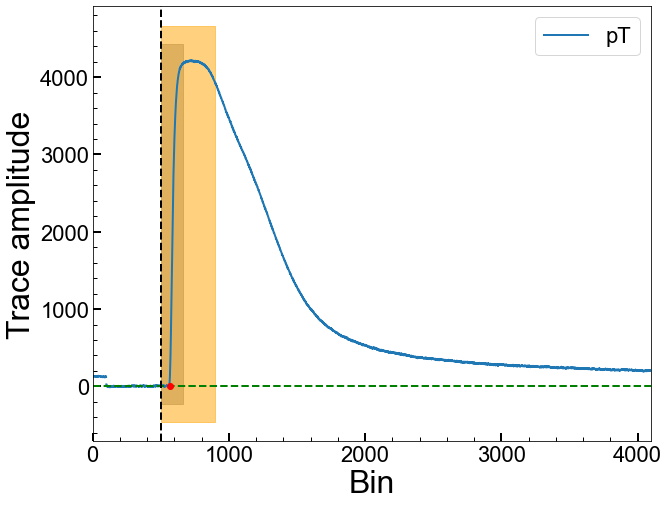

Series Number: 72209171225
Event Number: 800644
Energy: 19.70529634692 keV
Area: -1980316.540239735


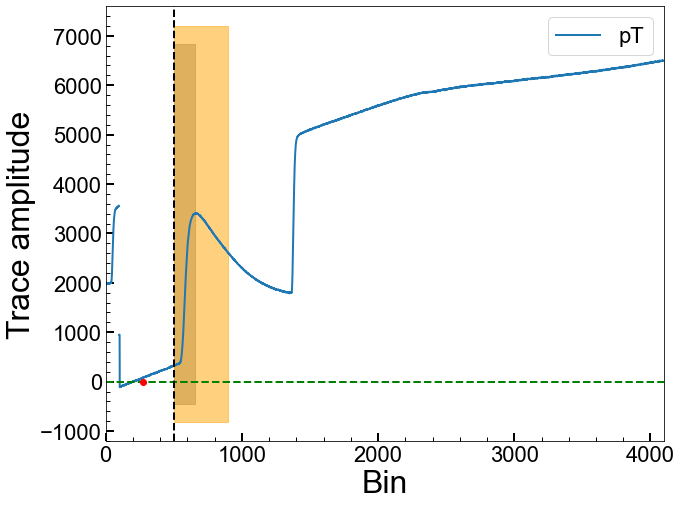

Series Number: 72209171225
Event Number: 810133
Energy: 24.71001572819 keV
Area: 486146.95507156226


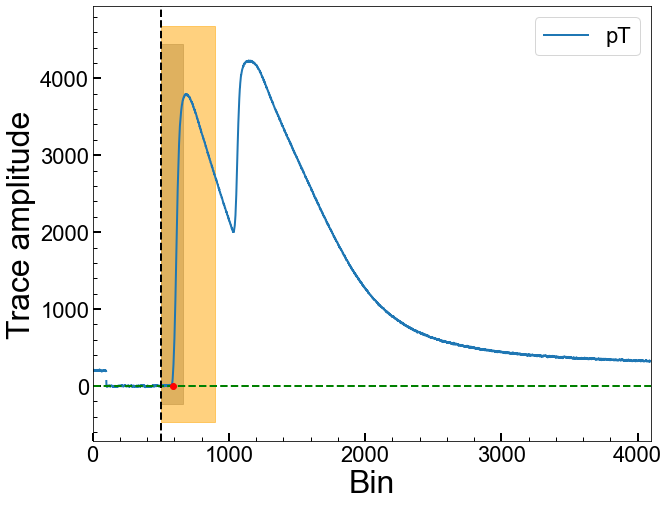

Series Number: 72209171225
Event Number: 820307
Energy: 8.430286017645 keV
Area: 317613.3648643708


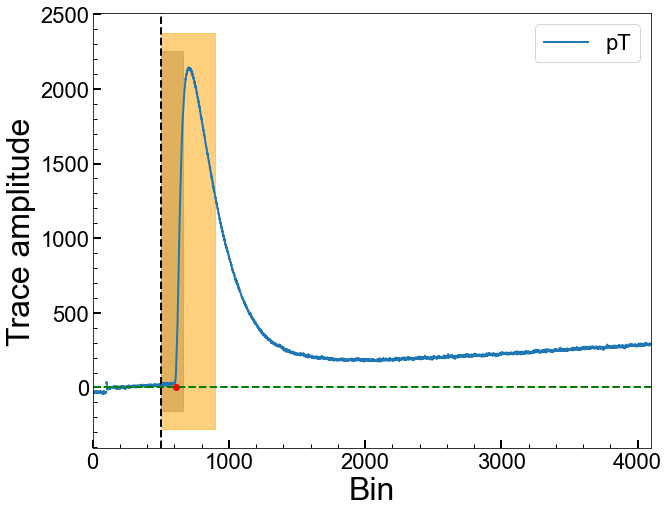

Series Number: 72209171225
Event Number: 830654
Energy: 24.83007775607 keV
Area: 305073.46748798946


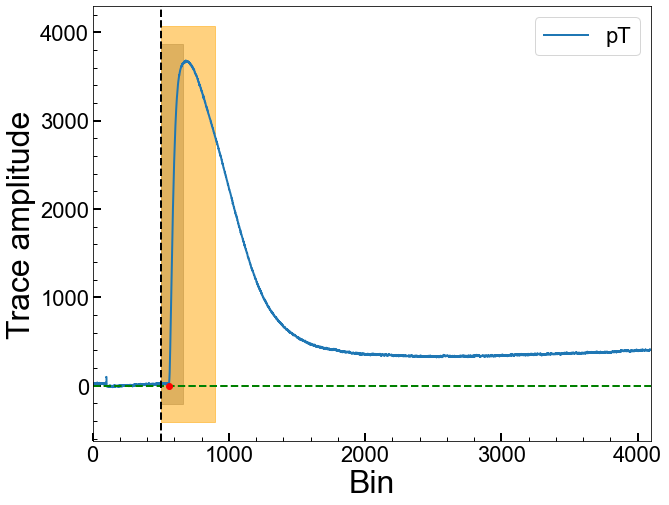

Series Number: 72209171225
Event Number: 850886
Energy: 32.98921670869 keV
Area: 603466.5704809538


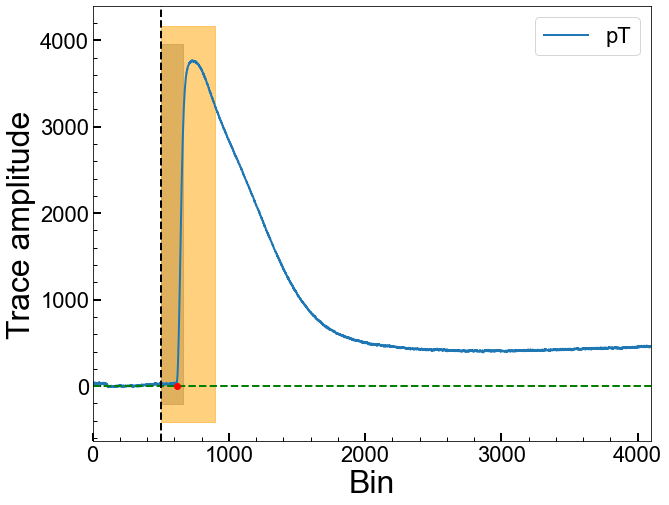

Series Number: 72209171225
Event Number: 860116
Energy: 32.30161731462 keV
Area: 812136.6618746056


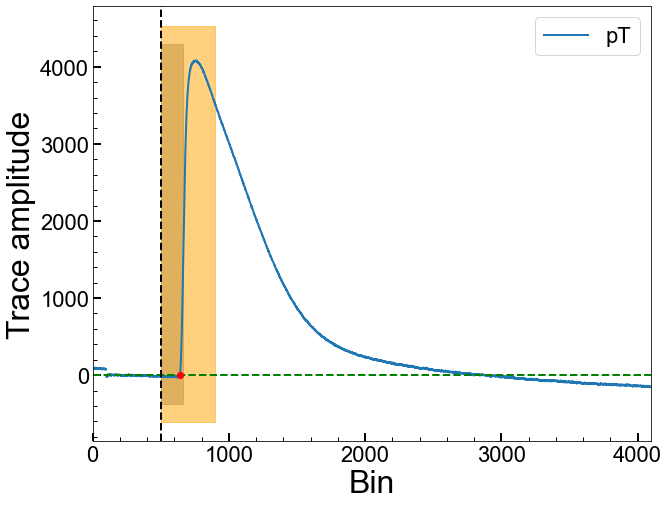

Series Number: 72209171225
Event Number: 870445
Energy: 35.35361961069 keV
Area: 194663.5095384725


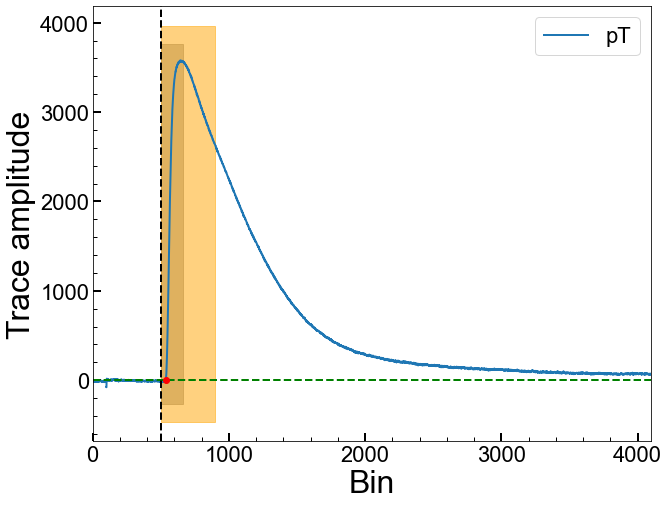

Series Number: 72209171225
Event Number: 880361
Energy: 39.0480913313 keV
Area: -829449.1093161324


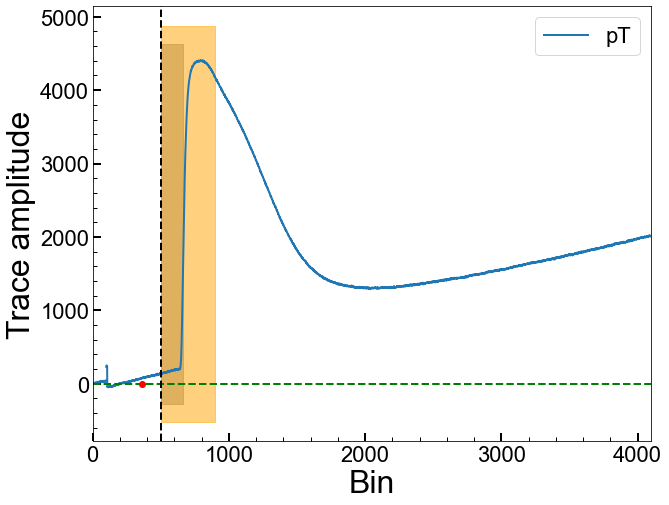

Series Number: 72209171225
Event Number: 880722
Energy: 41.53219020378 keV
Area: 269910.0095566411


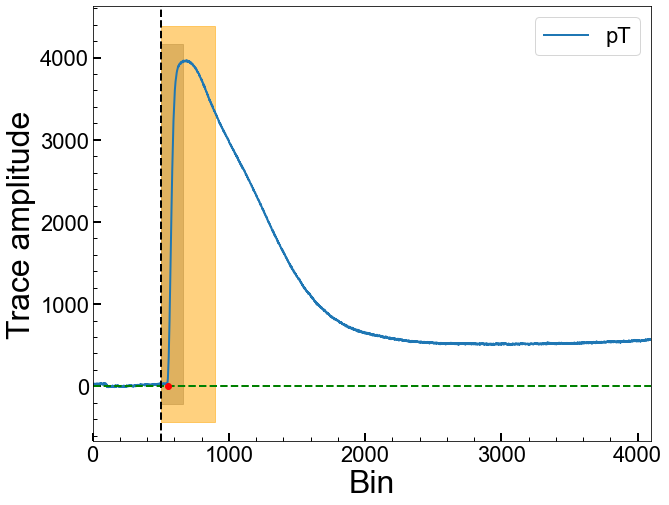

Series Number: 72209171225
Event Number: 890287
Energy: 24.35041036981 keV
Area: 75572.6150965828


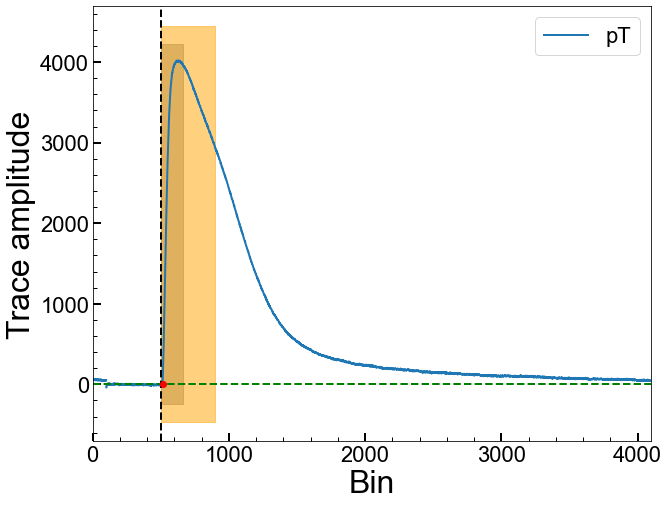

Series Number: 72209171225
Event Number: 900547
Energy: 9.845152666488 keV
Area: 510823.9434590803


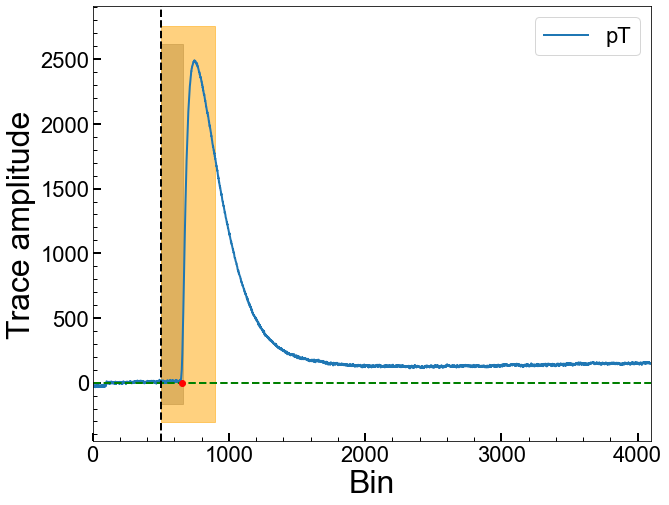

Series Number: 72209171225
Event Number: 950328
Energy: 6.324639374233 keV
Area: 158443.31680191797


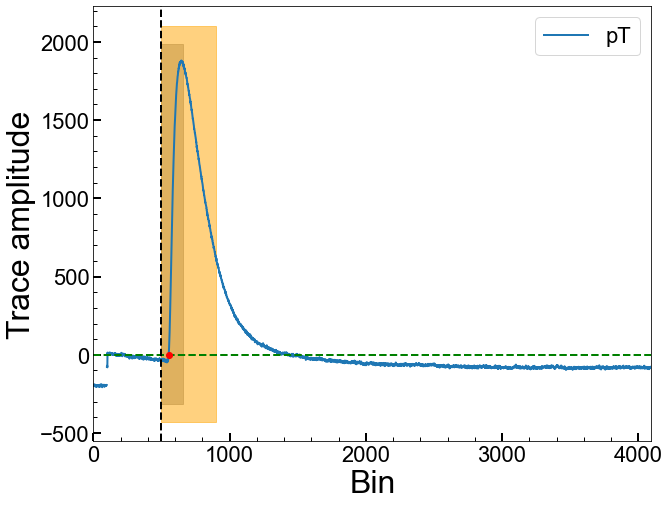

Series Number: 72209171225
Event Number: 960300
Energy: 17.90020867865 keV
Area: 137185.4916777395


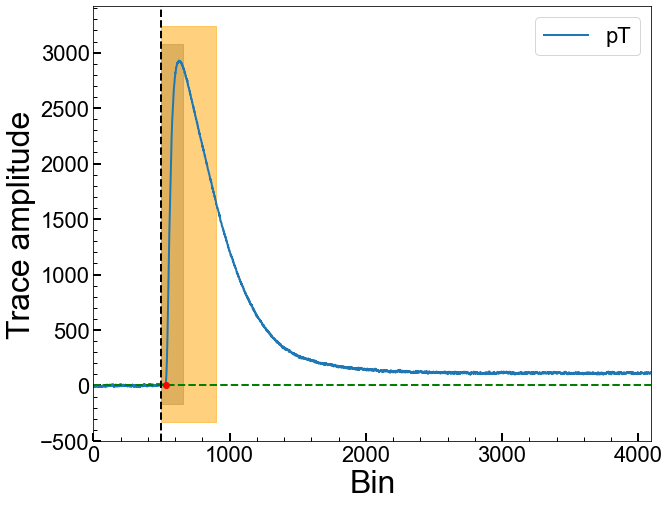

Series Number: 72209171225
Event Number: 960475
Energy: 42.13060604 keV
Area: 181783.15747849015


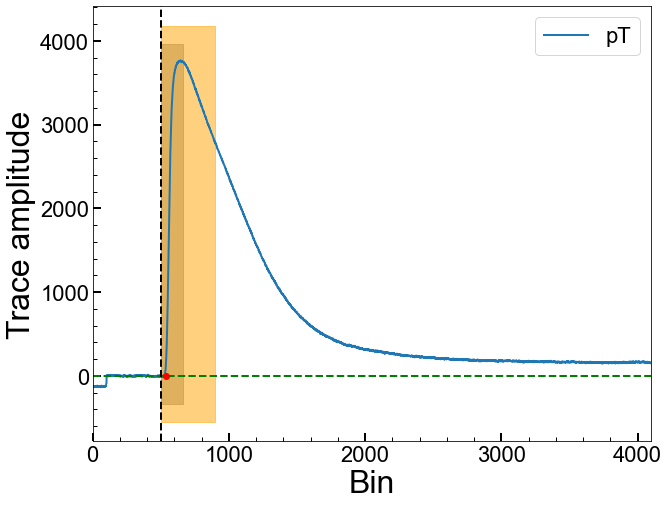

Series Number: 72209171225
Event Number: 970889
Energy: 23.41725709785 keV
Area: 144652.50218733773


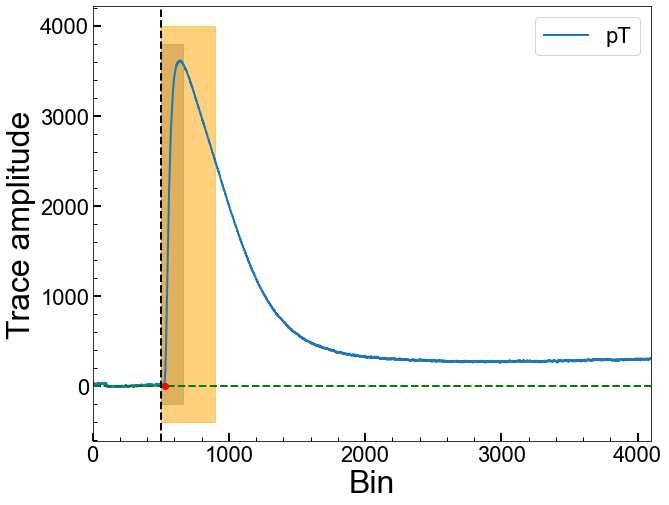

Series Number: 72209171225
Event Number: 980744
Energy: 38.5736971264 keV
Area: 742216.5182470855


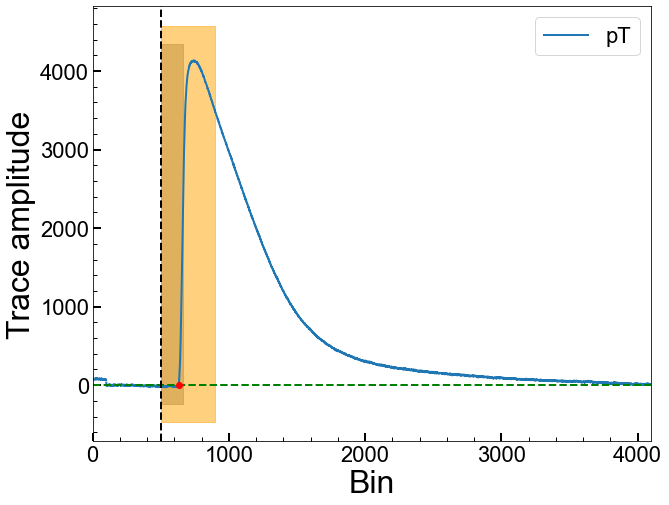

Series Number: 72209171225
Event Number: 990358
Energy: 31.9584847538 keV
Area: 193255.77290479466


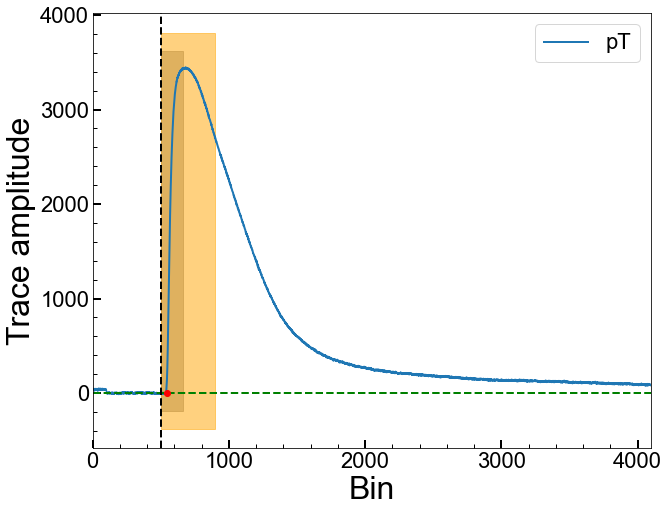

Series Number: 72209171225
Event Number: 1000175
Energy: 20.43535309249 keV
Area: 375838.86879457475


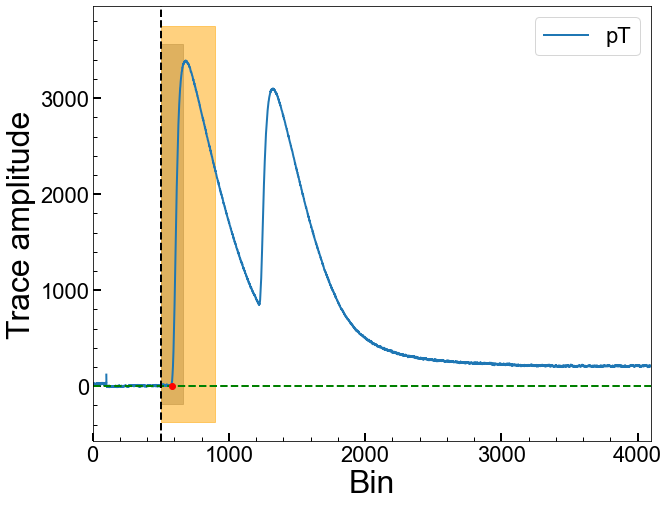

Series Number: 72209171225
Event Number: 1000430
Energy: 34.20848086213 keV
Area: 596334.5629659271


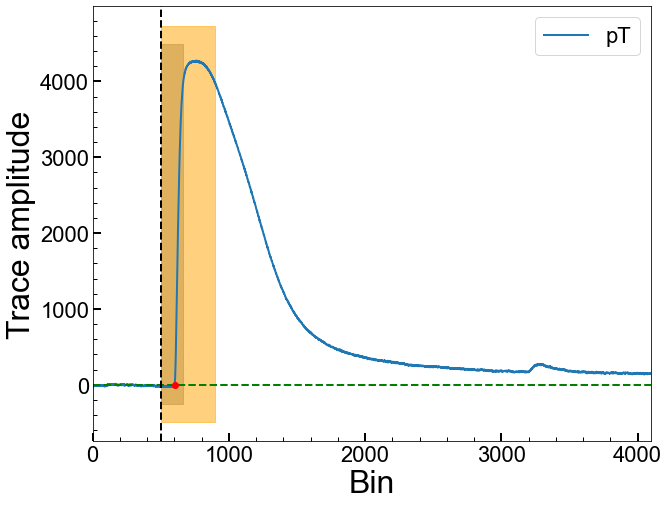

Series Number: 72209171225
Event Number: 1010147
Energy: 20.1061564635 keV
Area: 208739.90660637885


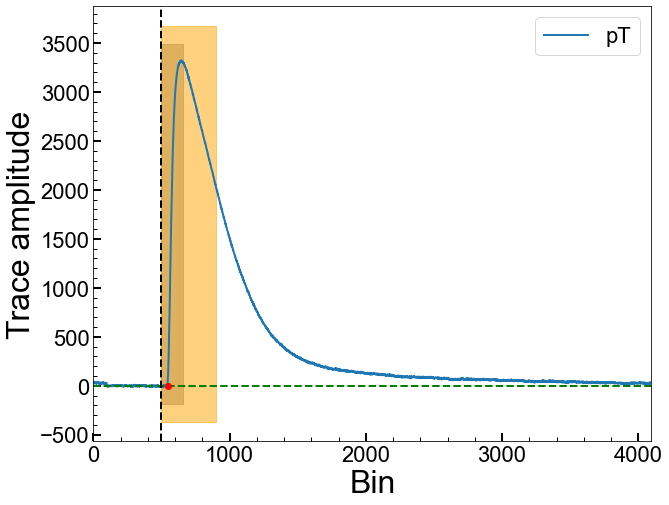

Series Number: 72209171225
Event Number: 1010421
Energy: 11.45145537408 keV
Area: 115055.21204906663


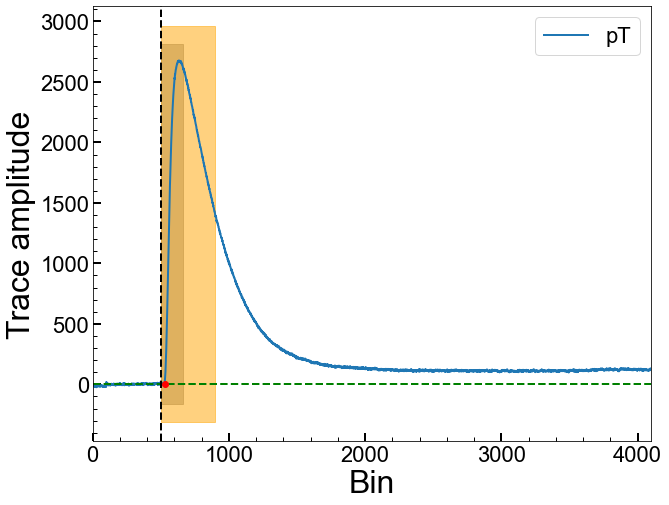

Series Number: 72209171225
Event Number: 1020433
Energy: 22.23847417334 keV
Area: 470332.27198015014


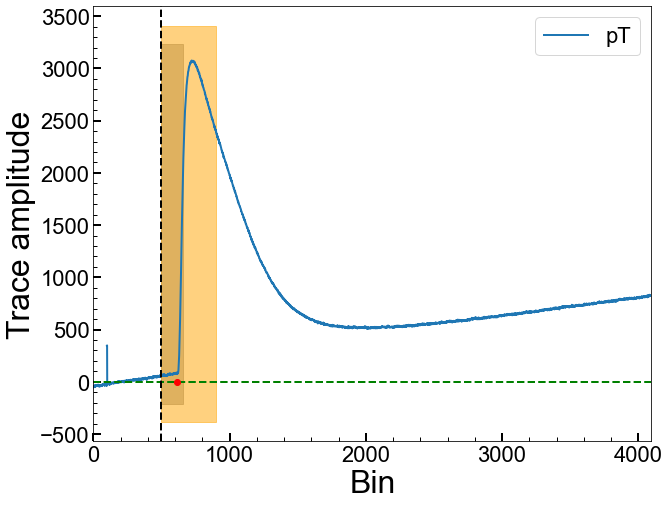

Series Number: 72209171225
Event Number: 1030549
Energy: 43.85855401632 keV
Area: 508510.9747823047


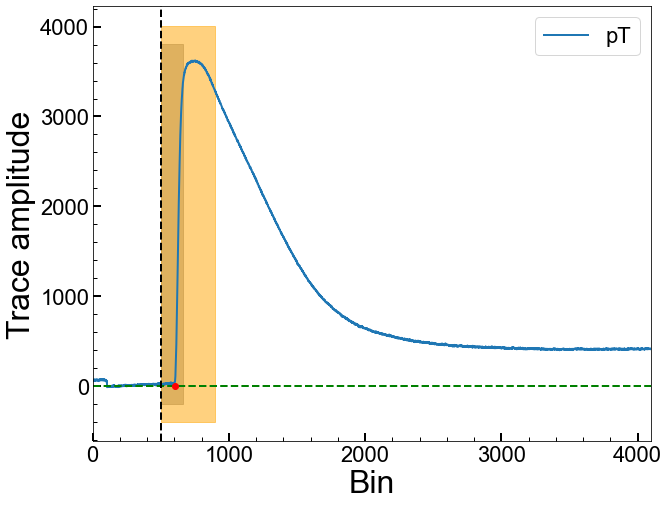

Series Number: 72209171225
Event Number: 1030684
Energy: 43.74976885627 keV
Area: 617461.4104927152


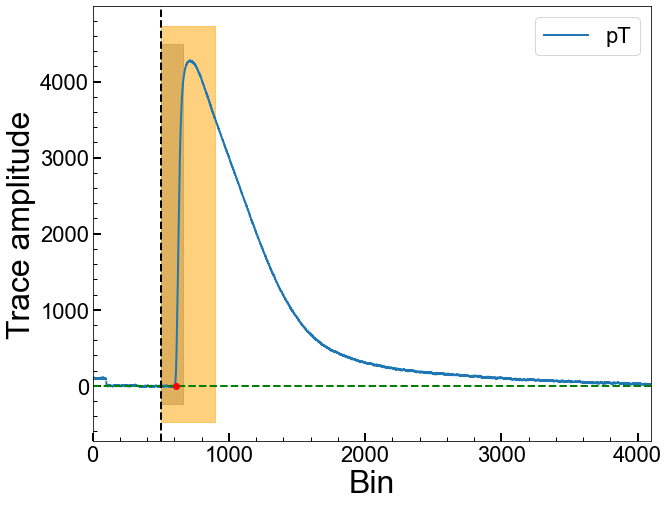

Series Number: 72209171225
Event Number: 1040506
Energy: 36.44885384638 keV
Area: 560304.7359631577


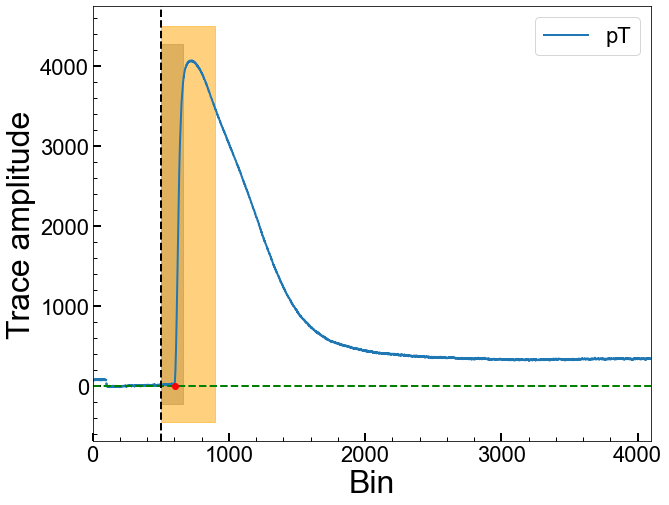

Series Number: 72209171225
Event Number: 1050411
Energy: 2.279092510027 keV
Area: -56389.36812715194


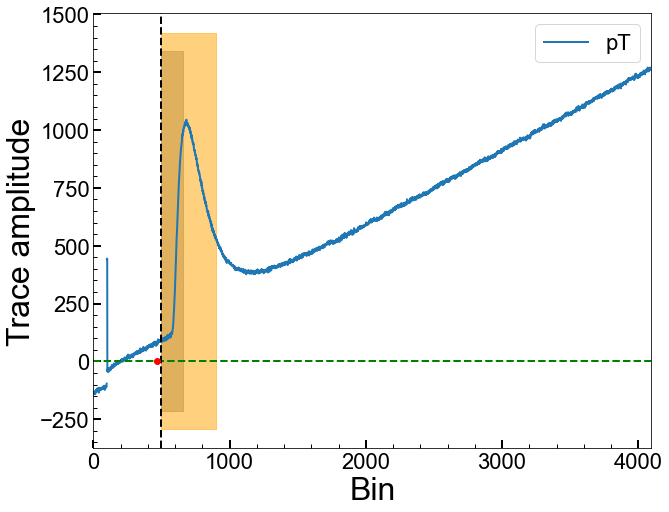

Series Number: 72209171225
Event Number: 1060115
Energy: 47.65557478884 keV
Area: 303041.65125933796


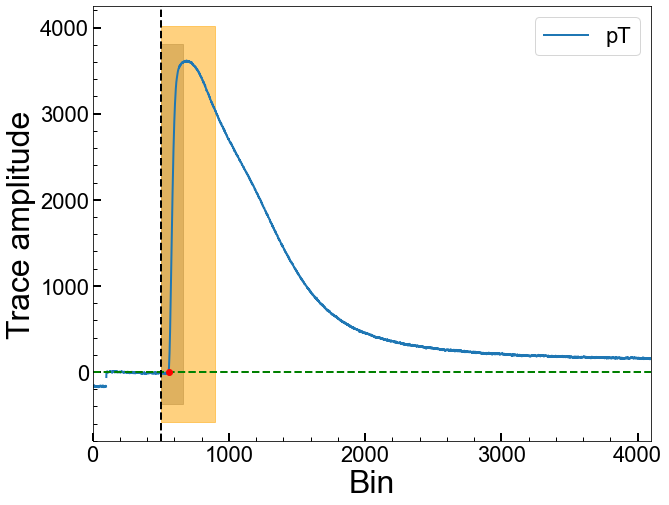

Series Number: 72209171225
Event Number: 1100486
Energy: 27.17756346673 keV
Area: -831258.0754238239


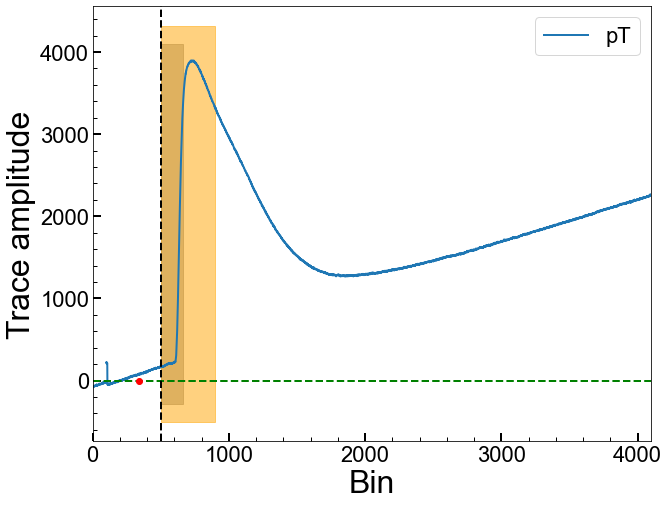

Series Number: 72209171225
Event Number: 1110092
Energy: 20.06989232291 keV
Area: 295929.427930458


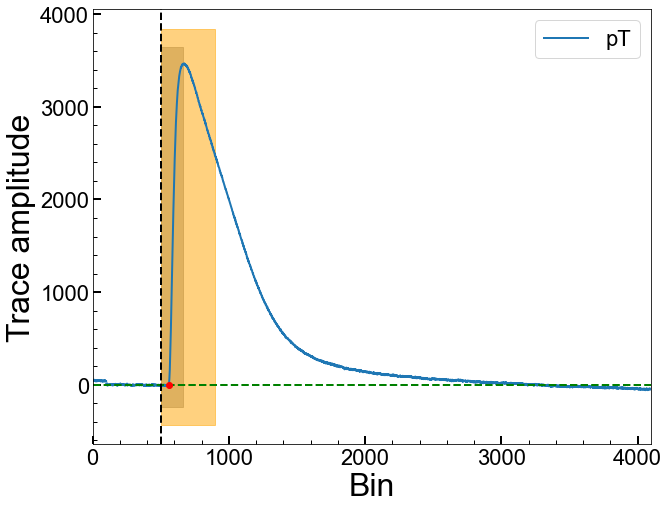

Series Number: 72209171225
Event Number: 1110957
Energy: 47.67061295296 keV
Area: 638952.8111180224


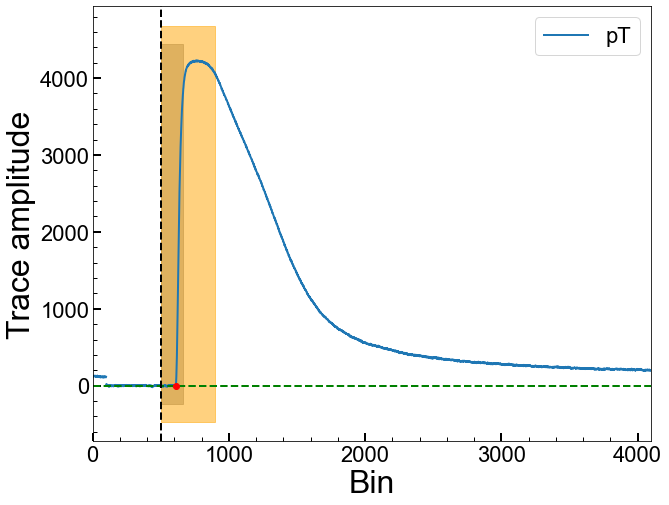

Series Number: 72209171225
Event Number: 1120765
Energy: 43.57792887843 keV
Area: 763459.1000470467


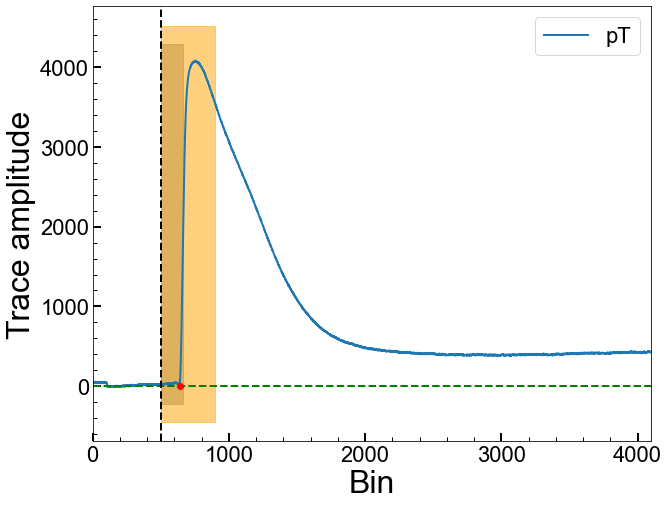

Series Number: 72209171225
Event Number: 1120925
Energy: 4.978870429386 keV
Area: 286347.8950781806


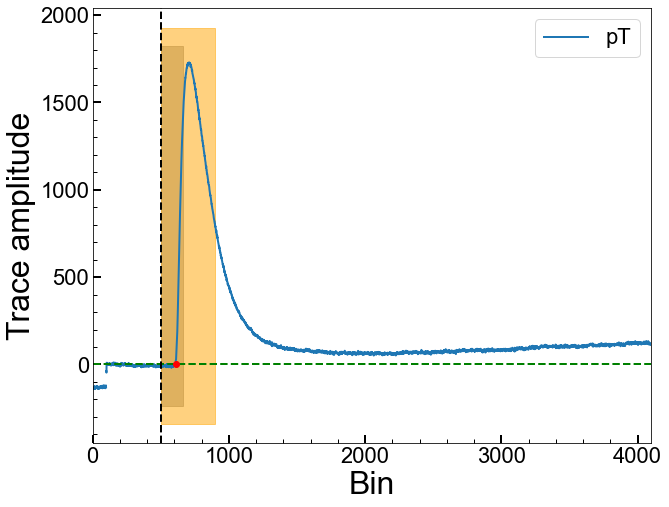

Series Number: 72209171225
Event Number: 1130535
Energy: 22.83133840776 keV
Area: -734317.0716880121


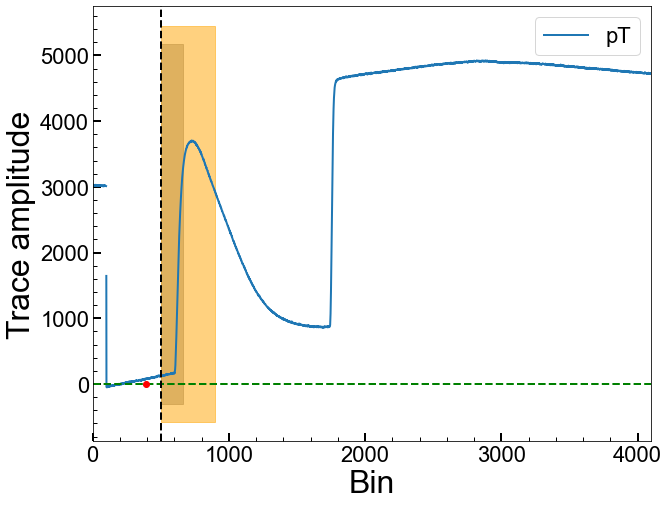

Series Number: 72209171225
Event Number: 1140389
Energy: 20.7601412976 keV
Area: 681108.5339753106


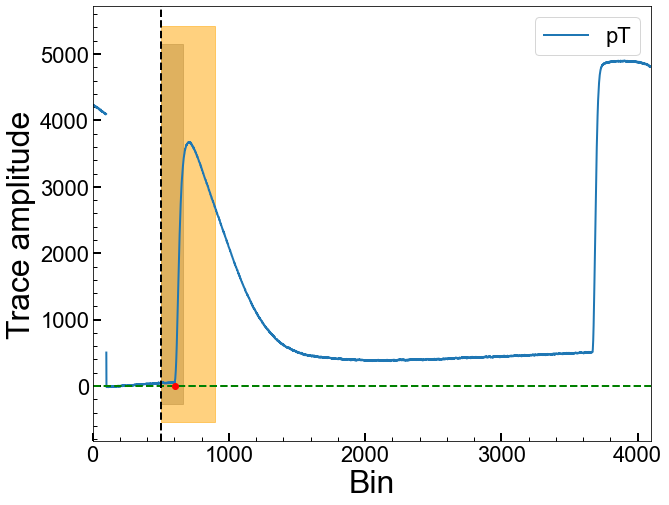

Series Number: 72209171225
Event Number: 1140548
Energy: 15.79242811749 keV
Area: 456735.8484123923


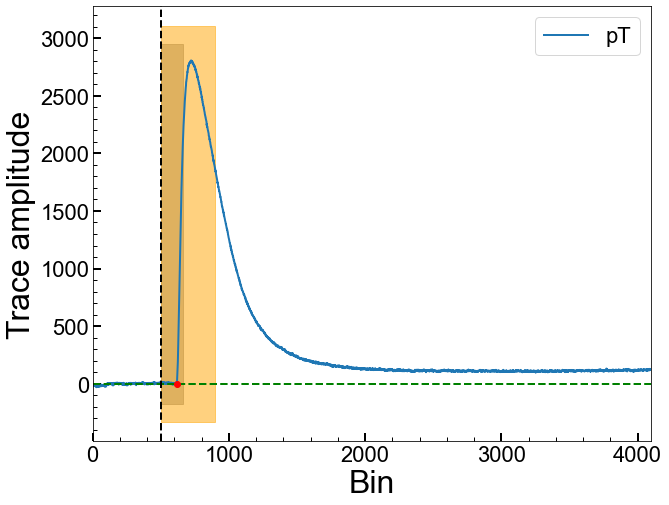

Series Number: 72209171225
Event Number: 1170323
Energy: 13.38100565899 keV
Area: 114378.15638345957


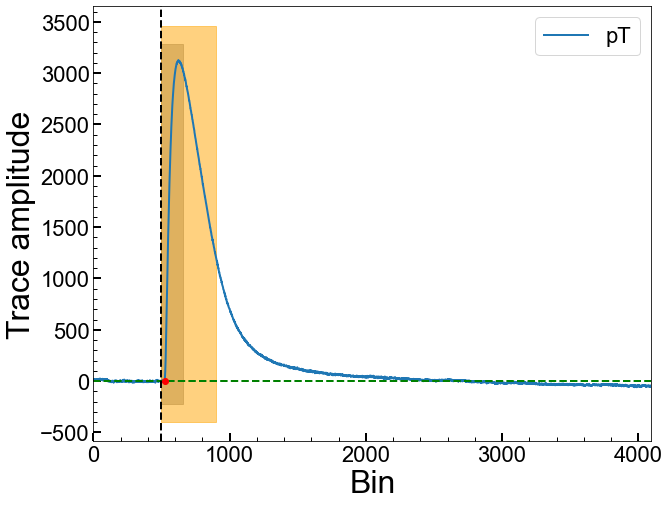

Series Number: 72209171225
Event Number: 1190497
Energy: 2.66794101662 keV
Area: 162864.7394203951


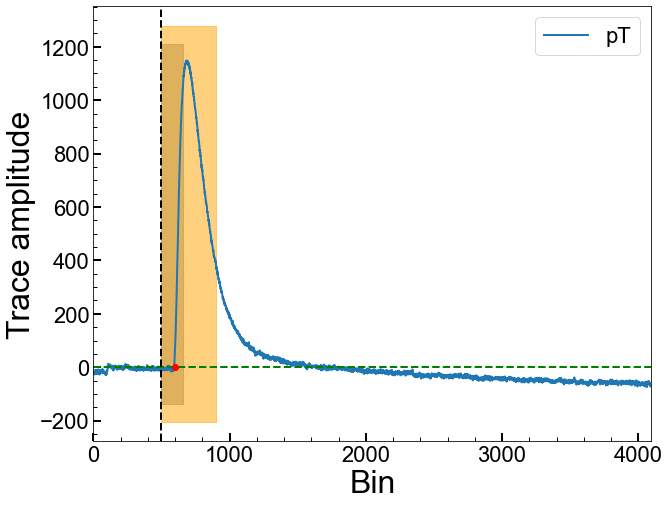

Series Number: 72209171225
Event Number: 1190576
Energy: 15.33871825847 keV
Area: 369535.53616065497


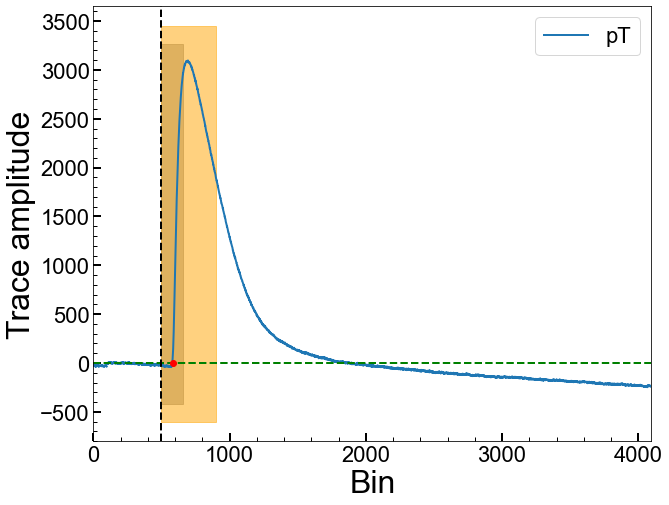

Series Number: 72209171225
Event Number: 1190748
Energy: 23.95194266101 keV
Area: -626273.1246727419


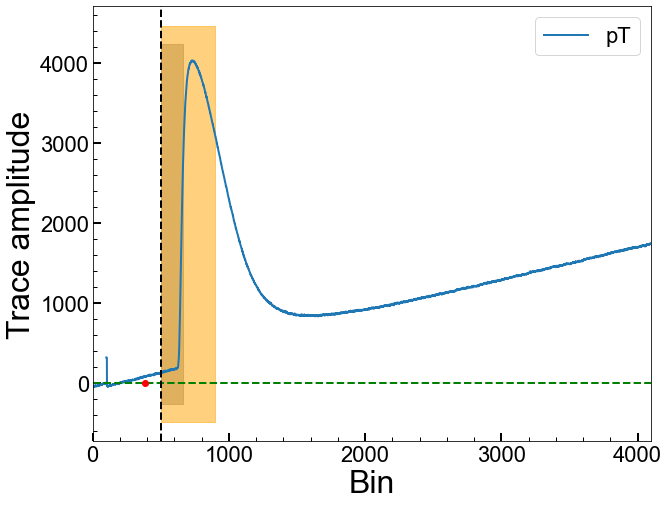

Series Number: 72209171225
Event Number: 1230144
Energy: 21.56206028827 keV
Area: 156752.71845520535


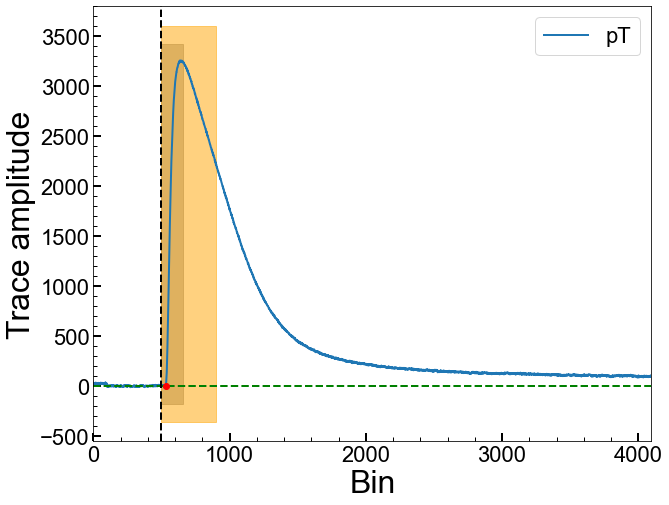

Series Number: 72209171225
Event Number: 1230548
Energy: 48.33277947615 keV
Area: 814125.8412664814


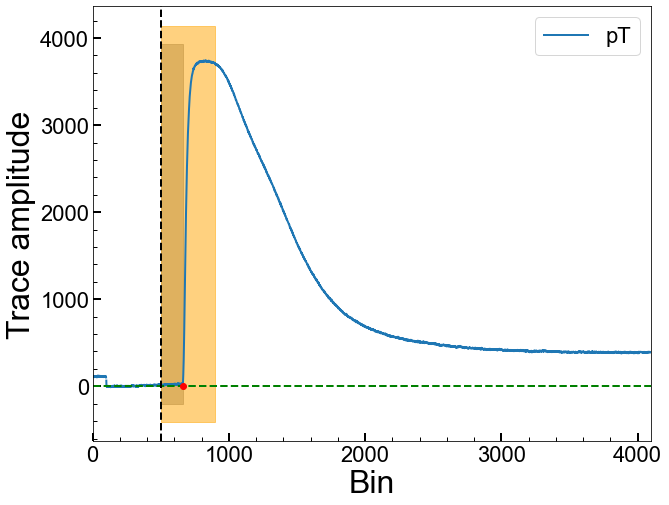

Series Number: 72209171225
Event Number: 1250534
Energy: 5.142703648541 keV
Area: 2086361.1517795767


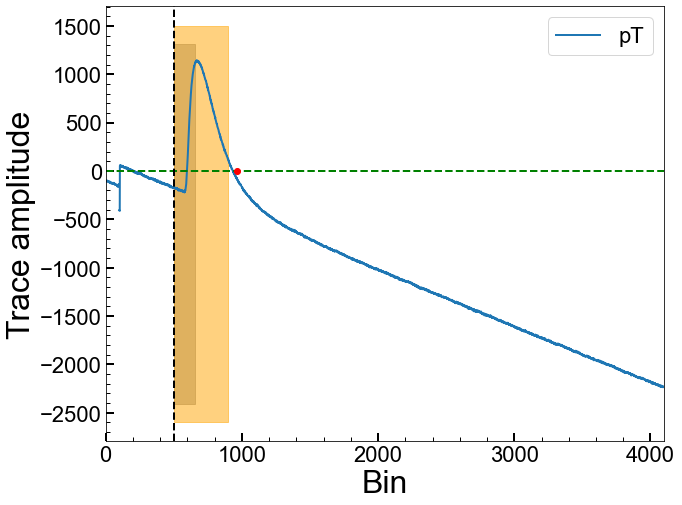

Series Number: 72209171225
Event Number: 1270239
Energy: 16.97563272 keV
Area: 416730.6709585376


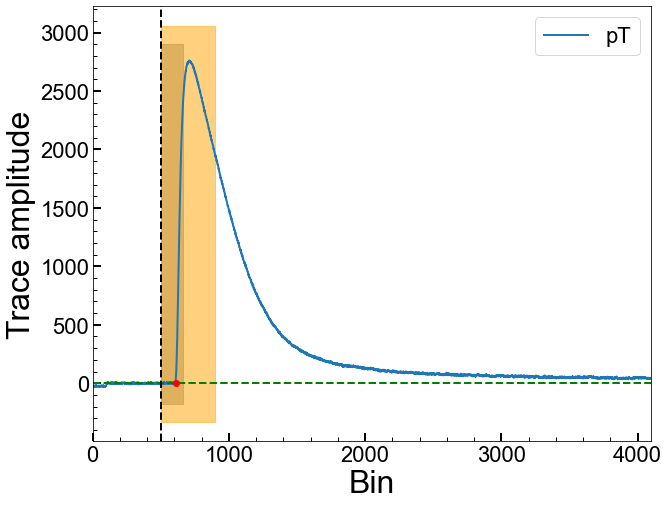

Series Number: 72209171225
Event Number: 1270403
Energy: 41.9451162202 keV
Area: 835908.3326495365


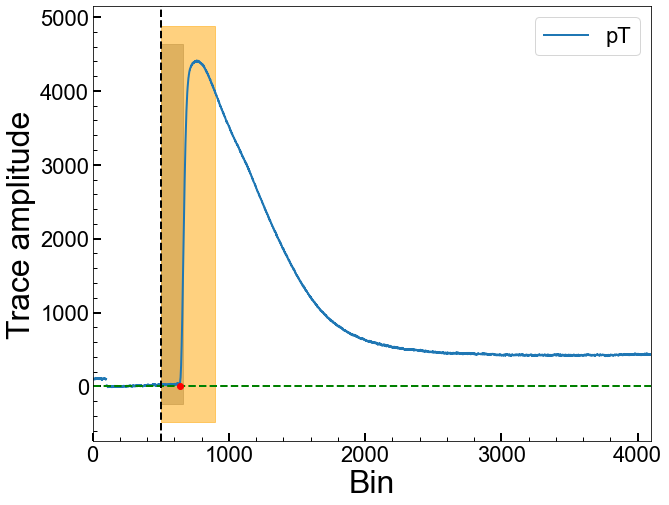

Series Number: 72209171225
Event Number: 1290559
Energy: 12.35324155801 keV
Area: -2394411.9075065833


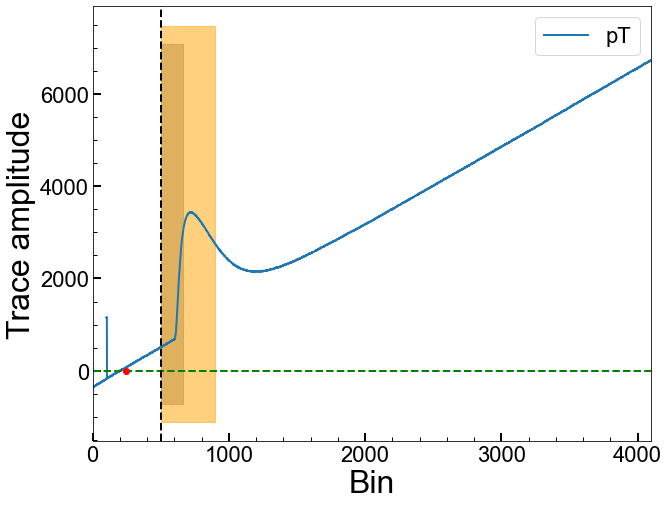

Series Number: 72209171225
Event Number: 1290610
Energy: 27.65761039758 keV
Area: -799448.8319117937


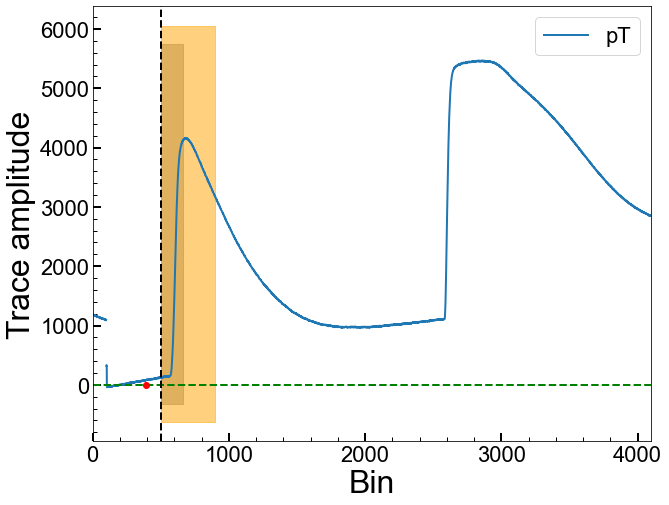

Series Number: 72209171225
Event Number: 1300760
Energy: 35.34866710188 keV
Area: 538368.1158543049


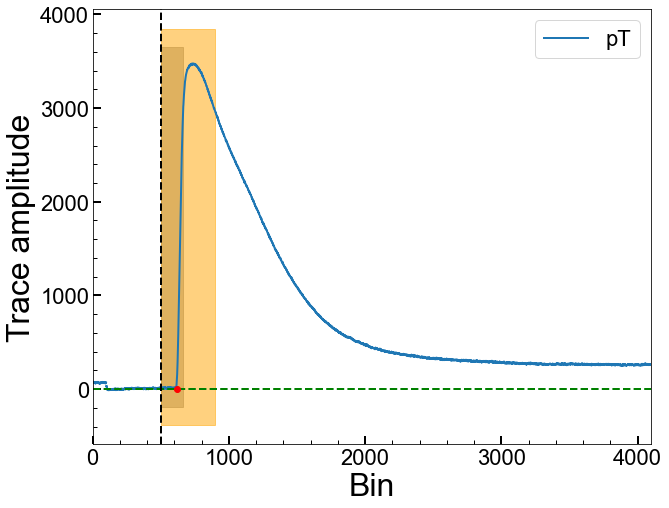

Series Number: 72209171225
Event Number: 1310232
Energy: 47.67562335231 keV
Area: 377799.5534638411


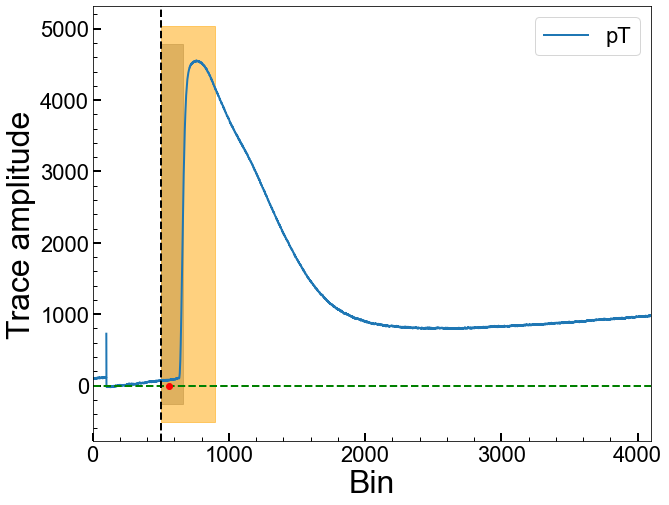

Series Number: 72209171225
Event Number: 1310711
Energy: 16.06490920904 keV
Area: 627329.6451546281


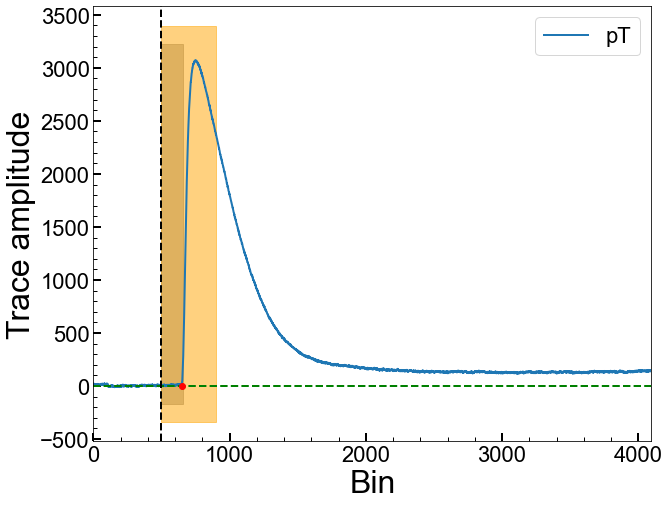

Series Number: 72209171225
Event Number: 1310816
Energy: 13.77983351672 keV
Area: -865559.3754055632


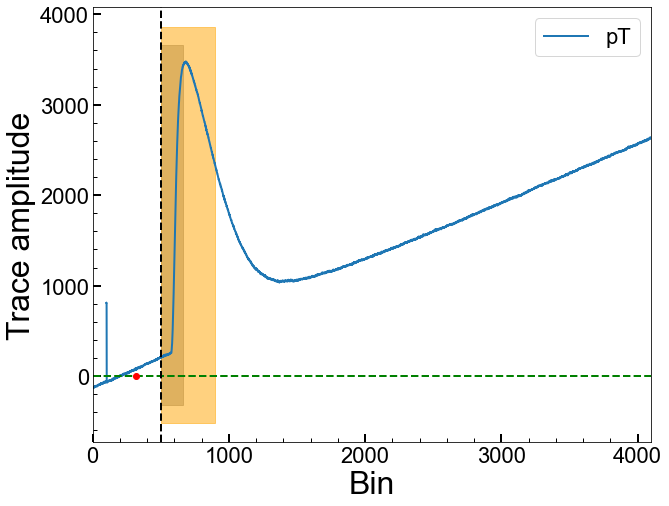

Series Number: 72209171225
Event Number: 1360373
Energy: 47.84446860289 keV
Area: 575487.7207427287


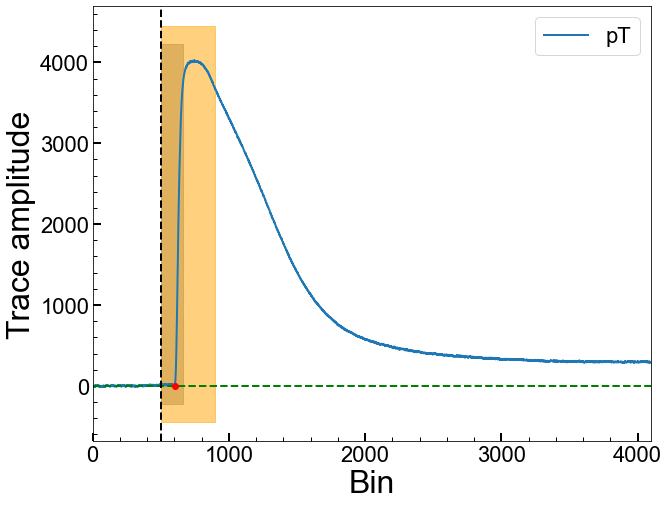

Series Number: 72209171225
Event Number: 1360719
Energy: 13.76104622501 keV
Area: 515906.3301799948


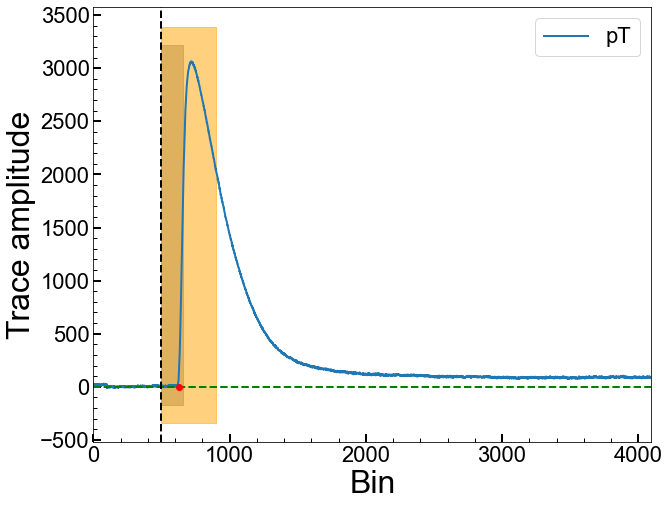

Series Number: 72209171225
Event Number: 1400479
Energy: 35.41937727087 keV
Area: -1832575.5280826818


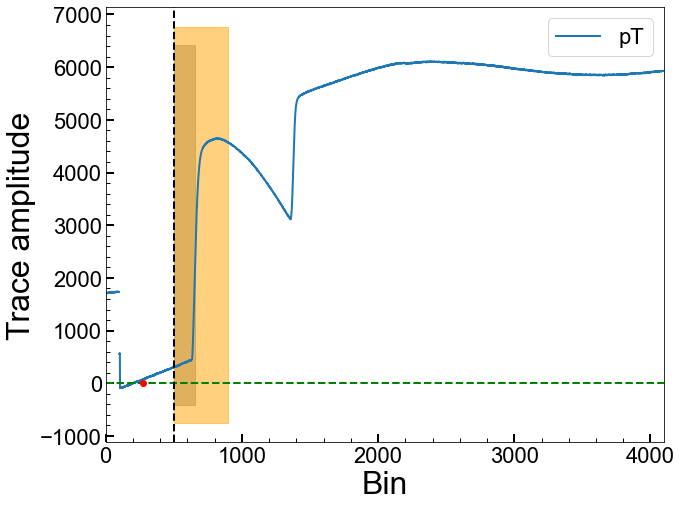

Series Number: 72209171225
Event Number: 1410617
Energy: 20.40535790713 keV
Area: 151389.82444684225


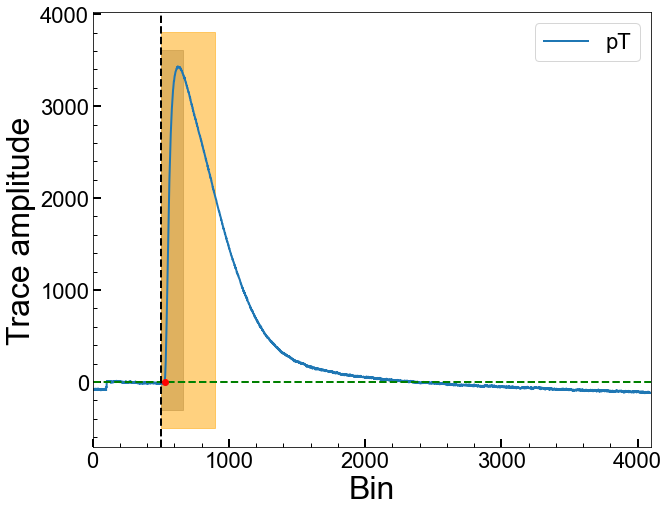

Series Number: 72209171225
Event Number: 1440562
Energy: 48.98786369619 keV
Area: 333937.54596942


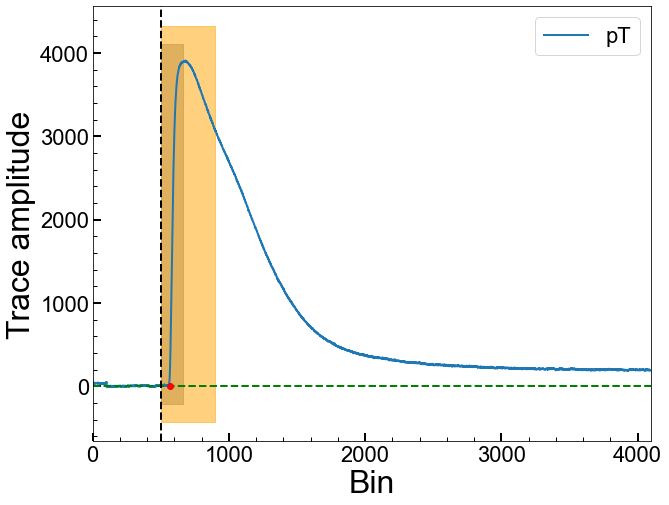

Series Number: 72209171225
Event Number: 1460846
Energy: 34.0557146395 keV
Area: 668945.3963154898


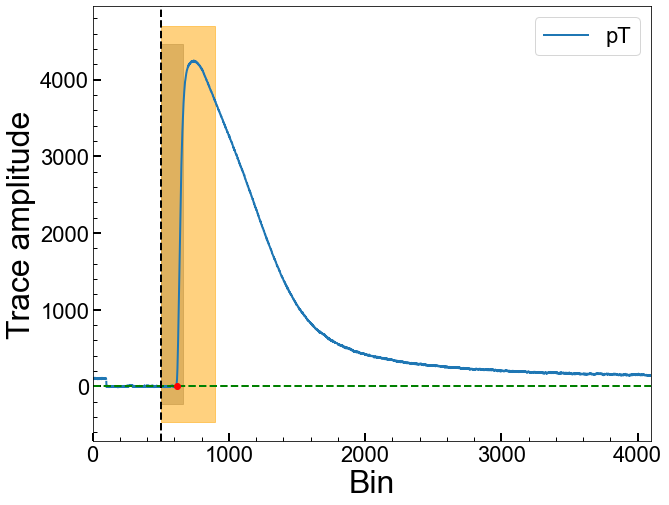

Series Number: 72209171225
Event Number: 1470168
Energy: 24.70039216044 keV
Area: 800267.9628941279


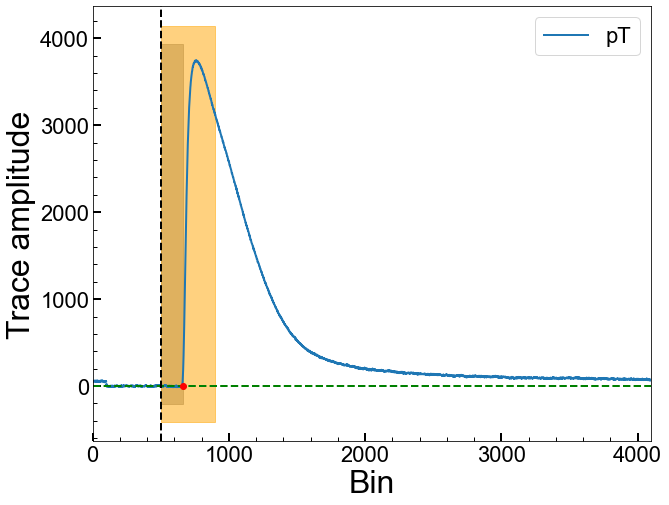

Series Number: 72209171225
Event Number: 1470591
Energy: 41.2208634506 keV
Area: 711931.0859994668


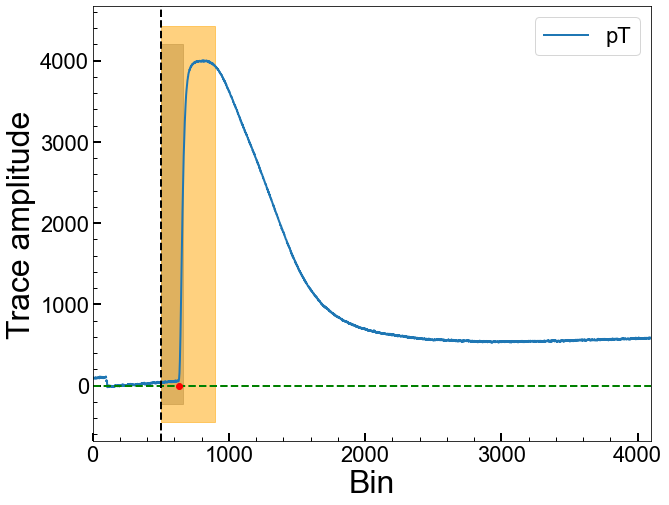

Series Number: 72209171225
Event Number: 1480145
Energy: 49.21850561232 keV
Area: 367875.9068637881


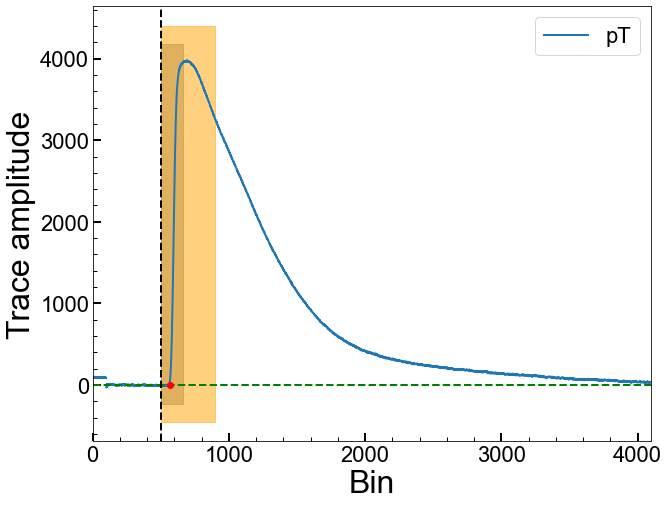

Series Number: 72209171225
Event Number: 1490333
Energy: 32.11985031298 keV
Area: 519013.48431819864


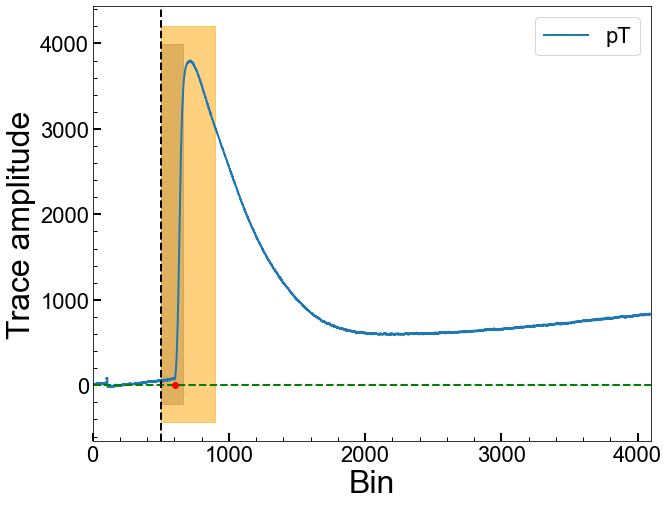

Series Number: 72209171225
Event Number: 1490498
Energy: 21.18832769729 keV
Area: 560626.0464853301


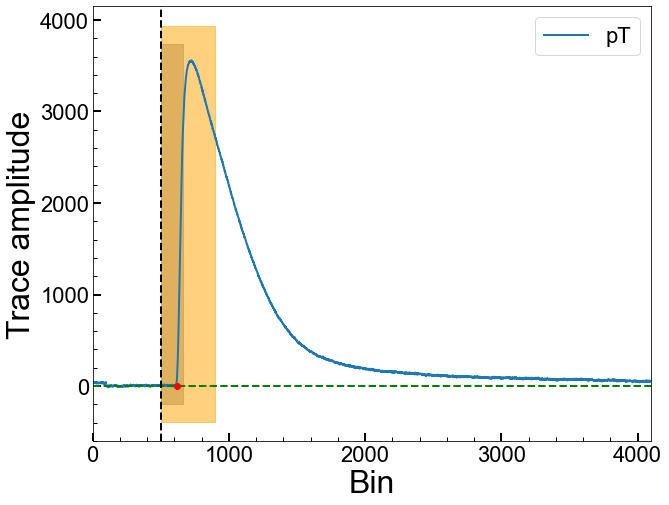

Series Number: 72209171225
Event Number: 1490691
Energy: 19.97279944457 keV
Area: 461667.7527904279


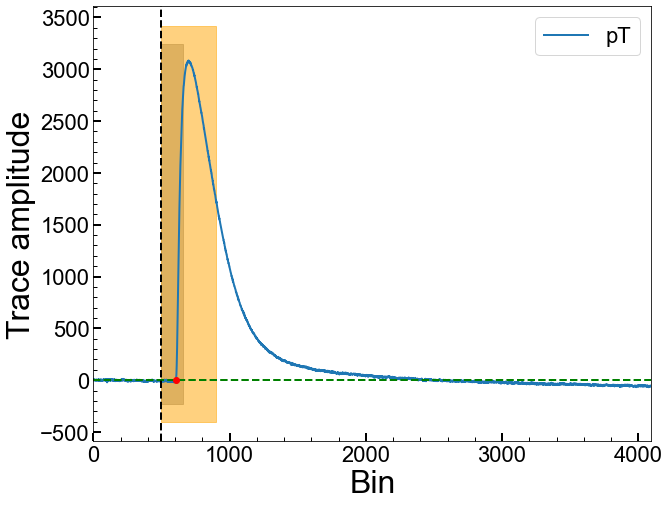

Series Number: 72209171225
Event Number: 1500398
Energy: 22.52943306901 keV
Area: 430463.56696884794


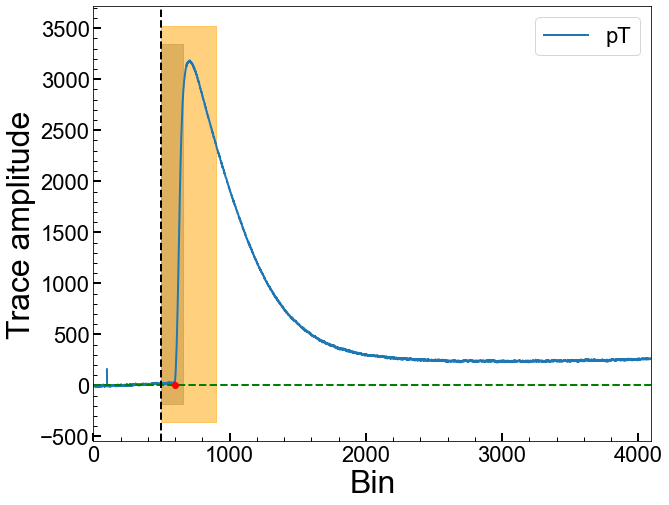

Series Number: 72209171225
Event Number: 1520566
Energy: 8.569383818435 keV
Area: 290298.49601147906


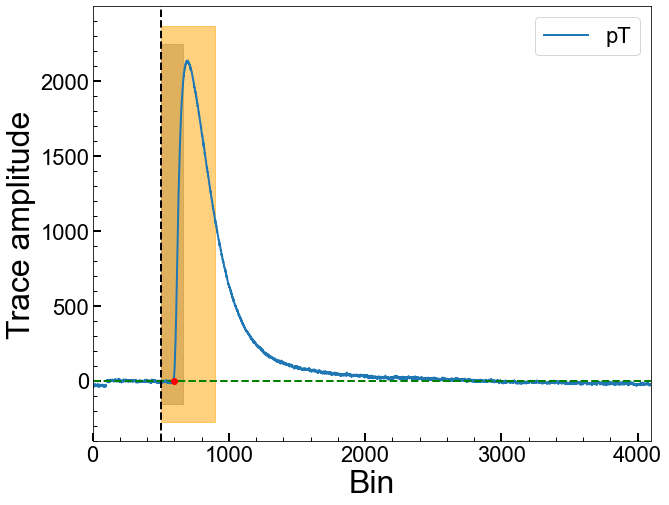

Series Number: 72209171225
Event Number: 1550080
Energy: 28.07235963595 keV
Area: -497058.70221191546


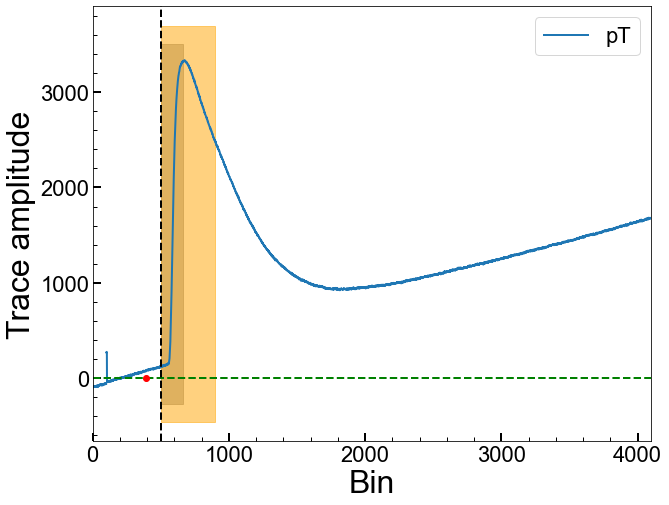

Series Number: 72209171225
Event Number: 1550705
Energy: 23.802300759 keV
Area: 488187.32503841067


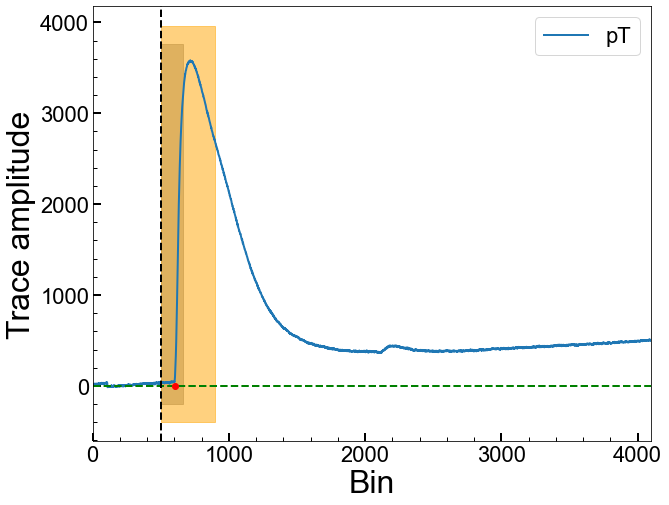

Series Number: 72209171225
Event Number: 1560841
Energy: 2.865328825931 keV
Area: 216758.3972225162


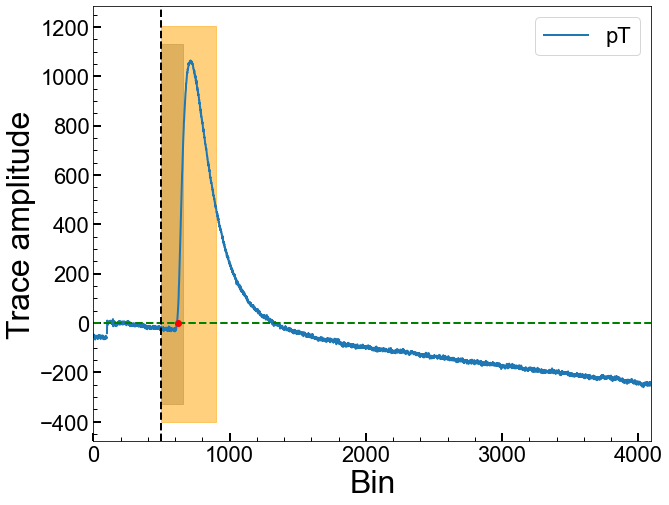

Series Number: 72209171225
Event Number: 1580184
Energy: 22.53605723377 keV
Area: 92033.74419373603


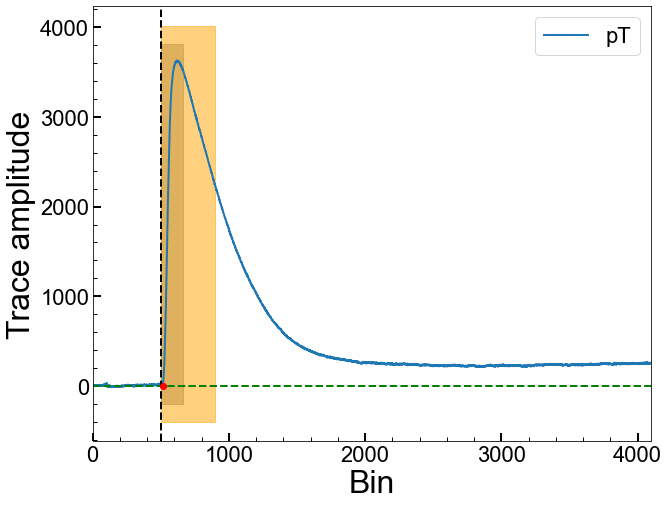

Series Number: 72209171225
Event Number: 1580809
Energy: 28.5014877329 keV
Area: 484493.77166254824


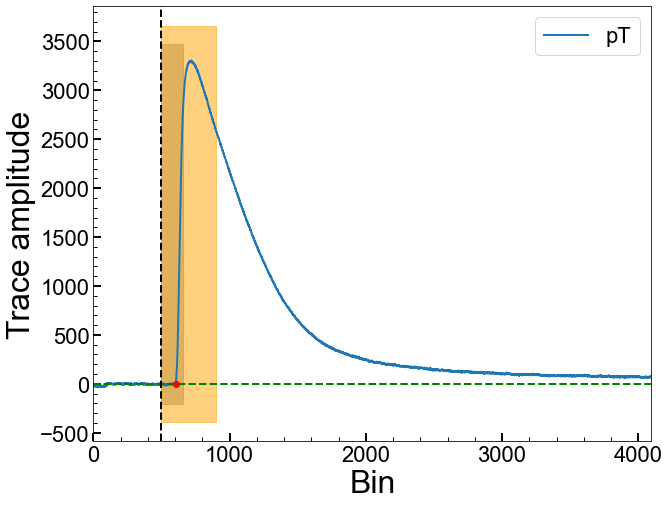

Series Number: 72209171225
Event Number: 1590110
Energy: 32.68145054781 keV
Area: 398763.5081451904


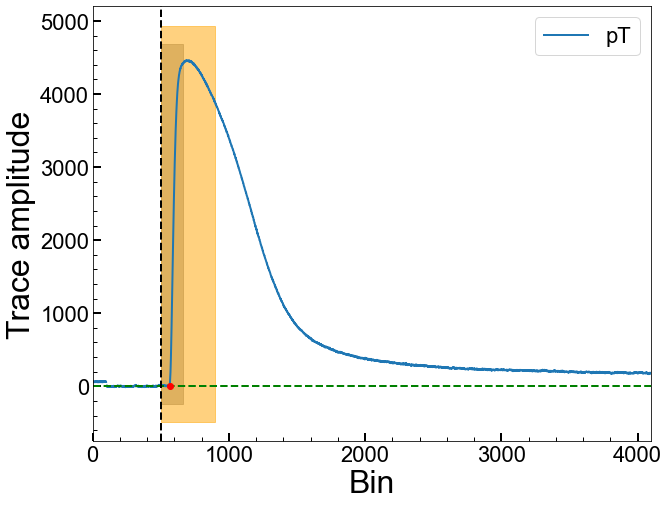

Series Number: 72209171225
Event Number: 1590864
Energy: 4.028253665348 keV
Area: 128570.50207136346


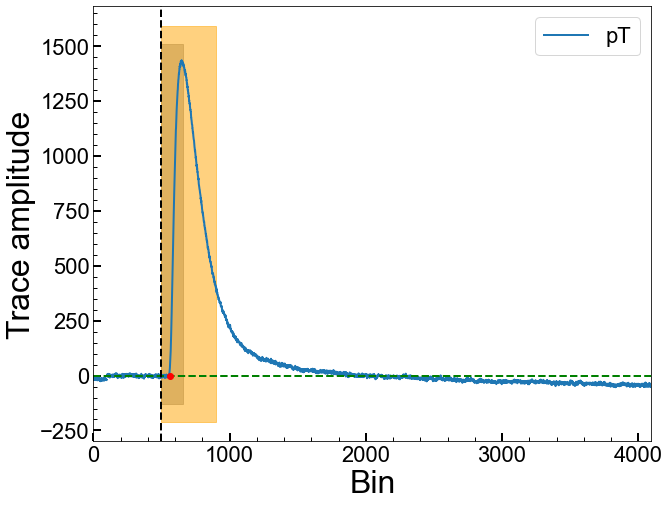

Series Number: 72209171225
Event Number: 1620720
Energy: 22.16206935016 keV
Area: 397710.5191300925


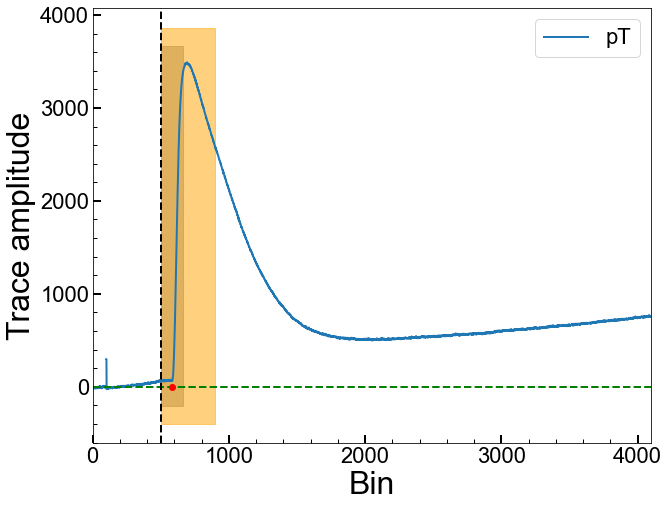

Series Number: 72209171225
Event Number: 1640733
Energy: 23.77887722799 keV
Area: 580114.1951903312


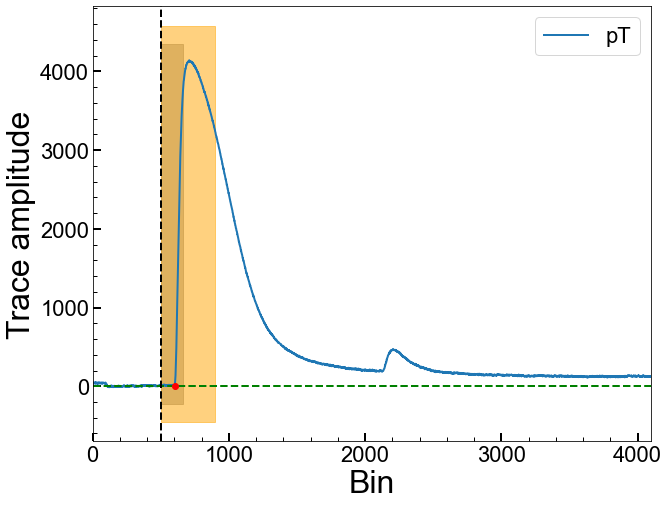

Series Number: 72209171225
Event Number: 1650167
Energy: 5.225447244414 keV
Area: 56748.20320265962


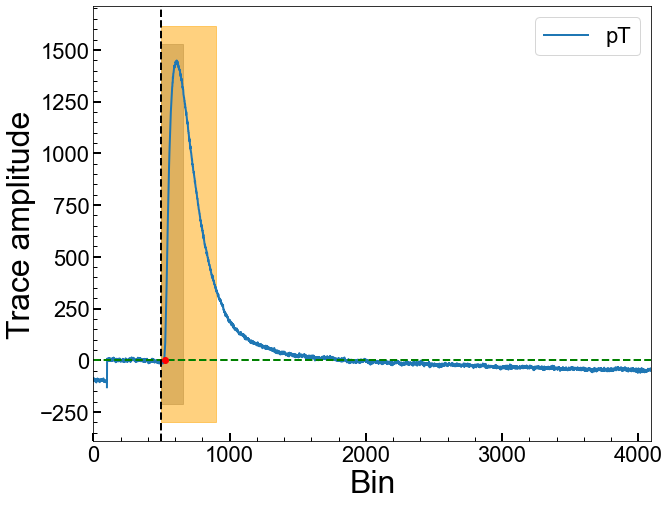

Series Number: 72209171225
Event Number: 1680387
Energy: 22.29055139621 keV
Area: 526370.2448246537


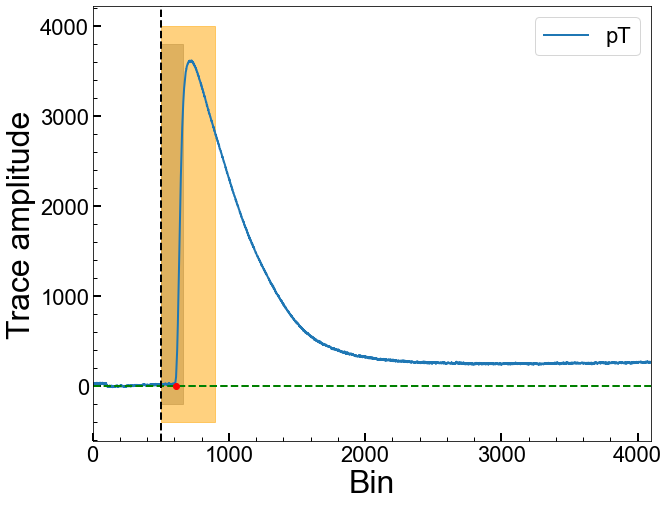

Series Number: 72209171225
Event Number: 1680462
Energy: 38.90559646364 keV
Area: 782281.1801982096


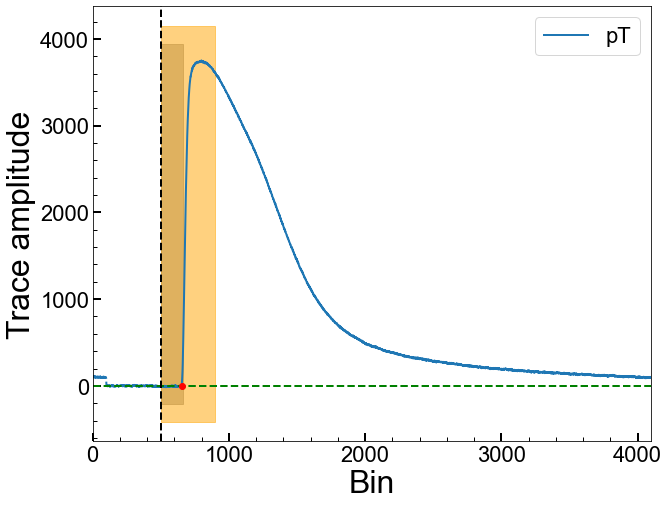

Series Number: 72209171225
Event Number: 1690377
Energy: 44.66517744464 keV
Area: 416903.89995155827


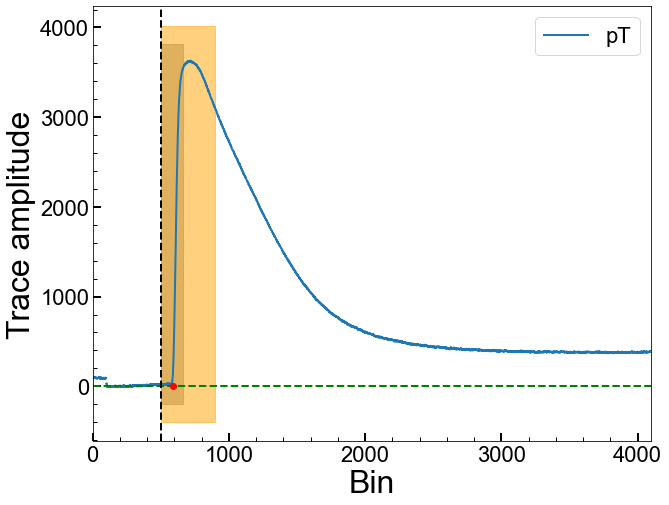

Series Number: 72209171225
Event Number: 1690777
Energy: 38.50492073466 keV
Area: 536544.7868027973


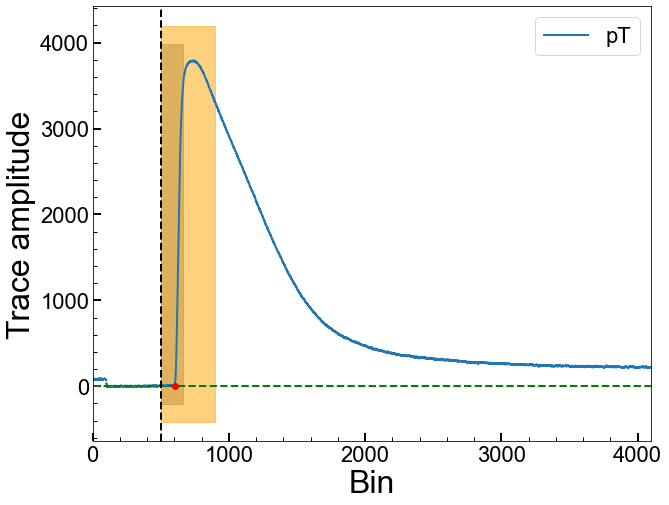

Series Number: 72209171225
Event Number: 1700015
Energy: 3.772400527502 keV
Area: -1270946.2218755397


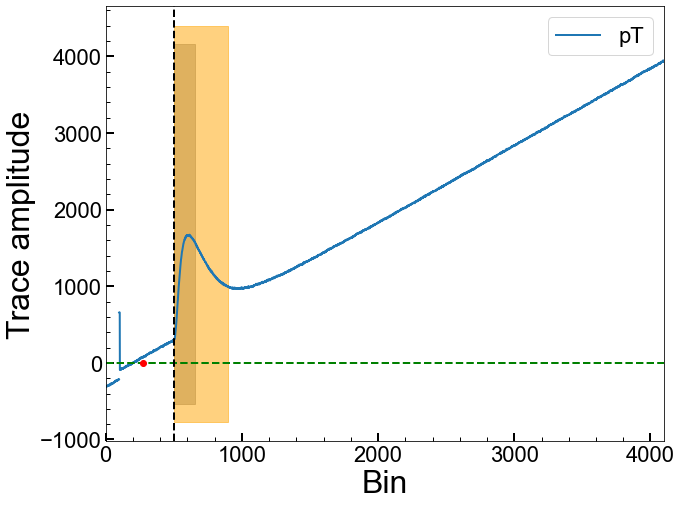

Series Number: 72209171225
Event Number: 1700564
Energy: 28.87120554132 keV
Area: -269266.19668377214


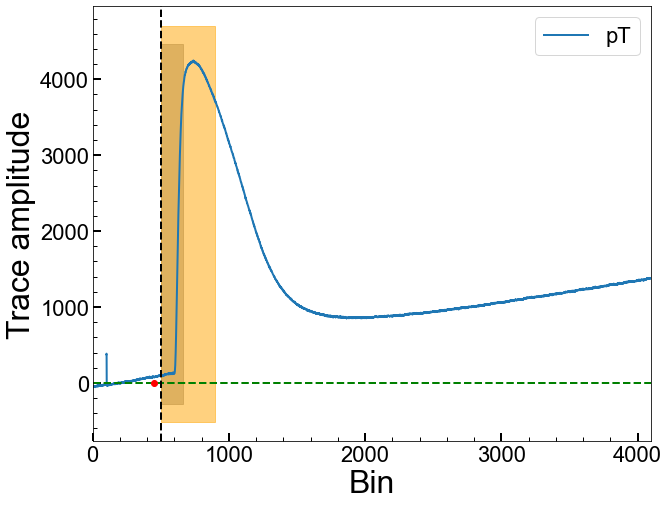

Series Number: 72209171225
Event Number: 1700785
Energy: 11.62169564133 keV
Area: 405349.6937504424


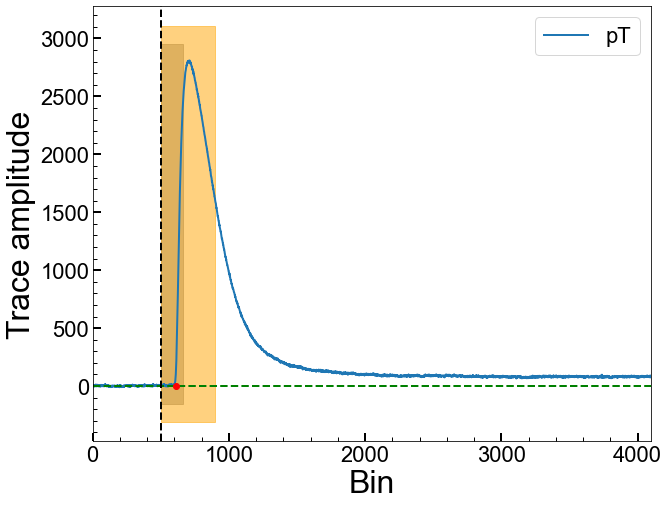

Series Number: 72209171225
Event Number: 1710583
Energy: 46.82038276988 keV
Area: 298619.97267986235


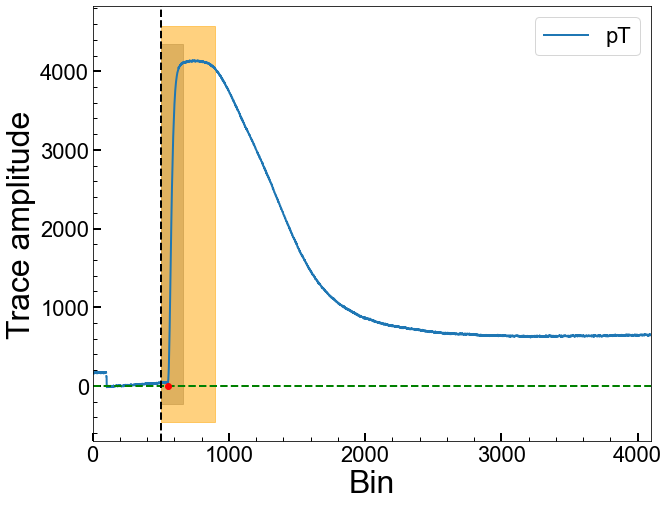

Series Number: 72209171225
Event Number: 1730200
Energy: 47.06359149847 keV
Area: 565796.6935239208


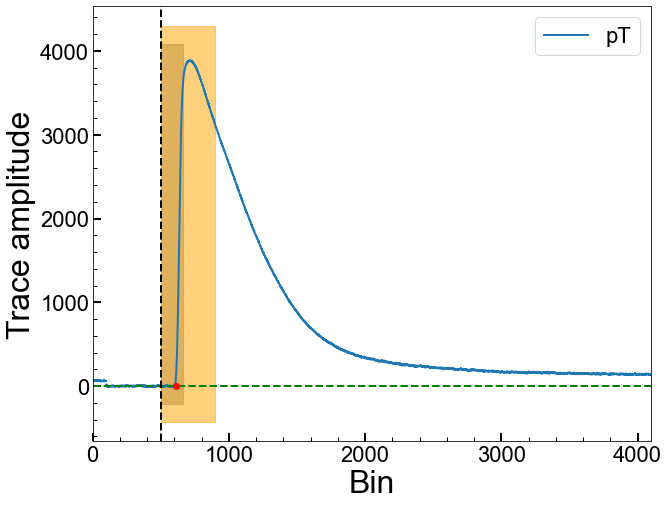

Series Number: 72209171225
Event Number: 1730581
Energy: 10.9063386637 keV
Area: 549554.4948120795


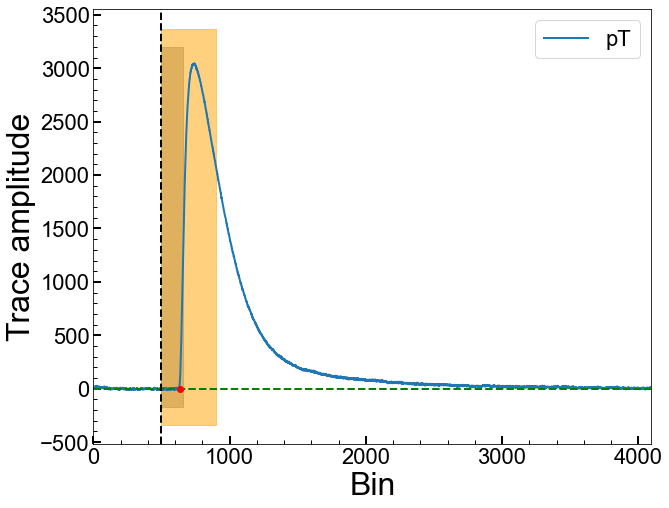

Series Number: 72209171225
Event Number: 1750297
Energy: 40.22401009321 keV
Area: 649950.0194754123


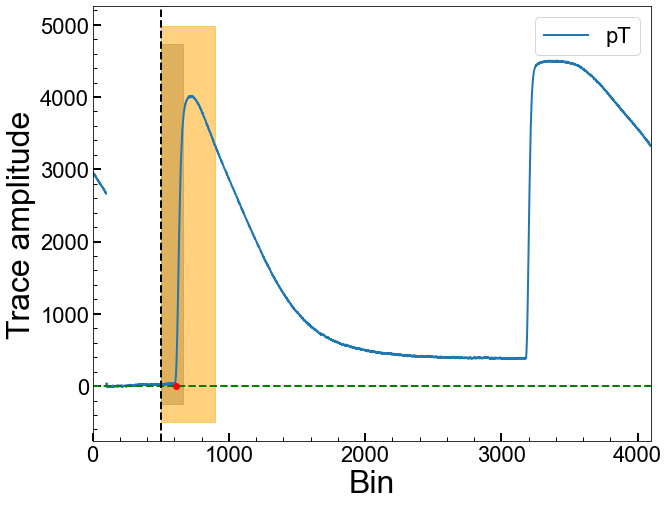

Series Number: 72209171225
Event Number: 1780394
Energy: 14.93341685975 keV
Area: 587827.2781898244


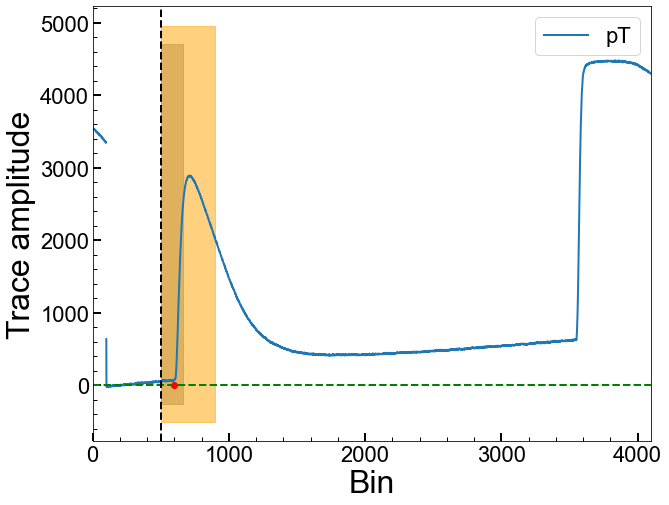

Series Number: 72209171225
Event Number: 1780911
Energy: 31.23113488654 keV
Area: 545176.2334455525


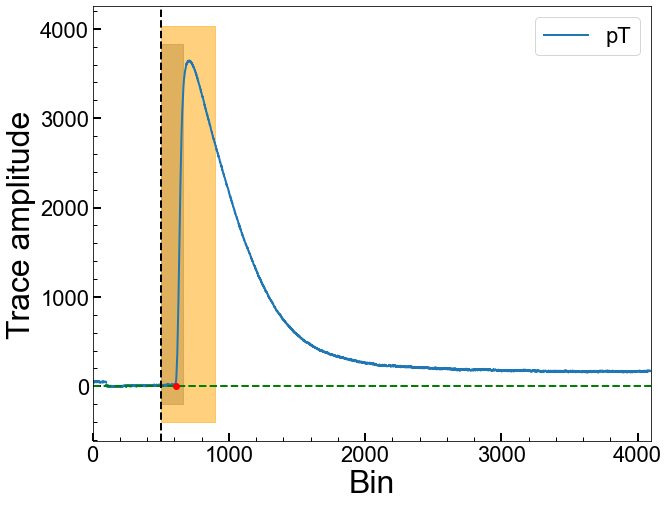

Series Number: 72209171225
Event Number: 1790294
Energy: 42.37549129553 keV
Area: 200642.83667902873


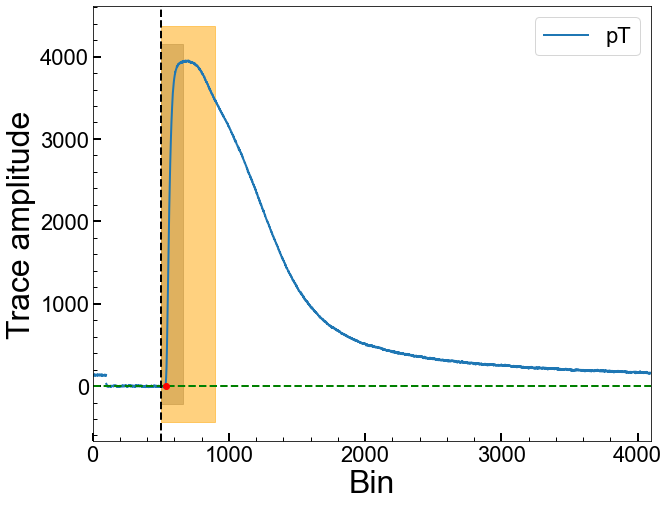

Series Number: 72209171225
Event Number: 1810125
Energy: 38.94346329016 keV
Area: 537373.35727004


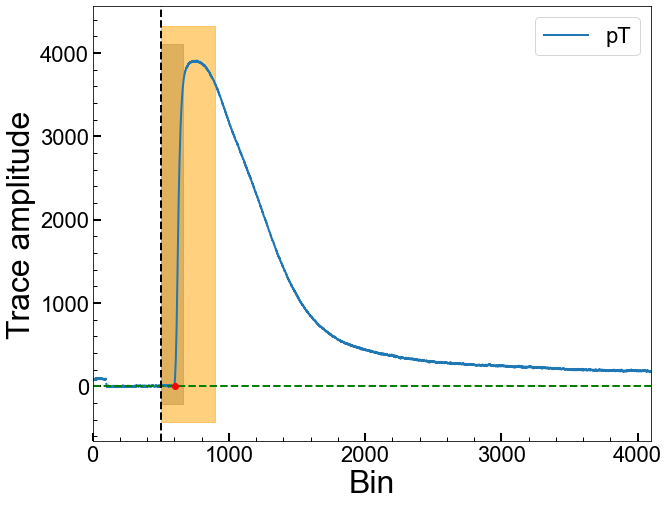

Series Number: 72209171225
Event Number: 1820467
Energy: 29.41057522351 keV
Area: 493179.66073951795


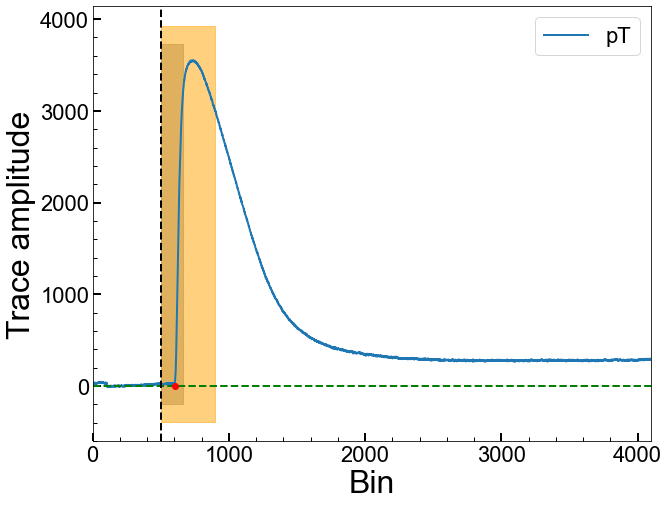

Series Number: 72209171225
Event Number: 1820657
Energy: 33.12606064532 keV
Area: 253694.63528639995


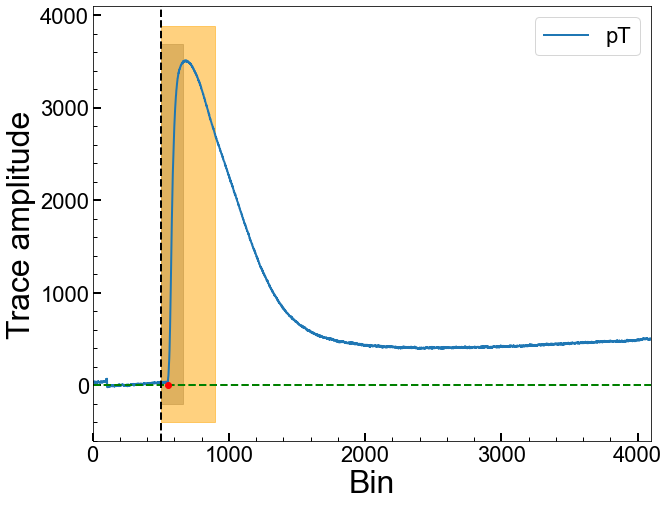

Series Number: 72209171225
Event Number: 1830285
Energy: 16.91886175332 keV
Area: 686233.9683789142


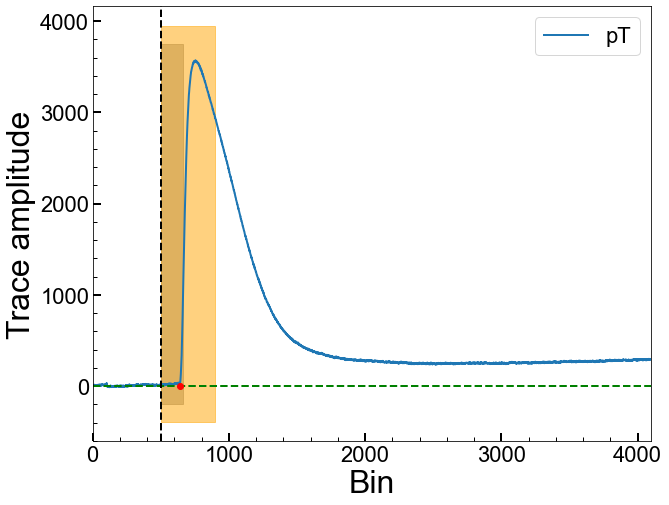

Series Number: 72209171225
Event Number: 1840695
Energy: 13.30981599554 keV
Area: 435600.57664165844


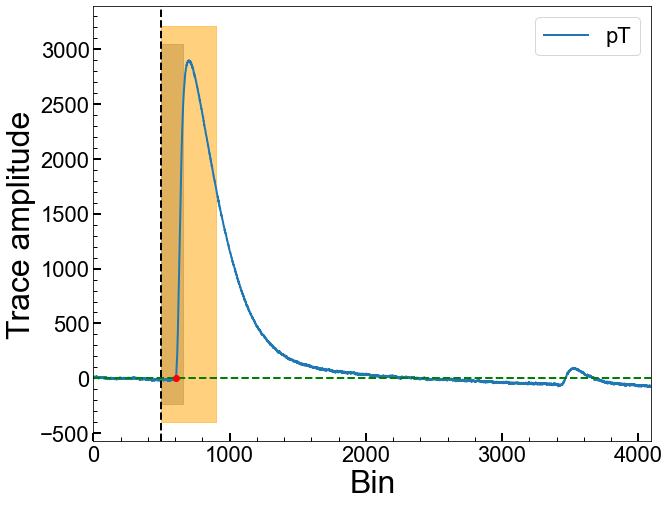

Series Number: 72209171225
Event Number: 1890472
Energy: 20.22012940232 keV
Area: 174868.35415518947


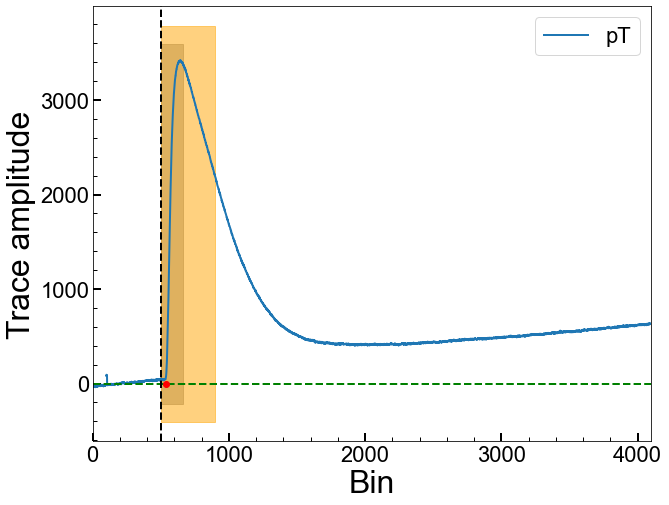

Series Number: 72209171225
Event Number: 1900197
Energy: 5.487935401485 keV
Area: 1642034.1698638613


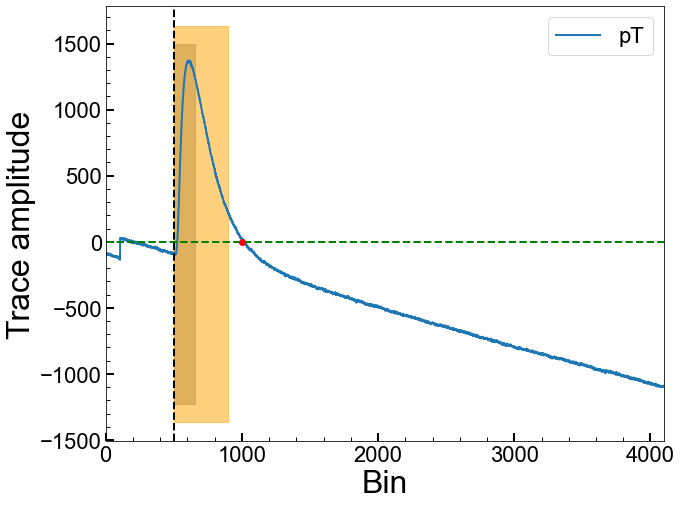

Series Number: 72209171225
Event Number: 1900632
Energy: 27.07663969926 keV
Area: 391926.0365682915


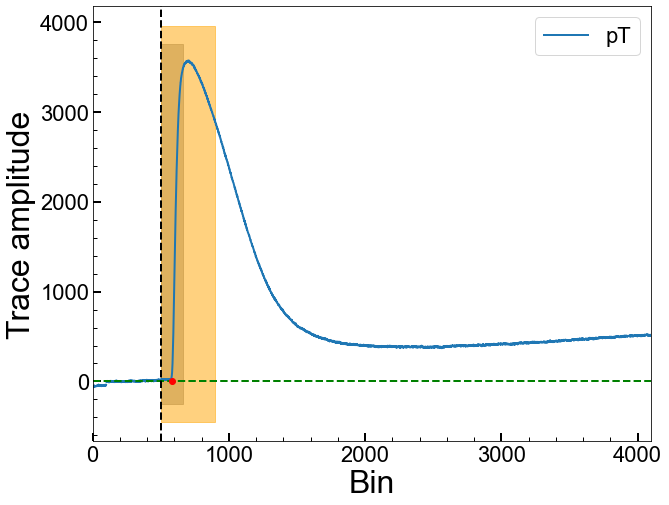

Series Number: 72209171225
Event Number: 1910335
Energy: 33.71272765578 keV
Area: 250435.27091228263


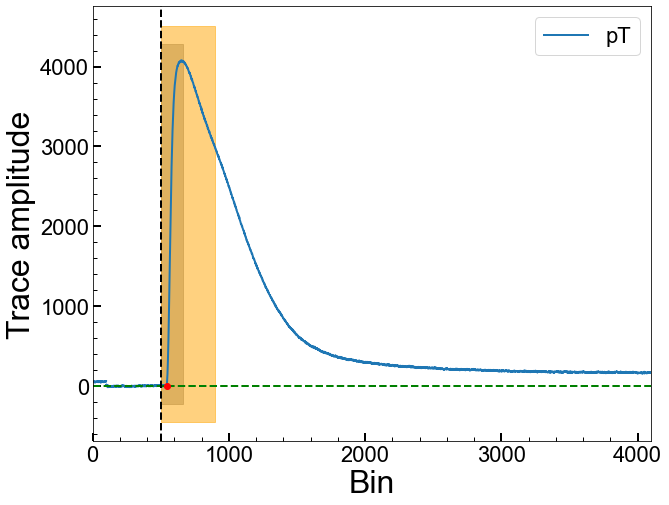

Series Number: 72209171225
Event Number: 1920705
Energy: 23.08081457098 keV
Area: 431064.20895015047


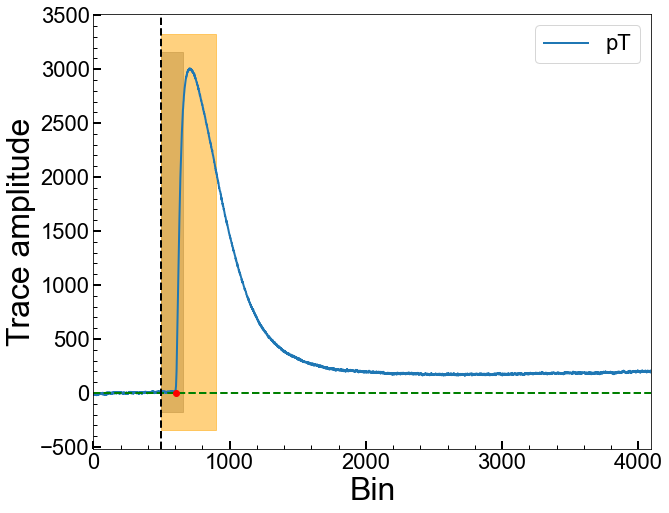

Series Number: 72209171225
Event Number: 1930301
Energy: 12.34952617169 keV
Area: 410839.14228042006


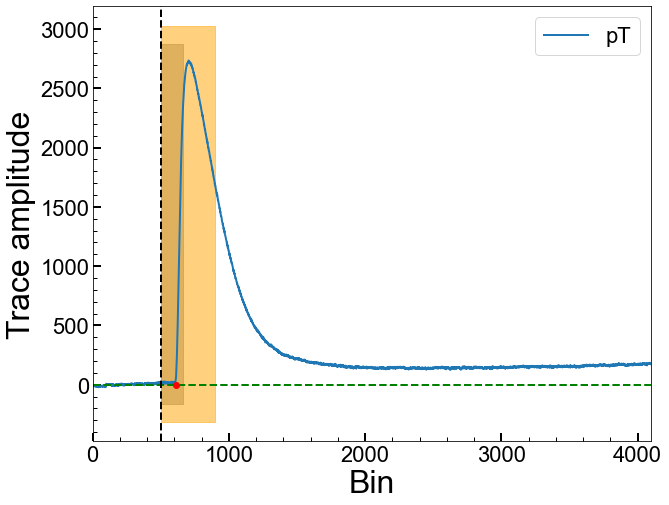

Series Number: 72209171225
Event Number: 1940101
Energy: 16.6851161551 keV
Area: 296735.5718433623


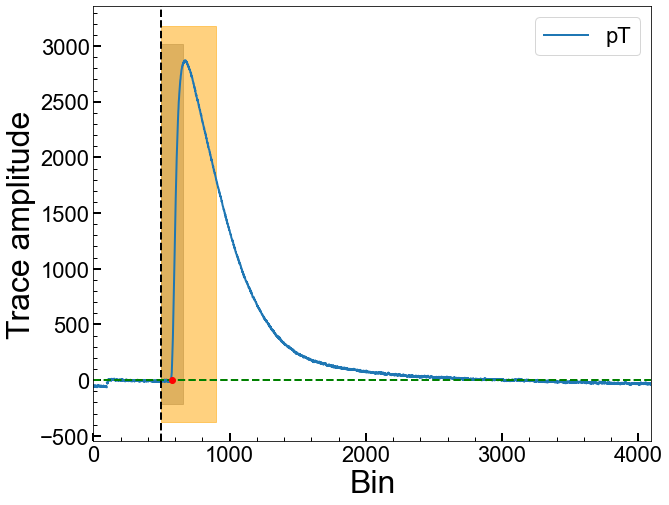

Series Number: 72209171225
Event Number: 1940404
Energy: 17.40708473151 keV
Area: 626796.5152659605


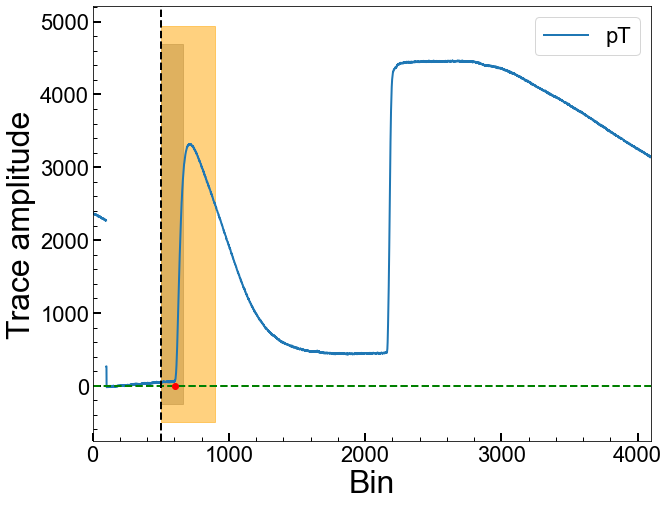

Series Number: 72209171225
Event Number: 1940873
Energy: 7.261729064469 keV
Area: 114700.94346120636


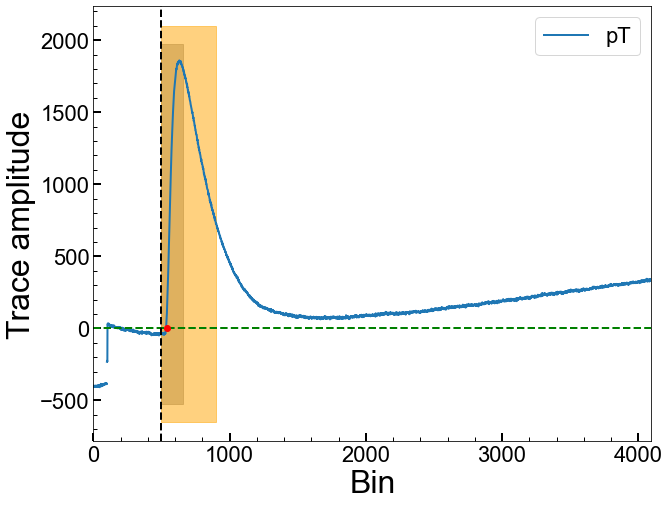

Series Number: 72209171225
Event Number: 1950528
Energy: 23.71490533201 keV
Area: 535551.2003165246


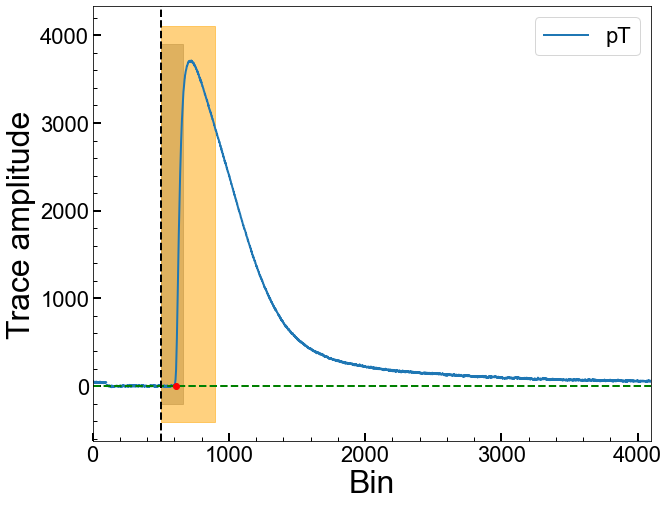

Series Number: 72209171225
Event Number: 1960296
Energy: 48.45227217595 keV
Area: 590531.3276166361


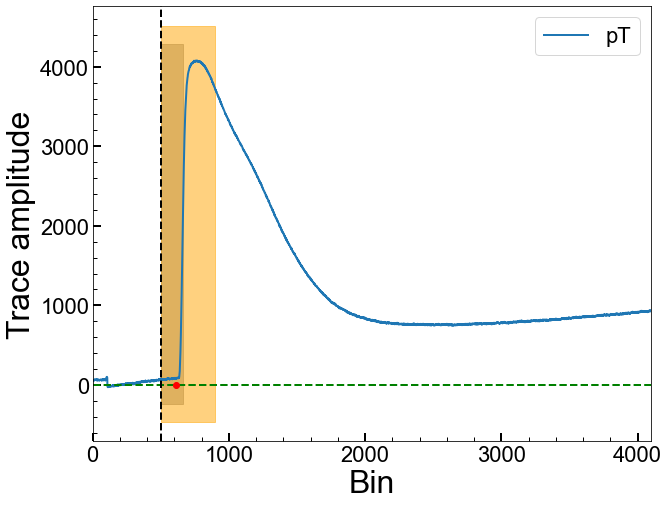

Series Number: 72209171225
Event Number: 1970612
Energy: 22.92038735973 keV
Area: 645295.903405097


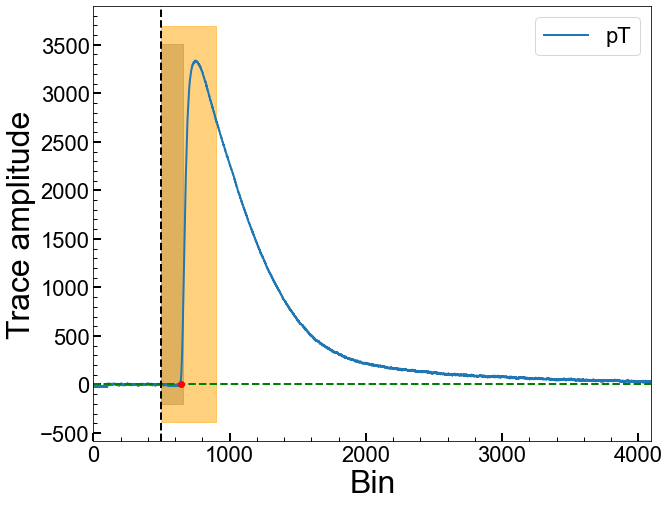

Series Number: 72209171225
Event Number: 1970946
Energy: 27.79308506647 keV
Area: 782908.0057666494


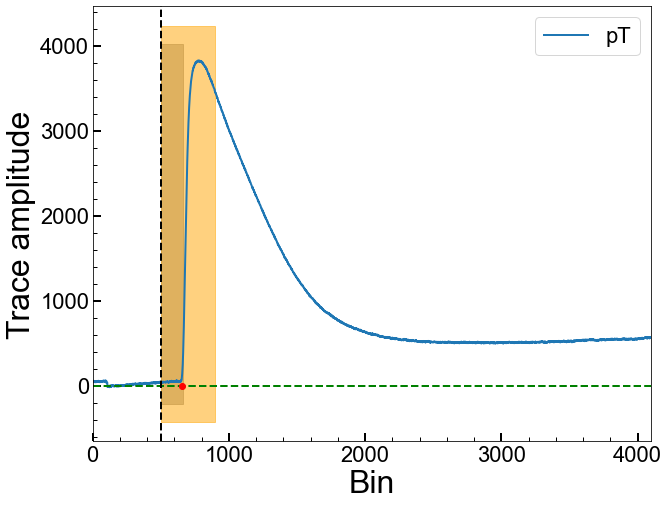

Series Number: 72209171225
Event Number: 2000424
Energy: 21.03908606789 keV
Area: 468136.4243034313


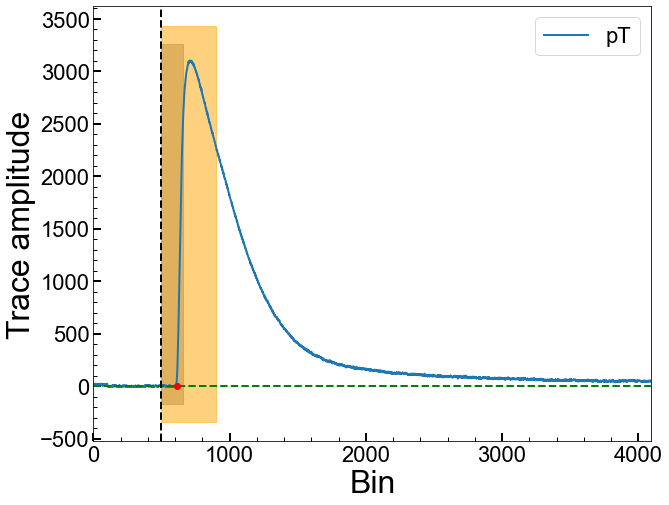

Series Number: 72209171225
Event Number: 2010251
Energy: 9.17235474618 keV
Area: 499143.1316682633


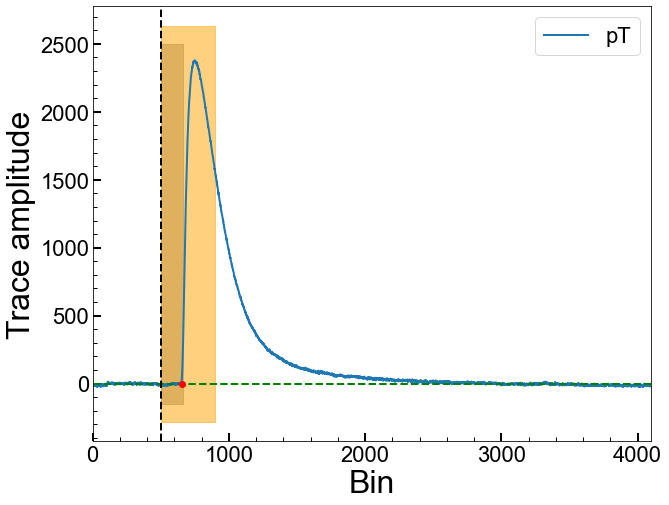

Series Number: 72209171225
Event Number: 2010329
Energy: 11.42217610585 keV
Area: 625861.9251166945


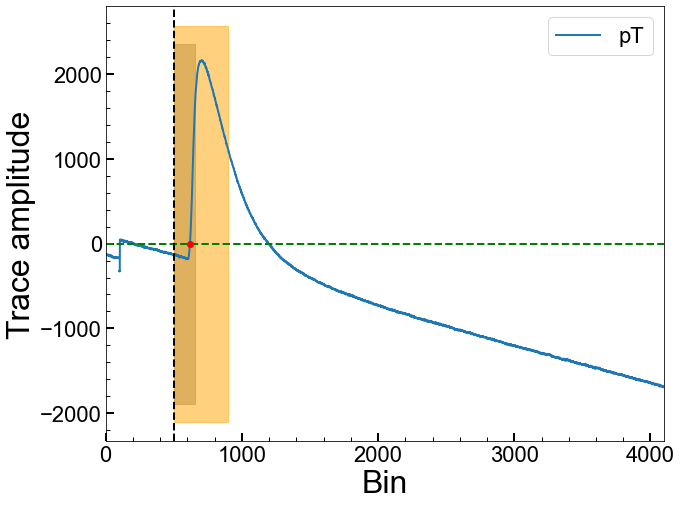

Series Number: 72209171225
Event Number: 2030110
Energy: 36.32906431983 keV
Area: -209552.69131724862


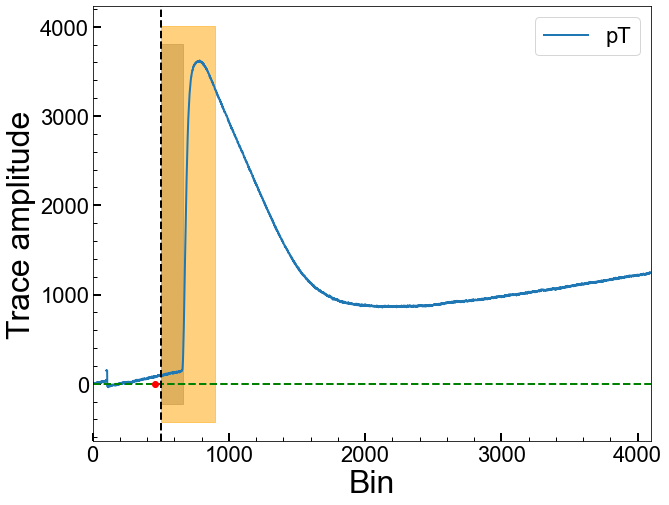

Series Number: 72209171225
Event Number: 2030680
Energy: 10.93323031429 keV
Area: 418056.1023789139


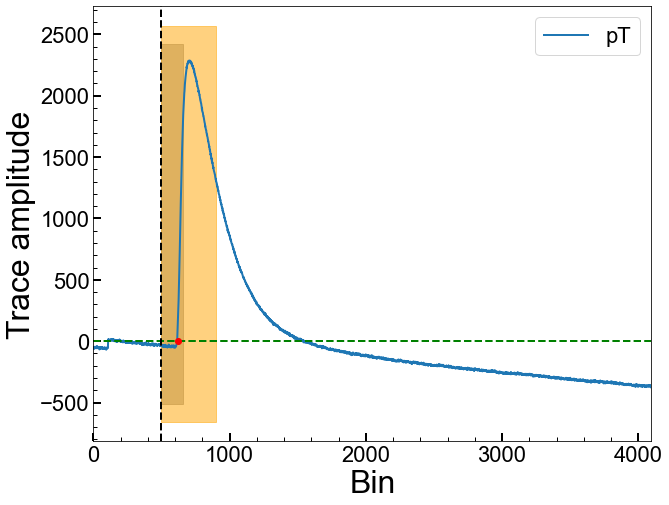

Series Number: 72209171225
Event Number: 2040264
Energy: 19.90414146933 keV
Area: 687918.059880911


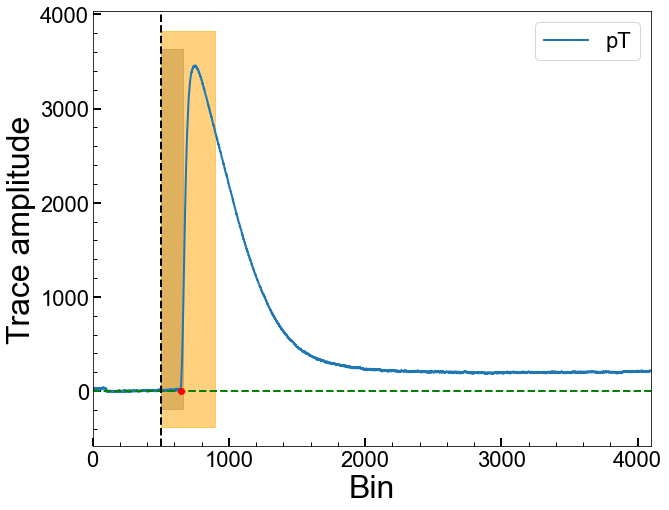

Series Number: 72209171225
Event Number: 2050209
Energy: 34.46225940543 keV
Area: 499400.8904204239


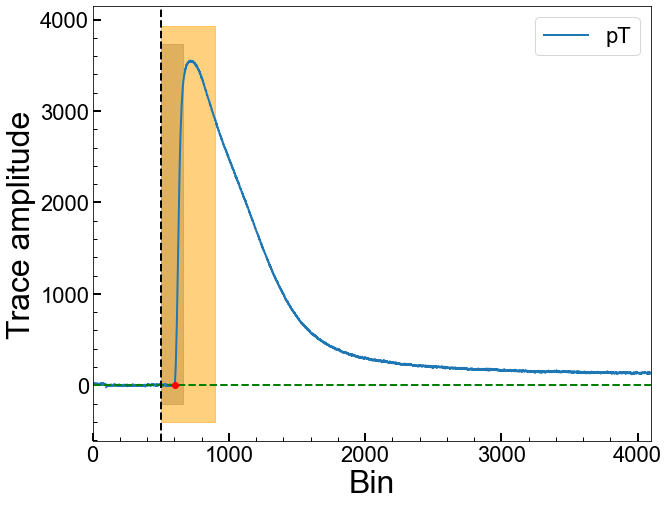

Series Number: 72209171225
Event Number: 2050439
Energy: 32.55553816804 keV
Area: 351545.62733181467


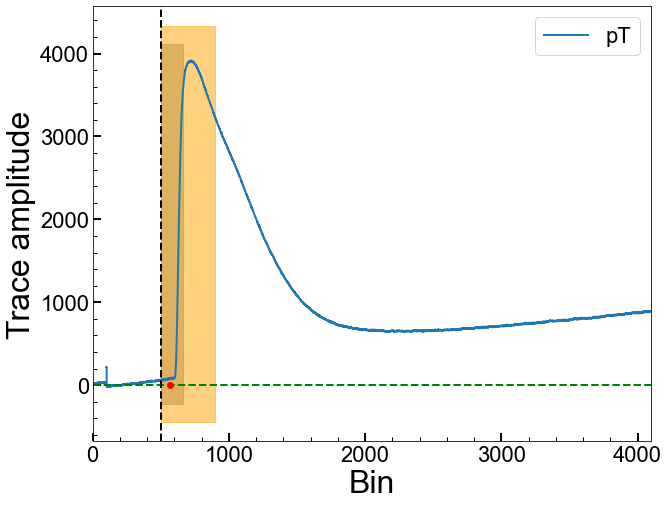

Series Number: 72209171225
Event Number: 2060186
Energy: 39.57512594484 keV
Area: -2570774.554054026


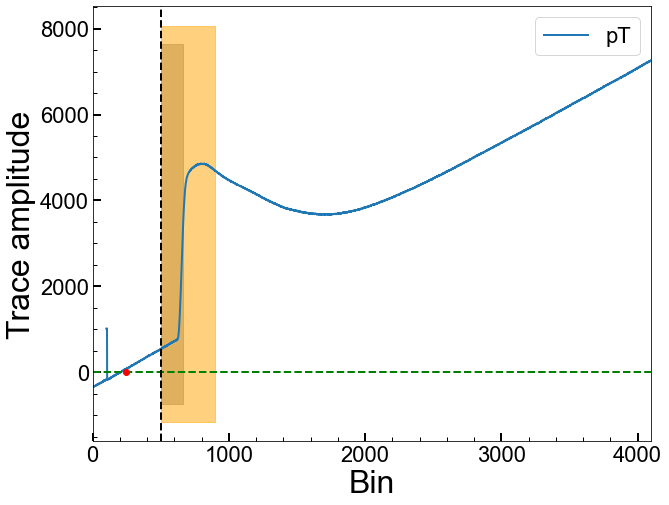

Series Number: 72209171225
Event Number: 2060216
Energy: 16.74990368092 keV
Area: 388500.23232834466


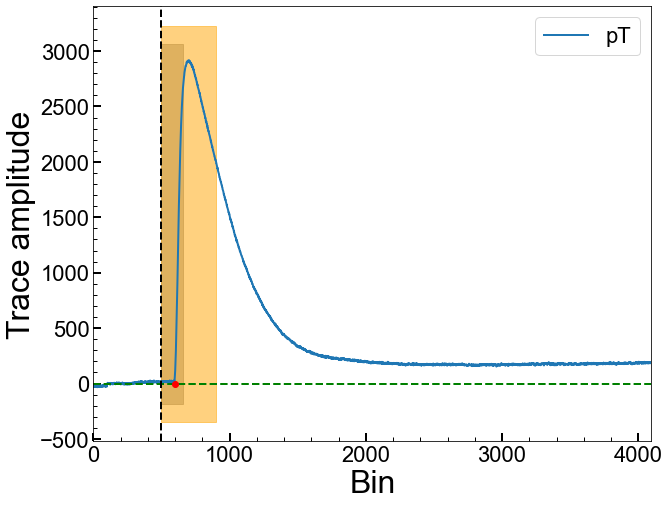

Series Number: 72209171225
Event Number: 2060837
Energy: 8.624165085096 keV
Area: 44590.41212694039


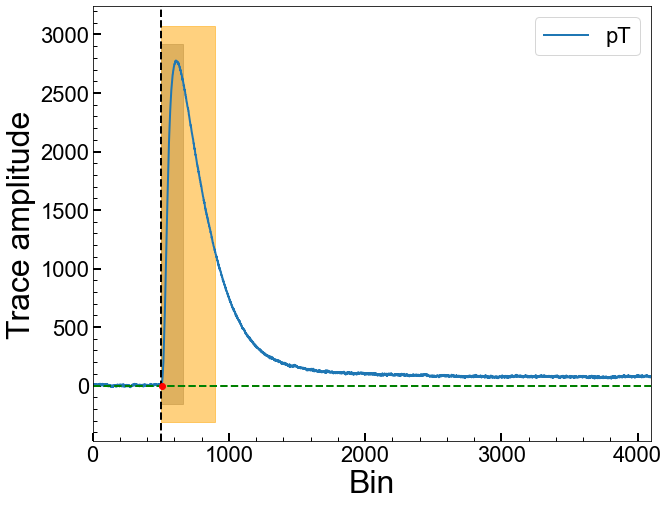

Series Number: 72209171225
Event Number: 2060887
Energy: 29.45943453612 keV
Area: 77128.07592381454


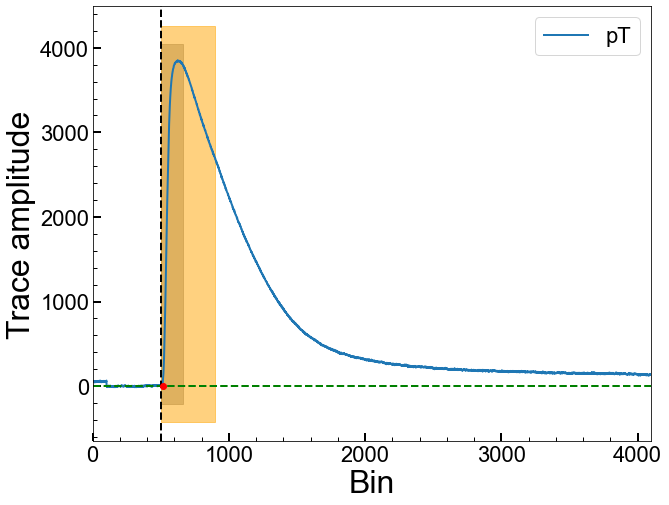

Series Number: 72209171225
Event Number: 2080016
Energy: 16.30138652536 keV
Area: 257442.49724194963


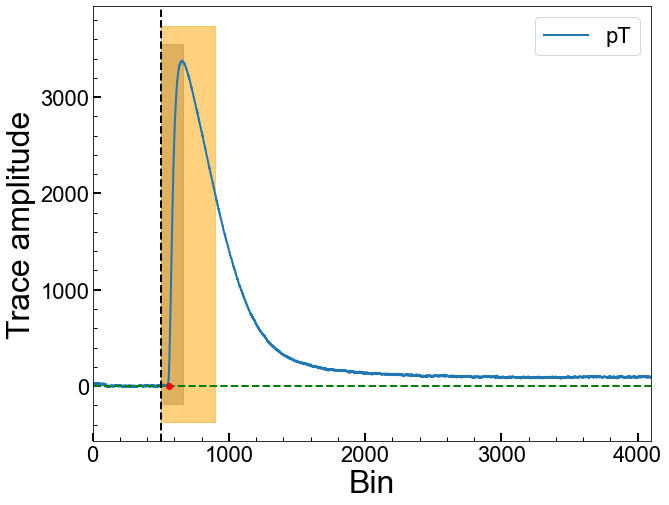

Series Number: 72209171225
Event Number: 2100507
Energy: 39.73864128248 keV
Area: -65284.35345156734


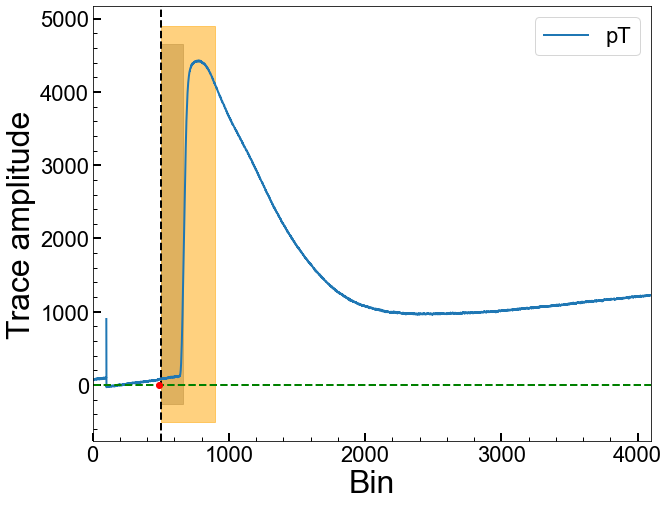

Series Number: 72209171225
Event Number: 2100726
Energy: 40.85314616115 keV
Area: -634223.9628471422


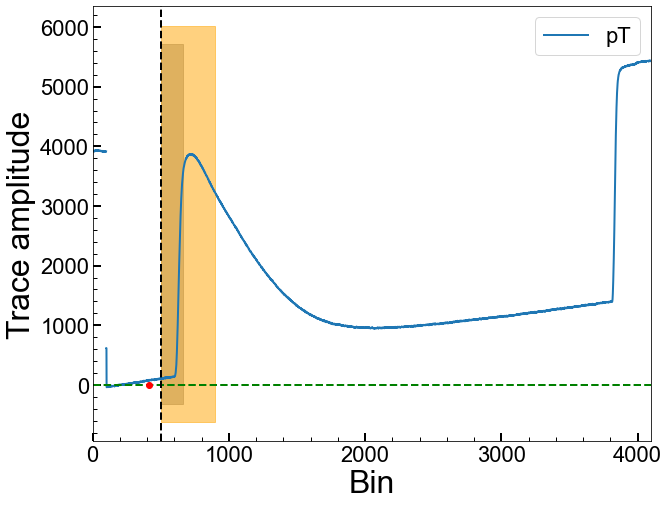

Series Number: 72209171225
Event Number: 2110908
Energy: 16.73128335756 keV
Area: -6334515.3631421225


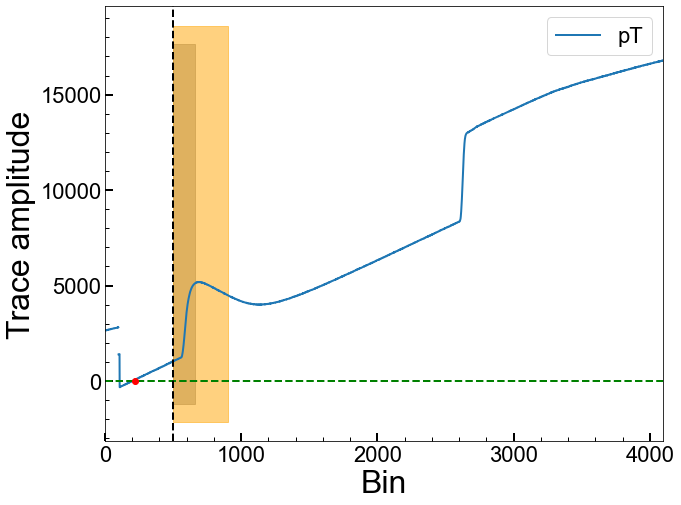

Series Number: 72209171225
Event Number: 2130589
Energy: 5.903520092933 keV
Area: 425529.8226093617


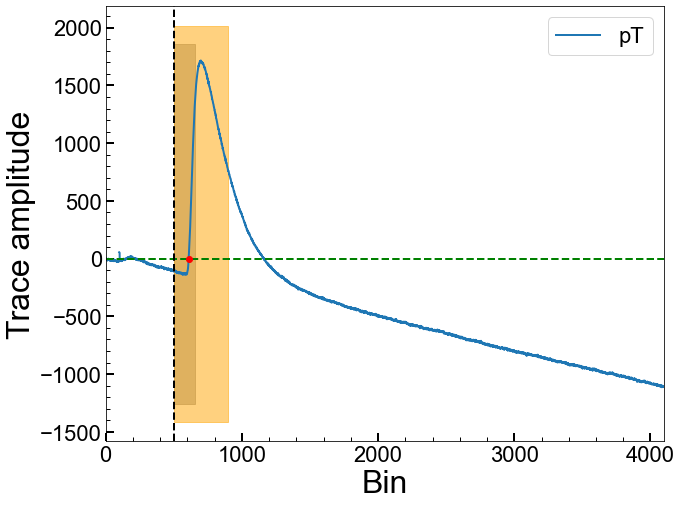

Series Number: 72209171225
Event Number: 2130758
Energy: 2.008488709152 keV
Area: 134613.56298281052


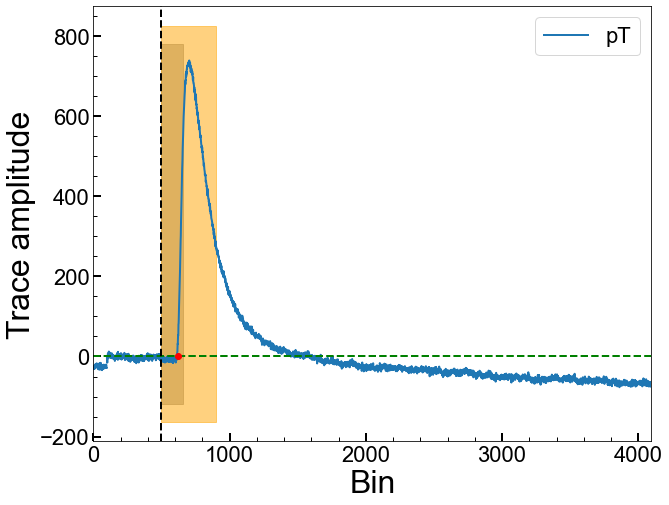

Series Number: 72209171225
Event Number: 2170166
Energy: 41.19097968343 keV
Area: -1644418.7339414768


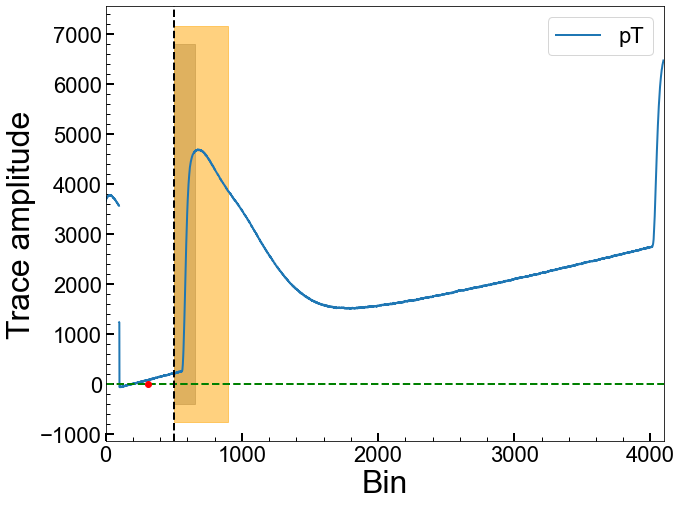

Series Number: 72209171225
Event Number: 2180845
Energy: 2.565075983627 keV
Area: 249738.3939594187


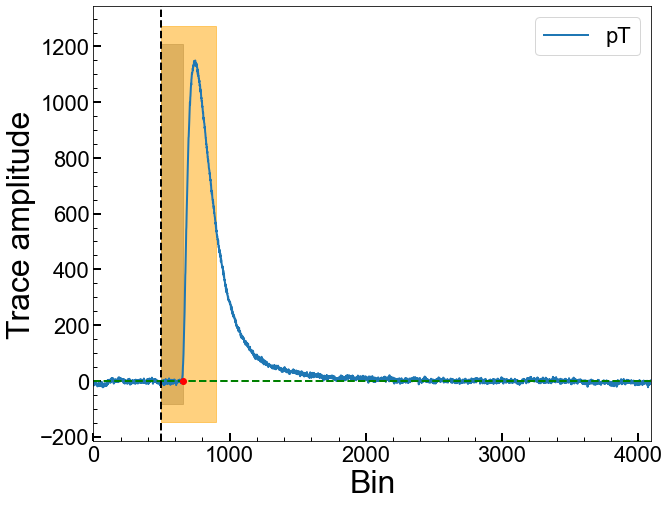

Series Number: 72209171225
Event Number: 2220296
Energy: 40.18558837798 keV
Area: -2885518.8894030913


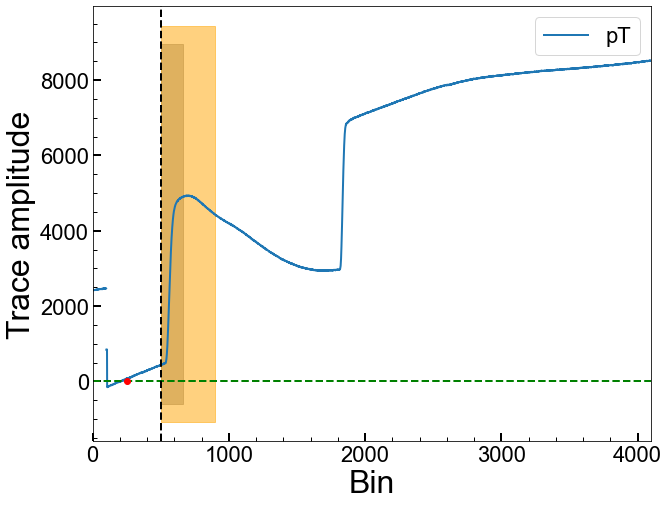

Series Number: 72209171225
Event Number: 2220579
Energy: 41.26506398751 keV
Area: 651453.3961818282


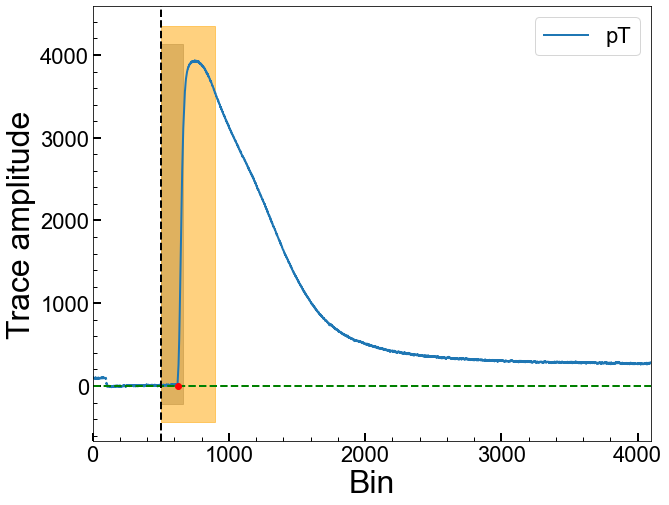

Series Number: 72209171225
Event Number: 2250407
Energy: 5.379465120234 keV
Area: 111168.2055318393


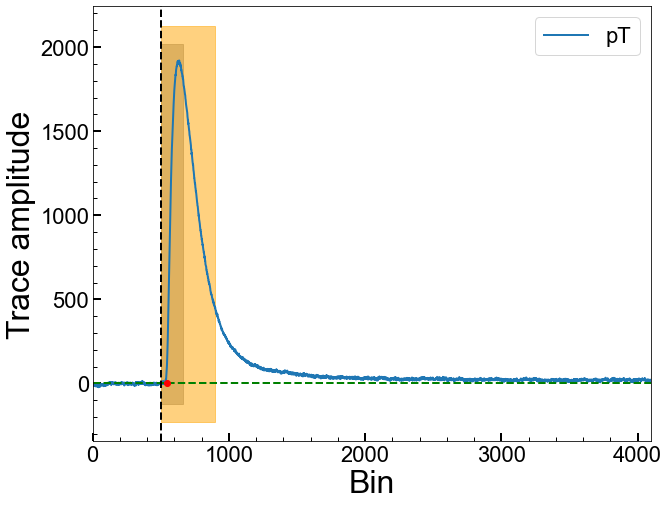

Series Number: 72209171225
Event Number: 2250859
Energy: 49.15155006413 keV
Area: 562565.632142596


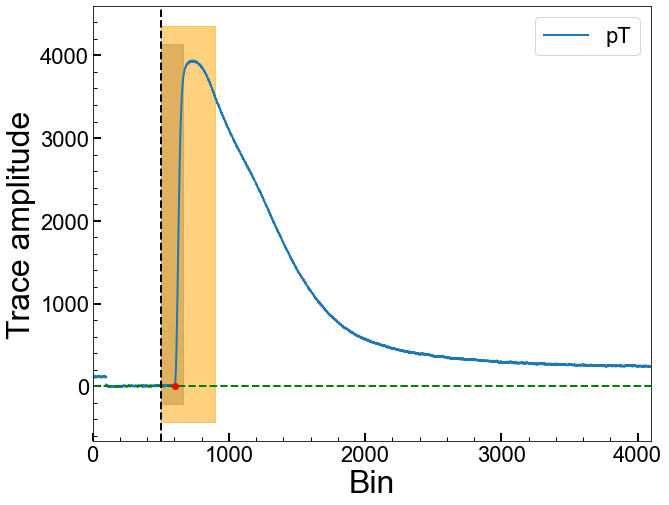

Series Number: 72209171225
Event Number: 2290326
Energy: 48.56014861443 keV
Area: 528176.146188786


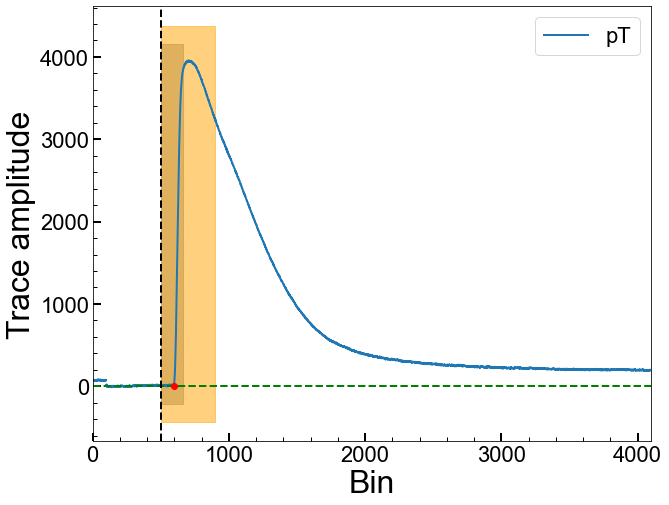

Series Number: 72209171225
Event Number: 2300162
Energy: 45.4764364882 keV
Area: 527394.2809334677


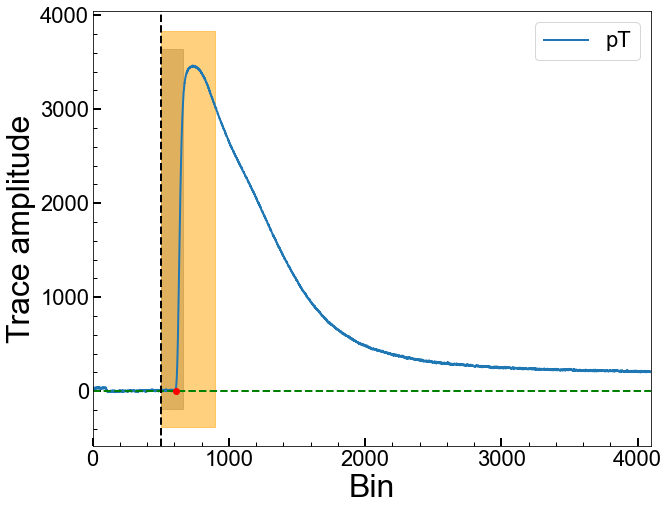

Series Number: 72209171225
Event Number: 2330539
Energy: 31.56802104397 keV
Area: 582650.7802609274


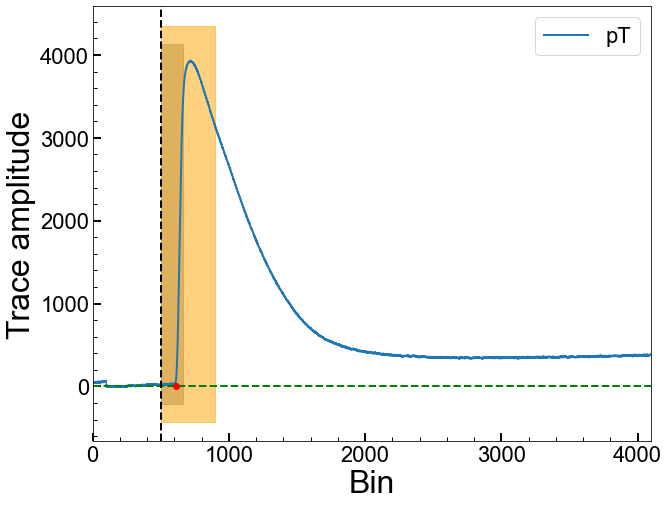

Series Number: 72209171225
Event Number: 2330945
Energy: 38.45499305687 keV
Area: 132980.19128960714


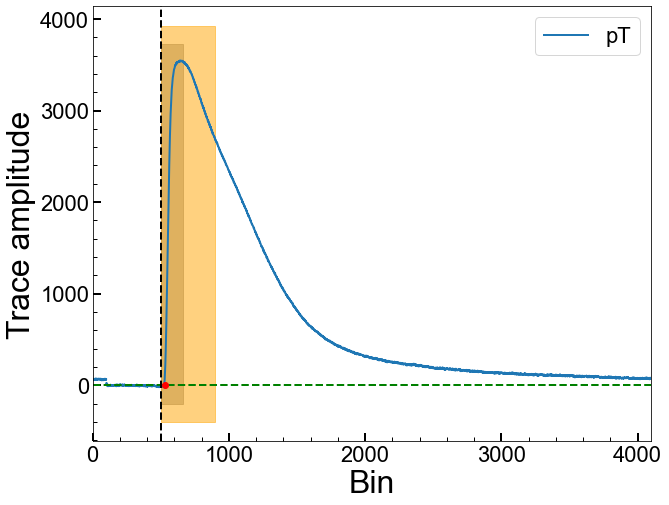

Series Number: 72209171225
Event Number: 2340336
Energy: 13.1694845488 keV
Area: 635620.7584939332


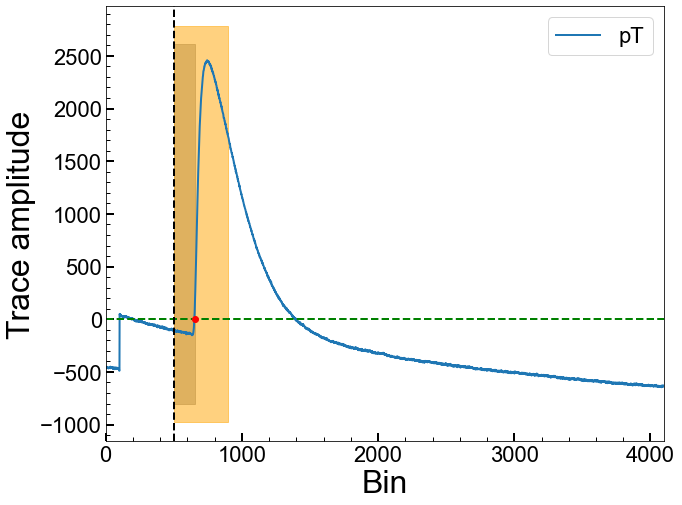

Series Number: 72209171225
Event Number: 2340419
Energy: 11.65402493905 keV
Area: 514598.1696322759


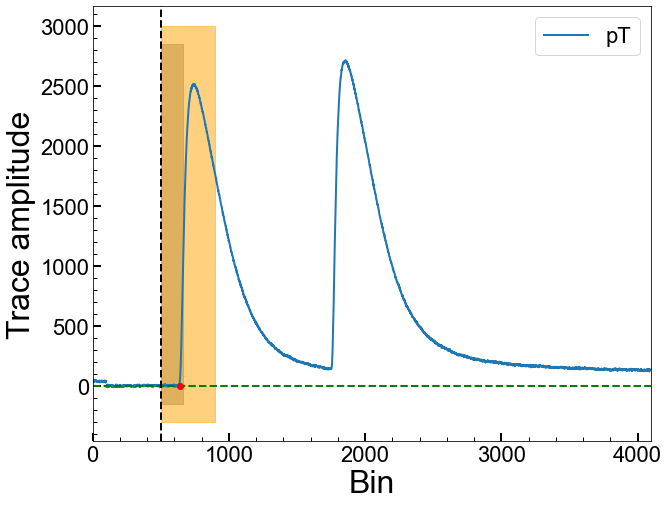

Series Number: 72209171225
Event Number: 2340432
Energy: 45.75460347061 keV
Area: -6153088.488465248


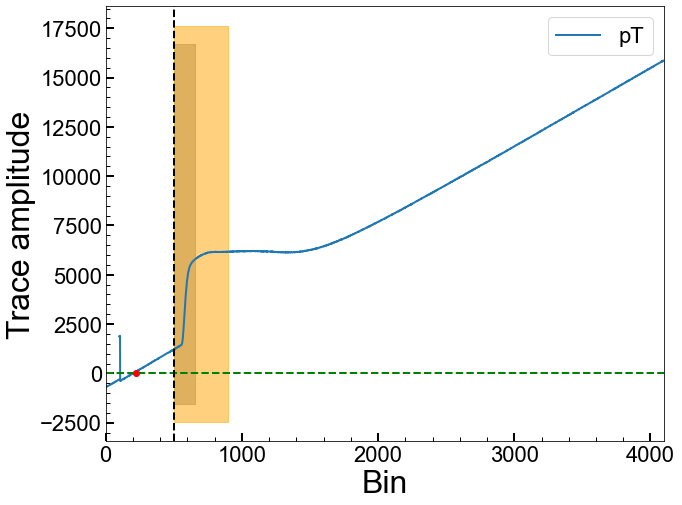

Series Number: 72209171225
Event Number: 2360030
Energy: 21.81745915818 keV
Area: 164580.9915351523


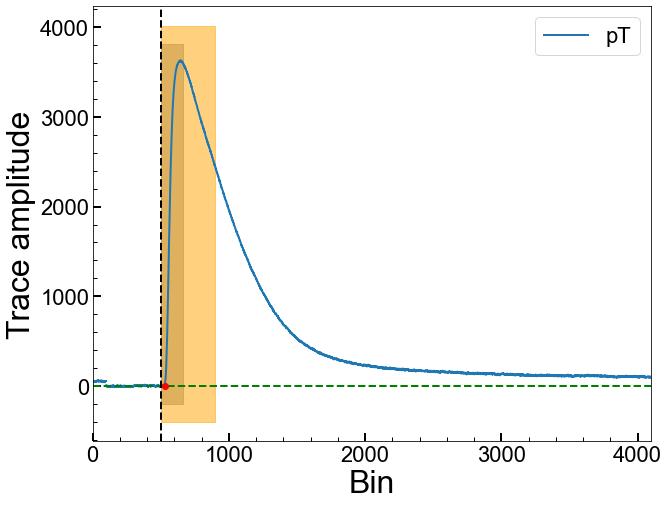

Series Number: 72209171225
Event Number: 2380238
Energy: 41.00226445475 keV
Area: 292101.31848173076


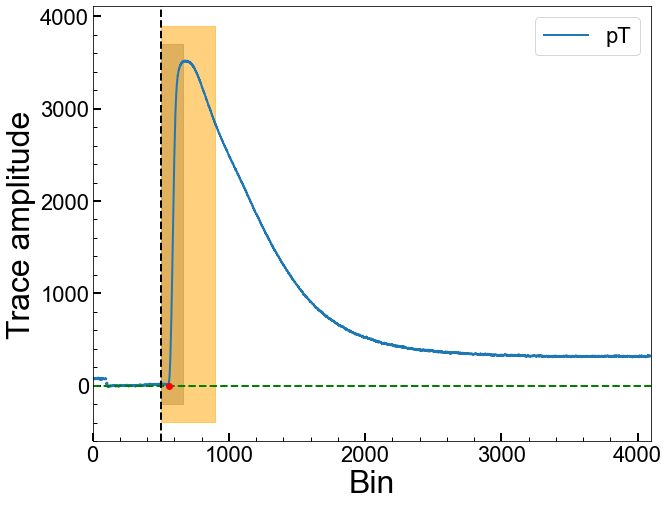

Series Number: 72209171225
Event Number: 2380670
Energy: 7.803059650351 keV
Area: 131828.89040702183


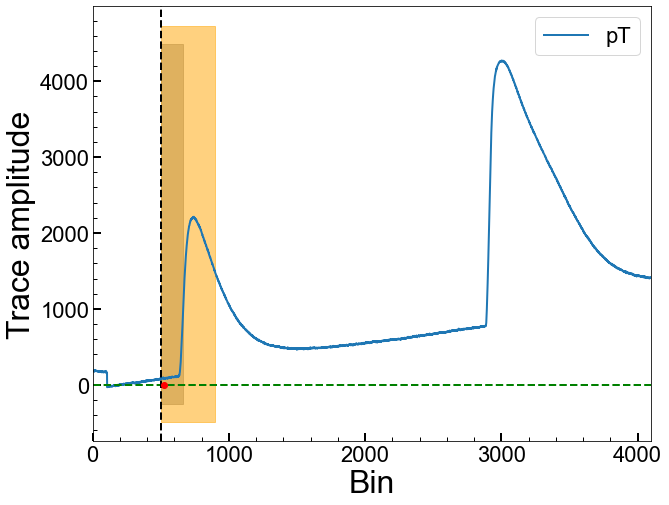

Series Number: 72209171225
Event Number: 2400049
Energy: 15.45002151193 keV
Area: 261481.7628936208


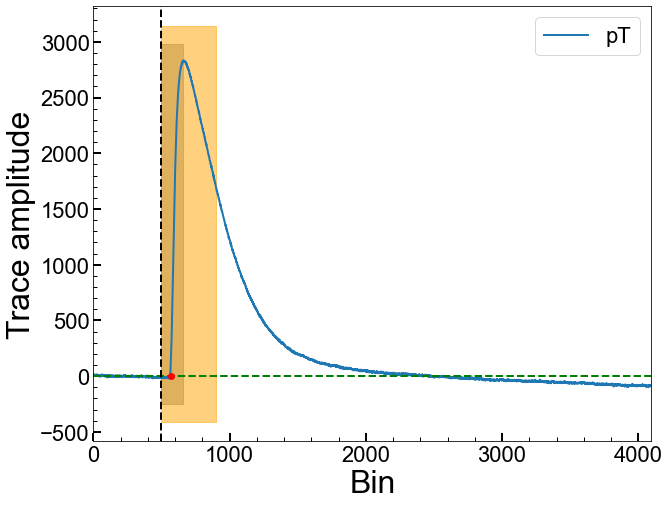

Series Number: 72209171225
Event Number: 2410822
Energy: 30.20771397096 keV
Area: 550318.1106670463


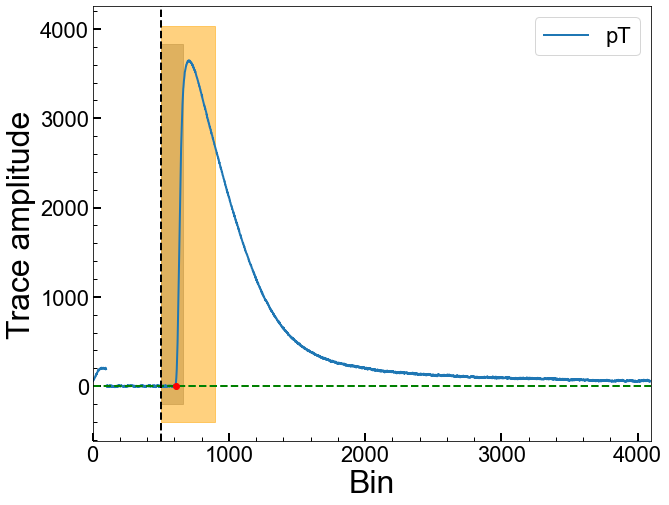

Series Number: 72209171225
Event Number: 2420584
Energy: 16.73465502607 keV
Area: 115773.50505871963


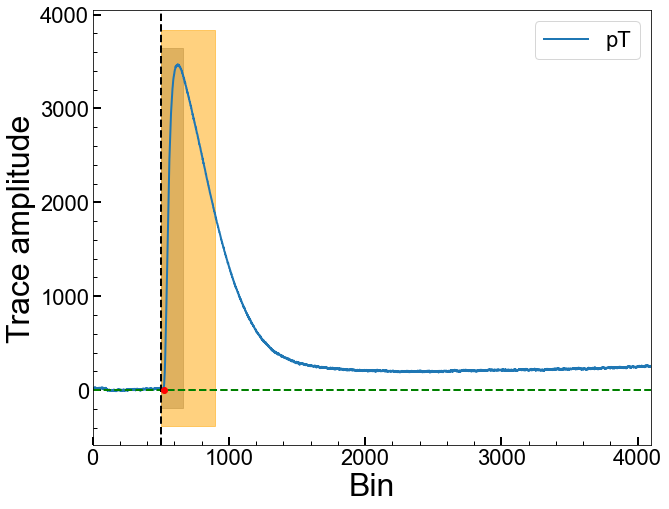

Series Number: 72209171225
Event Number: 2420820
Energy: 43.05517034965 keV
Area: 531152.528196041


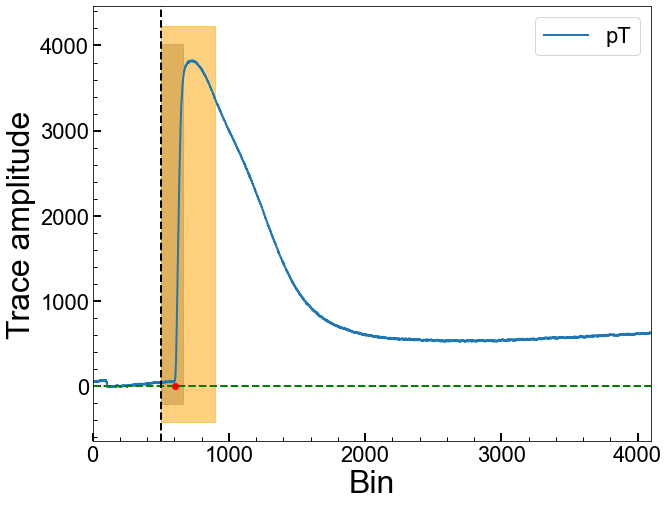

Series Number: 72209171225
Event Number: 2430154
Energy: 8.118187782171 keV
Area: 330646.3122958426


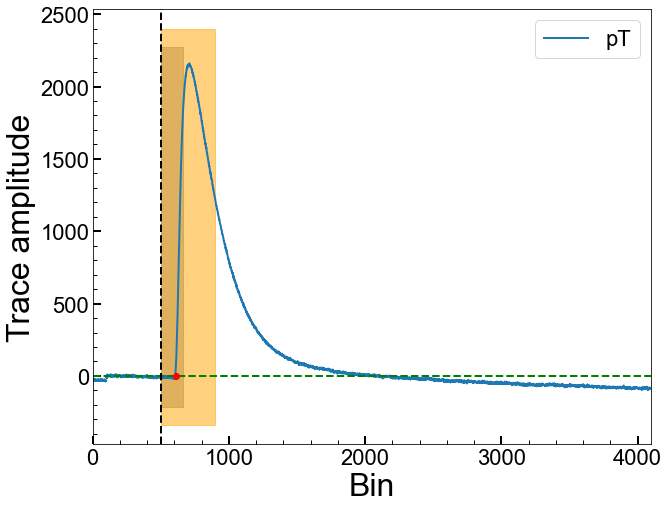

Series Number: 72209171225
Event Number: 2430208
Energy: 39.69678189548 keV
Area: 646836.9924739427


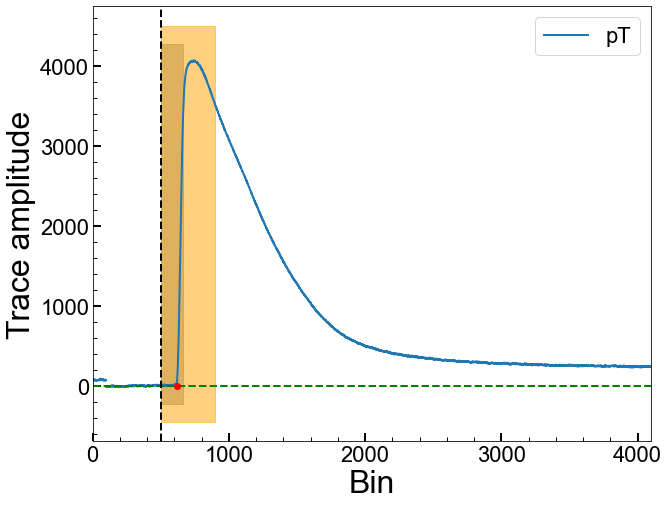

Series Number: 72209171225
Event Number: 2430271
Energy: 49.87662839604 keV
Area: 534498.6804927369


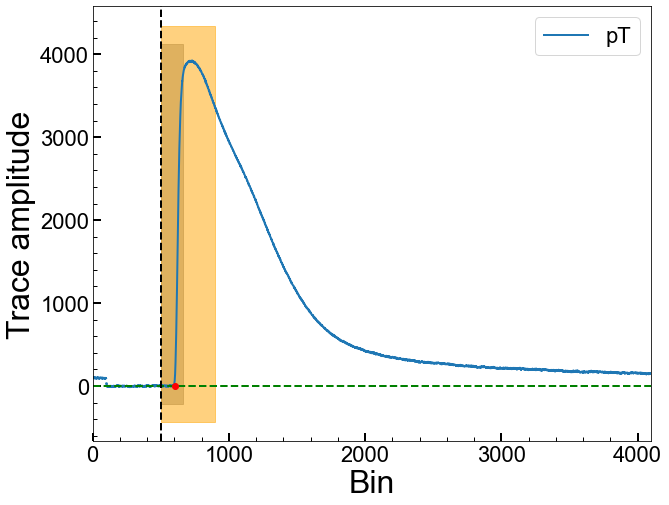

Series Number: 72209171225
Event Number: 2440608
Energy: 13.87099929059 keV
Area: 148861.66058327587


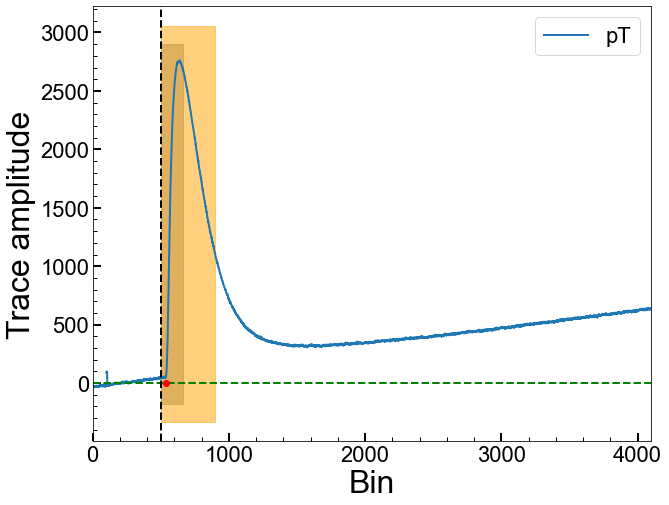

Series Number: 72209171225
Event Number: 2450921
Energy: 3.349786293641 keV
Area: 109206.78301023567


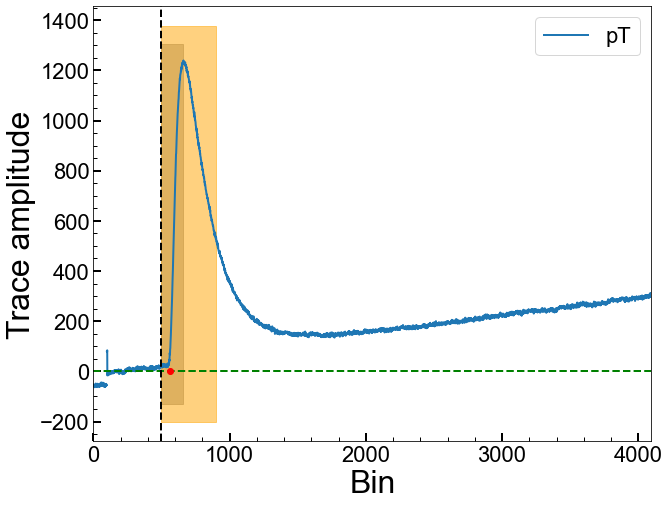

Series Number: 72209171225
Event Number: 2470475
Energy: 25.72287315181 keV
Area: 553570.0655539711


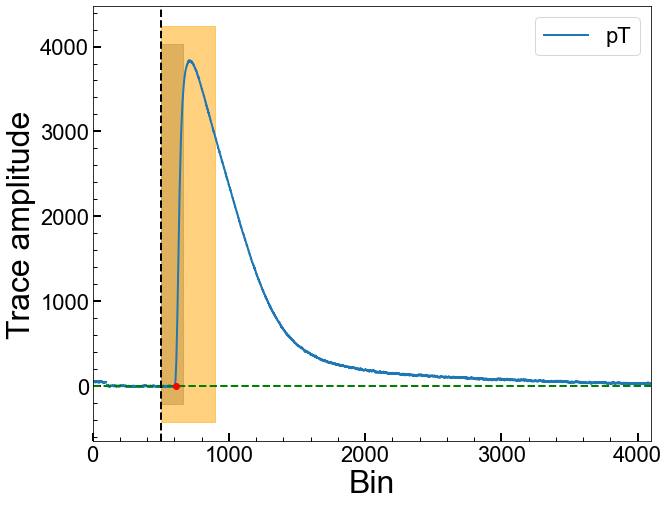

Series Number: 72209171225
Event Number: 2480236
Energy: 15.516316528 keV
Area: 42249.02317188522


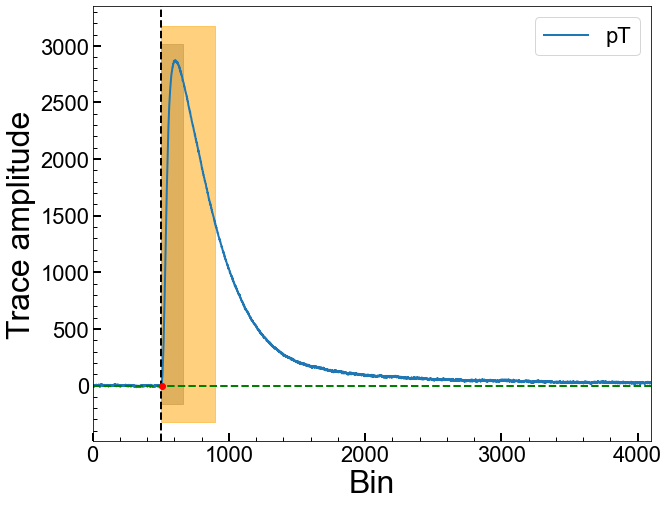

Series Number: 72209171225
Event Number: 2530121
Energy: 47.10099079395 keV
Area: -8239686.609891153


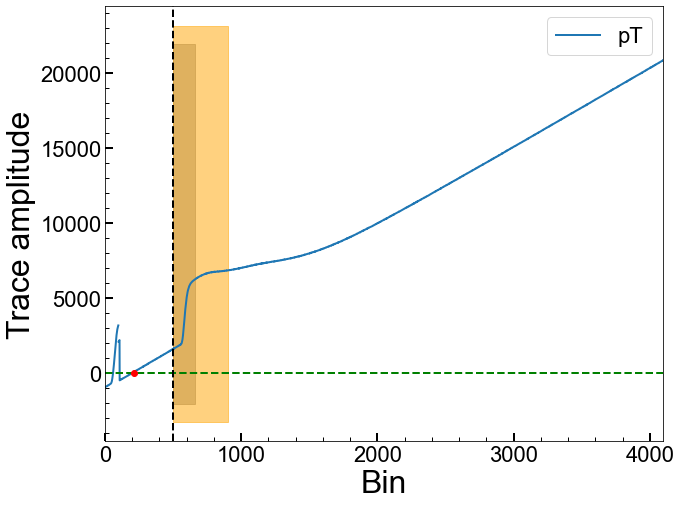

Series Number: 72209171225
Event Number: 2530284
Energy: 40.4026543385 keV
Area: 493260.28547746775


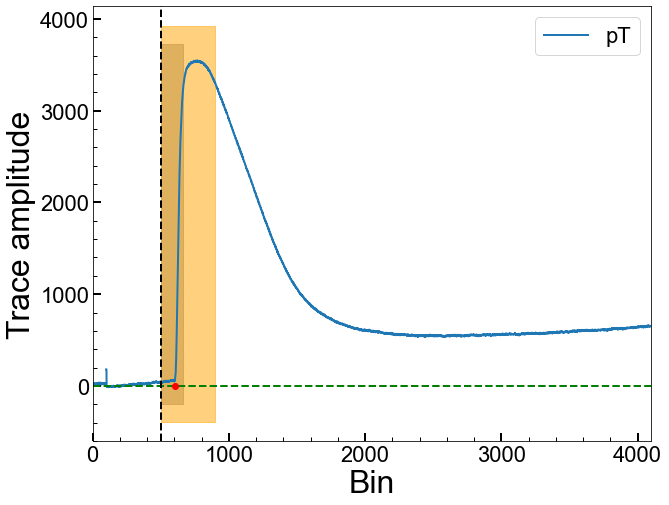

Series Number: 72209171225
Event Number: 2540116
Energy: 27.80356820144 keV
Area: -1010595.7315053778


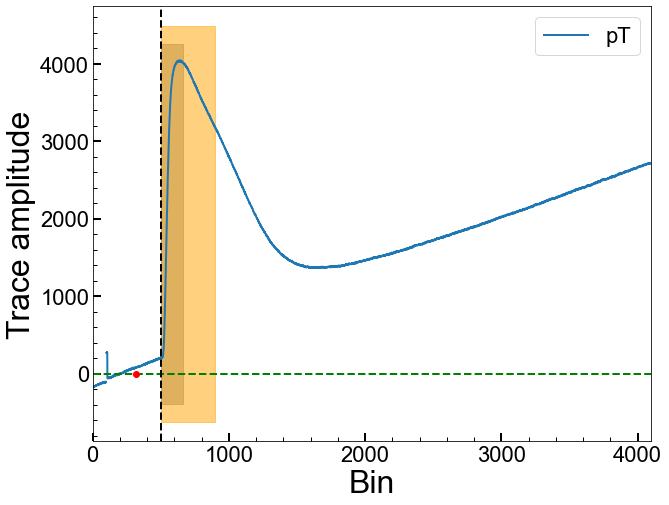

Series Number: 72209171225
Event Number: 2550904
Energy: 41.4313401626 keV
Area: 544247.7652475339


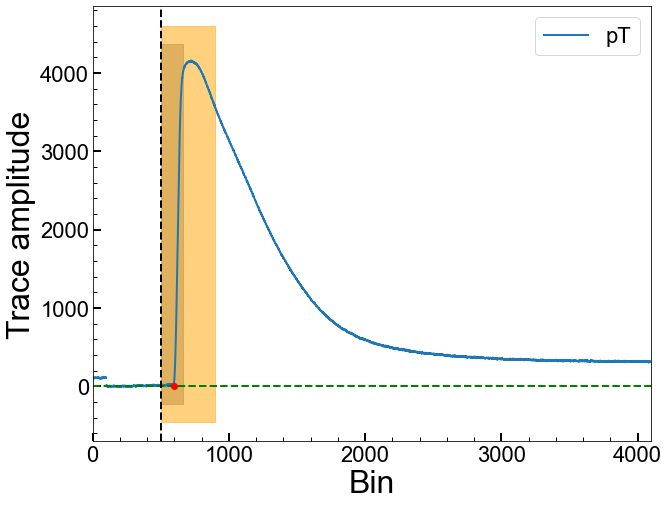

Series Number: 72209171225
Event Number: 2560118
Energy: 39.83555403411 keV
Area: 571605.7783719914


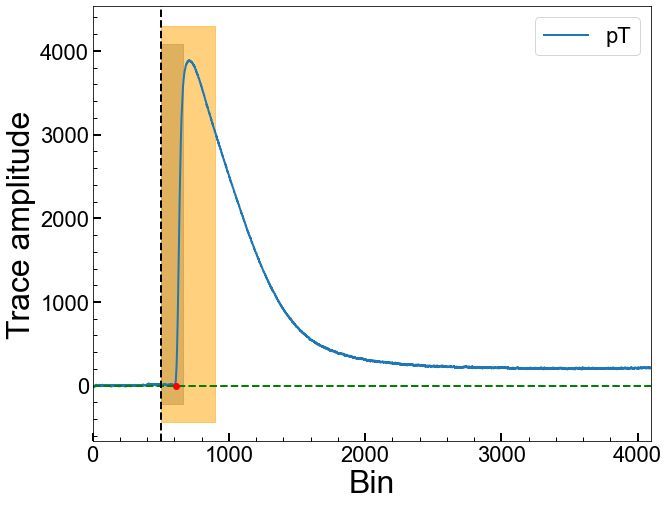

Series Number: 72209171225
Event Number: 2580365
Energy: 18.46854392318 keV
Area: -336968.765073251


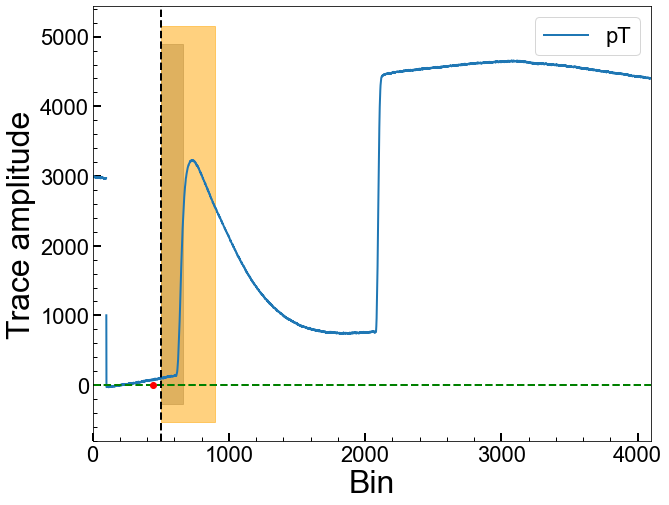

Series Number: 72209171225
Event Number: 2590126
Energy: 2.2757914805 keV
Area: 139262.12206172146


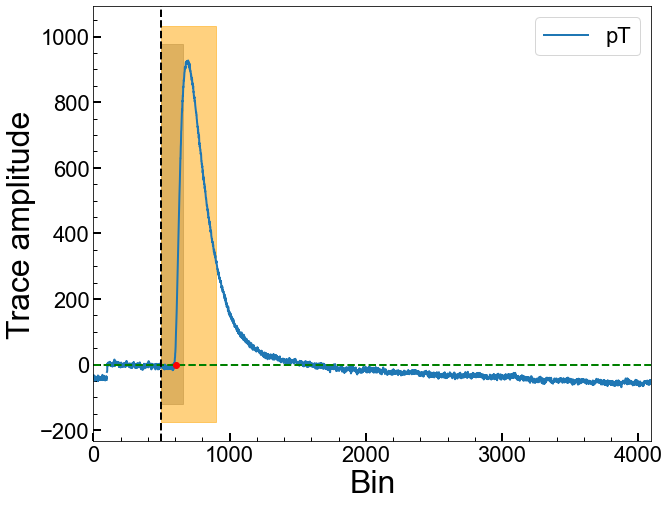

Series Number: 72209171225
Event Number: 2600193
Energy: 25.57390064146 keV
Area: 484565.09171268874


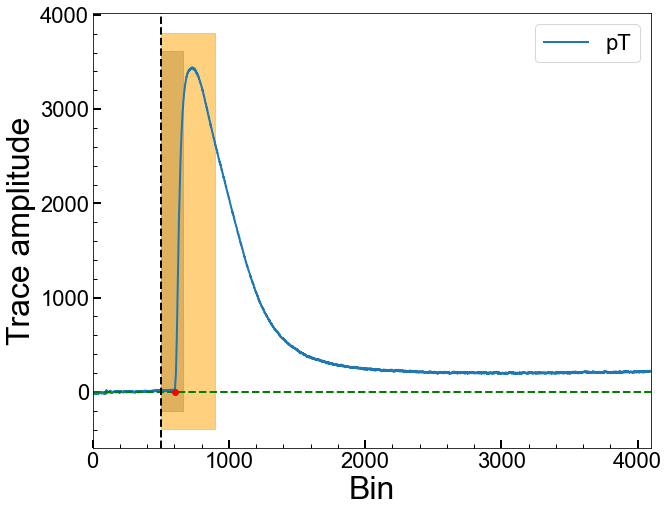

Series Number: 72209171225
Event Number: 2610759
Energy: 35.39486179084 keV
Area: 564265.984995179


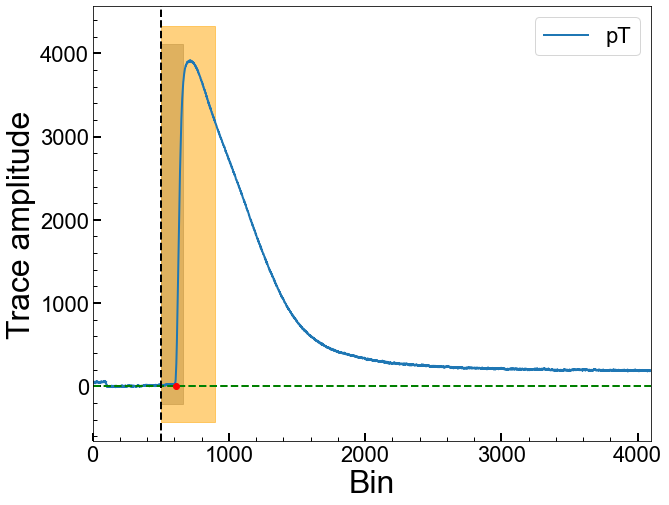

Series Number: 72209171225
Event Number: 2620057
Energy: 40.26172833905 keV
Area: 517397.1025455895


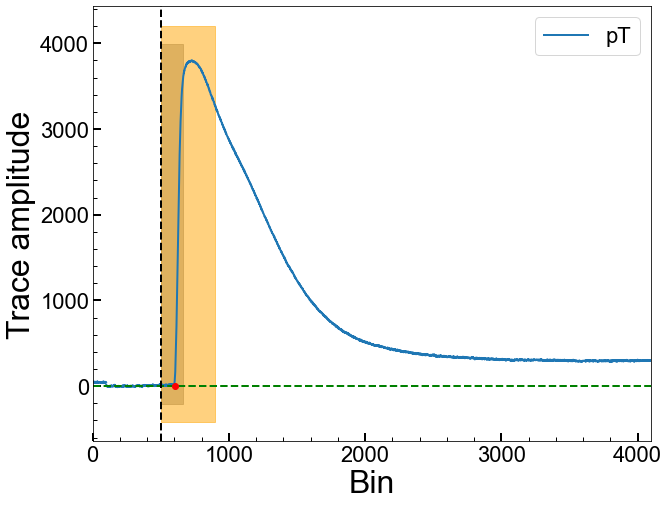

Series Number: 72209171225
Event Number: 2620371
Energy: 14.55607418789 keV
Area: -1590887.4536657836


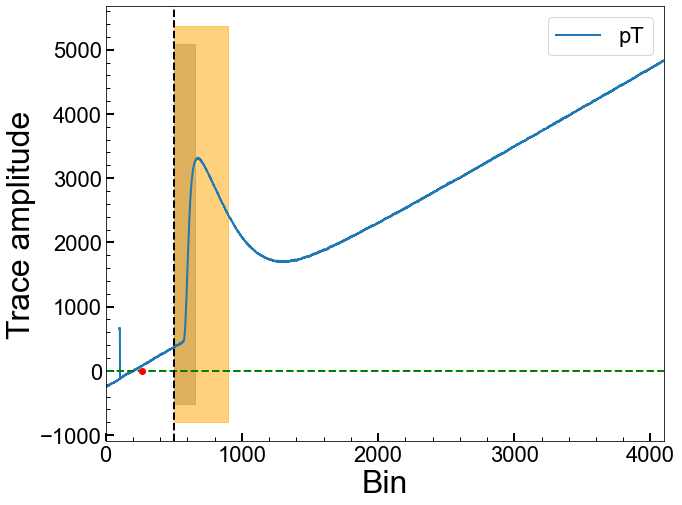

Series Number: 72209171225
Event Number: 2630479
Energy: 2.715843366194 keV
Area: 100904.34567571919


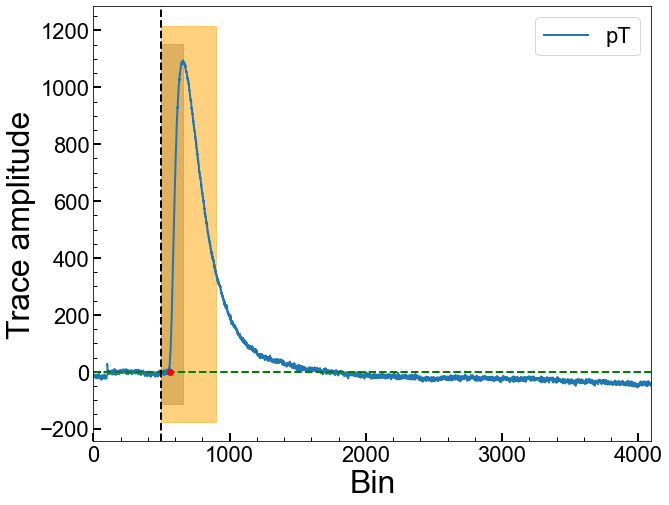

Series Number: 72209171225
Event Number: 2640228
Energy: 43.14447842959 keV
Area: -1525155.0780313371


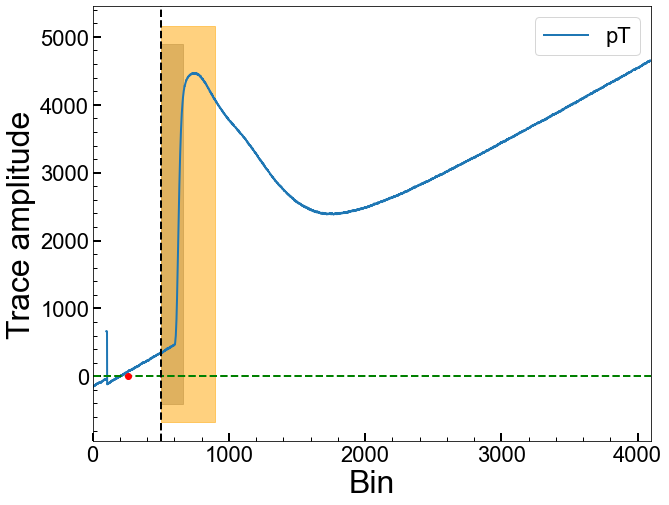

Series Number: 72209171225
Event Number: 2640579
Energy: 30.18055270313 keV
Area: -718907.3728938919


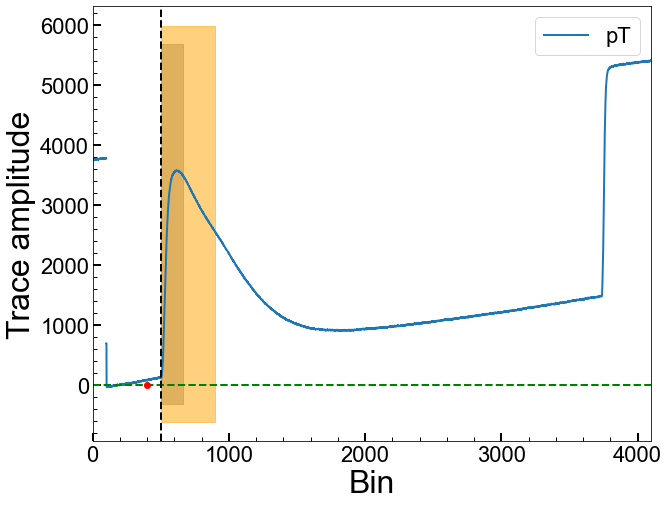

Series Number: 72209171225
Event Number: 2650327
Energy: 4.764159651569 keV
Area: 265100.4807927208


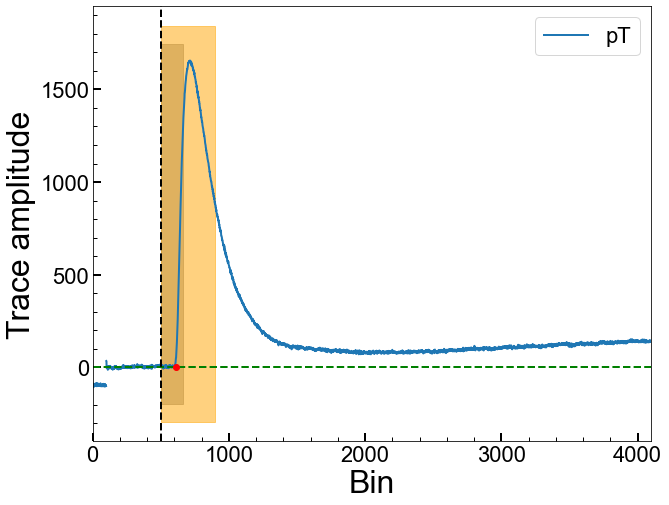

Series Number: 72209171225
Event Number: 2650395
Energy: 14.326276372 keV
Area: -262332.4708842912


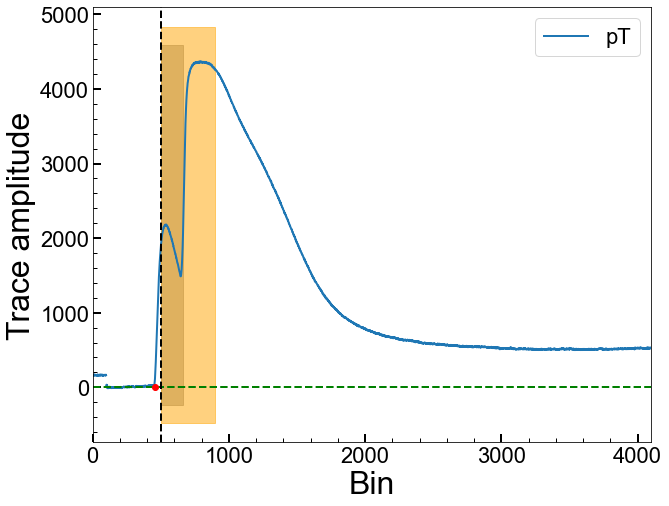

Series Number: 72209171225
Event Number: 2660050
Energy: 4.139092396539 keV
Area: 39071.62618975358


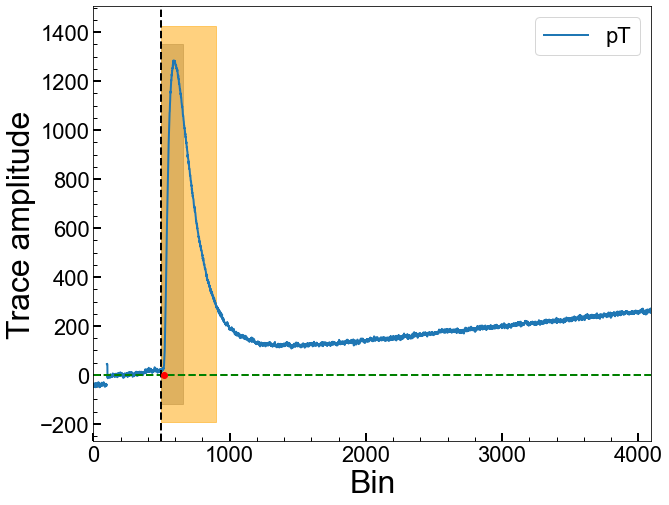

Series Number: 72209171225
Event Number: 2700265
Energy: 28.94021582436 keV
Area: -1481471.0552088027


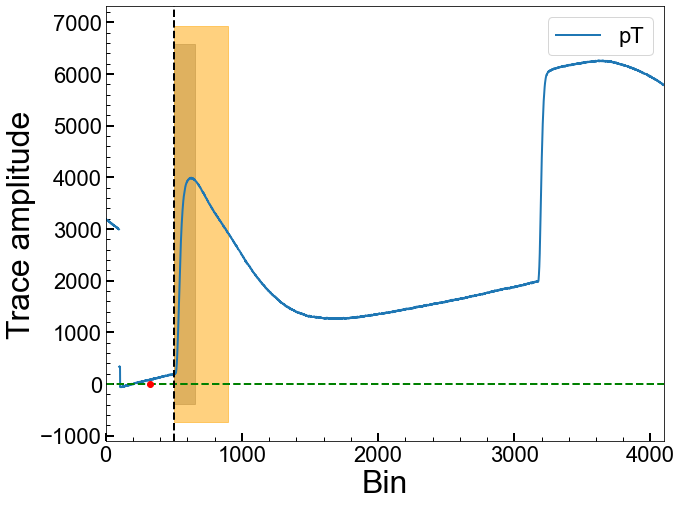

Series Number: 72209171225
Event Number: 2700489
Energy: 8.467108112059 keV
Area: 328799.1509612503


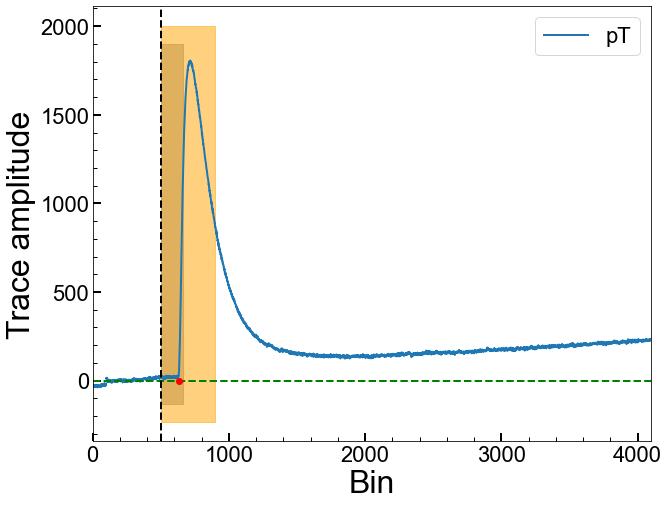

Series Number: 72209171225
Event Number: 2710841
Energy: 12.5989526781 keV
Area: 65363.67402341716


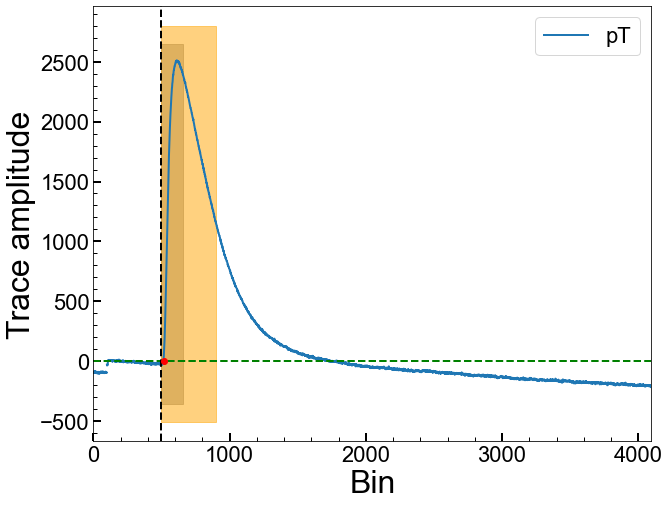

Series Number: 72209171225
Event Number: 2730731
Energy: 32.36633115381 keV
Area: 582254.7082973251


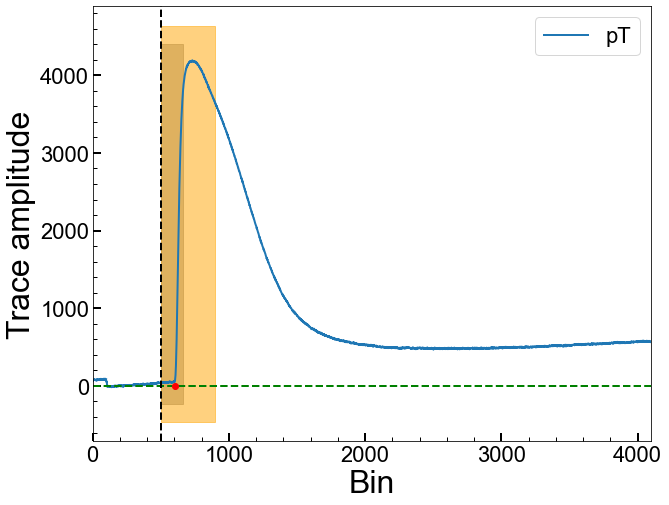

Series Number: 72209171225
Event Number: 2740340
Energy: 19.61584288225 keV
Area: 204446.29111390724


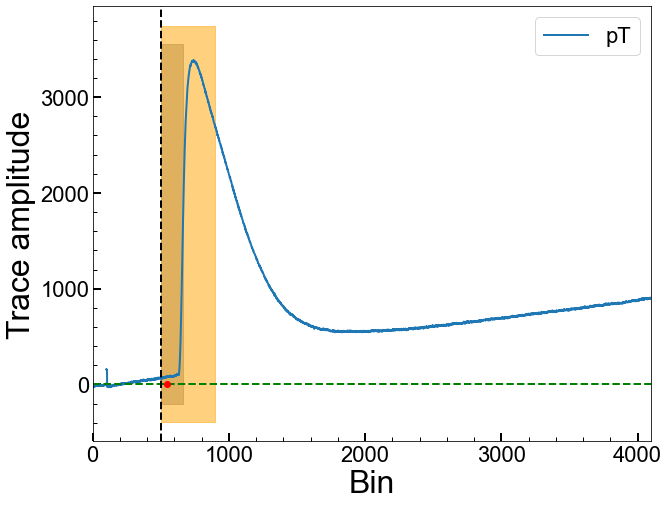

Series Number: 72209171225
Event Number: 2750246
Energy: 3.367076323864 keV
Area: 230276.57539375962


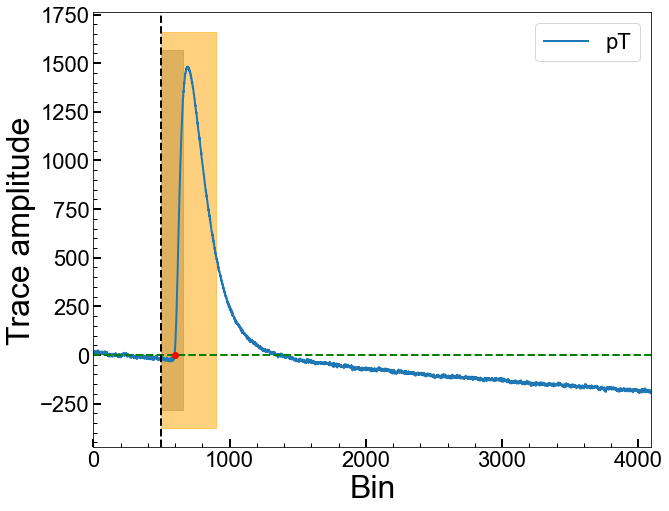

Series Number: 72209171225
Event Number: 2750623
Energy: 38.19077782626 keV
Area: 541863.5381426862


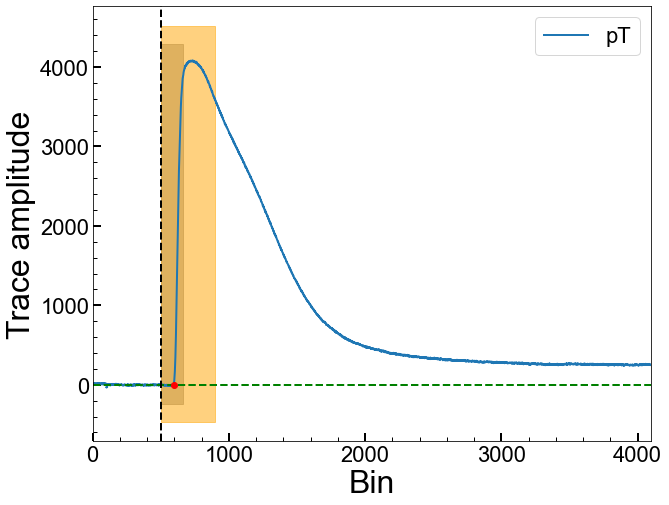

Series Number: 72209171225
Event Number: 2750804
Energy: 18.92393157832 keV
Area: 71861.1940523444


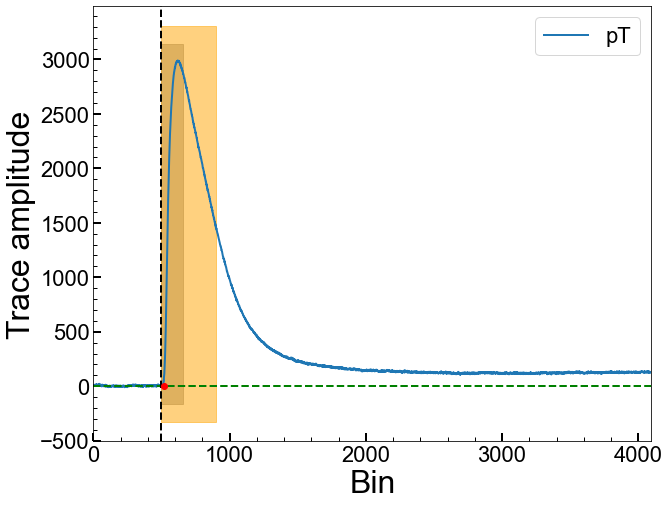

Series Number: 72209171225
Event Number: 2790209
Energy: 33.70502487732 keV
Area: 603082.3724899921


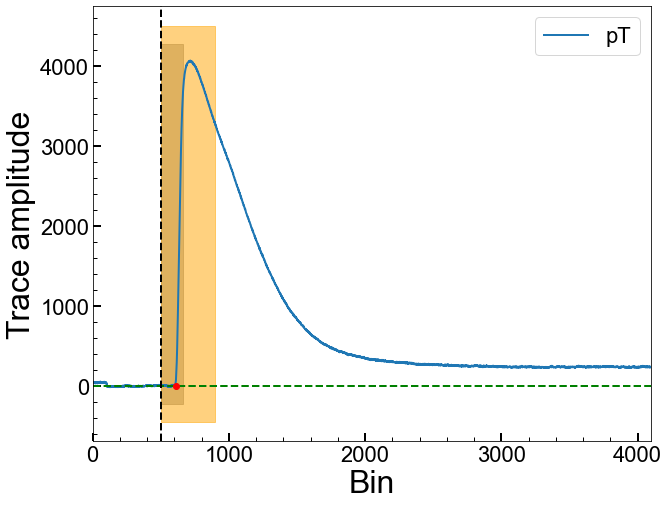

Series Number: 72209171225
Event Number: 2800023
Energy: 9.288981441905 keV
Area: -955788.2680174912


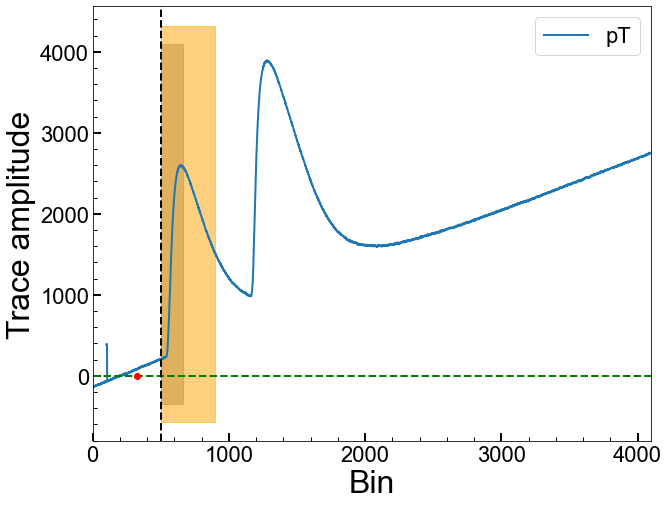

Series Number: 72209171225
Event Number: 2800492
Energy: 3.88106848511 keV
Area: -4334696.054154908


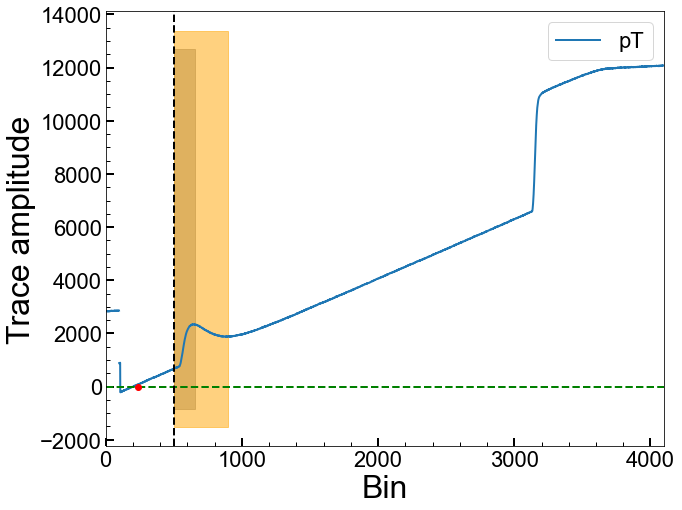

Series Number: 72209171225
Event Number: 2800598
Energy: 20.60459360599 keV
Area: 182454.53695855945


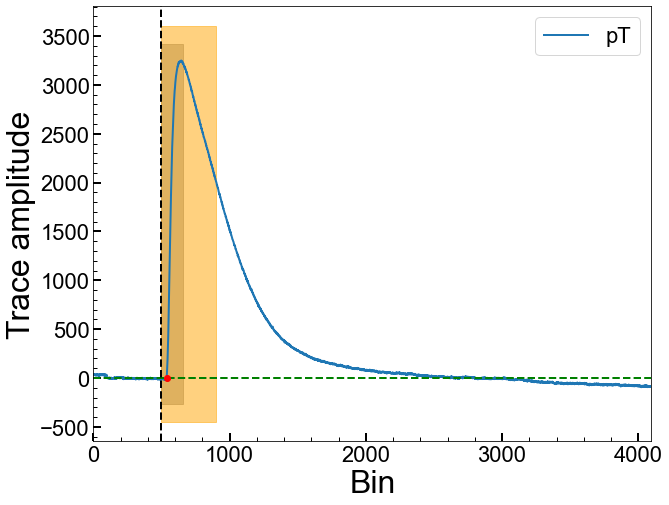

Series Number: 72209171225
Event Number: 2810346
Energy: 10.90714224773 keV
Area: 87376.96000728477


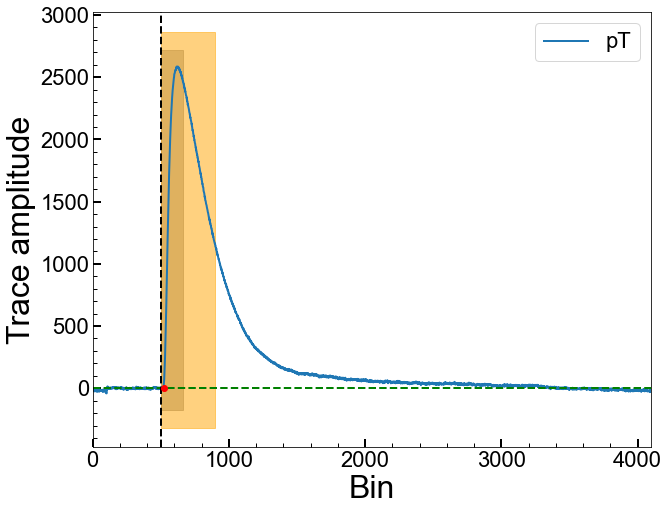

Series Number: 72209171225
Event Number: 2810681
Energy: 26.07778173173 keV
Area: 28665.16987840001


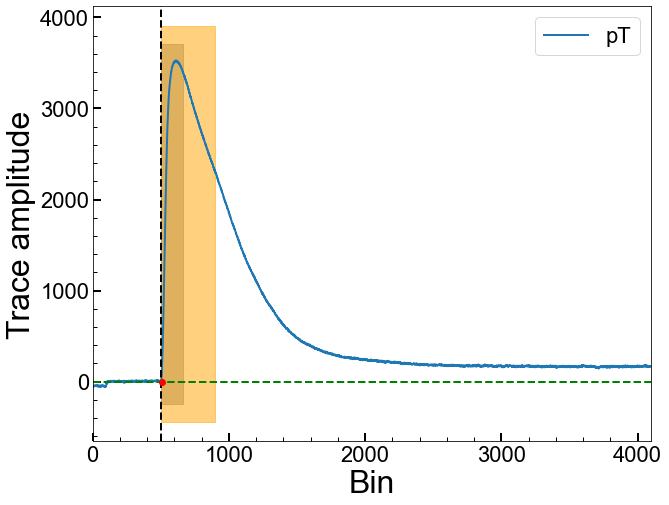

Series Number: 72209171225
Event Number: 2810879
Energy: 18.01164120126 keV
Area: 641125.2871117003


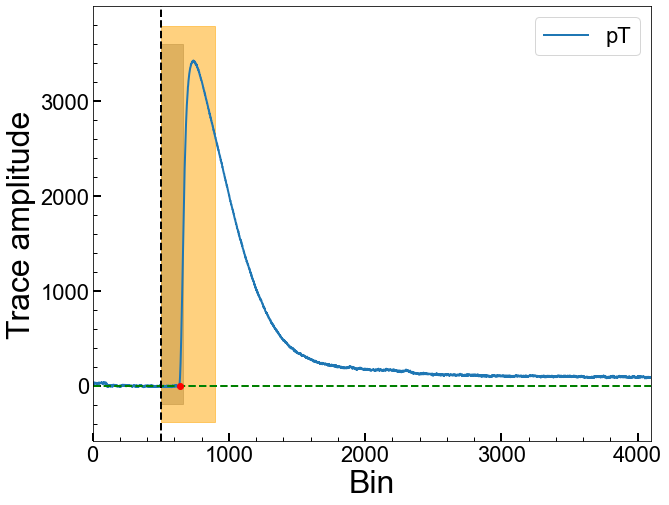

Series Number: 72209171225
Event Number: 2840093
Energy: 20.16727197882 keV
Area: -454852.3947096164


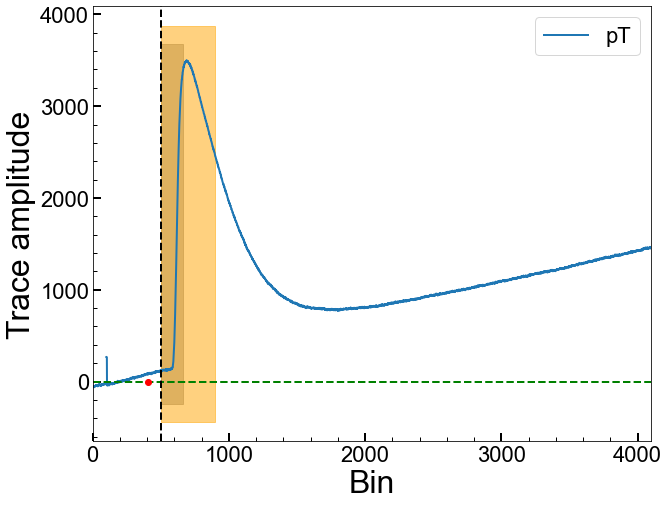

Series Number: 72209171225
Event Number: 2840820
Energy: 20.48662440695 keV
Area: 377436.25450697803


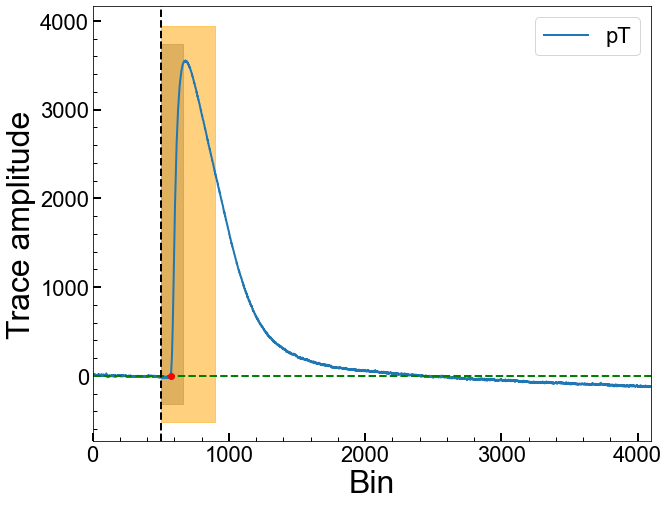

Series Number: 72209171225
Event Number: 2850591
Energy: 9.340237853322 keV
Area: 289196.87141018274


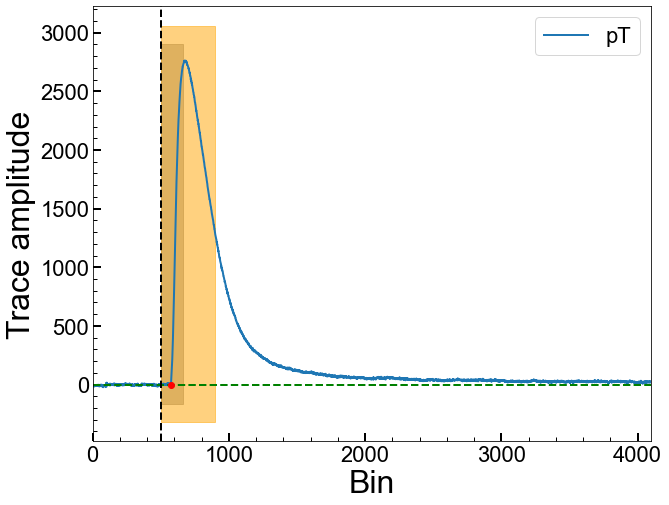

Series Number: 72209171225
Event Number: 2860716
Energy: 14.0812970012 keV
Area: -1647089.7206983399


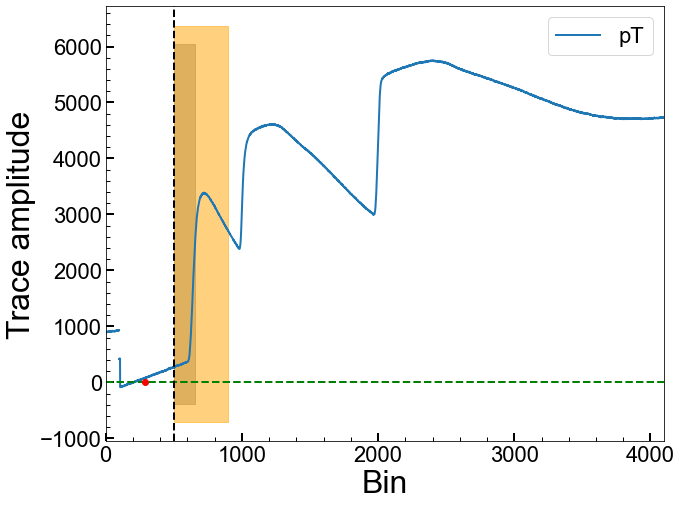

Series Number: 72209171225
Event Number: 2870868
Energy: 14.65325812094 keV
Area: 664048.4197209541


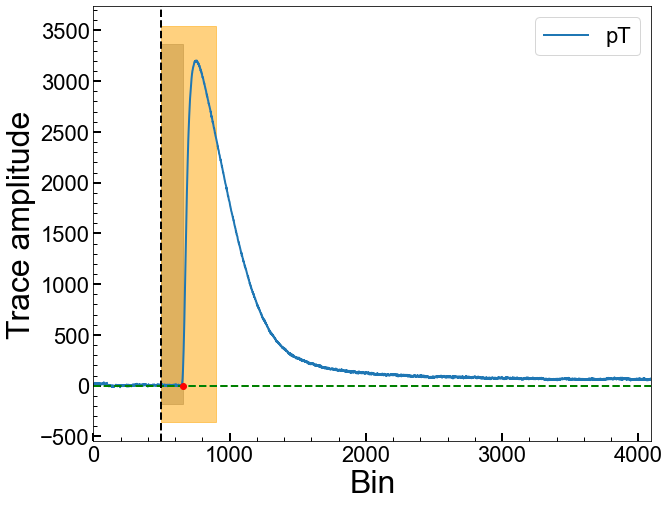

Series Number: 72209171225
Event Number: 2900039
Energy: 28.50545721731 keV
Area: 513377.69143913494


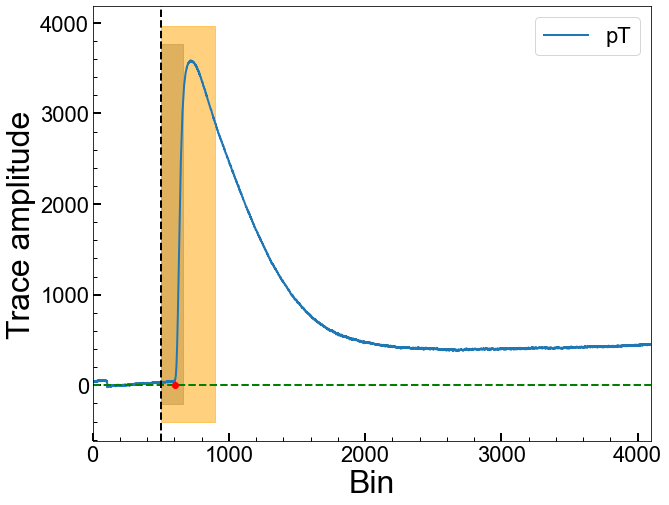

Series Number: 72209171225
Event Number: 2900617
Energy: 43.0335593464 keV
Area: 671791.9320553755


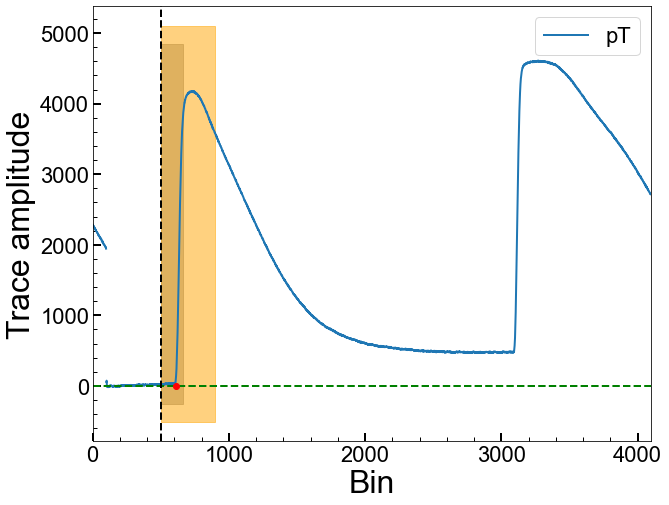

Series Number: 72209171225
Event Number: 2910234
Energy: 14.54901584511 keV
Area: -1776927.7447529659


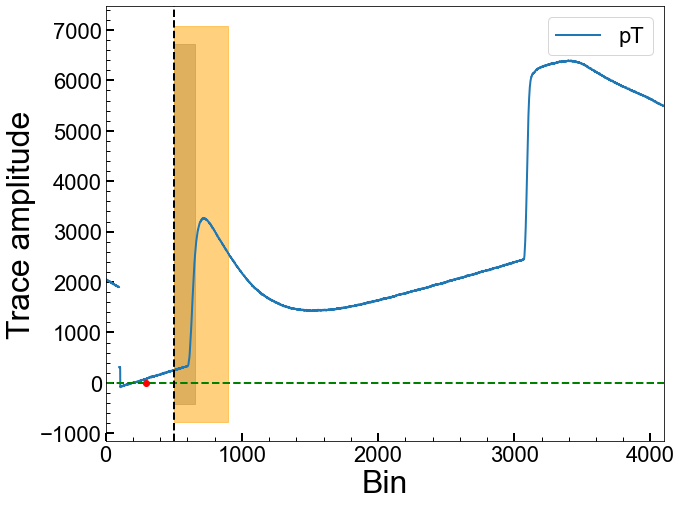

Series Number: 72209171225
Event Number: 2910242
Energy: 16.52374381231 keV
Area: 393563.7903648001


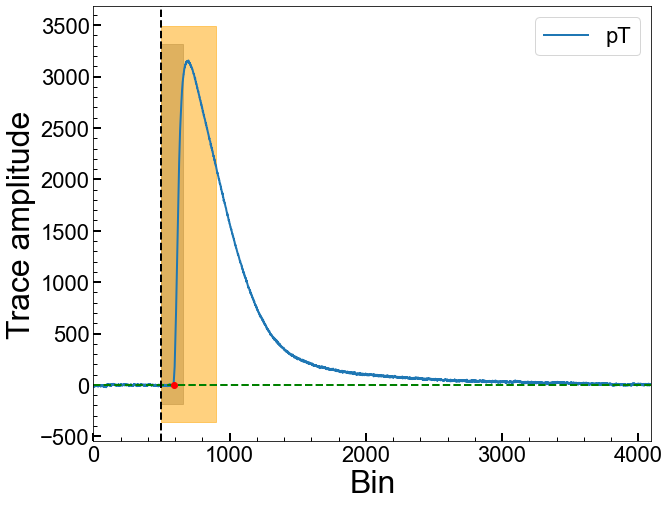

Series Number: 72209171225
Event Number: 2910265
Energy: 30.29312389838 keV
Area: 641698.5092119521


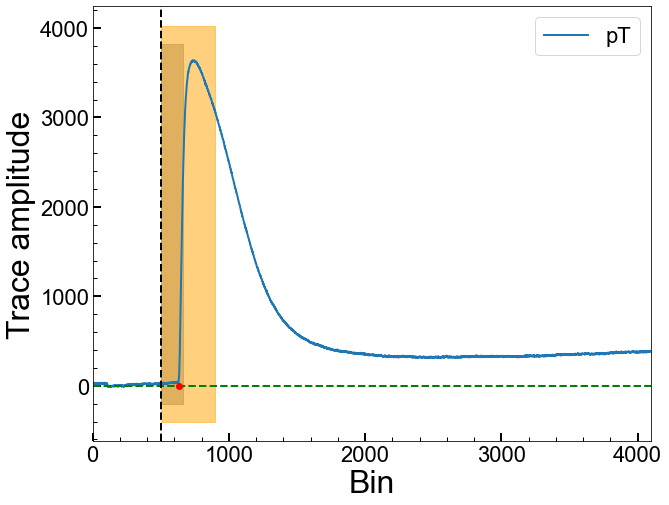

Series Number: 72209171225
Event Number: 2910678
Energy: 2.355686615019 keV
Area: 106860.15328822244


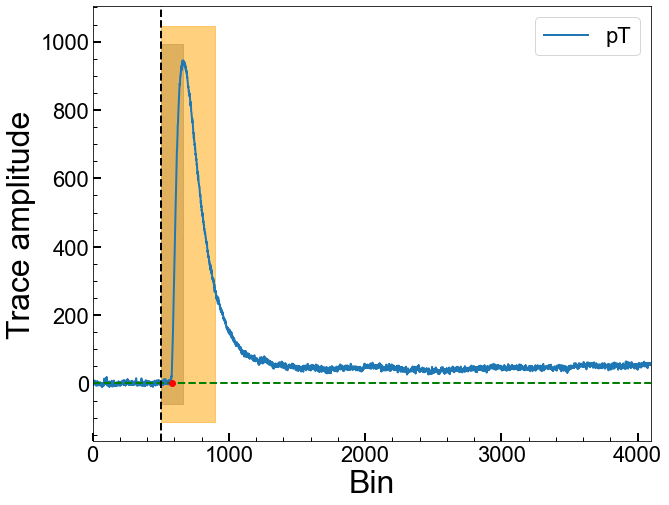

Series Number: 72209171225
Event Number: 2940228
Energy: 48.55329150194 keV
Area: -1790358.9298102036


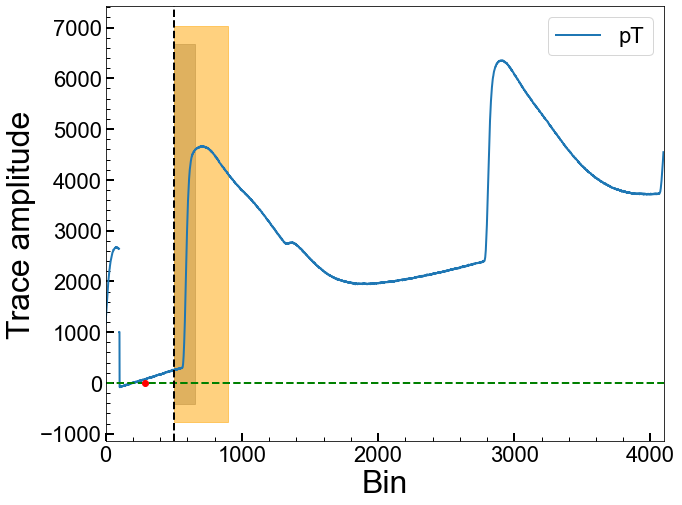

Series Number: 72209171225
Event Number: 2960129
Energy: 33.86271781765 keV
Area: 227463.73254203977


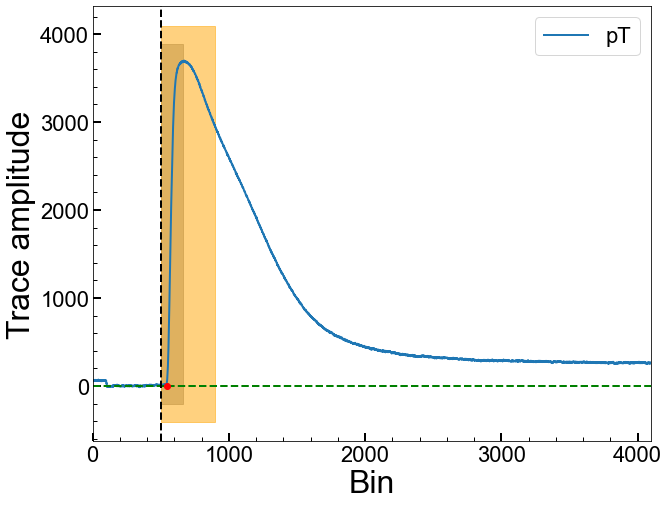

Series Number: 72209171225
Event Number: 2970480
Energy: 26.23895983395 keV
Area: 414217.82506801584


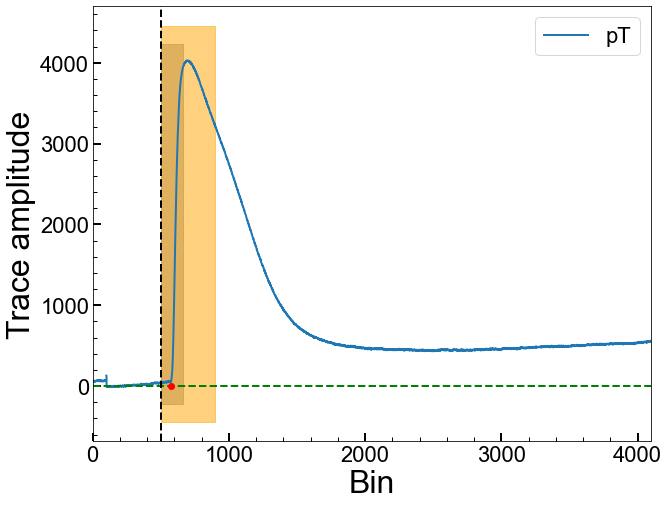

Series Number: 72209171225
Event Number: 2970647
Energy: 18.4421071274 keV
Area: 711352.6799215891


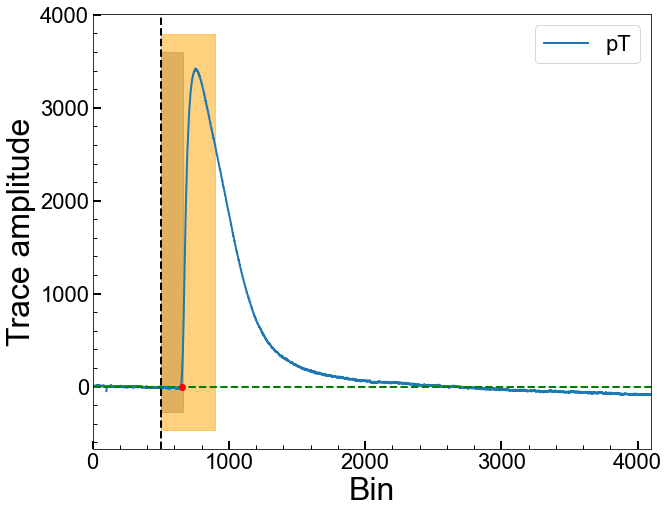

Series Number: 72209171225
Event Number: 2980092
Energy: 36.41708341009 keV
Area: 557355.0299789559


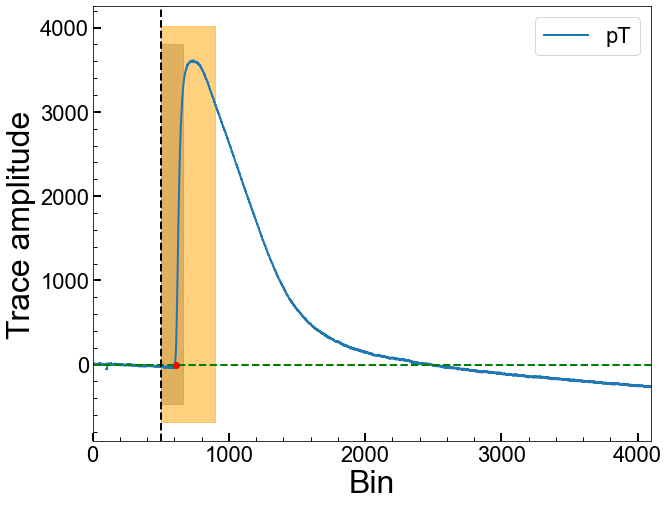

Series Number: 72209171225
Event Number: 2980281
Energy: 7.016494358883 keV
Area: 324001.08402185433


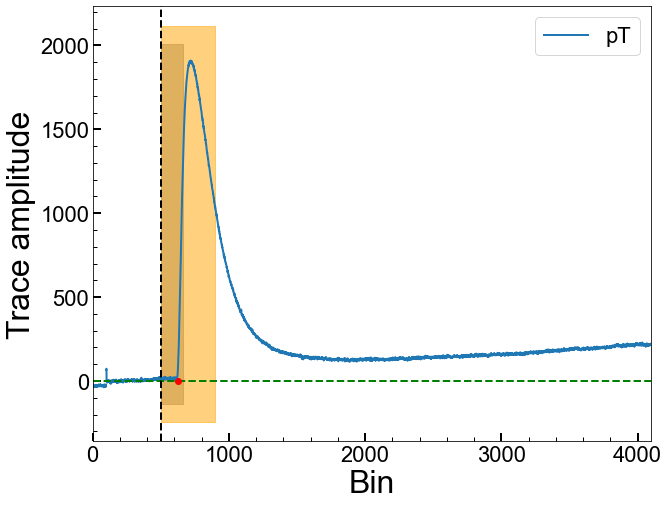

Series Number: 72209171225
Event Number: 3000414
Energy: 12.15671507999 keV
Area: 547699.8672127151


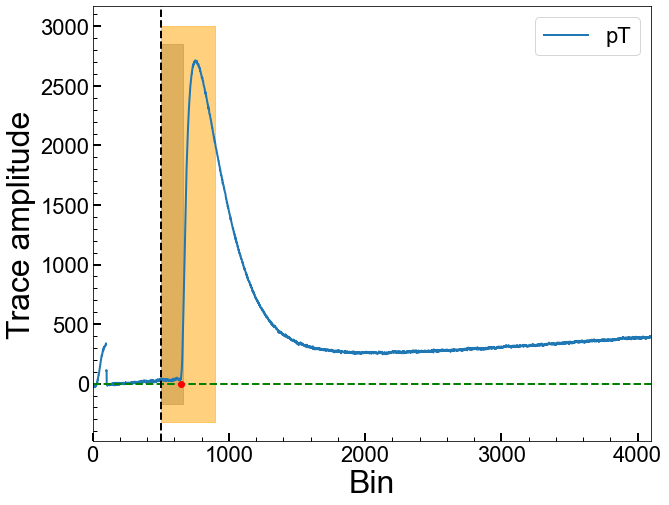

Series Number: 72209171225
Event Number: 3010121
Energy: 22.60529633399 keV
Area: 316907.81072467467


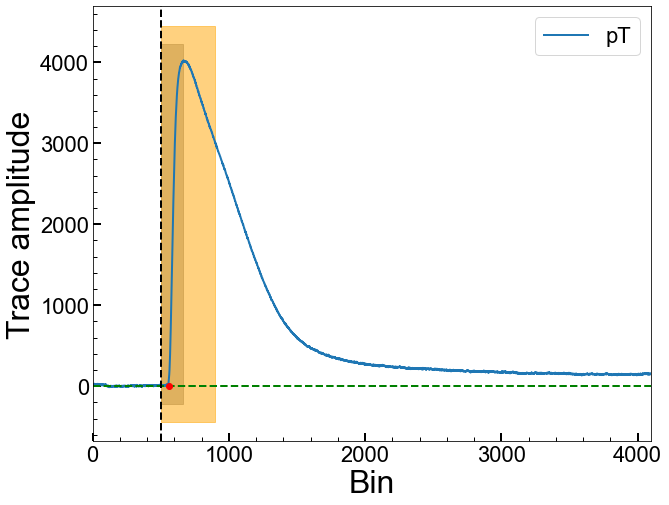

Series Number: 72209171225
Event Number: 3010306
Energy: 48.03987729901 keV
Area: 307713.08970760263


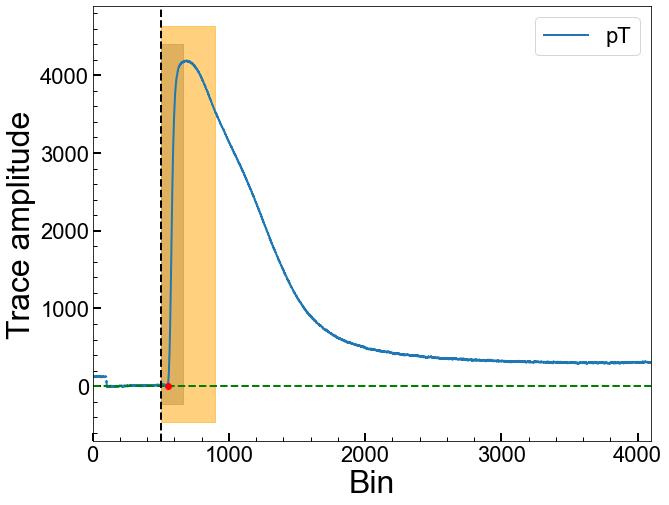

Series Number: 72209171225
Event Number: 3020550
Energy: 14.72033617178 keV
Area: 373277.7987043918


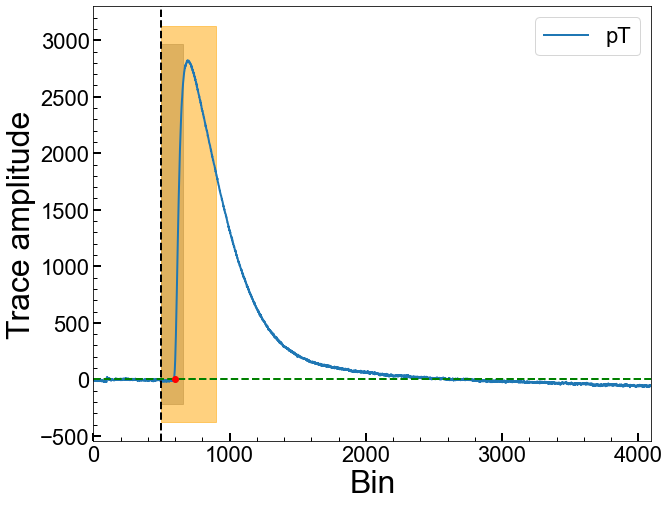

Series Number: 72209171225
Event Number: 3030744
Energy: 33.11465378196 keV
Area: 516717.95753553405


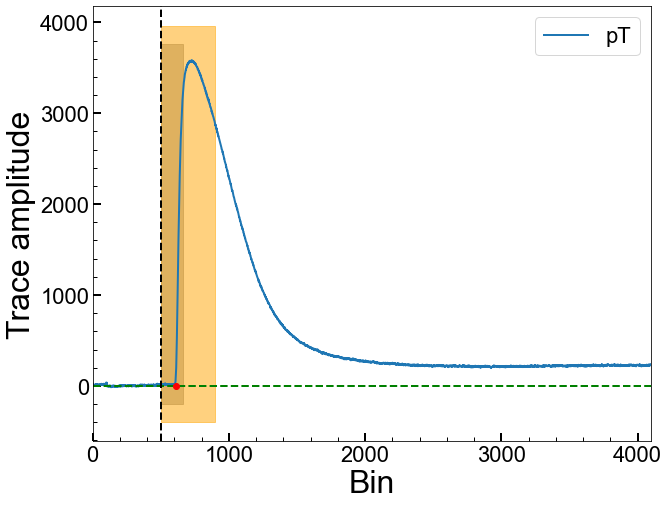

Series Number: 72209171225
Event Number: 3030867
Energy: 16.44786912328 keV
Area: 508569.96000120154


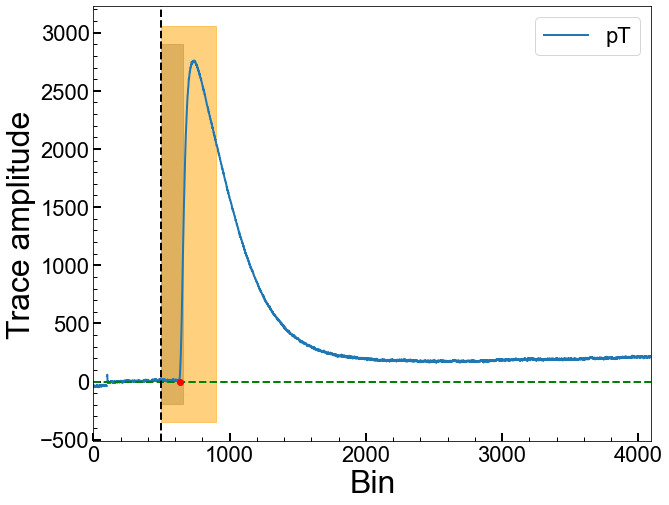

Series Number: 72209171225
Event Number: 3040642
Energy: 48.61542936673 keV
Area: 800774.1324275853


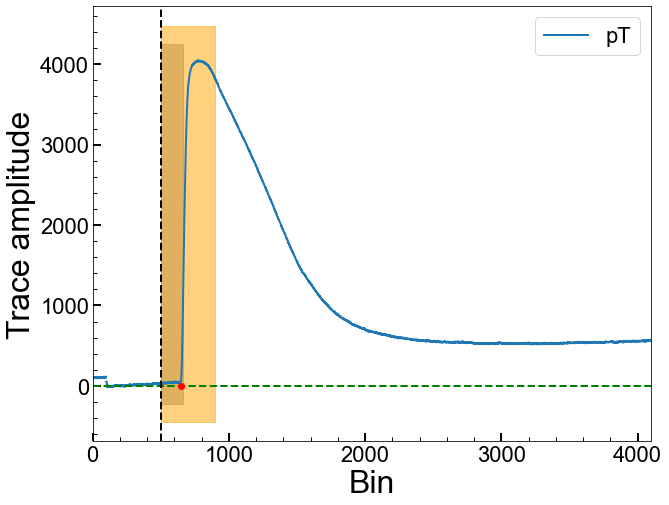

Series Number: 72209171225
Event Number: 3040695
Energy: 32.80725080574 keV
Area: -4205246.787144095


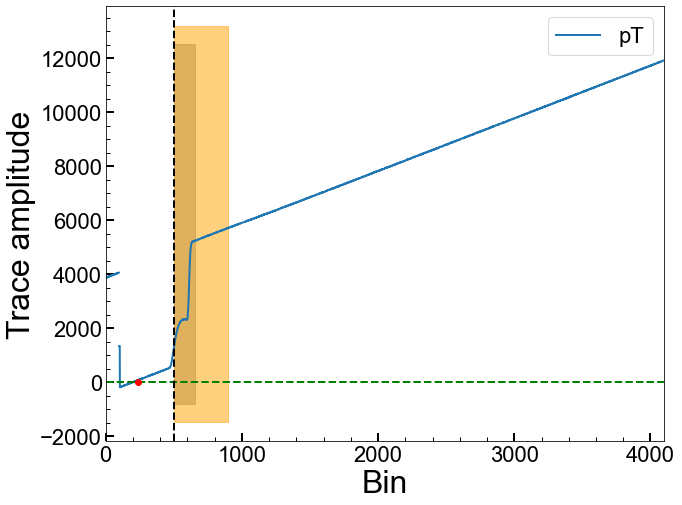

Series Number: 72209171225
Event Number: 3050230
Energy: 36.90201182217 keV
Area: 712603.0473986121


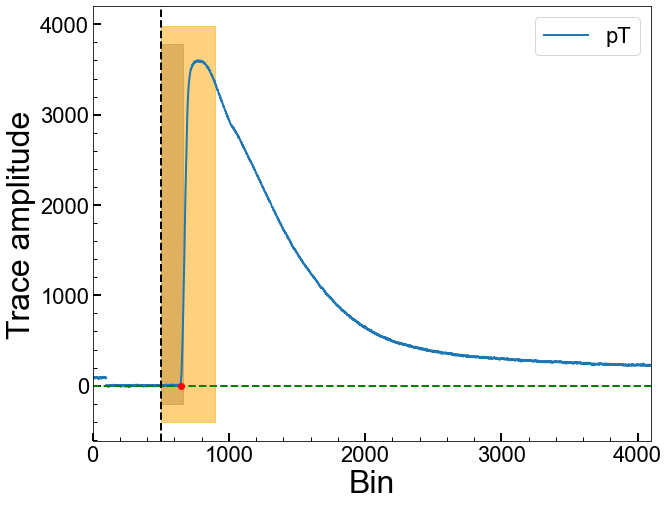

Series Number: 72209171225
Event Number: 3050298
Energy: 21.37244455501 keV
Area: -1058425.9680990372


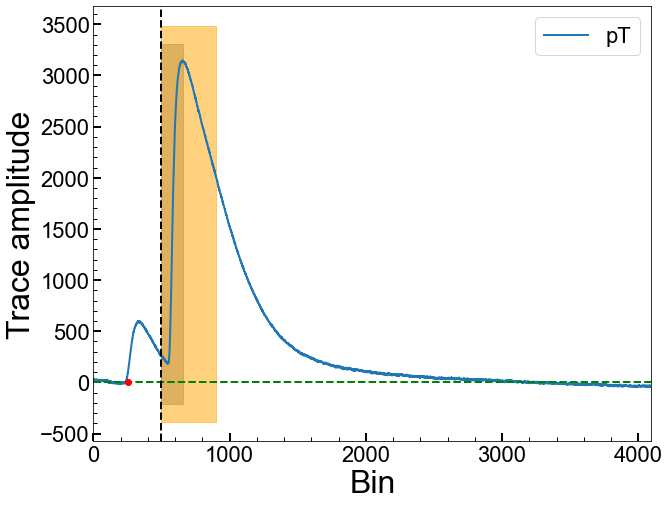

Series Number: 72209171225
Event Number: 3050718
Energy: 40.42648573511 keV
Area: 1025593.4168742677


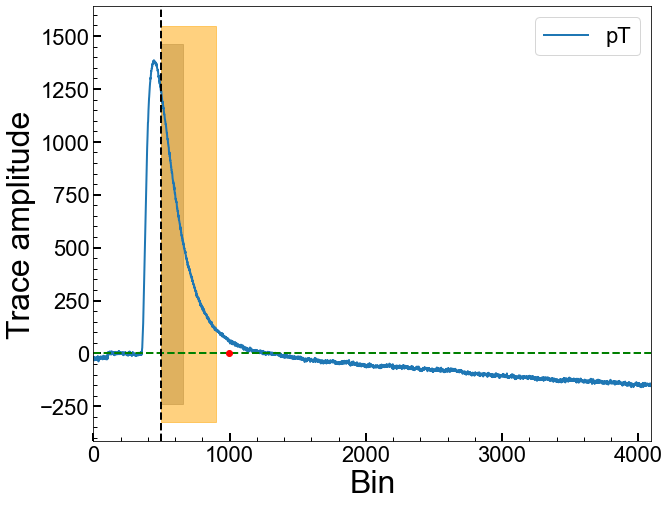

Series Number: 72209171225
Event Number: 3060348
Energy: 8.916114338373 keV
Area: 224964.69403299573


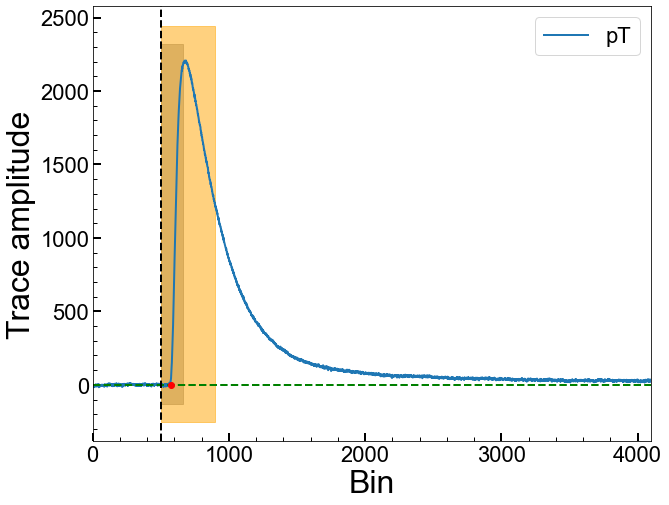

Series Number: 72209171225
Event Number: 3060867
Energy: 28.59519782766 keV
Area: 564977.4683902316


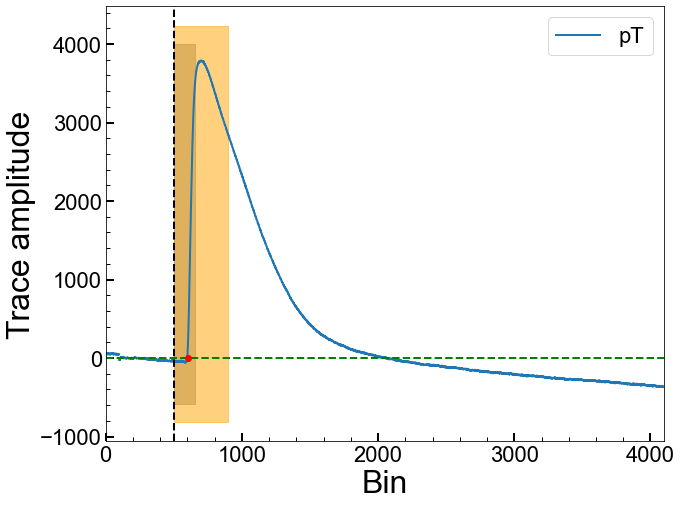

Series Number: 72209171225
Event Number: 3090181
Energy: 35.77850867822 keV
Area: 277507.5133347655


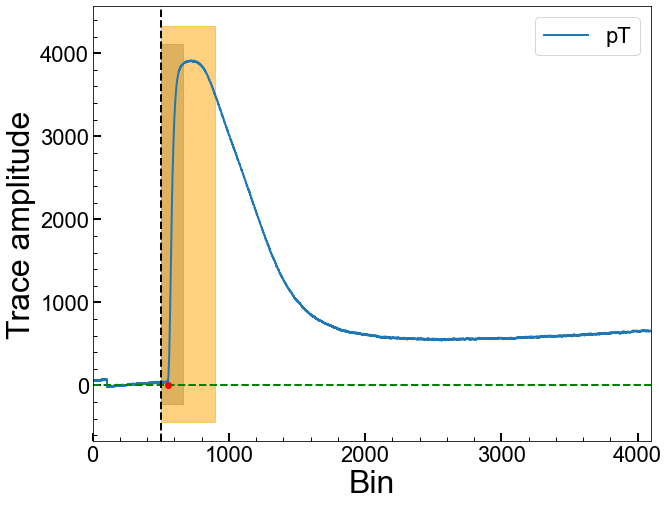

Series Number: 72209171225
Event Number: 3100127
Energy: 21.84311958765 keV
Area: -1213701.6021056818


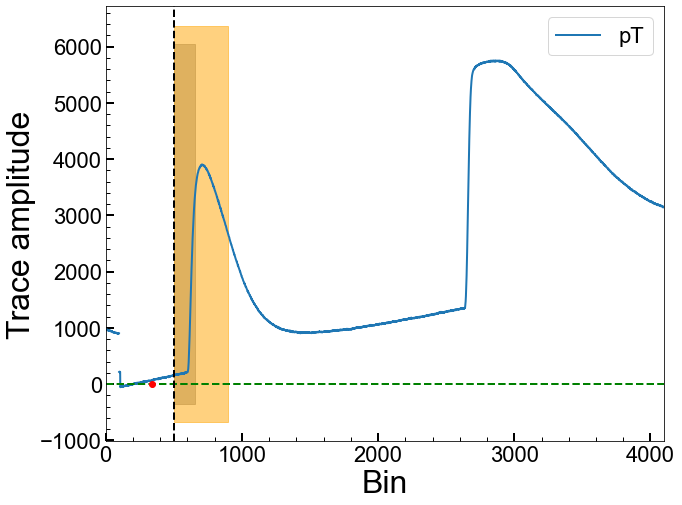

Series Number: 72209171225
Event Number: 3100271
Energy: 7.257608835645 keV
Area: 819139.6775878305


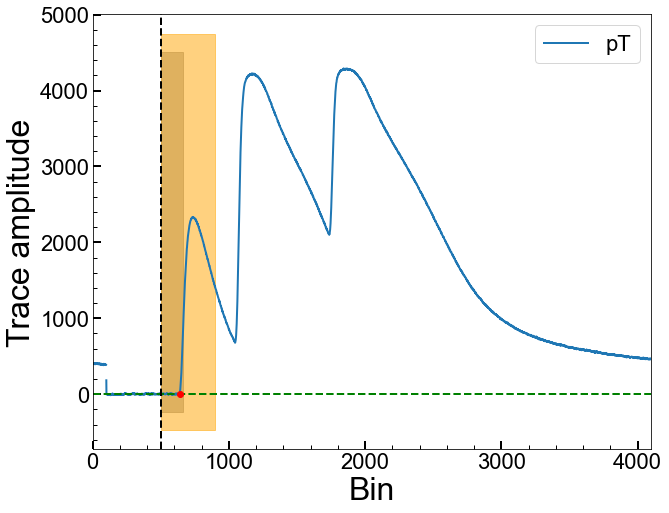

Series Number: 72209171225
Event Number: 3130430
Energy: 24.54197540885 keV
Area: 357619.63803973526


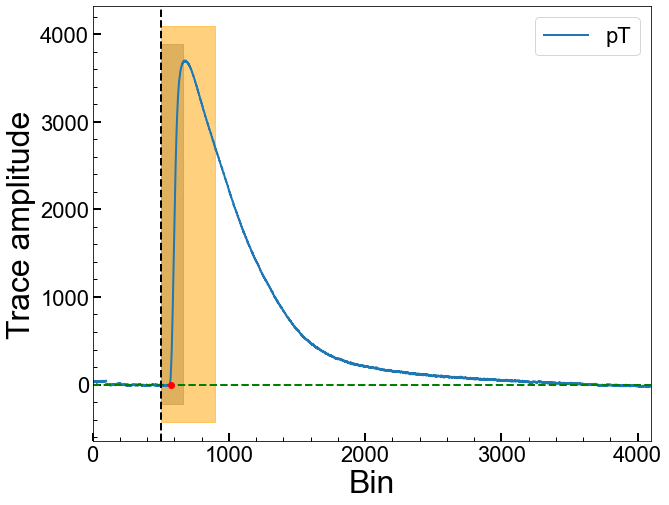

Series Number: 72209171225
Event Number: 3140171
Energy: 45.50296144897 keV
Area: 561579.1098286413


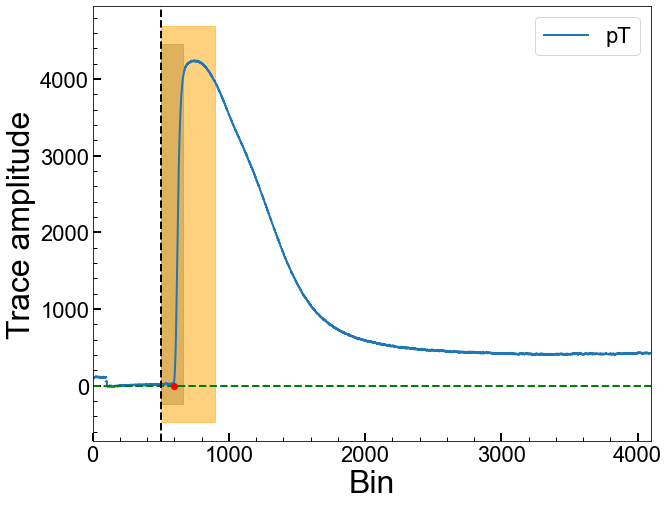

Series Number: 72209171225
Event Number: 3140533
Energy: 19.47280527078 keV
Area: 137545.8993993819


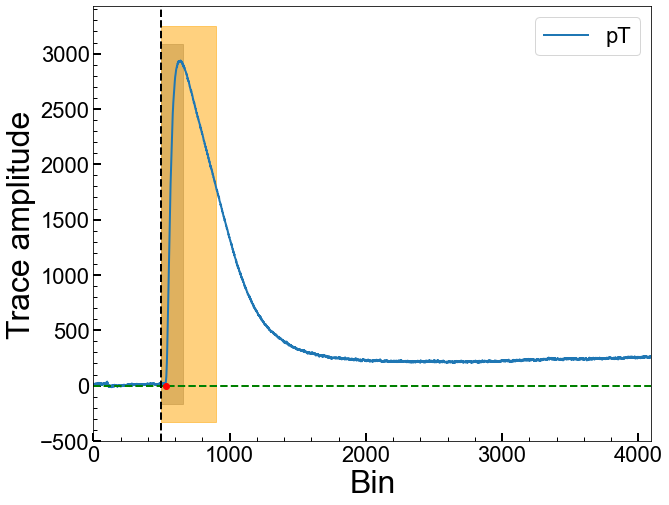

Series Number: 72209171225
Event Number: 3140592
Energy: 5.393781686734 keV
Area: -1460188.5786859253


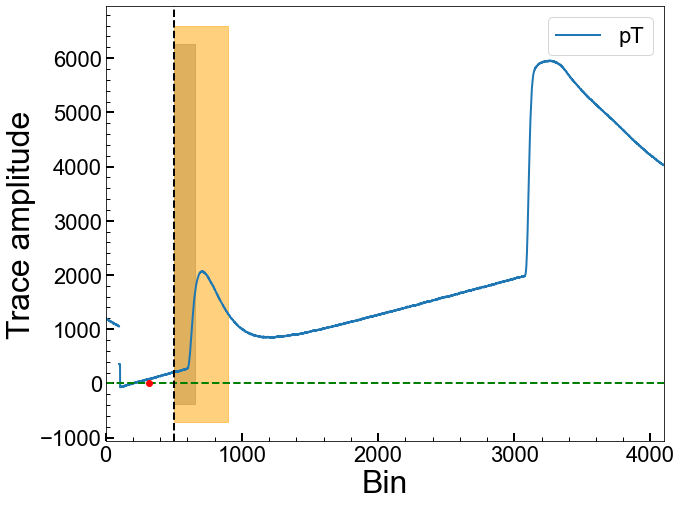

Series Number: 72209171225
Event Number: 3150003
Energy: 10.86326535149 keV
Area: 360217.09881933744


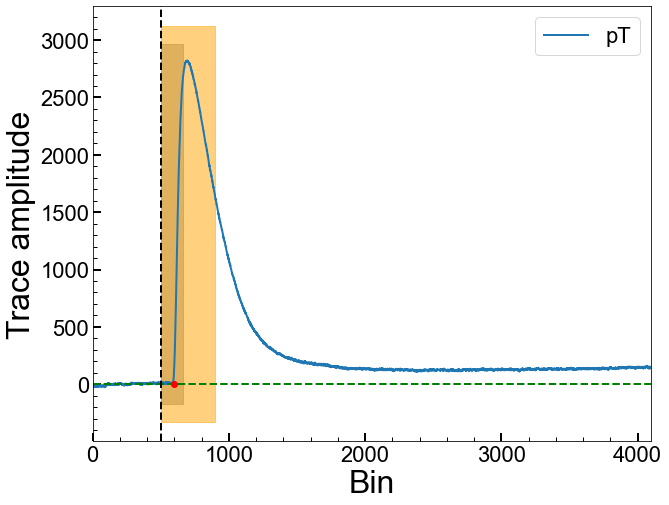

Series Number: 72209171225
Event Number: 3150929
Energy: 16.35014197366 keV
Area: 94623.19244265965


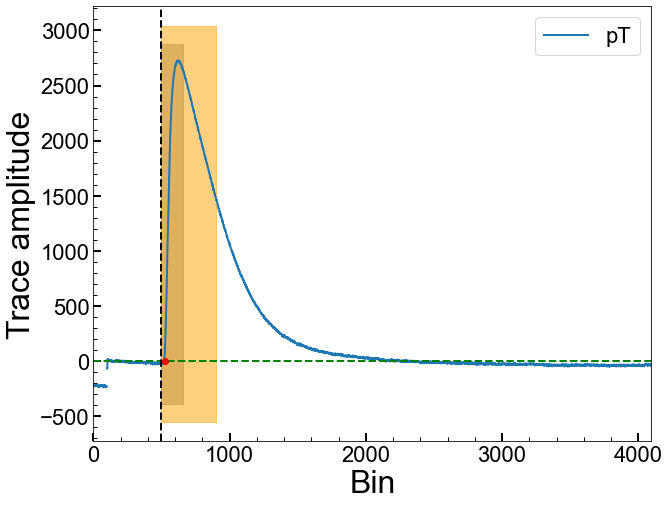

Series Number: 72209171225
Event Number: 3160820
Energy: 45.57952123321 keV
Area: 280810.3879519735


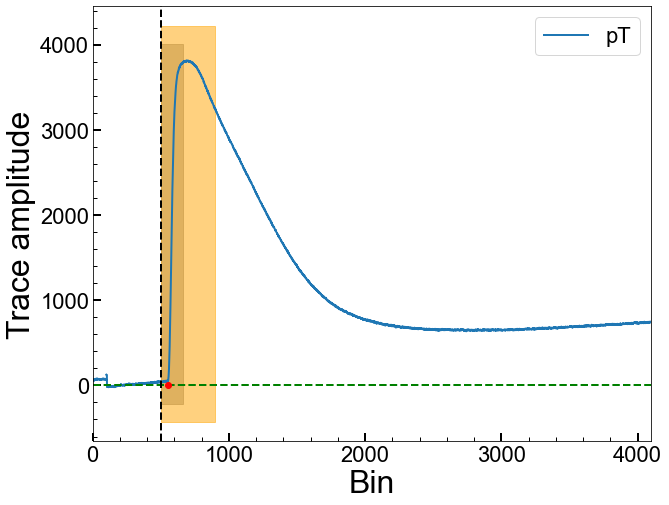

Series Number: 72209171225
Event Number: 3190365
Energy: 46.67255867091 keV
Area: 133963.07074176957


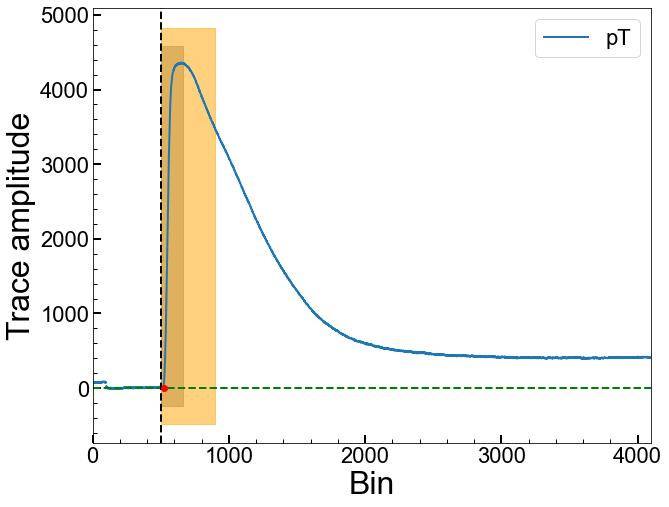

Series Number: 72209171225
Event Number: 3200882
Energy: 6.243001051 keV
Area: -3719248.583852143


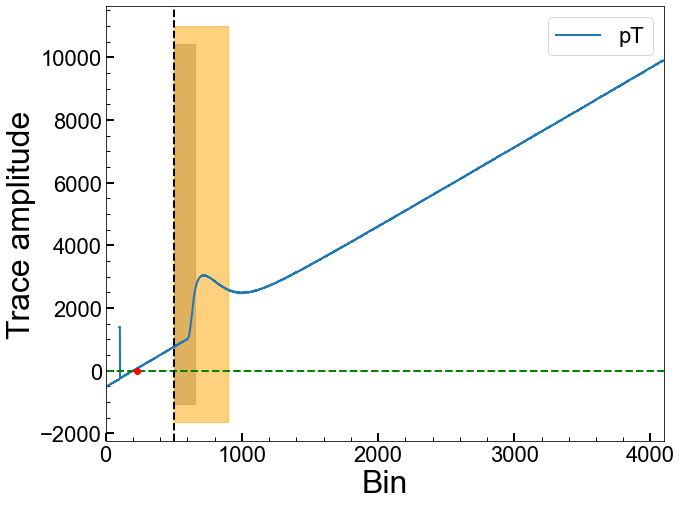

Series Number: 72209171225
Event Number: 3220127
Energy: 4.505719427428 keV
Area: 117606.9631318783


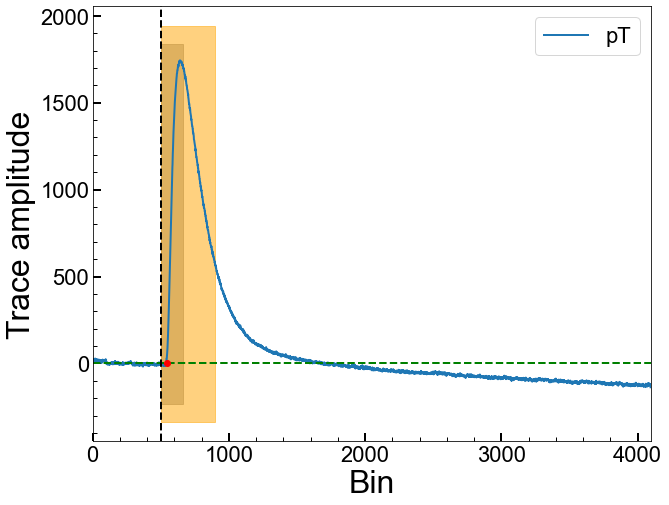

Series Number: 72209171225
Event Number: 3230430
Energy: 48.25423547677 keV
Area: 228881.90792958945


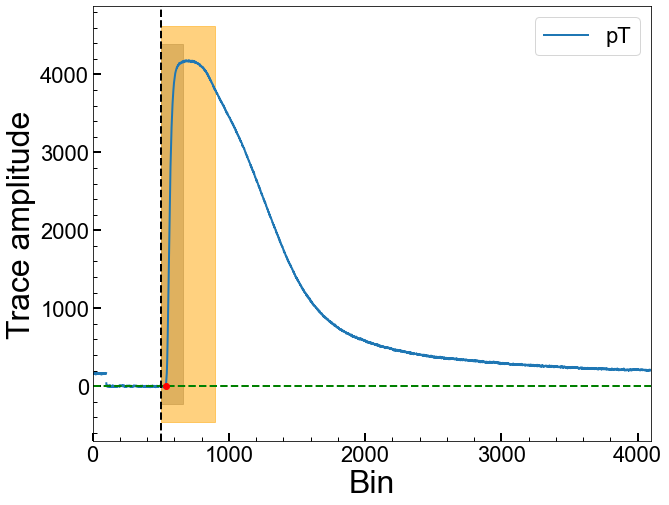

Series Number: 72209171225
Event Number: 3230564
Energy: 22.69955023817 keV
Area: 515800.59267702256


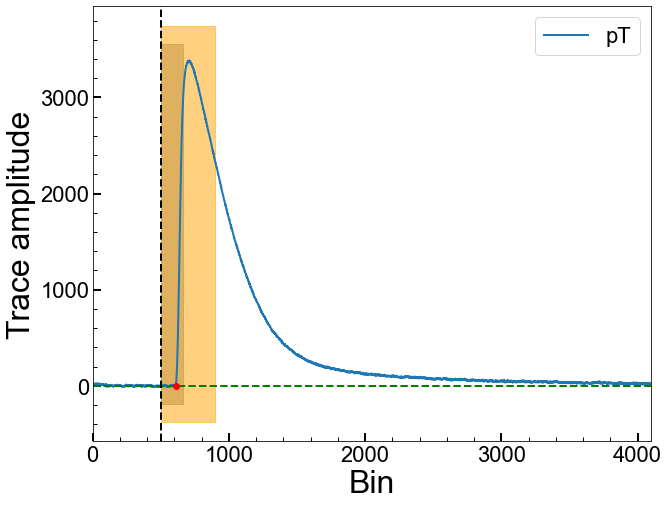

Series Number: 72209171225
Event Number: 3240393
Energy: 38.16445118885 keV
Area: 32558.928431109947


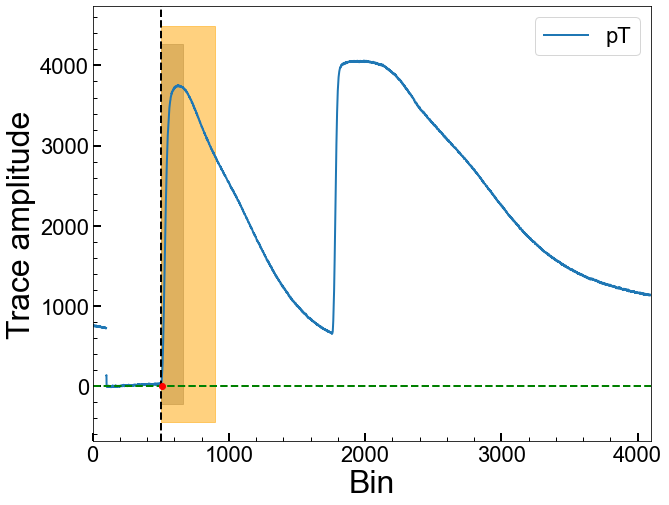

Series Number: 72209171225
Event Number: 3240806
Energy: 4.744380795301 keV
Area: 174358.2329867459


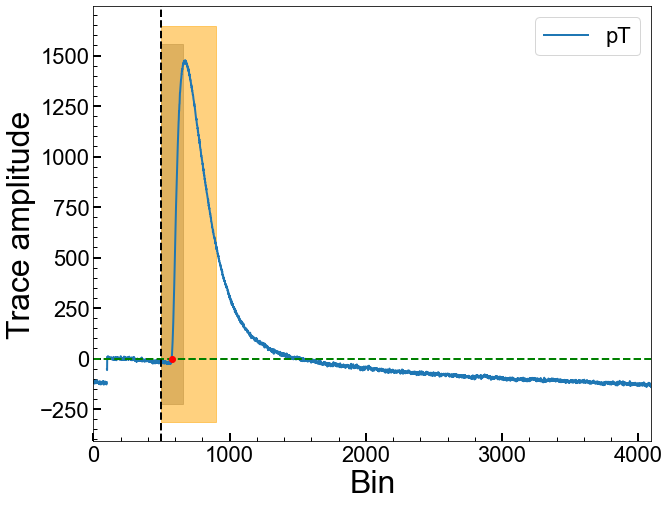

Series Number: 72209171225
Event Number: 3260623
Energy: 42.98597219122 keV
Area: 646704.0984434015


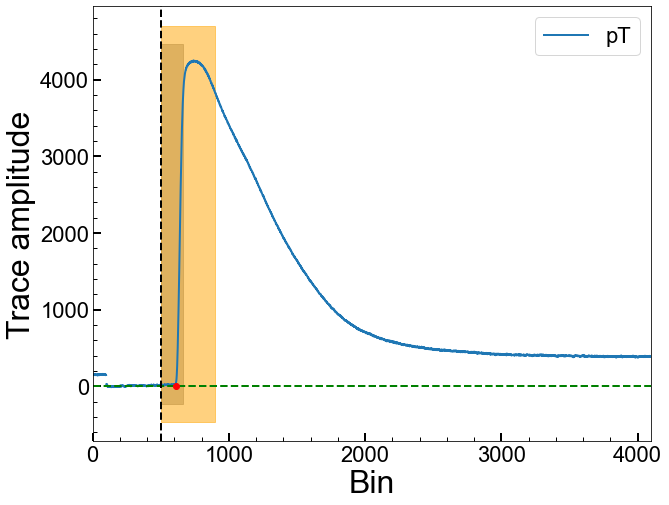

Series Number: 72209171225
Event Number: 3270331
Energy: 5.536829872219 keV
Area: 271499.4221594711


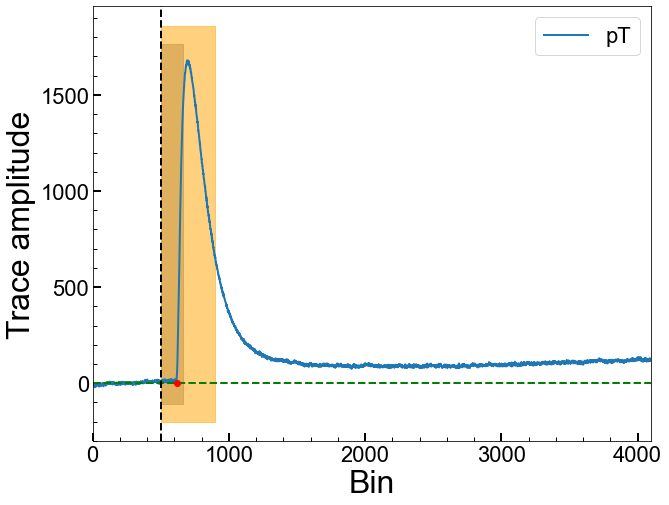

Series Number: 72209171225
Event Number: 3290733
Energy: 46.56340265802 keV
Area: 514712.1377853883


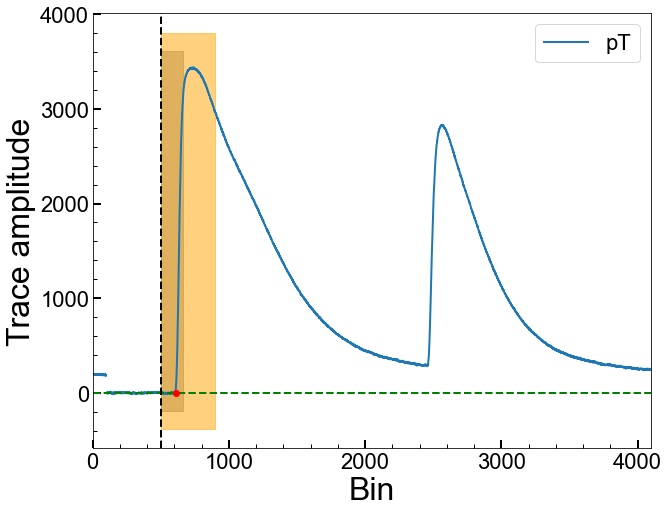

Series Number: 72209171225
Event Number: 3300216
Energy: 4.157315084321 keV
Area: -2502496.4939372144


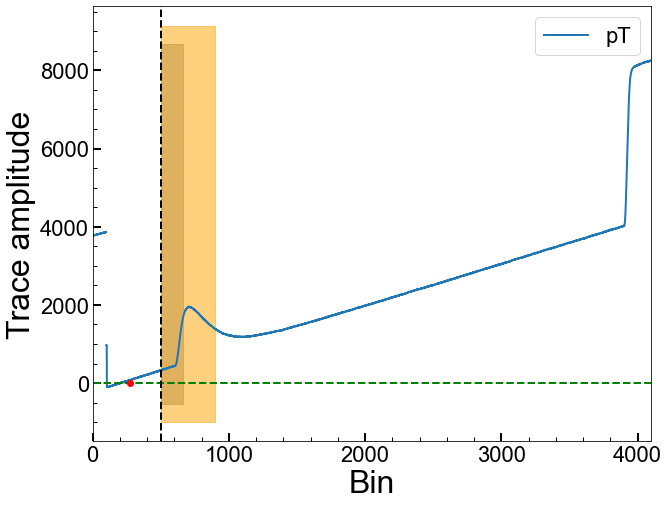

Series Number: 72209171225
Event Number: 3310283
Energy: 14.87296573437 keV
Area: 488765.4759920885


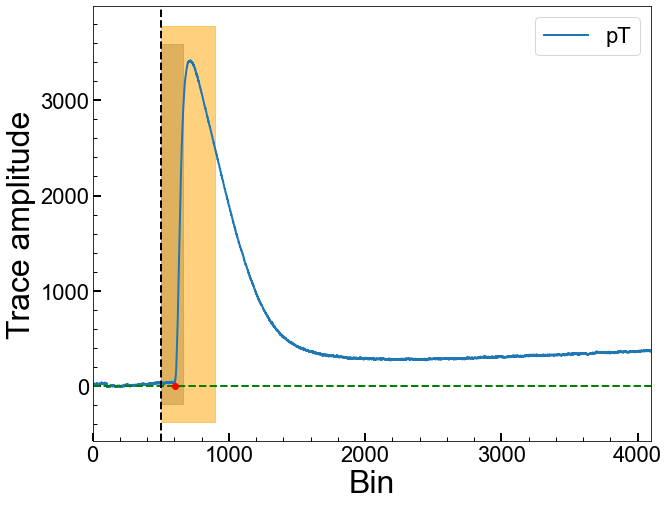

Series Number: 72209171225
Event Number: 3310642
Energy: 21.850119679 keV
Area: 447758.81106437073


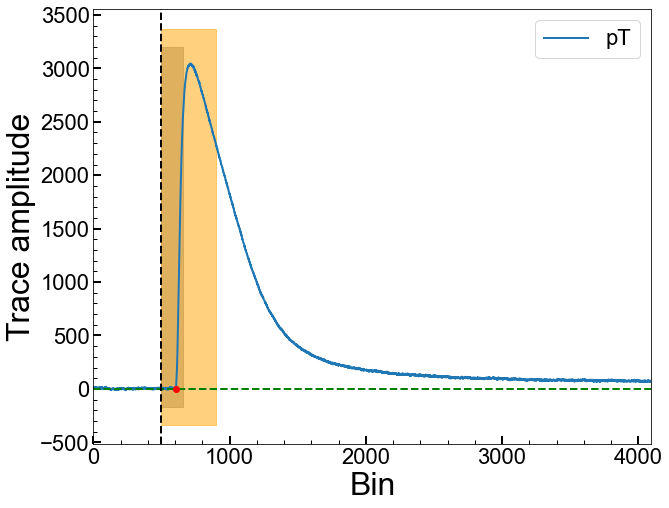

Series Number: 72209171225
Event Number: 3320220
Energy: 46.02372811043 keV
Area: 770001.1245554968


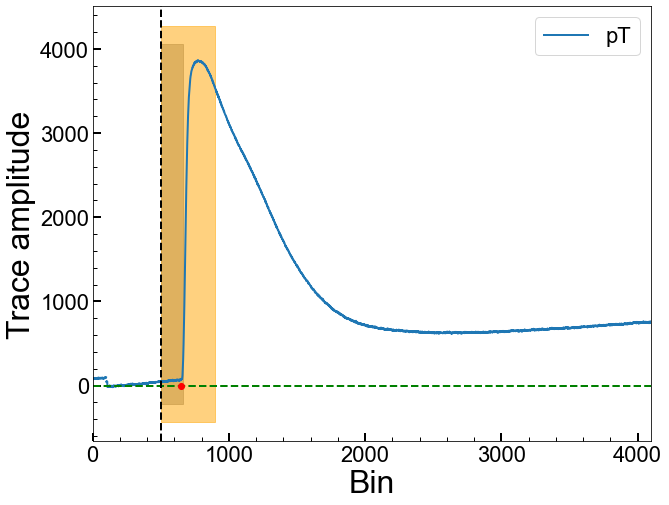

Series Number: 72209171225
Event Number: 3320811
Energy: 46.5240910729 keV
Area: 381265.3598774835


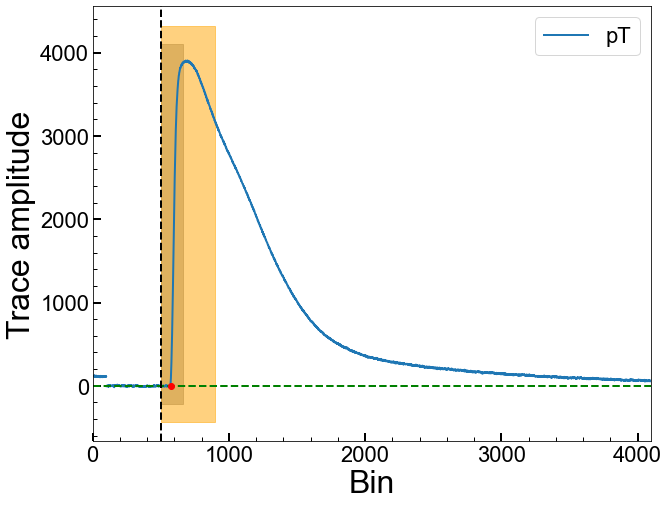

Series Number: 72209171225
Event Number: 3370019
Energy: 21.4089221494 keV
Area: -3572149.449147057


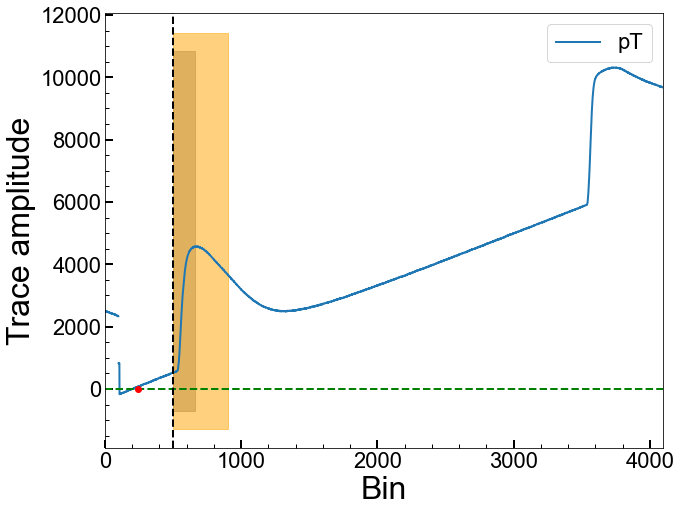

Series Number: 72209171225
Event Number: 3370351
Energy: 18.81551568015 keV
Area: 150859.41155168568


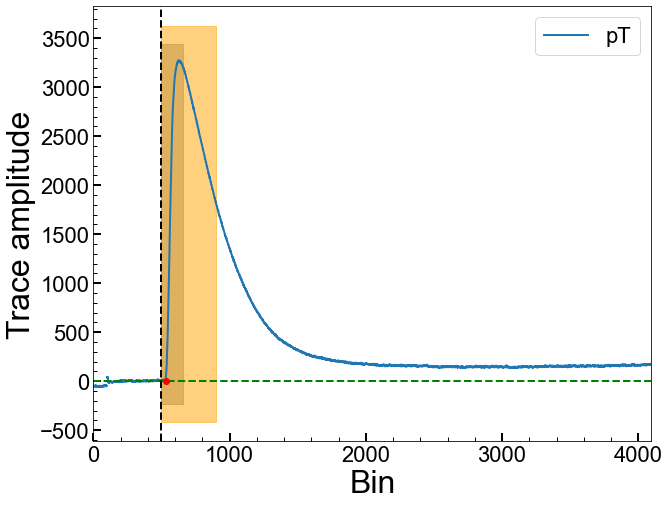

Series Number: 72209171225
Event Number: 3370612
Energy: 47.31216068962 keV
Area: 724551.327288664


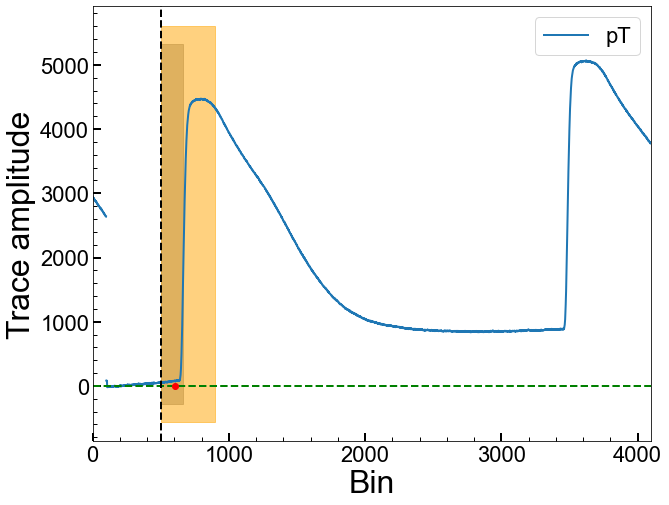

Series Number: 72209171225
Event Number: 3390113
Energy: 46.3155224011 keV
Area: 507046.40894053155


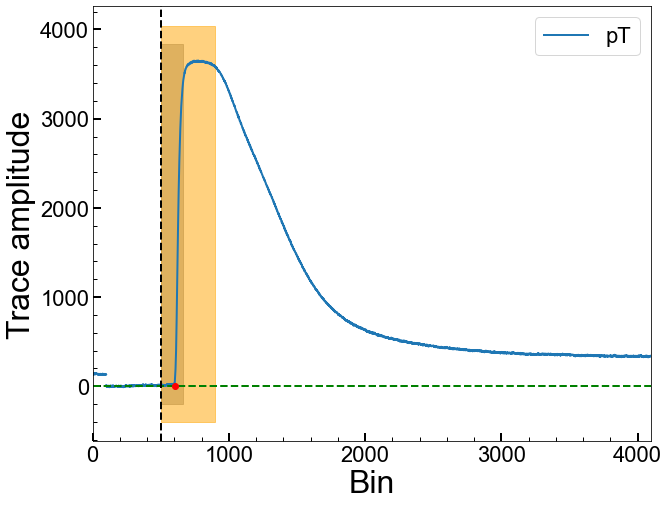

Series Number: 72209171225
Event Number: 3390662
Energy: 31.73582604531 keV
Area: 532815.5243505484


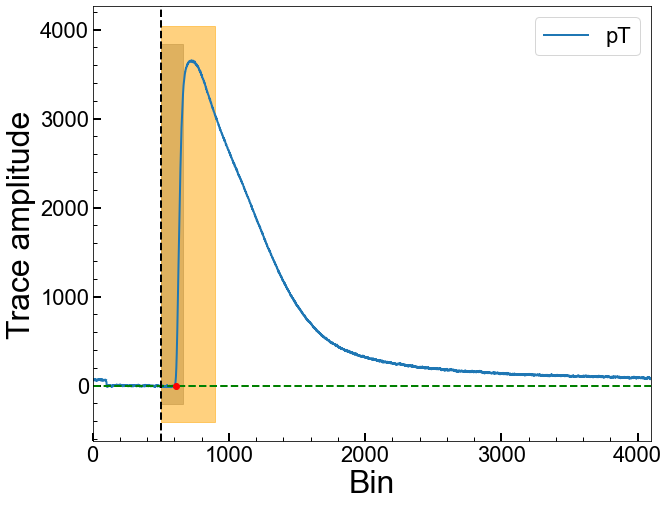

Series Number: 72209171225
Event Number: 3420691
Energy: 12.24639923393 keV
Area: 118664.10473769534


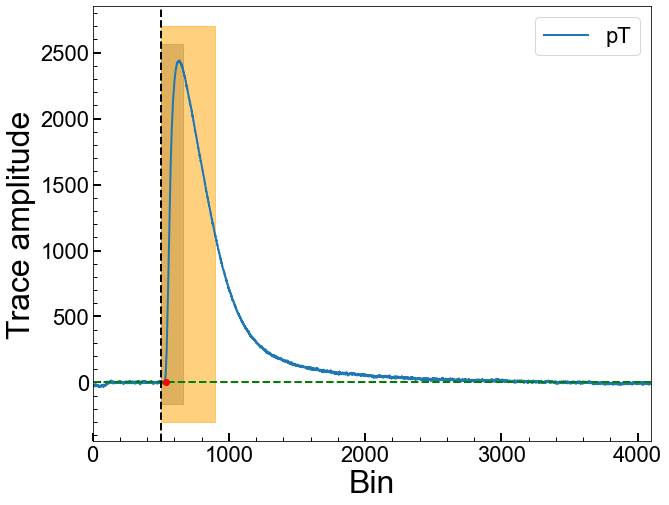

Series Number: 72209171225
Event Number: 3440491
Energy: 47.38070400198 keV
Area: 591056.6264231261


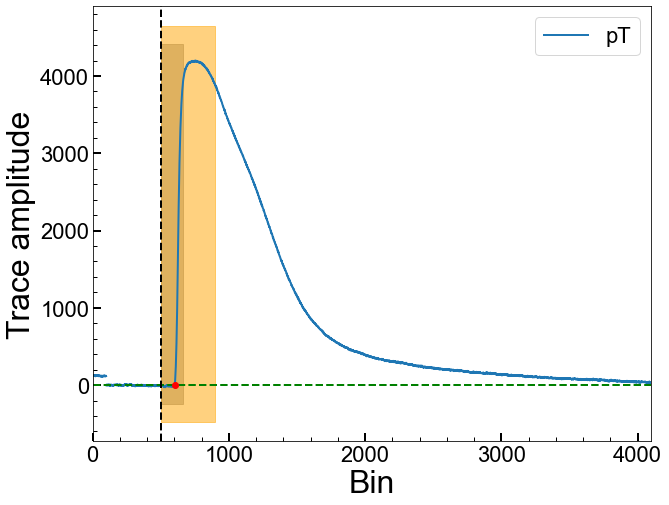

Series Number: 72209171225
Event Number: 3440793
Energy: 21.5577163389 keV
Area: 593217.7060363448


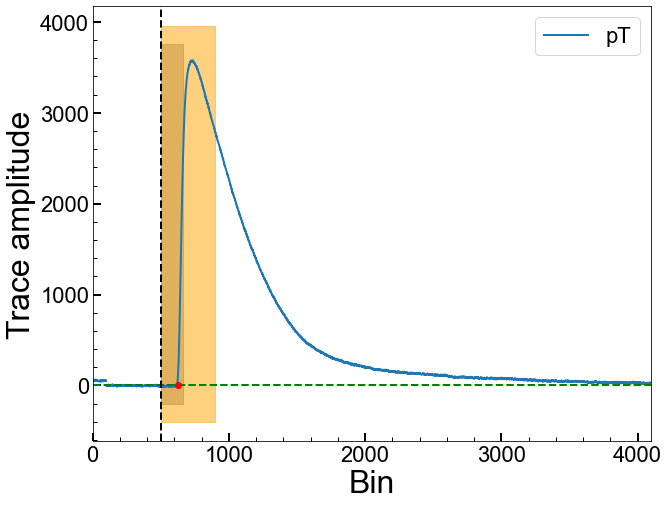

Series Number: 72209171225
Event Number: 3470054
Energy: 35.86396016142 keV
Area: 77907.67890458276


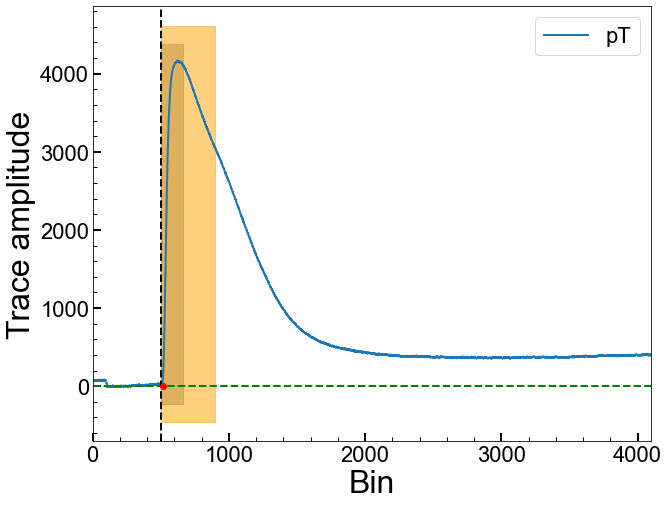

Series Number: 72209171225
Event Number: 3470433
Energy: 5.00606400096 keV
Area: 279088.8769169483


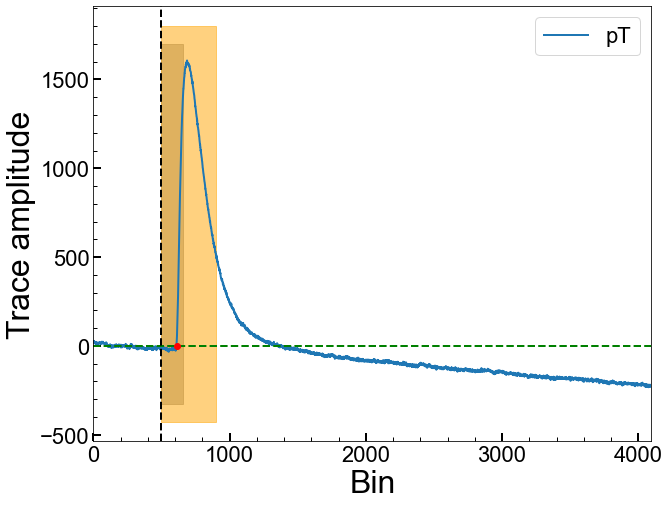

Series Number: 72209171225
Event Number: 3490300
Energy: 22.21453730772 keV
Area: 182334.77917052183


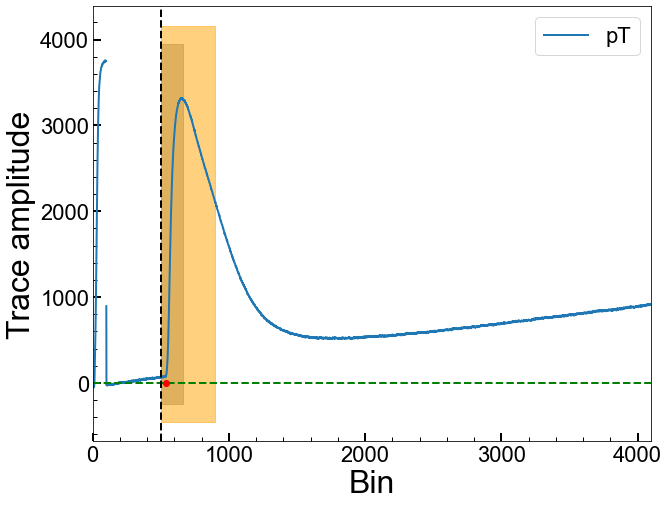

Series Number: 72209171225
Event Number: 3490454
Energy: 44.70618161179 keV
Area: -4827545.259745271


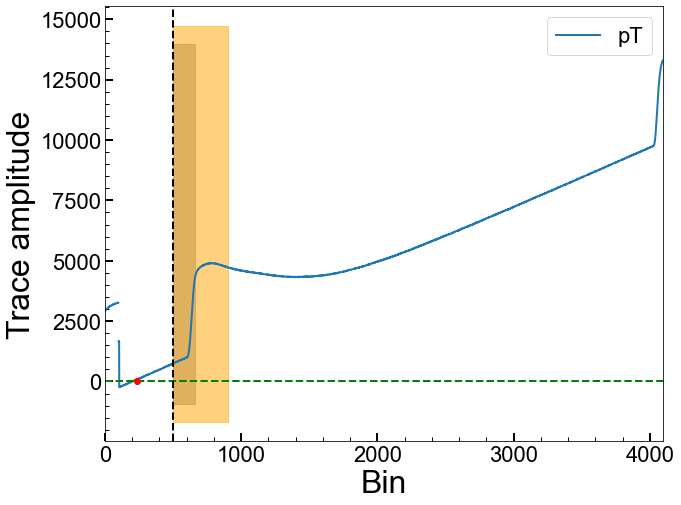

Series Number: 72209171225
Event Number: 3490810
Energy: 45.07092303122 keV
Area: -957999.2301141614


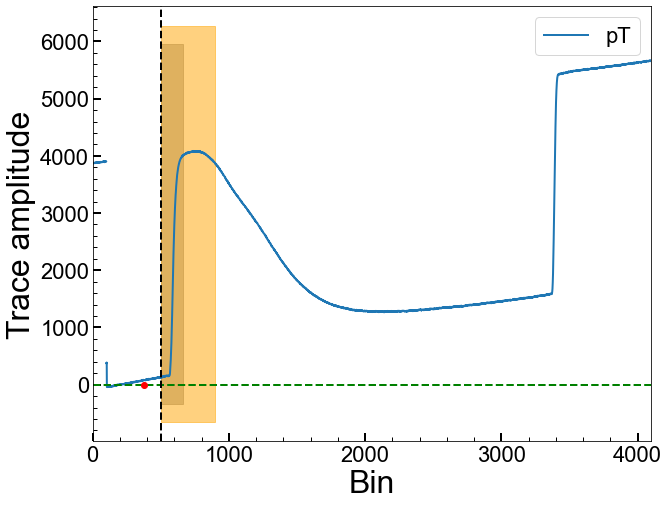

Series Number: 72209171225
Event Number: 3500068
Energy: 5.999865360979 keV
Area: -3962289.556104346


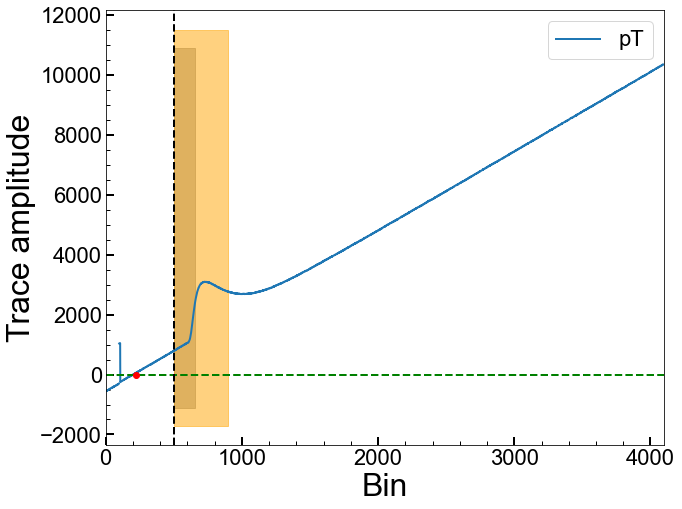

Series Number: 72209171225
Event Number: 3550200
Energy: 22.14397424006 keV
Area: 50978.97946931567


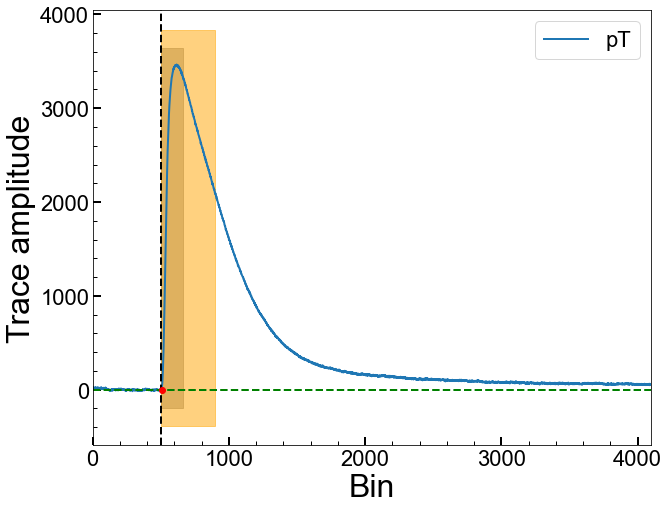

Series Number: 72209171225
Event Number: 3570765
Energy: 30.31393605443 keV
Area: 489333.27430671273


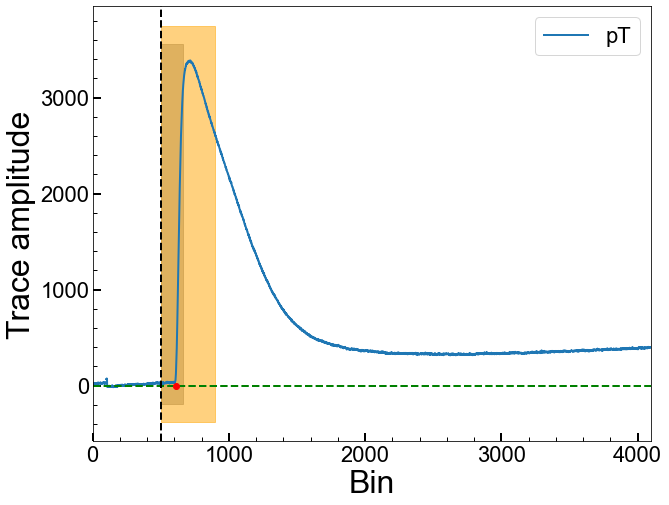

Series Number: 72209171225
Event Number: 3570827
Energy: 13.45301763915 keV
Area: 167940.82110557889


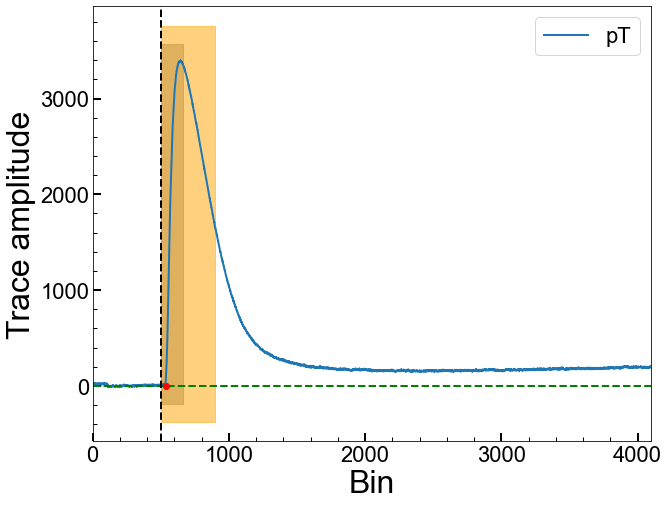

Series Number: 72209171225
Event Number: 3590120
Energy: 27.61119421233 keV
Area: 281274.1655761589


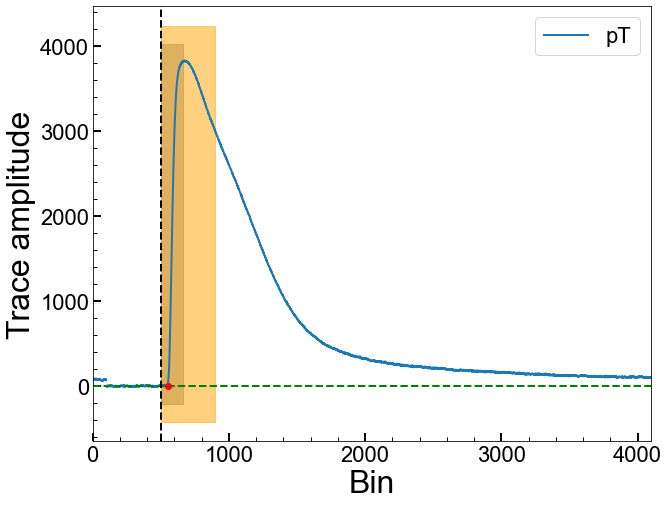

Series Number: 72209171225
Event Number: 3590722
Energy: 34.16357409052 keV
Area: 606188.4213140835


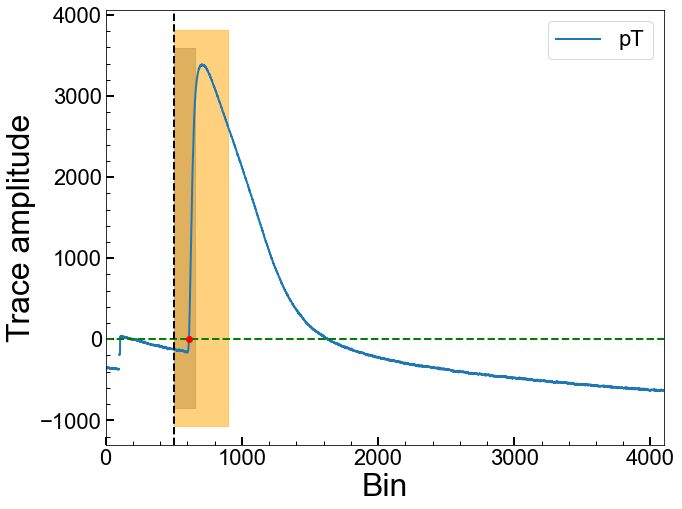

Series Number: 72209171225
Event Number: 3640268
Energy: 35.00555607377 keV
Area: 742150.5197453189


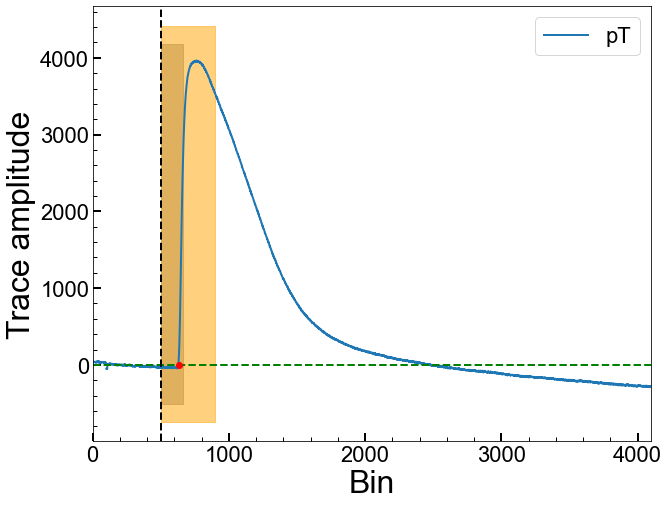

Series Number: 72209171225
Event Number: 3640865
Energy: 18.70251499347 keV
Area: 63558.313488363805


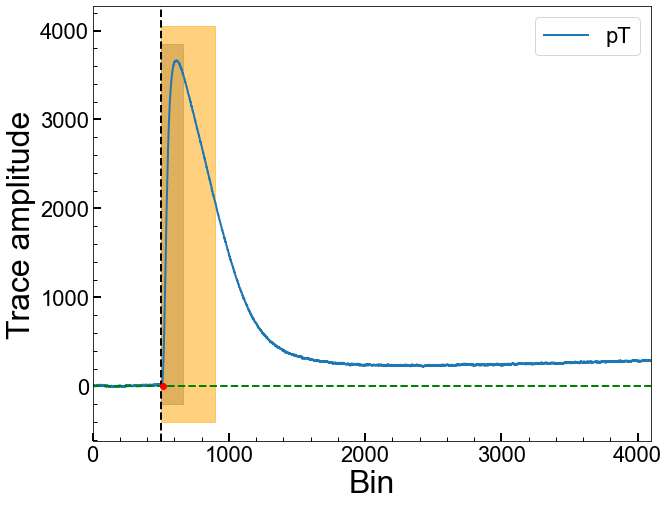

Series Number: 72209171225
Event Number: 3650046
Energy: 28.81445398995 keV
Area: 592535.4507619416


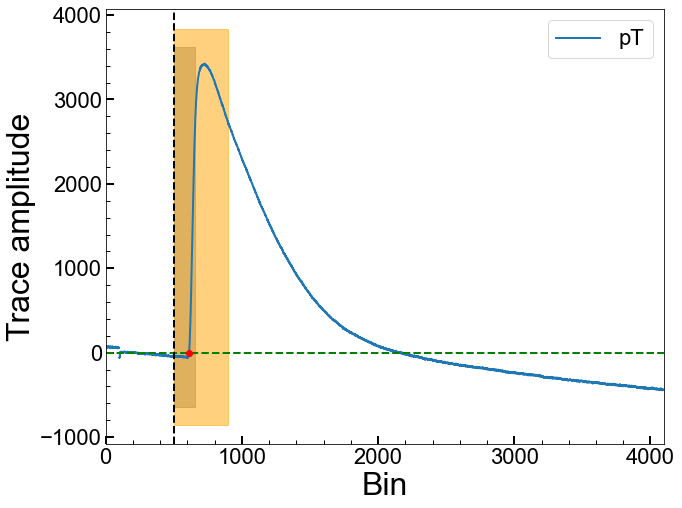

Series Number: 72209171225
Event Number: 3650058
Energy: 27.08455444203 keV
Area: 115430.17287417216


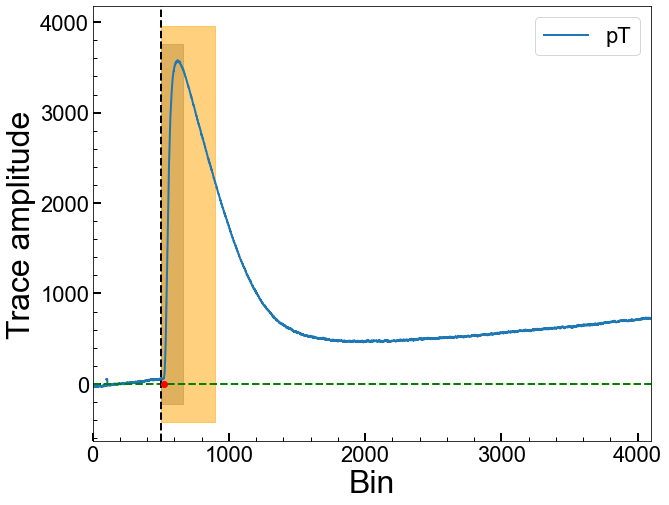

Series Number: 72209171225
Event Number: 3650681
Energy: 16.05591007356 keV
Area: 546306.9714934753


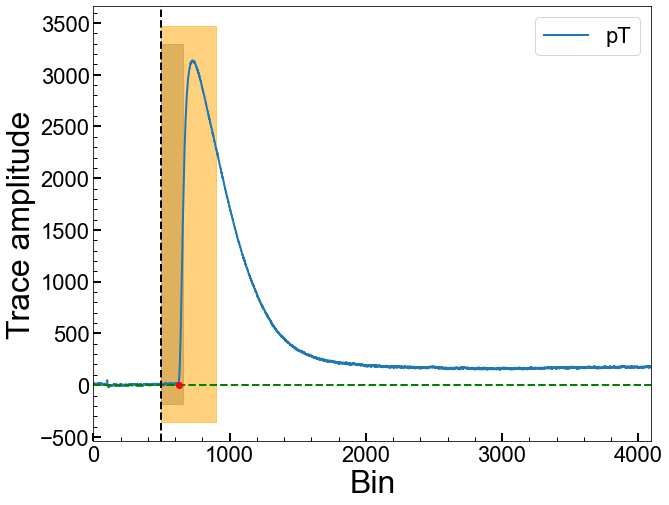

Series Number: 72209171225
Event Number: 3660735
Energy: 12.22280153597 keV
Area: 303257.72209016676


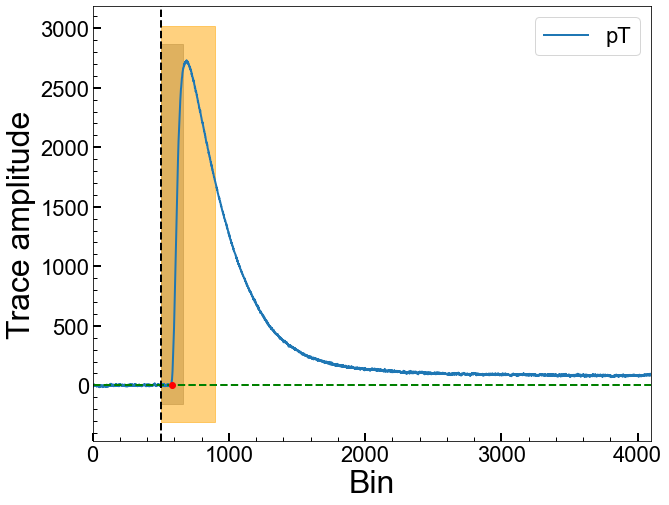

Series Number: 72209171225
Event Number: 3710305
Energy: 37.15443601654 keV
Area: 125086.82520864287


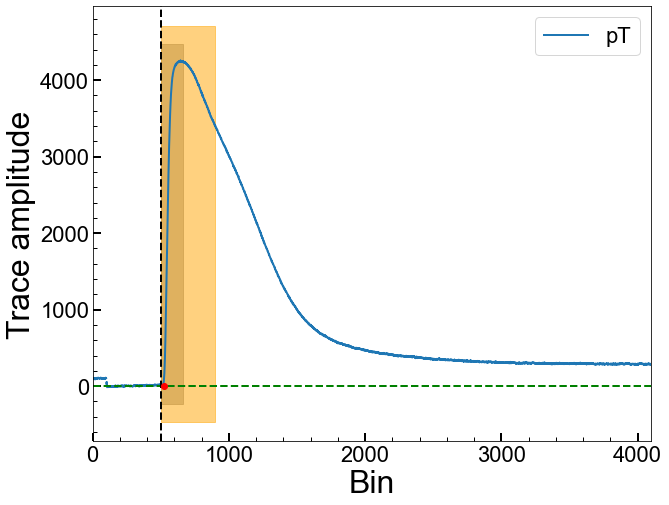

Series Number: 72209171225
Event Number: 3730333
Energy: 19.80474901326 keV
Area: 232832.90575827277


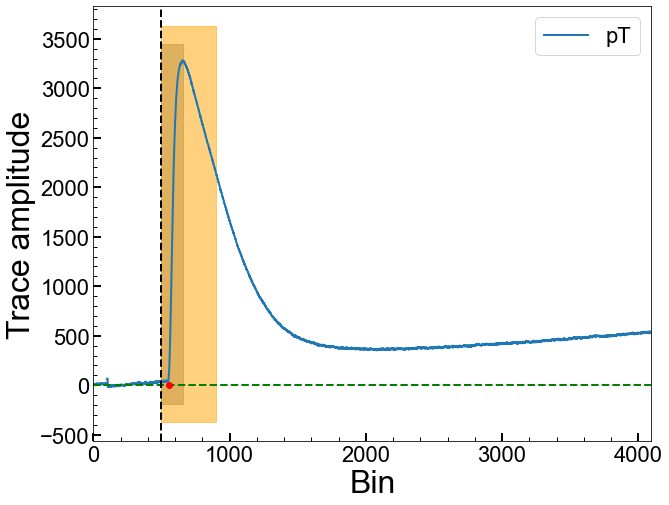

Series Number: 72209171225
Event Number: 3740347
Energy: 6.119056310427 keV
Area: 203210.91910951008


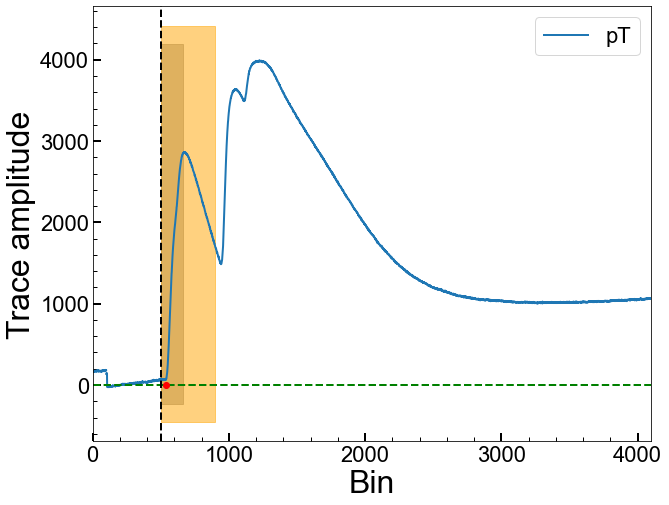

Series Number: 72209171225
Event Number: 3760021
Energy: 13.33702154029 keV
Area: 499400.51683546137


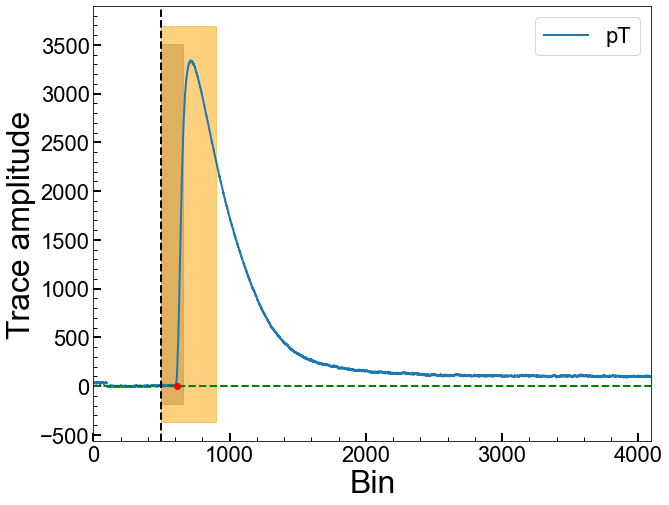

Series Number: 72209171225
Event Number: 3760085
Energy: 2.055138050296 keV
Area: 32425.129527417186


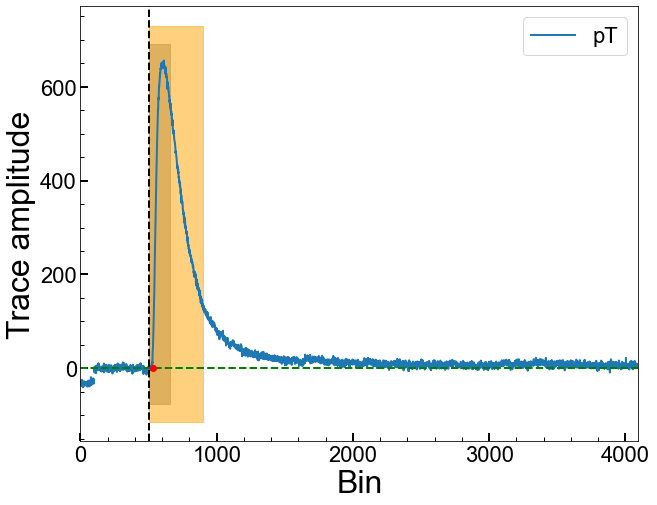

Series Number: 72209171225
Event Number: 3760664
Energy: 49.79306172234 keV
Area: 281767.5662818756


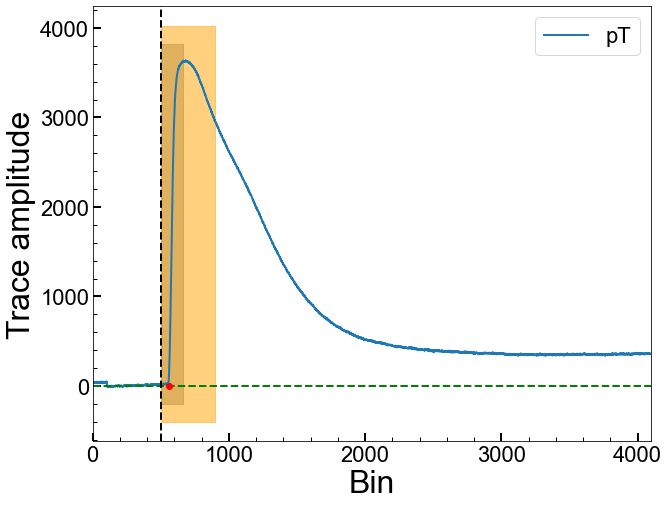

Series Number: 72209171225
Event Number: 3770152
Energy: 43.96199542045 keV
Area: 283772.95535920555


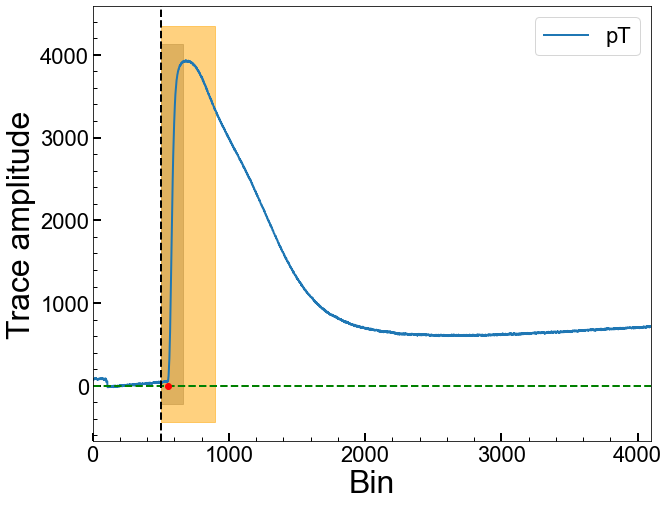

Series Number: 72209171225
Event Number: 3780179
Energy: 38.65723324875 keV
Area: 608432.6946515639


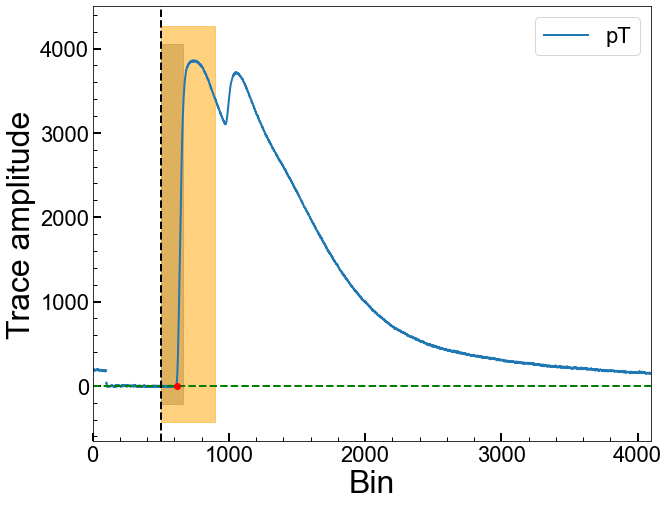

Series Number: 72209171225
Event Number: 3780224
Energy: 5.593745327656 keV
Area: 296289.6766654737


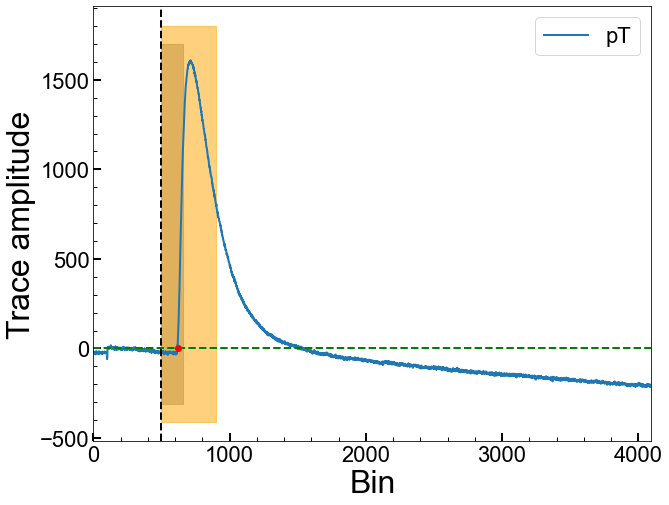

Series Number: 72209171225
Event Number: 3780935
Energy: 38.99365027936 keV
Area: 825564.7334354918


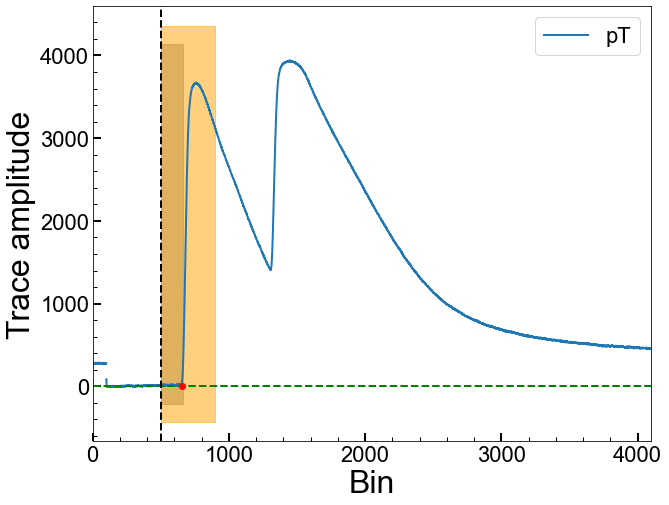

Series Number: 72209171225
Event Number: 3790234
Energy: 13.90542926961 keV
Area: 421925.9429497694


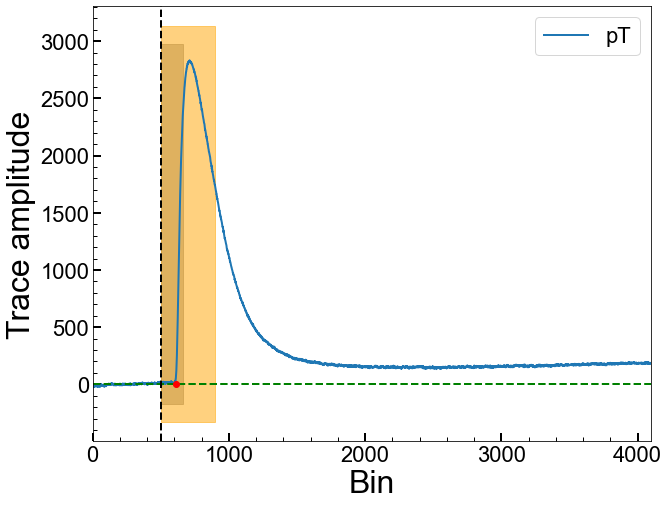

Series Number: 72209171225
Event Number: 3790415
Energy: 46.66369486096 keV
Area: 112042.17720004238


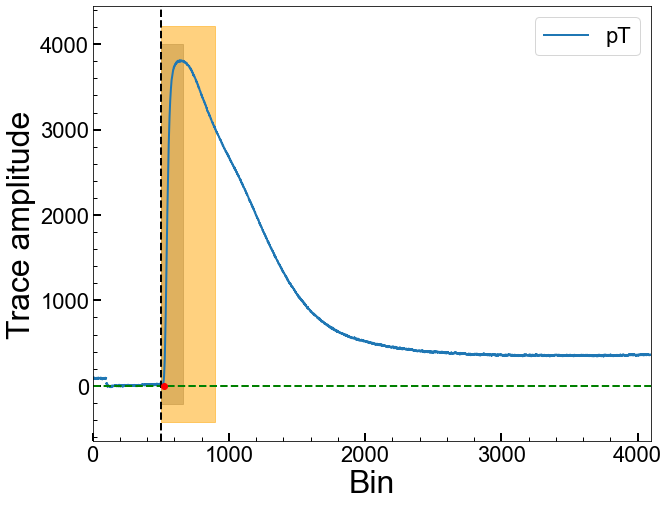

Series Number: 72209171225
Event Number: 3800031
Energy: 7.678581796591 keV
Area: 317541.2090332009


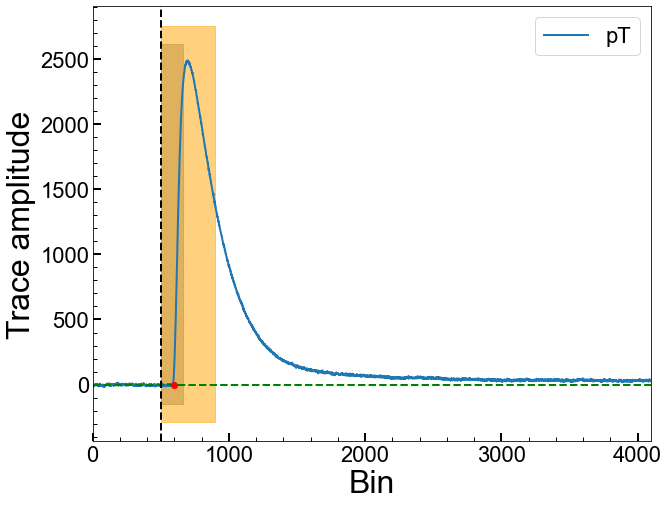

Series Number: 72209171225
Event Number: 3800257
Energy: 19.92130821241 keV
Area: 625924.1853524682


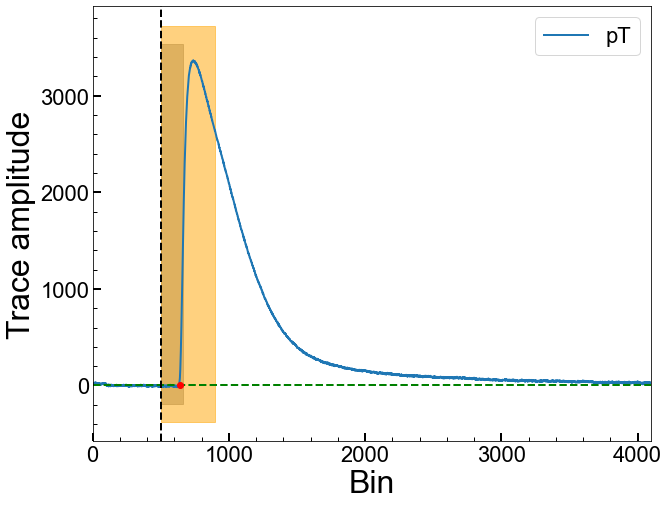

Series Number: 72209171225
Event Number: 3830371
Energy: 47.60067633863 keV
Area: 517713.4324269774


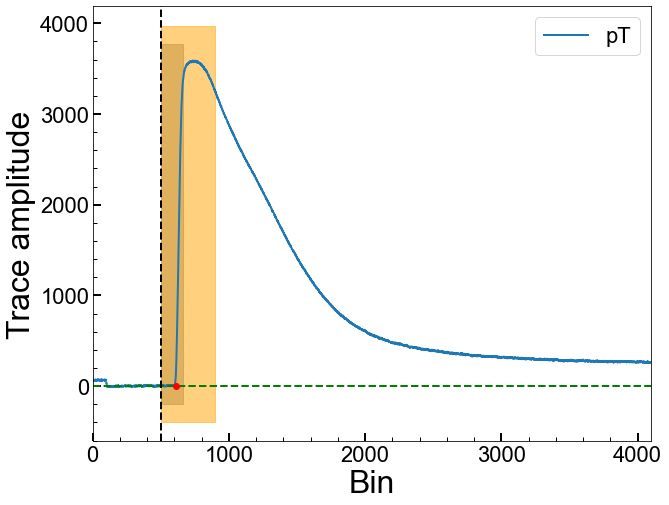

Series Number: 72209171225
Event Number: 3840533
Energy: 38.67774402173 keV
Area: -258321.61785515232


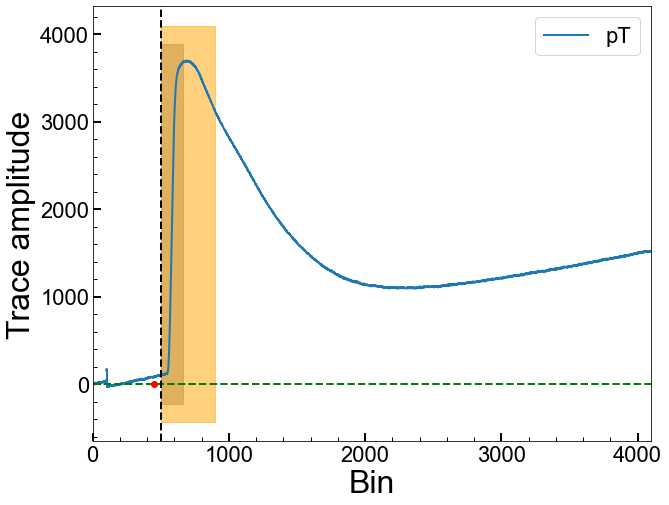

Series Number: 72209171225
Event Number: 3860027
Energy: 10.37153152173 keV
Area: -665305.805456964


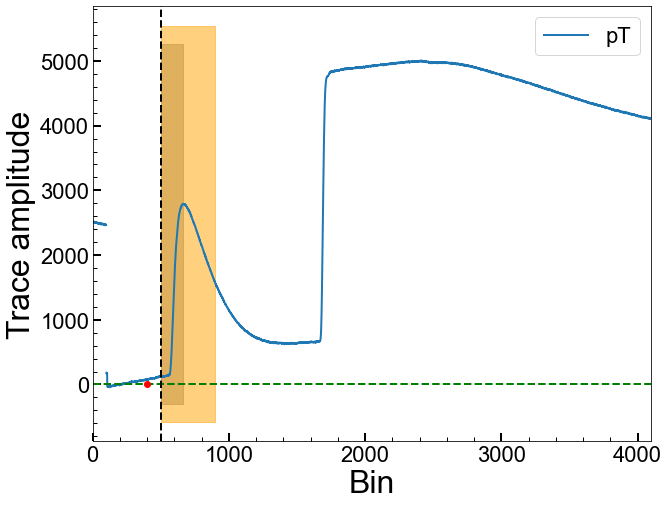

Series Number: 72209171225
Event Number: 3870123
Energy: 12.68021970752 keV
Area: 535645.1384956843


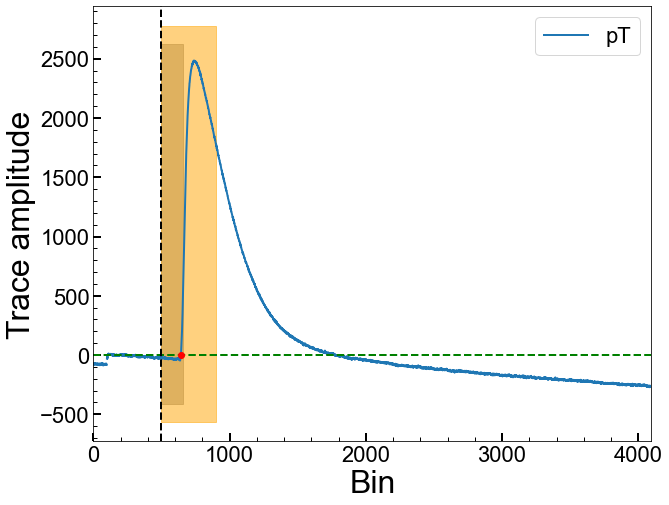

Series Number: 72209171225
Event Number: 3890284
Energy: 12.04937748713 keV
Area: 383414.34879247646


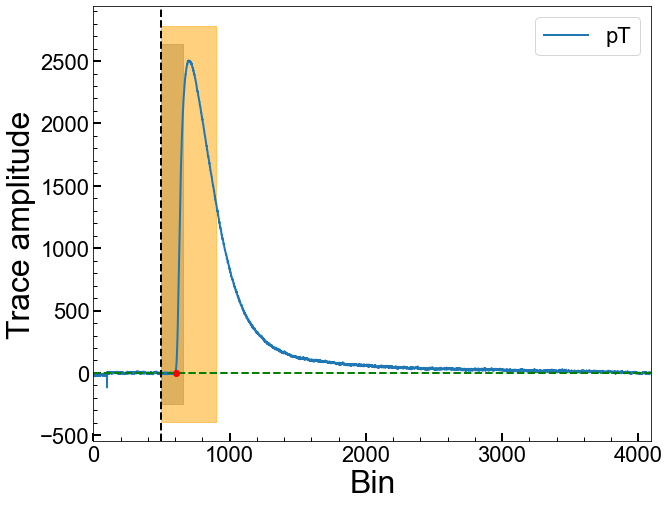

Series Number: 72209171225
Event Number: 3890471
Energy: 12.53432834998 keV
Area: 42240.78072667552


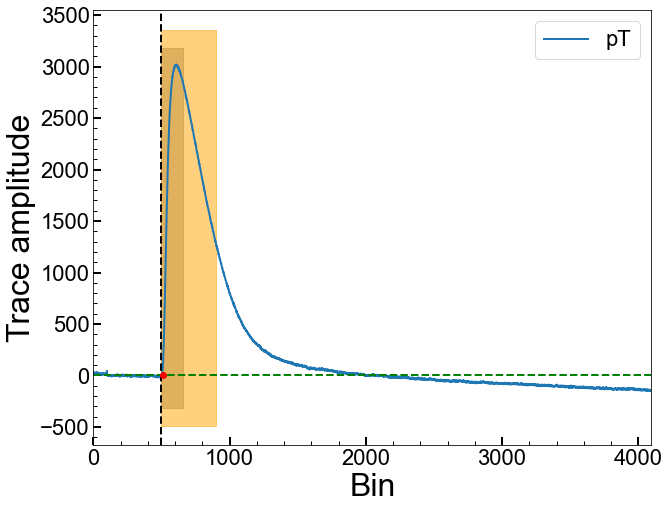

Series Number: 72209171225
Event Number: 3900015
Energy: 12.94509880544 keV
Area: 571187.5199206145


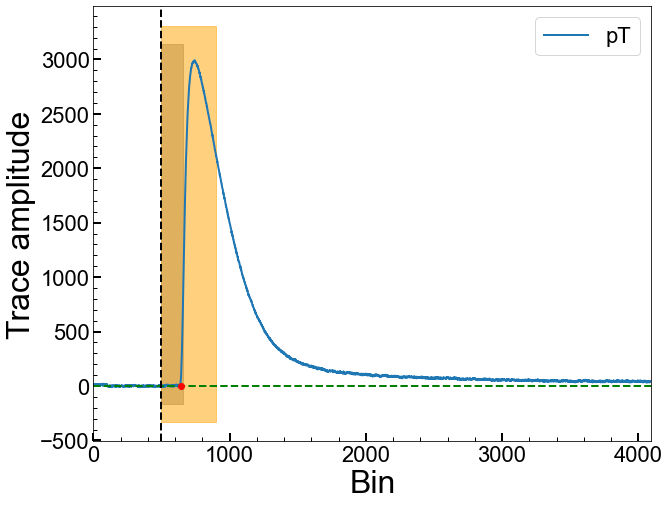

Series Number: 72209171225
Event Number: 3900030
Energy: 46.35047573812 keV
Area: 755401.8814279208


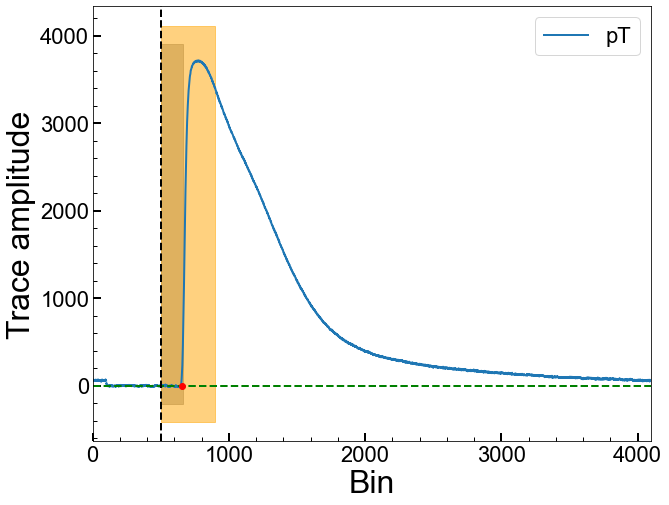

Series Number: 72209171225
Event Number: 3900102
Energy: 9.830742292415 keV
Area: 239902.70959885587


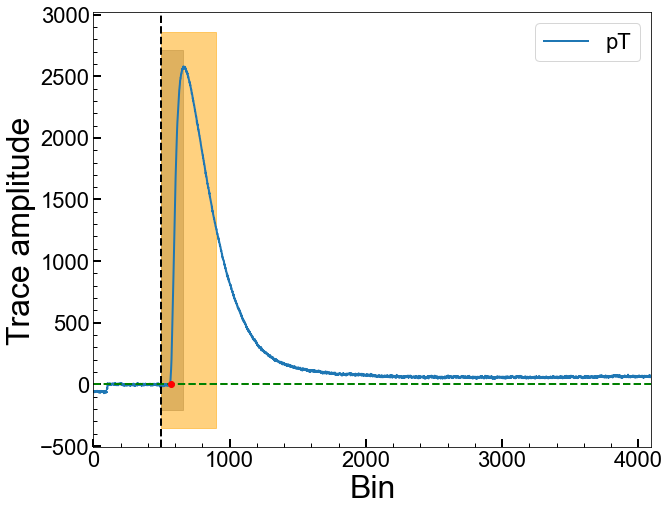

Series Number: 72209171225
Event Number: 3920450
Energy: 39.30297202985 keV
Area: 279358.07443002216


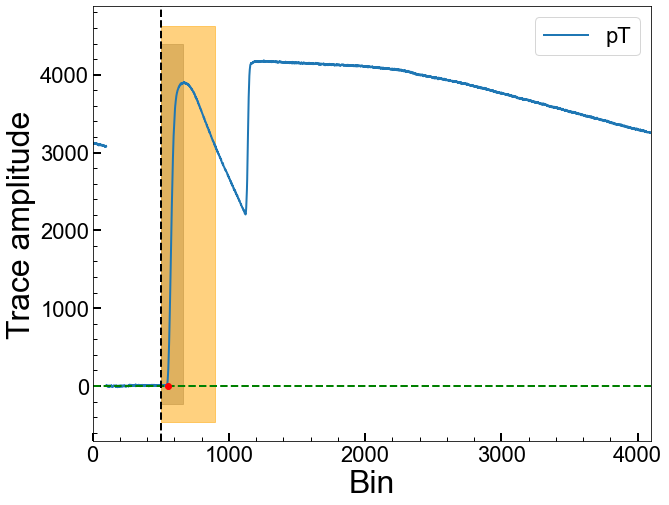

Series Number: 72209171225
Event Number: 3920625
Energy: 37.2055632123 keV
Area: 72189.42714253775


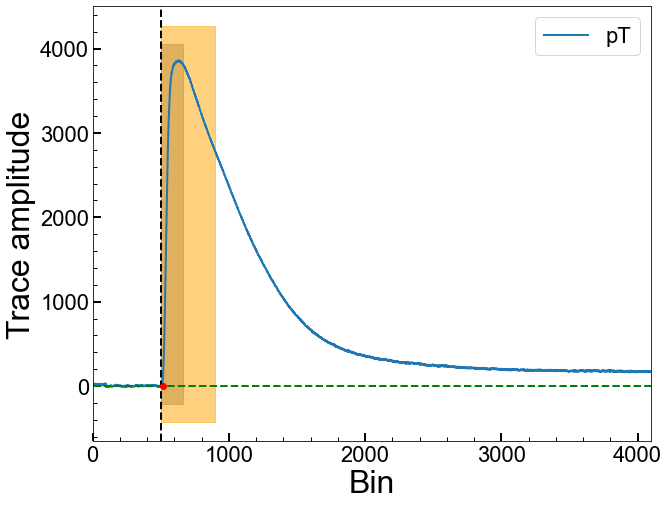

Series Number: 72209171225
Event Number: 3960112
Energy: 37.90140509621 keV
Area: 53223.49268061457


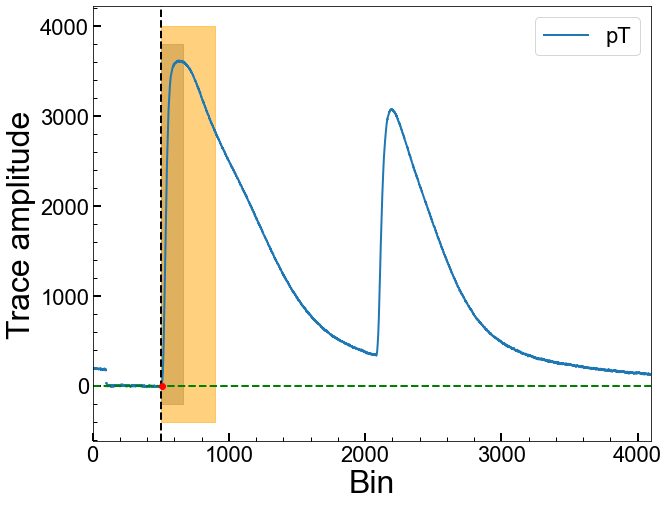

Series Number: 72209171225
Event Number: 3990012
Energy: 26.2764461608 keV
Area: 563361.3969703879


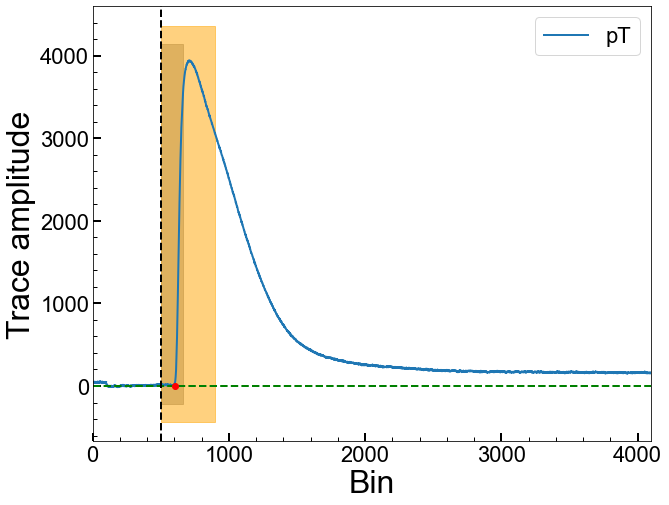

Series Number: 72209171225
Event Number: 3990680
Energy: 26.42245544257 keV
Area: 660857.0855692715


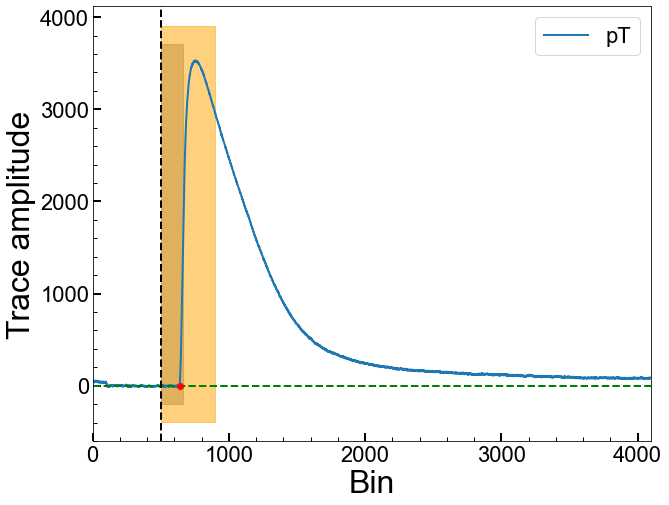

Series Number: 72209171225
Event Number: 4000126
Energy: 9.906829503079 keV
Area: 31537.356730203977


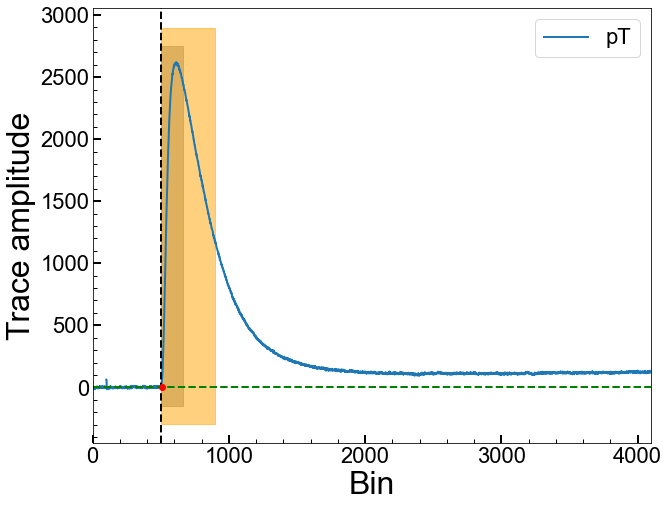

Series Number: 72209171225
Event Number: 4000613
Energy: 12.64803282964 keV
Area: 328207.131920742


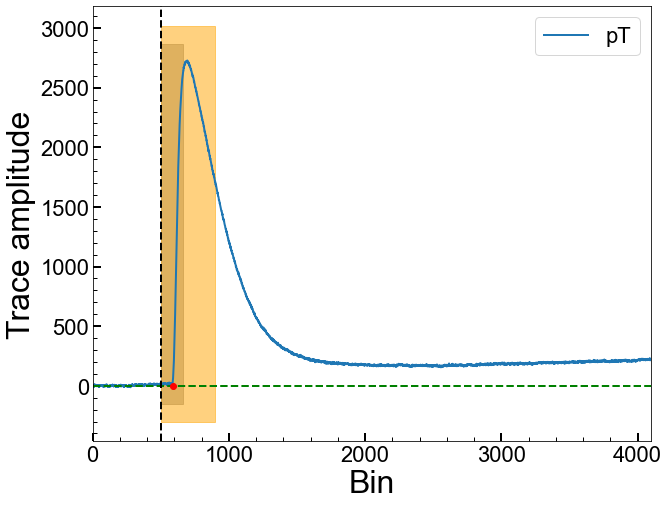

Series Number: 72209171225
Event Number: 4000878
Energy: 4.994224943423 keV
Area: 249652.106845421


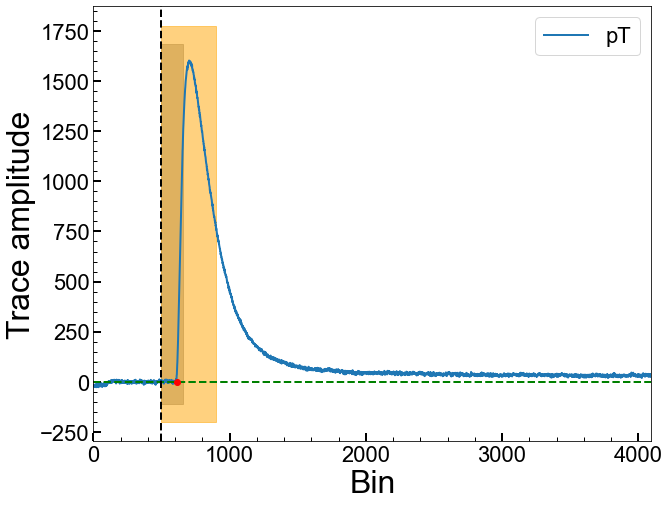

Series Number: 72209171225
Event Number: 4020380
Energy: 40.64733833431 keV
Area: 257924.0674179251


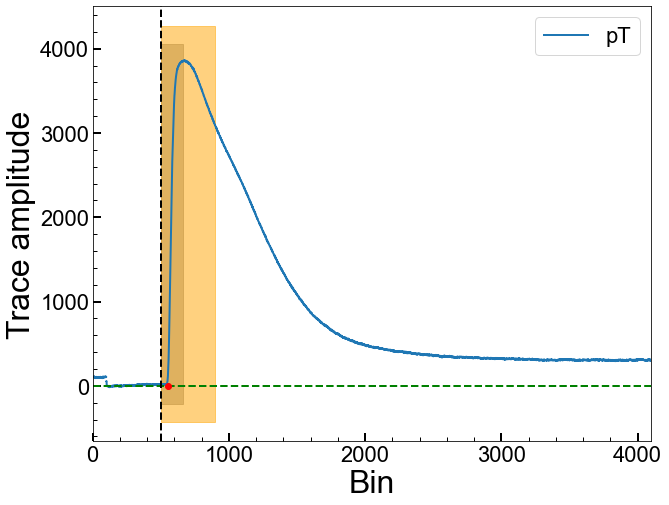

Series Number: 72209171225
Event Number: 4040458
Energy: 41.19067776263 keV
Area: 265994.1170415894


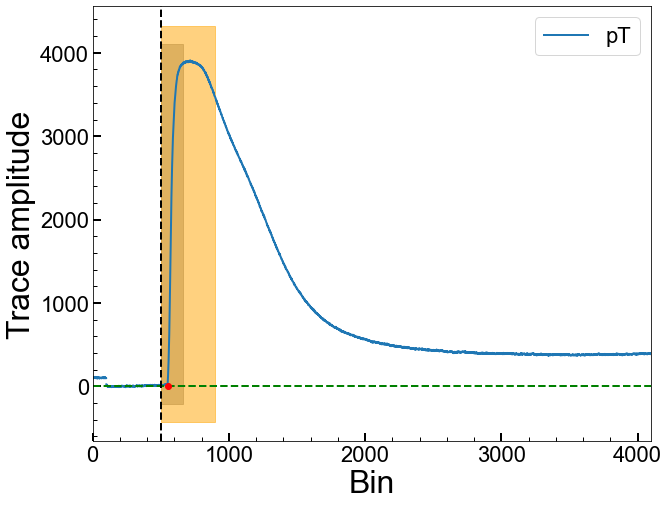

Series Number: 72209171225
Event Number: 4060706
Energy: 19.39987859432 keV
Area: 418839.29848849925


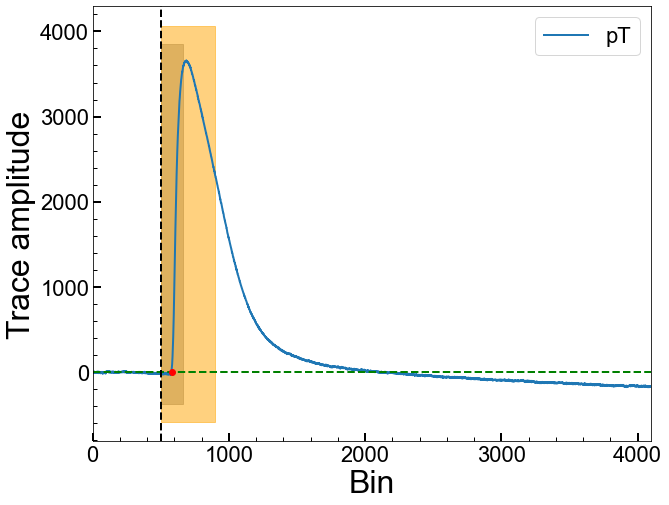

Series Number: 72209171225
Event Number: 4070299
Energy: 39.27895960742 keV
Area: 521368.4407056955


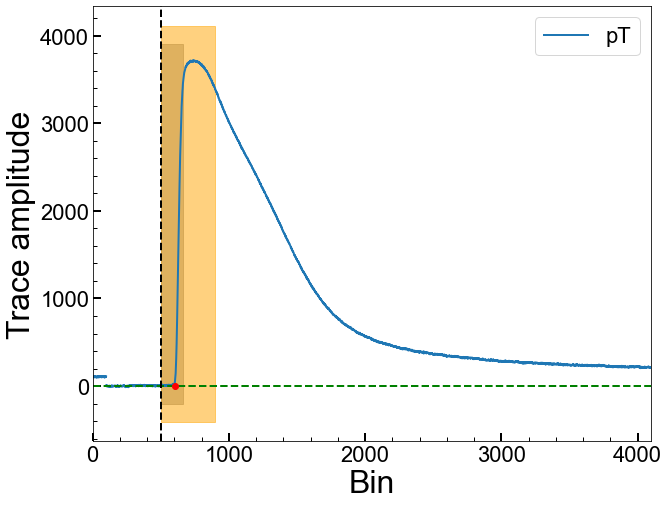

Series Number: 72209171225
Event Number: 4070386
Energy: 24.59610202459 keV
Area: 550016.5532073642


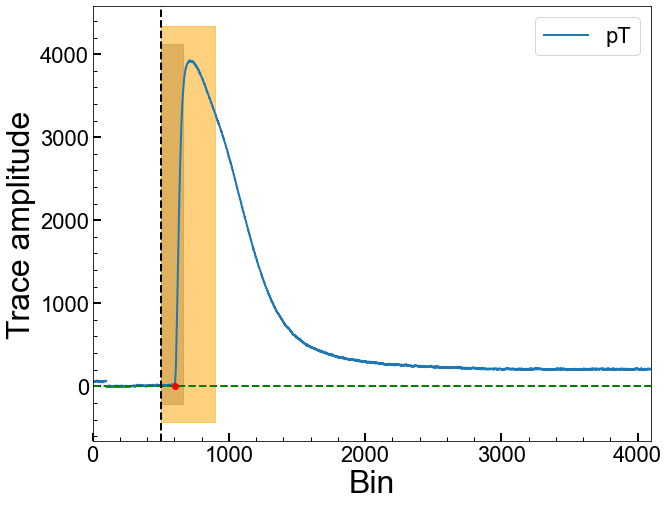

Series Number: 72209171225
Event Number: 4080643
Energy: 49.10331614283 keV
Area: 467189.0391600814


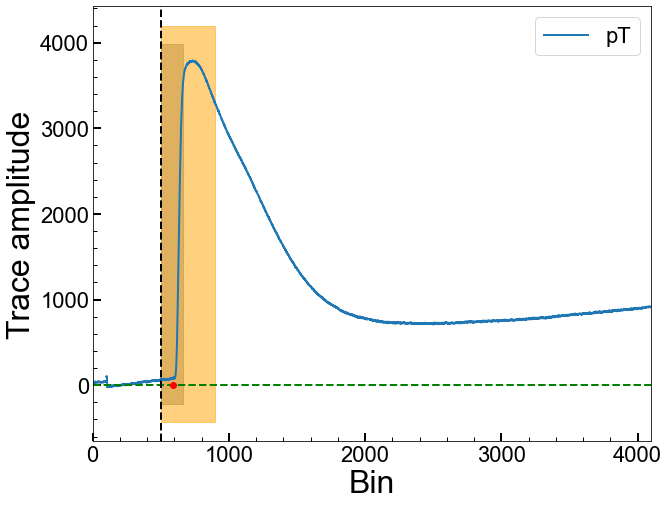

Series Number: 72209171225
Event Number: 4110635
Energy: 14.10738095208 keV
Area: 324757.26373201923


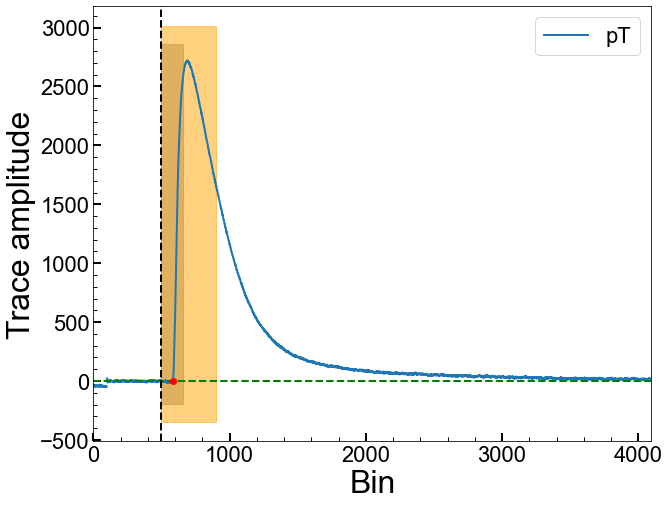

Series Number: 72209171225
Event Number: 4120492
Energy: 12.72471787313 keV
Area: 432328.40642331104


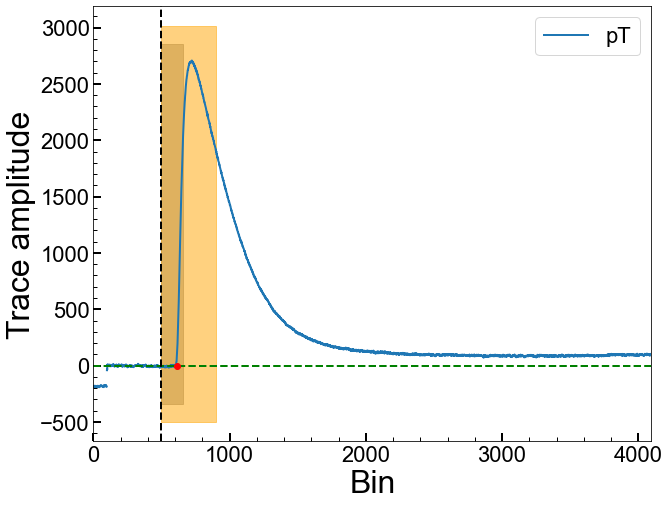

Series Number: 72209171225
Event Number: 4120541
Energy: 18.61457490829 keV
Area: -237520.22388626283


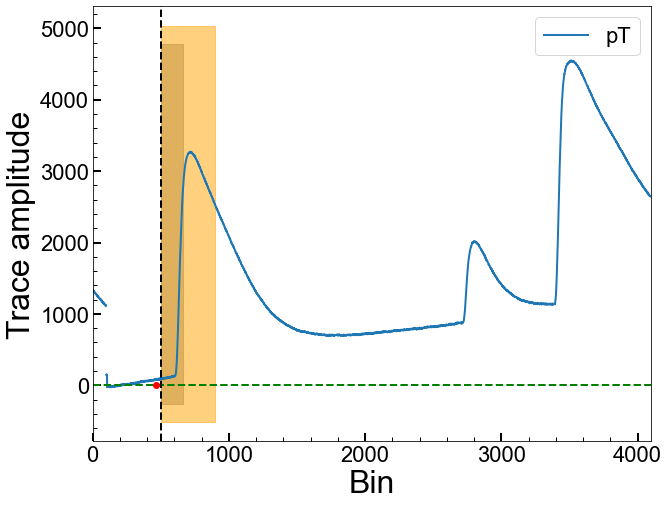

Series Number: 72209171225
Event Number: 4120723
Energy: 31.78077121466 keV
Area: -3999729.823989615


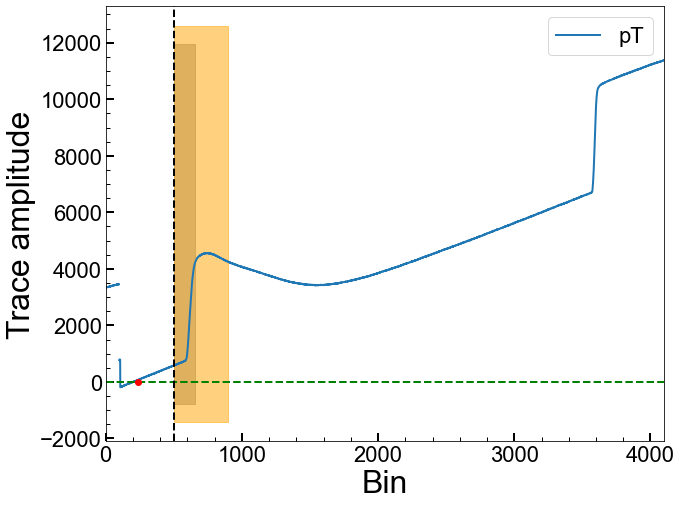

Series Number: 72209171225
Event Number: 4140559
Energy: 3.751158755688 keV
Area: 147475.06155060785


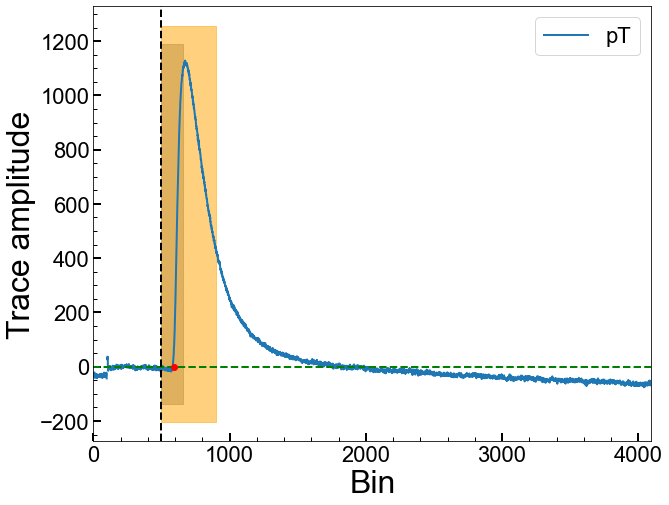

Series Number: 72209171225
Event Number: 4160759
Energy: 21.01792225425 keV
Area: 500389.60631169996


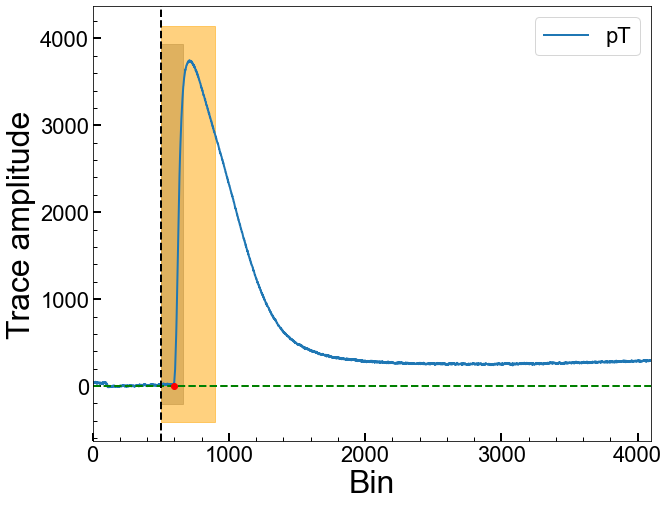

Series Number: 72209171225
Event Number: 4170212
Energy: 31.40739995504 keV
Area: 537576.292671656


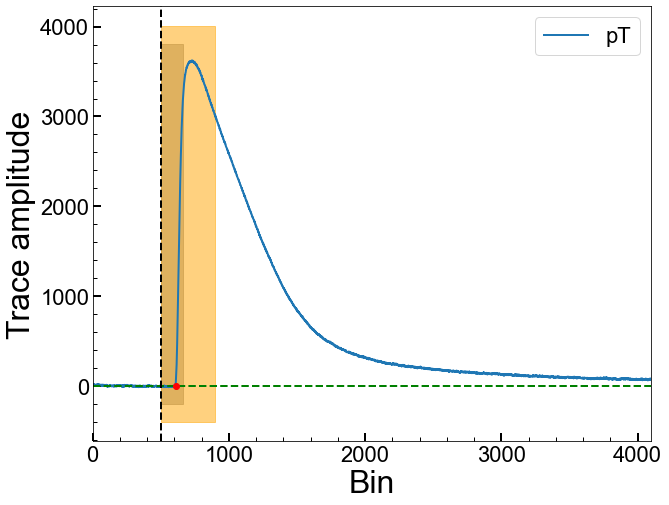

Series Number: 72209171225
Event Number: 4170505
Energy: 16.62157255231 keV
Area: 539002.8077820047


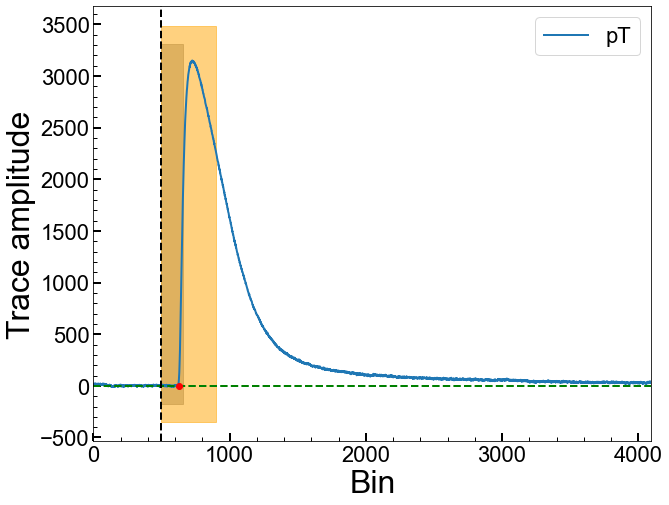

Series Number: 72209171225
Event Number: 4190434
Energy: 17.45365528034 keV
Area: 516709.8392182674


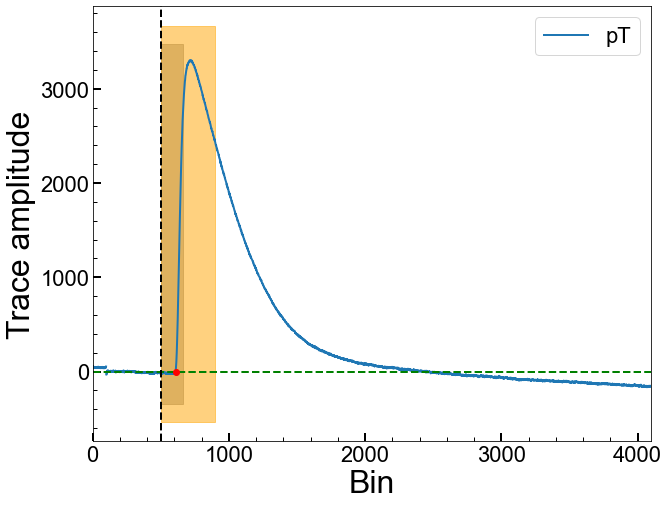

Series Number: 72209171225
Event Number: 4200354
Energy: 13.37977552974 keV
Area: 53339.56226471349


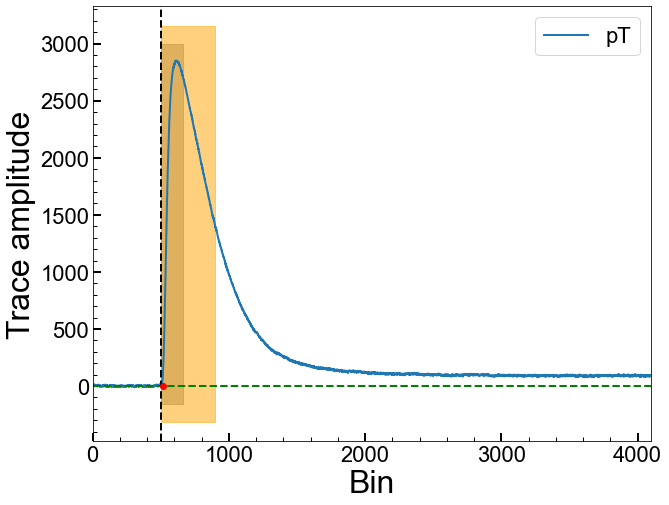

Series Number: 72209171225
Event Number: 4200465
Energy: 17.26173736883 keV
Area: -4285096.617883344


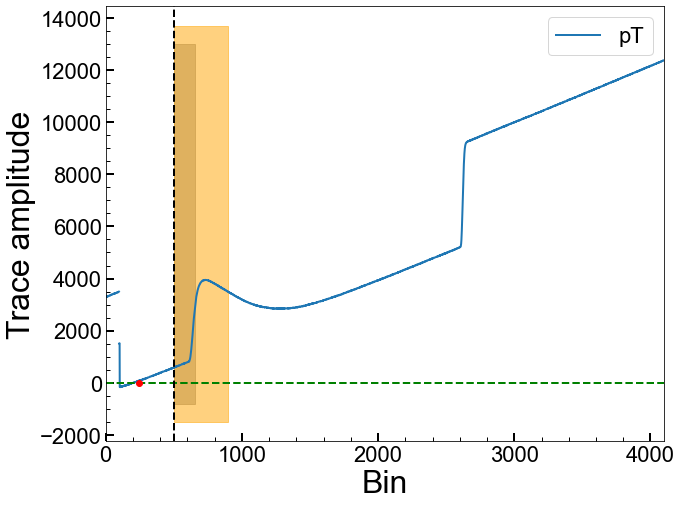

Series Number: 72209171225
Event Number: 4200678
Energy: 10.48482448679 keV
Area: 119588.55732810595


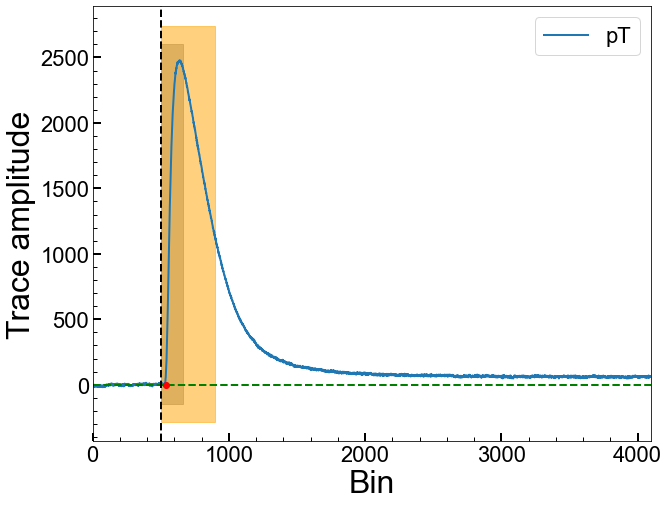

Series Number: 72209171225
Event Number: 4240541
Energy: 20.72904249356 keV
Area: 524226.44106491155


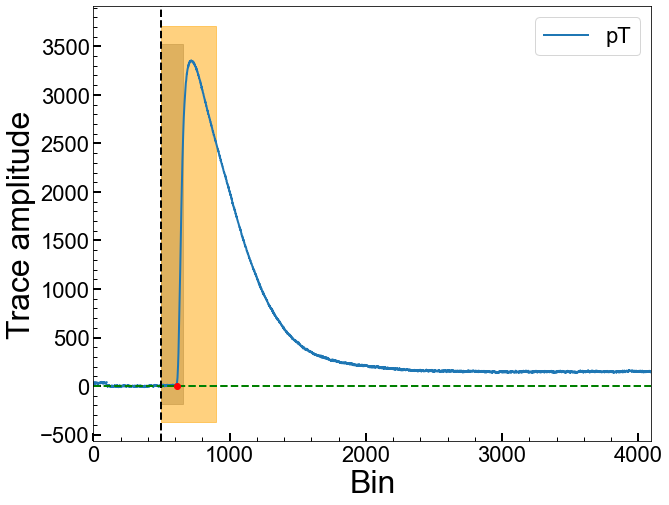

Series Number: 72209171225
Event Number: 4270198
Energy: 39.8645933752 keV
Area: 202018.67095508357


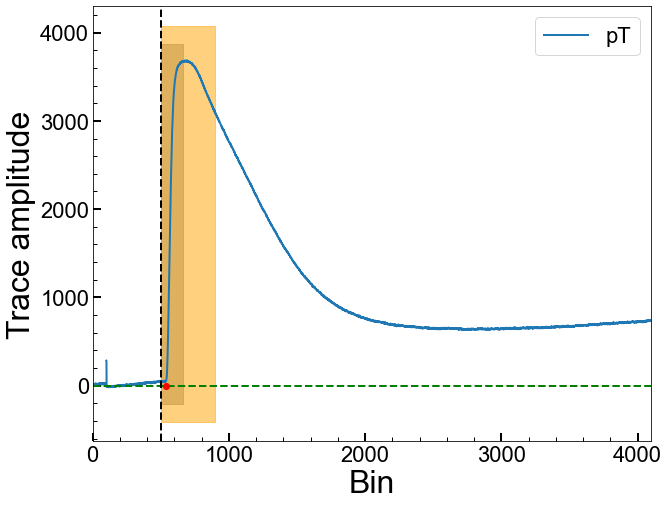

Series Number: 72209171225
Event Number: 4280902
Energy: 31.4817415812 keV
Area: 536868.3667028875


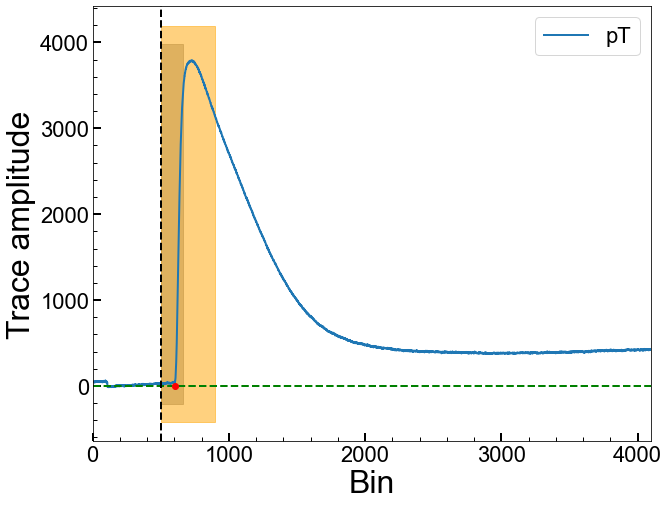

Series Number: 72209171225
Event Number: 4300381
Energy: 15.84258291707 keV
Area: 574306.1258864468


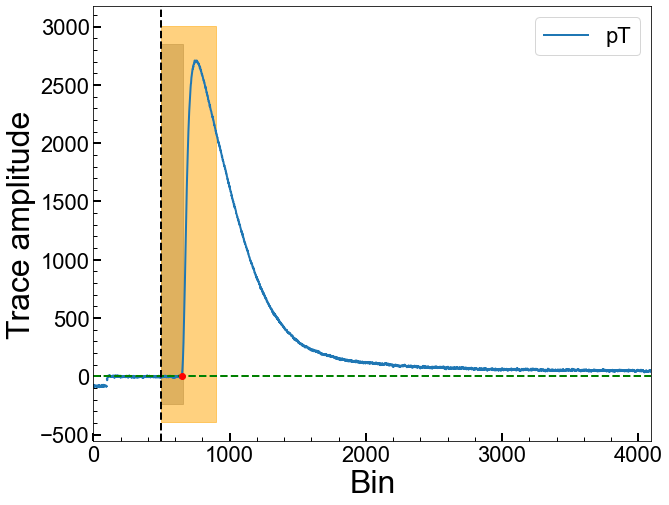

Series Number: 72209171225
Event Number: 4300405
Energy: 39.13542782909 keV
Area: 642724.2532928743


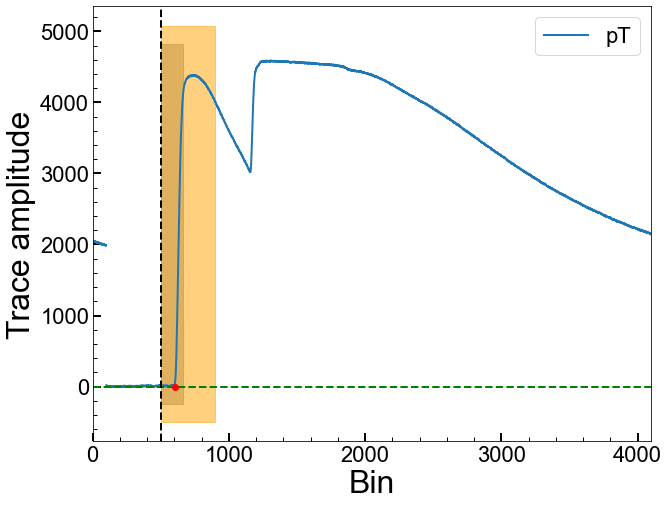

Series Number: 72209171225
Event Number: 4310034
Energy: 48.5504466119 keV
Area: 626742.6336358148


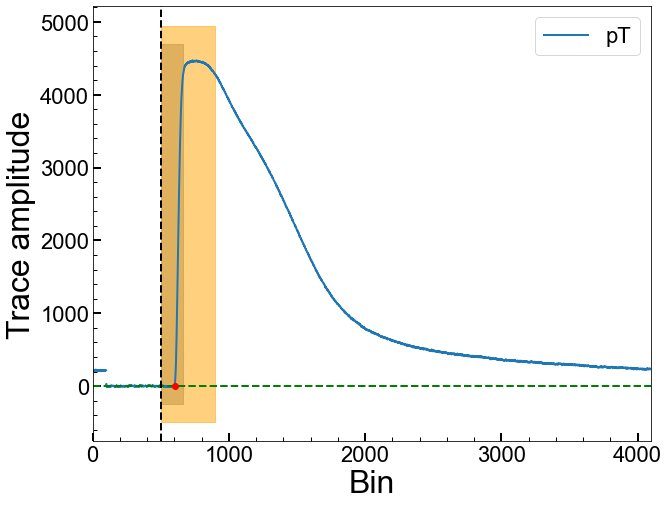

Series Number: 72209171225
Event Number: 4320878
Energy: 45.19280980088 keV
Area: -1358017.7991350167


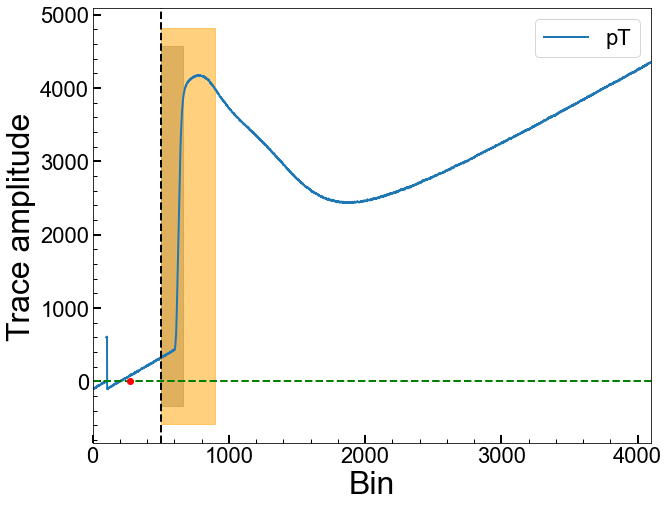

Series Number: 72209171225
Event Number: 4320938
Energy: 19.85765729881 keV
Area: 483722.67829541734


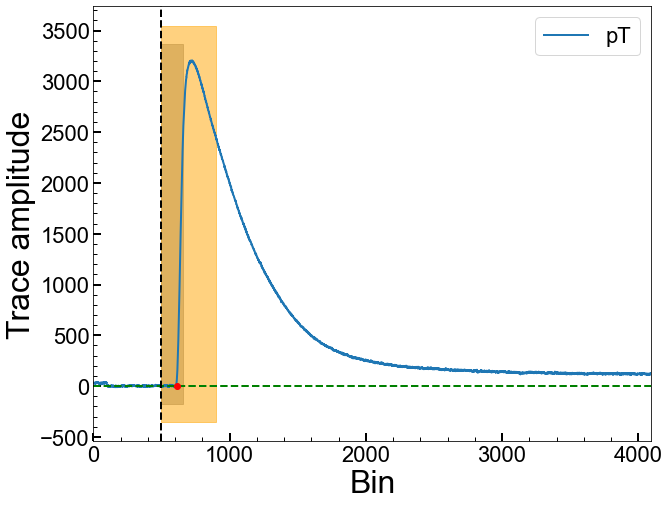

Series Number: 72209171225
Event Number: 4340135
Energy: 31.25181001651 keV
Area: 66626.62060573595


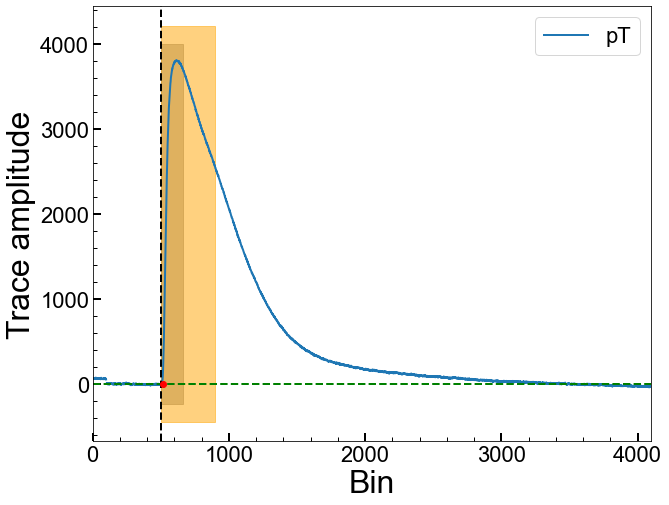

Series Number: 72209171225
Event Number: 4340365
Energy: 3.368343296542 keV
Area: 211000.12900717455


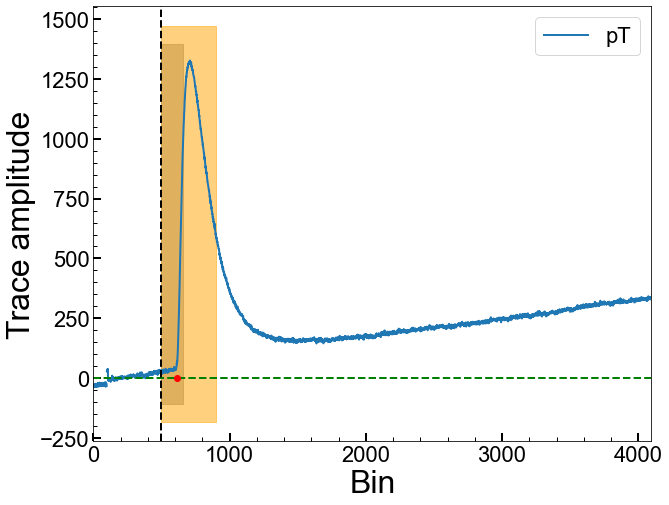

Series Number: 72209171225
Event Number: 4340394
Energy: 11.10919662303 keV
Area: 380170.3197337748


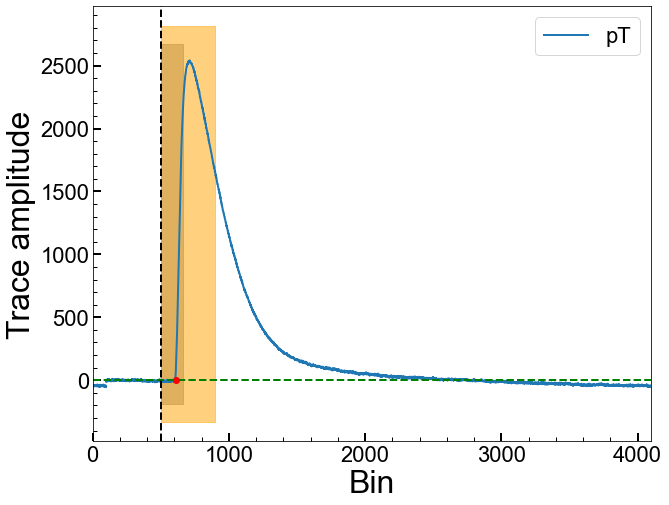

Series Number: 72209171225
Event Number: 4360412
Energy: 40.30914213745 keV
Area: 322862.00713494053


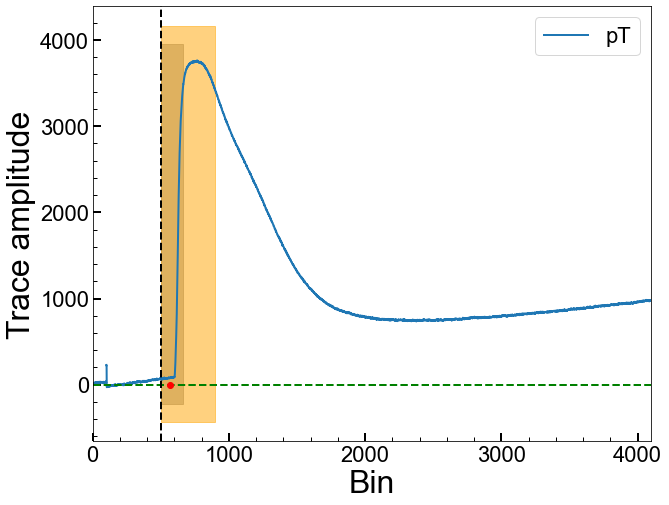

Series Number: 72209171225
Event Number: 4380349
Energy: 37.0822825079 keV
Area: 447474.0385830146


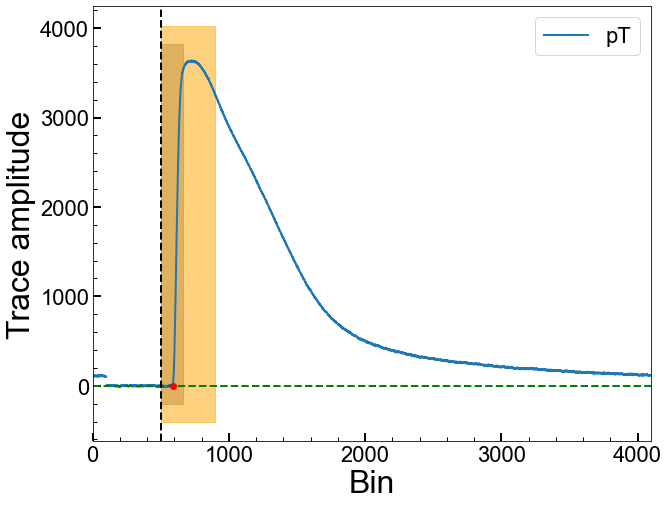

Series Number: 72209171225
Event Number: 4390192
Energy: 39.9012270286 keV
Area: -1044845.0971998805


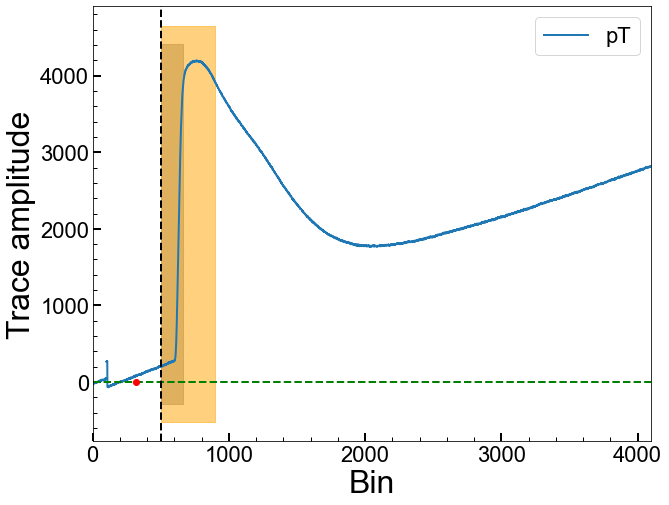

Series Number: 72209171225
Event Number: 4410862
Energy: 9.693857525072 keV
Area: 211911.50592410075


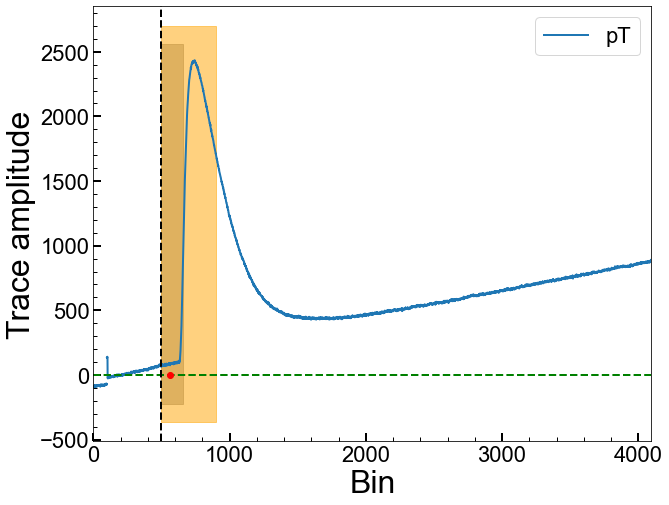

Series Number: 72209171225
Event Number: 4430117
Energy: 10.8494203189 keV
Area: 474448.0316673904


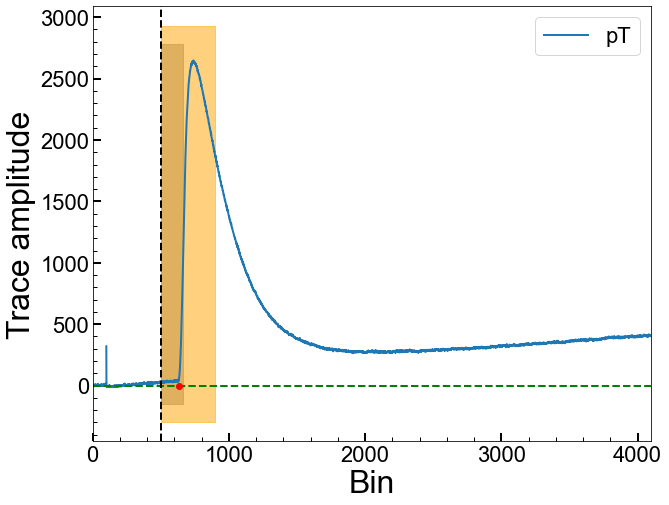

Series Number: 72209171225
Event Number: 4430583
Energy: 36.63501922374 keV
Area: 787129.7665500998


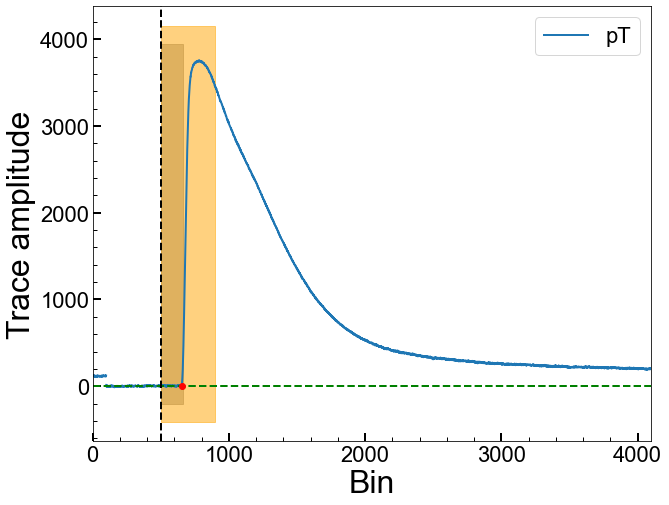

Series Number: 72209171225
Event Number: 4430598
Energy: 28.0940544903 keV
Area: 263951.91584439395


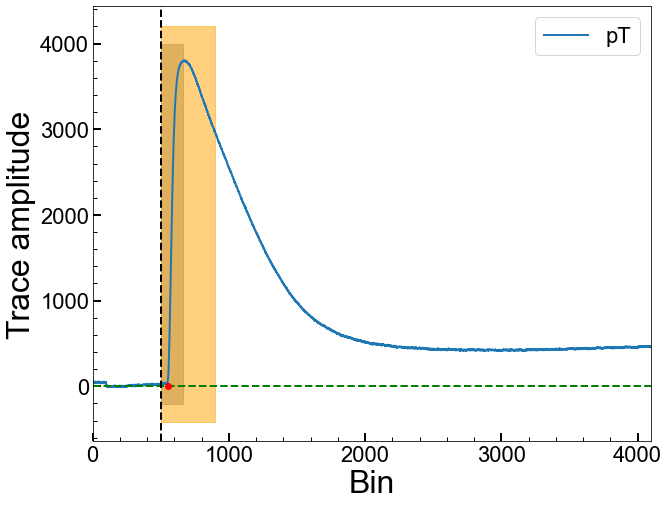

Series Number: 72209171225
Event Number: 4520828
Energy: 47.22054811409 keV
Area: 739537.4503915939


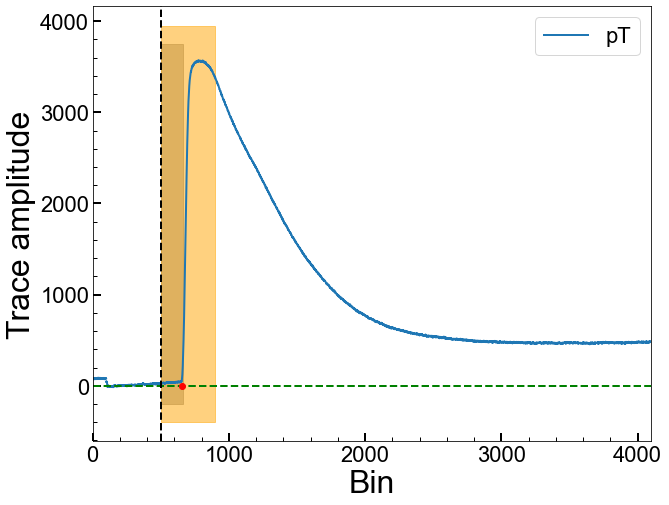

Series Number: 72209171225
Event Number: 4530554
Energy: 34.77509950302 keV
Area: 523753.83160873665


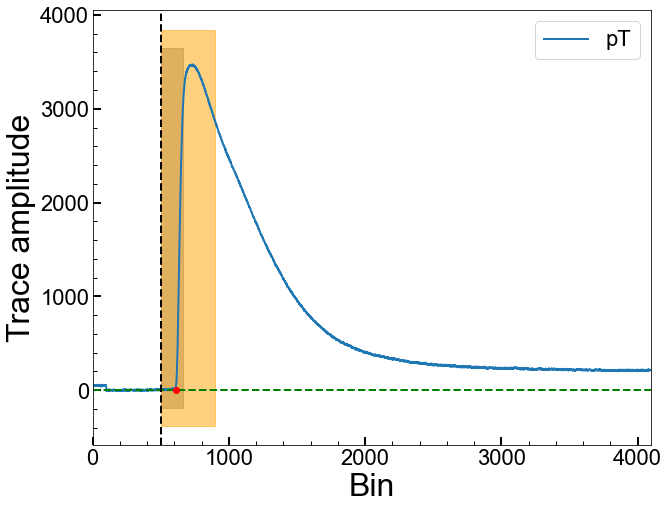

Series Number: 72209171225
Event Number: 4530869
Energy: 41.68497195519 keV
Area: 259509.47940026486


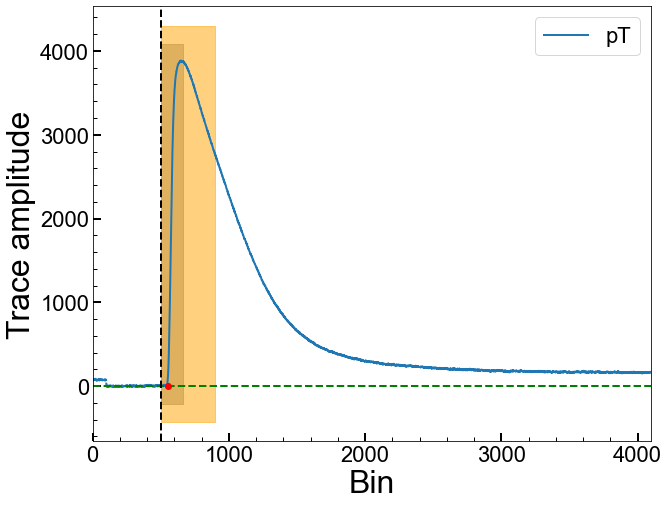

Series Number: 72209171225
Event Number: 4550184
Energy: 13.57165349033 keV
Area: 588033.0372929554


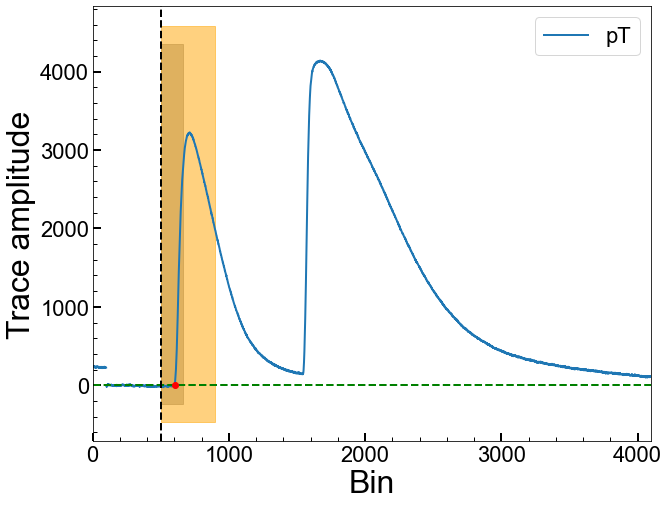

Series Number: 72209171225
Event Number: 4590651
Energy: 47.80275980672 keV
Area: 87276.03759337749


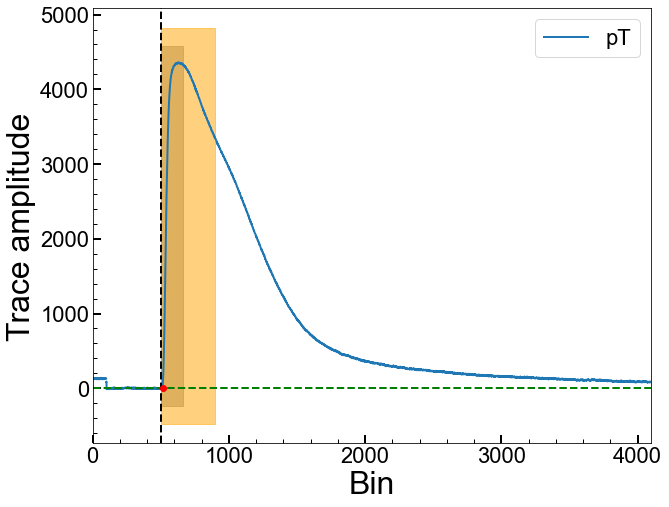

Series Number: 72209171225
Event Number: 4600240
Energy: 36.3754845236 keV
Area: 832557.3527235816


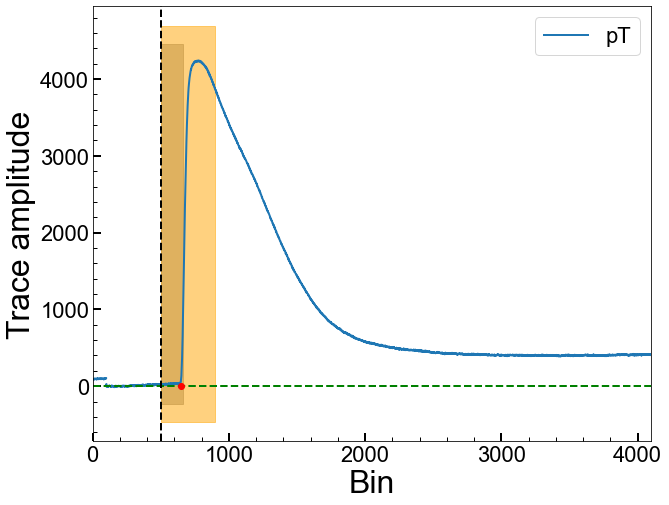

Series Number: 72209171225
Event Number: 4610477
Energy: 12.52770119151 keV
Area: 39776.66954982609


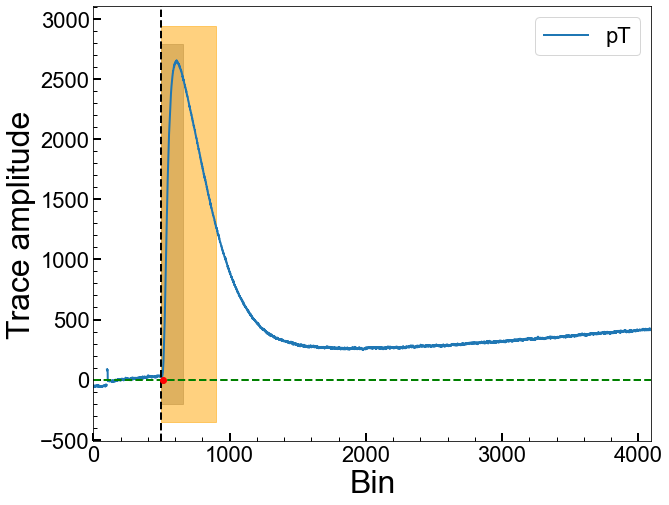

Series Number: 72209171225
Event Number: 4610570
Energy: 24.92568528349 keV
Area: 188569.91988519204


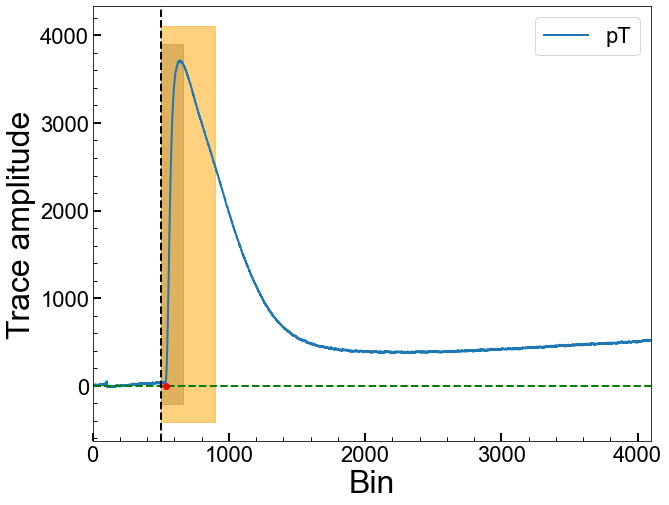

Series Number: 72209171225
Event Number: 4610702
Energy: 8.530357547452 keV
Area: 324123.0873931726


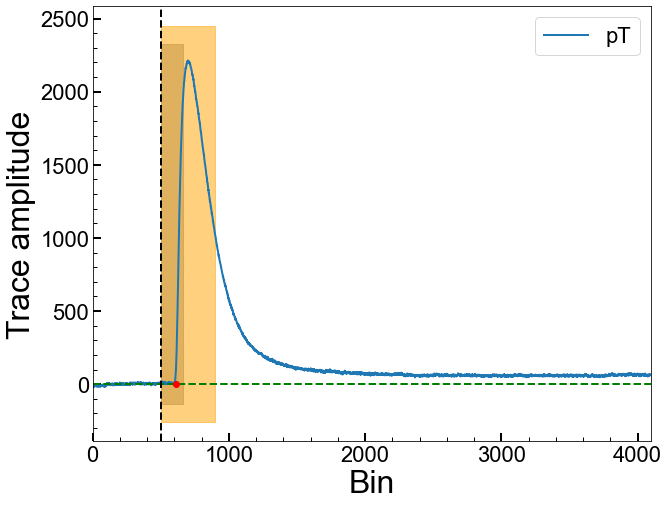

Series Number: 72209171225
Event Number: 4620151
Energy: 12.98892020567 keV
Area: 204415.4370554103


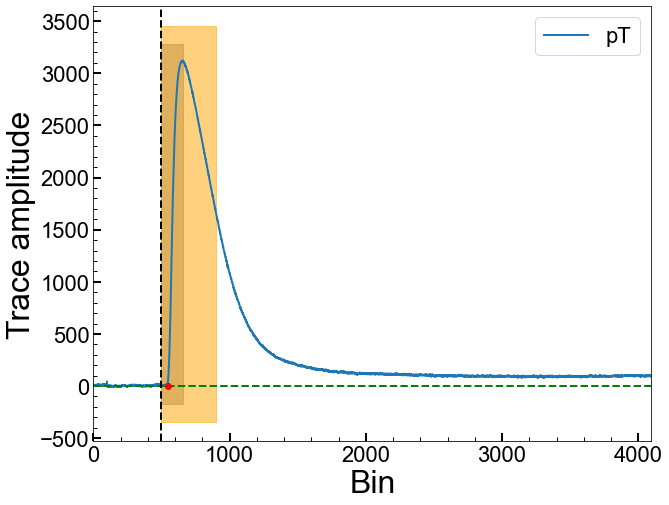

Series Number: 72209171225
Event Number: 4620378
Energy: 3.498422184907 keV
Area: 282638.2930320175


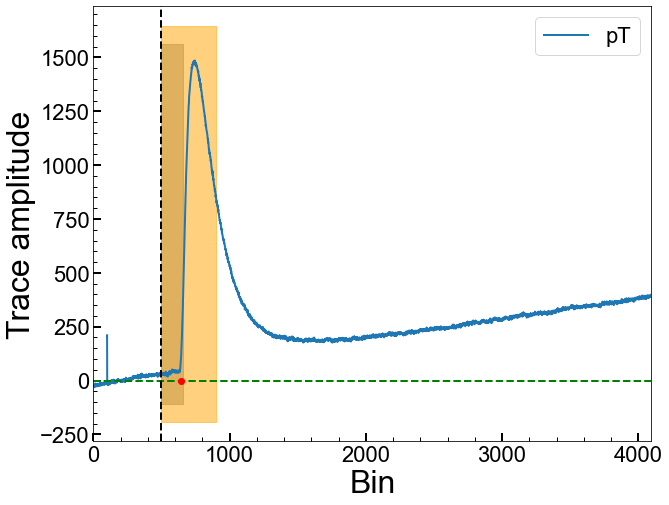

Series Number: 72209171225
Event Number: 4620407
Energy: 31.50576758507 keV
Area: 572589.0157168319


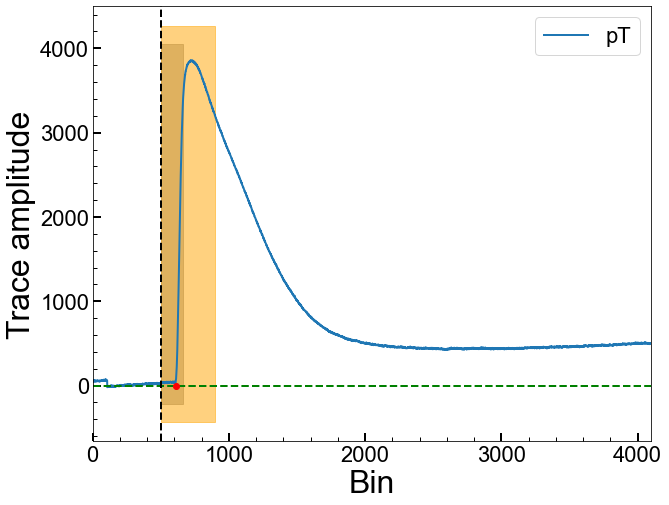

Series Number: 72209171225
Event Number: 4650452
Energy: 25.88016953393 keV
Area: 499653.0113410051


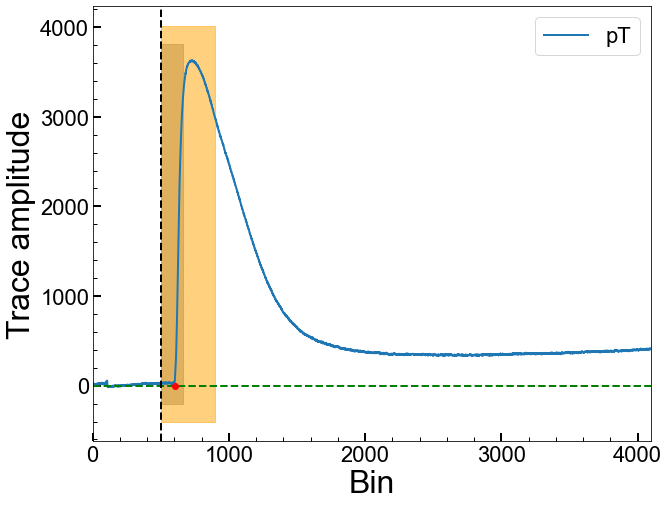

Series Number: 72209171225
Event Number: 4680071
Energy: 32.64777483687 keV
Area: 612390.1391226279


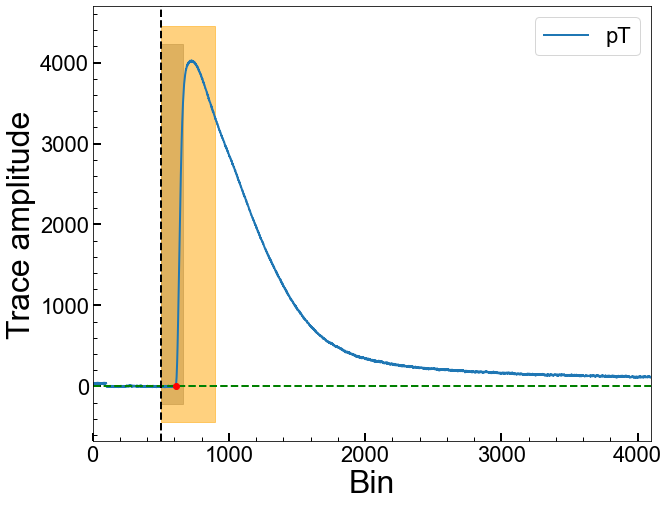

Series Number: 72209171225
Event Number: 4680897
Energy: 16.04484238678 keV
Area: 334852.8870873852


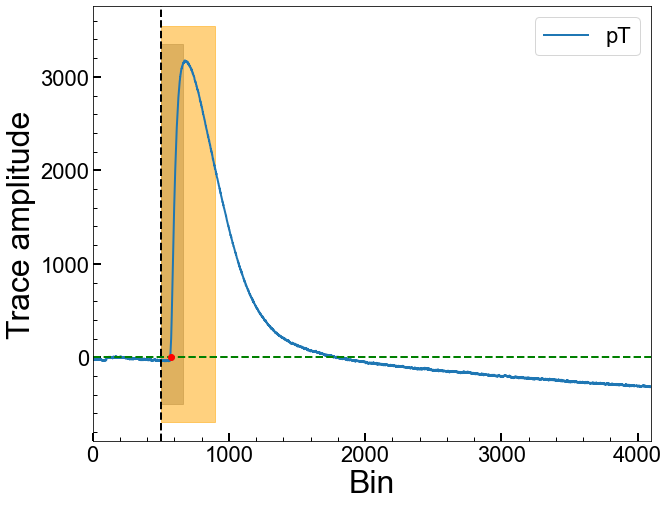

Series Number: 72209171225
Event Number: 4690750
Energy: 46.31645802266 keV
Area: -102143.31283980927


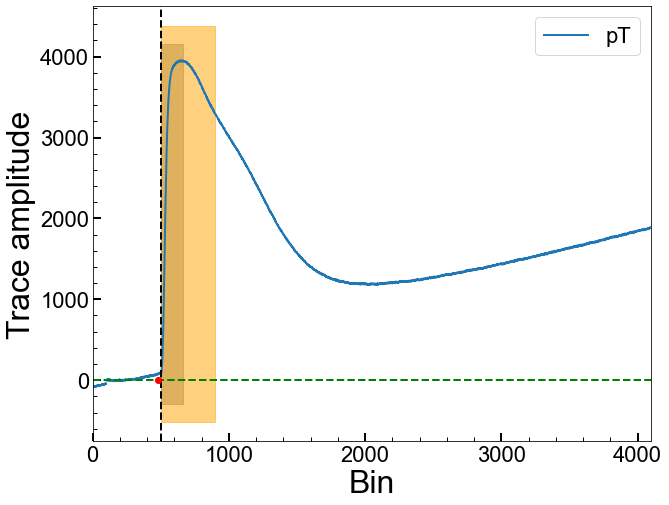

Series Number: 72209171225
Event Number: 4690849
Energy: 25.63794539381 keV
Area: 174751.82056274795


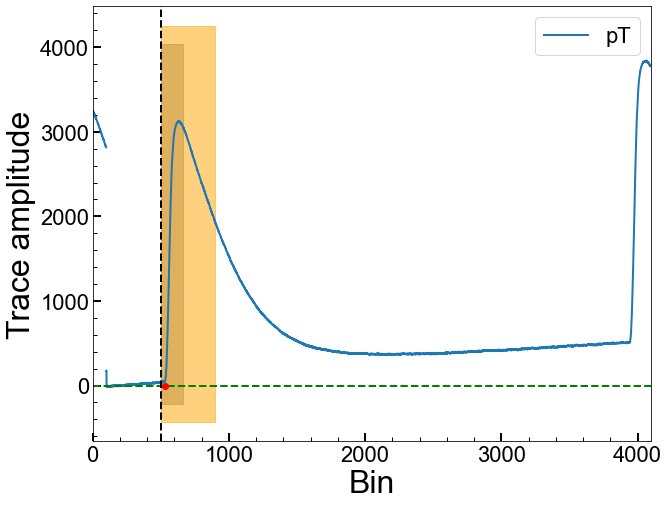

Series Number: 72209171225
Event Number: 4710363
Energy: 48.86771019571 keV
Area: 622468.5708753489


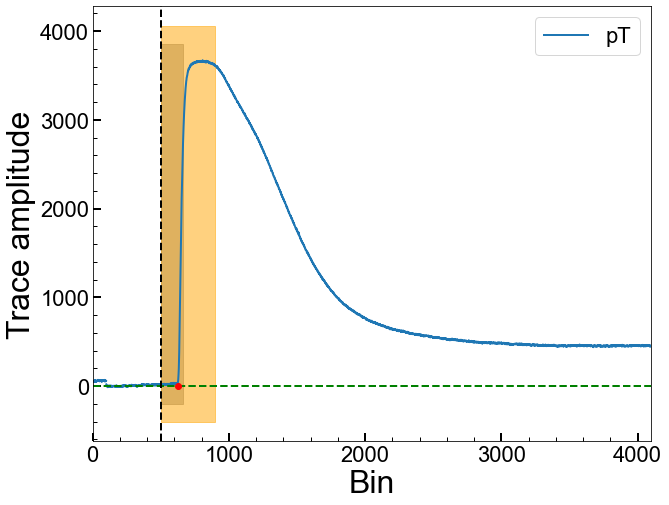

Series Number: 72209171225
Event Number: 4710444
Energy: 14.34775806185 keV
Area: 235028.68973503573


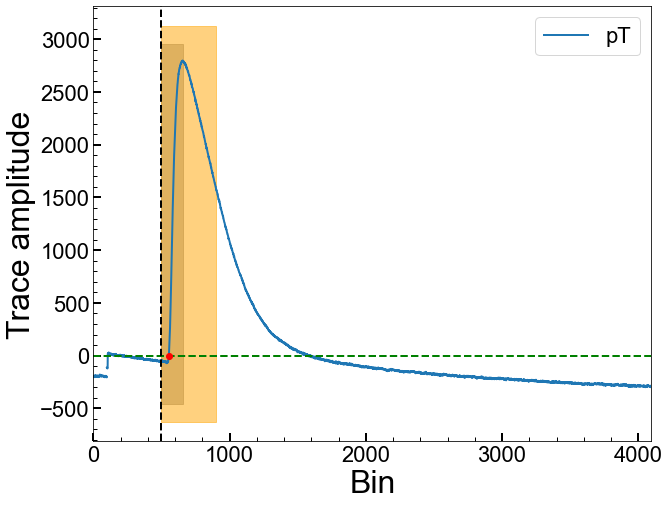

Series Number: 72209171225
Event Number: 4710875
Energy: 27.69298819695 keV
Area: 110827.35176448917


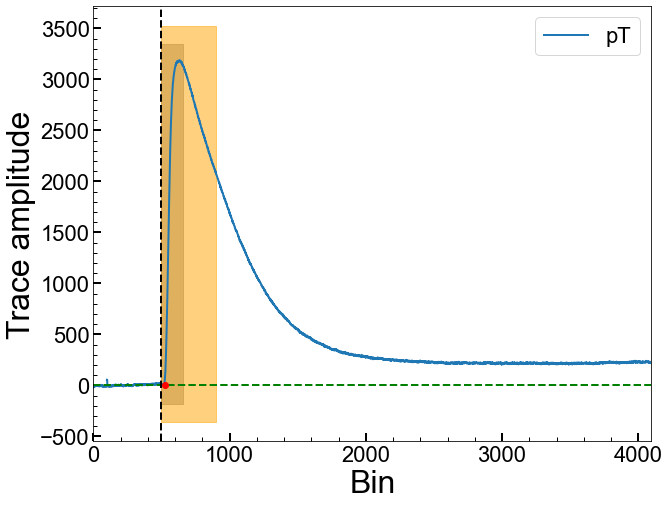

Series Number: 72209171225
Event Number: 4740489
Energy: 6.492343014129 keV
Area: 198965.5430153678


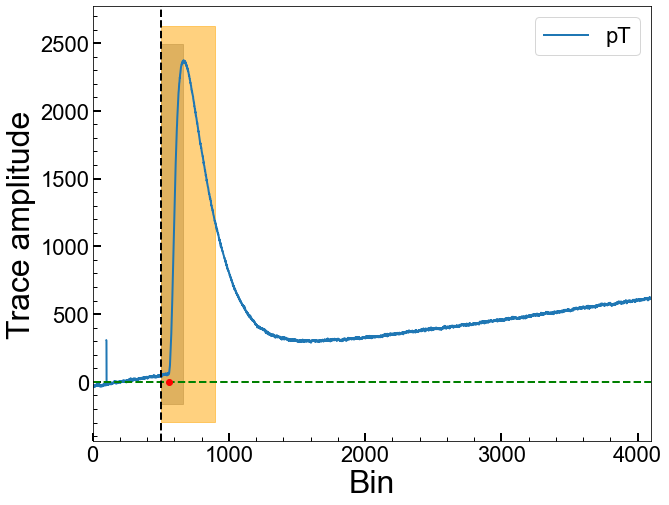

Series Number: 72209171225
Event Number: 4740663
Energy: 28.9570176951 keV
Area: 569829.0120889645


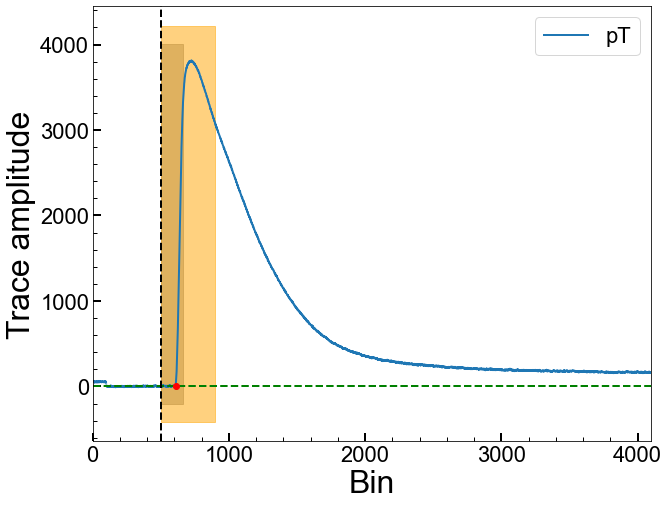

Series Number: 72209171225
Event Number: 4740786
Energy: 12.16157625931 keV
Area: 258265.0310688743


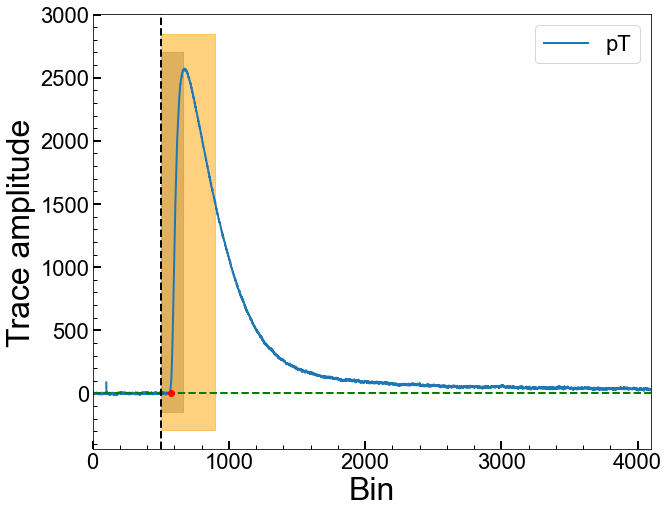

Series Number: 72209171225
Event Number: 4740844
Energy: 39.55060167459 keV
Area: -928095.4025124242


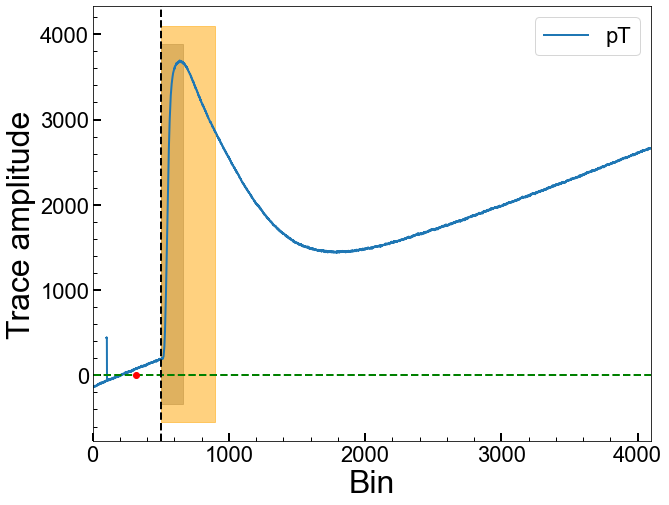

Series Number: 72209171225
Event Number: 4750710
Energy: 3.551369292785 keV
Area: 139598.93388588075


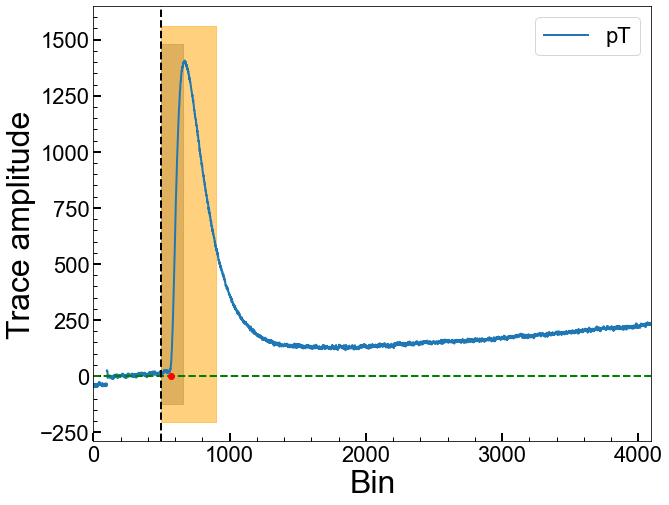

Series Number: 72209171225
Event Number: 4780503
Energy: 7.853669652667 keV
Area: 25933.874433808345


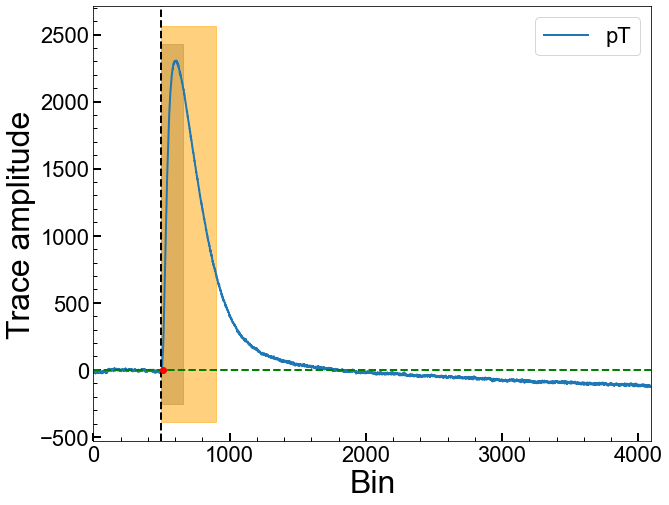

Series Number: 72209171225
Event Number: 4810359
Energy: 14.58320292159 keV
Area: 120211.75862526828


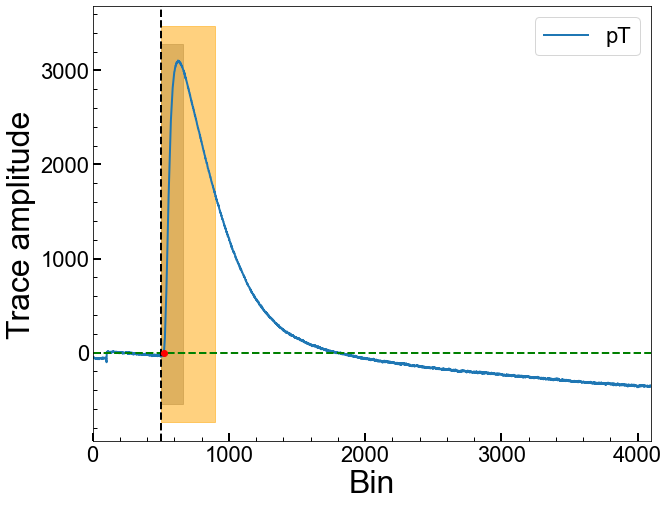

Series Number: 72209171225
Event Number: 4820332
Energy: 4.25709376349 keV
Area: 202397.5511797082


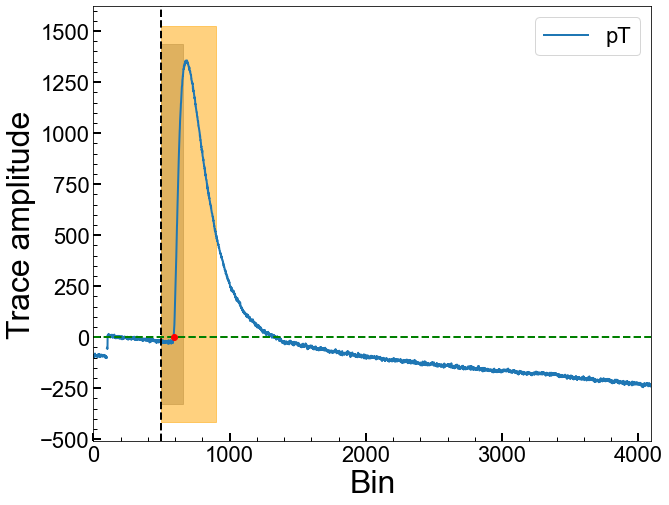

Series Number: 72209171225
Event Number: 4840196
Energy: 28.07441405348 keV
Area: 204681.76660372637


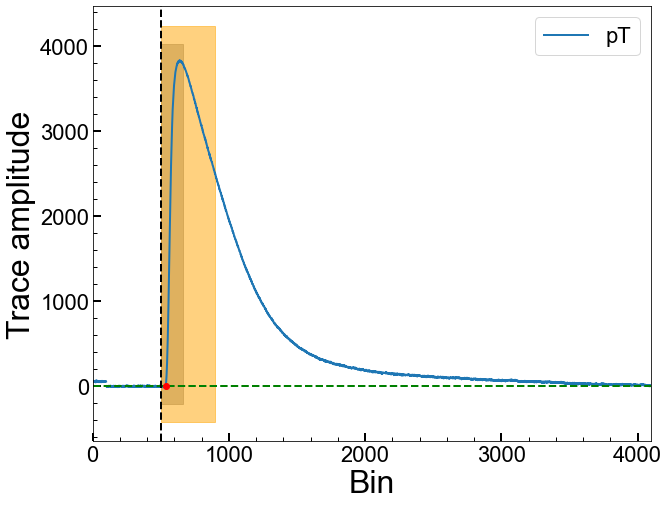

Series Number: 72209171225
Event Number: 4880309
Energy: 41.2857679029 keV
Area: 392430.8581707232


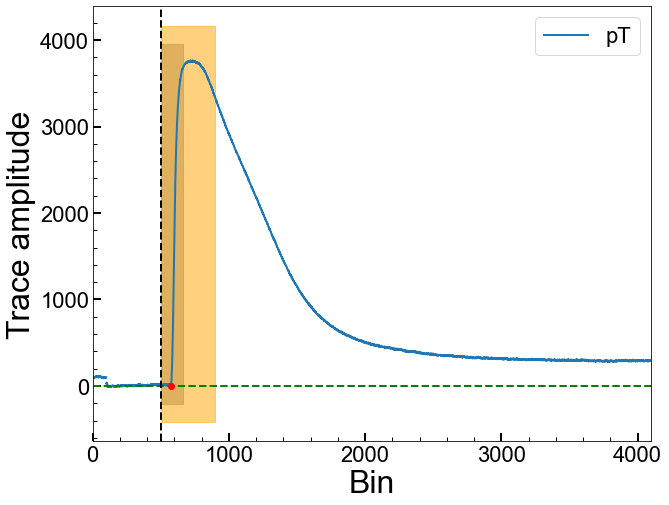

Series Number: 72209171225
Event Number: 4880330
Energy: 30.46989060789 keV
Area: 565924.6692644168


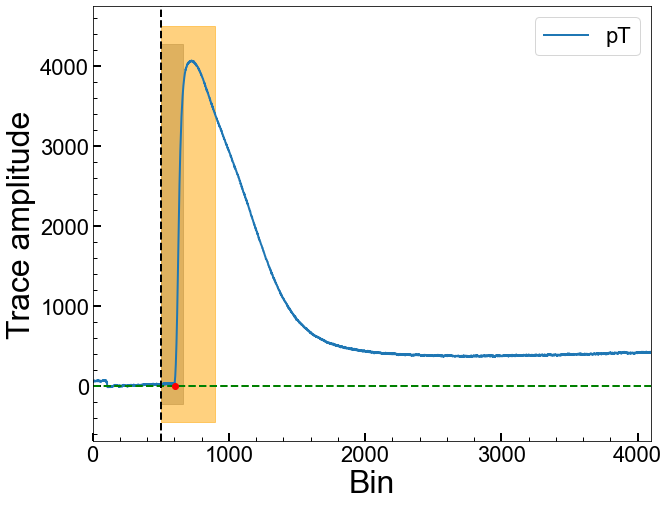

Series Number: 72209171225
Event Number: 4890441
Energy: 49.18505900557 keV
Area: 268644.69256968476


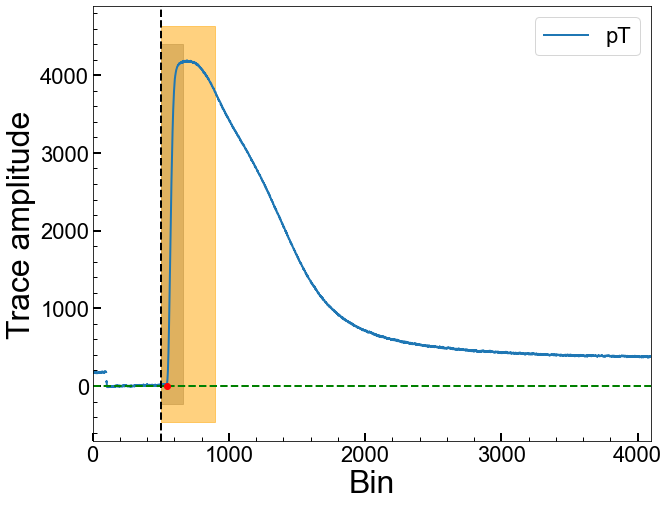

Series Number: 72209171225
Event Number: 4890749
Energy: 25.11945264182 keV
Area: 533355.2002253213


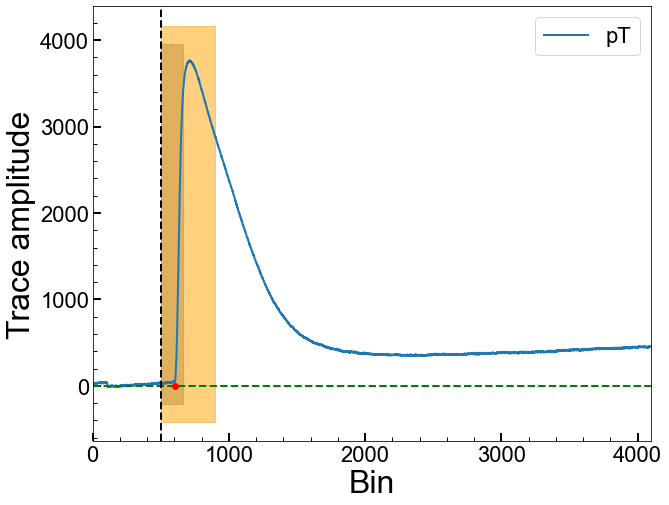

Series Number: 72209171225
Event Number: 4910256
Energy: 42.88377088355 keV
Area: 297475.38606879296


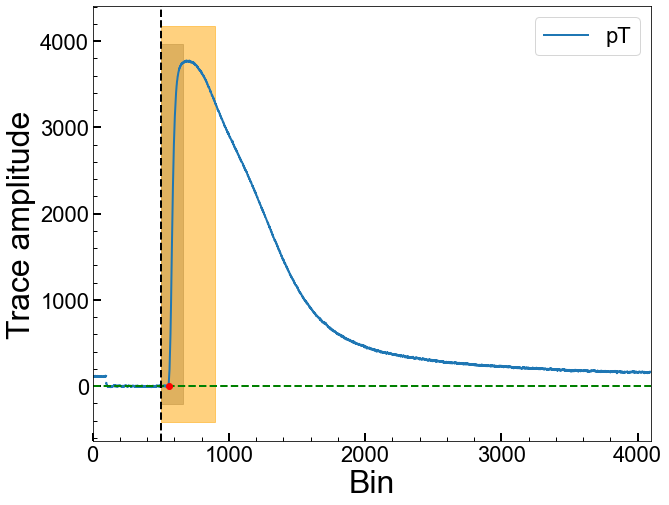

Series Number: 72209171225
Event Number: 4910695
Energy: 15.5096061496 keV
Area: -689168.6002457262


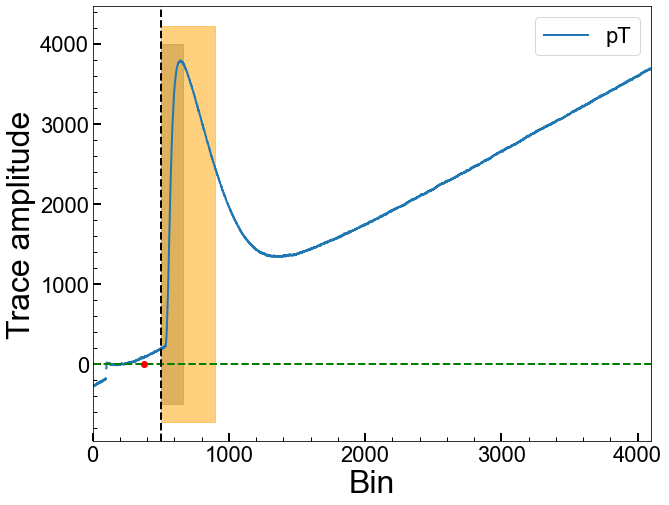

Series Number: 72209171225
Event Number: 4920388
Energy: 11.94337633575 keV
Area: 432598.9614130016


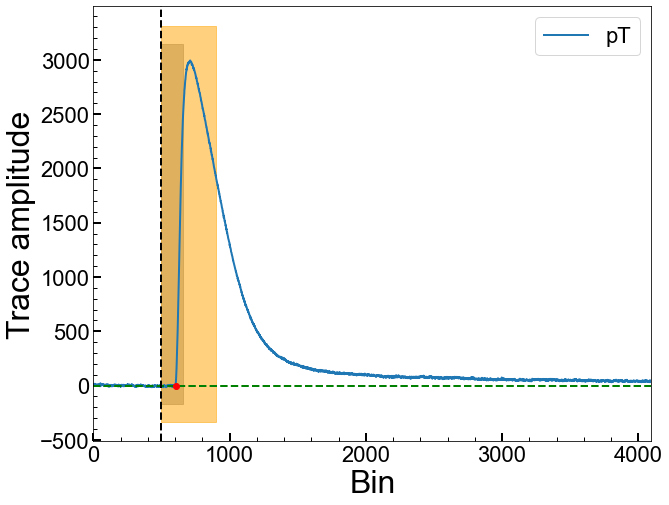

Series Number: 72209171225
Event Number: 4930361
Energy: 38.15304633678 keV
Area: 225563.70476185443


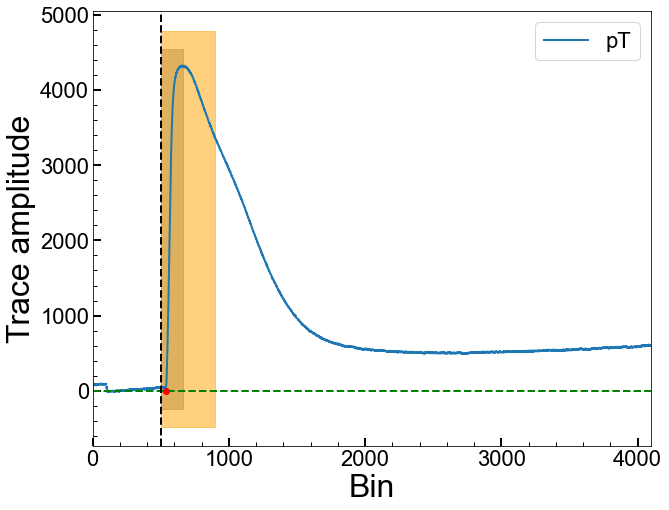

Series Number: 72209171225
Event Number: 4950033
Energy: 47.41182847994 keV
Area: -1548135.038102226


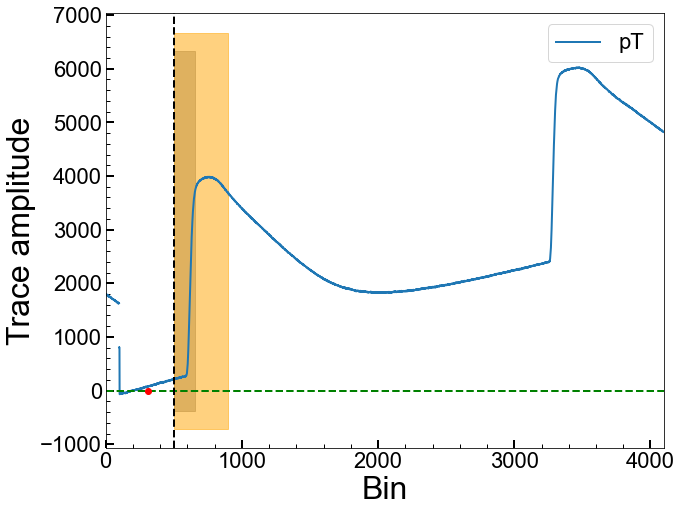

Series Number: 72209171225
Event Number: 4950112
Energy: 9.51405635537 keV
Area: 453720.99898668105


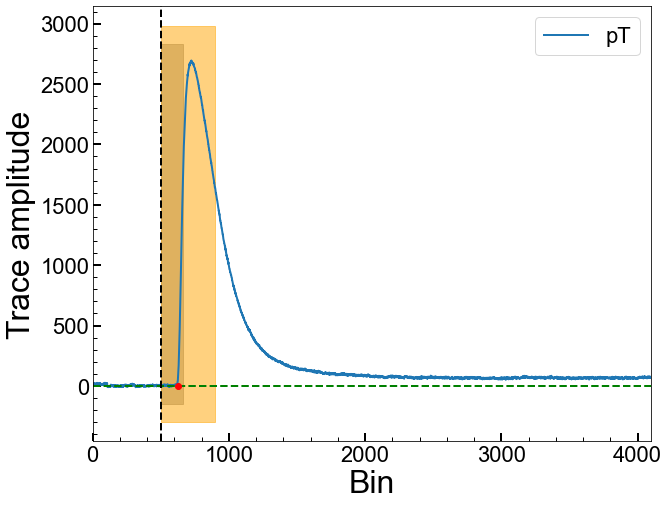

Series Number: 72209171225
Event Number: 4970509
Energy: 45.25157613816 keV
Area: 38036.67140548874


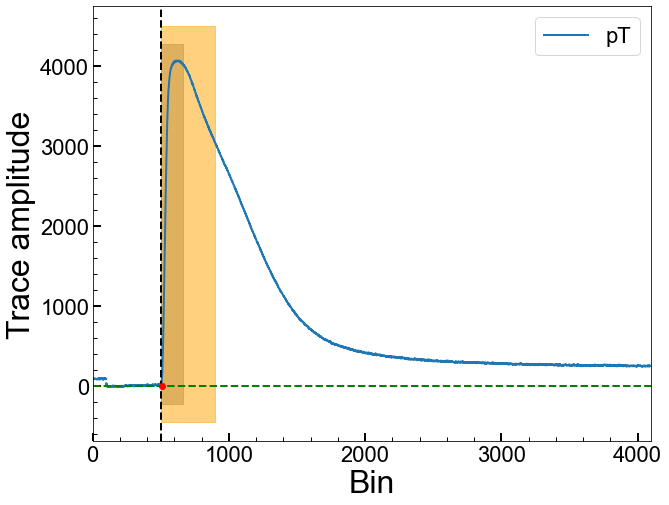

Series Number: 72209171225
Event Number: 4970586
Energy: 24.14510791402 keV
Area: 369590.77741817315


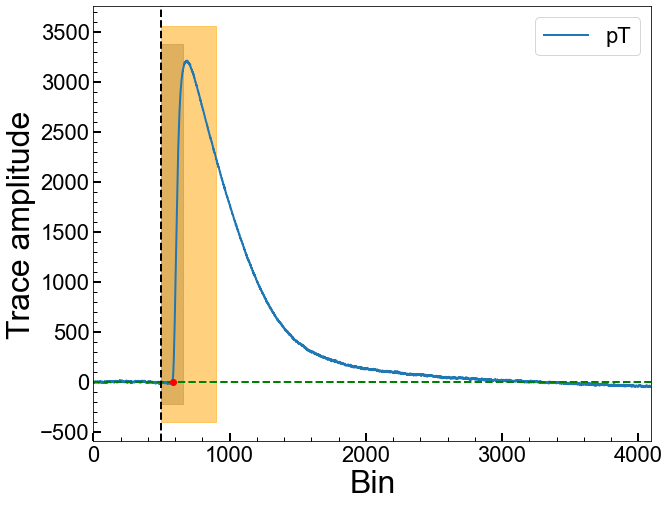

Series Number: 72209171225
Event Number: 4980237
Energy: 33.66184344815 keV
Area: 170717.68224745253


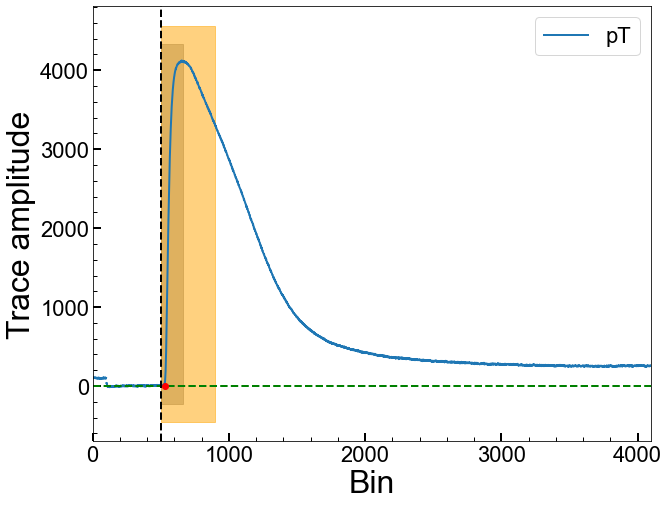

Series Number: 72209171225
Event Number: 4990328
Energy: 17.10781279759 keV
Area: 421191.9899288673


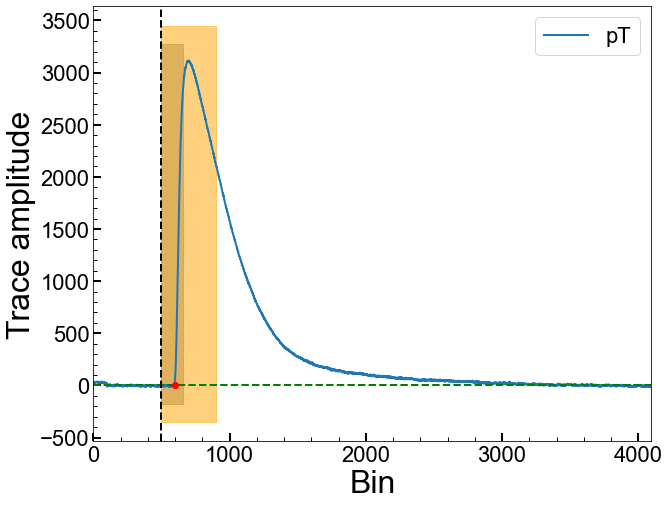

Series Number: 72209171225
Event Number: 5020932
Energy: 21.7155221048 keV
Area: 260611.33327674167


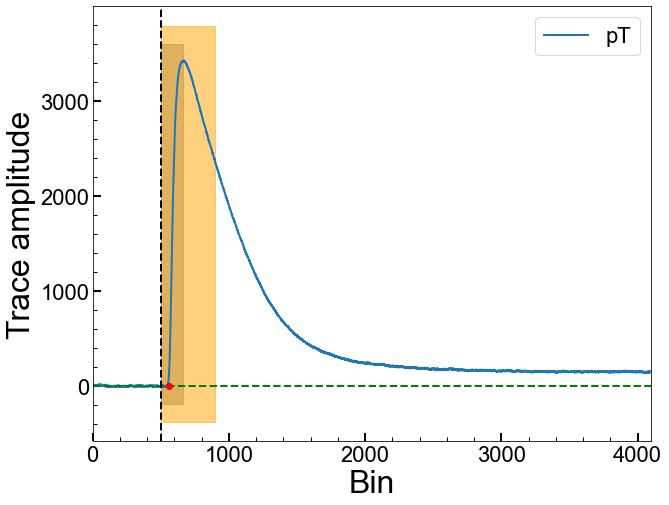

Series Number: 72209171225
Event Number: 5030064
Energy: 20.87470337343 keV
Area: 207786.85941135968


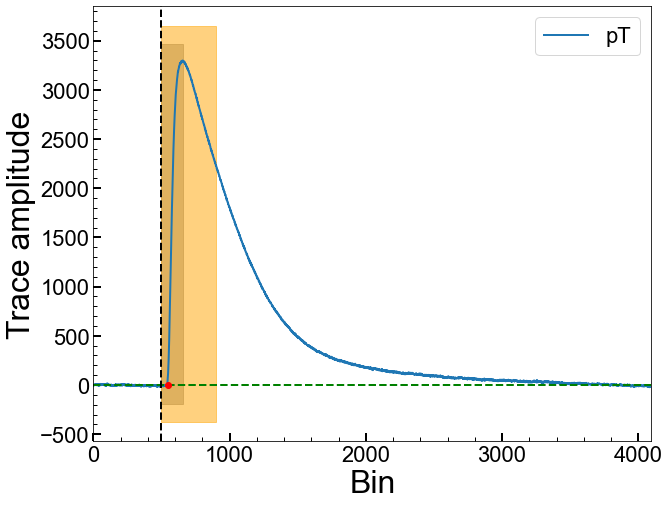

Series Number: 72209171225
Event Number: 5030079
Energy: 48.87187047566 keV
Area: 533721.9592486096


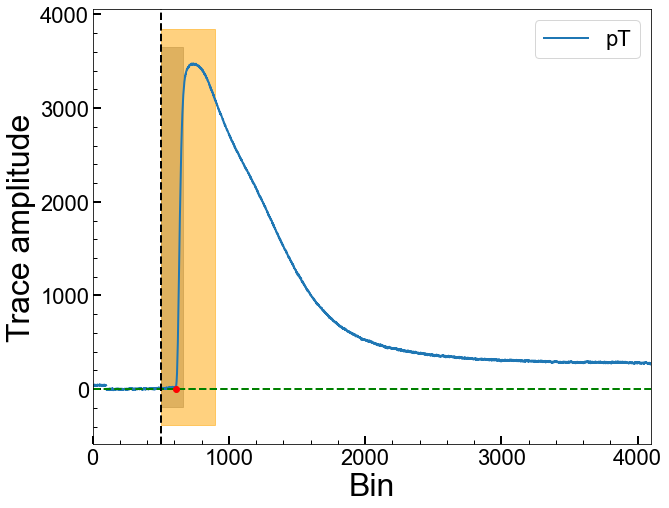

Series Number: 72209171225
Event Number: 5030407
Energy: 33.40722041091 keV
Area: -2809343.994608736


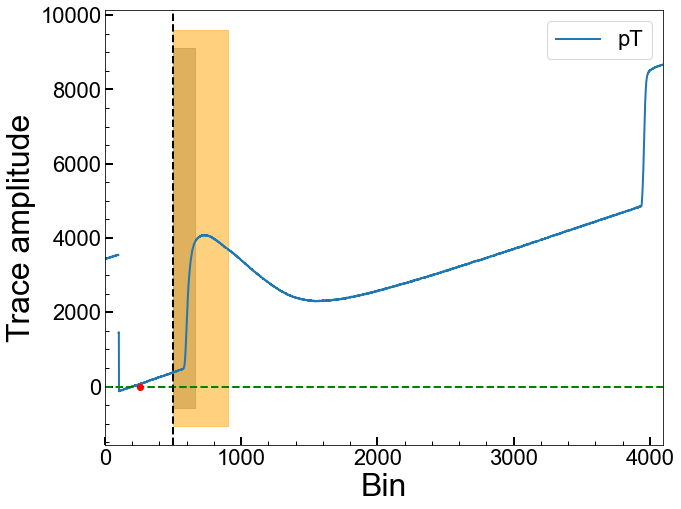

Series Number: 72209171225
Event Number: 5030765
Energy: 2.958131623633 keV
Area: 76578.12881900286


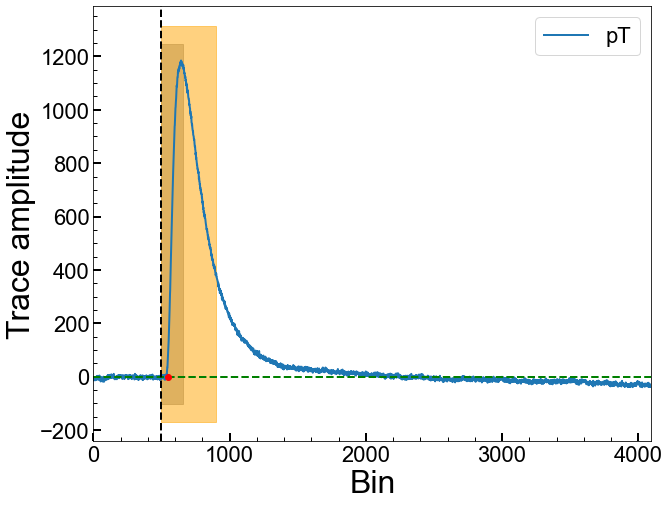

Series Number: 72209171225
Event Number: 5030805
Energy: 10.21794608571 keV
Area: 184611.29477893157


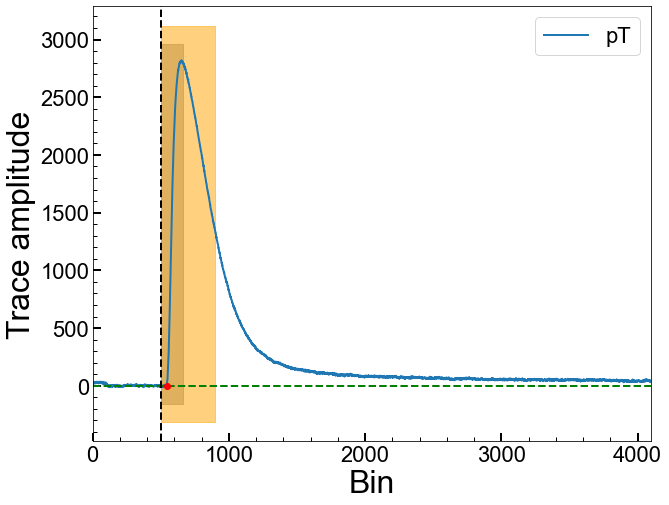

Series Number: 72209171225
Event Number: 5040904
Energy: 24.56861247723 keV
Area: 558733.5352811303


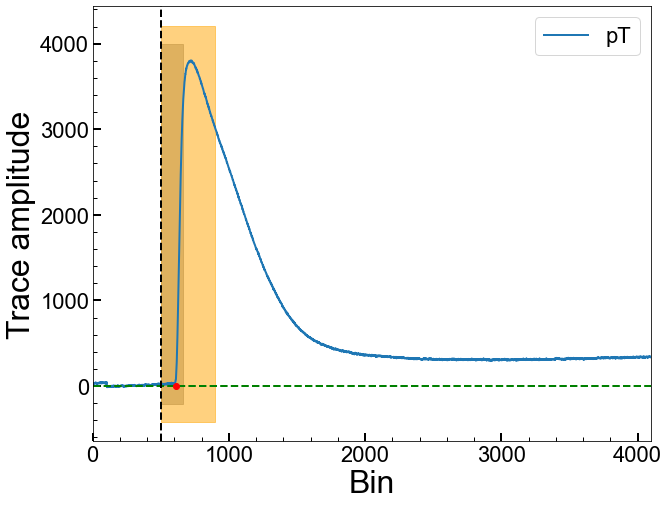

Series Number: 72209171225
Event Number: 5050474
Energy: 48.46690036178 keV
Area: -1965820.1950403373


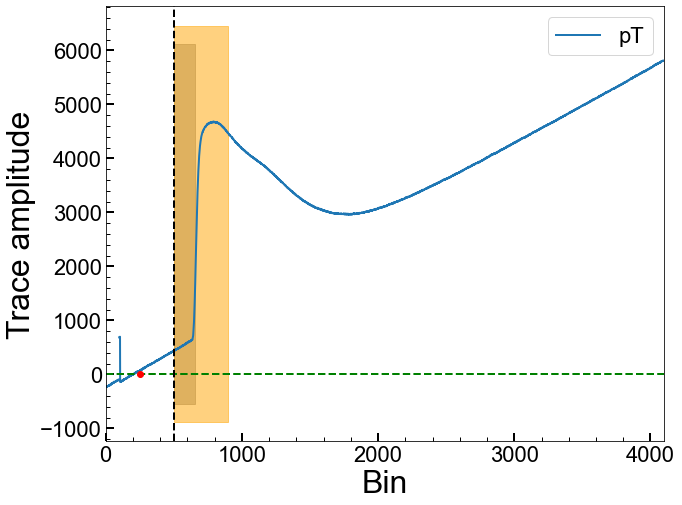

Series Number: 72209171225
Event Number: 5060642
Energy: 49.74976526863 keV
Area: 613486.9560461495


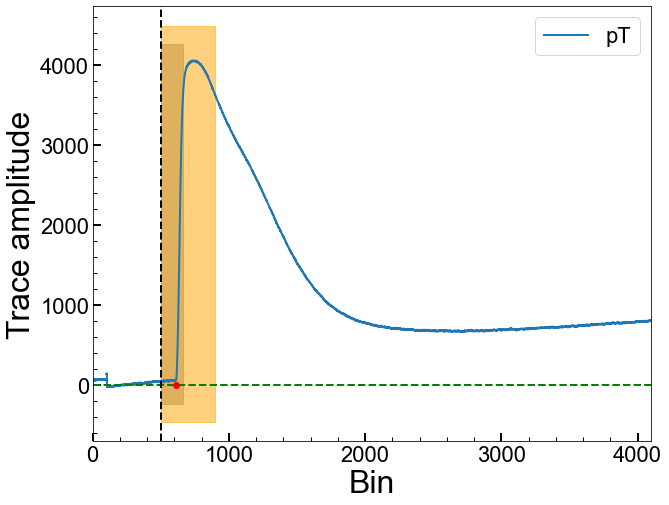

Series Number: 72209171225
Event Number: 5080641
Energy: 3.898024650778 keV
Area: 269900.18000940216


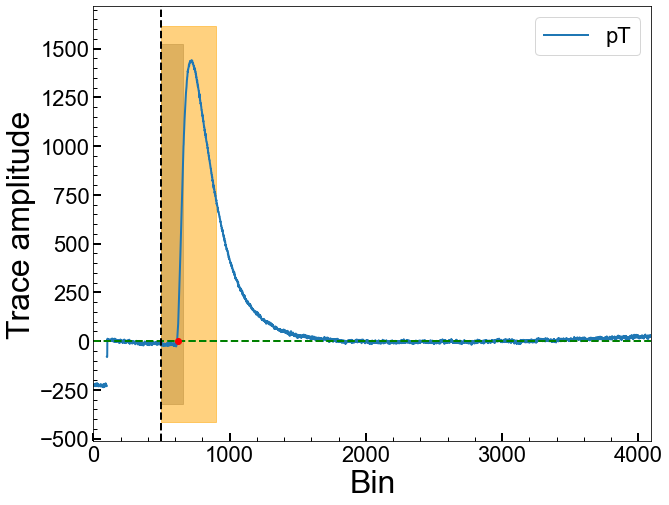

Series Number: 72209171225
Event Number: 5100400
Energy: 4.516517759674 keV
Area: 587667.2769086835


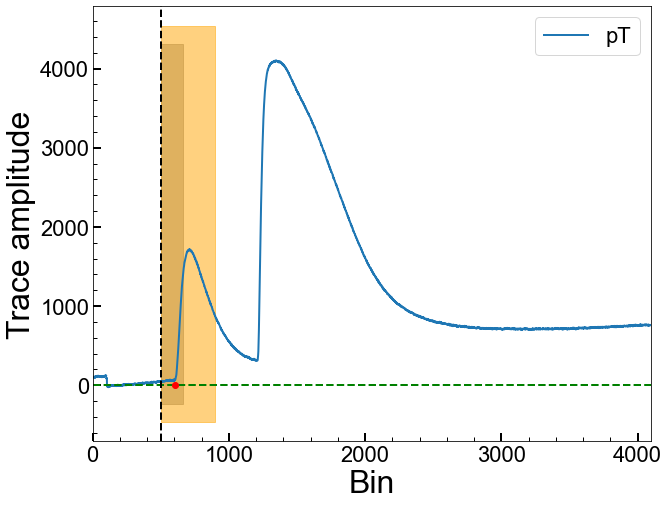

Series Number: 72209171225
Event Number: 5100430
Energy: 8.668655013857 keV
Area: 319328.5891086458


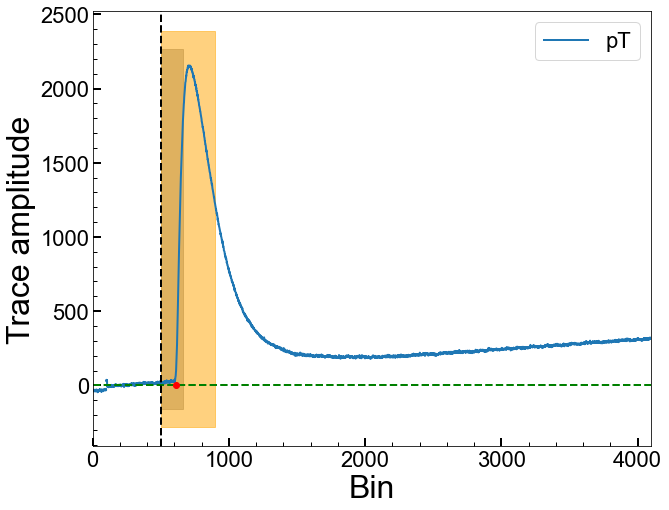

Series Number: 72209171225
Event Number: 5110635
Energy: 33.59187595784 keV
Area: 715581.7344463585


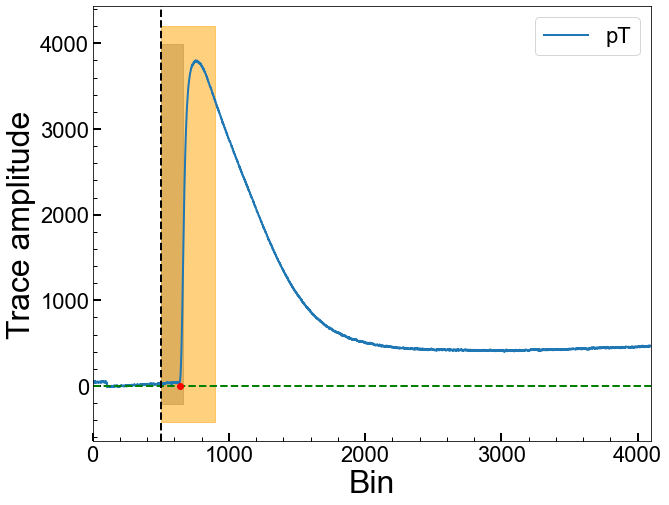

Series Number: 72209171225
Event Number: 5140481
Energy: 9.140377207648 keV
Area: 371072.6797459075


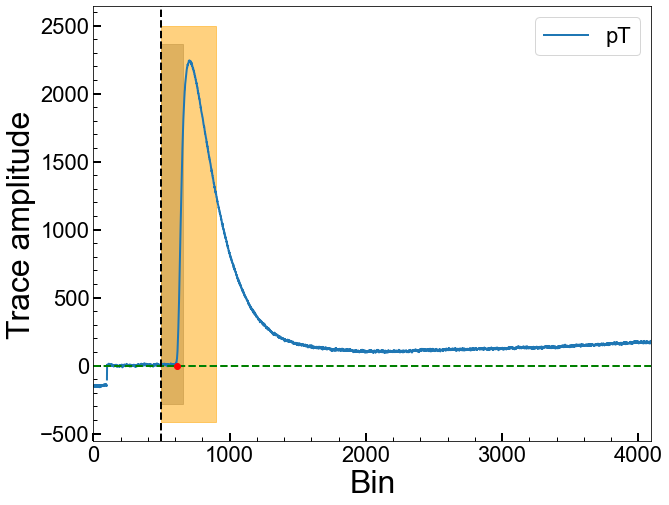

Series Number: 72209171225
Event Number: 5150345
Energy: 19.80964389907 keV
Area: 422480.79234677105


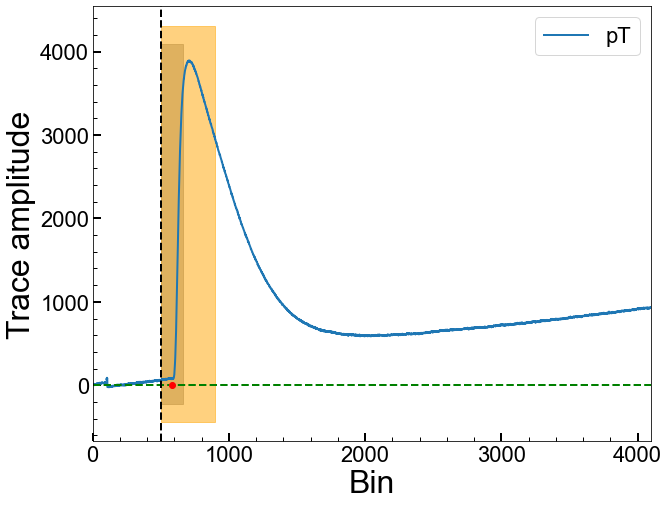

Series Number: 72209171225
Event Number: 5150878
Energy: 19.67512113933 keV
Area: 427064.3544870199


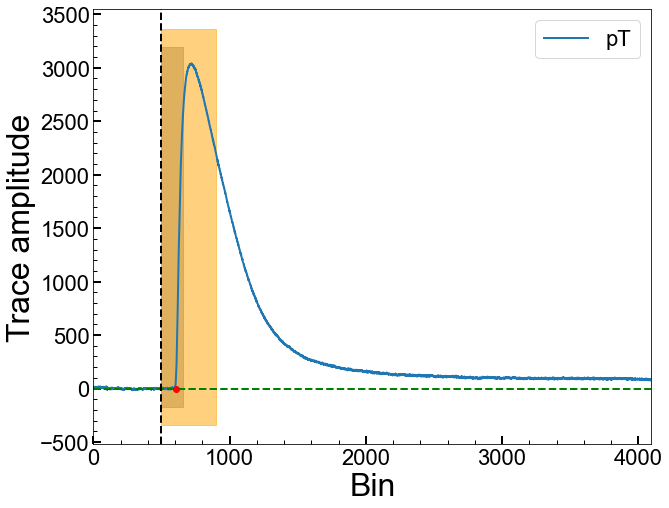

Series Number: 72209171225
Event Number: 5160570
Energy: 18.10409345298 keV
Area: 203771.23083178813


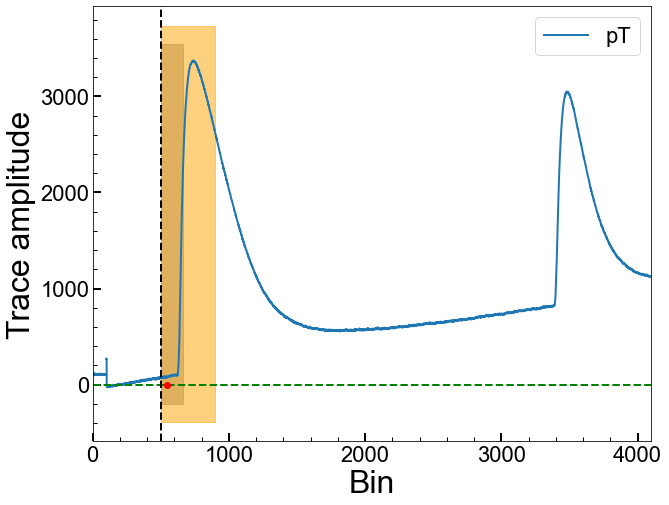

Series Number: 72209171225
Event Number: 5170374
Energy: 2.480683895549 keV
Area: 96920.37053267873


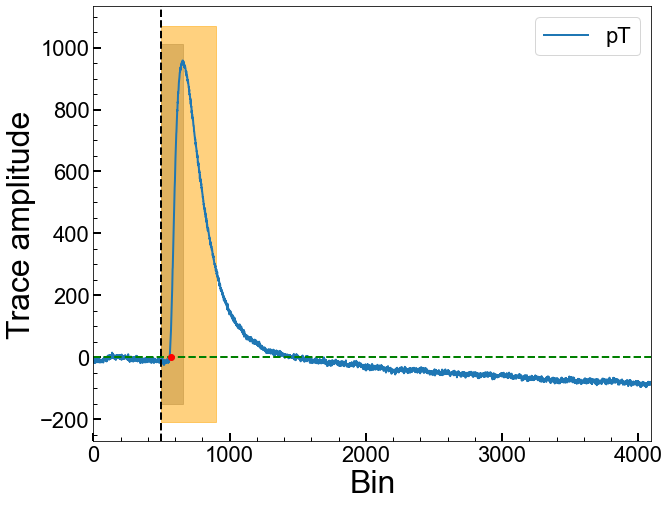

Series Number: 72209171225
Event Number: 5180397
Energy: 37.9189477984 keV
Area: 714808.5880320008


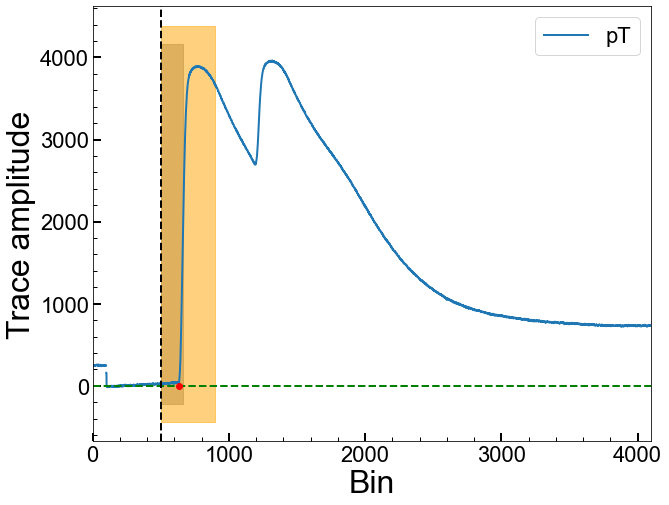

Series Number: 72209171225
Event Number: 5220322
Energy: 17.57610796601 keV
Area: -1081775.8451314585


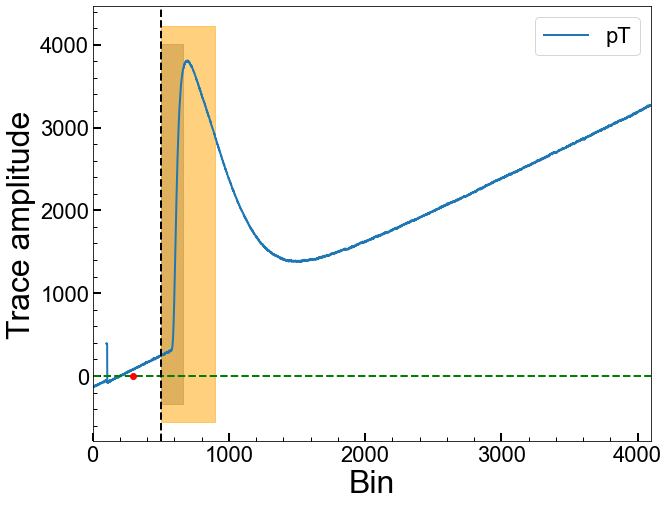

Series Number: 72209171225
Event Number: 5220433
Energy: 10.70463452444 keV
Area: 153806.66316953636


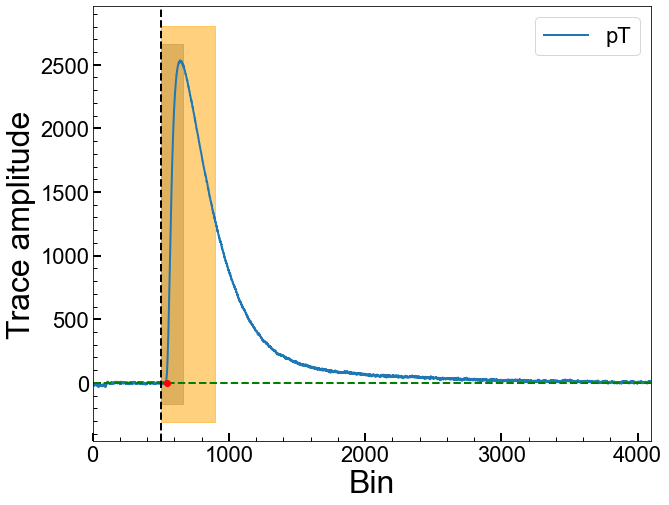

Series Number: 72209171225
Event Number: 5230527
Energy: 39.22535218816 keV
Area: 195345.83441271528


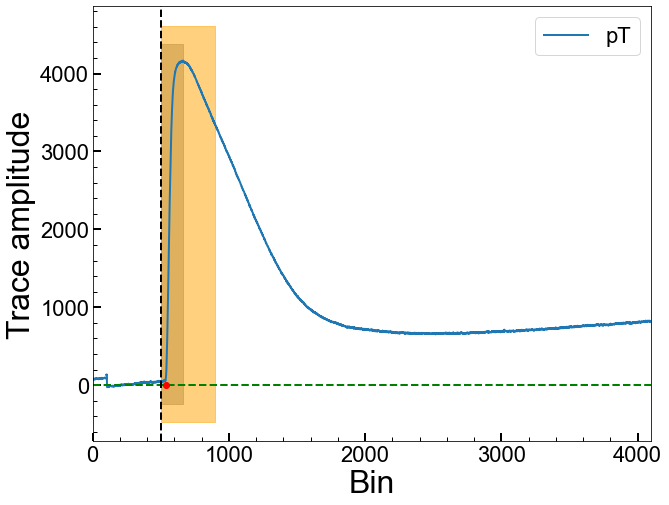

Series Number: 72209171225
Event Number: 5240290
Energy: 31.66572671662 keV
Area: 115123.50218847685


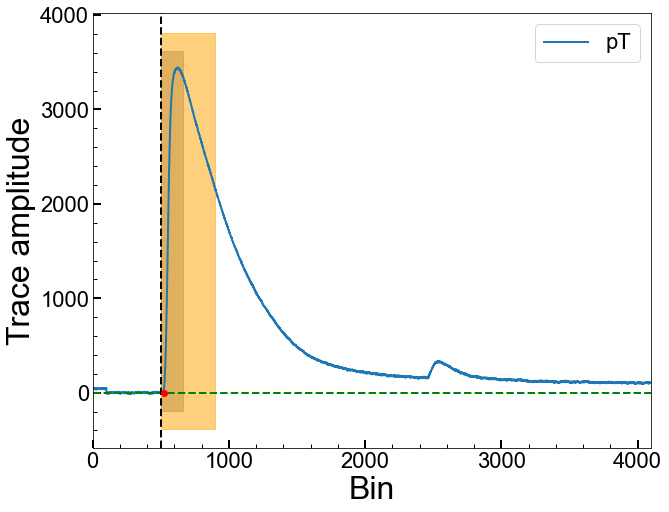

Series Number: 72209171225
Event Number: 5240504
Energy: 6.541163234057 keV
Area: 281611.7856939934


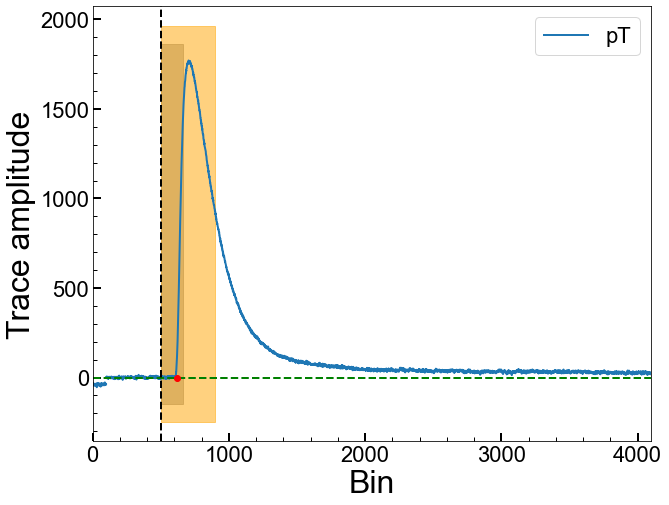

Series Number: 72209172155
Event Number: 40198
Energy: 20.20950832972 keV
Area: 542710.730669125


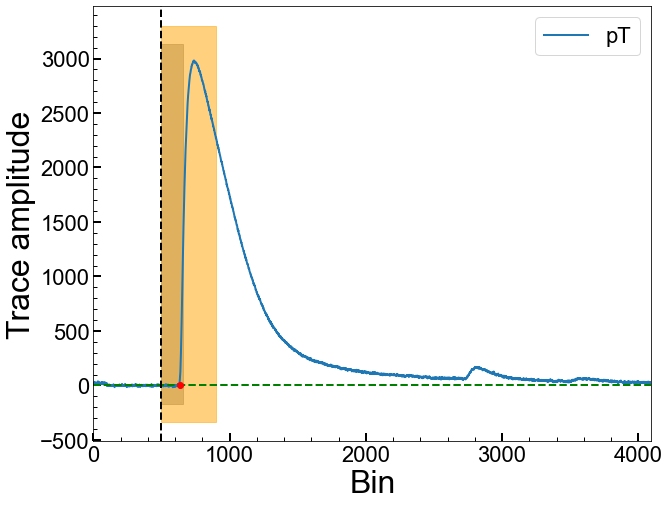

Series Number: 72209172155
Event Number: 60015
Energy: 11.64844433977 keV
Area: 170531.29352051212


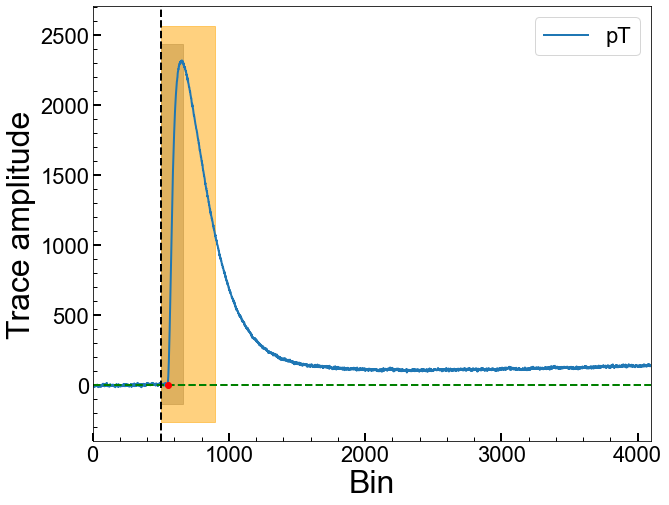

Series Number: 72209172155
Event Number: 70819
Energy: 30.00890978783 keV
Area: 110222.36300397404


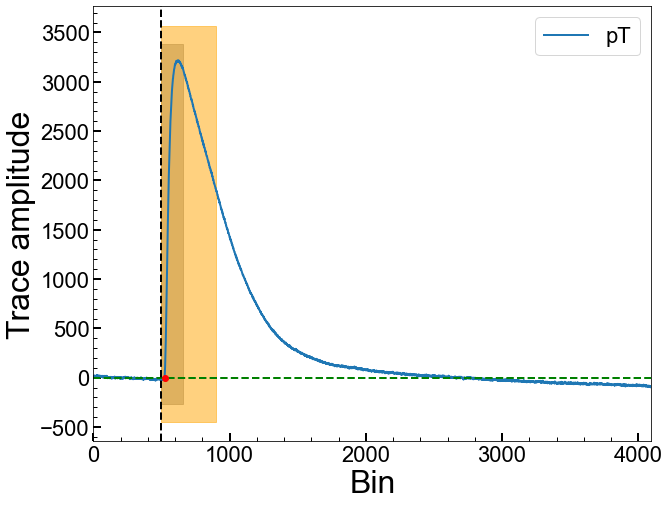

Series Number: 72209172155
Event Number: 110052
Energy: 21.9398768278 keV
Area: 295507.6461663577


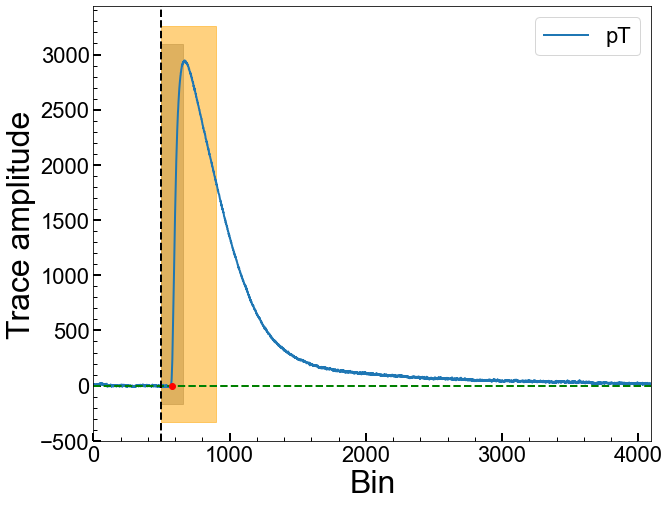

Series Number: 72209172155
Event Number: 160748
Energy: 30.37008922715 keV
Area: 460375.3567359895


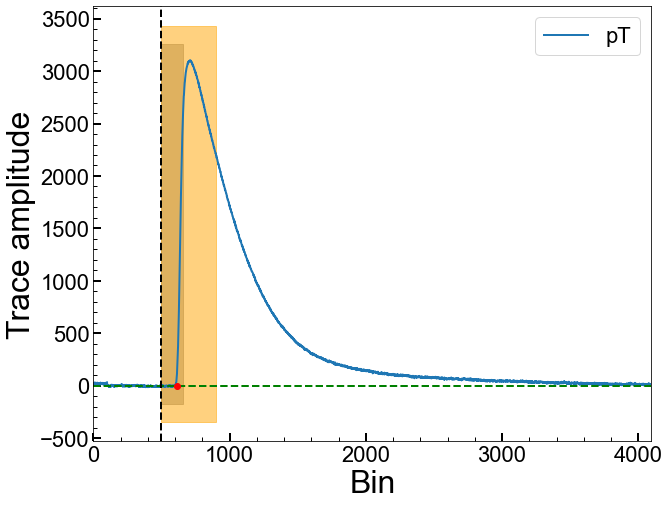

Series Number: 72209172155
Event Number: 160833
Energy: 17.64949225588 keV
Area: -3480815.612940486


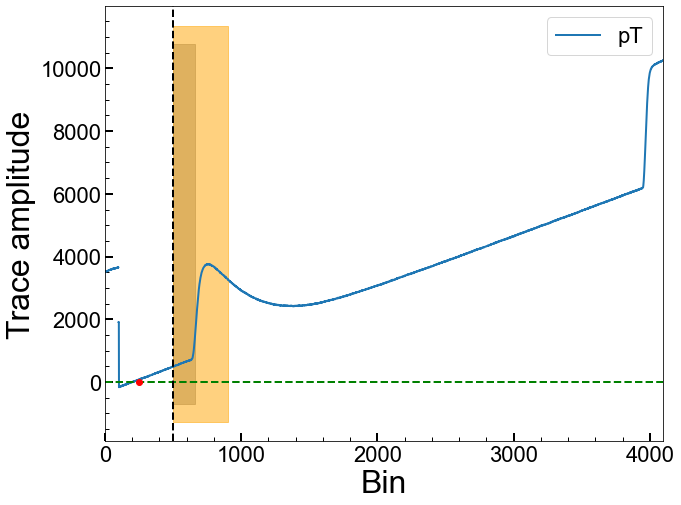

Series Number: 72209172155
Event Number: 190873
Energy: 6.637855562761 keV
Area: 316900.00670204964


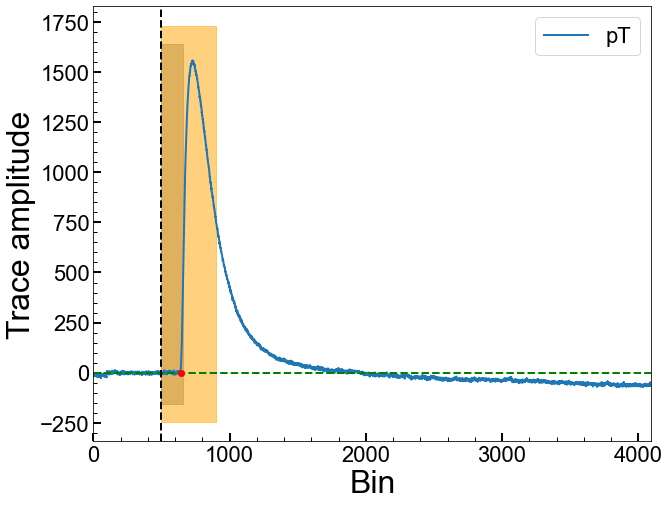

Series Number: 72209172155
Event Number: 210237
Energy: 13.96564216701 keV
Area: 393056.62775138207


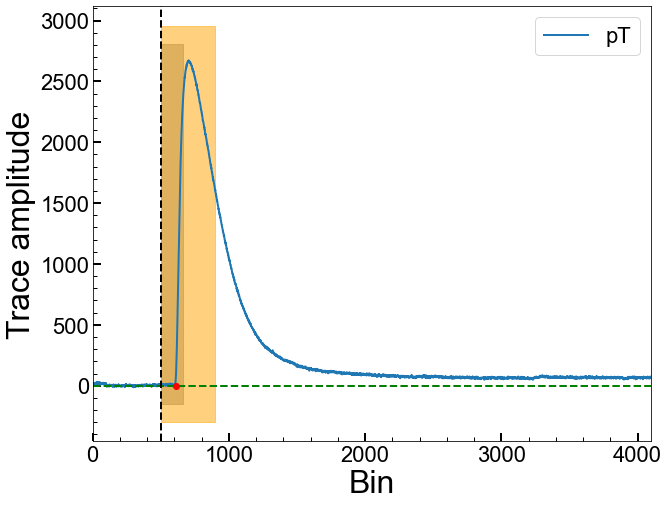

Series Number: 72209172155
Event Number: 220309
Energy: 30.52812585495 keV
Area: 743790.0858878408


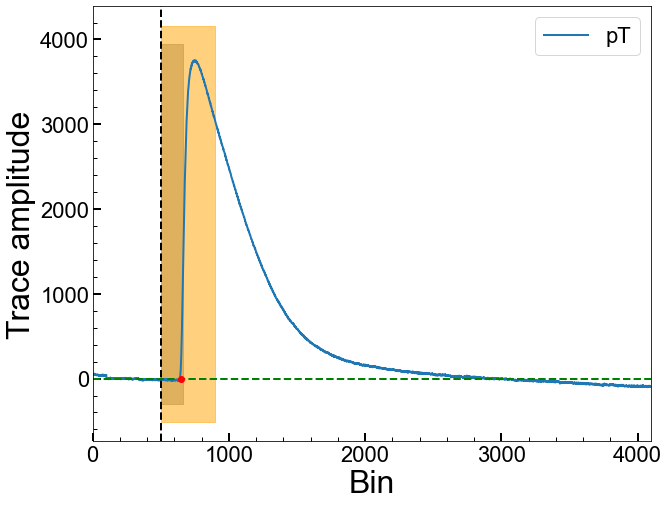

Series Number: 72209172155
Event Number: 220618
Energy: 40.24710457335 keV
Area: 563993.9450725475


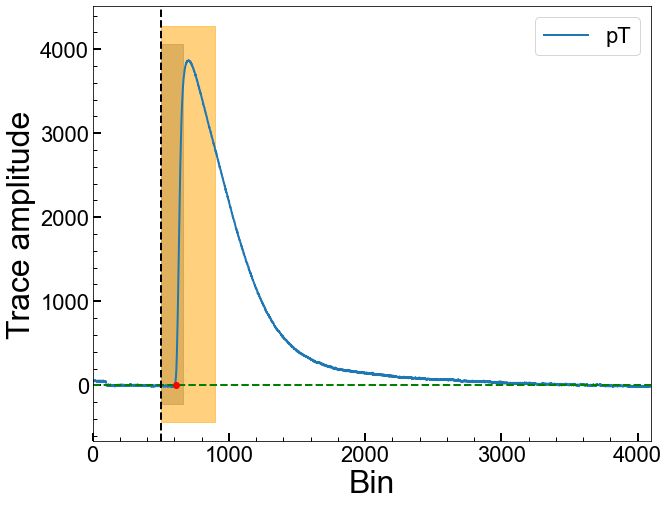

Series Number: 72209172155
Event Number: 250190
Energy: 43.83707351198 keV
Area: 596679.7306823311


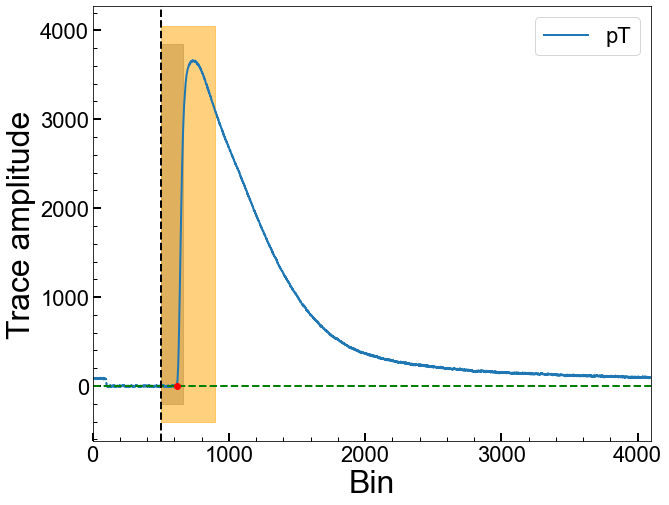

Series Number: 72209172155
Event Number: 260099
Energy: 10.07723804523 keV
Area: 325282.9959074085


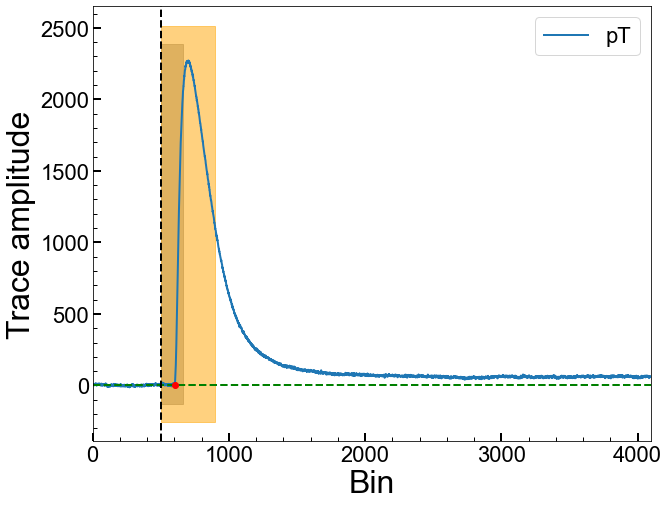

Series Number: 72209172155
Event Number: 280057
Energy: 3.37272618589 keV
Area: 208795.76749523112


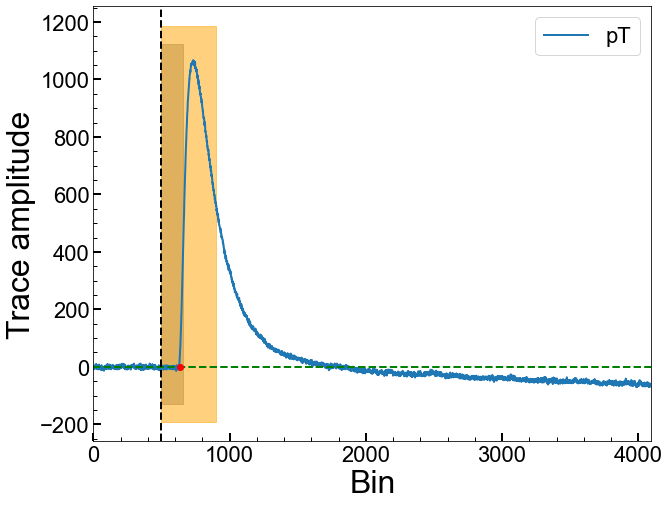

Series Number: 72209172155
Event Number: 290014
Energy: 2.082554808023 keV
Area: 174081.42963782873


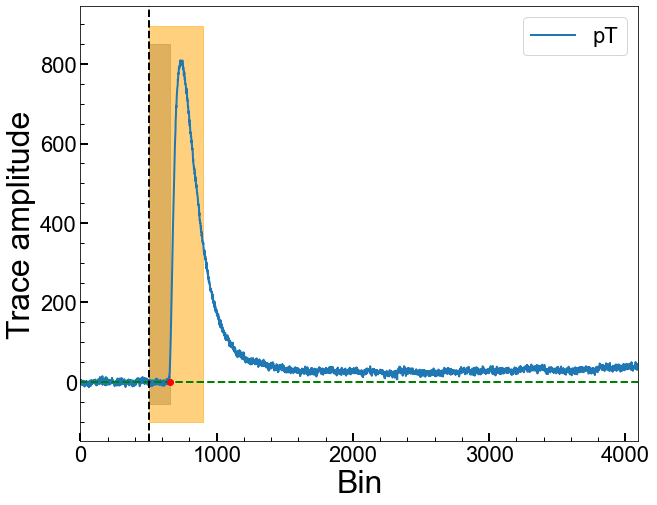

Series Number: 72209172155
Event Number: 290528
Energy: 31.06828588846 keV
Area: -1616420.5219012066


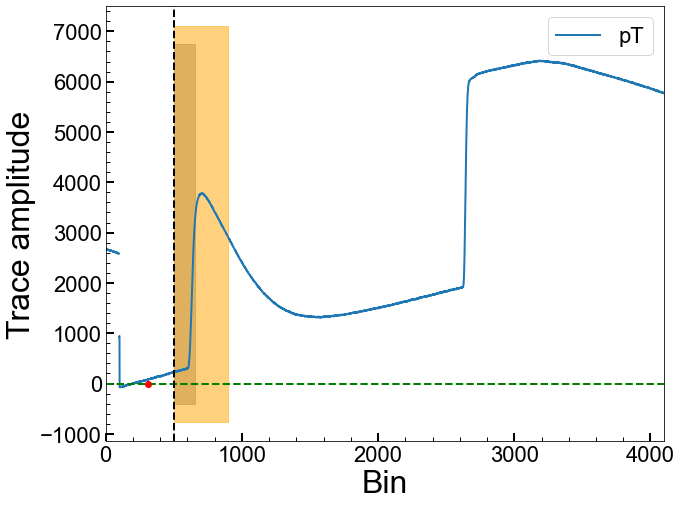

Series Number: 72209172155
Event Number: 320511
Energy: 17.03417308295 keV
Area: 533925.6842147036


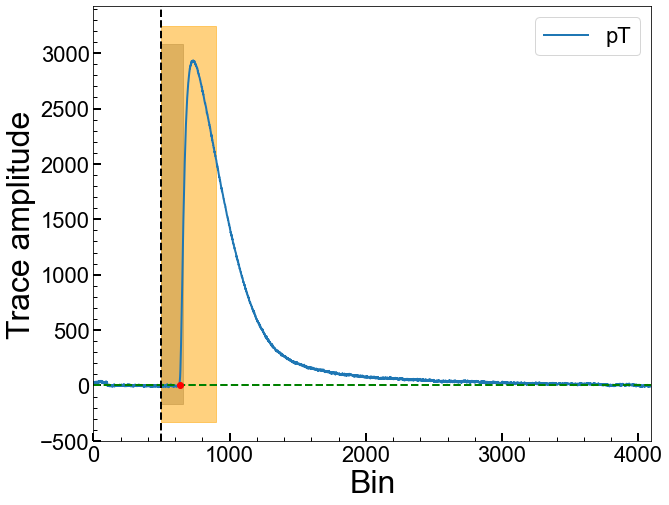

Series Number: 72209172155
Event Number: 340508
Energy: 13.30586767562 keV
Area: 32592.78720947292


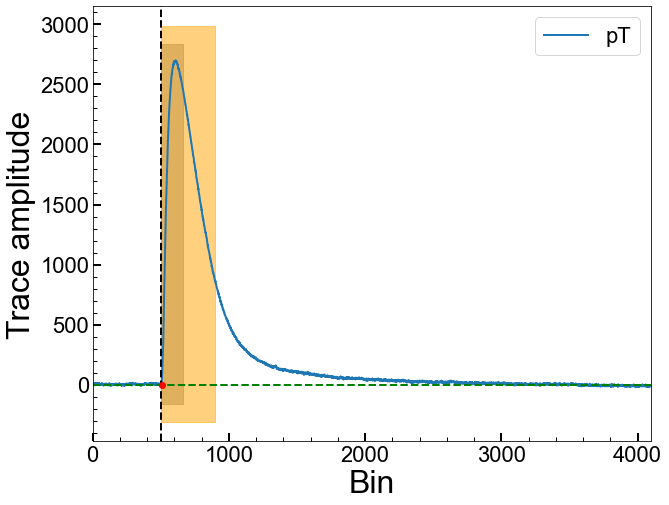

Series Number: 72209172155
Event Number: 350054
Energy: 29.24731483101 keV
Area: 609328.1916960212


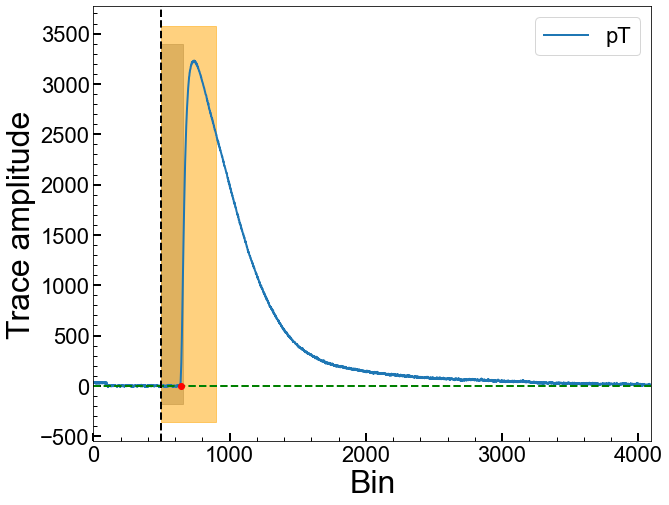

Series Number: 72209172155
Event Number: 390282
Energy: 2.716829541955 keV
Area: 746199.0616948392


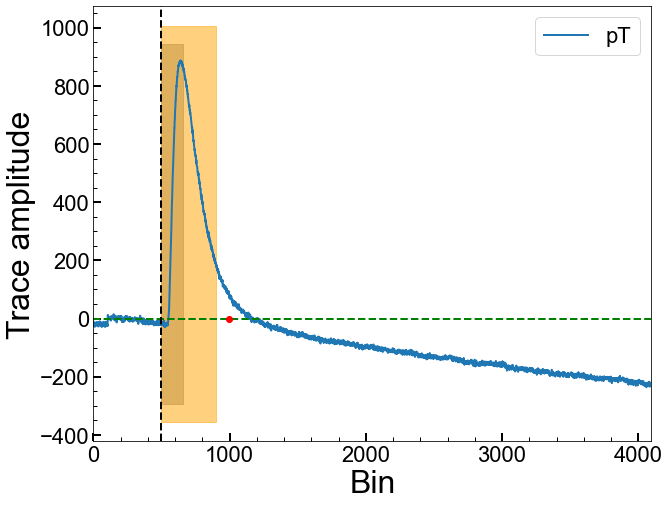

Series Number: 72209172155
Event Number: 390748
Energy: 25.14588639986 keV
Area: 281488.29256875237


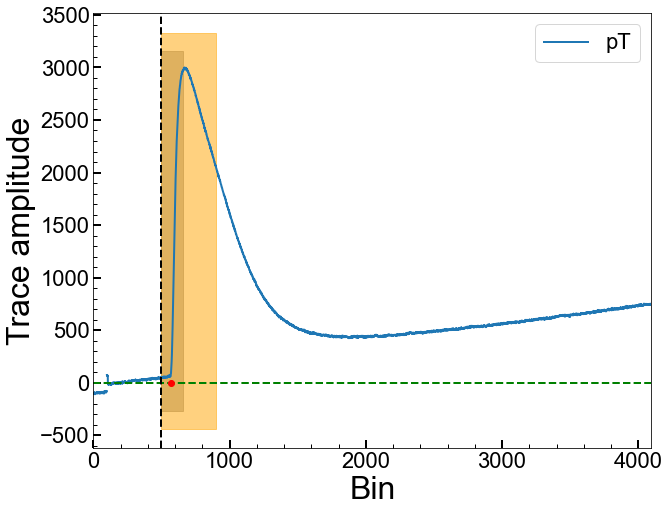

Series Number: 72209172155
Event Number: 400835
Energy: 8.707513378108 keV
Area: 270019.68030388193


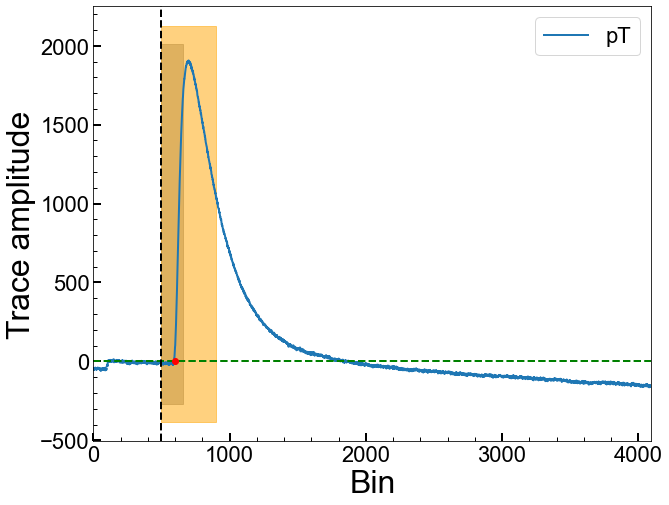

Series Number: 72209172155
Event Number: 420484
Energy: 13.31341338181 keV
Area: 415181.31649839465


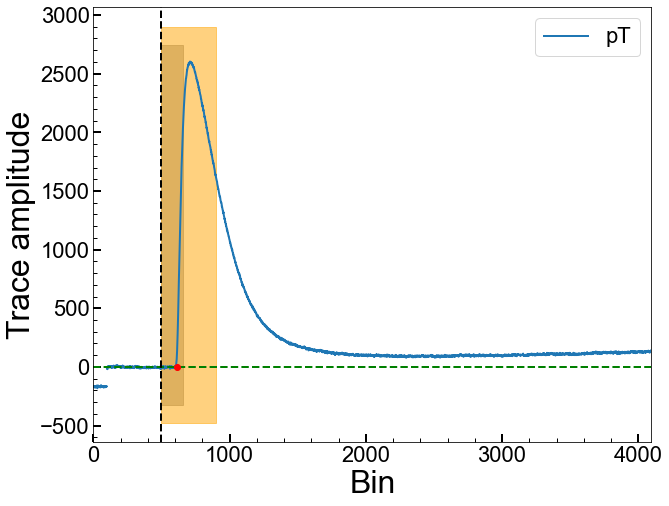

Series Number: 72209172155
Event Number: 450481
Energy: 8.454619019722 keV
Area: 331374.6017889262


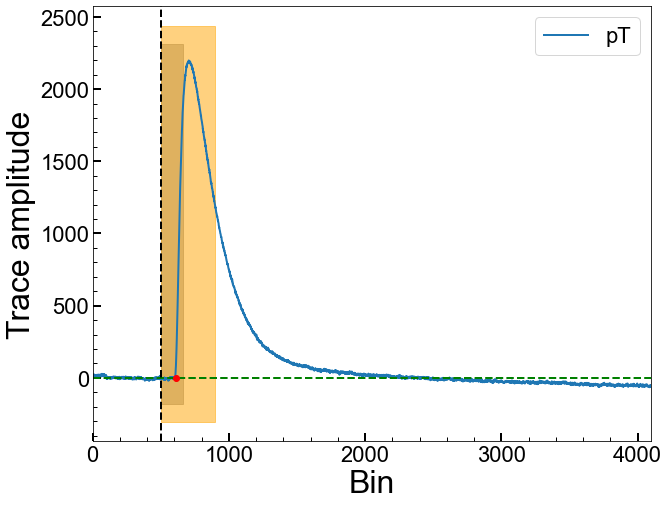

Series Number: 72209172155
Event Number: 450718
Energy: 3.793531999918 keV
Area: 132752.49652609247


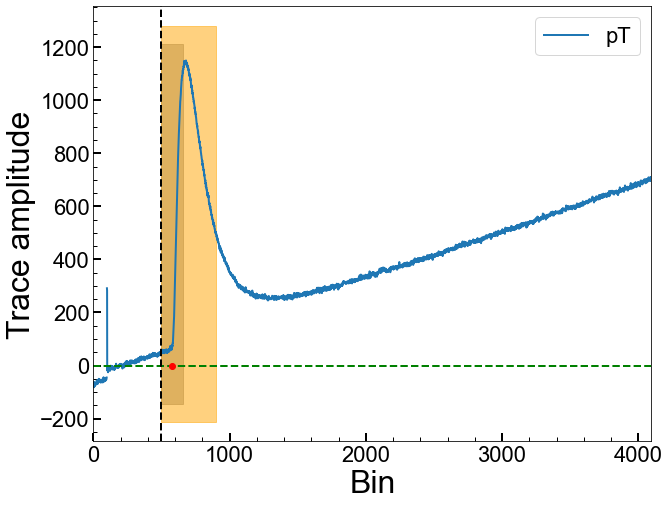

Series Number: 72209172155
Event Number: 490349
Energy: 35.31733253288 keV
Area: -4861436.850308023


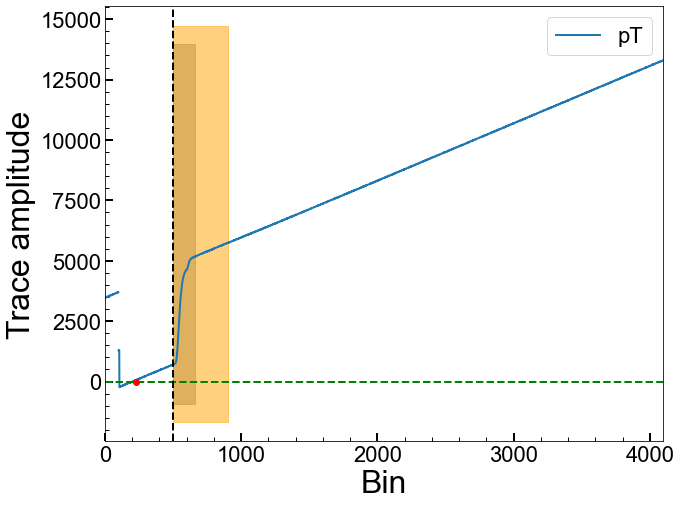

Series Number: 72209172155
Event Number: 500877
Energy: 31.24970420839 keV
Area: 649425.4390281326


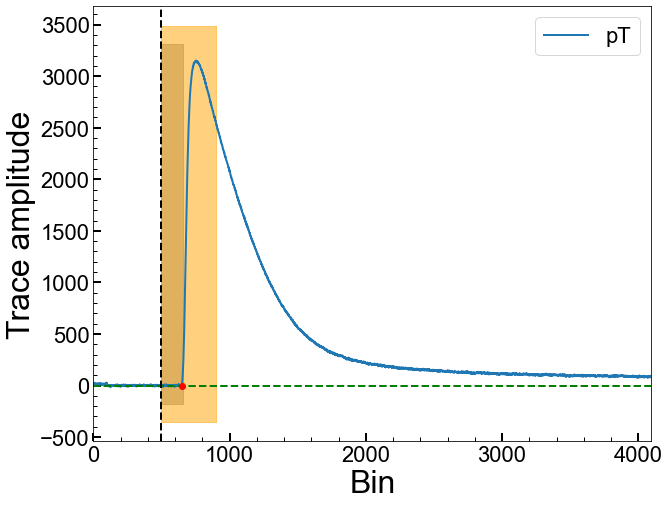

Series Number: 72209172155
Event Number: 510282
Energy: 4.258313336552 keV
Area: 169653.9265600422


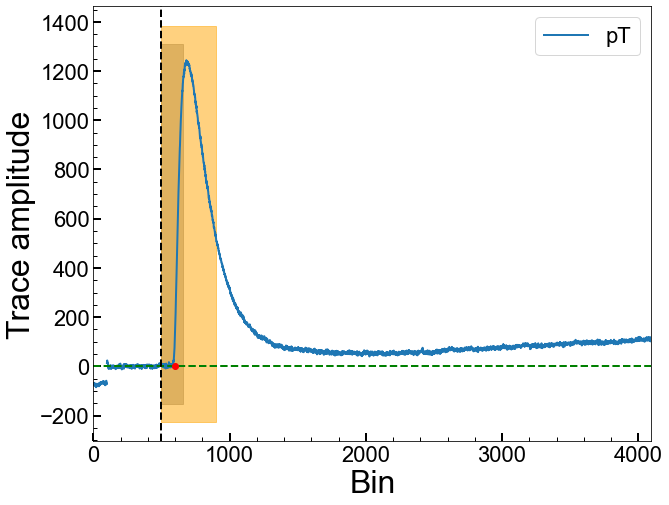

Series Number: 72209172155
Event Number: 510733
Energy: 18.94703021378 keV
Area: 49841.54903351522


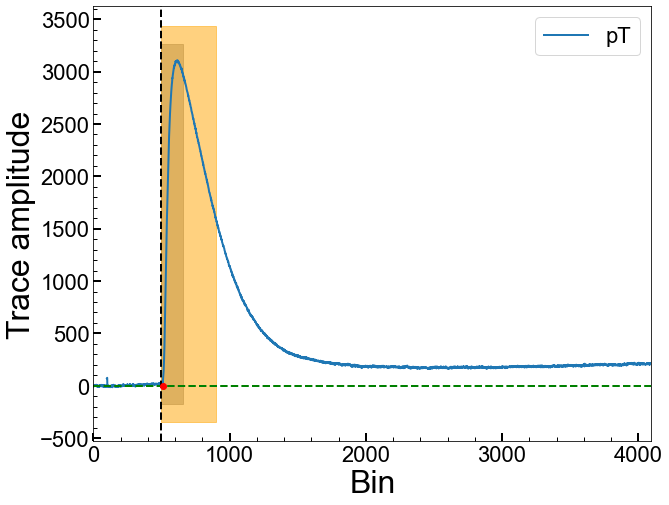

Series Number: 72209172155
Event Number: 530748
Energy: 10.37815325698 keV
Area: 406986.34694569546


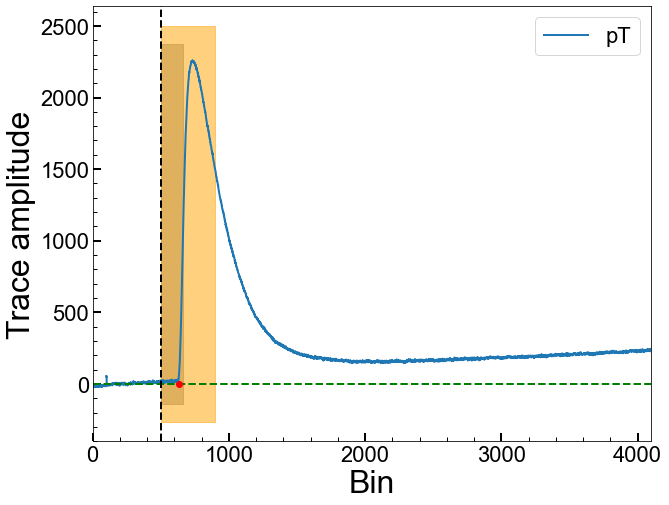

Series Number: 72209172155
Event Number: 540174
Energy: 37.95234370558 keV
Area: 104015.29028567248


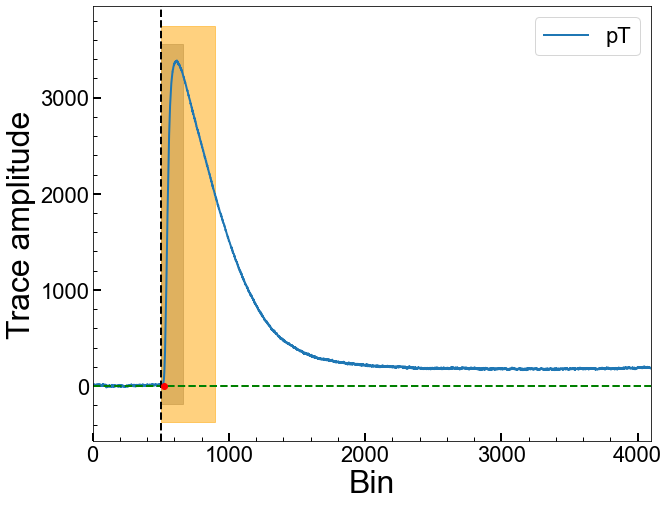

Series Number: 72209172155
Event Number: 560604
Energy: 17.29963224467 keV
Area: 379722.63860656944


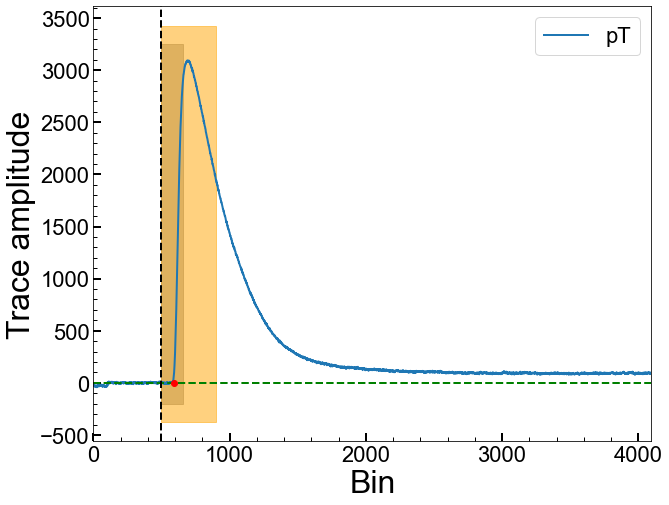

Series Number: 72209172155
Event Number: 570919
Energy: 32.74413780547 keV
Area: -845335.7717310728


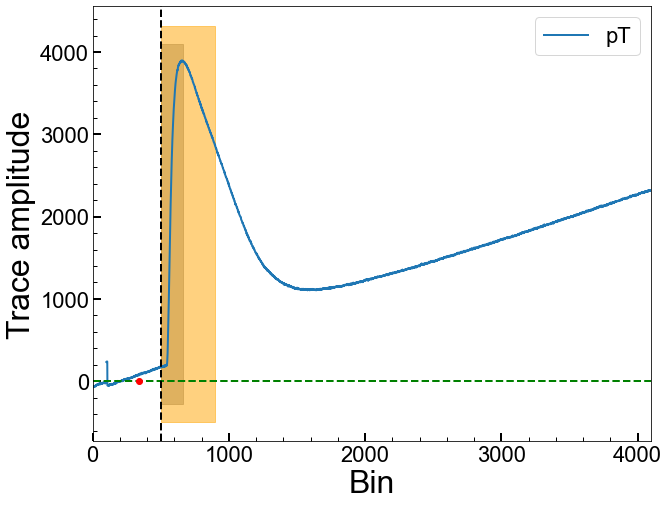

Series Number: 72209172155
Event Number: 580290
Energy: 36.29851380708 keV
Area: 572990.0847750817


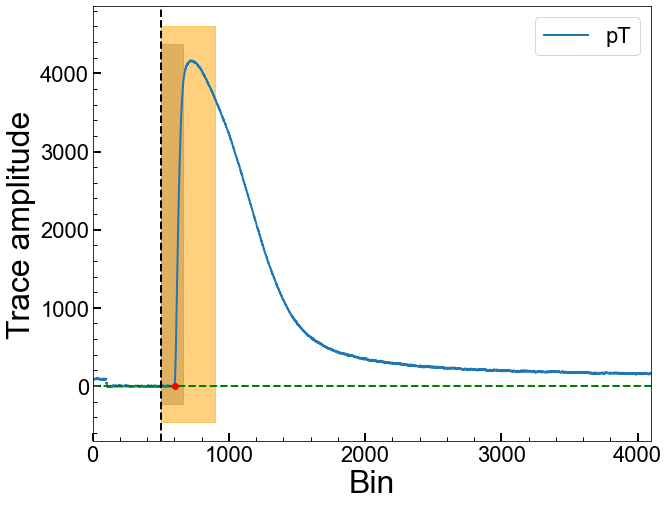

Series Number: 72209172155
Event Number: 580392
Energy: 13.57270945438 keV
Area: 194085.26352847688


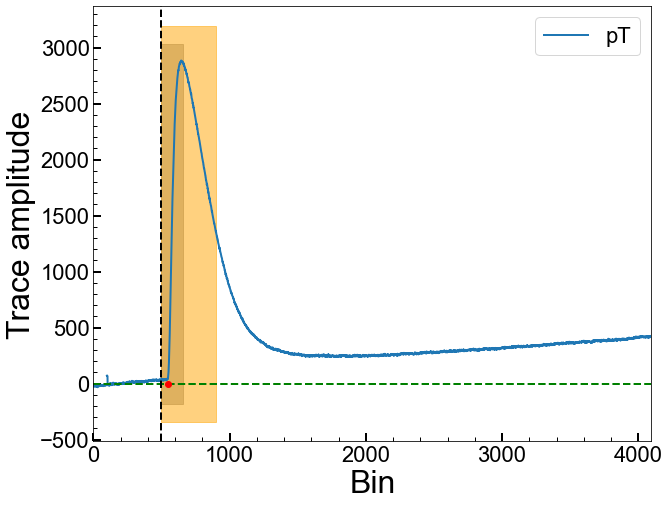

Series Number: 72209172155
Event Number: 590312
Energy: 37.82920093215 keV
Area: 642203.5321744106


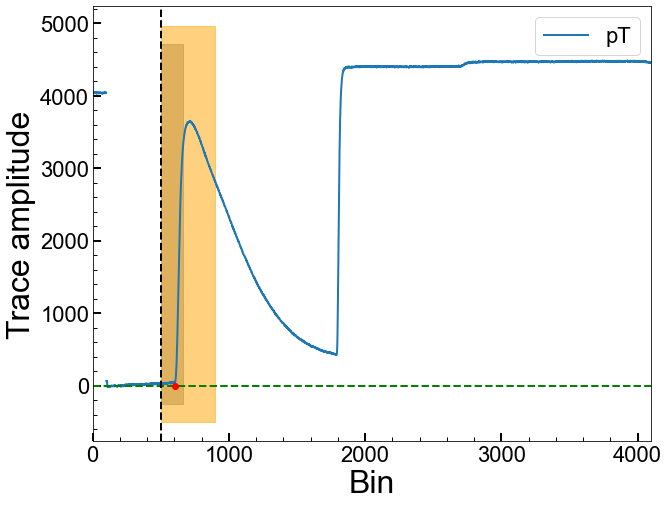

Series Number: 72209172155
Event Number: 600396
Energy: 43.01052342534 keV
Area: 476400.32234666677


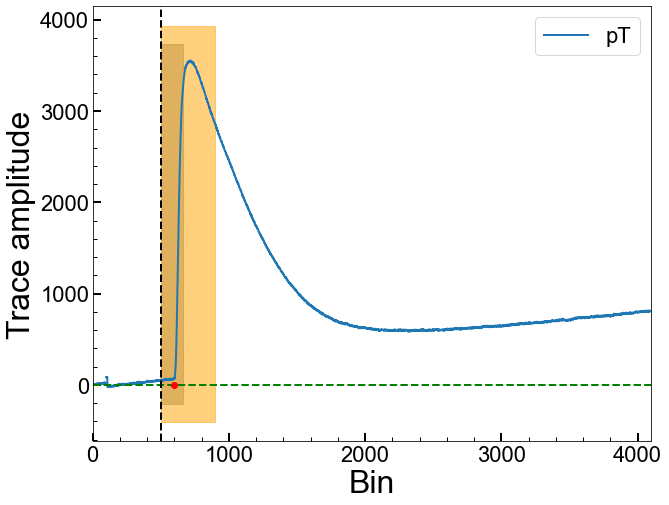

Series Number: 72209172155
Event Number: 600457
Energy: 9.962835126439 keV
Area: 340108.7124987549


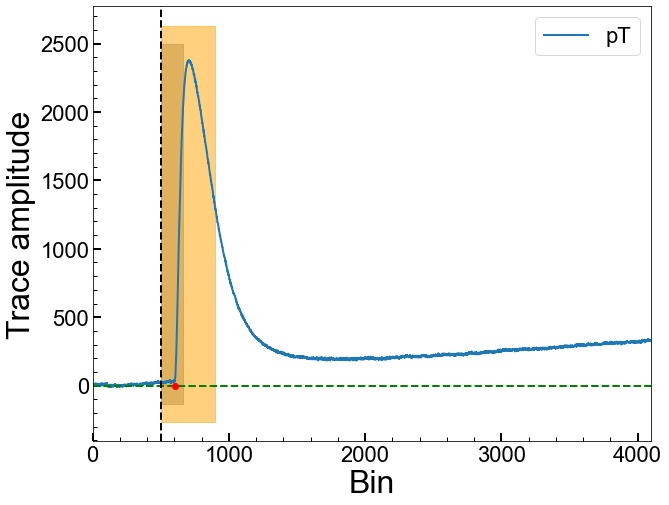

Series Number: 72209172155
Event Number: 660045
Energy: 8.688100754834 keV
Area: 162189.73591350834


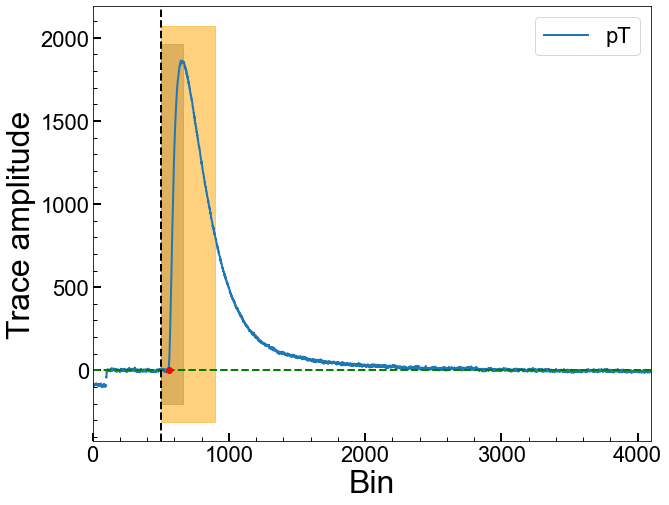

Series Number: 72209172155
Event Number: 660482
Energy: 45.38595686676 keV
Area: 214743.9096947992


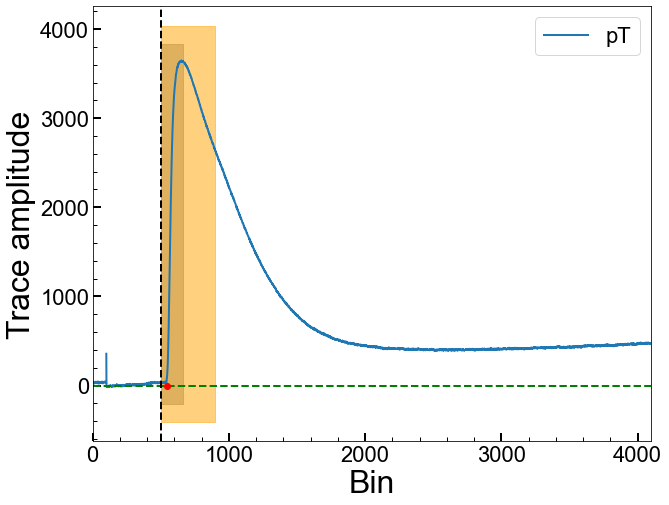

Series Number: 72209172155
Event Number: 700565
Energy: 26.45558111816 keV
Area: 463813.14422103297


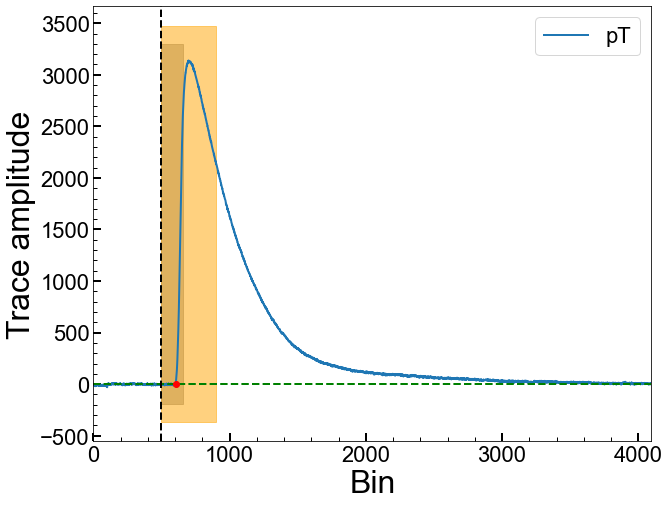

Series Number: 72209172155
Event Number: 710108
Energy: 41.97432192307 keV
Area: 565481.2832395409


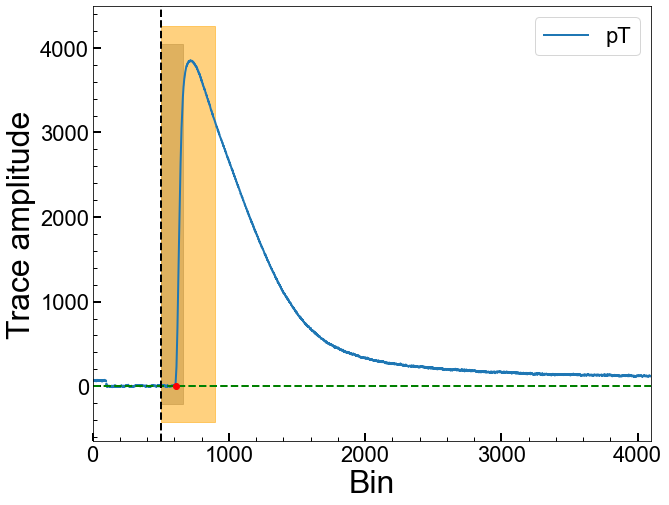

Series Number: 72209172155
Event Number: 710383
Energy: 31.27584991062 keV
Area: 500199.48763502203


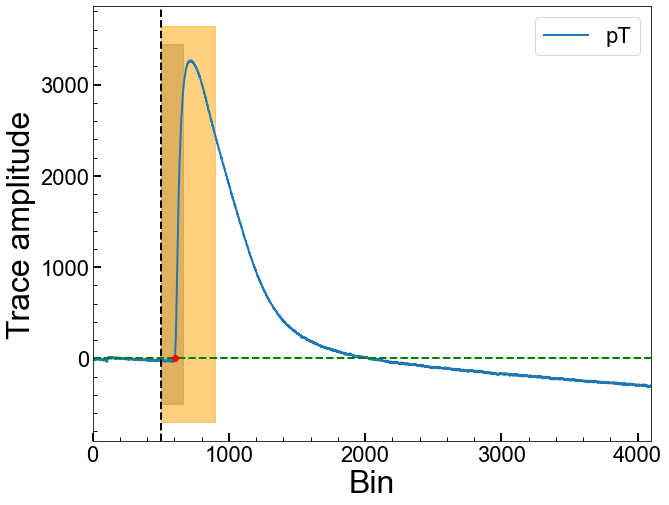

Series Number: 72209172155
Event Number: 720047
Energy: 48.2761034771 keV
Area: -512073.7330059125


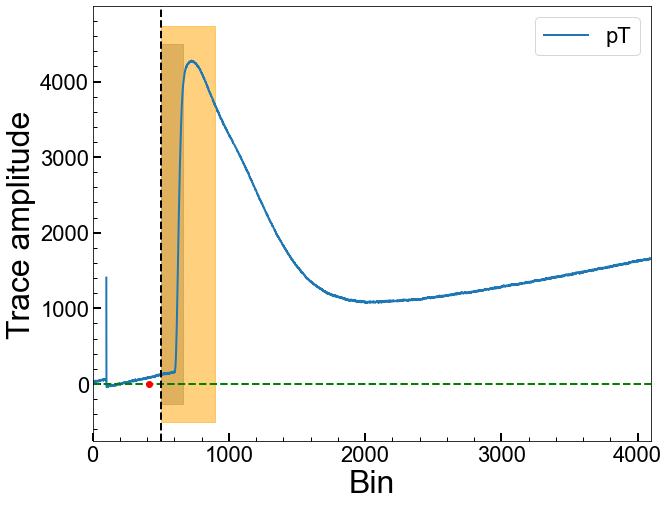

Series Number: 72209172155
Event Number: 720097
Energy: 36.32154836292 keV
Area: 481033.1934521647


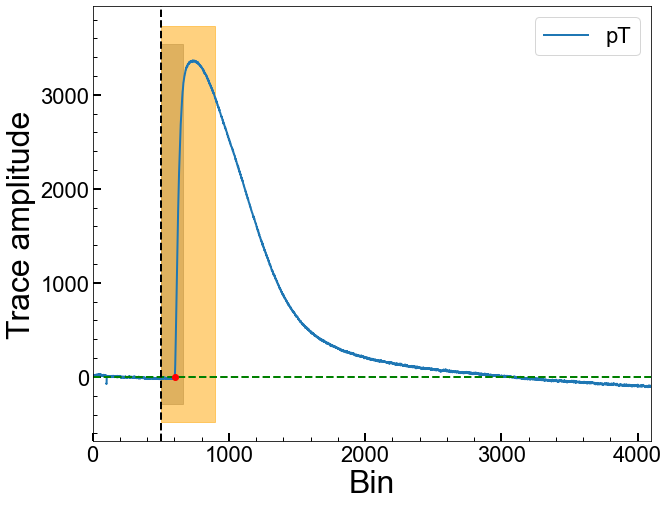

Series Number: 72209172155
Event Number: 790005
Energy: 26.9913653851 keV
Area: 89004.37405986755


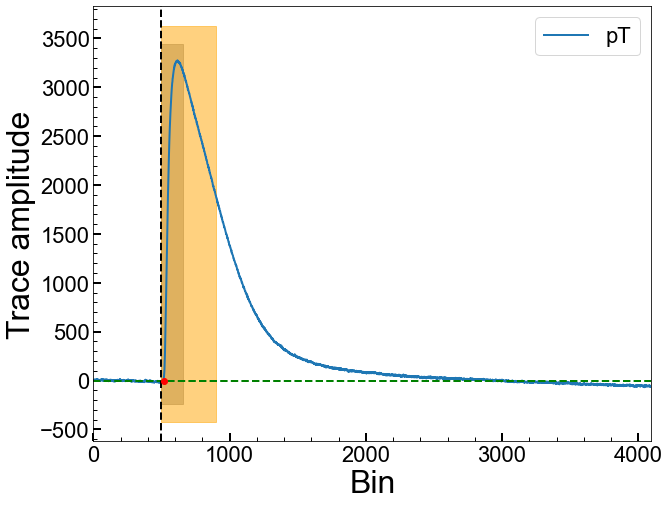

Series Number: 72209172155
Event Number: 790154
Energy: 25.1404522599 keV
Area: 150986.41026649004


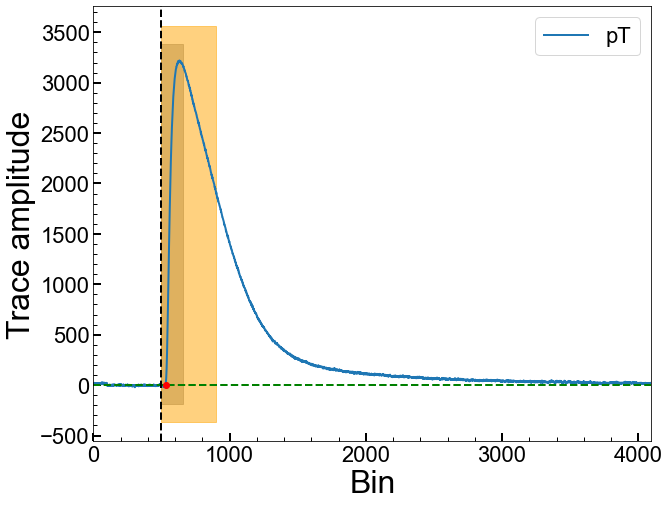

Series Number: 72209172155
Event Number: 820864
Energy: 37.00481460555 keV
Area: 458807.06925744104


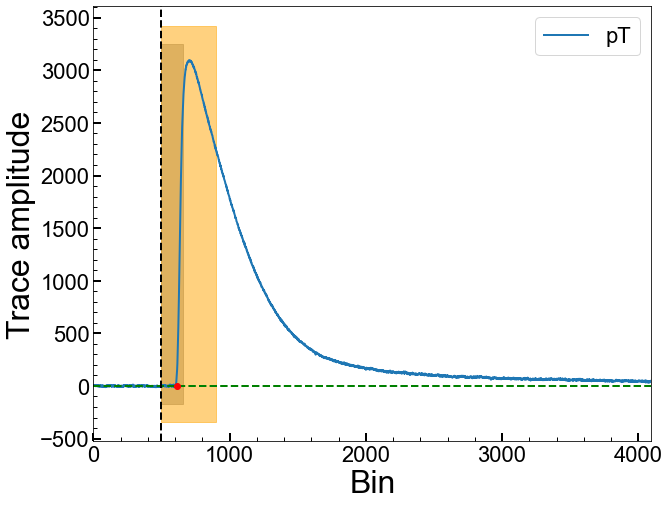

Series Number: 72209172155
Event Number: 840155
Energy: 15.10959814096 keV
Area: 317408.50829794246


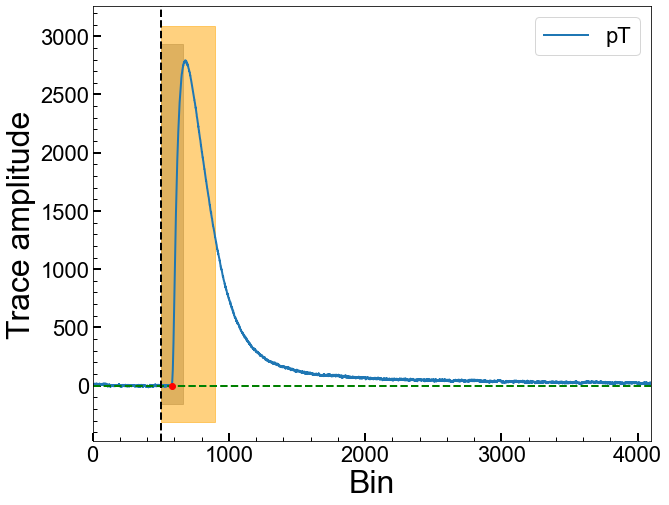

Series Number: 72209172155
Event Number: 840206
Energy: 27.98300728823 keV
Area: 94622.13489176164


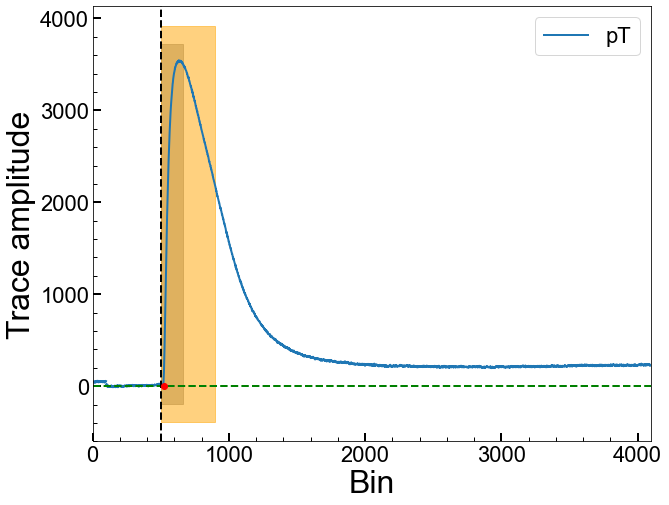

Series Number: 72209172155
Event Number: 840752
Energy: 42.9888479141 keV
Area: 198280.78487802917


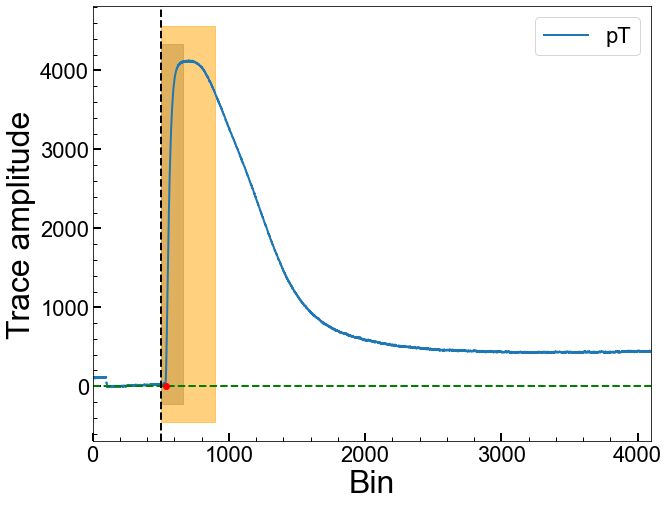

Series Number: 72209172155
Event Number: 850204
Energy: 46.0506657719 keV
Area: 566498.0754504902


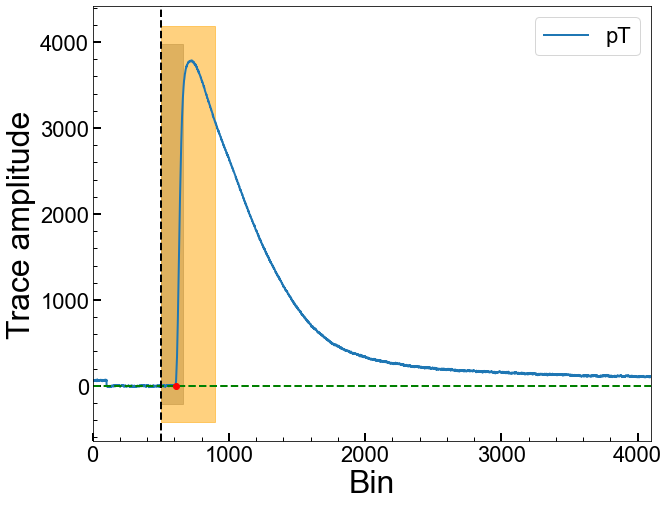

Series Number: 72209172155
Event Number: 850272
Energy: 7.281851121737 keV
Area: 302882.6413892661


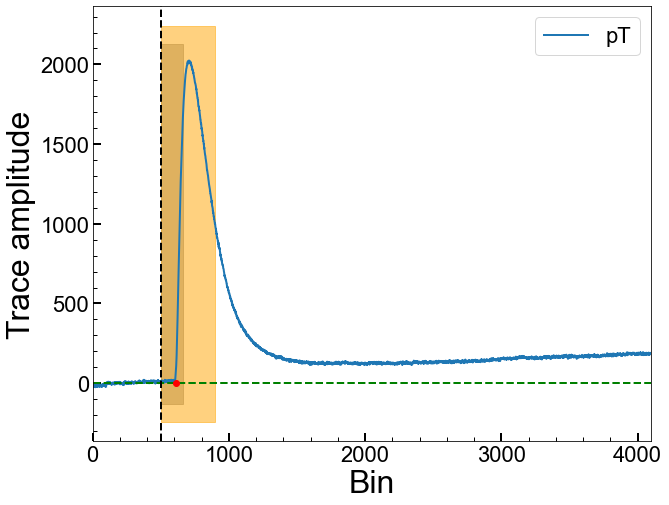

Series Number: 72209172155
Event Number: 850431
Energy: 28.75241906396 keV
Area: 103949.81366048563


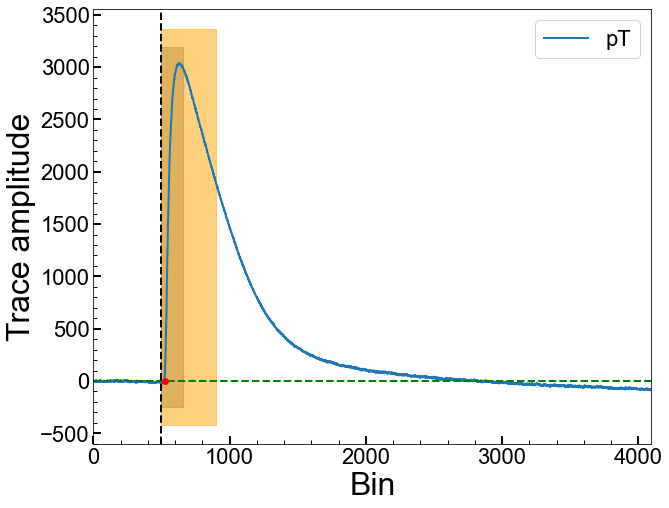

Series Number: 72209172155
Event Number: 850699
Energy: 16.86391356499 keV
Area: -497222.0176466231


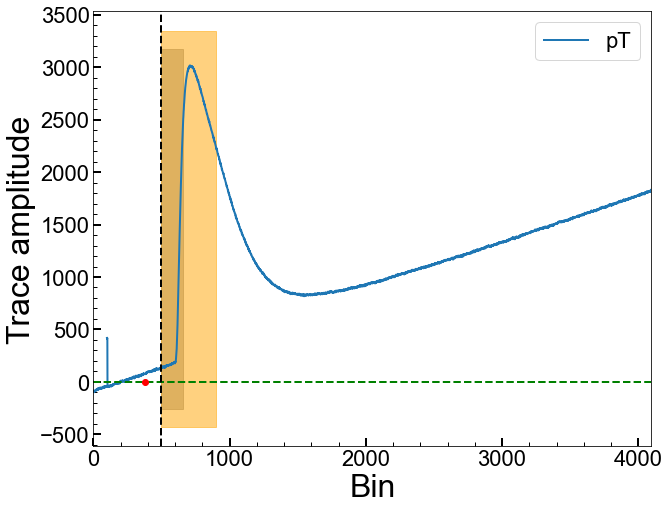

Series Number: 72209172155
Event Number: 850781
Energy: 41.16090138629 keV
Area: 498497.448696318


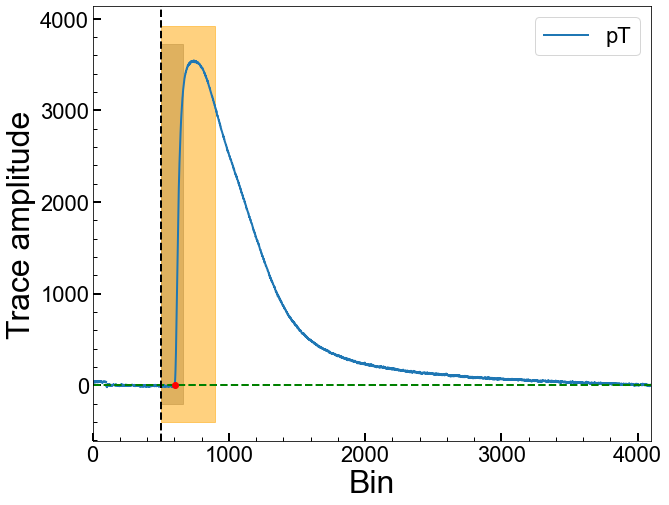

Series Number: 72209172155
Event Number: 860773
Energy: 16.73327971704 keV
Area: 760254.6417535009


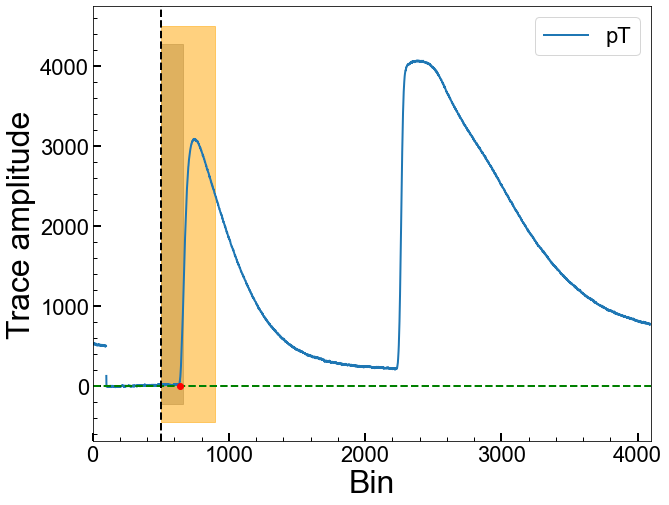

Series Number: 72209172155
Event Number: 900575
Energy: 9.339626117881 keV
Area: -2629903.9745973856


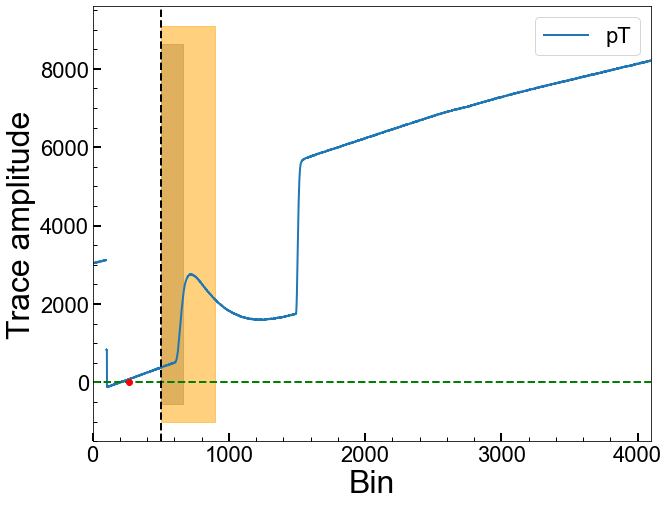

Series Number: 72209172155
Event Number: 910514
Energy: 32.52750659739 keV
Area: 772630.3393776002


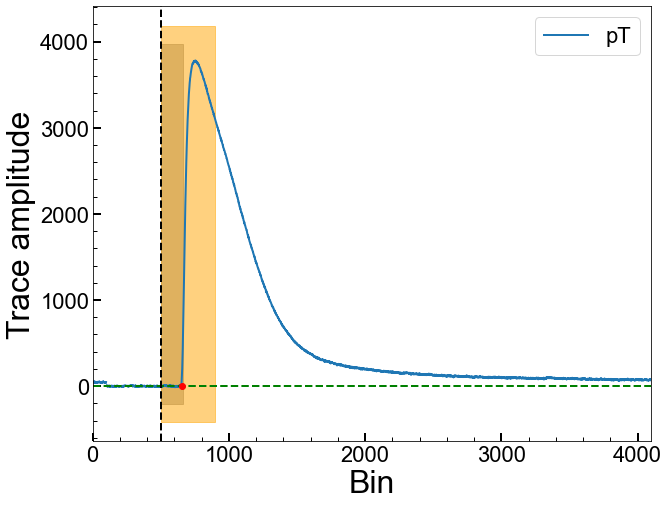

Series Number: 72209172155
Event Number: 920139
Energy: 17.08536336624 keV
Area: 596736.6336648477


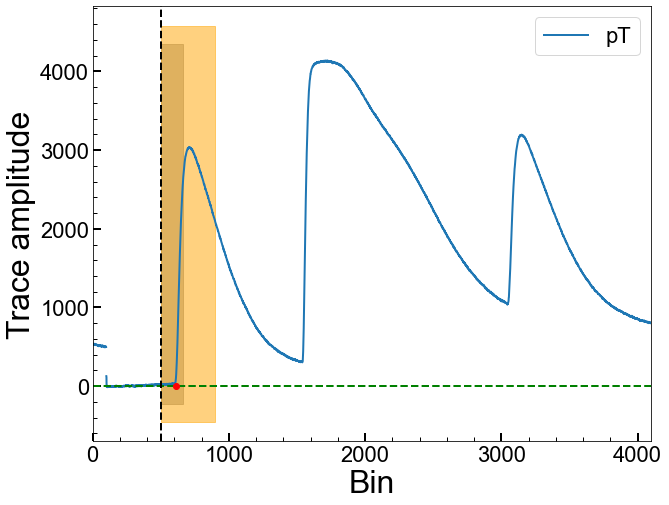

Series Number: 72209172155
Event Number: 920737
Energy: 27.45902488549 keV
Area: -2136950.662681272


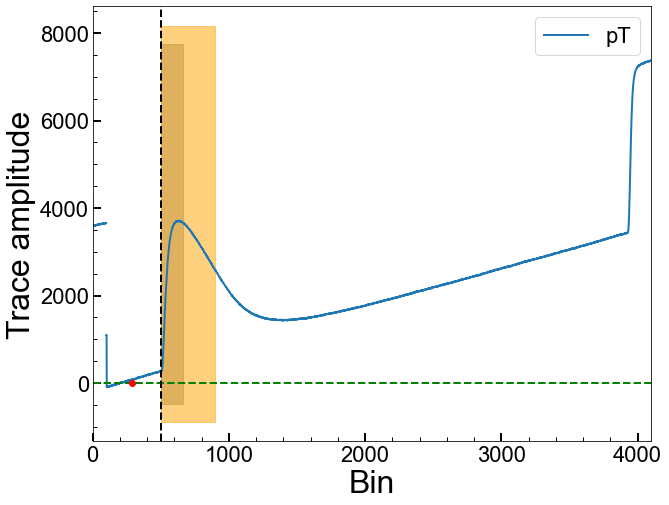

Series Number: 72209172155
Event Number: 930223
Energy: 10.94613724538 keV
Area: 349594.178159513


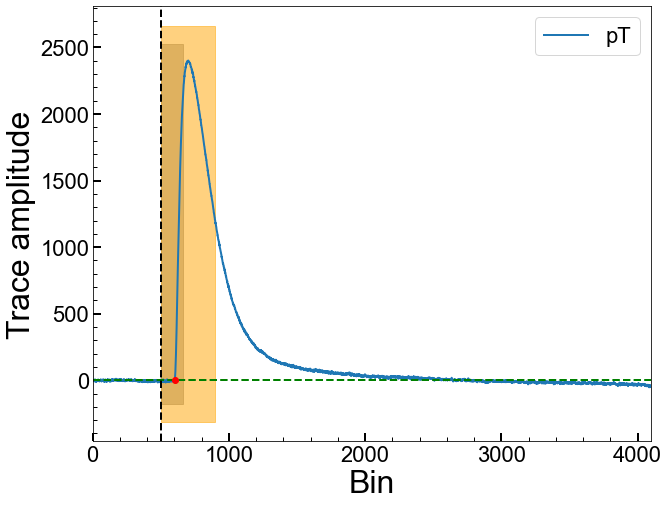

Series Number: 72209172155
Event Number: 950727
Energy: 3.836637441358 keV
Area: 136389.67917370415


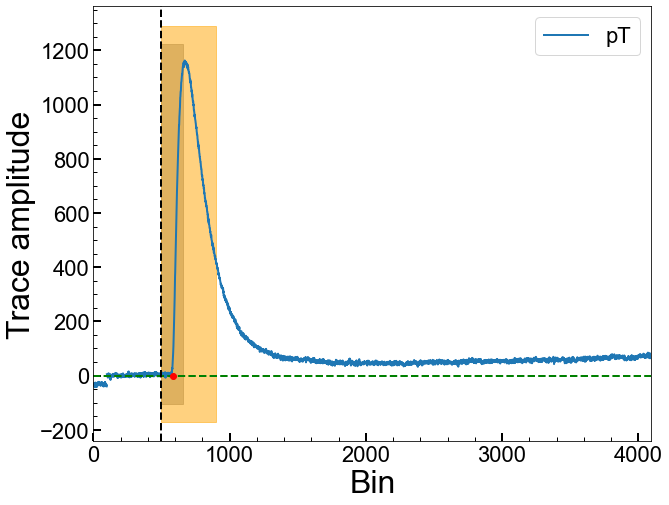

Series Number: 72209172155
Event Number: 1030030
Energy: 25.19885498542 keV
Area: 166810.38357571384


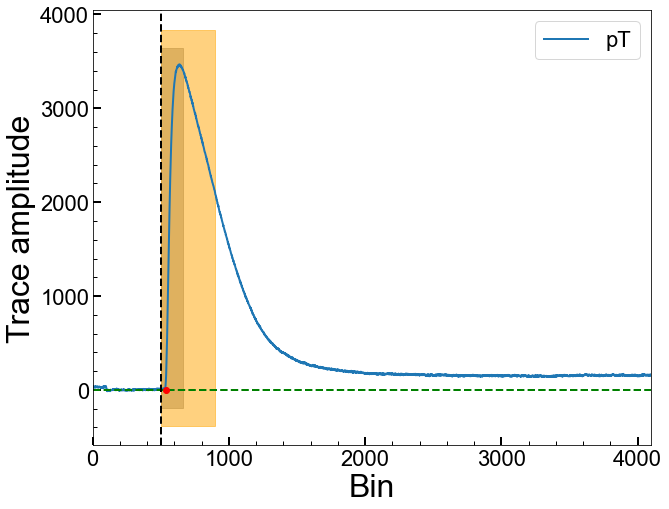

Series Number: 72209172155
Event Number: 1070400
Energy: 16.55916777575 keV
Area: 445682.97570754925


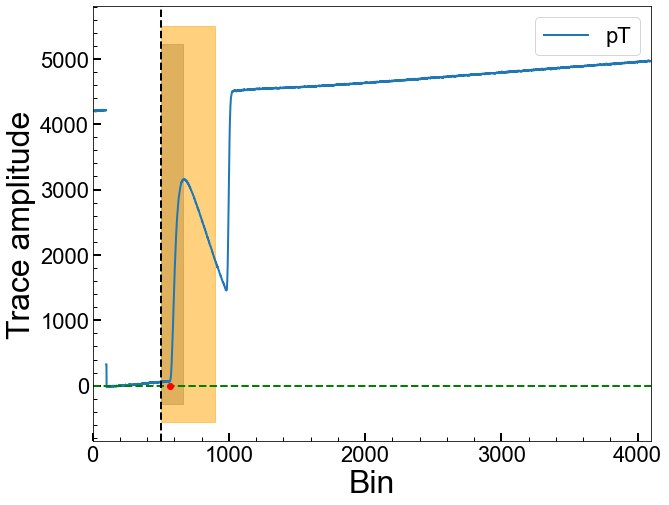

Series Number: 72209172155
Event Number: 1080099
Energy: 47.54789366116 keV
Area: -951456.2588292714


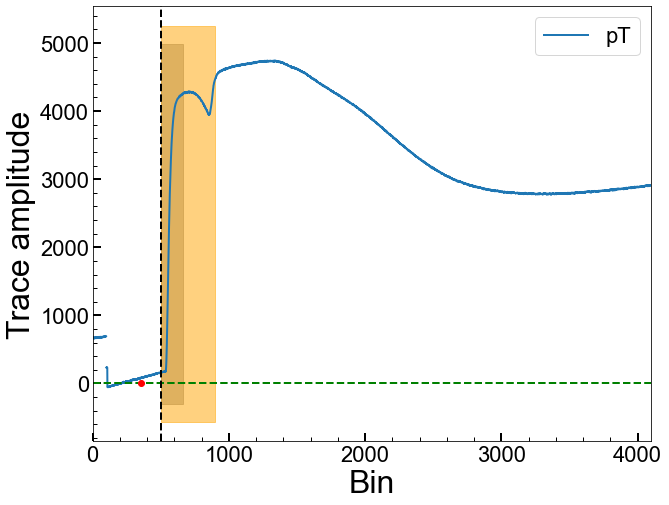

Series Number: 72209172155
Event Number: 1100425
Energy: 31.54692581954 keV
Area: 592468.811076636


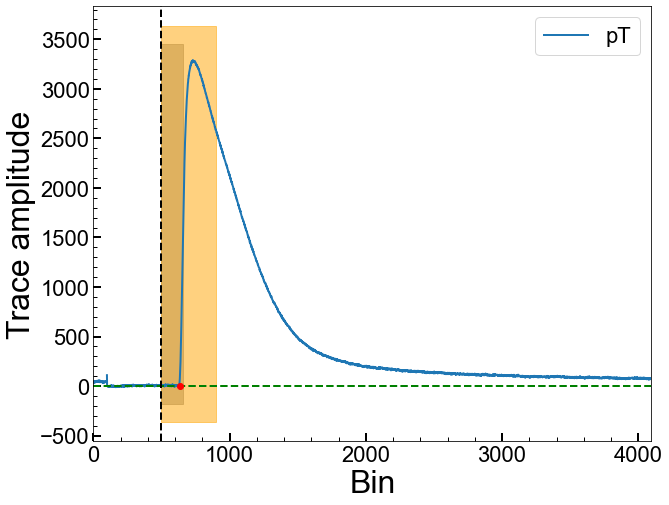

Series Number: 72209172155
Event Number: 1120491
Energy: 16.26302830368 keV
Area: 569200.2717374604


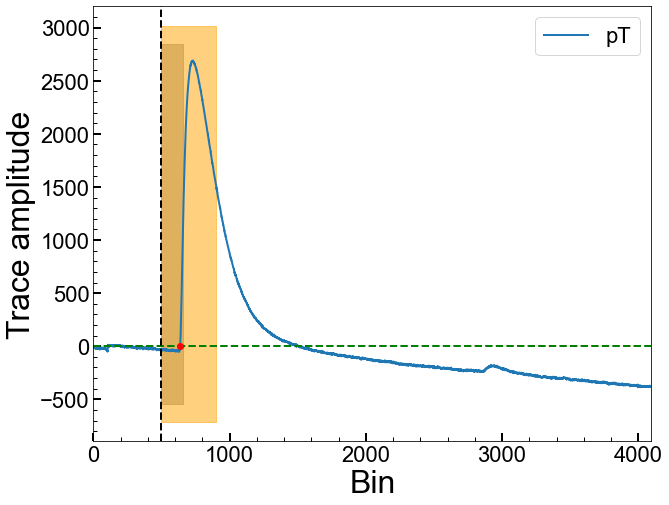

Series Number: 72209172155
Event Number: 1160339
Energy: 35.59360274776 keV
Area: 534670.5296177837


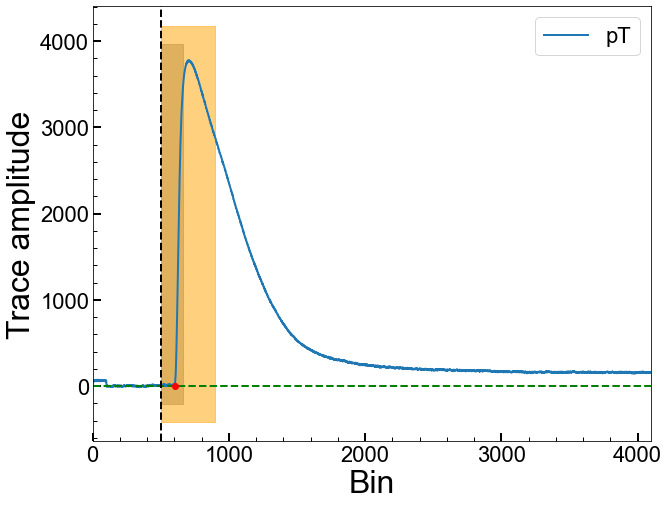

Series Number: 72209172155
Event Number: 1210218
Energy: 36.36573567901 keV
Area: 521025.8596729077


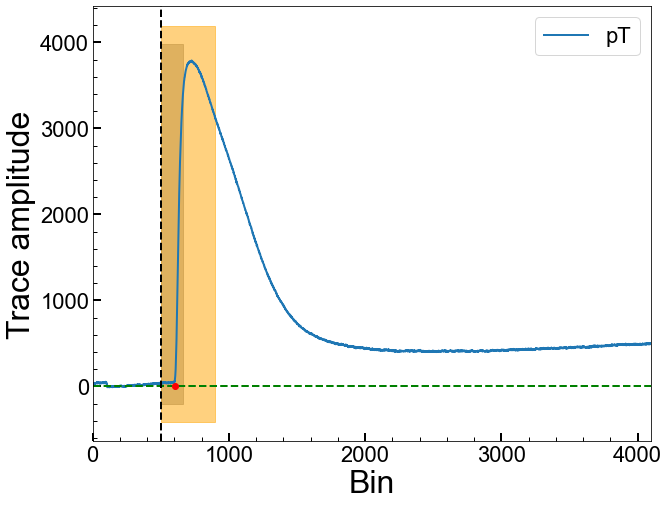

Series Number: 72209172155
Event Number: 1290044
Energy: 37.86060064076 keV
Area: 131297.2821058013


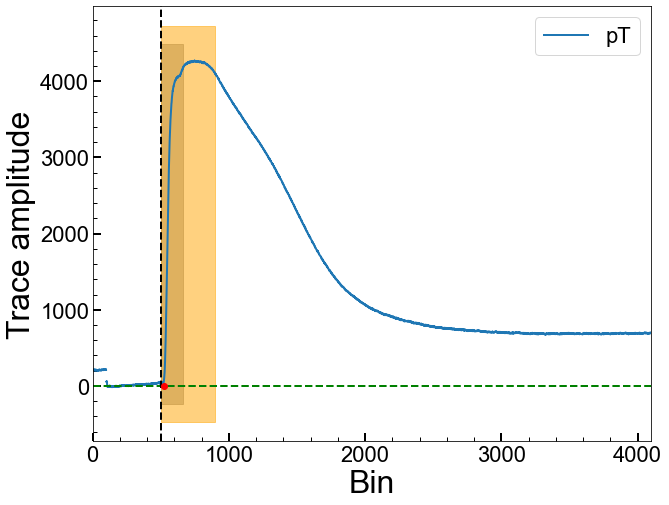

Series Number: 72209172155
Event Number: 1310340
Energy: 2.728083669261 keV
Area: 205116.38343412007


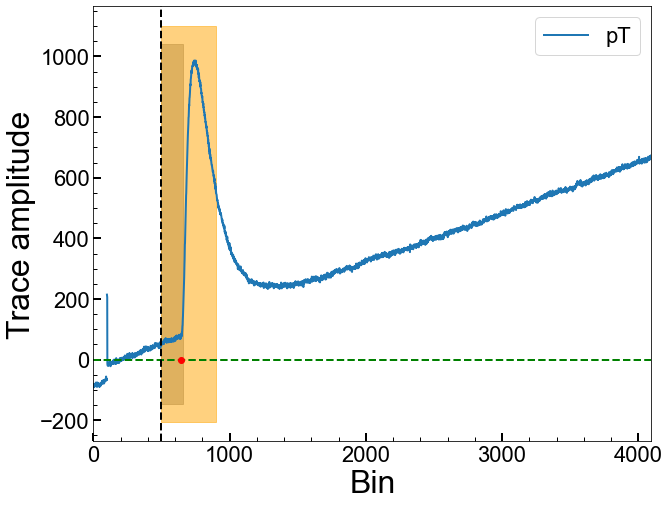

Series Number: 72209172155
Event Number: 1400829
Energy: 5.200052444499 keV
Area: 59588.04661343031


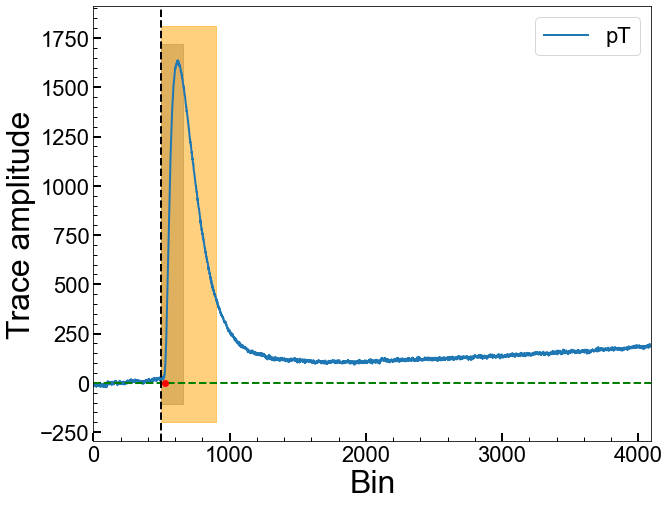

Series Number: 72209172155
Event Number: 1410411
Energy: 39.91775544411 keV
Area: 34267.82267914173


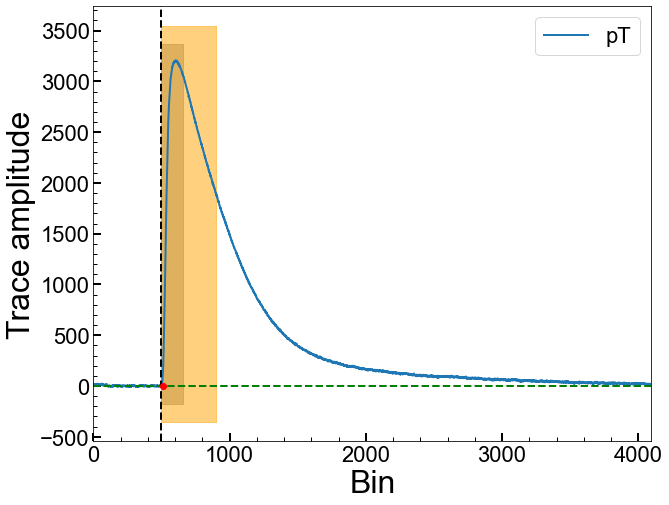

Series Number: 72209172155
Event Number: 1420286
Energy: 30.2315476711 keV
Area: 504802.6099256158


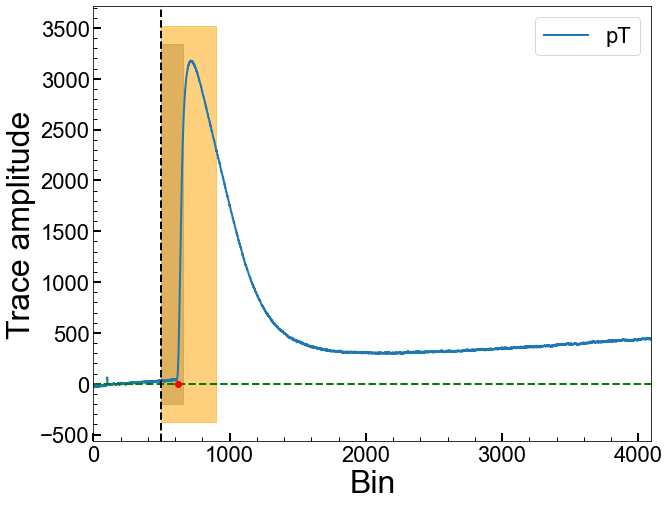

Series Number: 72209172155
Event Number: 1460103
Energy: 2.144145235773 keV
Area: 173280.7979994264


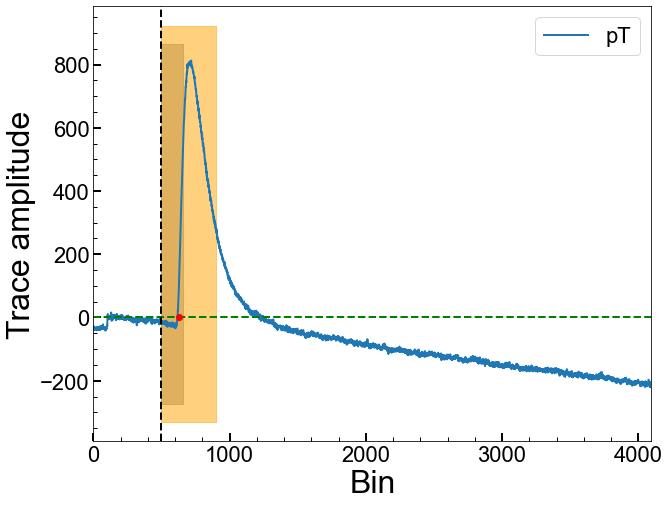

Series Number: 72209172155
Event Number: 1500247
Energy: 15.63828731454 keV
Area: 75325.92674564235


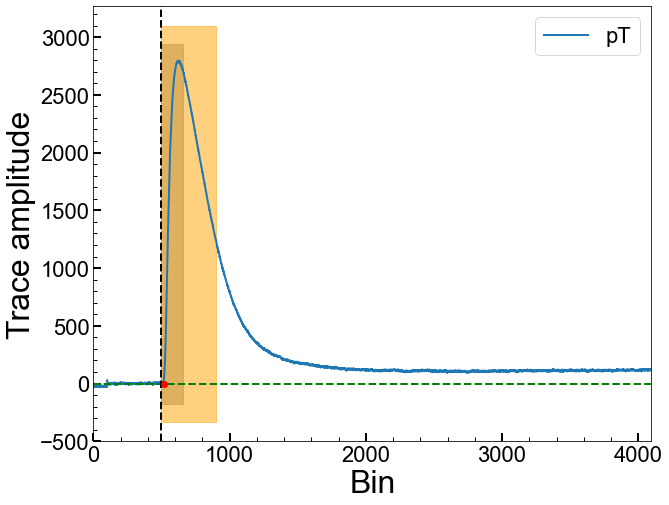

Series Number: 72209172155
Event Number: 1500583
Energy: 14.13153393868 keV
Area: -1988725.769257431


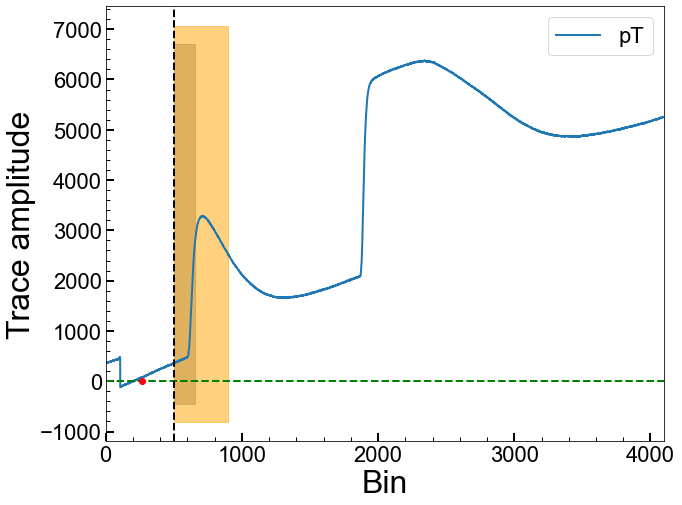

Series Number: 72209172155
Event Number: 1550508
Energy: 33.27898457197 keV
Area: -995833.4403959382


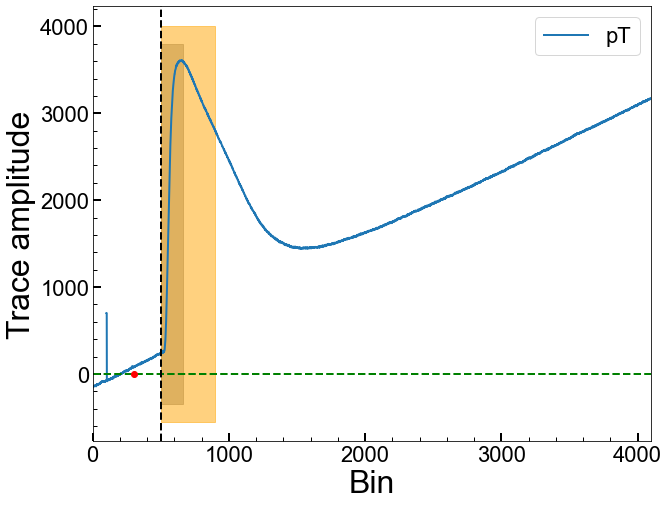

Series Number: 72209172155
Event Number: 1560477
Energy: 27.17620254857 keV
Area: 233719.31231131137


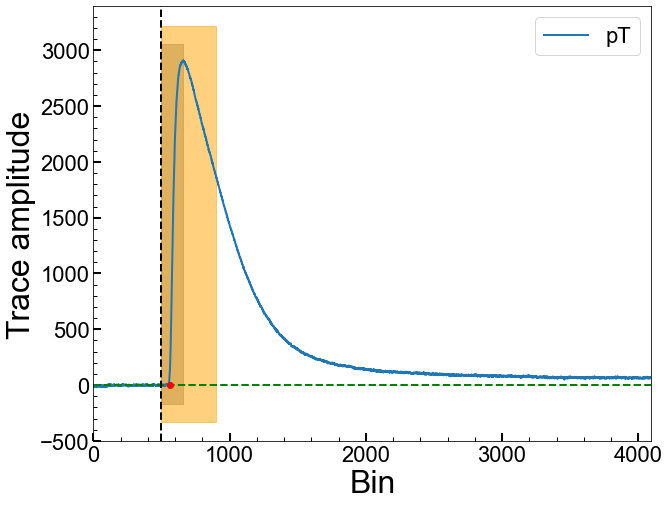

Series Number: 72209172155
Event Number: 1570651
Energy: 16.31174199425 keV
Area: 268265.39120608213


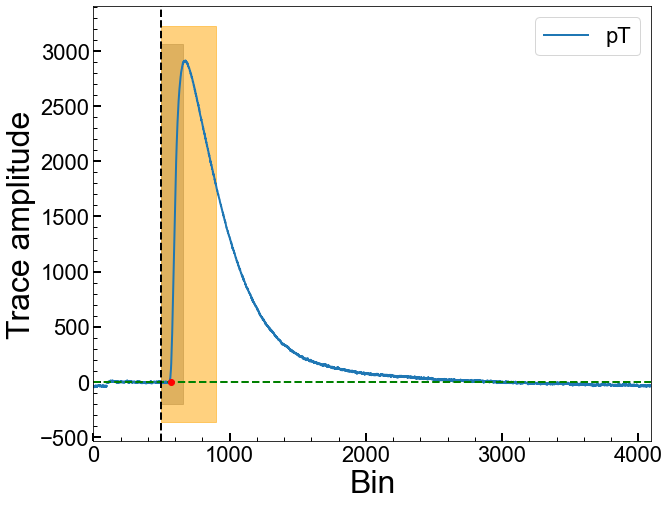

Series Number: 72209172155
Event Number: 1610285
Energy: 33.9605452615 keV
Area: 461890.40369271545


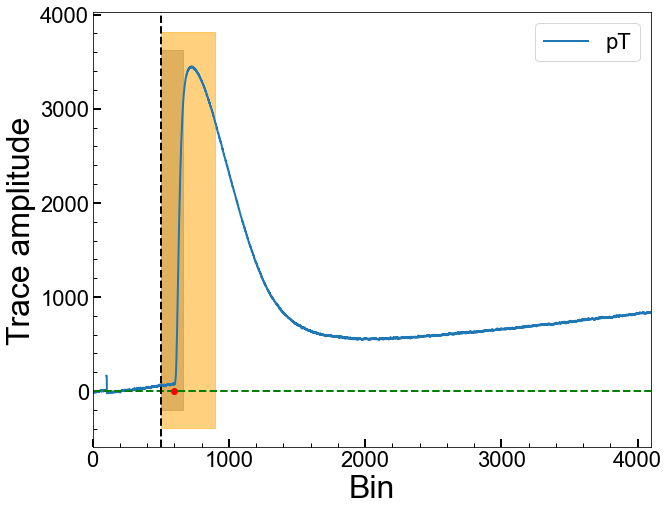

Series Number: 72209172155
Event Number: 1620121
Energy: 16.72321620183 keV
Area: 296002.2033059884


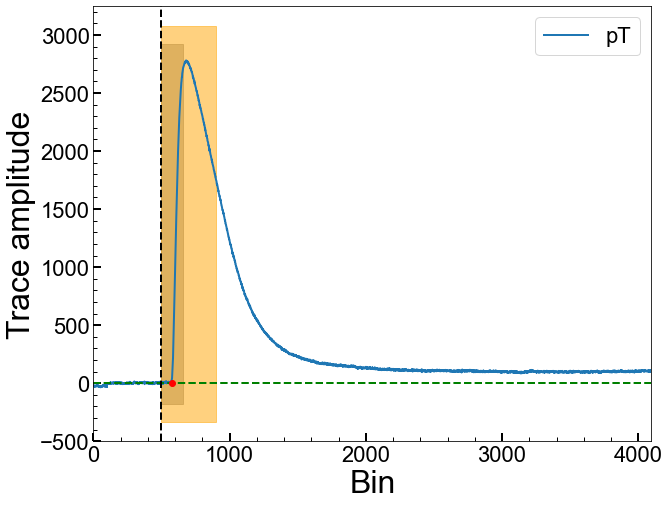

Series Number: 72209172155
Event Number: 1620220
Energy: 20.27473855234 keV
Area: 420461.3303014569


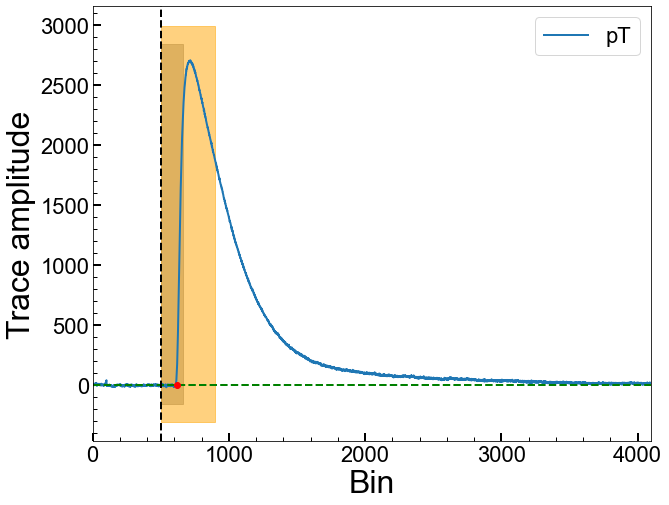

Series Number: 72209172155
Event Number: 1620472
Energy: 16.82356516957 keV
Area: 83217.14875660931


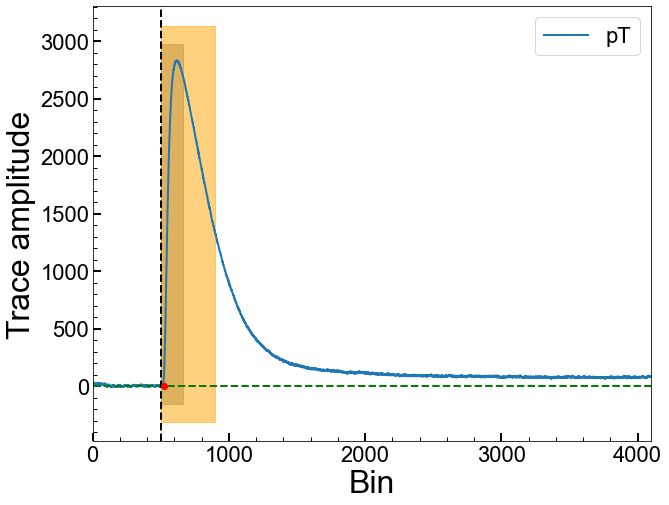

Series Number: 72209172155
Event Number: 1620841
Energy: 11.16079937875 keV
Area: -763924.0898014756


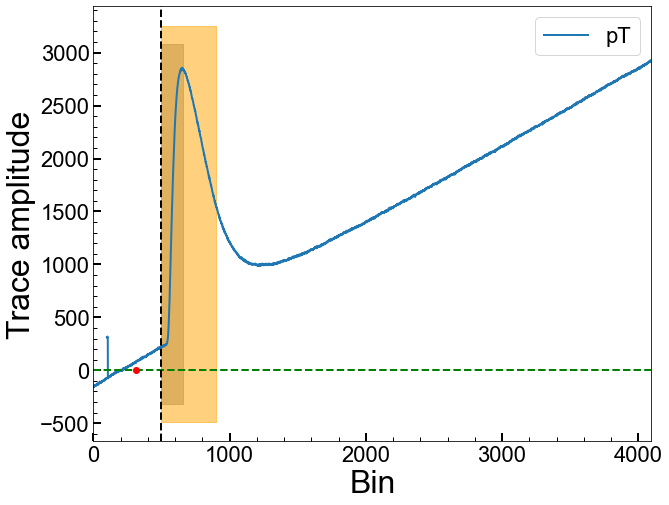

Series Number: 72209172155
Event Number: 1780569
Energy: 25.32308770198 keV
Area: 516611.0288245825


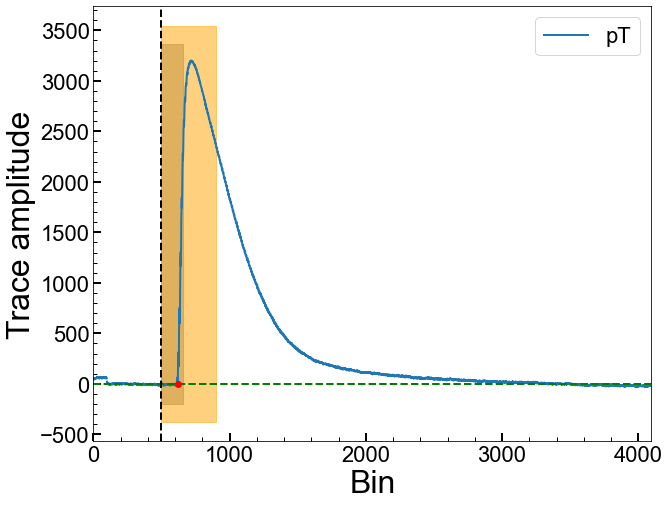

Series Number: 72209172155
Event Number: 1790139
Energy: 10.21561116398 keV
Area: 357671.2709674174


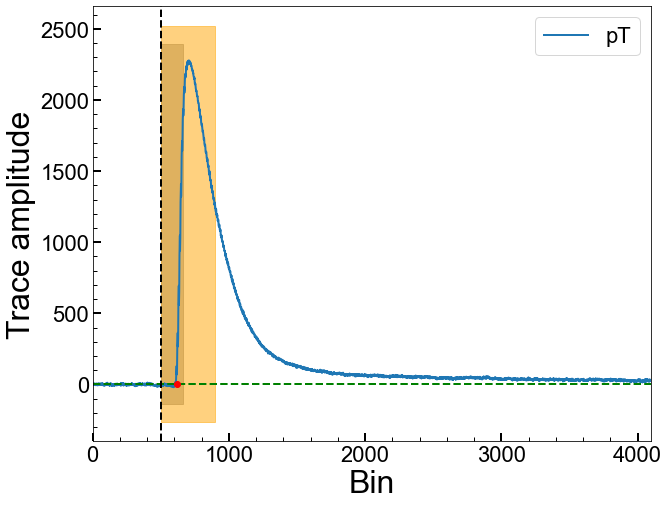

Series Number: 72209172155
Event Number: 1790263
Energy: 49.60665548169 keV
Area: 657043.7203191735


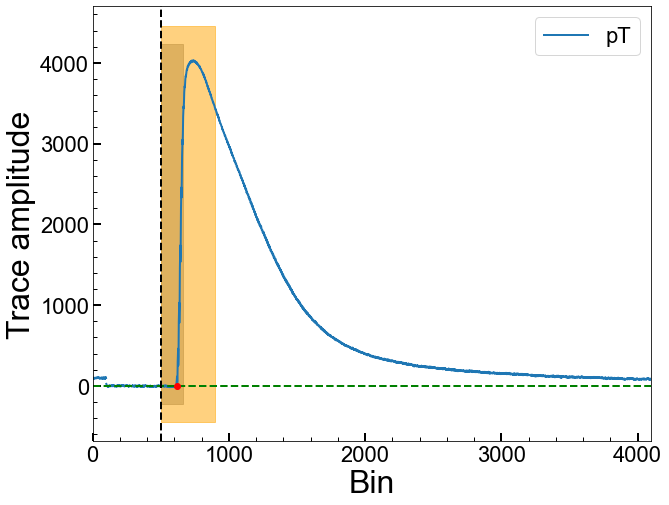

Series Number: 72209172155
Event Number: 1810427
Energy: 16.98270383101 keV
Area: 405045.18516582786


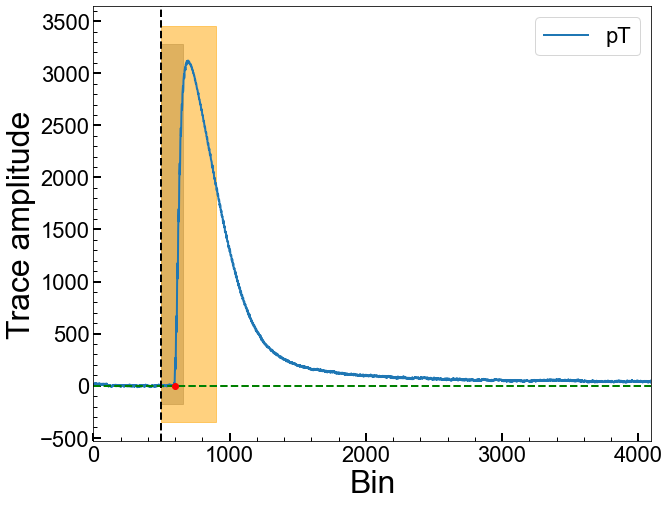

Series Number: 72209172155
Event Number: 1820924
Energy: 18.27373501658 keV
Area: 454960.08667766926


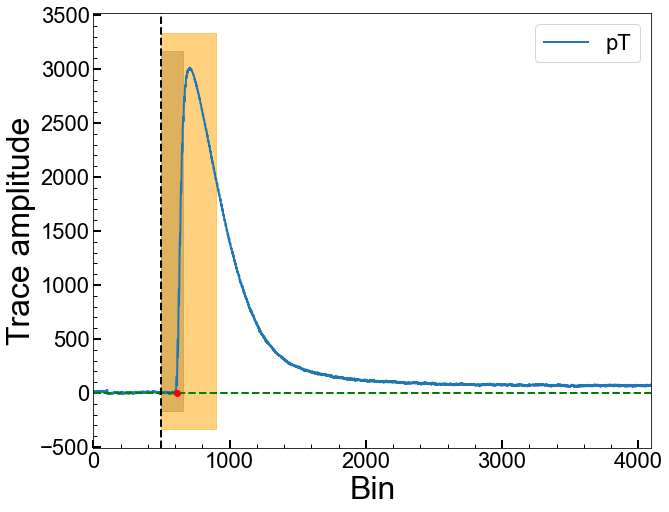

Series Number: 72209172155
Event Number: 1840053
Energy: 35.85306069665 keV
Area: 521351.1900689392


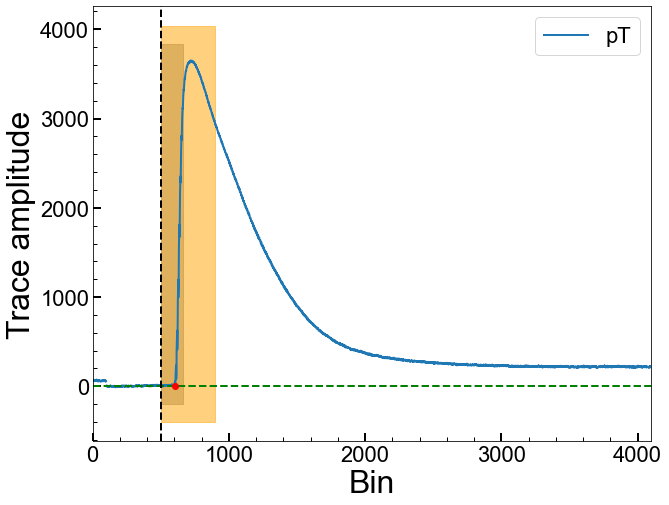

Series Number: 72209172155
Event Number: 1870008
Energy: 4.750556877943 keV
Area: -4738307.237890698


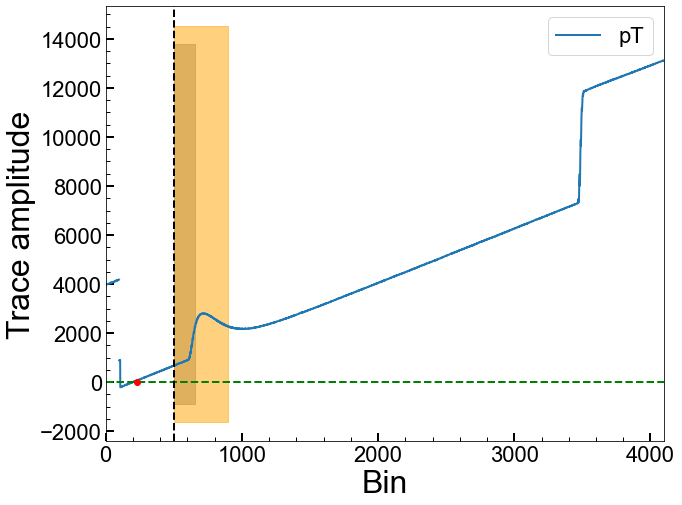

Series Number: 72209172155
Event Number: 1870406
Energy: 34.34842297869 keV
Area: 520182.85670431604


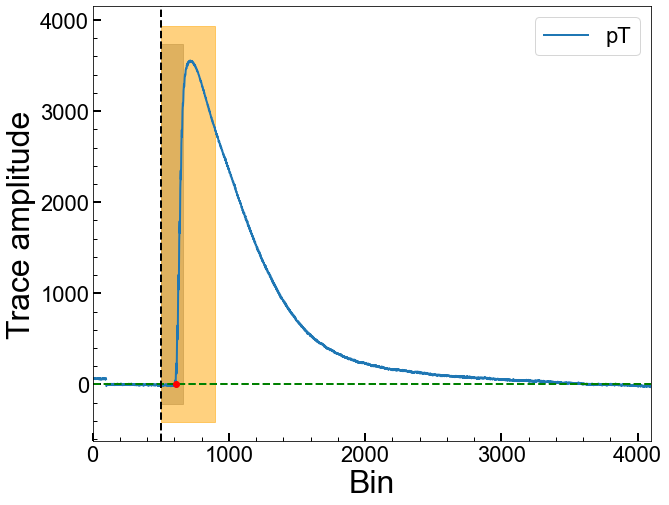

Series Number: 72209172155
Event Number: 1900777
Energy: 27.52479282058 keV
Area: 644247.5459479735


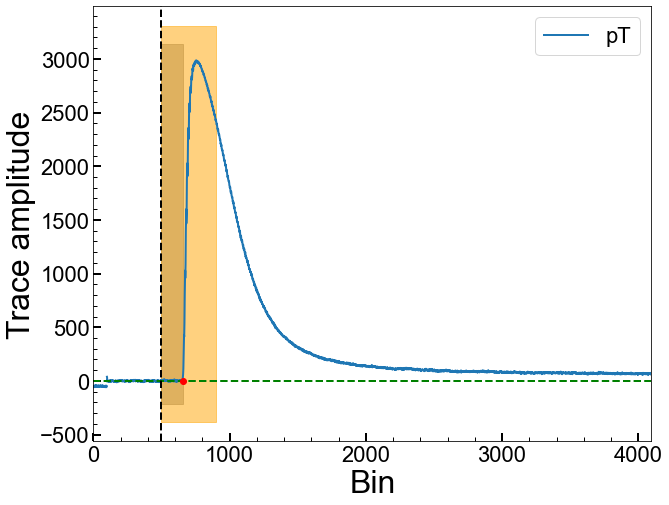

Series Number: 72209172155
Event Number: 1990091
Energy: 10.78949139433 keV
Area: 360762.77001172607


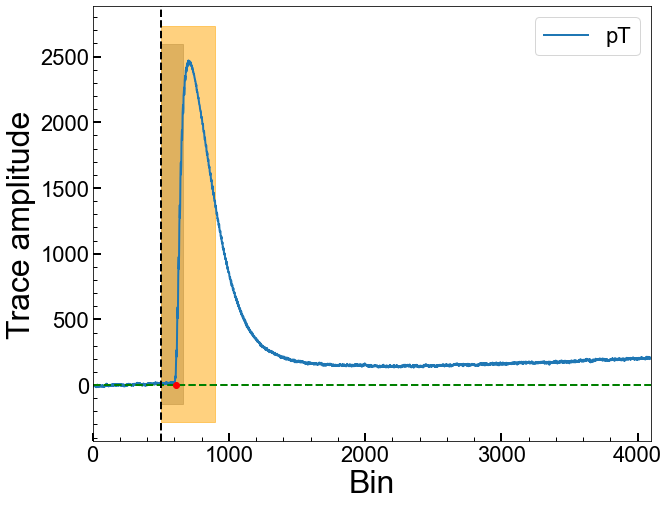

Series Number: 72209172155
Event Number: 1990830
Energy: 35.48746487561 keV
Area: 315571.32563900395


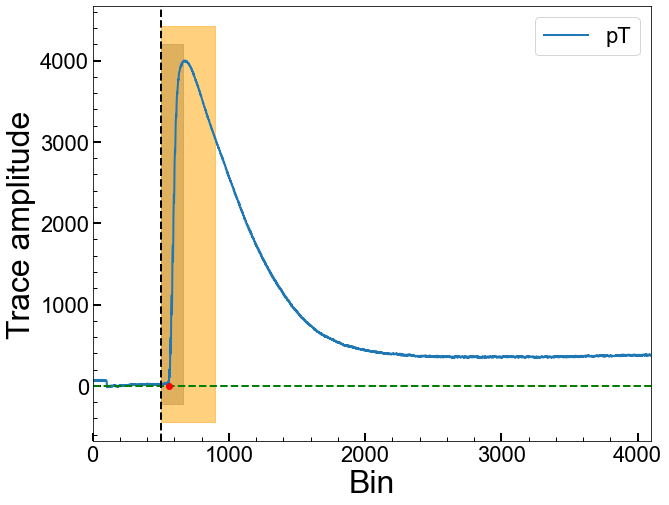

Series Number: 72209172155
Event Number: 2010568
Energy: 14.56993679059 keV
Area: -4155115.814676846


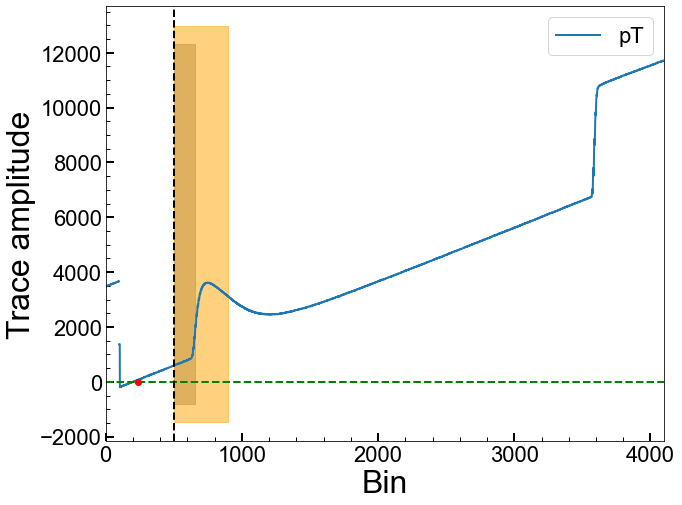

Series Number: 72209172155
Event Number: 2020326
Energy: 5.112733918785 keV
Area: 167752.9185715179


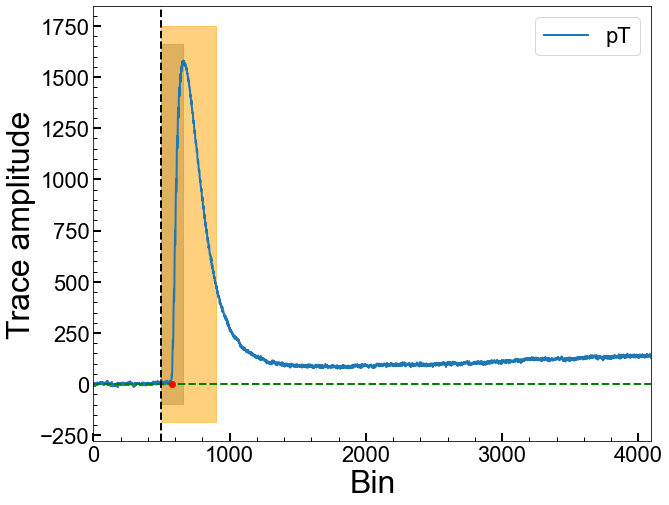

Series Number: 72209172155
Event Number: 2020591
Energy: 29.66642867934 keV
Area: -432241.68490852456


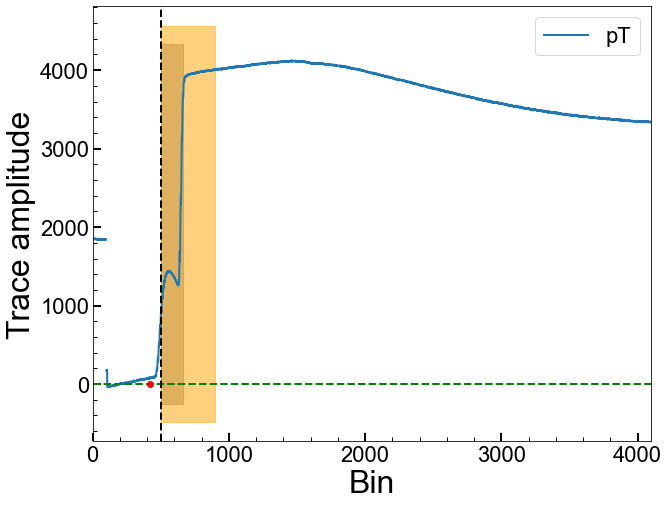

Series Number: 72209172155
Event Number: 2030429
Energy: 7.239178880906 keV
Area: 237179.23262573066


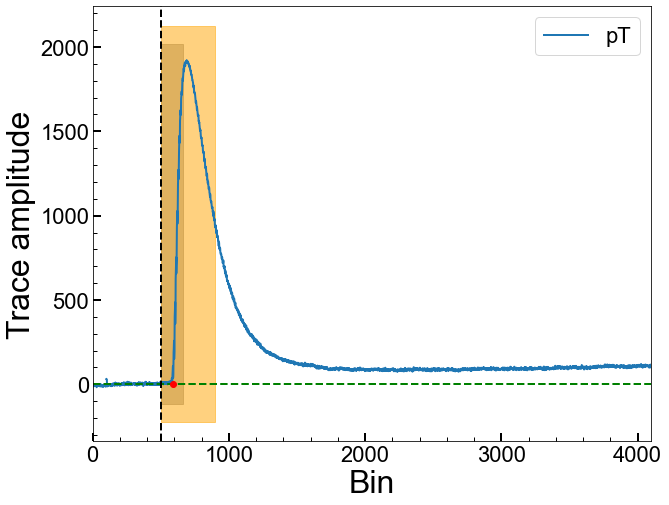

Series Number: 72209172155
Event Number: 2060050
Energy: 24.1047811099 keV
Area: 345945.91572022357


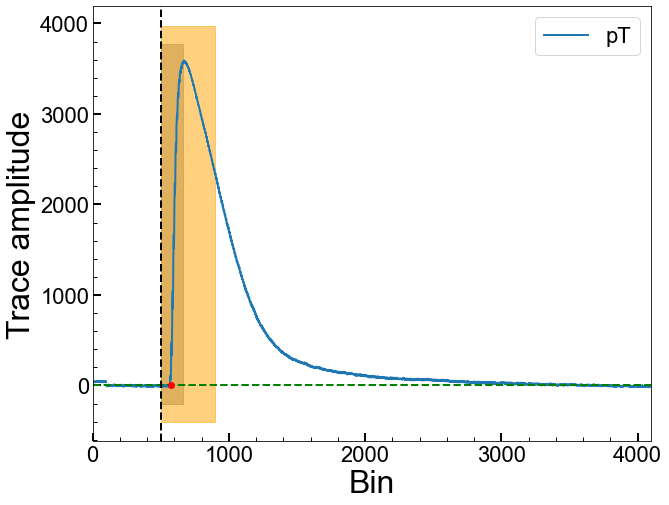

Series Number: 72209172155
Event Number: 2060679
Energy: 35.02609139523 keV
Area: 305803.9091839823


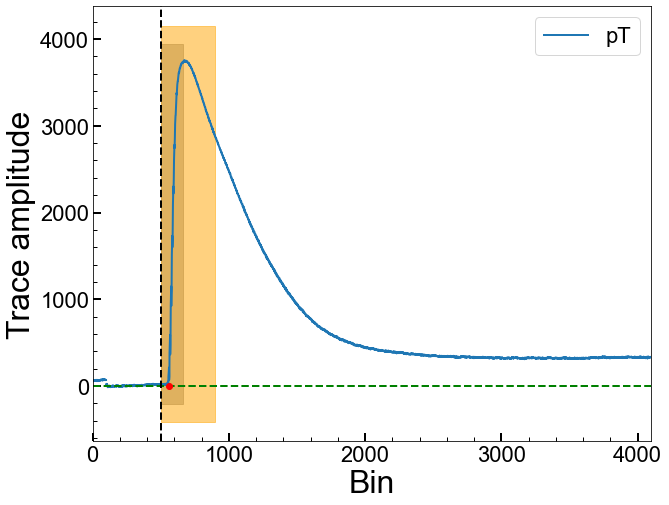

In [9]:
loops = 0
time_reg = []
energies = []
bad=[]

for s in pulse_struct:
    ser=int(s.replace('_',''))
    for ev in pulse_struct[s]:
        
        #print(exampleObj['Z1']['PA'][ser,ev])
        energy = getEnergy(ser, ev)
        
        shownpulses=0
        
        #if energy > 51:
        #    continue

        #plt.subplot(8,12)
        if(not isRailed(exampleObj['Z1']['PA'][ser,ev])):
            shownpulses+=1
            #ax1.plot(exampleObj['Z1']['PA'][ser,ev],label="pC") # index 0 corresponds to first event
        if(not isRailed(exampleObj['Z1']['PB'][ser,ev])):
            shownpulses+=1
            #ax1.plot(exampleObj['Z1']['PB'][ser,ev],label="pF")
        if(not isRailed(exampleObj['Z1']['PD'][ser,ev])):
            shownpulses+=1
            #ax1.plot(exampleObj['Z1']['PD'][ser,ev],label="pE")
        if(not isRailed(exampleObj['Z3']['PA'][ser,ev])):
            shownpulses+=1
            #ax1.plot(exampleObj['Z3']['PA'][ser,ev],label="pB") # index 0 corresponds to first event
        if(not isRailed(exampleObj['Z3']['PB'][ser,ev])):
            shownpulses+=1
            #ax1.plot(exampleObj['Z3']['PB'][ser,ev],label="pA")
        if(not isRailed(exampleObj['Z3']['PD'][ser,ev])):
            shownpulses+=1
            #ax1.plot(exampleObj['Z3']['PD'][ser,ev],label="pD")
            
        pT = getPTPulseCD(exampleObj,ser,ev)+3000
        baseline = getBaseline(pT)
        xB = np.linspace(0, 4095, 4096)
        yB = baseline(xB)
        
        bshifted_pT = np.subtract(pT,yB)

        if(shownpulses>0):
                        
            crosses = np.isclose(bshifted_pT, 0, atol=75.0) #changed from 250
            
            #t = 0
            #for i in range(0,750):
            #    if (crosses[i] == True):
            #        time_reg.append(i)
            #        #print("Crosses at bin: " + str(i))
            #        energies.append(energy)
                    #t += 1
            #        break
                    
            best_cross = 0
            plot_cross = False
            
            for i in range(0, 1000):
                if (crosses[i] == True):
                    best_cross = i 
                    
            if best_cross != 0:
                time_reg.append(best_cross)
                #print("Crosses at bin: " + str(best_cross))
                energies.append(energy)
                #t += 1
                plot_cross = True
            #fix this
            if best_cross<0:
                bad.append(ev[s])
                    
            if (plot==True):
                
                print("Series Number: " + str(ser))
                print("Event Number: " + str(ev))
                print("Energy: " + str(energy) + " keV")
        
                fig,axes = plt.subplots(1,1,figsize=(10.0,8.0),sharex=True)
                ax1 = axes
                
                ax1.plot(bshifted_pT, label="pT")
                #ax1.plot(xB, yB, color='r', linestyle="--", label="baseline")
                plt.axhline(y=0, color='g', linestyle="--")
                
                #ax1.plot((exampleObj['Z4']['PA'][ser,ev]/3)+2900-2650)
                #plt.title('PA')
                ax1.legend(loc=1,prop={'size':22})
                ax1.set_xlim(0,4096)
                ax1.set_xlabel('Bin')
                ax1.set_ylabel('Trace amplitude')
                plt.axvline(x=500,color='k',linestyle="--")
                
                if plot_cross == True:
                    ax1.plot(best_cross, 0, 'ro')
                    
                    fixedWidth=160
                    fixedWidth1=400
                    ax1.fill_betweenx(ax1.get_ylim(), 500, 500+fixedWidth1, color='orange', alpha=0.5)
                    ax1.fill_betweenx(ax1.get_ylim(), 500, 500+fixedWidth, color='gray', alpha=0.5)

                    y_min, y_max = ax1.get_ylim()
                    box_width = best_cross - 500
                    box_height = y_max - y_min
                    area = box_width * box_height
                    print("Area:", area)

                if shownpulses > 0:
                    #plt.savefig(f'figures/{energy}_keV_pulse.png')
                    plt.show()
                    
            #if t == 0:
            #    time_reg.append(0)
            
            loops += 1